In [1]:
import numpy as np
np.__version__

'1.19.5'

In [2]:
import pandas as pd
pd.__version__

'1.1.5'

In [3]:
import matplotlib
matplotlib.__version__

'3.3.4'

In [4]:
import matplotlib.pyplot as plt

In [5]:
# Adjust plot size
#options(repr.plot.width=16, repr.plot.height=6)

# For some reason, if this is in the same cell as the import command, it doesn't work.
plt.rcParams["figure.figsize"] = [18.0,8.0]

In [6]:
import scipy
scipy.__version__

'1.5.4'

In [7]:
from scipy import stats

In [8]:
import seaborn as sns

In [9]:
from datetime import datetime

In [10]:
#from pandarallel import pandarallel

In [11]:
#pandarallel.initialize(progress_bar=True)

In [12]:
default_max_columns=pd.get_option('display.max_columns')

In [13]:
default_max_rows=pd.get_option('display.max_rows')

In [14]:
default_precision=pd.get_option('display.precision')

In [15]:
pd.set_option('display.precision', 2)

In [16]:
default_threshold=np.get_printoptions()['threshold']

In [17]:
np.set_printoptions(threshold=10000000)

# Read meta data

In [18]:
meta = pd.read_csv('20210428-EV/metadata.csv')

In [19]:
meta.head()

,Rand 2 Batch_order,D-plex Sequencing ID,Lexogen Sequencing ID,Diagnosis
0,1_1,SFHH005a,SFHH006a,"GBM, IDH1R132H WT,"
1,1_2,SFHH005b,SFHH006b,"Oligodendroglioma, IDH-mutant, 1p19q codeleted"
2,1_3,SFHH005c,SFHH006c,"GBM, IDH-mutant,"
3,1_4,SFHH005d,SFHH006d,"GBM, IDH-mutant,"
4,1_5,SFHH005e,SFHH006e,"GBM, IDH1R132H WT,"


In [20]:
meta.rename(columns={"Rand 2 Batch_order": "subject"},inplace=True)
meta.rename(columns={"D-plex Sequencing ID": "dplex"},inplace=True)
meta.rename(columns={"Lexogen Sequencing ID": "lexogen"},inplace=True)
meta.rename(columns={"Diagnosis": "diag"},inplace=True)
#meta.set_index('subject',inplace=True)

In [21]:
meta

,subject,dplex,lexogen,diag
0,1_1,SFHH005a,SFHH006a,"GBM, IDH1R132H WT,"
1,1_2,SFHH005b,SFHH006b,"Oligodendroglioma, IDH-mutant, 1p19q codeleted"
2,1_3,SFHH005c,SFHH006c,"GBM, IDH-mutant,"
3,1_4,SFHH005d,SFHH006d,"GBM, IDH-mutant,"
4,1_5,SFHH005e,SFHH006e,"GBM, IDH1R132H WT,"
5,1_6,SFHH005f,SFHH006f,"Diffuse Astrocytoma, IDH-mutant,"
6,1_7,SFHH005g,SFHH006g,"Oligodendroglioma, IDH-mutant, 1p19q codeleted"
7,1_8,SFHH005h,SFHH006h,"GBM, IDH1R132H WT,"
8,1_9,SFHH005i,SFHH006i,"GBM, IDH-mutant,"
9,1_10,SFHH005j,SFHH006j,"Diffuse Astrocytoma, IDH-mutant,"


In [22]:
meta[['disease','idh','x1p19q']] = meta['diag'].str.split(",", 2, expand=True)
#meta.drop('diag',axis='columns',inplace=True)

In [23]:
meta

,subject,dplex,lexogen,diag,disease,idh,x1p19q
0,1_1,SFHH005a,SFHH006a,"GBM, IDH1R132H WT,",GBM,IDH1R132H WT,
1,1_2,SFHH005b,SFHH006b,"Oligodendroglioma, IDH-mutant, 1p19q codeleted",Oligodendroglioma,IDH-mutant,1p19q codeleted
2,1_3,SFHH005c,SFHH006c,"GBM, IDH-mutant,",GBM,IDH-mutant,
3,1_4,SFHH005d,SFHH006d,"GBM, IDH-mutant,",GBM,IDH-mutant,
4,1_5,SFHH005e,SFHH006e,"GBM, IDH1R132H WT,",GBM,IDH1R132H WT,
5,1_6,SFHH005f,SFHH006f,"Diffuse Astrocytoma, IDH-mutant,",Diffuse Astrocytoma,IDH-mutant,
6,1_7,SFHH005g,SFHH006g,"Oligodendroglioma, IDH-mutant, 1p19q codeleted",Oligodendroglioma,IDH-mutant,1p19q codeleted
7,1_8,SFHH005h,SFHH006h,"GBM, IDH1R132H WT,",GBM,IDH1R132H WT,
8,1_9,SFHH005i,SFHH006i,"GBM, IDH-mutant,",GBM,IDH-mutant,
9,1_10,SFHH005j,SFHH006j,"Diffuse Astrocytoma, IDH-mutant,",Diffuse Astrocytoma,IDH-mutant,


# Read raw matrix CORE

In [24]:
#df = pd.read_csv('20210428-EV/dplexonlyreport.csv',index_col=0,header=None)
df = pd.read_csv('20210428-EV/20210513b-report.csv.gz',index_col=0,header=None,low_memory=False)

In [25]:
df.shape

(39, 528)

In [26]:
df.head(12)

,1,2,3,4,5,6,7,8,9,10,...,519,520,521,522,523,524,525,526,527,528
0,,,,,,,,,,,,,,,,,,,,,
,SFHH005aa,SFHH005aa,SFHH005aa,SFHH005aa,SFHH005aa,SFHH005aa,SFHH005ab,SFHH005ab,SFHH005ab,SFHH005ab,...,SFHH006y,SFHH006y,SFHH006y,SFHH006y,SFHH006z,SFHH006z,SFHH006z,SFHH006z,SFHH006z,SFHH006z
---,---,---,---,---,---,---,---,---,---,---,...,---,---,---,---,---,---,---,---,---,---
Subject,3_5,3_5,3_5,3_5,3_5,3_5,3_6,3_6,3_6,3_6,...,3_3,3_3,3_3,3_3,3_4,3_4,3_4,3_4,3_4,3_4
Lab kit,D-plex,D-plex,D-plex,D-plex,D-plex,D-plex,D-plex,D-plex,D-plex,D-plex,...,Lexogen,Lexogen,Lexogen,Lexogen,Lexogen,Lexogen,Lexogen,Lexogen,Lexogen,Lexogen
Trimmer,bbduk1,bbduk2,bbduk3,cutadapt1,cutadapt2,cutadapt3,bbduk1,bbduk2,bbduk3,cutadapt1,...,bbduk3,cutadapt1,cutadapt2,cutadapt3,bbduk1,bbduk2,bbduk3,cutadapt1,cutadapt2,cutadapt3
Raw Read Count,4038879,4038879,4038879,4038879,4038879,4038879,3088240,3088240,3088240,3088240,...,3665258,3665258,3665258,3665258,4868169,4868169,4868169,4868169,4868169,4868169
Raw Read Length,35.0646,35.0646,35.0646,35.0646,35.0646,35.0646,48.6946,48.6946,48.6946,48.6946,...,34.0495,34.0495,34.0495,34.0495,36.2413,36.2413,36.2413,36.2413,36.2413,36.2413
Trimmed Read Count,1270784,1372973,1372997,1395891,1395893,1395893,1240850,1396651,1396740,1418066,...,3633881,3661993,3664115,3664263,4478092,4823895,4823681,4863961,4867158,4867302
Trimmed Ave Read Length,33.8185,38.2306,38.2314,43.5121,43.5142,43.524,40.8779,51.0991,51.101,64.3485,...,32.6867,33.8972,34.0071,34.0507,30.6793,34.7925,34.7983,36.0631,36.1974,36.242


In [27]:
df.drop("---",inplace=True)

In [28]:
df.shape

(38, 528)

In [29]:
df.rename({'  ':'sample'},axis='rows',inplace=True)
df.rename({'Subject':'subject'},axis='rows',inplace=True)
df.rename({'Trimmer':'trimmer'},axis='rows',inplace=True)

In [30]:
df

,1,2,3,4,5,6,7,8,9,10,...,519,520,521,522,523,524,525,526,527,528
0,,,,,,,,,,,,,,,,,,,,,
sample,SFHH005aa,SFHH005aa,SFHH005aa,SFHH005aa,SFHH005aa,SFHH005aa,SFHH005ab,SFHH005ab,SFHH005ab,SFHH005ab,...,SFHH006y,SFHH006y,SFHH006y,SFHH006y,SFHH006z,SFHH006z,SFHH006z,SFHH006z,SFHH006z,SFHH006z
subject,3_5,3_5,3_5,3_5,3_5,3_5,3_6,3_6,3_6,3_6,...,3_3,3_3,3_3,3_3,3_4,3_4,3_4,3_4,3_4,3_4
Lab kit,D-plex,D-plex,D-plex,D-plex,D-plex,D-plex,D-plex,D-plex,D-plex,D-plex,...,Lexogen,Lexogen,Lexogen,Lexogen,Lexogen,Lexogen,Lexogen,Lexogen,Lexogen,Lexogen
trimmer,bbduk1,bbduk2,bbduk3,cutadapt1,cutadapt2,cutadapt3,bbduk1,bbduk2,bbduk3,cutadapt1,...,bbduk3,cutadapt1,cutadapt2,cutadapt3,bbduk1,bbduk2,bbduk3,cutadapt1,cutadapt2,cutadapt3
Raw Read Count,4038879,4038879,4038879,4038879,4038879,4038879,3088240,3088240,3088240,3088240,...,3665258,3665258,3665258,3665258,4868169,4868169,4868169,4868169,4868169,4868169
Raw Read Length,35.0646,35.0646,35.0646,35.0646,35.0646,35.0646,48.6946,48.6946,48.6946,48.6946,...,34.0495,34.0495,34.0495,34.0495,36.2413,36.2413,36.2413,36.2413,36.2413,36.2413
Trimmed Read Count,1270784,1372973,1372997,1395891,1395893,1395893,1240850,1396651,1396740,1418066,...,3633881,3661993,3664115,3664263,4478092,4823895,4823681,4863961,4867158,4867302
Trimmed Ave Read Length,33.8185,38.2306,38.2314,43.5121,43.5142,43.524,40.8779,51.0991,51.101,64.3485,...,32.6867,33.8972,34.0071,34.0507,30.6793,34.7925,34.7983,36.0631,36.1974,36.242
STAR Aligned to Transcriptome,111104,112499,112492,112689,112696,112689,92673,93752,93727,92285,...,337860,337076,336880,336843,362402,363298,363259,362012,361905,361853


In [31]:
df=df.T
df.head()

,sample,subject,Lab kit,trimmer,Raw Read Count,Raw Read Length,Trimmed Read Count,Trimmed Ave Read Length,STAR Aligned to Transcriptome,STAR Aligned to Transcriptome %,...,Bowtie2 Aligned to Salmonella,Bowtie2 Aligned to Salmonella %,Bowtie2 Aligned to masked Salmonella,Bowtie2 Aligned to masked Salmonella %,Bowtie2 Aligned to Burkholderia,Bowtie2 Aligned to Burkholderia %,Bowtie2 Aligned to masked Burkholderia,Bowtie2 Aligned to masked Burkholderia %,Bowtie2 Aligned to mRNA_Prot,Bowtie2 Aligned to mRNA_Prot %
1,SFHH005aa,3_5,D-plex,bbduk1,4038879,35.0646,1270784,33.8185,111104,8.74,...,45946,3.61,14700,1.15,375543,29.55,277406,21.82,58736,4.62
2,SFHH005aa,3_5,D-plex,bbduk2,4038879,35.0646,1372973,38.2306,112499,8.19,...,60133,4.37,17811,1.29,413414,30.11,298416,21.73,71735,5.22
3,SFHH005aa,3_5,D-plex,bbduk3,4038879,35.0646,1372997,38.2314,112492,8.19,...,60133,4.37,17811,1.29,413414,30.11,298416,21.73,71735,5.22
4,SFHH005aa,3_5,D-plex,cutadapt1,4038879,35.0646,1395891,43.5121,112689,8.07,...,61284,4.39,18218,1.30,420290,30.10,304330,21.80,75518,5.41
5,SFHH005aa,3_5,D-plex,cutadapt2,4038879,35.0646,1395893,43.5142,112696,8.07,...,61285,4.39,18218,1.30,420299,30.10,304339,21.80,75522,5.41


In [32]:
#df=df.merge(meta,left_on='Subject',right_on='subject')
df=df.merge(meta,on='subject')
df.head()

,sample,subject,Lab kit,trimmer,Raw Read Count,Raw Read Length,Trimmed Read Count,Trimmed Ave Read Length,STAR Aligned to Transcriptome,STAR Aligned to Transcriptome %,...,Bowtie2 Aligned to masked Burkholderia,Bowtie2 Aligned to masked Burkholderia %,Bowtie2 Aligned to mRNA_Prot,Bowtie2 Aligned to mRNA_Prot %,dplex,lexogen,diag,disease,idh,x1p19q
0,SFHH005aa,3_5,D-plex,bbduk1,4038879,35.0646,1270784,33.8185,111104,8.74,...,277406,21.82,58736,4.62,SFHH005aa,SFHH006aa,"GBM, IDH-mutant,",GBM,IDH-mutant,
1,SFHH005aa,3_5,D-plex,bbduk2,4038879,35.0646,1372973,38.2306,112499,8.19,...,298416,21.73,71735,5.22,SFHH005aa,SFHH006aa,"GBM, IDH-mutant,",GBM,IDH-mutant,
2,SFHH005aa,3_5,D-plex,bbduk3,4038879,35.0646,1372997,38.2314,112492,8.19,...,298416,21.73,71735,5.22,SFHH005aa,SFHH006aa,"GBM, IDH-mutant,",GBM,IDH-mutant,
3,SFHH005aa,3_5,D-plex,cutadapt1,4038879,35.0646,1395891,43.5121,112689,8.07,...,304330,21.80,75518,5.41,SFHH005aa,SFHH006aa,"GBM, IDH-mutant,",GBM,IDH-mutant,
4,SFHH005aa,3_5,D-plex,cutadapt2,4038879,35.0646,1395893,43.5142,112696,8.07,...,304339,21.80,75522,5.41,SFHH005aa,SFHH006aa,"GBM, IDH-mutant,",GBM,IDH-mutant,


In [33]:
#element_counts = pd.read_csv('20210428-EV/rmsk_class_counts.csv.gz',index_col=0,low_memory=False)
#element_counts = pd.read_csv('20210428-EV/rmsk_family_counts.csv.gz',index_col=0,low_memory=False)
element_counts = pd.read_csv('20210428-EV/rmsk_name_counts.csv.gz',index_col=0,low_memory=False)
#element_counts = pd.read_csv('20210428-EV/mirna_counts.csv.gz',index_col=0,low_memory=False)
#element_counts = pd.read_csv('20210428-EV/mrna_counts.csv.gz',index_col=0,low_memory=False)
#element_counts = pd.read_csv('20210428-EV/gene_counts.csv.gz',index_col=0,low_memory=False)
# diamond_family_counts

element_counts.head()

,SFHH005aa.bbduk1.bowtie2.rmsk.rmsk_name_counts,SFHH005aa.bbduk2.bowtie2.rmsk.rmsk_name_counts,SFHH005aa.bbduk3.bowtie2.rmsk.rmsk_name_counts,SFHH005aa.cutadapt1.bowtie2.rmsk.rmsk_name_counts,SFHH005aa.cutadapt2.bowtie2.rmsk.rmsk_name_counts,SFHH005aa.cutadapt3.bowtie2.rmsk.rmsk_name_counts,SFHH005ab.bbduk1.bowtie2.rmsk.rmsk_name_counts,SFHH005ab.bbduk2.bowtie2.rmsk.rmsk_name_counts,SFHH005ab.bbduk3.bowtie2.rmsk.rmsk_name_counts,SFHH005a.bbduk1.bowtie2.rmsk.rmsk_name_counts,...,SFHH006y.bbduk3.bowtie2.rmsk.rmsk_name_counts,SFHH006y.cutadapt1.bowtie2.rmsk.rmsk_name_counts,SFHH006y.cutadapt2.bowtie2.rmsk.rmsk_name_counts,SFHH006y.cutadapt3.bowtie2.rmsk.rmsk_name_counts,SFHH006z.bbduk1.bowtie2.rmsk.rmsk_name_counts,SFHH006z.bbduk2.bowtie2.rmsk.rmsk_name_counts,SFHH006z.bbduk3.bowtie2.rmsk.rmsk_name_counts,SFHH006z.cutadapt1.bowtie2.rmsk.rmsk_name_counts,SFHH006z.cutadapt2.bowtie2.rmsk.rmsk_name_counts,SFHH006z.cutadapt3.bowtie2.rmsk.rmsk_name_counts
sequence,,,,,,,,,,,,,,,,,,,,,
(A)n,0,3,3,2,2,2,0,4,4,0,...,0,0,0,0,0,0,0,1,1,1
(AAAAAAC)n,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
(AAAAAAG)n,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
(AAAAAAT)n,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
(AAAAAC)n,0,0,0,1,1,1,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0


In [34]:
element_counts=element_counts.T
element_counts=element_counts.reset_index()
element_counts[['sample','trimmer','other']]=element_counts['index'].str.split(".",2,expand=True)
element_counts.drop(["index","other"],inplace=True,axis='columns')
element_counts.head()

sequence,(A)n,(AAAAAAC)n,(AAAAAAG)n,(AAAAAAT)n,(AAAAAC)n,(AAAAACA)n,(AAAAACT)n,(AAAAAG)n,(AAAAAGA)n,(AAAAAT)n,...,tRNA-Thr-ACA,tRNA-Thr-ACG_,tRNA-Thr-ACY_,tRNA-Trp-TGG,tRNA-Tyr-TAC,tRNA-Val-GTA,tRNA-Val-GTG,tRNA-Val-GTY,sample,trimmer
0,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,23,0,0,SFHH005aa,bbduk1
1,3,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,23,0,0,SFHH005aa,bbduk2
2,3,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,23,0,0,SFHH005aa,bbduk3
3,2,0,0,0,1,0,0,0,0,0,...,0,0,0,0,0,23,0,0,SFHH005aa,cutadapt1
4,2,0,0,0,1,0,0,0,0,0,...,0,0,0,0,0,23,0,0,SFHH005aa,cutadapt2


In [35]:
df=df.merge(element_counts,on=['sample','trimmer'])
df.shape

(528, 4946)

In [36]:
df.head()

,sample,subject,Lab kit,trimmer,Raw Read Count,Raw Read Length,Trimmed Read Count,Trimmed Ave Read Length,STAR Aligned to Transcriptome,STAR Aligned to Transcriptome %,...,tRNA-Ser-TCG,tRNA-Ser-TCY,tRNA-Thr-ACA,tRNA-Thr-ACG_,tRNA-Thr-ACY_,tRNA-Trp-TGG,tRNA-Tyr-TAC,tRNA-Val-GTA,tRNA-Val-GTG,tRNA-Val-GTY
0,SFHH005aa,3_5,D-plex,bbduk1,4038879,35.0646,1270784,33.8185,111104,8.74,...,0,0,0,0,0,0,0,23,0,0
1,SFHH005aa,3_5,D-plex,bbduk2,4038879,35.0646,1372973,38.2306,112499,8.19,...,0,0,0,0,0,0,0,23,0,0
2,SFHH005aa,3_5,D-plex,bbduk3,4038879,35.0646,1372997,38.2314,112492,8.19,...,0,0,0,0,0,0,0,23,0,0
3,SFHH005aa,3_5,D-plex,cutadapt1,4038879,35.0646,1395891,43.5121,112689,8.07,...,0,0,0,0,0,0,0,23,0,0
4,SFHH005aa,3_5,D-plex,cutadapt2,4038879,35.0646,1395893,43.5142,112696,8.07,...,0,0,0,0,0,0,0,23,0,0


In [37]:
df.columns  #.tolist()

Index(['sample', 'subject', 'Lab kit', 'trimmer', 'Raw Read Count',
       'Raw Read Length', 'Trimmed Read Count', 'Trimmed Ave Read Length',
       'STAR Aligned to Transcriptome', 'STAR Aligned to Transcriptome %',
       ...
       'tRNA-Ser-TCG', 'tRNA-Ser-TCY', 'tRNA-Thr-ACA', 'tRNA-Thr-ACG_',
       'tRNA-Thr-ACY_', 'tRNA-Trp-TGG', 'tRNA-Tyr-TAC', 'tRNA-Val-GTA',
       'tRNA-Val-GTG', 'tRNA-Val-GTY'],
      dtype='object', length=4946)

In [38]:
#genes=df.columns[92:142]
#genes=df.columns[100:554]
#a=df.columns.tolist().index('STAR Gene Counts')+1
#b=df.columns.tolist().index('STAR miRNA Counts')
#genes=df.columns[a:b]
elements=element_counts.columns[:-2]
elements

Index(['(A)n', '(AAAAAAC)n', '(AAAAAAG)n', '(AAAAAAT)n', '(AAAAAC)n',
       '(AAAAACA)n', '(AAAAACT)n', '(AAAAAG)n', '(AAAAAGA)n', '(AAAAAT)n',
       ...
       'tRNA-Ser-TCG', 'tRNA-Ser-TCY', 'tRNA-Thr-ACA', 'tRNA-Thr-ACG_',
       'tRNA-Thr-ACY_', 'tRNA-Trp-TGG', 'tRNA-Tyr-TAC', 'tRNA-Val-GTA',
       'tRNA-Val-GTG', 'tRNA-Val-GTY'],
      dtype='object', name='sequence', length=4902)

In [39]:
df['Raw Read Count'] = pd.to_numeric(df['Raw Read Count'], errors='coerce')

In [40]:
df['Trimmed Read Count'] = pd.to_numeric(df['Trimmed Read Count'], errors='coerce')

In [41]:
pd.set_option('display.max_rows',None)

In [42]:
#df[['subject','sample','Raw Read Count']].drop_duplicates().sort_values(by='Raw Read Count')

In [43]:
#df[['subject','sample','trimmer','Trimmed Read Count']].drop_duplicates().sort_values(by='Trimmed Read Count')

In [44]:
pd.set_option('display.max_rows',default_max_rows)

# Prepping to ttest all items against all other items

In [45]:
df['diag'].unique()

array(['GBM, IDH-mutant,', 'Diffuse Astrocytoma, IDH-mutant,',
       'Oligodendroglioma, IDH-mutant, 1p19q codeleted',
       'V01 control (S1),,', 'GBM, IDH1R132H WT,', 'blank 2 (C1),,',
       'blank1 (C1),,'], dtype=object)

In [46]:
u=df['diag'].unique()
diags=u[0:3]
diags=np.append(diags,u[4])

In [47]:
diags

array(['GBM, IDH-mutant,', 'Diffuse Astrocytoma, IDH-mutant,',
       'Oligodendroglioma, IDH-mutant, 1p19q codeleted',
       'GBM, IDH1R132H WT,'], dtype=object)

In [48]:
type(diags)

numpy.ndarray

In [49]:
diags=diags.tolist()

In [50]:
diags

['GBM, IDH-mutant,',
 'Diffuse Astrocytoma, IDH-mutant,',
 'Oligodendroglioma, IDH-mutant, 1p19q codeleted',
 'GBM, IDH1R132H WT,']

In [51]:
# Why was this here?

#import warnings
#warnings.filterwarnings("ignore", category=np.VisibleDeprecationWarning) 

pca plots

In [52]:
def ttests_boxplots_and_heatmaps(localdf,columns,box_p=0.05,heat_p=0.15):
    select_p_values=[]
    for col in columns:

        if ( col not in localdf.columns ):
            continue

        for labkit in localdf['Lab kit'].unique():
            #"D-plex","Lexogen":
            for trimmer in 'bbduk2','cutadapt2':
                #localdf['Trimmer'].unique():
                #"bbduk1","bbduk2","bbduk3","cutadapt1","cutadapt2","cutadapt3":
                for diag in diags:
                    others=diags.copy()
                    others.remove(diag)
                    for other in others:
                        t, p = stats.ttest_ind(
                            localdf[((localdf["Lab kit"]==labkit) &
                                     (localdf["trimmer"]==trimmer) & 
                                (localdf["diag"]==diag))][col],
                            localdf[((localdf["Lab kit"]==labkit) &
                                     (localdf["trimmer"]==trimmer) & 
                                (localdf["diag"]==other))][col])
                        if p < heat_p:
                            select_p_values.append([abs(t),p,col,labkit,trimmer])

    pdf = pd.DataFrame(select_p_values, columns=['t','p','col','labkit','trimmer'])                        
    pdf=pdf.drop_duplicates().sort_values('p')

    for index, row in pdf.iterrows():
        if row['p'] < box_p:
            print(" p : "+str(row['p'])+"  ( t : "+str(row['t'])+" ) :  "+
                  row['labkit']+"  :  "+row['trimmer']+"  :  "+row['col'])
            print("Control and blanks")
            print(localdf[
                (localdf['diag']=='V01 control (S1),,') &
                (localdf["Lab kit"]==row['labkit']) &
                (localdf["trimmer"]==row['trimmer'])][row['col']])
            print(localdf[
                (localdf['diag']=='blank 2 (C1),,') &
                (localdf["Lab kit"]==row['labkit']) &
                (localdf["trimmer"]==row['trimmer'])][row['col']])
            print(localdf[
                (localdf['diag']=='blank1 (C1),,') &
                (localdf["Lab kit"]==row['labkit']) &
                (localdf["trimmer"]==row['trimmer'])][row['col']])
                        
            localdf[((localdf["Lab kit"]==row['labkit']) &
                     (localdf["trimmer"]==row['trimmer']))].boxplot(
                column=row['col'],by=['diag'])
            plt.title(row['col'] + " Normalized by Trimmed Read Count")
            plt.xticks(rotation=75,ha='right')
            plt.show()

    selected=['subject','sample','Lab kit','trimmer','diag','idh']
    selected=np.append(selected,pdf['col'])
    selected=np.unique(selected)

    #['Lab kit' 'NR_029609.1' 'trimmer' 'diag' 'idh' 'sample' 'subject']
    if len(selected) > 7:
        for trimmer in 'bbduk2','cutadapt2':
            for labkit in dfn['Lab kit'].unique():
                tmp=localdf[selected].copy()
                tmp=tmp[(tmp['trimmer']==trimmer) & (tmp['Lab kit']==labkit)]
                tmp=tmp.drop('trimmer',axis='columns')
                tmp=tmp.drop('Lab kit',axis='columns')
                tmp.set_index(['subject','sample','diag','idh'],inplace=True)
                
                #tmp-=tmp.min() # This may almost always be 0 now.
                tmp/=tmp.max() # given that there should be no NAs now, coule let clustermap do this
                # ...
                #standard_scale int or None, optional
                #Either 0 (rows) or 1 (columns).
                #Whether or not to standardize that dimension, meaning for each row or column,
                #subtract the minimum and divide each by its maximum.
                # how would that deal with 0s or empty cells

                tmp=tmp.fillna(0) # Somehow, some scaled values become NaN so keep this
                
                tmp.reset_index(inplace=True)

                #tmp1=tmp.sort_values(['diag']).T
                tmp=tmp.sort_values(['idh','diag'])
                #print(tmp.head())
                tmp.drop(['subject'],inplace=True,axis='columns')
                tmp.set_index(['sample','idh'],inplace=True)
                
                diagnoses=tmp.pop('diag')
                #lut = dict(zip(diagnoses.unique(), "rgbcmykb"))
                #col_colors = diagnoses.map(lut)
                #print(col_colors)
                #print(tmp.columns)
                
                tmp=tmp.T

                #print('pal')
                network_pal = sns.cubehelix_palette(len(diagnoses.unique()),
                                    light=.9, dark=.1, reverse=True,
                                    start=1, rot=-2)
                #print(network_pal)
                network_pal
                #print('lut')
                network_lut = dict(zip(diagnoses.unique(), network_pal))
                #print(network_lut)
                #print('labels')
                # Convert the palette to vectors that will be drawn on the side of the matrix
                network_labels = diagnoses
                #print(network_labels)
                network_colors = pd.Series(network_labels, index=tmp.columns).map(network_lut)                
                #print('colors')
                #print(network_colors)
                
                # from http://dawnmy.github.io/2016/10/24/Plot-heatmaap-with-side-color-indicating-the-class-of-variables/
                # Create a custom palette to identify the networks
                #network_pal = sns.cubehelix_palette(len(used_networks),
                #                    light=.9, dark=.1, reverse=True,
                #                    start=1, rot=-2)
                #network_lut = dict(zip(map(str, used_networks), network_pal))

                # Convert the palette to vectors that will be drawn on the side of the matrix
                #network_labels = df.columns.get_level_values("network")
                #network_colors = pd.Series(network_labels, index=df.columns).map(network_lut)                
   
                # Create a custom colormap for the heatmap values
                #cmap = sns.diverging_palette(h_neg=210, h_pos=350, s=90, l=30, as_cmap=True)

                # Draw the full plot
                #g = sns.clustermap(df.corr(),

                #                 # Turn off the clustering
                #                 row_cluster=False, col_cluster=False,

                #                  # Add colored class labels
                #                  row_colors=network_colors, col_colors=network_colors,

                #                  # Make the plot look better when many rows/cols
                #                  linewidths=0, xticklabels=False, yticklabels=False)

                # Draw the legend bar for the classes                 
                #for label in network_labels.unique():
                #    g.ax_col_dendrogram.bar(0, 0, color=network_lut[label],
                #                            label=label, linewidth=0)
                #g.ax_col_dendrogram.legend(loc="center", ncol=5)

                
                g=sns.clustermap(tmp,col_cluster=False,figsize=(15,20),cmap="Spectral",col_colors=network_colors)
                g.fig.suptitle("Clustermap 1 : "+trimmer+" "+labkit)
                plt.setp(g.ax_heatmap.get_xticklabels(), rotation=75, horizontalalignment='right')

                # Draw the legend bar for the classes                 
                for label in network_labels.unique():
                    g.ax_col_dendrogram.bar(0, 0, color=network_lut[label],
                                            label=label, linewidth=0)
                g.ax_col_dendrogram.legend(loc="center", ncol=4)
                
                # Adjust the postion of the main colorbar for the heatmap
                #g.cax.set_position([.97, .2, .03, .45])
                g.cax.set_position([0, .15, .005, .65])
                plt.show()

                g=sns.clustermap(tmp,figsize=(15,20),cmap="Spectral",col_colors=network_colors)
                g.fig.suptitle("Clustermap 2 : "+trimmer+" "+labkit)
                plt.setp(g.ax_heatmap.get_xticklabels(), rotation=75, horizontalalignment='right')

                # Draw the legend bar for the classes                 
                for label in network_labels.unique():
                    g.ax_col_dendrogram.bar(0, 0, color=network_lut[label],
                                            label=label, linewidth=0)
                g.ax_col_dendrogram.legend(loc="center", ncol=4)
                                
                # Adjust the postion of the main colorbar for the heatmap
                # [dist from left,dist from bottom?,width?,height?]
                g.cax.set_position([0, .15, .005, .65])
                plt.show()  
    else:
        print("Not enough data to produce cluster maps")

# Normalize by Trimmed Read Count

In [53]:
dfn=df.copy()

In [54]:
dfn.head()

,sample,subject,Lab kit,trimmer,Raw Read Count,Raw Read Length,Trimmed Read Count,Trimmed Ave Read Length,STAR Aligned to Transcriptome,STAR Aligned to Transcriptome %,...,tRNA-Ser-TCG,tRNA-Ser-TCY,tRNA-Thr-ACA,tRNA-Thr-ACG_,tRNA-Thr-ACY_,tRNA-Trp-TGG,tRNA-Tyr-TAC,tRNA-Val-GTA,tRNA-Val-GTG,tRNA-Val-GTY
0,SFHH005aa,3_5,D-plex,bbduk1,4038879,35.0646,1270784,33.8185,111104,8.74,...,0,0,0,0,0,0,0,23,0,0
1,SFHH005aa,3_5,D-plex,bbduk2,4038879,35.0646,1372973,38.2306,112499,8.19,...,0,0,0,0,0,0,0,23,0,0
2,SFHH005aa,3_5,D-plex,bbduk3,4038879,35.0646,1372997,38.2314,112492,8.19,...,0,0,0,0,0,0,0,23,0,0
3,SFHH005aa,3_5,D-plex,cutadapt1,4038879,35.0646,1395891,43.5121,112689,8.07,...,0,0,0,0,0,0,0,23,0,0
4,SFHH005aa,3_5,D-plex,cutadapt2,4038879,35.0646,1395893,43.5142,112696,8.07,...,0,0,0,0,0,0,0,23,0,0


In [55]:
datetime.now().strftime("%H:%M:%S")

'10:42:12'

In [56]:
dfn[elements]=(1e9*dfn[elements].values)/dfn[['Trimmed Read Count']].values

In [57]:
datetime.now().strftime("%H:%M:%S")

'10:42:45'

In [58]:
dfn.head()

,sample,subject,Lab kit,trimmer,Raw Read Count,Raw Read Length,Trimmed Read Count,Trimmed Ave Read Length,STAR Aligned to Transcriptome,STAR Aligned to Transcriptome %,...,tRNA-Ser-TCG,tRNA-Ser-TCY,tRNA-Thr-ACA,tRNA-Thr-ACG_,tRNA-Thr-ACY_,tRNA-Trp-TGG,tRNA-Tyr-TAC,tRNA-Val-GTA,tRNA-Val-GTG,tRNA-Val-GTY
0,SFHH005aa,3_5,D-plex,bbduk1,4038879,35.0646,1270784,33.8185,111104,8.74,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,18099.06,0.0,0.0
1,SFHH005aa,3_5,D-plex,bbduk2,4038879,35.0646,1372973,38.2306,112499,8.19,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,16751.97,0.0,0.0
2,SFHH005aa,3_5,D-plex,bbduk3,4038879,35.0646,1372997,38.2314,112492,8.19,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,16751.68,0.0,0.0
3,SFHH005aa,3_5,D-plex,cutadapt1,4038879,35.0646,1395891,43.5121,112689,8.07,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,16476.93,0.0,0.0
4,SFHH005aa,3_5,D-plex,cutadapt2,4038879,35.0646,1395893,43.5142,112696,8.07,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,16476.91,0.0,0.0


In [59]:
datetime.now().strftime("%H:%M:%S")

'10:42:45'

In [60]:
for c in ['CDKN2A','CDKN2A-DT','CDKN2AIP','CDKN2AIPNL','CDKN2B','CDKN2B-AS1',
    'EGFR','EGFR-AS1','IDH1','IDH1-AS1','IDH2','IDH2-DT','NF1','NOTCH1',
    'RB1','RB1CC1','RB1-DT','TERT','TP53']:
        if( c not in dfn.columns ):
            print("Missing "+c) 

Missing CDKN2A
Missing CDKN2A-DT
Missing CDKN2AIP
Missing CDKN2AIPNL
Missing CDKN2B
Missing CDKN2B-AS1
Missing EGFR
Missing EGFR-AS1
Missing IDH1
Missing IDH1-AS1
Missing IDH2
Missing IDH2-DT
Missing NF1
Missing NOTCH1
Missing RB1
Missing RB1CC1
Missing RB1-DT
Missing TERT
Missing TP53


In [61]:
datetime.now().strftime("%H:%M:%S")

'10:42:45'

# Select Genes (if using Genes)

In [62]:
ttests_boxplots_and_heatmaps(dfn,['CDKN2A','CDKN2A-DT','CDKN2AIP','CDKN2AIPNL','CDKN2B','CDKN2B-AS1','EGFR',
                                  'EGFR-AS1','IDH1','IDH1-AS1','IDH2','IDH2-DT','NF1','NOTCH1','RB1','RB1CC1',
                                  'RB1-DT','TERT','TP53'],box_p=0.1,heat_p=0.2)

Not enough data to produce cluster maps


In [63]:
datetime.now().strftime("%H:%M:%S")

'10:42:45'

# Elements

 p : 0.0009893530506717336  ( t : 3.9264496372589113 ) :  D-plex  :  bbduk2  :  (GATTCCATTCA)n
Control and blanks
73     0.0
337    0.0
Name: (GATTCCATTCA)n, dtype: float64
205    716.36
Name: (GATTCCATTCA)n, dtype: float64
469    2366.11
Name: (GATTCCATTCA)n, dtype: float64


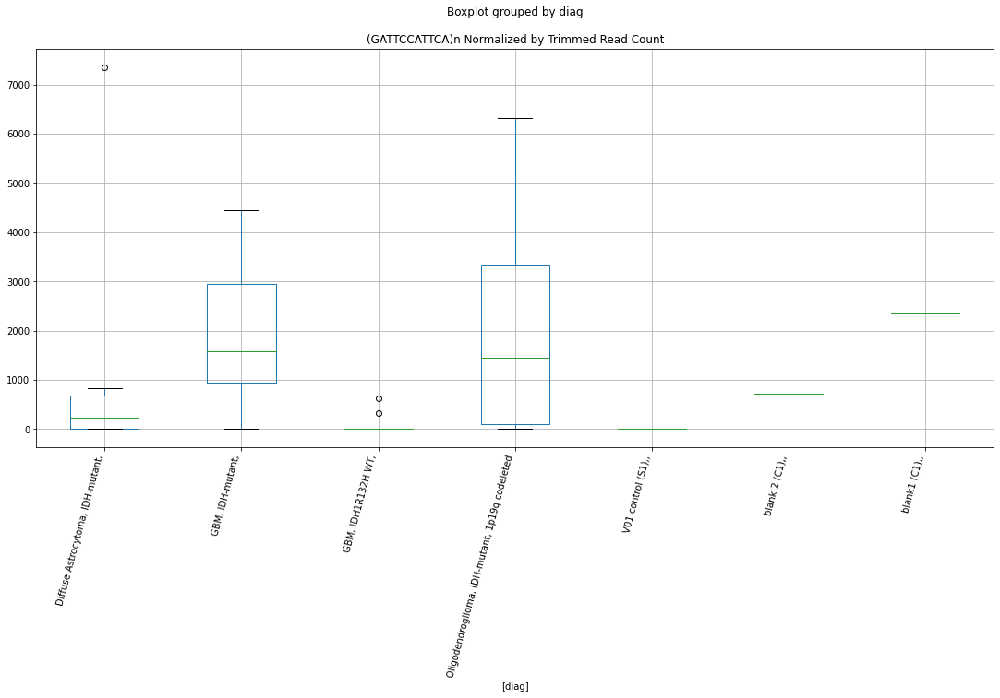

 p : 0.0010767599617041183  ( t : 3.8884574424207785 ) :  D-plex  :  bbduk2  :  LTR55
Control and blanks
73     5411.06
337       0.00
Name: LTR55, dtype: float64
205    8954.55
Name: LTR55, dtype: float64
469    5915.27
Name: LTR55, dtype: float64


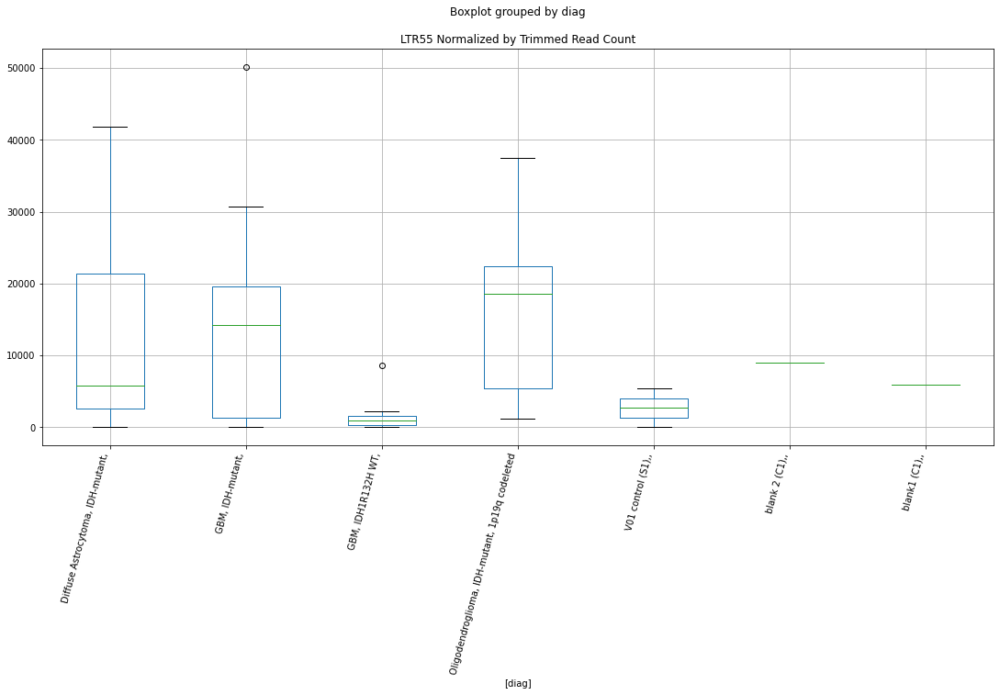

 p : 0.0013566107892309593  ( t : 3.7847864130305315 ) :  D-plex  :  cutadapt2  :  (TTTTTA)n
Control and blanks
76        0.00
340    5284.39
Name: (TTTTTA)n, dtype: float64
208    1058.16
Name: (TTTTTA)n, dtype: float64
472    1155.91
Name: (TTTTTA)n, dtype: float64


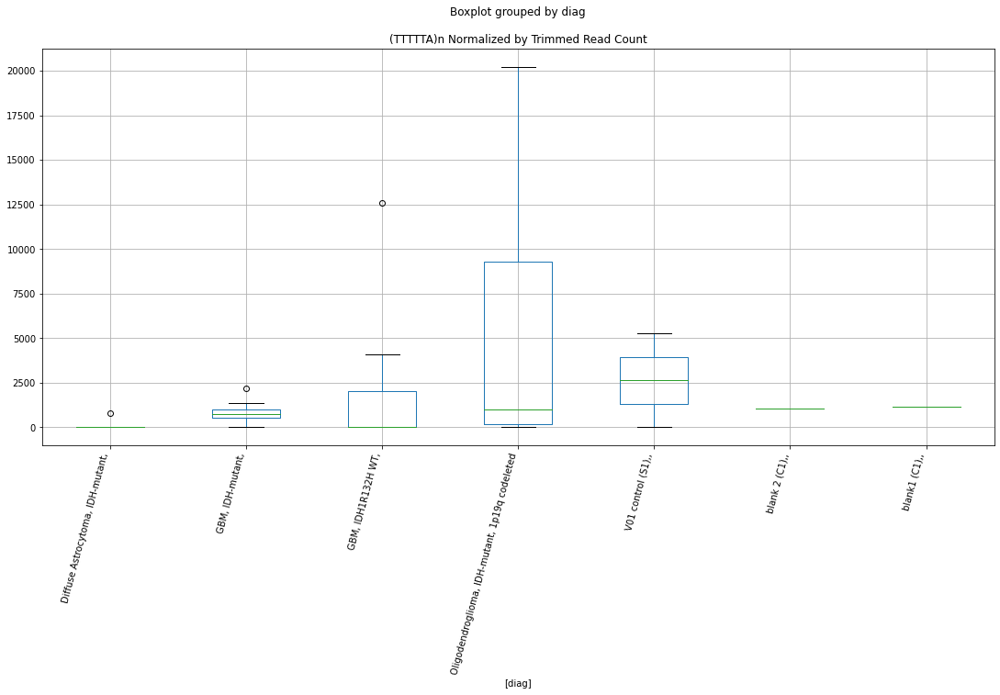

 p : 0.001432382212267752  ( t : 3.7603949332363316 ) :  D-plex  :  cutadapt2  :  LTR55
Control and blanks
76     6818.53
340       0.00
Name: LTR55, dtype: float64
208    9876.17
Name: LTR55, dtype: float64
472    5779.56
Name: LTR55, dtype: float64


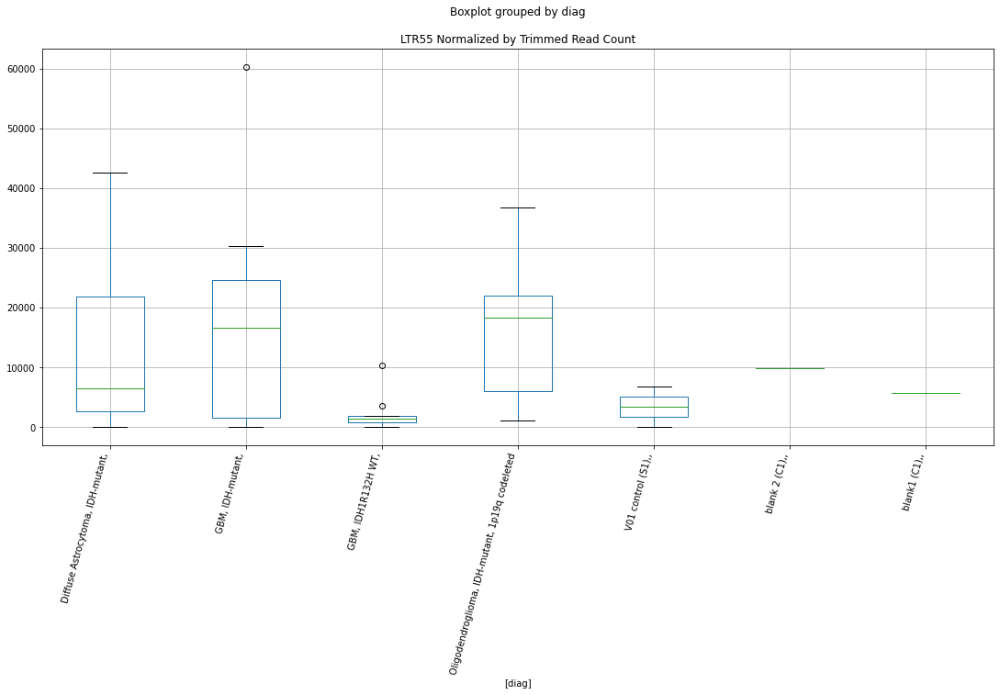

 p : 0.0015457098455486464  ( t : 3.7262168022697137 ) :  D-plex  :  bbduk2  :  MER57B2
Control and blanks
73     38650.42
337        0.00
Name: MER57B2, dtype: float64
205    16476.37
Name: MER57B2, dtype: float64
469    18928.87
Name: MER57B2, dtype: float64


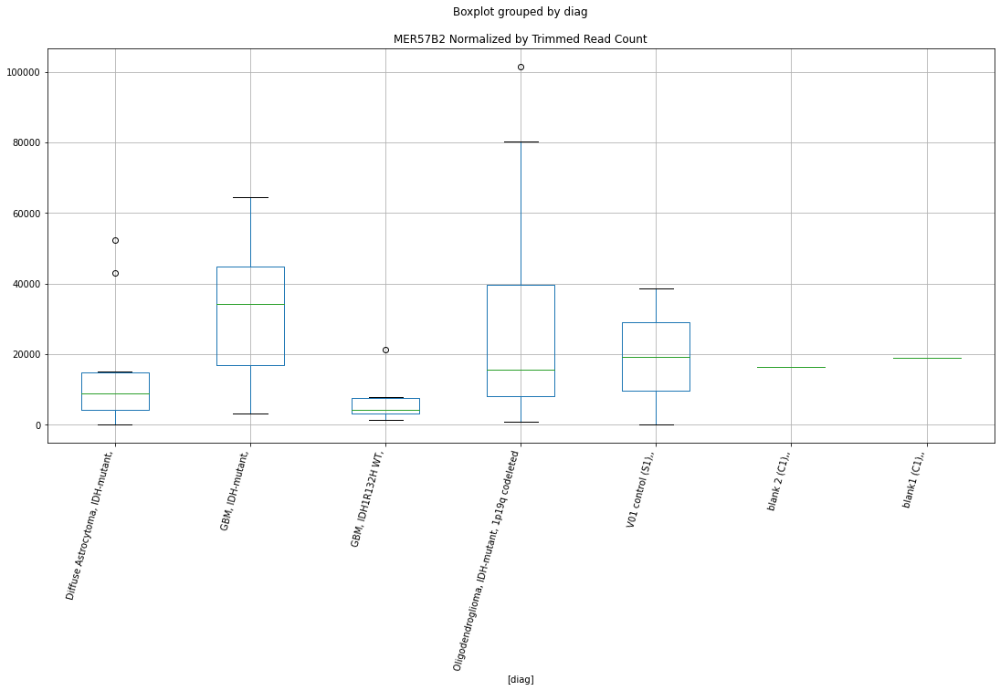

 p : 0.0020663332839156367  ( t : 3.5958177360221675 ) :  D-plex  :  bbduk2  :  Charlie5
Control and blanks
73     25509.28
337    34716.13
Name: Charlie5, dtype: float64
205    20237.28
Name: Charlie5, dtype: float64
469    23661.09
Name: Charlie5, dtype: float64


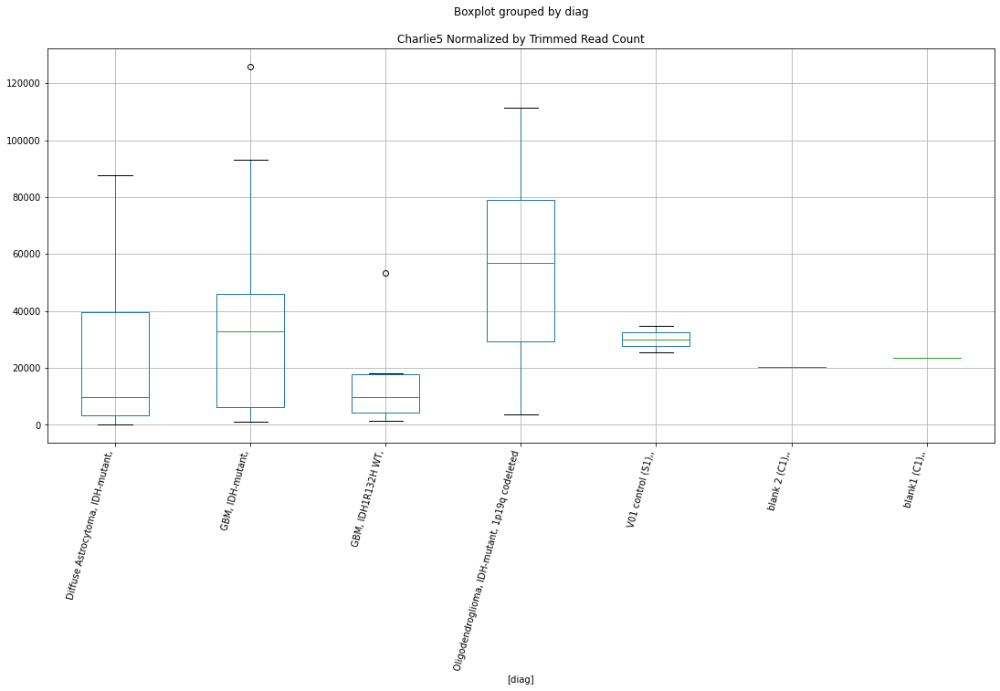

 p : 0.0021473121364629613  ( t : 3.5785333692792833 ) :  D-plex  :  bbduk2  :  (GTG)n
Control and blanks
73     0.0
337    0.0
Name: (GTG)n, dtype: float64
205    3760.91
Name: (GTG)n, dtype: float64
469    2957.64
Name: (GTG)n, dtype: float64


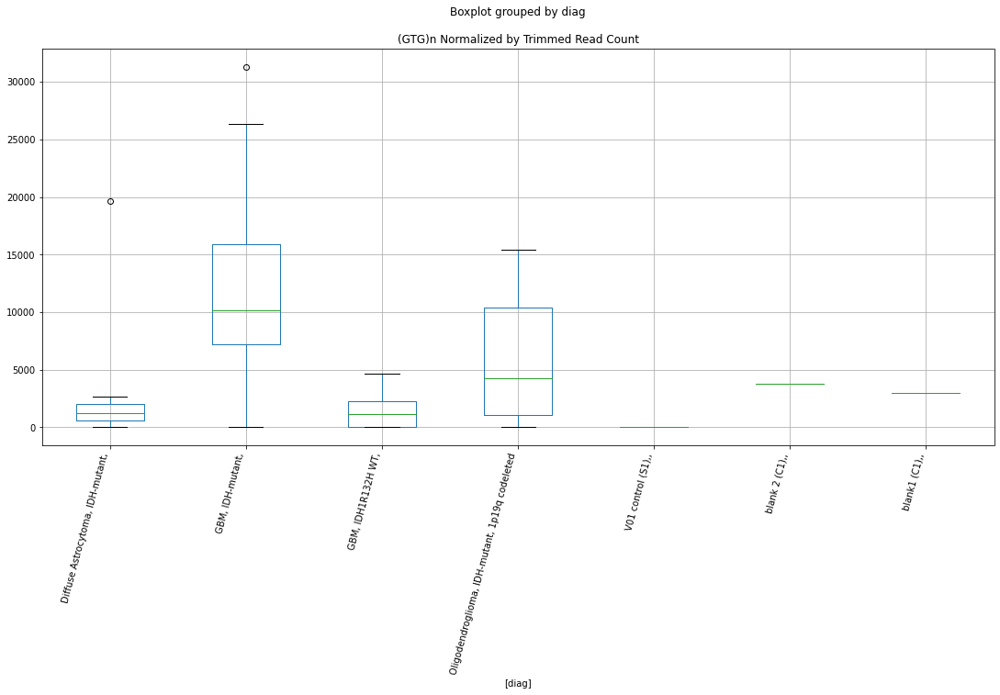

 p : 0.0022988317125309733  ( t : 3.547863211540628 ) :  D-plex  :  bbduk2  :  (GTGATC)n
Control and blanks
73       0.00
337    890.16
Name: (GTGATC)n, dtype: float64
205    18088.19
Name: (GTGATC)n, dtype: float64
469    1183.05
Name: (GTGATC)n, dtype: float64


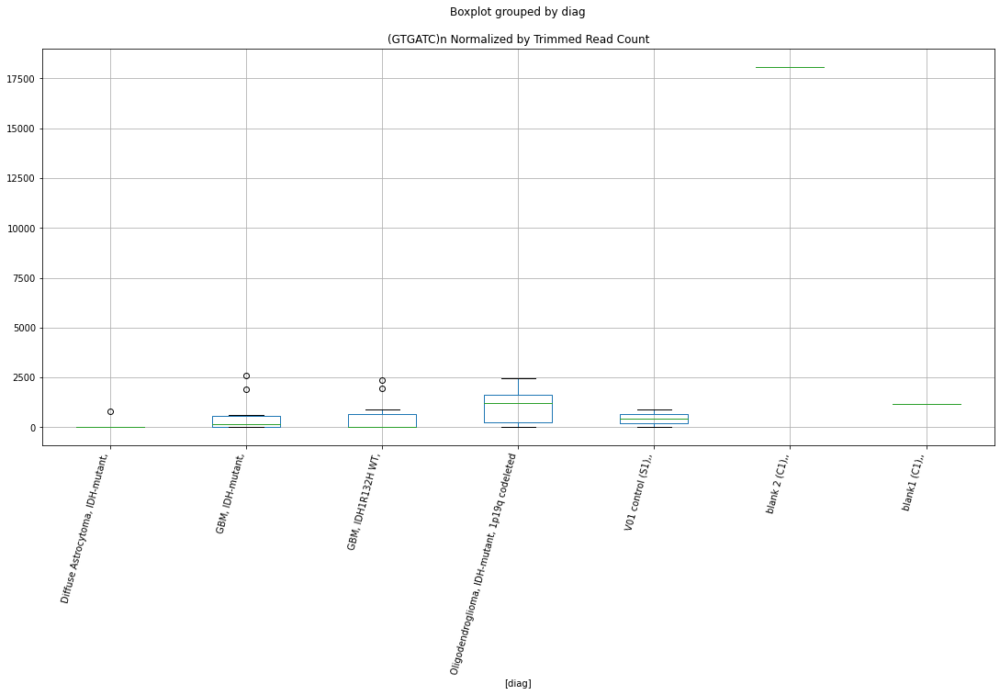

 p : 0.002305791925108369  ( t : 3.5465029679903735 ) :  D-plex  :  cutadapt2  :  MER57B2
Control and blanks
76     37880.71
340        0.00
Name: MER57B2, dtype: float64
208    17636.02
Name: MER57B2, dtype: float64
472    16760.72
Name: MER57B2, dtype: float64


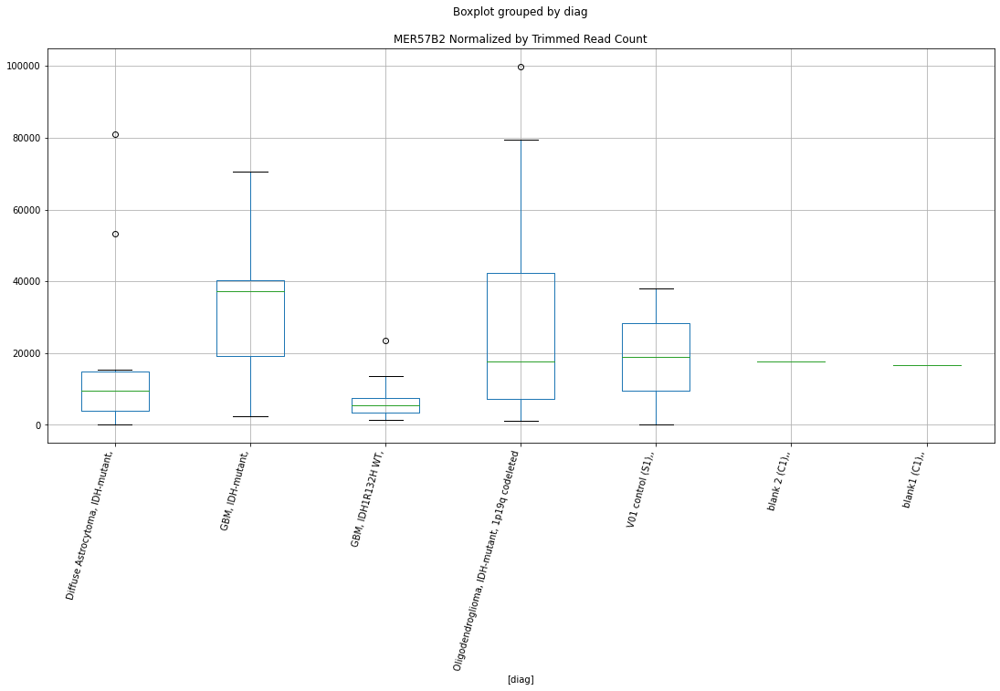

 p : 0.002338278480819397  ( t : 3.540207451597514 ) :  D-plex  :  cutadapt2  :  MER61E
Control and blanks
76     757.61
340    880.73
Name: MER61E, dtype: float64
208    4938.09
Name: MER61E, dtype: float64
472    6357.51
Name: MER61E, dtype: float64


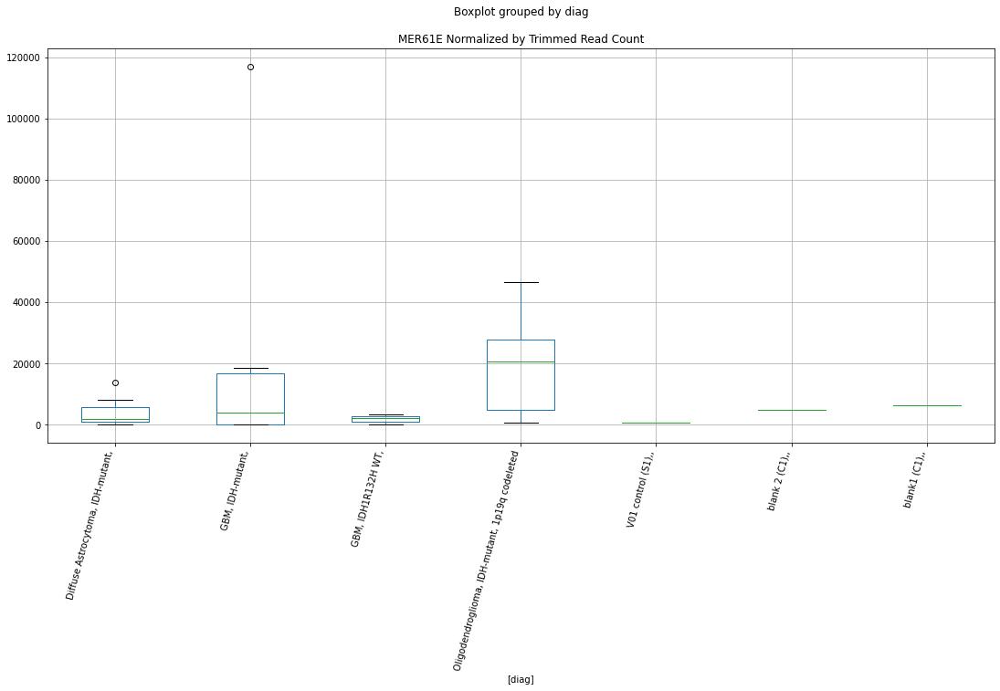

 p : 0.0023992932982546747  ( t : 3.528614392210094 ) :  D-plex  :  bbduk2  :  MamRep1879
Control and blanks
73       773.01
337    11572.04
Name: MamRep1879, dtype: float64
205    12894.55
Name: MamRep1879, dtype: float64
469    13605.13
Name: MamRep1879, dtype: float64


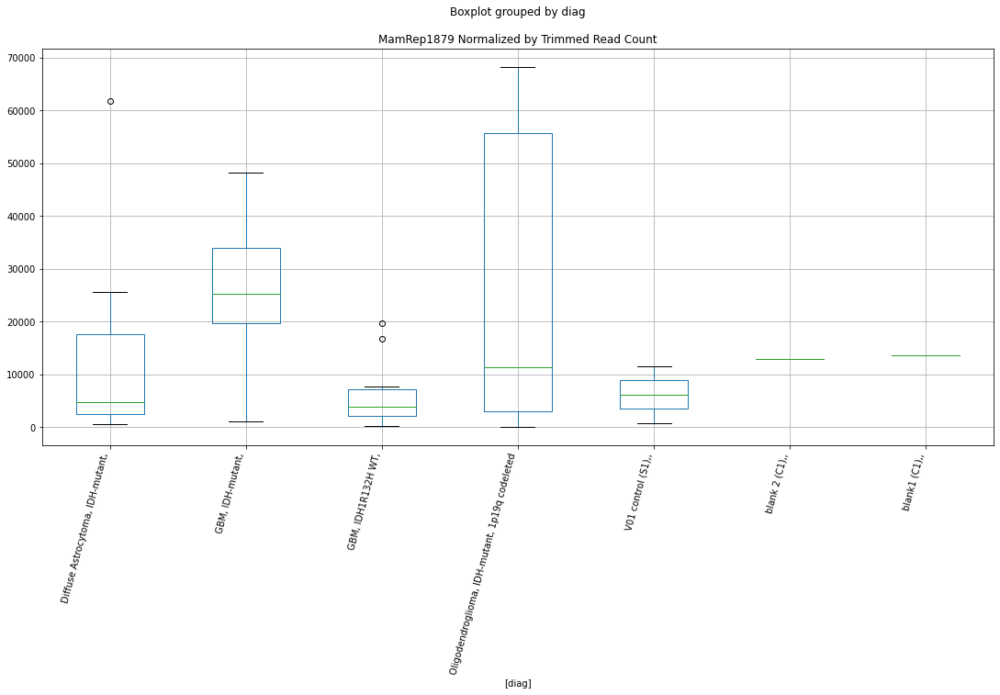

 p : 0.0026720126283516906  ( t : 3.480132209290804 ) :  D-plex  :  bbduk2  :  (CCCTAA)n
Control and blanks
73     1546.02
337       0.00
Name: (CCCTAA)n, dtype: float64
205    2328.18
Name: (CCCTAA)n, dtype: float64
469    3549.16
Name: (CCCTAA)n, dtype: float64


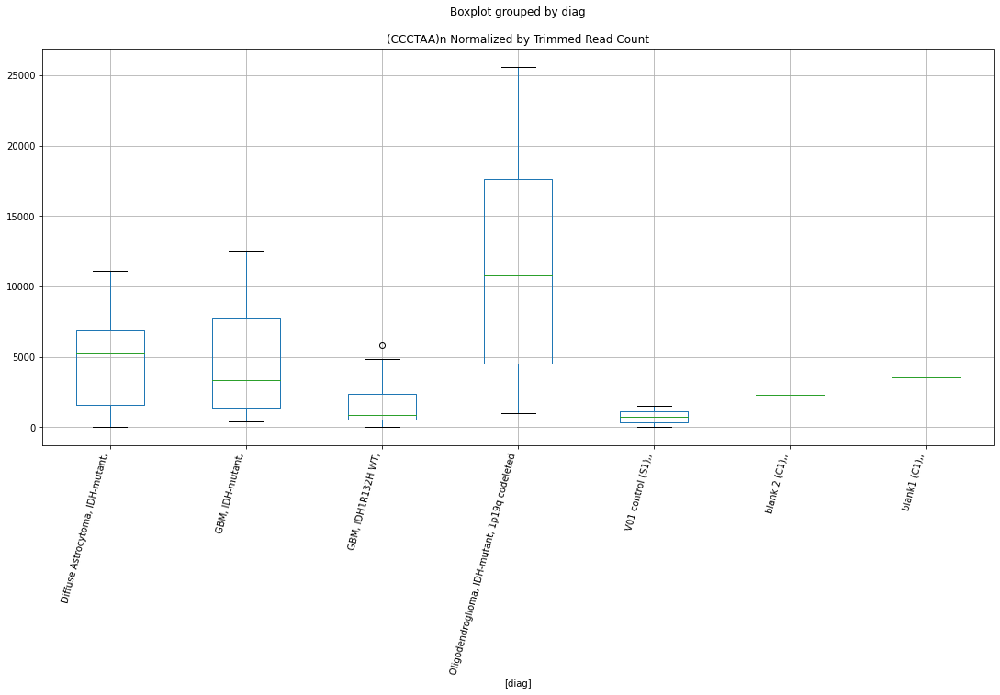

 p : 0.0029663475137361285  ( t : 3.433019661281326 ) :  D-plex  :  bbduk2  :  MER61E
Control and blanks
73     773.01
337    890.16
Name: MER61E, dtype: float64
205    5014.55
Name: MER61E, dtype: float64
469    5323.75
Name: MER61E, dtype: float64


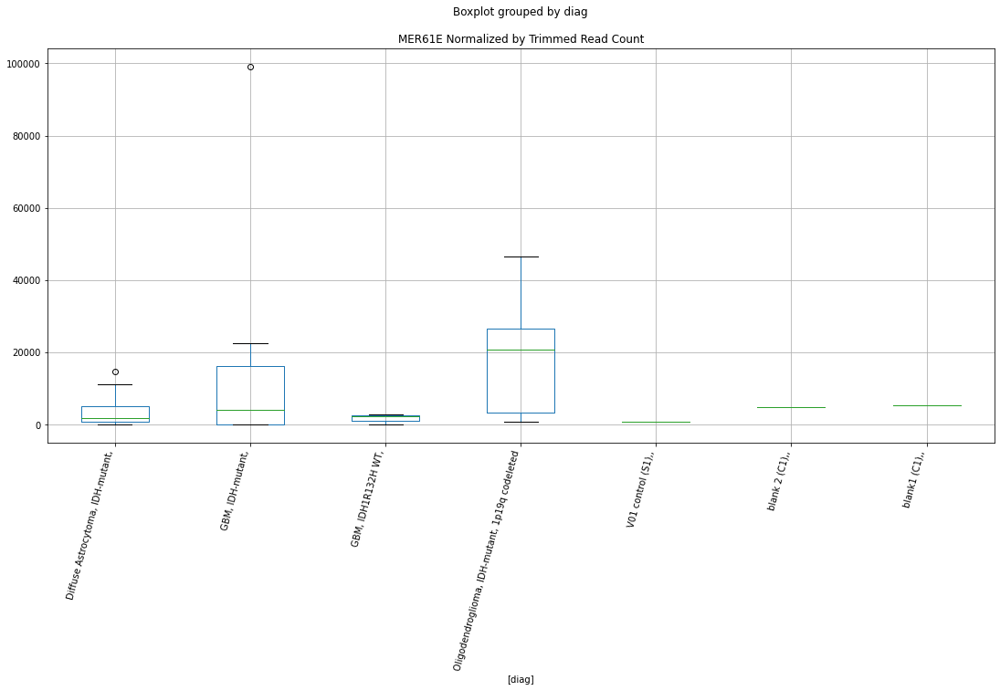

 p : 0.0034855954626945786  ( t : 3.3601757470171405 ) :  D-plex  :  cutadapt2  :  (TGT)n
Control and blanks
76     3030.46
340    1761.46
Name: (TGT)n, dtype: float64
208    3527.2
Name: (TGT)n, dtype: float64
472    4045.69
Name: (TGT)n, dtype: float64


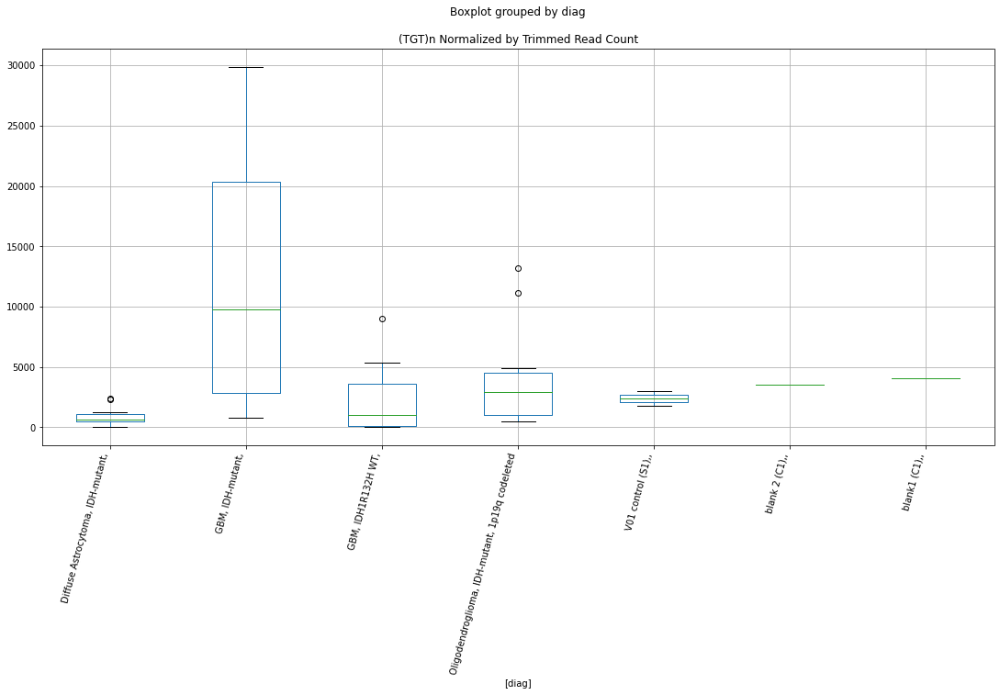

 p : 0.003608353937611461  ( t : 3.344523779325565 ) :  D-plex  :  cutadapt2  :  MamRep1879
Control and blanks
76       757.61
340    11449.52
Name: MamRep1879, dtype: float64
208    17459.66
Name: MamRep1879, dtype: float64
472    15026.85
Name: MamRep1879, dtype: float64


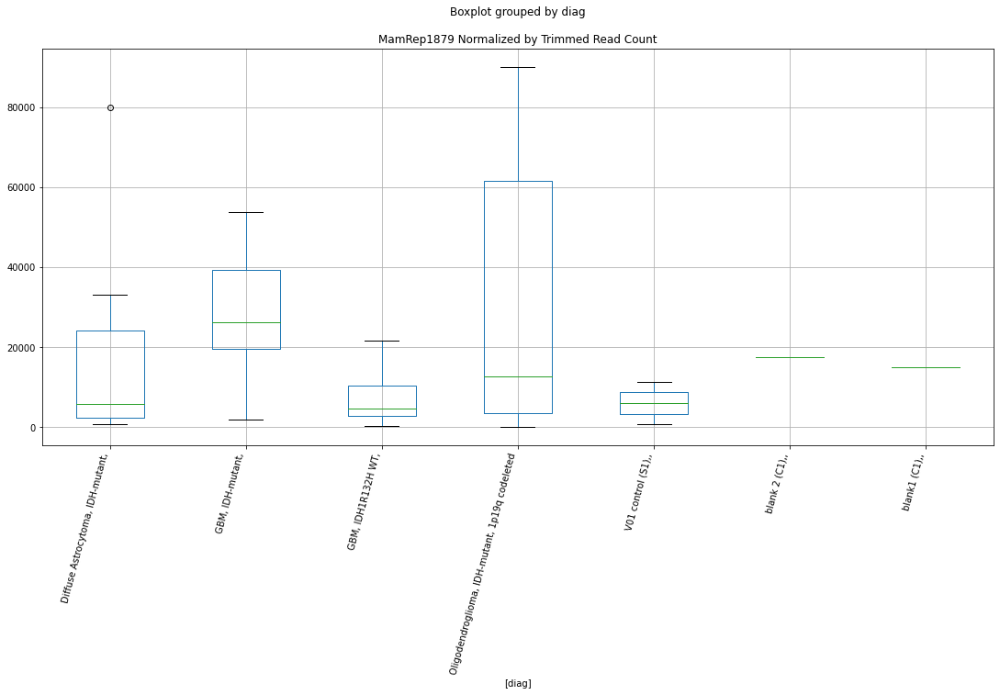

 p : 0.003704493698558421  ( t : 3.332627701520436 ) :  D-plex  :  bbduk2  :  (TTTTT)n
Control and blanks
73     0.0
337    0.0
Name: (TTTTT)n, dtype: float64
205    537.27
Name: (TTTTT)n, dtype: float64
469    0.0
Name: (TTTTT)n, dtype: float64


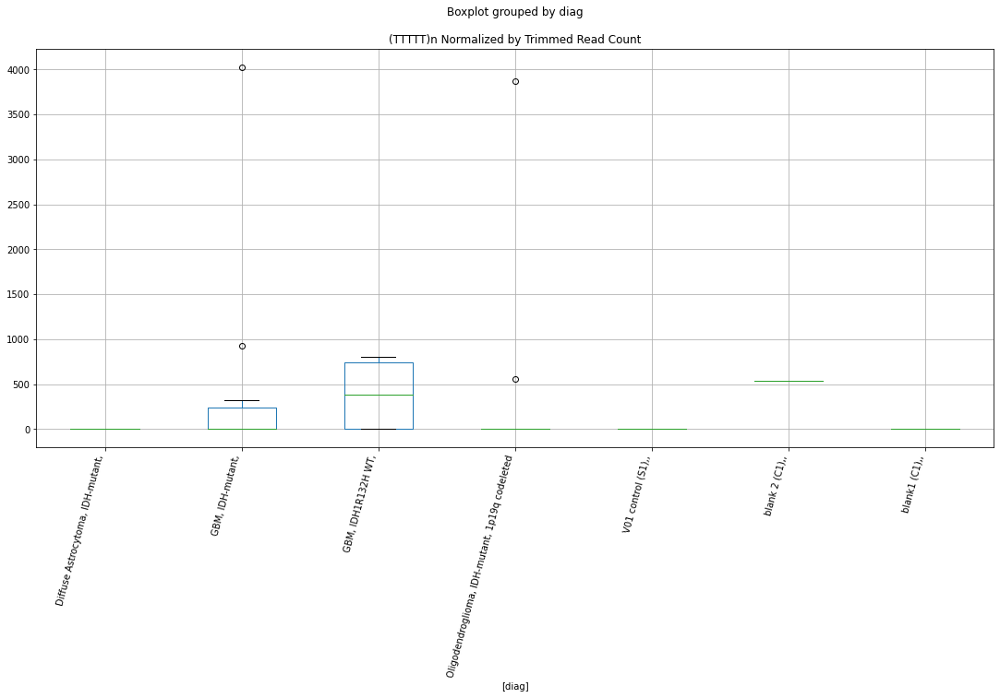

 p : 0.0038056833741707667  ( t : 3.320430647130948 ) :  D-plex  :  cutadapt2  :  Charlie5
Control and blanks
76     25001.27
340    23779.77
Name: Charlie5, dtype: float64
208    22221.39
Name: Charlie5, dtype: float64
472    26585.97
Name: Charlie5, dtype: float64


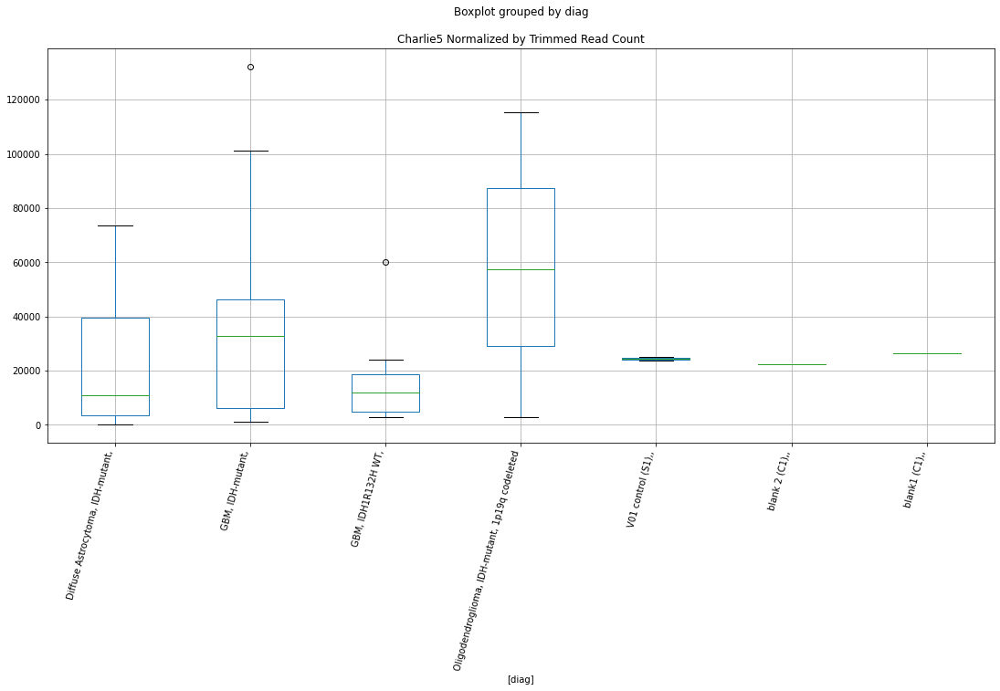

 p : 0.0038342954477990497  ( t : 3.317039700048338 ) :  D-plex  :  bbduk2  :  LTR40b
Control and blanks
73     37877.41
337      890.16
Name: LTR40b, dtype: float64
205    16476.37
Name: LTR40b, dtype: float64
469    15379.71
Name: LTR40b, dtype: float64


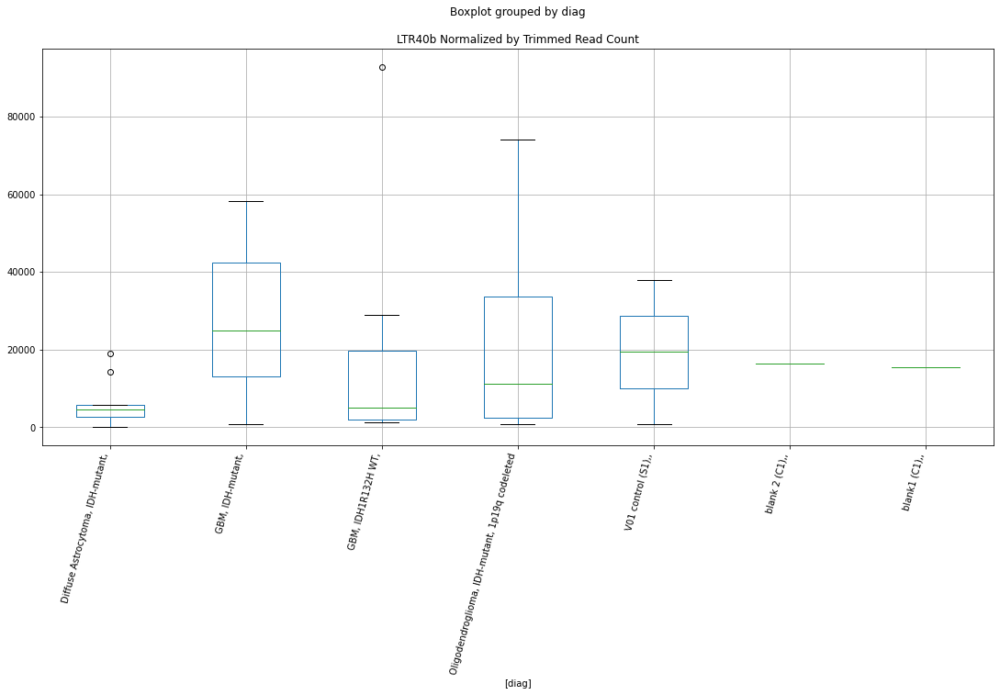

 p : 0.003994458547199175  ( t : 3.298505916478889 ) :  D-plex  :  cutadapt2  :  (GTG)n
Control and blanks
76     757.61
340      0.00
Name: (GTG)n, dtype: float64
208    3879.92
Name: (GTG)n, dtype: float64
472    3467.74
Name: (GTG)n, dtype: float64


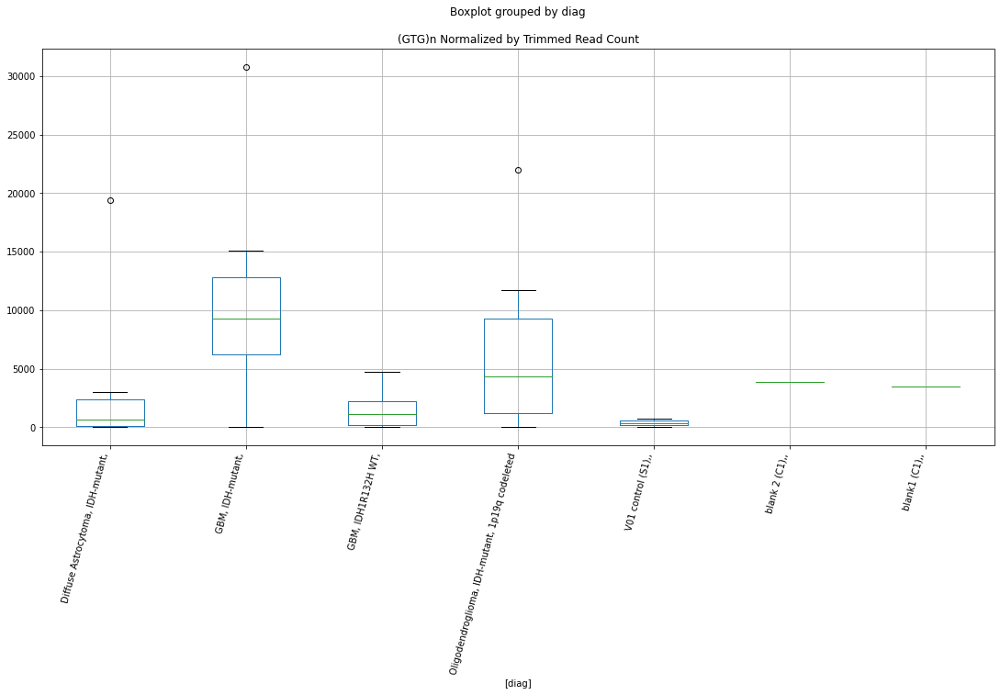

 p : 0.0040418466142711565  ( t : 3.2931622146073423 ) :  D-plex  :  cutadapt2  :  (TTTTT)n
Control and blanks
76     0.0
340    0.0
Name: (TTTTT)n, dtype: float64
208    1058.16
Name: (TTTTT)n, dtype: float64
472    577.96
Name: (TTTTT)n, dtype: float64


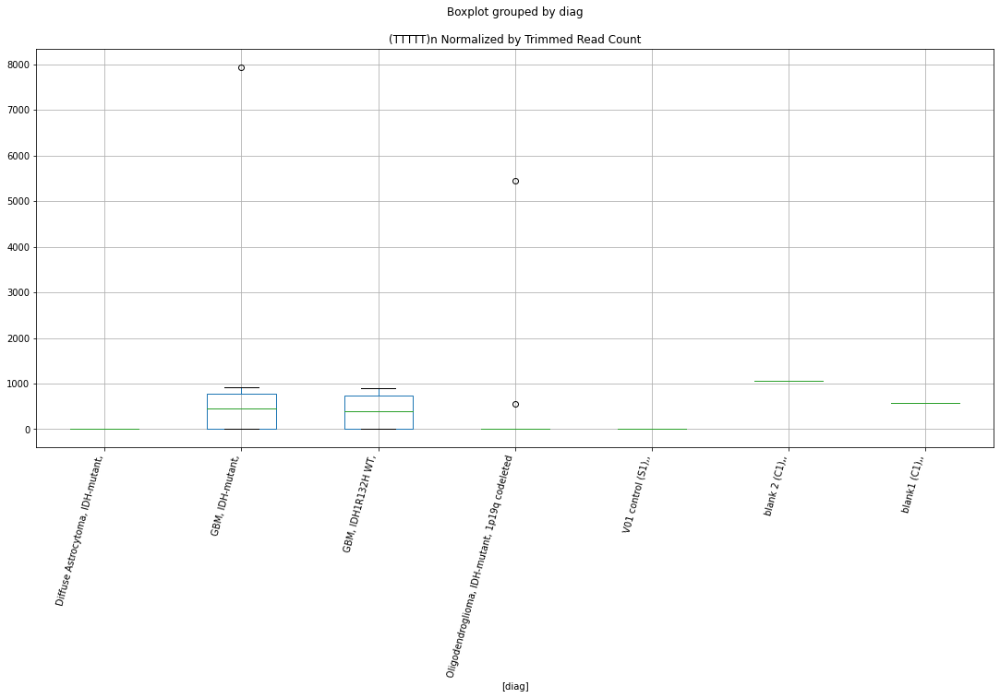

 p : 0.004116296564322154  ( t : 3.2848900117808384 ) :  D-plex  :  bbduk2  :  MER135
Control and blanks
73     0.0
337    0.0
Name: MER135, dtype: float64
205    3402.73
Name: MER135, dtype: float64
469    3549.16
Name: MER135, dtype: float64


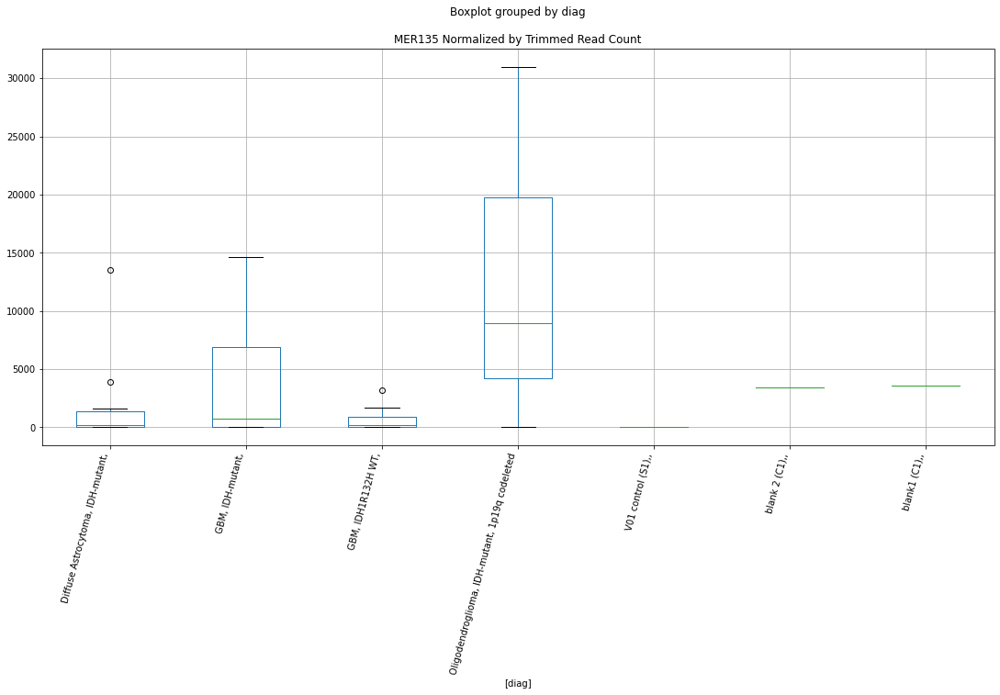

 p : 0.00411896379310143  ( t : 3.284596388984352 ) :  D-plex  :  bbduk2  :  Charlie30a
Control and blanks
73      773.01
337    3560.63
Name: Charlie30a, dtype: float64
205    6626.37
Name: Charlie30a, dtype: float64
469    4140.69
Name: Charlie30a, dtype: float64


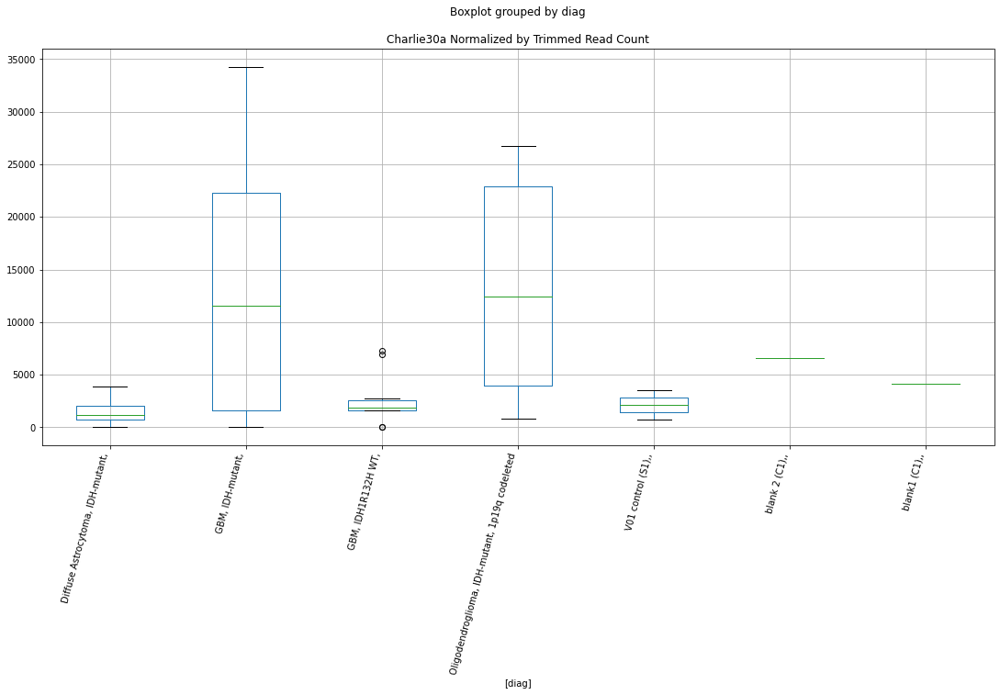

 p : 0.004280671546946601  ( t : 3.2671349381526023 ) :  D-plex  :  cutadapt2  :  LTR88c
Control and blanks
76       757.61
340    30825.62
Name: LTR88c, dtype: float64
208    10405.25
Name: LTR88c, dtype: float64
472    11559.12
Name: LTR88c, dtype: float64


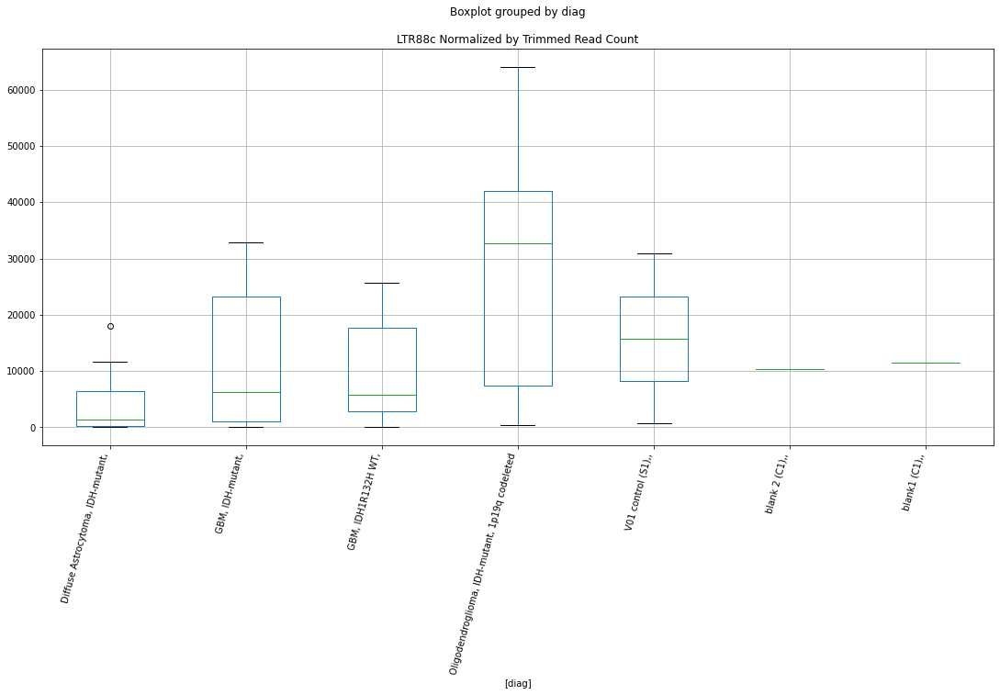

 p : 0.004403111934737384  ( t : 3.2543393321920635 ) :  D-plex  :  cutadapt2  :  LTR19B
Control and blanks
76     1515.23
340       0.00
Name: LTR19B, dtype: float64
208    9170.73
Name: LTR19B, dtype: float64
472    3467.74
Name: LTR19B, dtype: float64


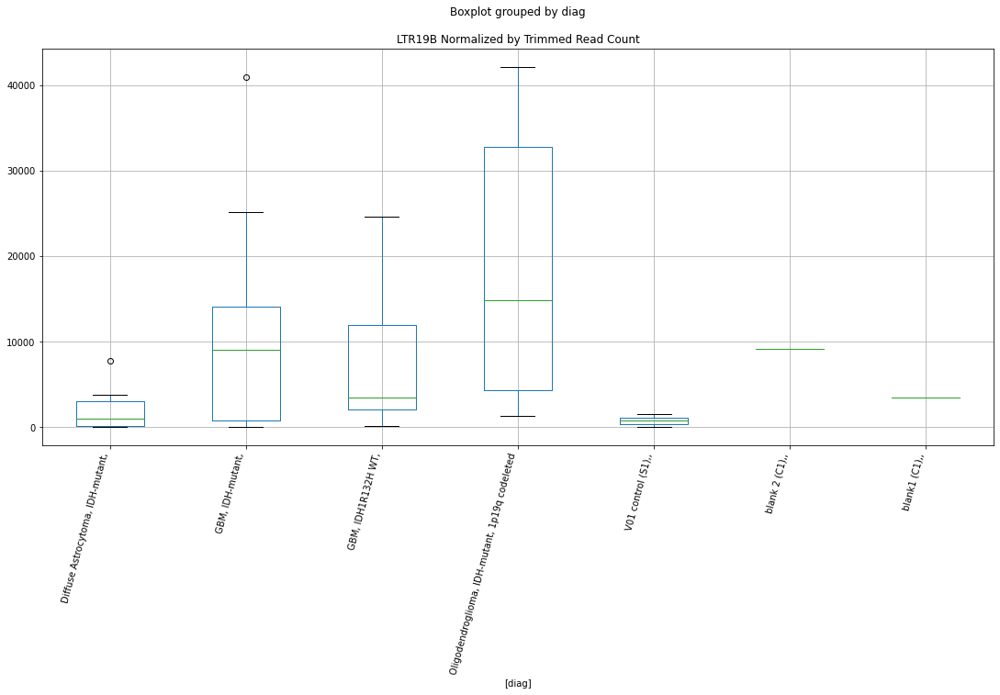

 p : 0.004481365756180244  ( t : 3.246343112614559 ) :  D-plex  :  cutadapt2  :  MER68
Control and blanks
76      6060.91
340    54605.39
Name: MER68, dtype: float64
208    34213.88
Name: MER68, dtype: float64
472    36989.17
Name: MER68, dtype: float64


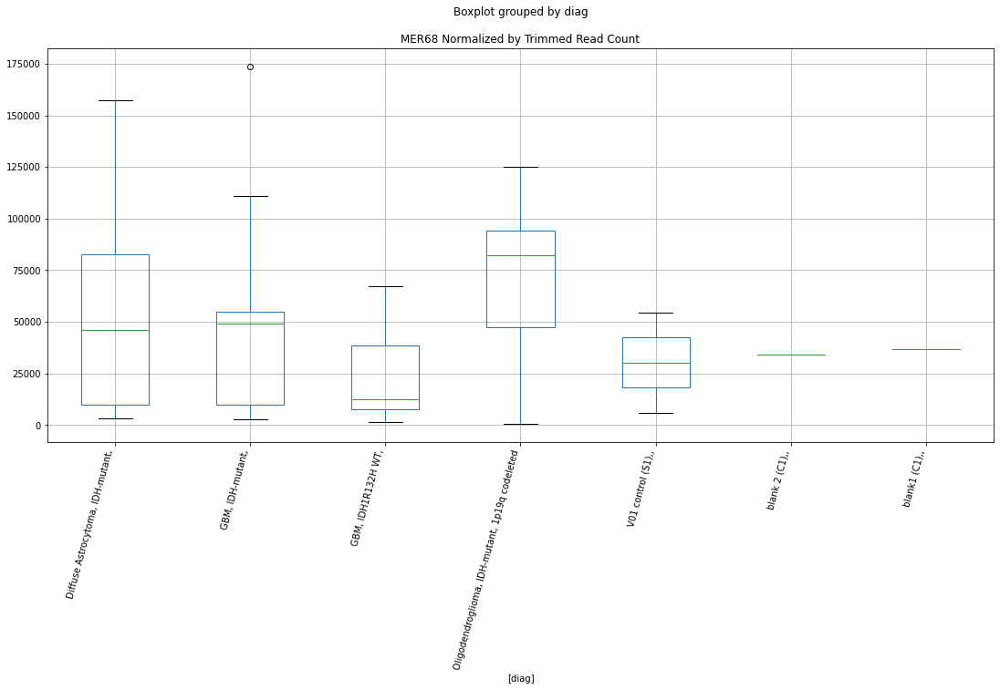

 p : 0.00451853338102758  ( t : 3.242593081865459 ) :  D-plex  :  bbduk2  :  LTR19B
Control and blanks
73     1546.02
337       0.00
Name: LTR19B, dtype: float64
205    8417.27
Name: LTR19B, dtype: float64
469    3549.16
Name: LTR19B, dtype: float64


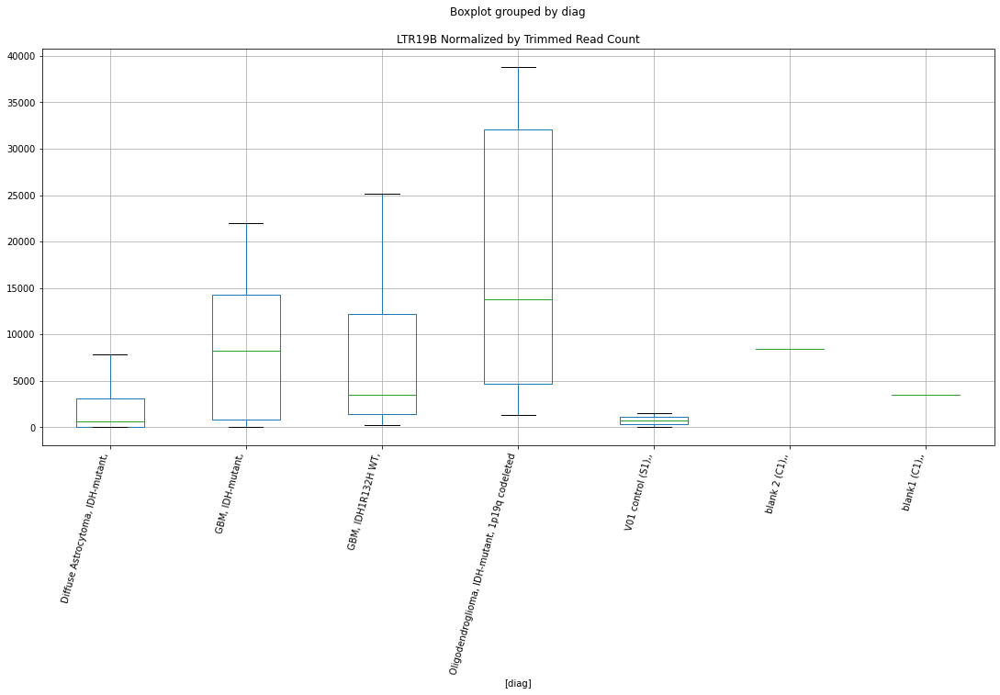

 p : 0.004568105038703879  ( t : 3.237638367176291 ) :  D-plex  :  bbduk2  :  MER68
Control and blanks
73      5411.06
337    56079.91
Name: MER68, dtype: float64
205    34027.28
Name: MER68, dtype: float64
469    36083.17
Name: MER68, dtype: float64


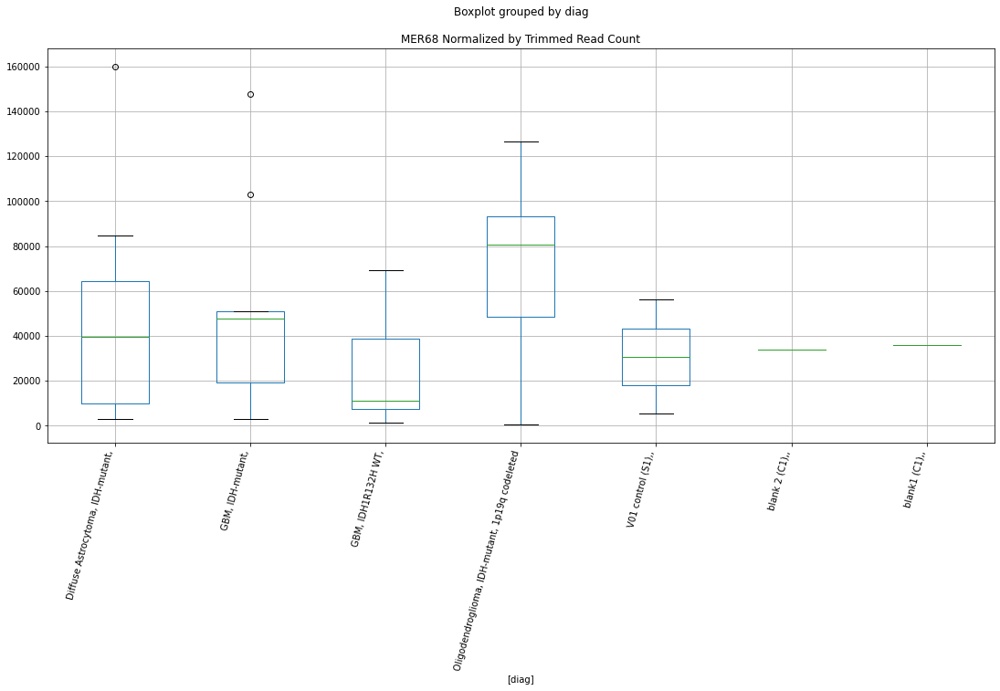

 p : 0.0048243869310125535  ( t : 3.212835324336978 ) :  Lexogen  :  cutadapt2  :  (TTCC)n
Control and blanks
82     1420.05
346     210.43
Name: (TTCC)n, dtype: float64
214    271.23
Name: (TTCC)n, dtype: float64
478    237.46
Name: (TTCC)n, dtype: float64


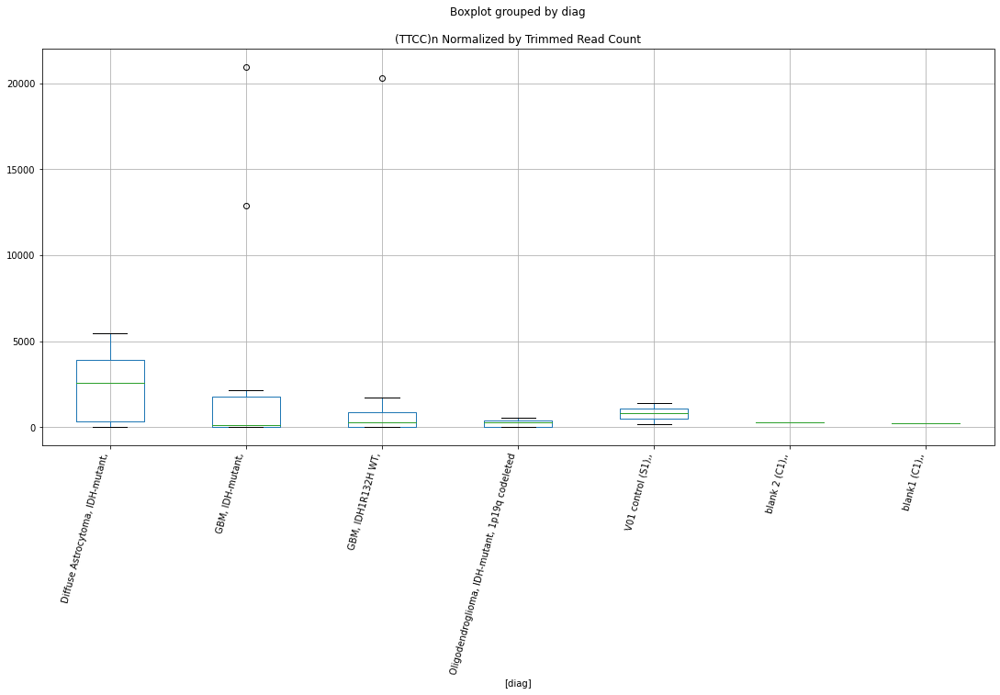

 p : 0.0053570023144256995  ( t : 3.1651736237050785 ) :  D-plex  :  cutadapt2  :  Tigger9b
Control and blanks
76     2272.84
340    5284.39
Name: Tigger9b, dtype: float64
208    8112.57
Name: Tigger9b, dtype: float64
472    13870.94
Name: Tigger9b, dtype: float64


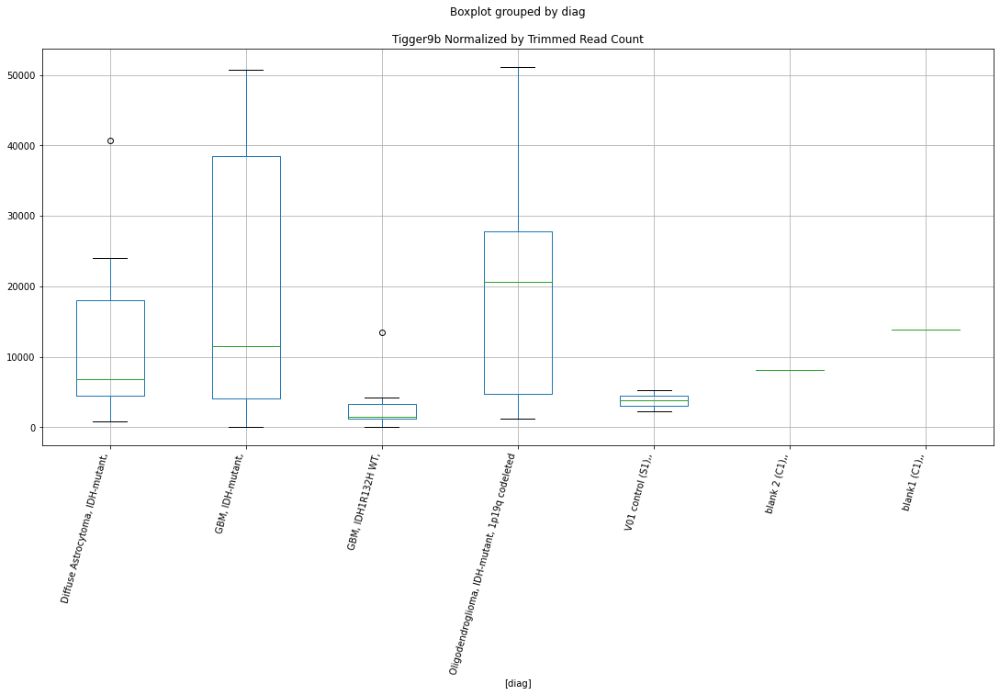

 p : 0.005503523023780439  ( t : 3.1528749936487617 ) :  D-plex  :  bbduk2  :  LTR88c
Control and blanks
73       773.01
337    31155.50
Name: LTR88c, dtype: float64
205    9491.82
Name: LTR88c, dtype: float64
469    11239.02
Name: LTR88c, dtype: float64


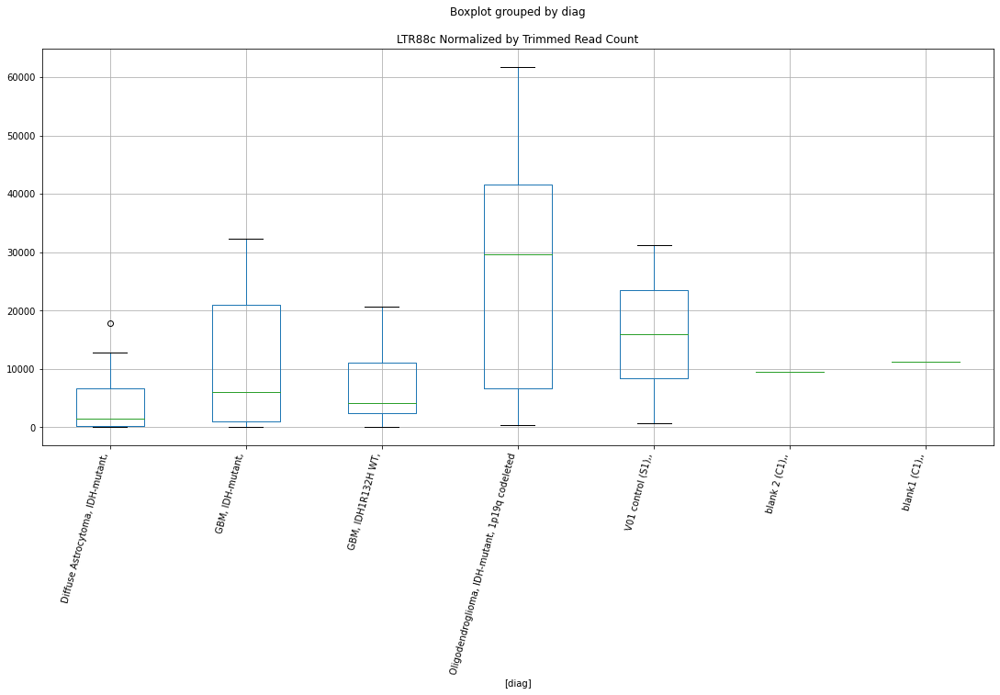

 p : 0.005649128064031694  ( t : 3.14096628195866 ) :  D-plex  :  bbduk2  :  (TGGAGTGGAA)n
Control and blanks
73     4638.05
337       0.00
Name: (TGGAGTGGAA)n, dtype: float64
205    7163.64
Name: (TGGAGTGGAA)n, dtype: float64
469    5323.75
Name: (TGGAGTGGAA)n, dtype: float64


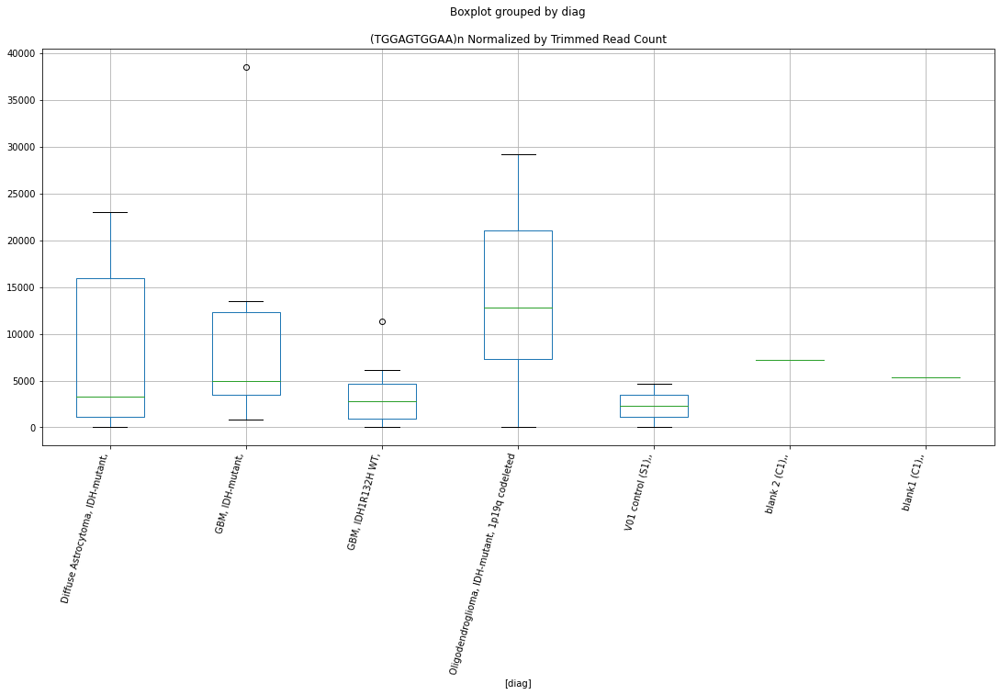

 p : 0.005933230957078631  ( t : 3.1185694979806895 ) :  D-plex  :  cutadapt2  :  LTR86A1
Control and blanks
76      2272.84
340    20256.84
Name: LTR86A1, dtype: float64
208    11639.77
Name: LTR86A1, dtype: float64
472    8091.38
Name: LTR86A1, dtype: float64


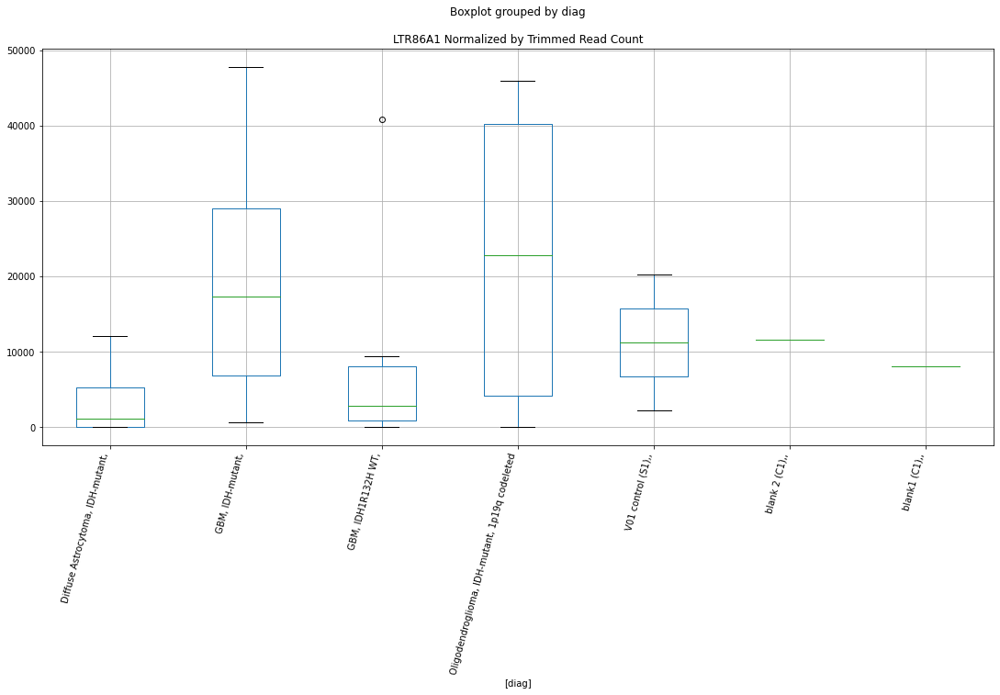

 p : 0.006202019923930593  ( t : 3.098323525420472 ) :  D-plex  :  bbduk2  :  (TGT)n
Control and blanks
73     1546.02
337    1780.31
Name: (TGT)n, dtype: float64
205    3223.64
Name: (TGT)n, dtype: float64
469    2366.11
Name: (TGT)n, dtype: float64


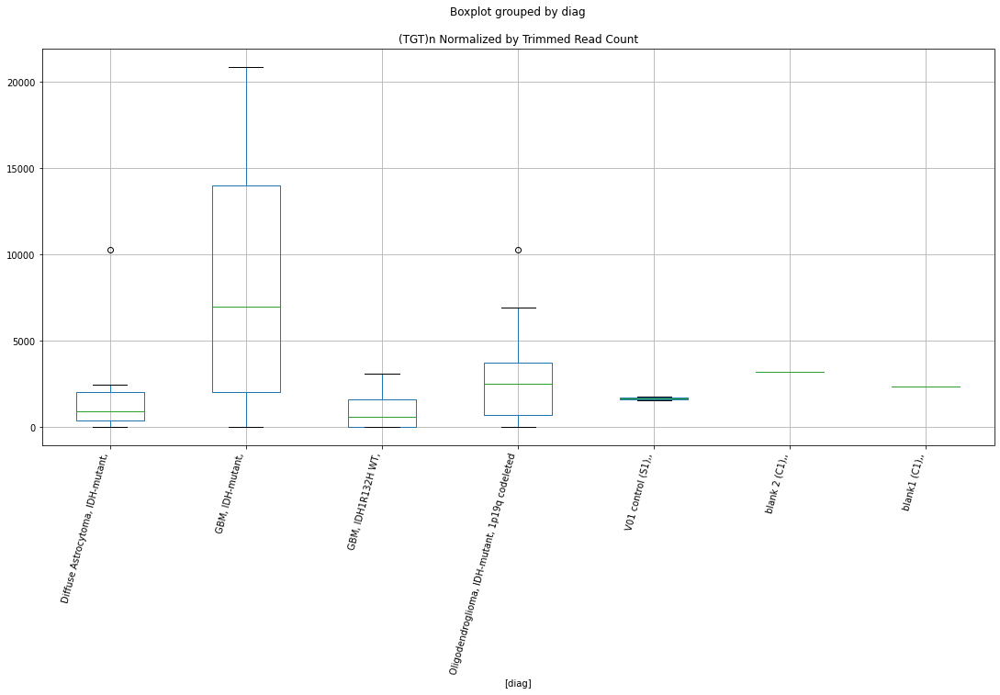

 p : 0.006423183807887235  ( t : 3.0822965474526343 ) :  D-plex  :  cutadapt2  :  LTR85a
Control and blanks
76      3030.46
340    19376.11
Name: LTR85a, dtype: float64
208    20634.15
Name: LTR85a, dtype: float64
472    14448.9
Name: LTR85a, dtype: float64


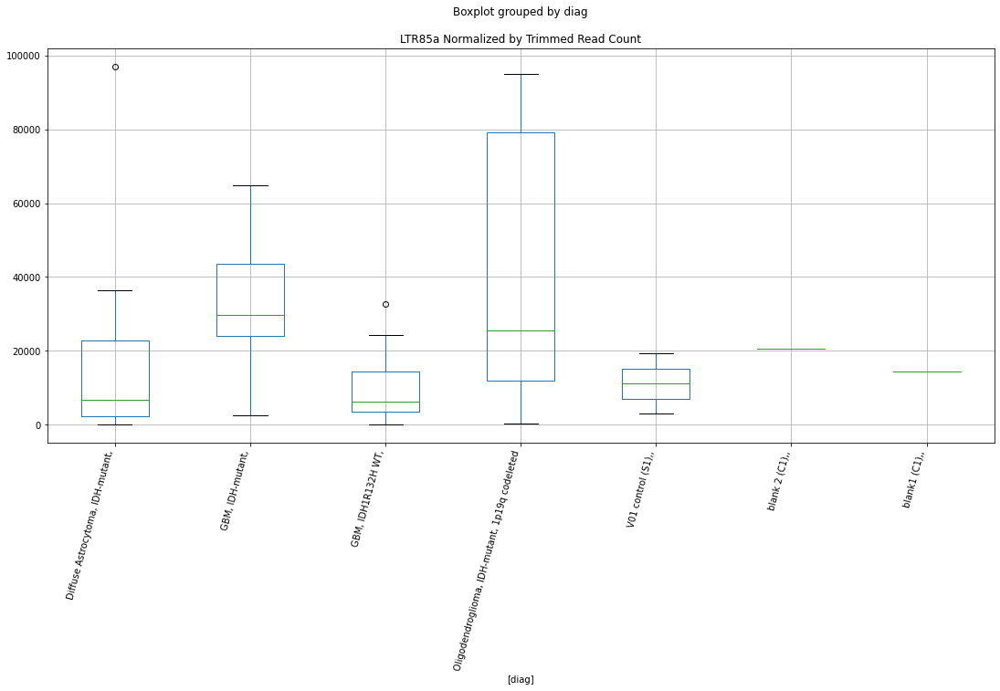

 p : 0.0064738416575174885  ( t : 3.0787013173509283 ) :  D-plex  :  cutadapt2  :  Charlie30a
Control and blanks
76      757.61
340    3522.93
Name: Charlie30a, dtype: float64
208    7230.77
Name: Charlie30a, dtype: float64
472    4623.65
Name: Charlie30a, dtype: float64


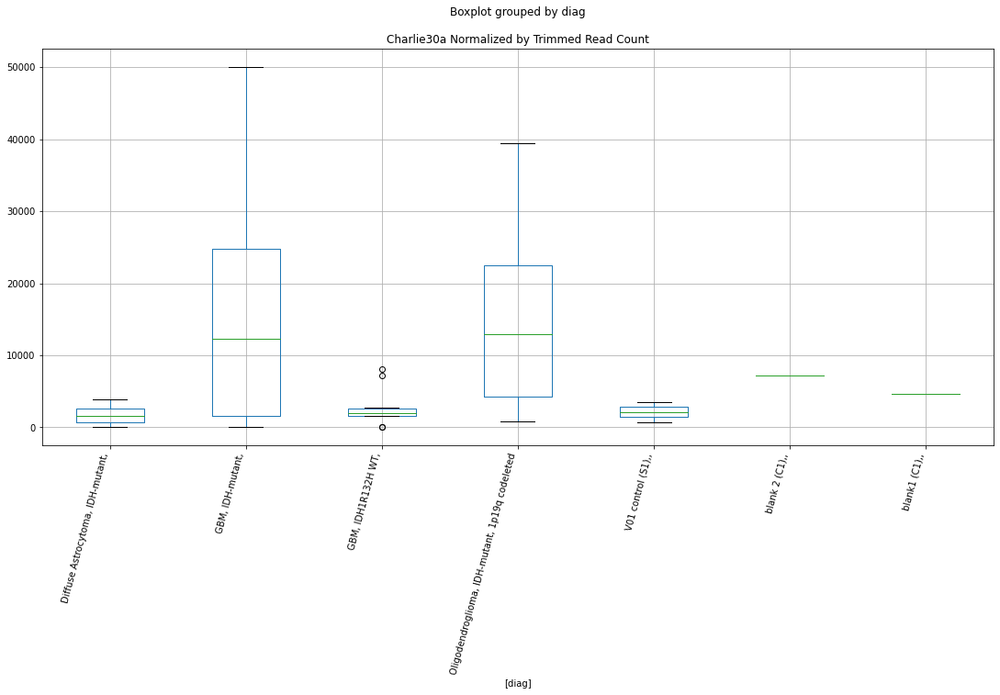

 p : 0.006670036896005466  ( t : 3.065031088523491 ) :  D-plex  :  bbduk2  :  Tigger9b
Control and blanks
73     2319.03
337    5340.94
Name: Tigger9b, dtype: float64
205    7521.82
Name: Tigger9b, dtype: float64
469    12422.07
Name: Tigger9b, dtype: float64


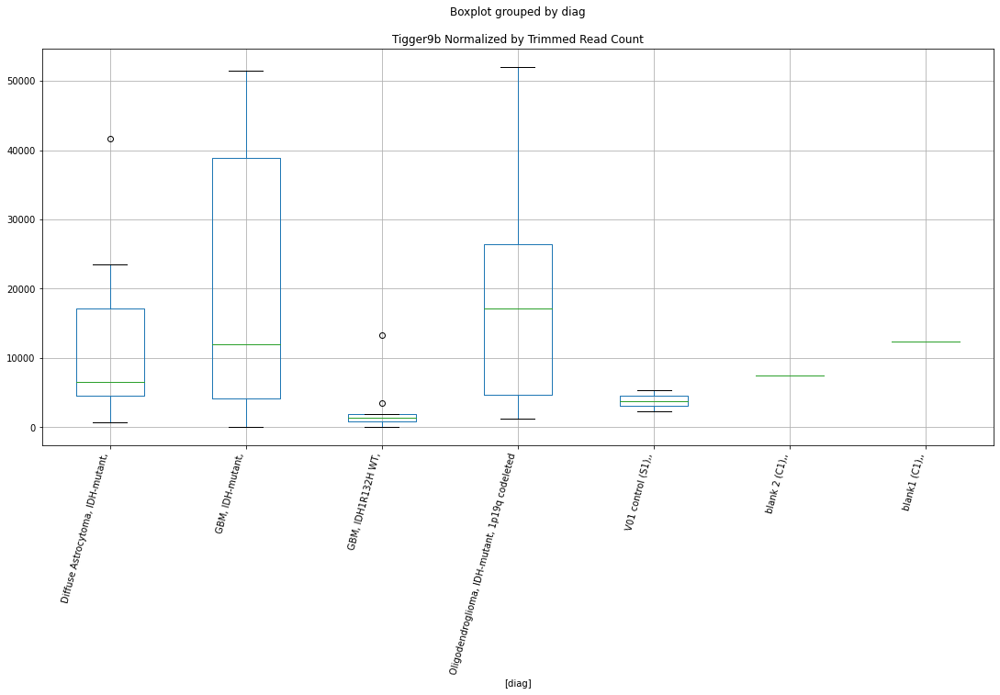

 p : 0.007249094171718801  ( t : 3.0268548956531234 ) :  D-plex  :  cutadapt2  :  MER61E
Control and blanks
76     757.61
340    880.73
Name: MER61E, dtype: float64
208    4938.09
Name: MER61E, dtype: float64
472    6357.51
Name: MER61E, dtype: float64


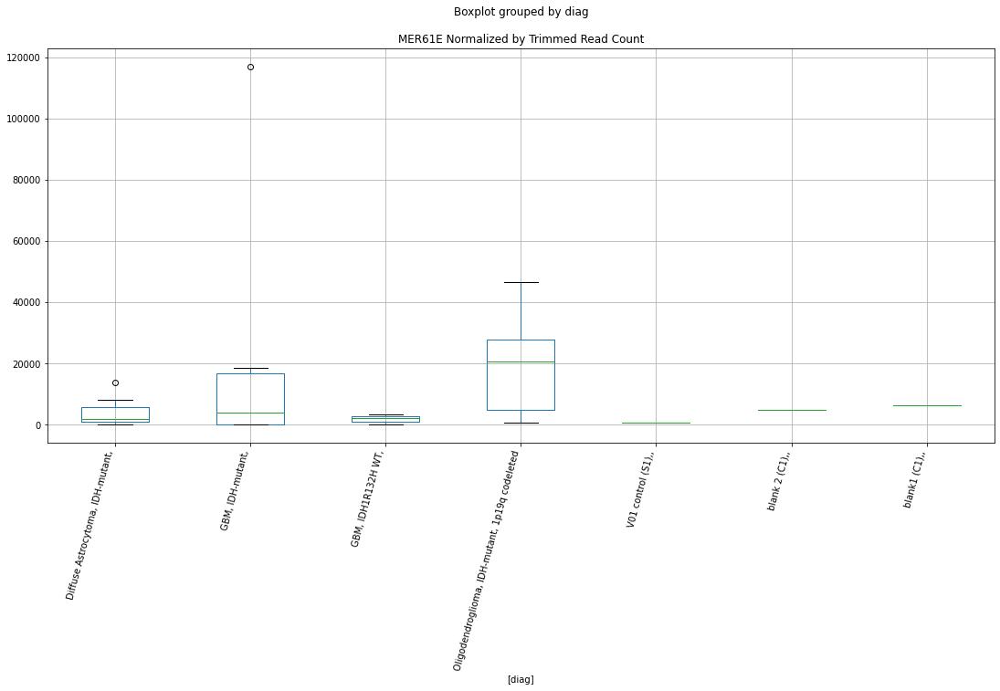

 p : 0.007485261107402111  ( t : 3.012130112504362 ) :  D-plex  :  cutadapt2  :  Ricksha_b
Control and blanks
76       0.00
340    880.73
Name: Ricksha_b, dtype: float64
208    2116.32
Name: Ricksha_b, dtype: float64
472    2889.78
Name: Ricksha_b, dtype: float64


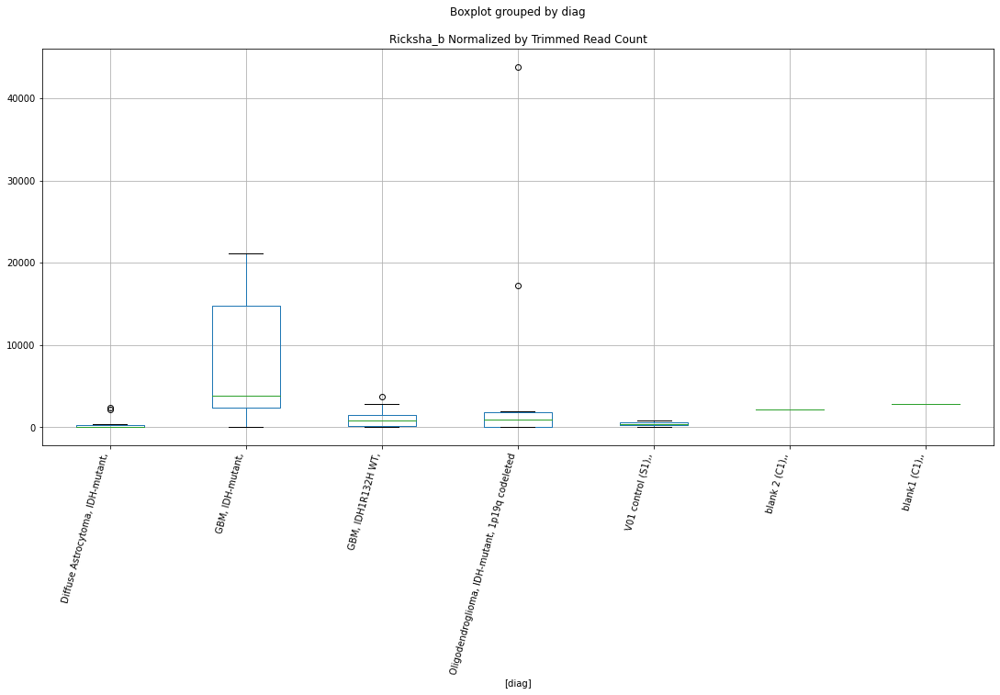

 p : 0.00777209500453248  ( t : 2.9948415114344726 ) :  D-plex  :  bbduk2  :  Charlie30a
Control and blanks
73      773.01
337    3560.63
Name: Charlie30a, dtype: float64
205    6626.37
Name: Charlie30a, dtype: float64
469    4140.69
Name: Charlie30a, dtype: float64


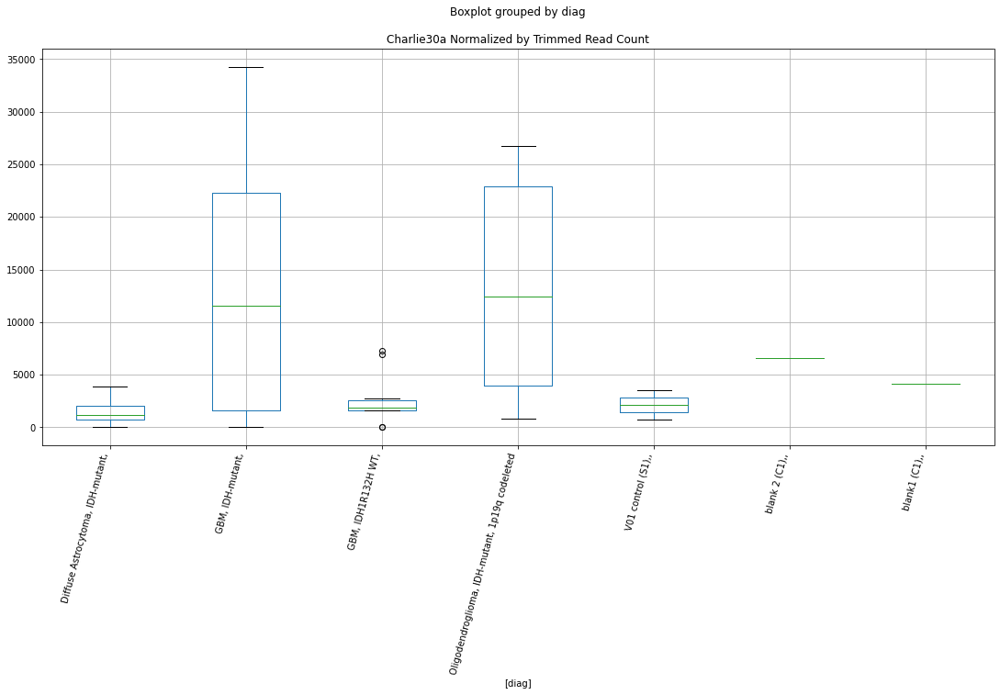

 p : 0.007799748663887388  ( t : 2.993207589325823 ) :  D-plex  :  cutadapt2  :  LTR86A1
Control and blanks
76      2272.84
340    20256.84
Name: LTR86A1, dtype: float64
208    11639.77
Name: LTR86A1, dtype: float64
472    8091.38
Name: LTR86A1, dtype: float64


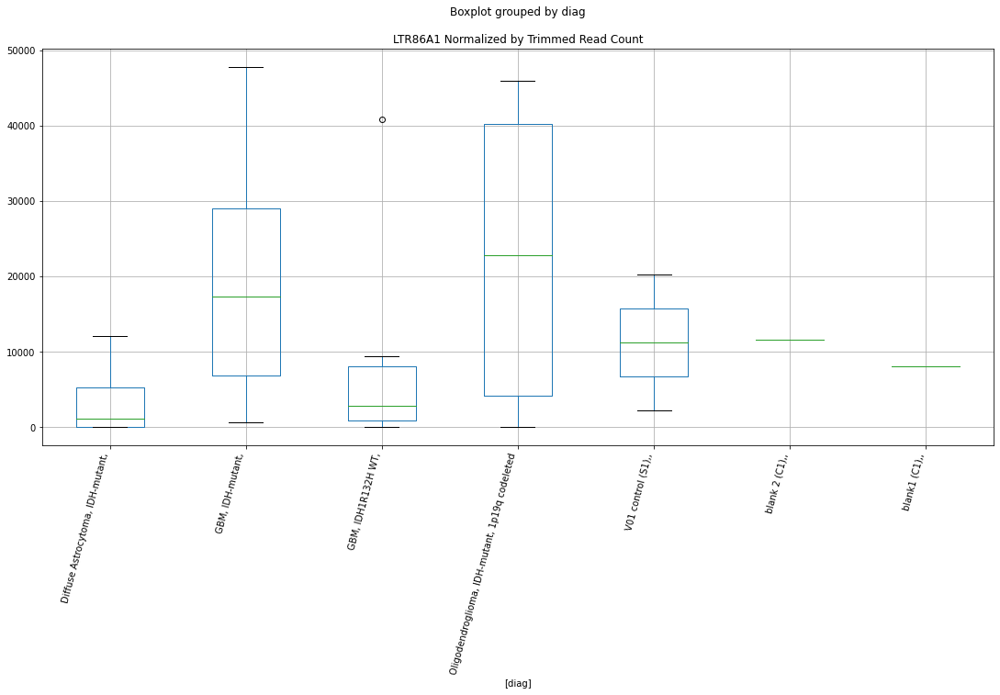

 p : 0.008097528285533319  ( t : 2.9759608757915244 ) :  D-plex  :  cutadapt2  :  (CCCTCT)n
Control and blanks
76      8333.76
340    10568.79
Name: (CCCTCT)n, dtype: float64
208    3703.56
Name: (CCCTCT)n, dtype: float64
472    8091.38
Name: (CCCTCT)n, dtype: float64


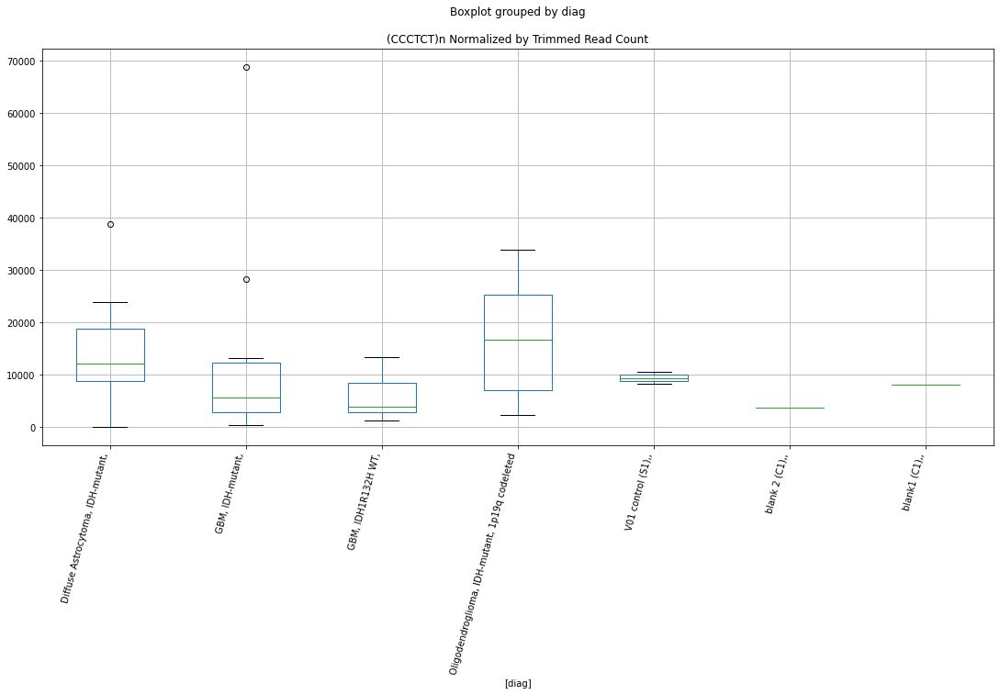

 p : 0.008137520297171668  ( t : 2.973691634269197 ) :  D-plex  :  bbduk2  :  HUERS-P3b-int
Control and blanks
73      6184.07
337    38276.76
Name: HUERS-P3b-int, dtype: float64
205    19162.73
Name: HUERS-P3b-int, dtype: float64
469    17745.82
Name: HUERS-P3b-int, dtype: float64


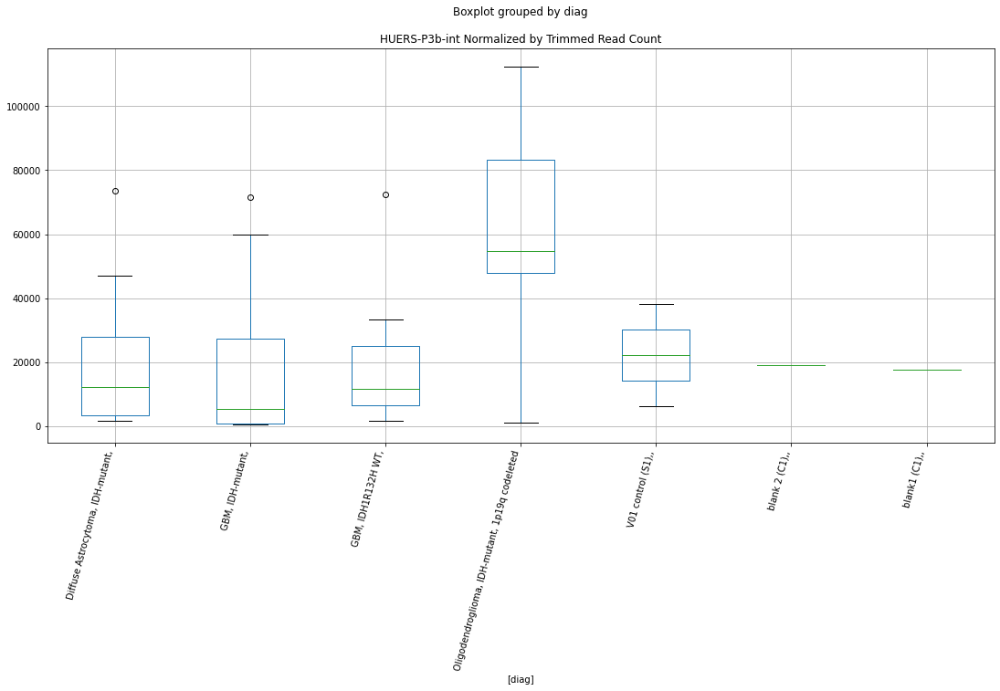

 p : 0.008264172734720509  ( t : 2.9665757546390217 ) :  D-plex  :  bbduk2  :  LTR86A1
Control and blanks
73      2319.03
337    20473.62
Name: LTR86A1, dtype: float64
205    10924.55
Name: LTR86A1, dtype: float64
469    8281.38
Name: LTR86A1, dtype: float64


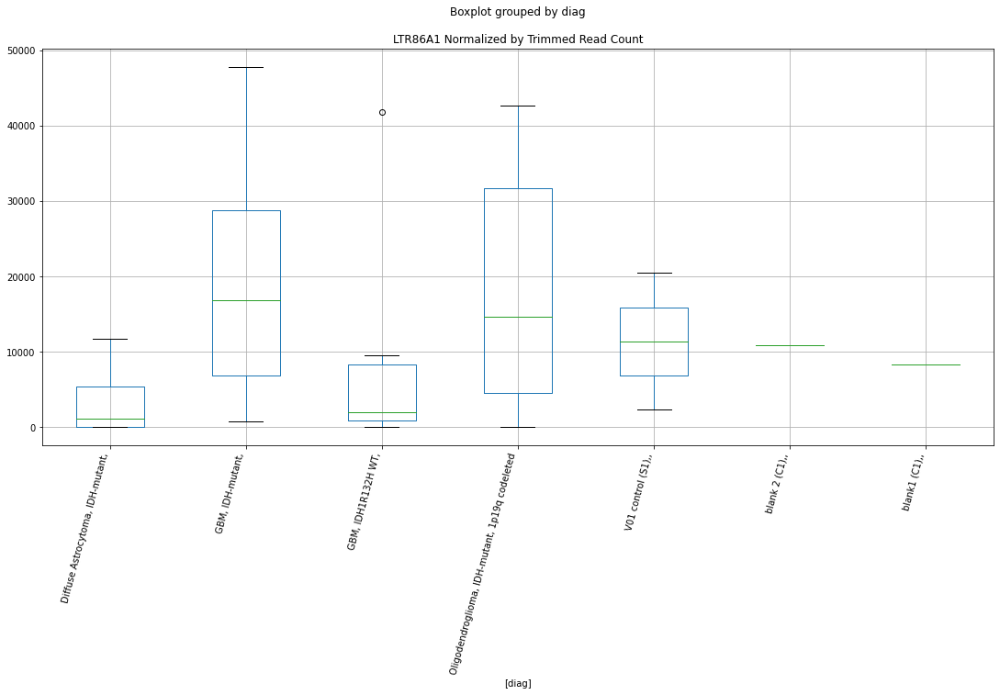

 p : 0.008465716321365222  ( t : 2.955467223378726 ) :  D-plex  :  cutadapt2  :  HUERS-P3b-int
Control and blanks
76      6060.91
340    38752.21
Name: HUERS-P3b-int, dtype: float64
208    18694.18
Name: HUERS-P3b-int, dtype: float64
472    17338.68
Name: HUERS-P3b-int, dtype: float64


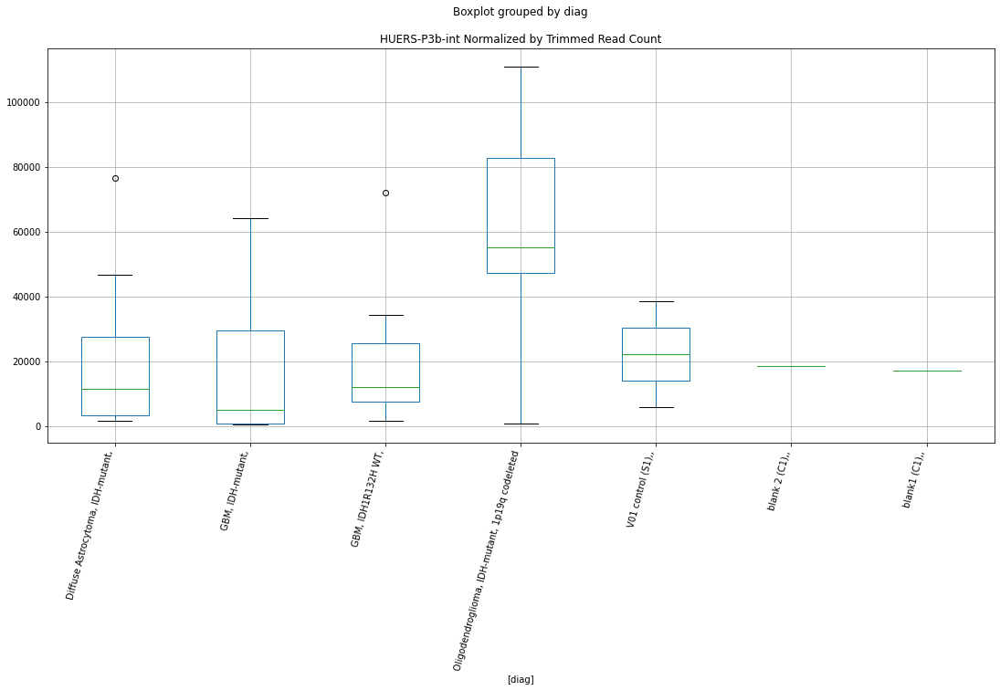

 p : 0.008854350171655792  ( t : 2.9347517605382643 ) :  D-plex  :  bbduk2  :  Ricksha_b
Control and blanks
73       0.00
337    890.16
Name: Ricksha_b, dtype: float64
205    2149.09
Name: Ricksha_b, dtype: float64
469    2957.64
Name: Ricksha_b, dtype: float64


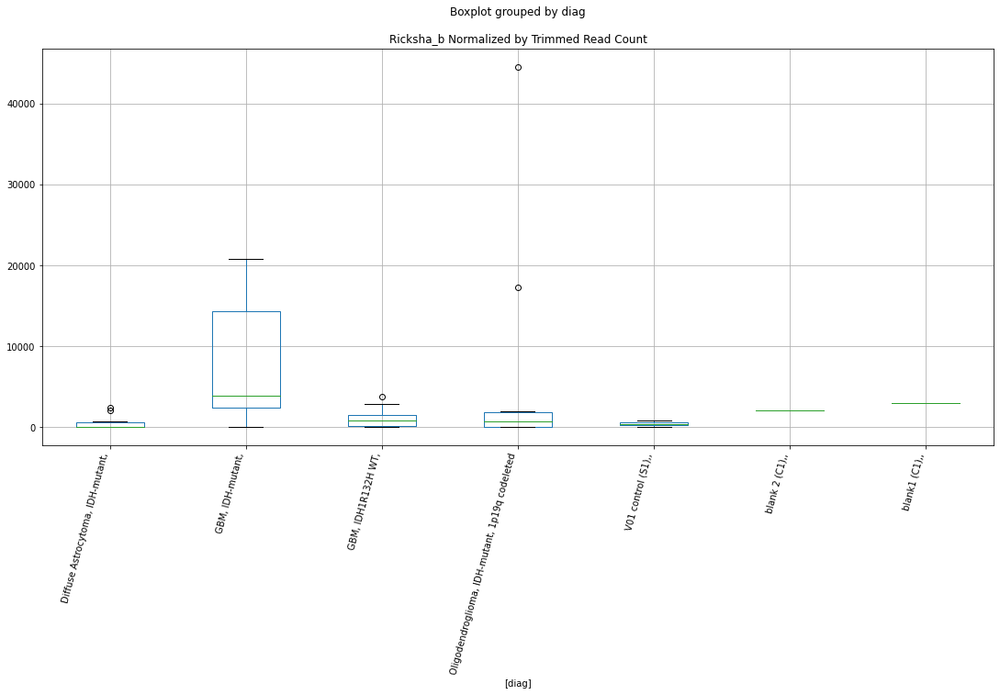

 p : 0.008864100834812696  ( t : 2.9342434159448816 ) :  D-plex  :  bbduk2  :  (GAAGAA)n
Control and blanks
73     0.0
337    0.0
Name: (GAAGAA)n, dtype: float64
205    358.18
Name: (GAAGAA)n, dtype: float64
469    591.53
Name: (GAAGAA)n, dtype: float64


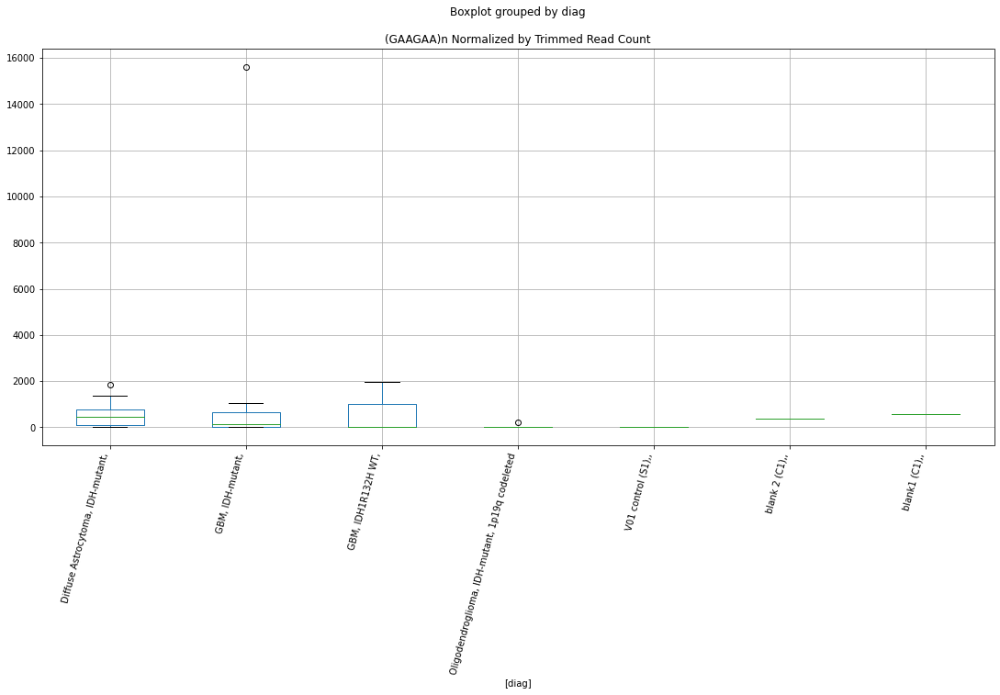

 p : 0.008872086050172824  ( t : 2.9338275147106376 ) :  D-plex  :  bbduk2  :  LTR85a
Control and blanks
73         0.00
337    19583.46
Name: LTR85a, dtype: float64
205    17013.64
Name: LTR85a, dtype: float64
469    11239.02
Name: LTR85a, dtype: float64


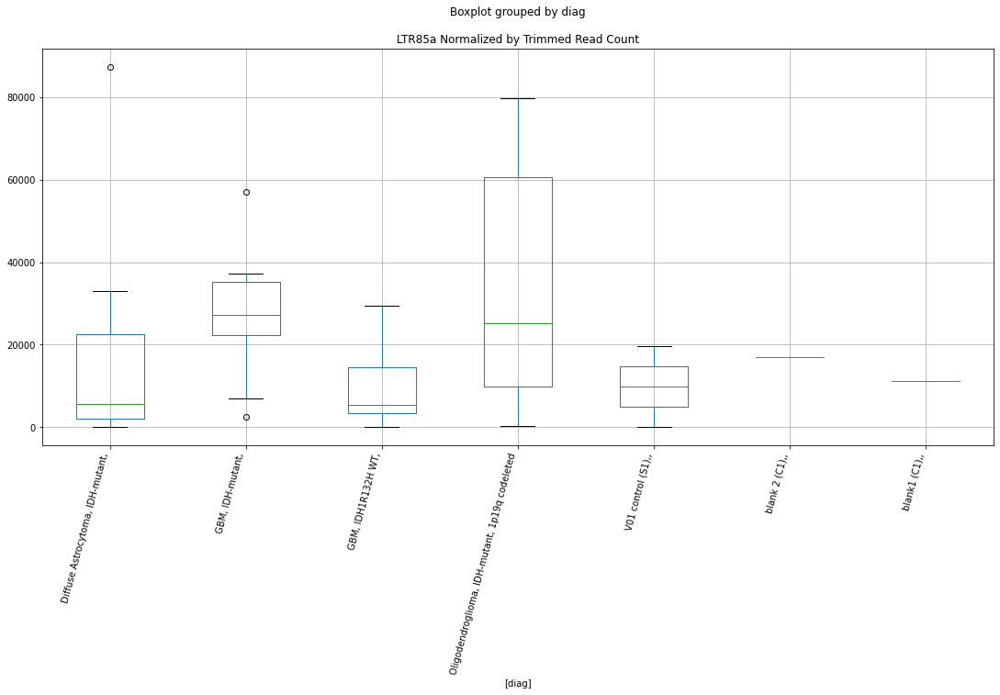

 p : 0.00894160433812196  ( t : 2.9302219574854598 ) :  D-plex  :  bbduk2  :  Charlie30a
Control and blanks
73      773.01
337    3560.63
Name: Charlie30a, dtype: float64
205    6626.37
Name: Charlie30a, dtype: float64
469    4140.69
Name: Charlie30a, dtype: float64


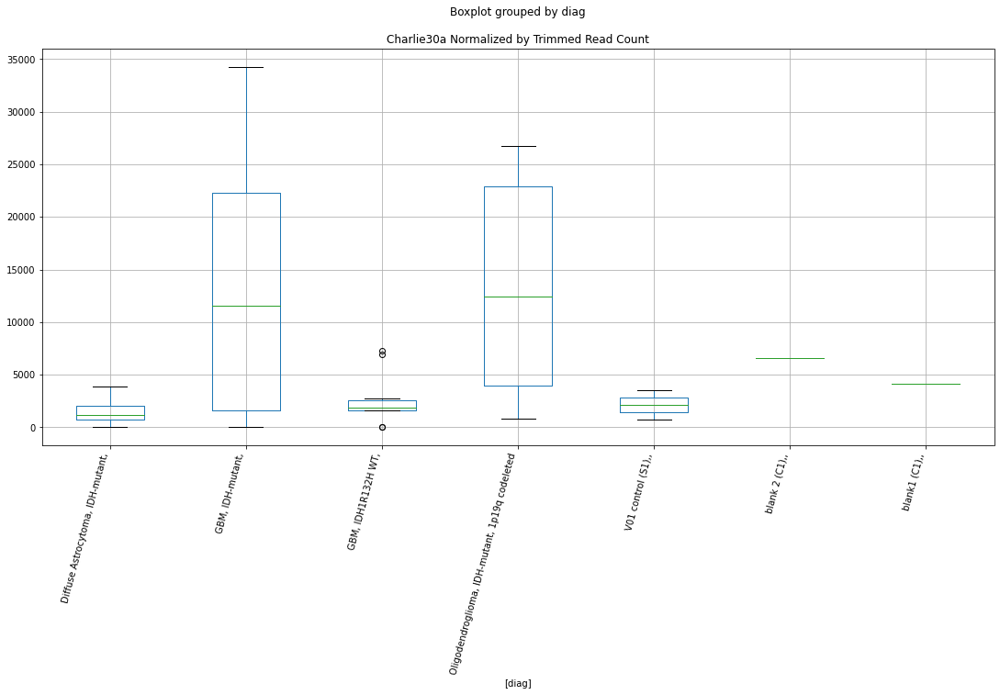

 p : 0.009172119091303534  ( t : 2.9184574108232297 ) :  D-plex  :  cutadapt2  :  HUERS-P3b-int
Control and blanks
76      6060.91
340    38752.21
Name: HUERS-P3b-int, dtype: float64
208    18694.18
Name: HUERS-P3b-int, dtype: float64
472    17338.68
Name: HUERS-P3b-int, dtype: float64


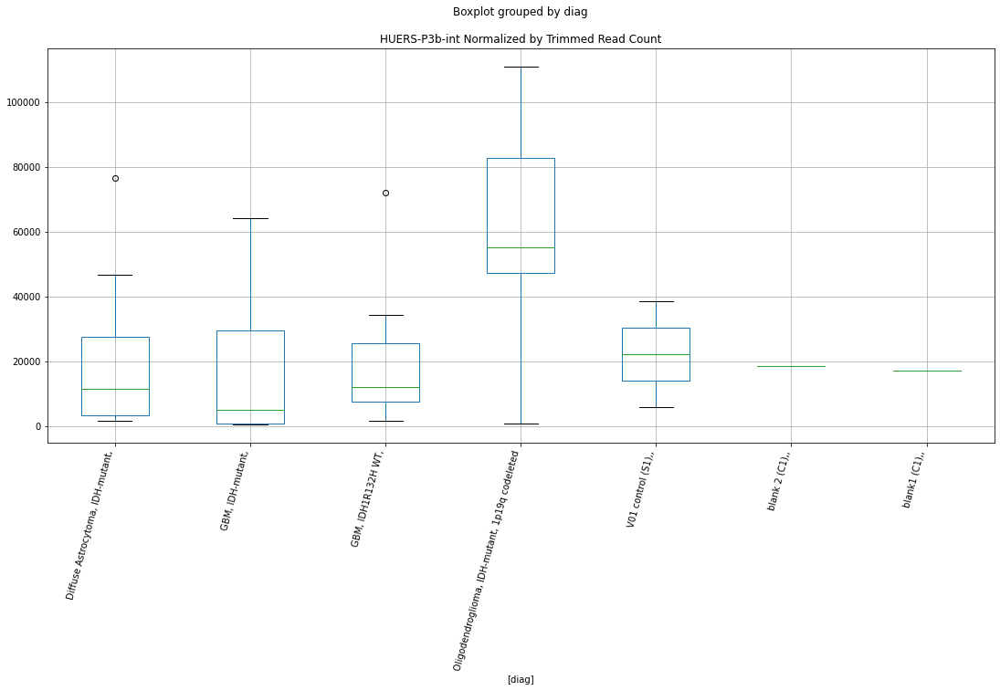

 p : 0.009214150897862495  ( t : 2.916343140082168 ) :  D-plex  :  bbduk2  :  MER107
Control and blanks
73        0.00
337    8011.42
Name: MER107, dtype: float64
205    8775.46
Name: MER107, dtype: float64
469    10647.49
Name: MER107, dtype: float64


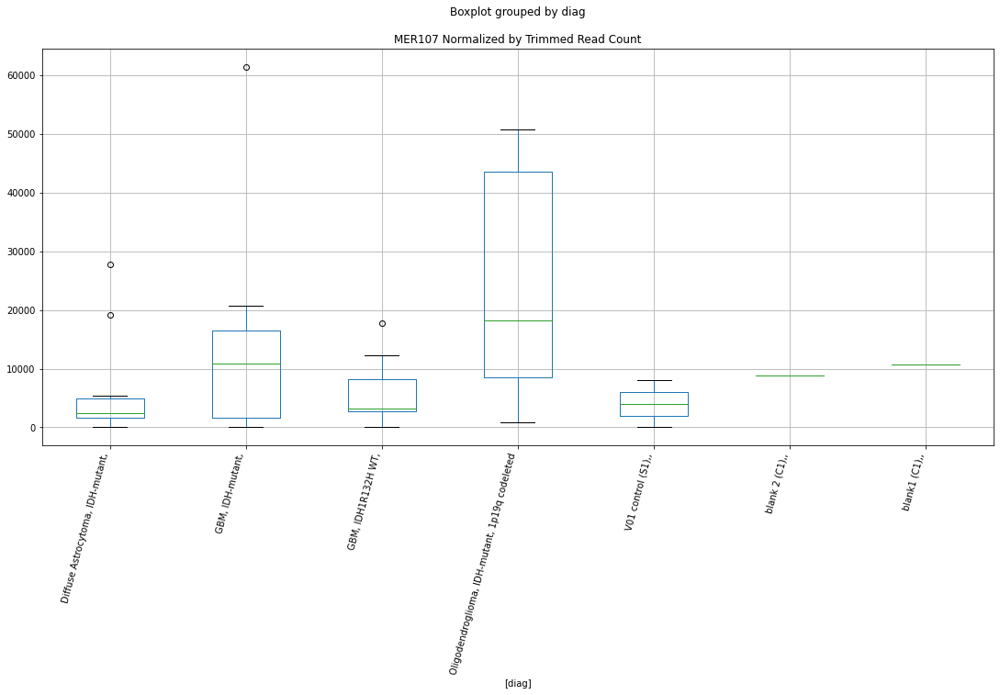

 p : 0.009548501709938777  ( t : 2.8998493118665567 ) :  D-plex  :  cutadapt2  :  MER76-int
Control and blanks
76     40153.55
340        0.00
Name: MER76-int, dtype: float64
208    6348.97
Name: MER76-int, dtype: float64
472    5779.56
Name: MER76-int, dtype: float64


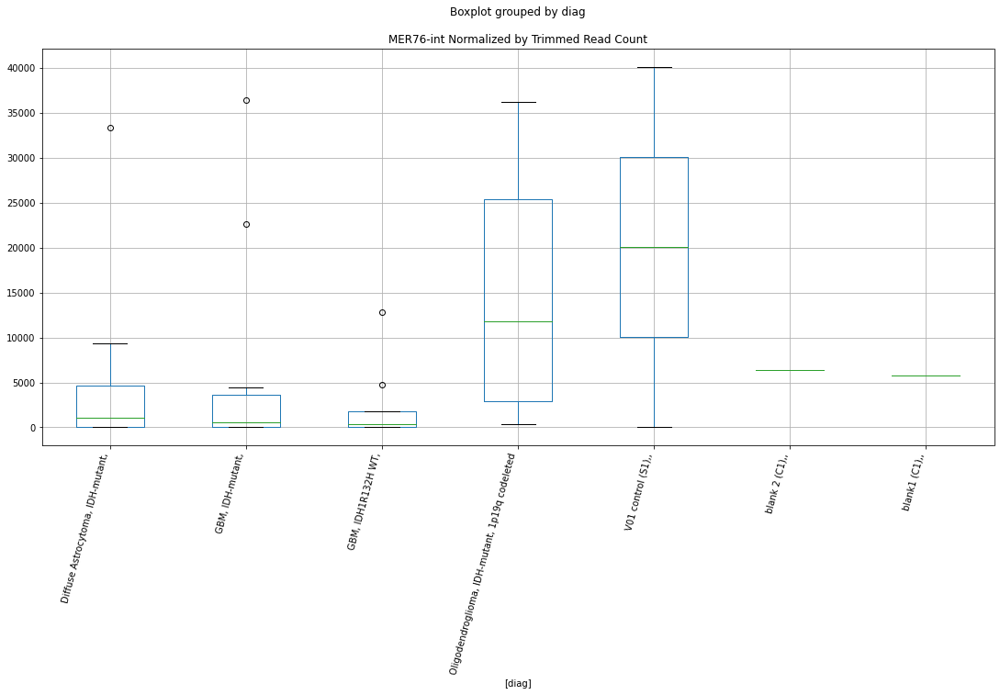

 p : 0.009952384204534013  ( t : 2.8806537831734467 ) :  D-plex  :  bbduk2  :  LTR16D
Control and blanks
73      1546.02
337    27594.88
Name: LTR16D, dtype: float64
205    17192.73
Name: LTR16D, dtype: float64
469    10055.96
Name: LTR16D, dtype: float64


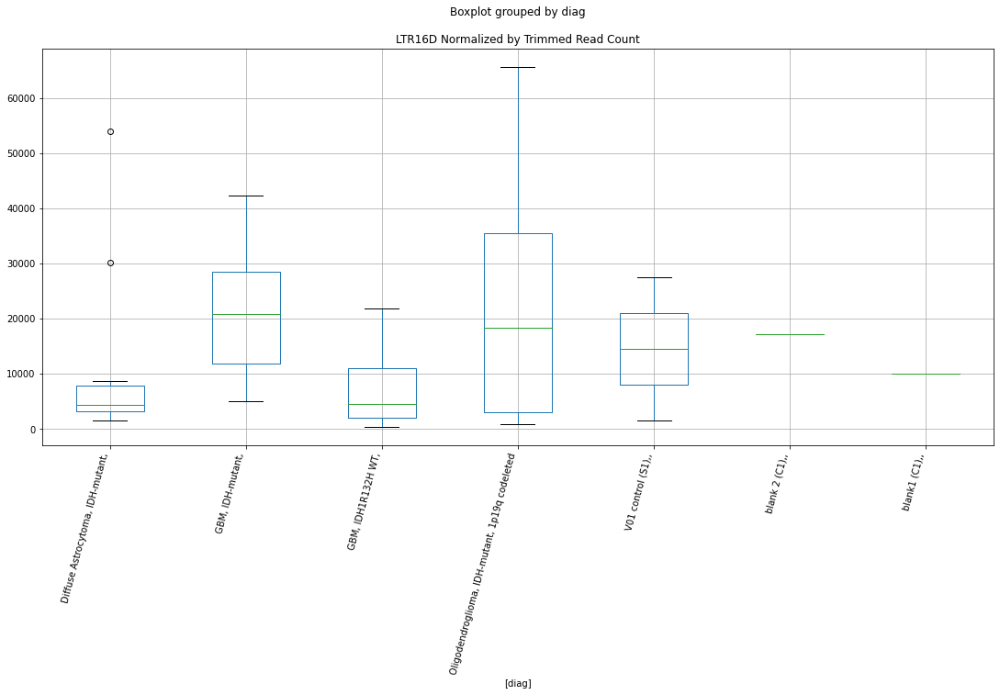

 p : 0.010505330884673631  ( t : 2.855558238017222 ) :  D-plex  :  cutadapt2  :  (GTGTGG)n
Control and blanks
76     0.0
340    0.0
Name: (GTGTGG)n, dtype: float64
208    705.44
Name: (GTGTGG)n, dtype: float64
472    1733.87
Name: (GTGTGG)n, dtype: float64


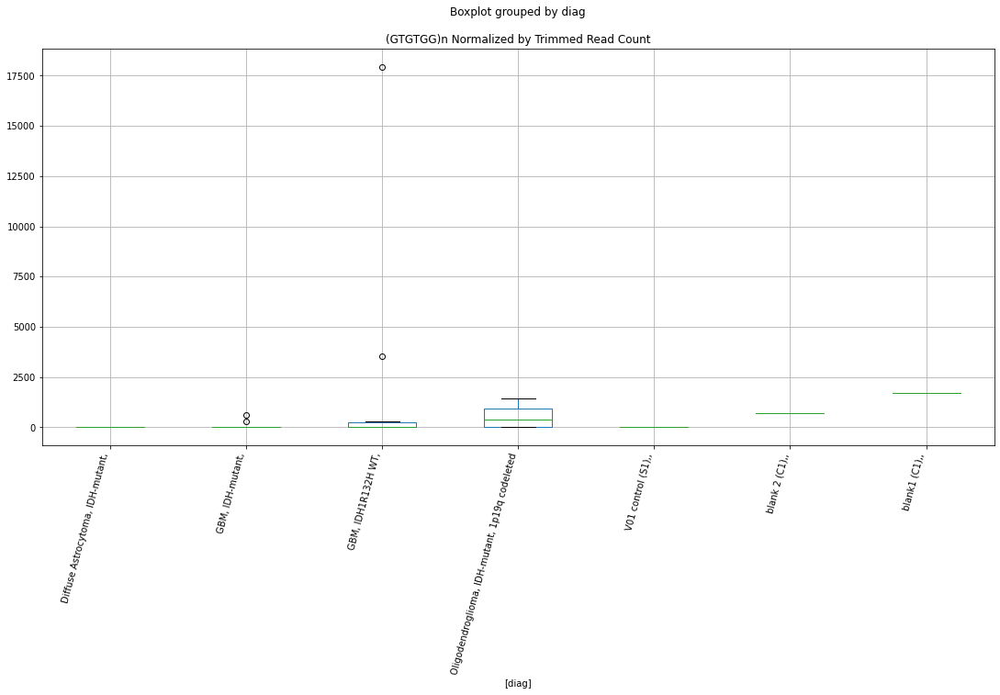

 p : 0.010543782147612224  ( t : 2.853860809696047 ) :  D-plex  :  cutadapt2  :  (TGT)n
Control and blanks
76     3030.46
340    1761.46
Name: (TGT)n, dtype: float64
208    3527.2
Name: (TGT)n, dtype: float64
472    4045.69
Name: (TGT)n, dtype: float64


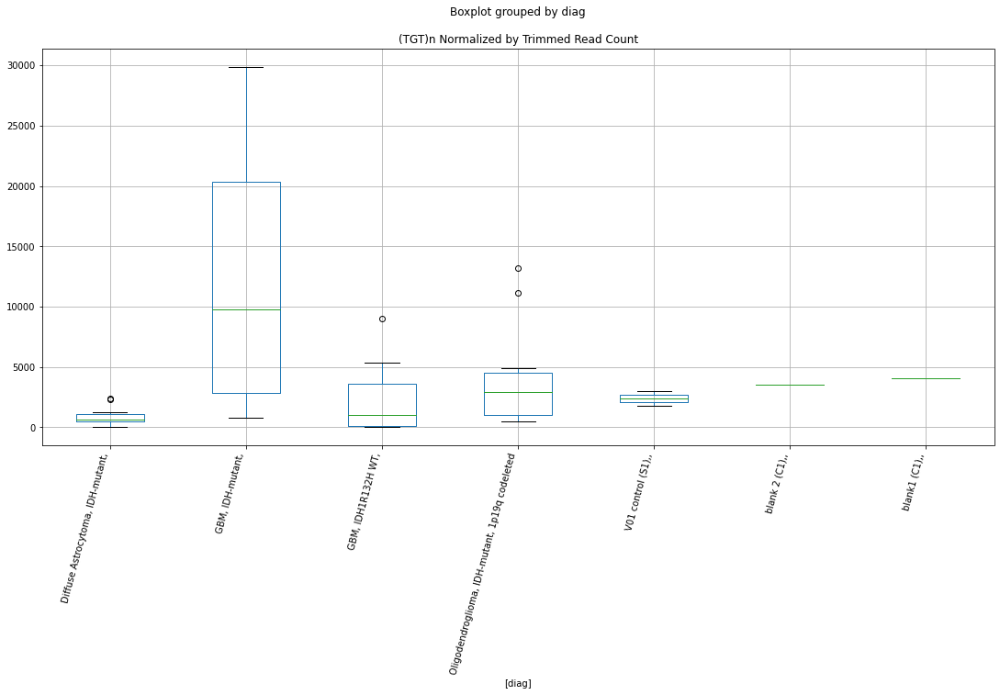

 p : 0.01054935407357659  ( t : 2.8536153324012146 ) :  D-plex  :  cutadapt2  :  LTR40b
Control and blanks
76     37880.71
340      880.73
Name: LTR40b, dtype: float64
208    15166.98
Name: LTR40b, dtype: float64
472    15604.81
Name: LTR40b, dtype: float64


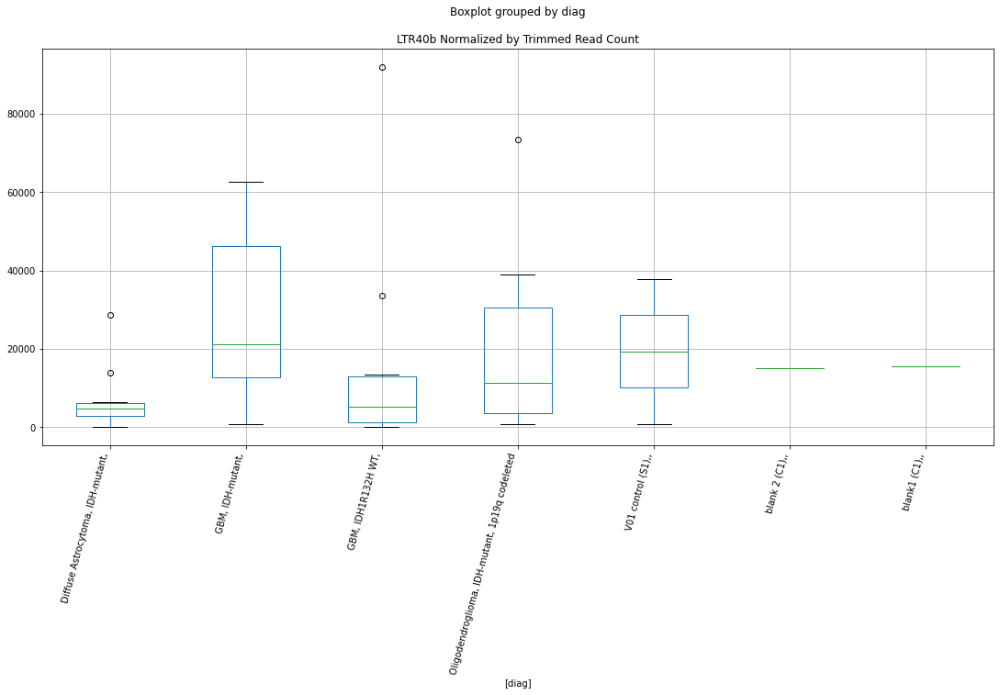

 p : 0.010623235821448111  ( t : 2.850372149482486 ) :  D-plex  :  cutadapt2  :  MER135
Control and blanks
76     0.0
340    0.0
Name: MER135, dtype: float64
208    4409.01
Name: MER135, dtype: float64
472    3467.74
Name: MER135, dtype: float64


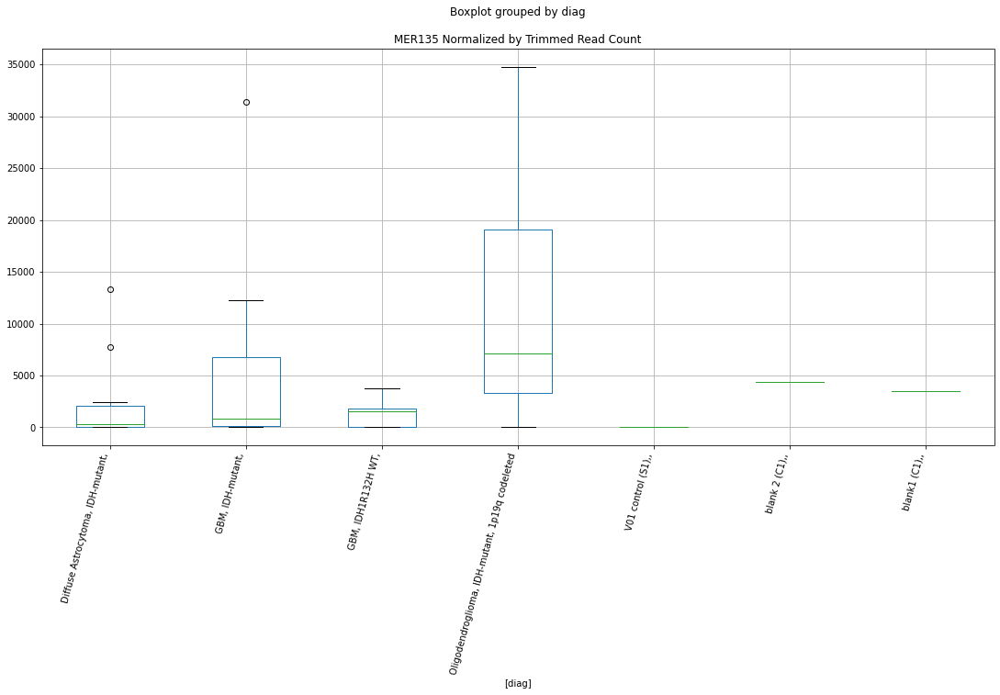

 p : 0.010640835332817719  ( t : 2.8496027901738152 ) :  D-plex  :  cutadapt2  :  LTR40c
Control and blanks
76     0.0
340    0.0
Name: LTR40c, dtype: float64
208    9876.17
Name: LTR40c, dtype: float64
472    13870.94
Name: LTR40c, dtype: float64


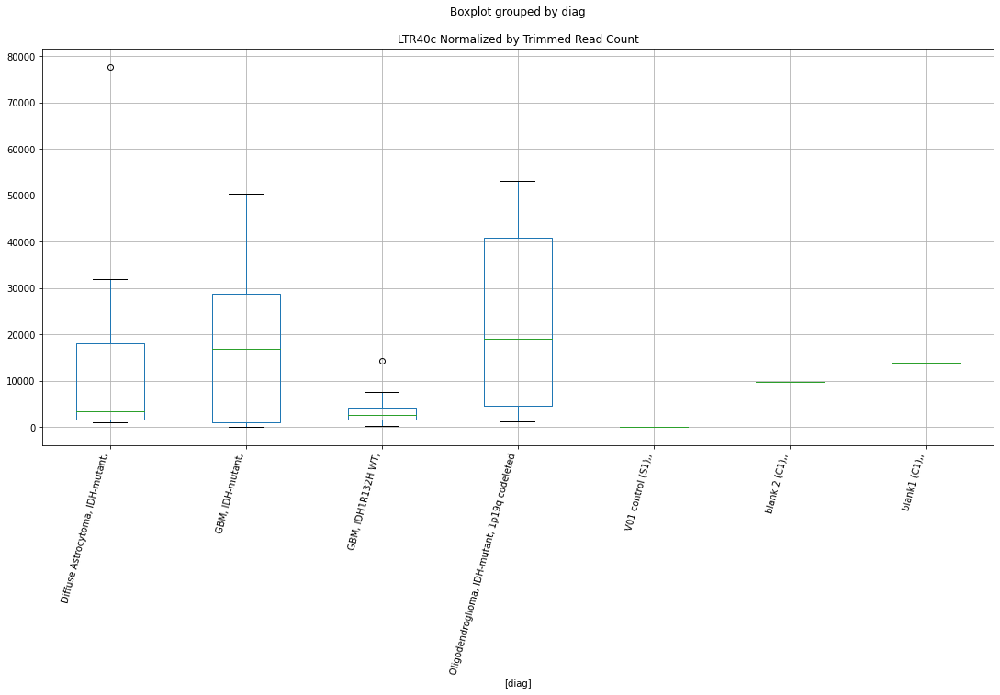

 p : 0.010909972289684147  ( t : 2.83798777159153 ) :  D-plex  :  bbduk2  :  LTR88c
Control and blanks
73       773.01
337    31155.50
Name: LTR88c, dtype: float64
205    9491.82
Name: LTR88c, dtype: float64
469    11239.02
Name: LTR88c, dtype: float64


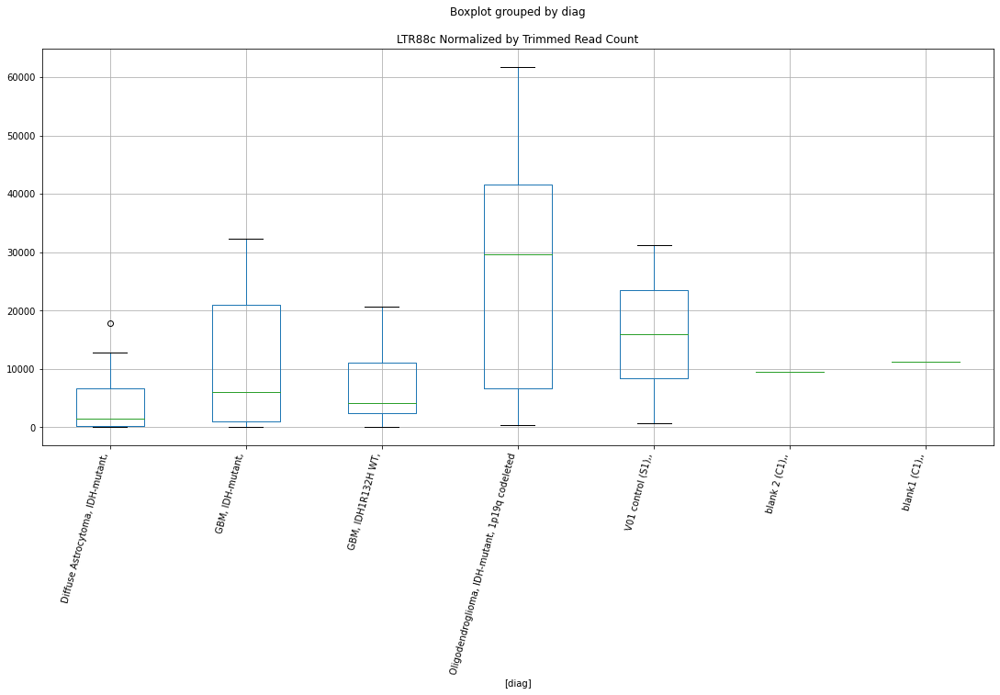

 p : 0.01094176567484588  ( t : 2.8366339460809824 ) :  D-plex  :  bbduk2  :  AluYb9
Control and blanks
73      3092.03
337    11572.04
Name: AluYb9, dtype: float64
205    7700.91
Name: AluYb9, dtype: float64
469    4140.69
Name: AluYb9, dtype: float64


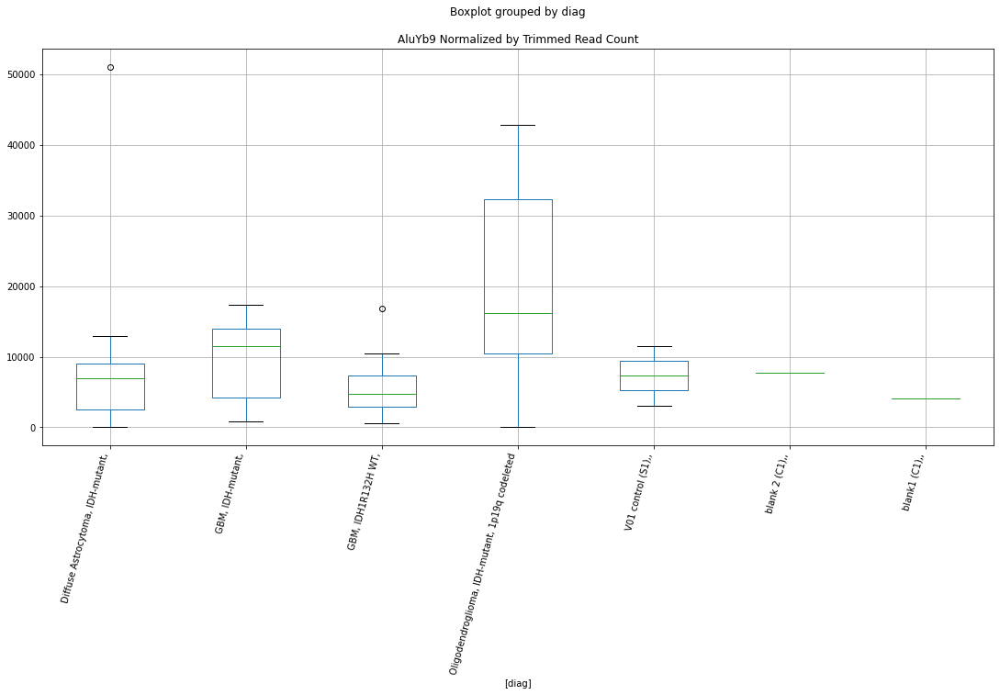

 p : 0.010956274257388052  ( t : 2.8360173998459417 ) :  D-plex  :  cutadapt2  :  LTR16D
Control and blanks
76      1515.23
340    28183.43
Name: LTR16D, dtype: float64
208    17988.74
Name: LTR16D, dtype: float64
472    10981.16
Name: LTR16D, dtype: float64


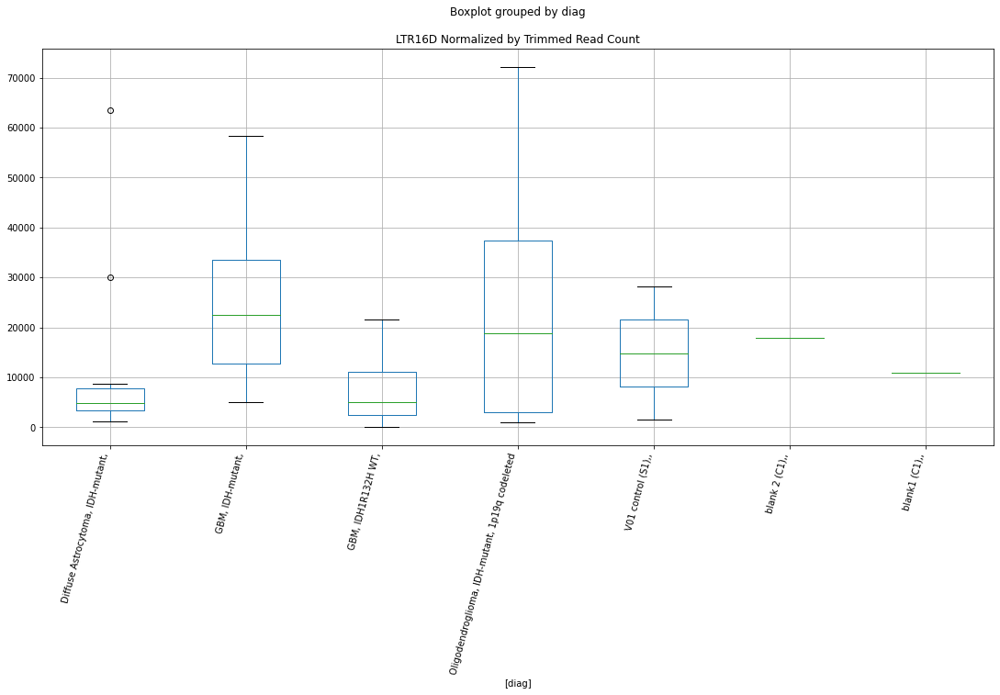

 p : 0.01113300869091559  ( t : 2.828569472894663 ) :  D-plex  :  cutadapt2  :  MER84
Control and blanks
76     757.61
340      0.00
Name: MER84, dtype: float64
208    4585.37
Name: MER84, dtype: float64
472    4623.65
Name: MER84, dtype: float64


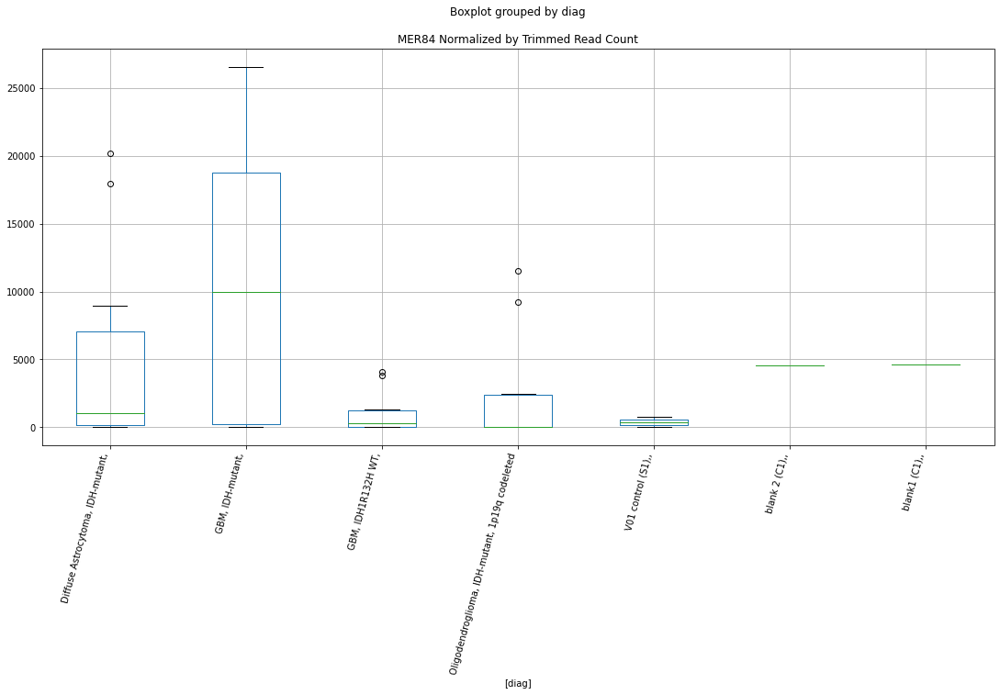

 p : 0.011217930795735393  ( t : 2.8250310773481644 ) :  D-plex  :  bbduk2  :  MER61E
Control and blanks
73     773.01
337    890.16
Name: MER61E, dtype: float64
205    5014.55
Name: MER61E, dtype: float64
469    5323.75
Name: MER61E, dtype: float64


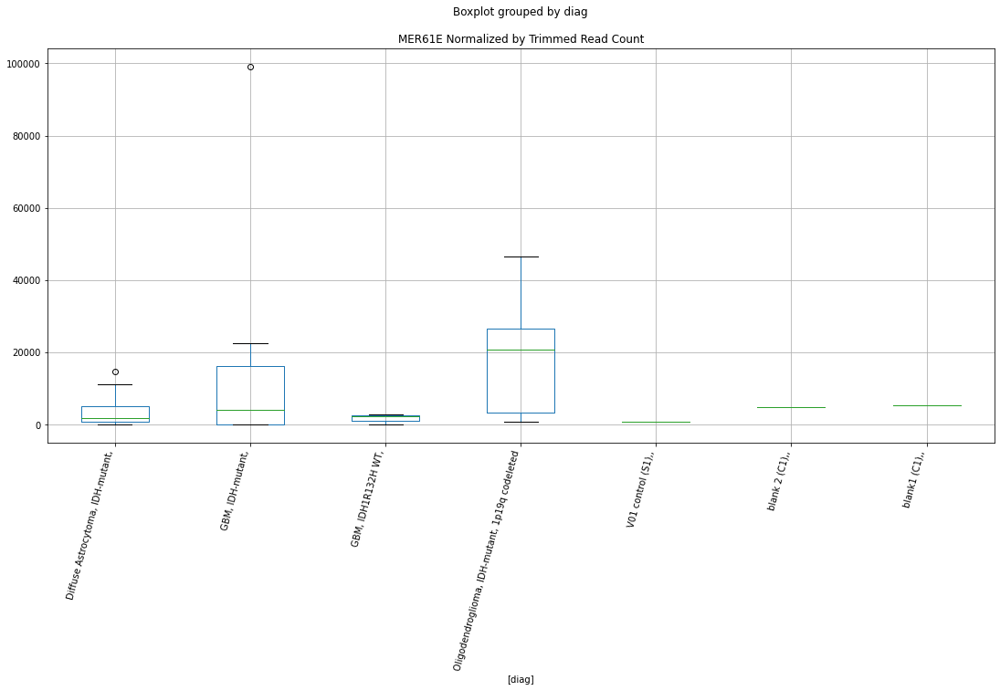

 p : 0.01127266839597861  ( t : 2.8227639947139345 ) :  D-plex  :  bbduk2  :  MER34C2
Control and blanks
73       773.01
337    22253.93
Name: MER34C2, dtype: float64
205    13073.64
Name: MER34C2, dtype: float64
469    14788.18
Name: MER34C2, dtype: float64


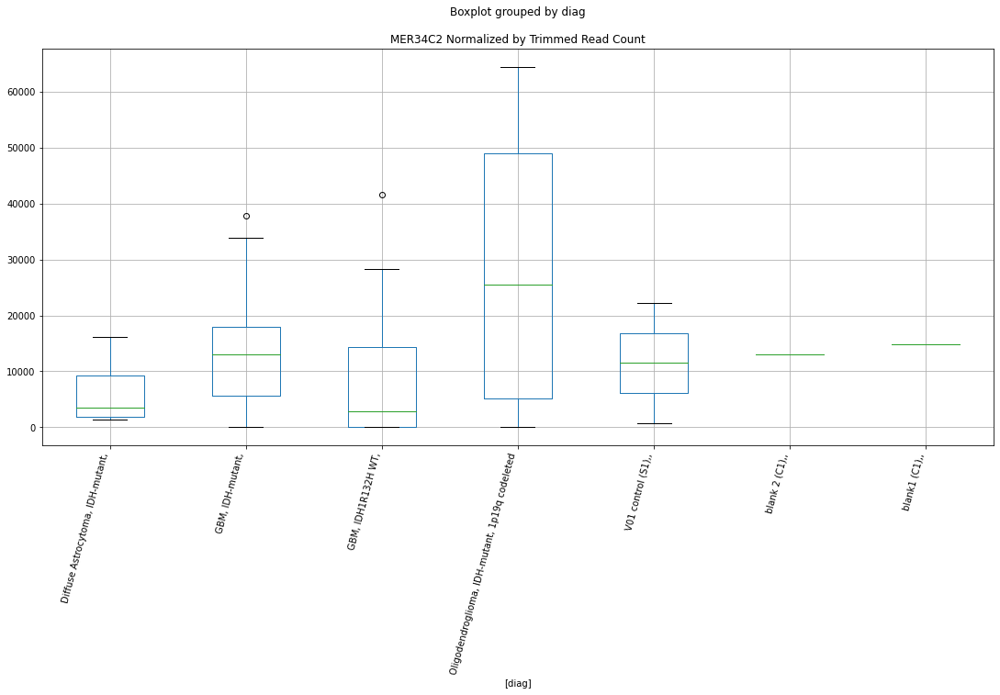

 p : 0.01127630291473767  ( t : 2.822613838013643 ) :  D-plex  :  bbduk2  :  HUERS-P3b-int
Control and blanks
73      6184.07
337    38276.76
Name: HUERS-P3b-int, dtype: float64
205    19162.73
Name: HUERS-P3b-int, dtype: float64
469    17745.82
Name: HUERS-P3b-int, dtype: float64


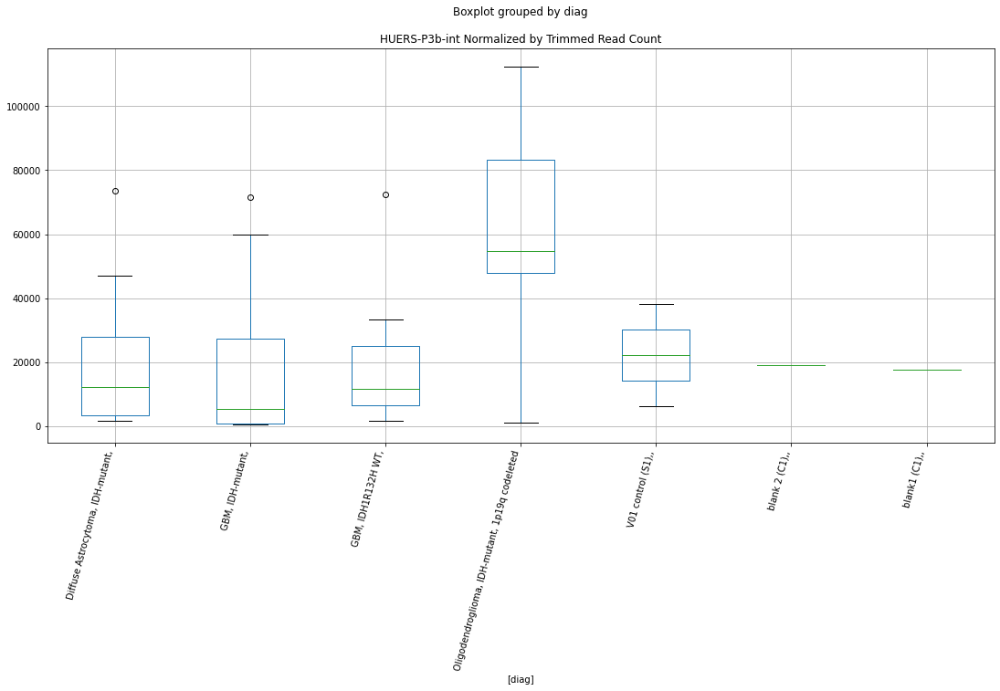

 p : 0.011461807535510293  ( t : 2.815011060342043 ) :  D-plex  :  cutadapt2  :  (CCTTCCT)n
Control and blanks
76     23486.04
340        0.00
Name: (CCTTCCT)n, dtype: float64
208    176.36
Name: (CCTTCCT)n, dtype: float64
472    0.0
Name: (CCTTCCT)n, dtype: float64


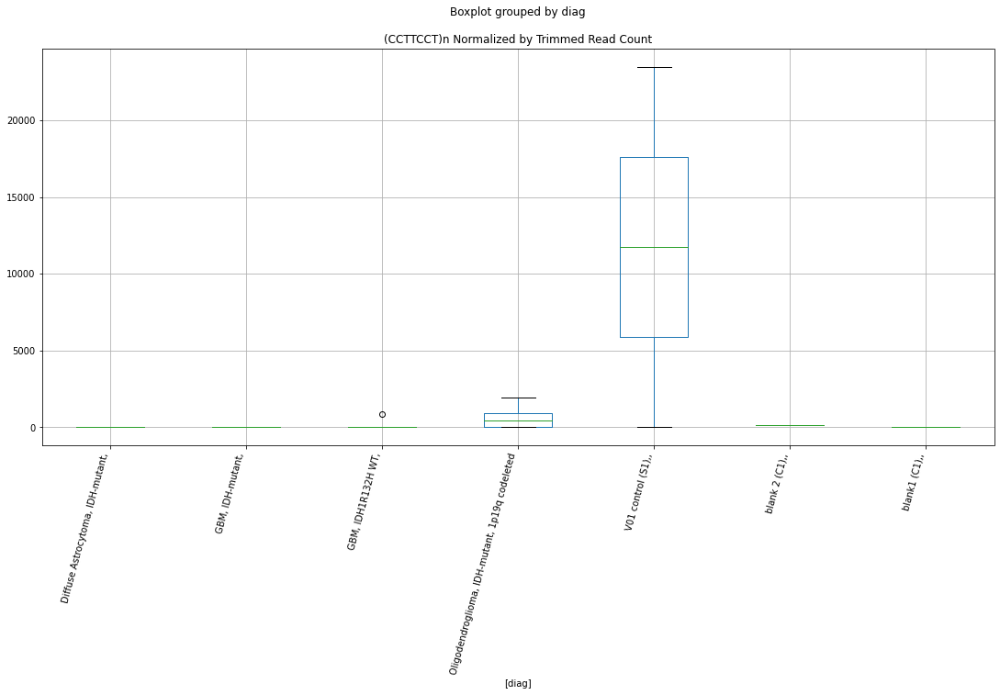

 p : 0.011538797281543108  ( t : 2.8118903819023395 ) :  D-plex  :  cutadapt2  :  LTR12_
Control and blanks
76      3030.46
340    11449.52
Name: LTR12_, dtype: float64
208    13050.66
Name: LTR12_, dtype: float64
472    8669.34
Name: LTR12_, dtype: float64


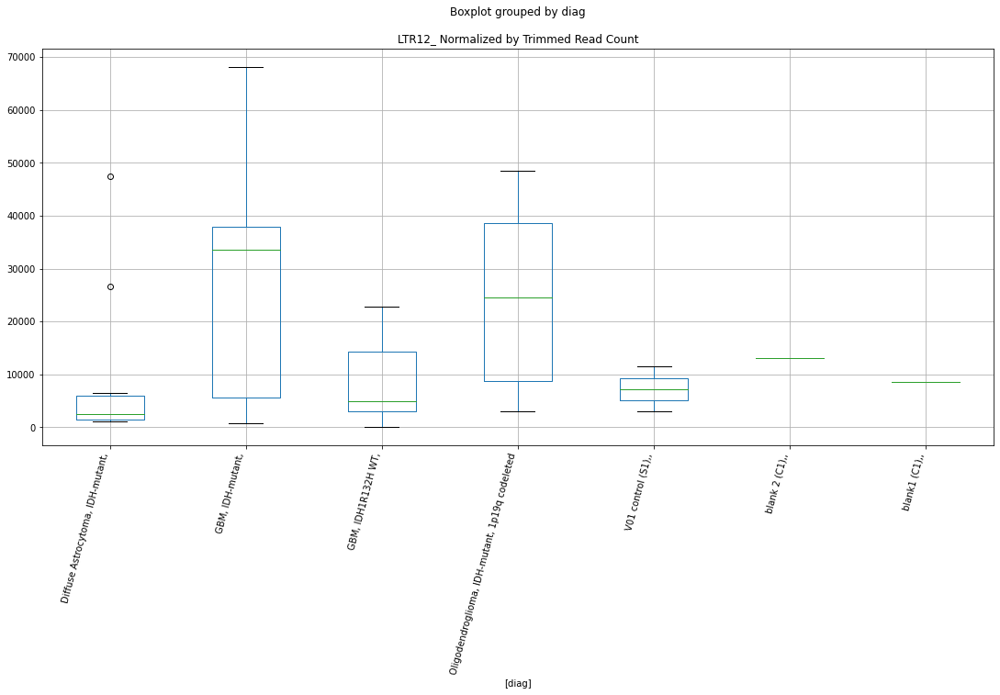

 p : 0.011540981044936649  ( t : 2.811802158198839 ) :  D-plex  :  bbduk2  :  LTR33C
Control and blanks
73      1546.02
337    13352.36
Name: LTR33C, dtype: float64
205    15760.0
Name: LTR33C, dtype: float64
469    11830.55
Name: LTR33C, dtype: float64


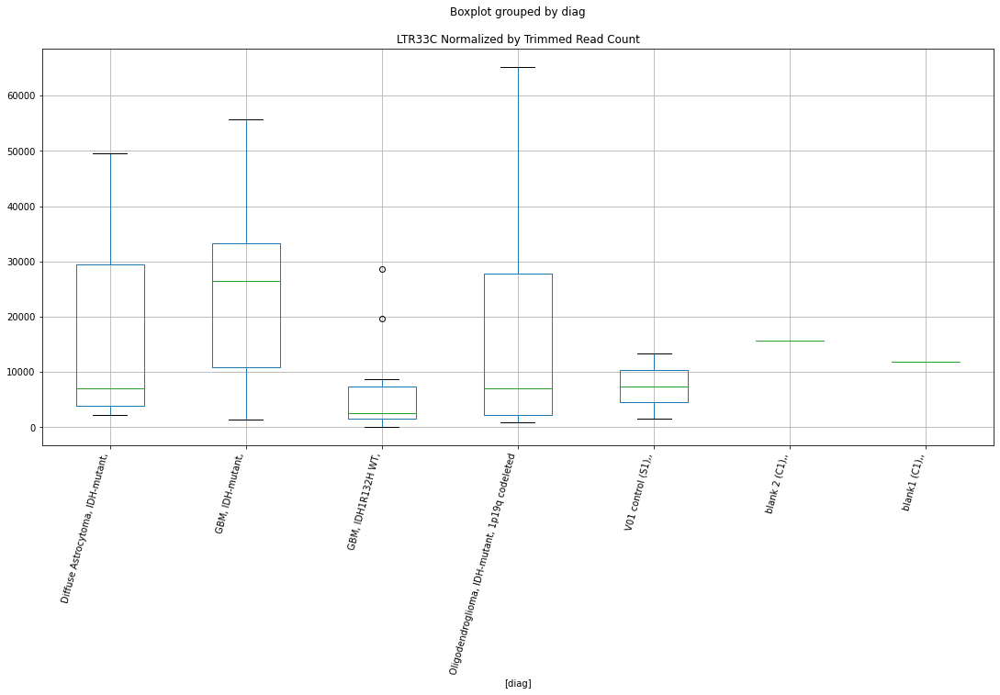

 p : 0.011576232292852394  ( t : 2.810380229457084 ) :  D-plex  :  cutadapt2  :  LTR45B
Control and blanks
76      4545.69
340    16733.91
Name: LTR45B, dtype: float64
208    11110.69
Name: LTR45B, dtype: float64
472    12715.03
Name: LTR45B, dtype: float64


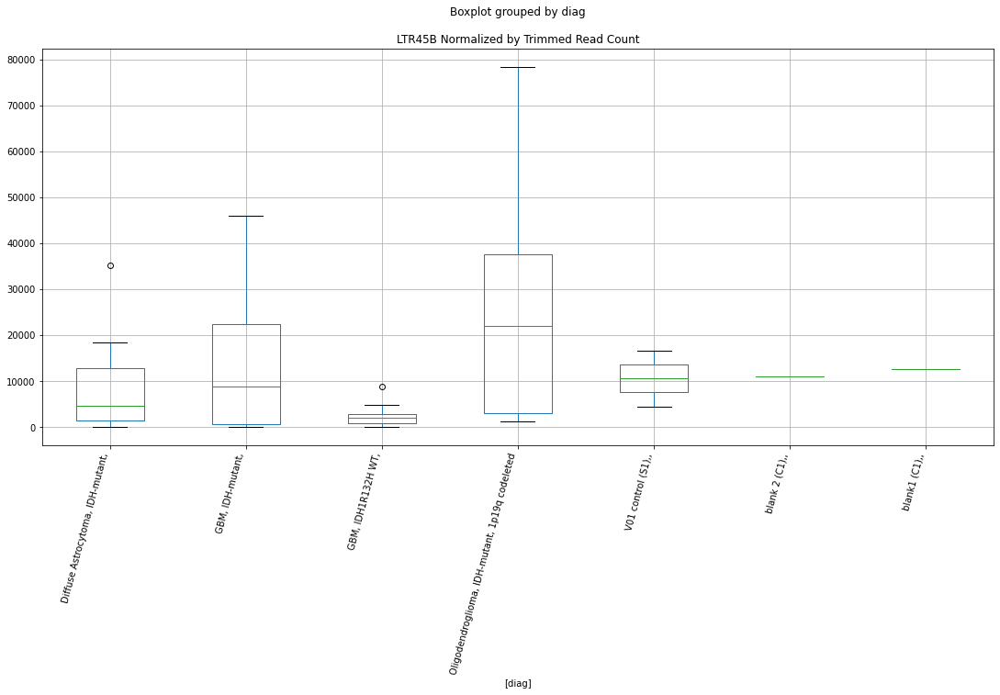

 p : 0.01161239281658923  ( t : 2.808925941810079 ) :  D-plex  :  bbduk2  :  (GATTCCATTCA)n
Control and blanks
73     0.0
337    0.0
Name: (GATTCCATTCA)n, dtype: float64
205    716.36
Name: (GATTCCATTCA)n, dtype: float64
469    2366.11
Name: (GATTCCATTCA)n, dtype: float64


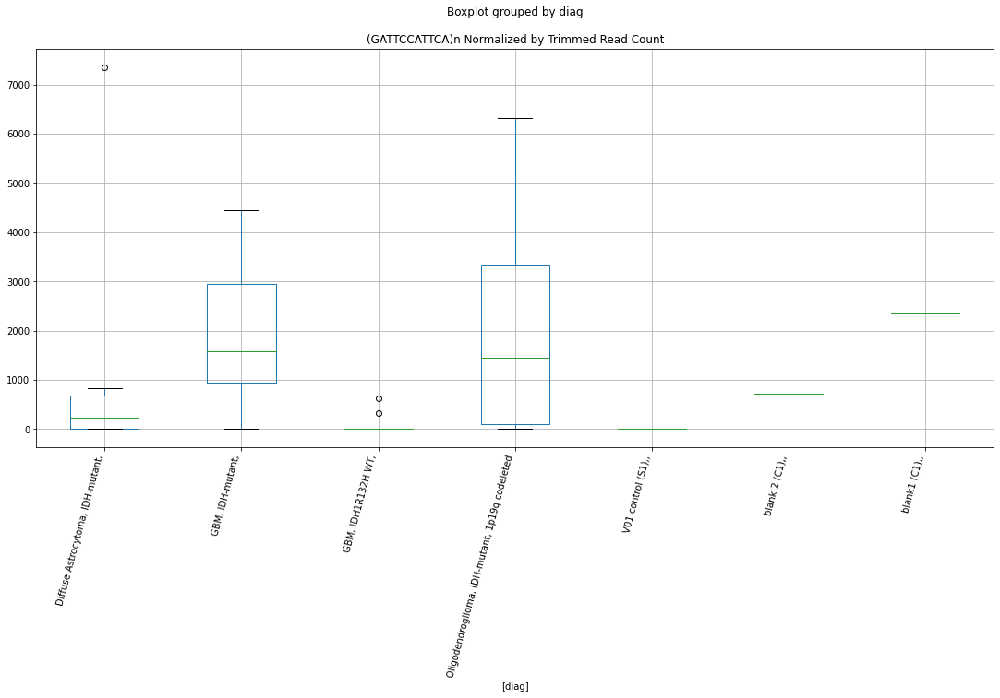

 p : 0.011618833189781273  ( t : 2.808667382585047 ) :  D-plex  :  cutadapt2  :  MER49
Control and blanks
76     27274.11
340      880.73
Name: MER49, dtype: float64
208    27159.47
Name: MER49, dtype: float64
472    20806.41
Name: MER49, dtype: float64


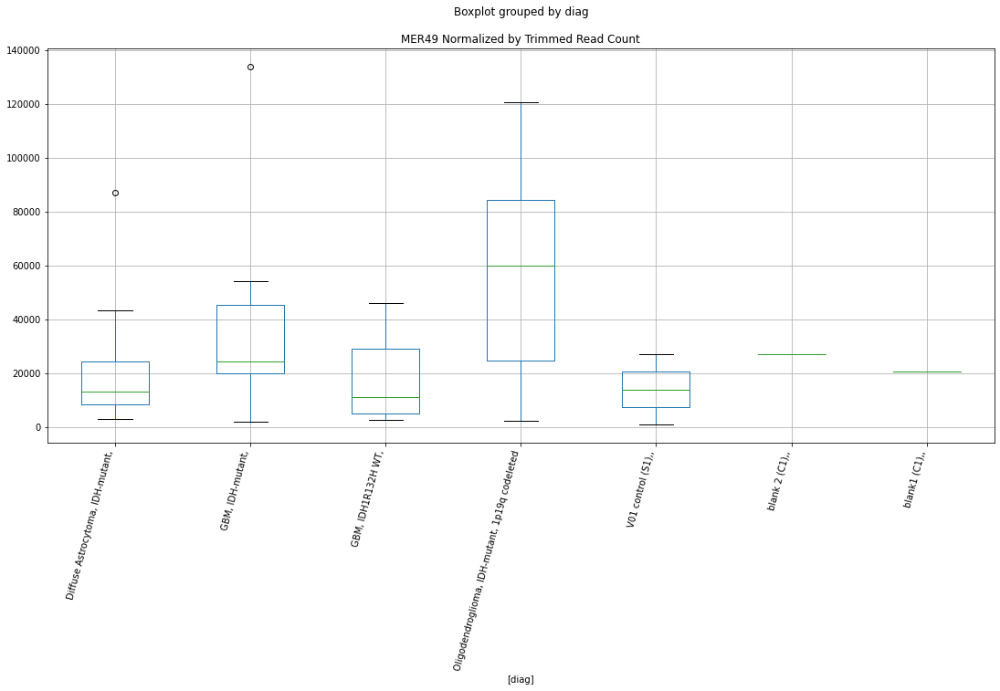

 p : 0.011656519552660215  ( t : 2.8071571585397352 ) :  D-plex  :  bbduk2  :  LTR12_
Control and blanks
73      3092.03
337    12462.20
Name: LTR12_, dtype: float64
205    13073.64
Name: LTR12_, dtype: float64
469    8872.91
Name: LTR12_, dtype: float64


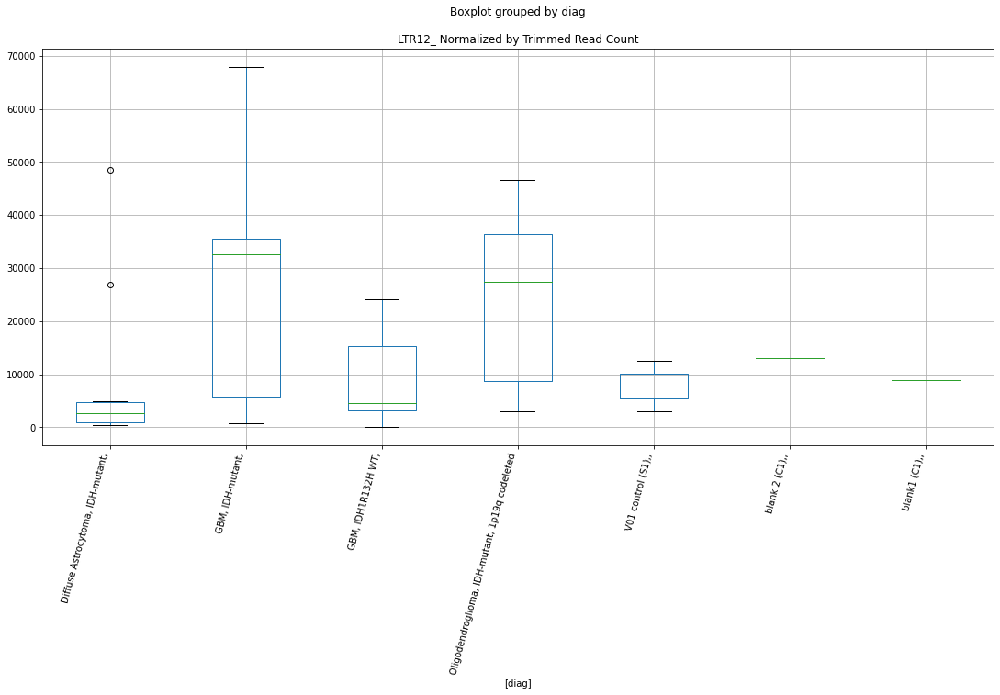

 p : 0.011761928569065386  ( t : 2.802957838772097 ) :  D-plex  :  bbduk2  :  (TTTCT)n
Control and blanks
73      2319.03
337    22253.93
Name: (TTTCT)n, dtype: float64
205    2328.18
Name: (TTTCT)n, dtype: float64
469    591.53
Name: (TTTCT)n, dtype: float64


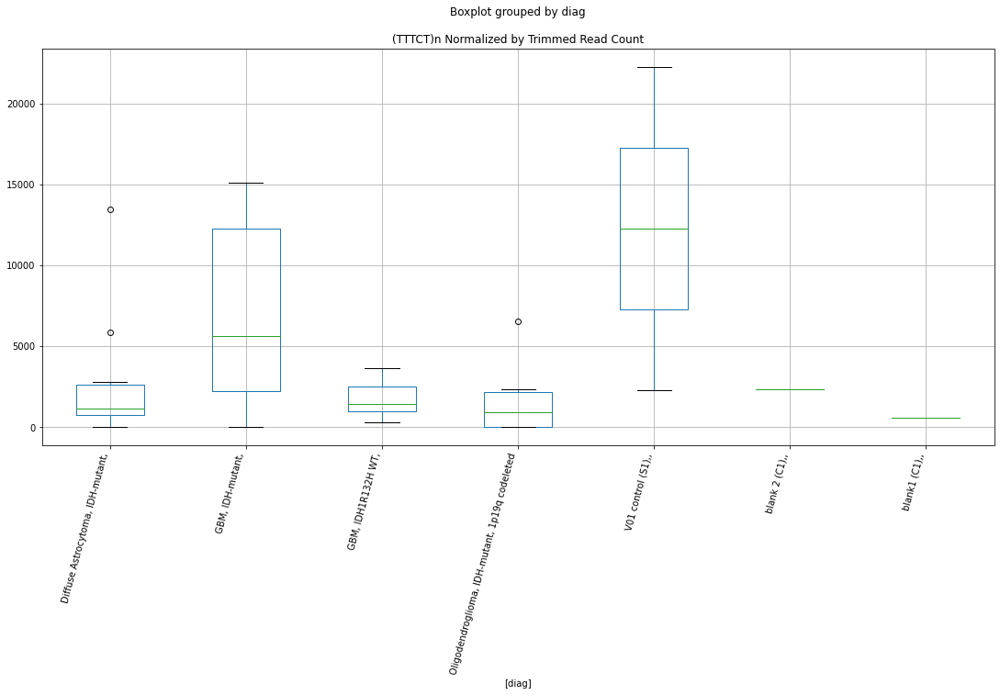

 p : 0.01196024382064254  ( t : 2.7951543894644084 ) :  D-plex  :  bbduk2  :  GSATII
Control and blanks
73     37877.41
337     8011.42
Name: GSATII, dtype: float64
205    45847.28
Name: GSATII, dtype: float64
469    11830.55
Name: GSATII, dtype: float64


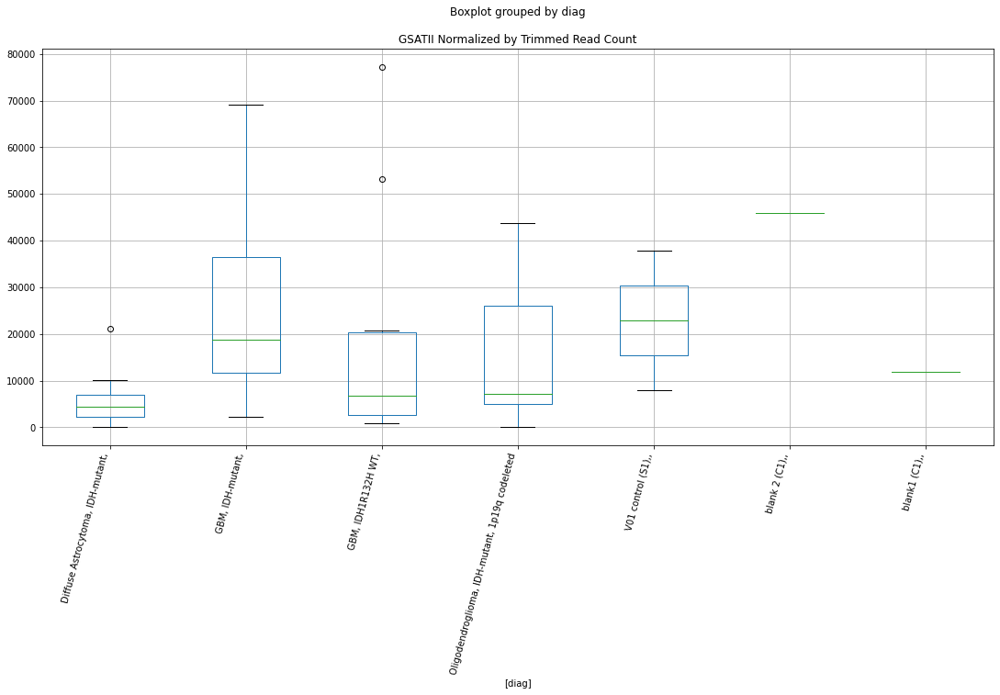

 p : 0.011968862653864014  ( t : 2.7948180747911517 ) :  Lexogen  :  cutadapt2  :  (TCCCCCC)n
Control and blanks
82       0.00
346    420.87
Name: (TCCCCCC)n, dtype: float64
214    0.0
Name: (TCCCCCC)n, dtype: float64
478    237.46
Name: (TCCCCCC)n, dtype: float64


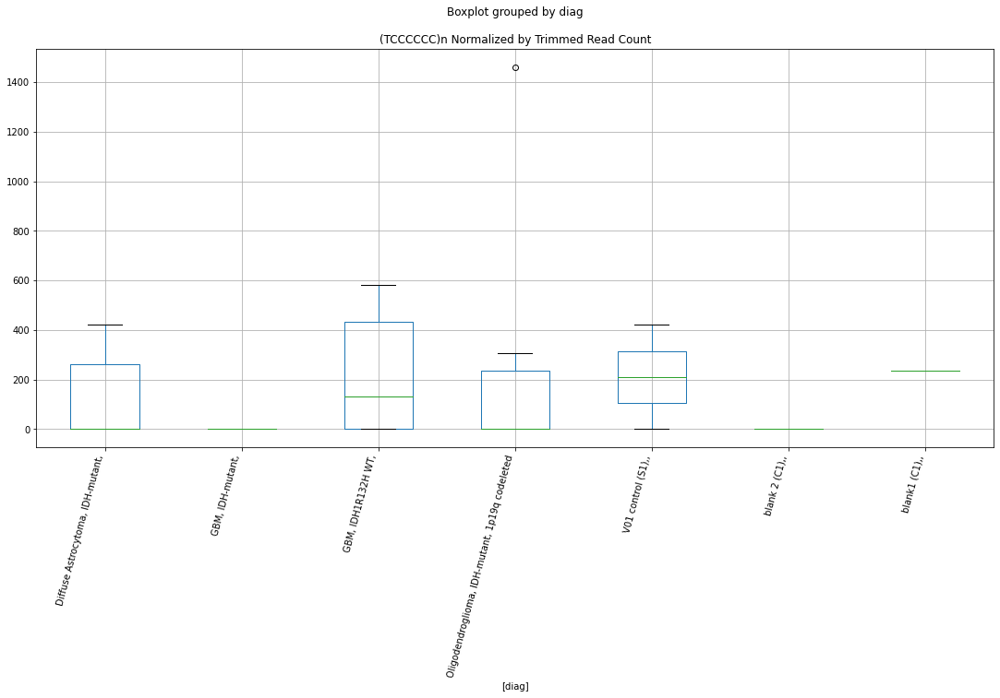

 p : 0.012045077316633093  ( t : 2.7918541918040822 ) :  D-plex  :  cutadapt2  :  MLT1E1
Control and blanks
76     19697.97
340    22899.04
Name: MLT1E1, dtype: float64
208    17283.3
Name: MLT1E1, dtype: float64
472    19072.54
Name: MLT1E1, dtype: float64


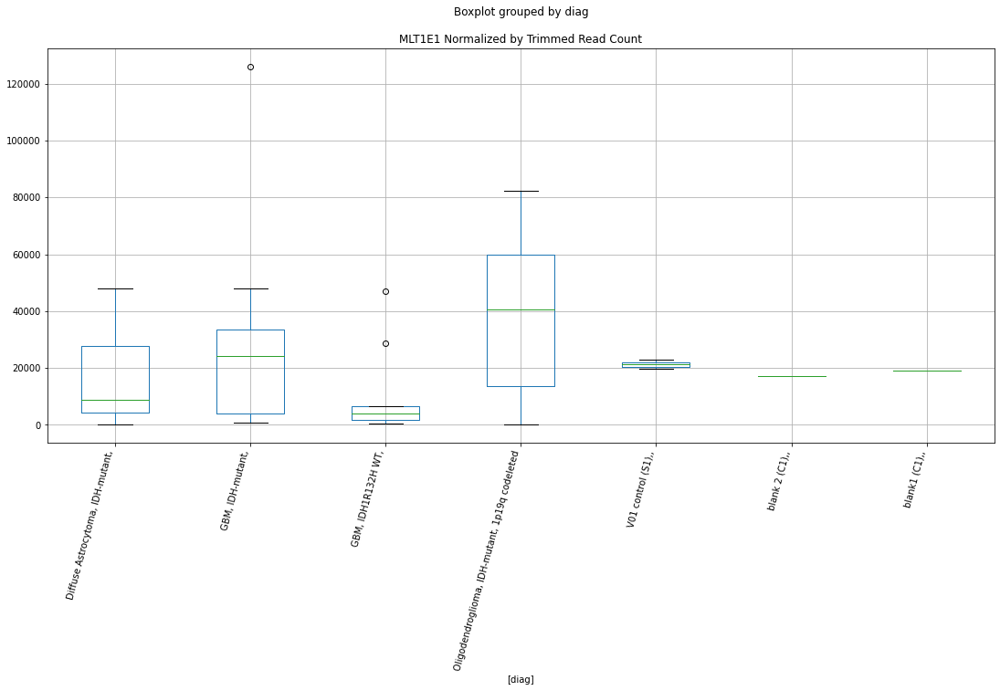

 p : 0.012053637301586333  ( t : 2.7915224315766474 ) :  D-plex  :  cutadapt2  :  PABL_A
Control and blanks
76     1515.23
340       0.00
Name: PABL_A, dtype: float64
208    11110.69
Name: PABL_A, dtype: float64
472    2889.78
Name: PABL_A, dtype: float64


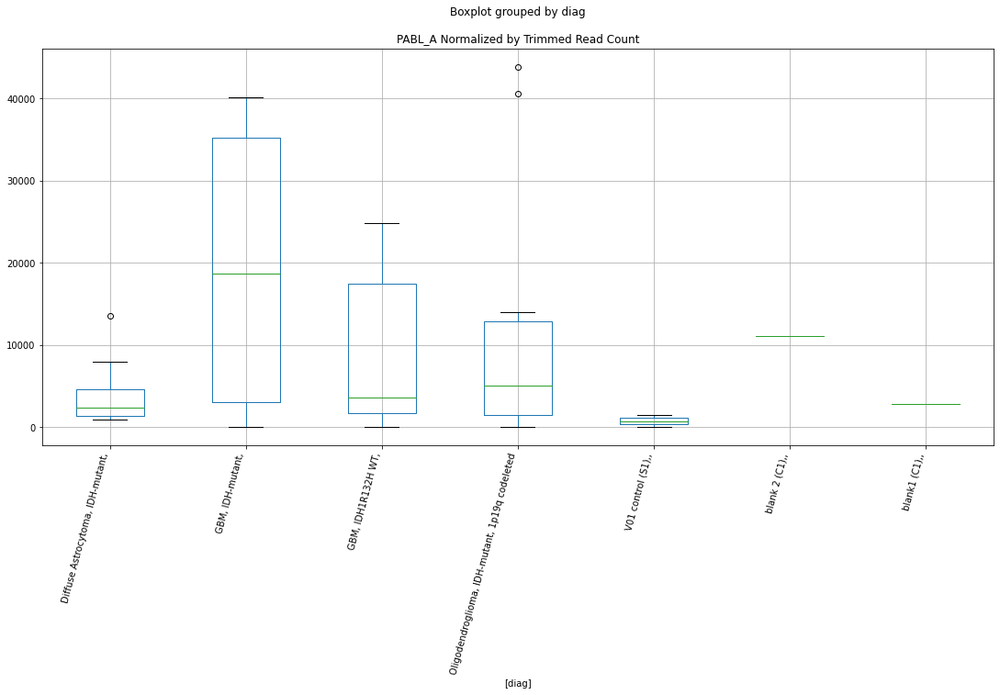

 p : 0.012107721957877605  ( t : 2.789431483075729 ) :  D-plex  :  bbduk2  :  LTR86A1
Control and blanks
73      2319.03
337    20473.62
Name: LTR86A1, dtype: float64
205    10924.55
Name: LTR86A1, dtype: float64
469    8281.38
Name: LTR86A1, dtype: float64


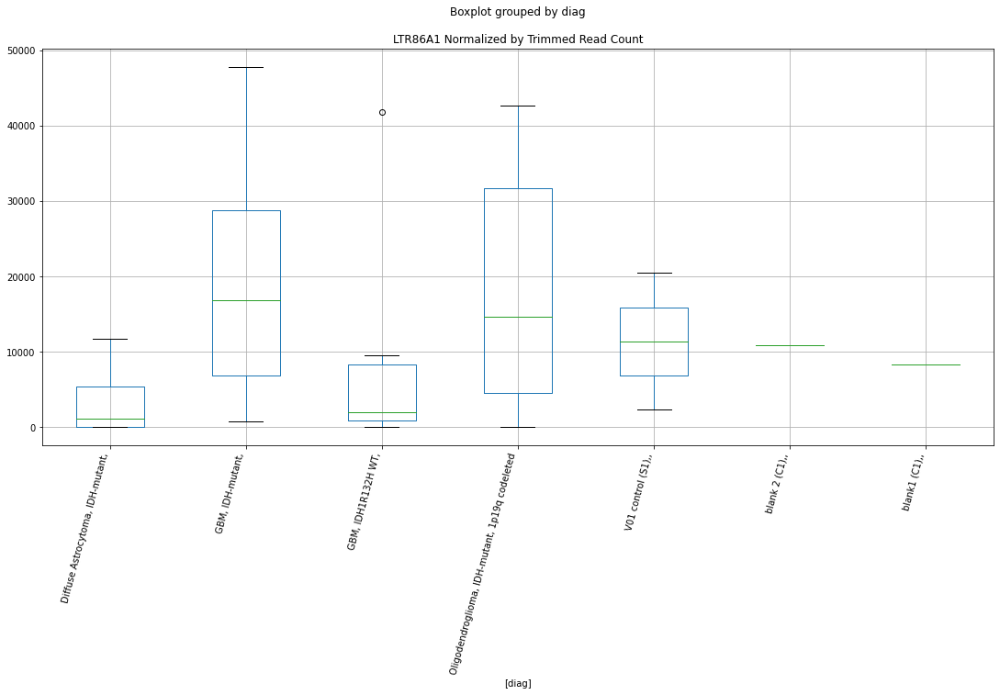

 p : 0.012311637773632986  ( t : 2.781627791840596 ) :  D-plex  :  cutadapt2  :  Charlie30a
Control and blanks
76      757.61
340    3522.93
Name: Charlie30a, dtype: float64
208    7230.77
Name: Charlie30a, dtype: float64
472    4623.65
Name: Charlie30a, dtype: float64


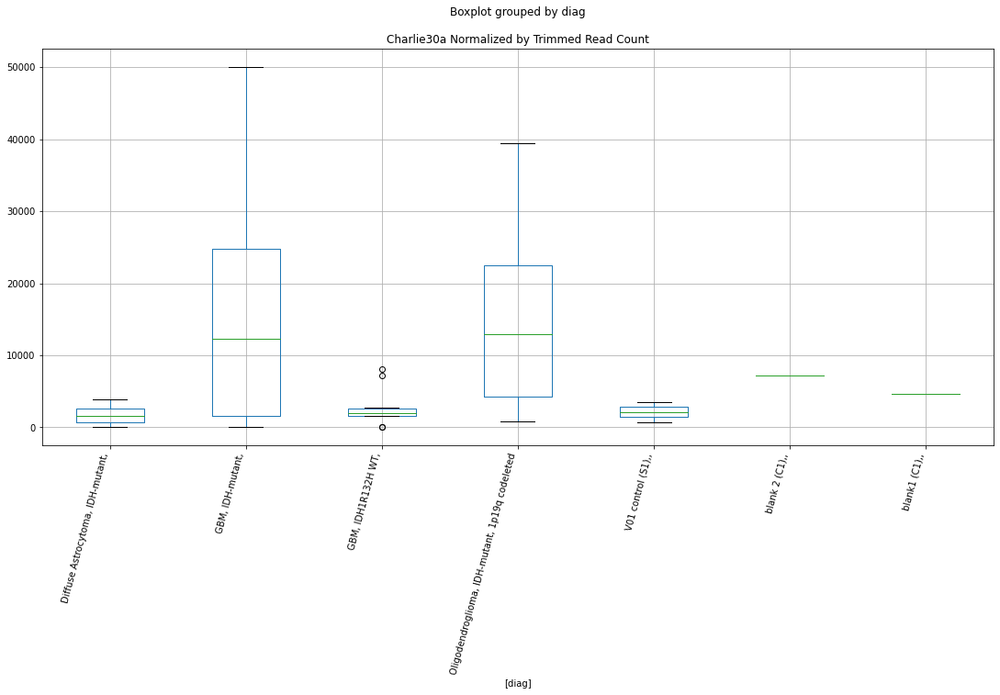

 p : 0.012398096499007196  ( t : 2.778356476769962 ) :  D-plex  :  bbduk2  :  MLT1E1
Control and blanks
73     20098.22
337    23144.09
Name: MLT1E1, dtype: float64
205    17192.73
Name: MLT1E1, dtype: float64
469    18928.87
Name: MLT1E1, dtype: float64


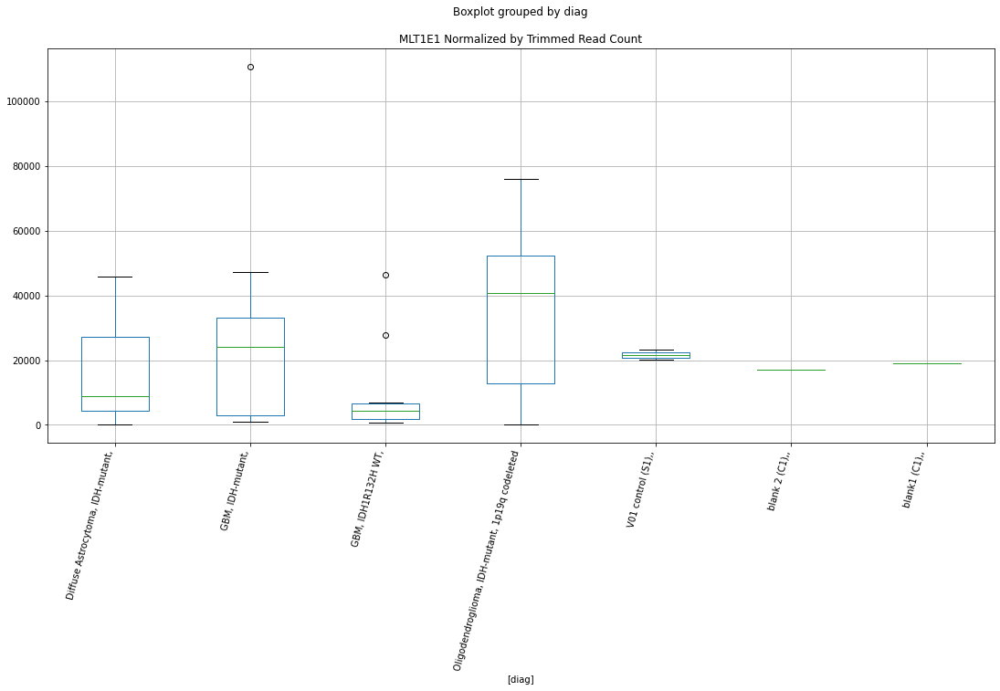

 p : 0.012531954717089308  ( t : 2.7733346516597654 ) :  D-plex  :  cutadapt2  :  MER107
Control and blanks
76      757.61
340    7926.59
Name: MER107, dtype: float64
208    9347.09
Name: MER107, dtype: float64
472    10403.21
Name: MER107, dtype: float64


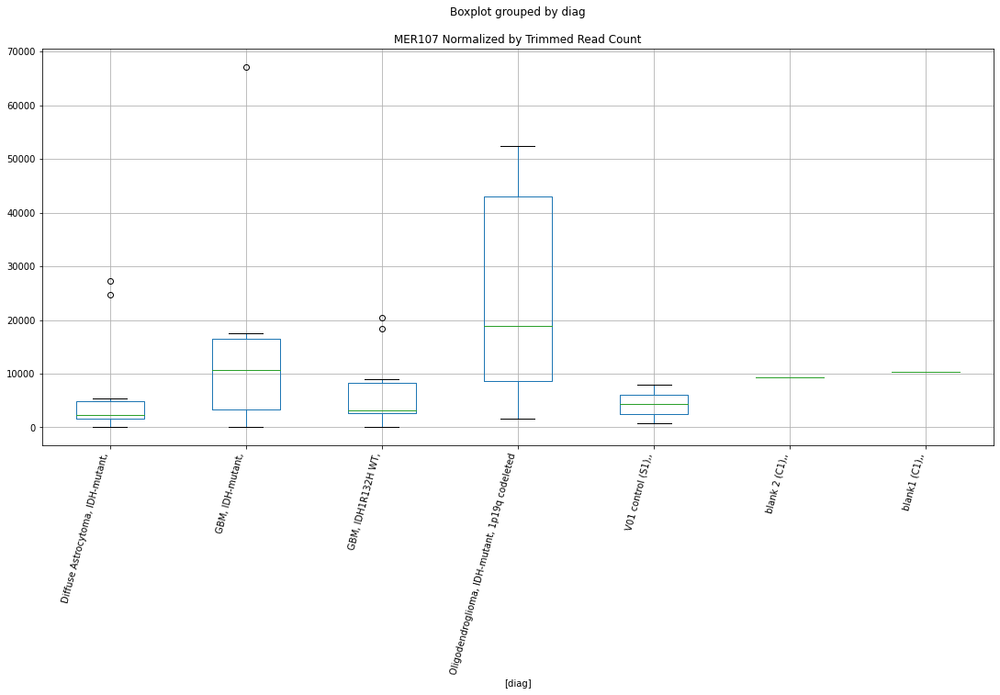

 p : 0.012562159808617648  ( t : 2.7722085958415508 ) :  D-plex  :  bbduk2  :  HUERS-P3b-int
Control and blanks
73      6184.07
337    38276.76
Name: HUERS-P3b-int, dtype: float64
205    19162.73
Name: HUERS-P3b-int, dtype: float64
469    17745.82
Name: HUERS-P3b-int, dtype: float64


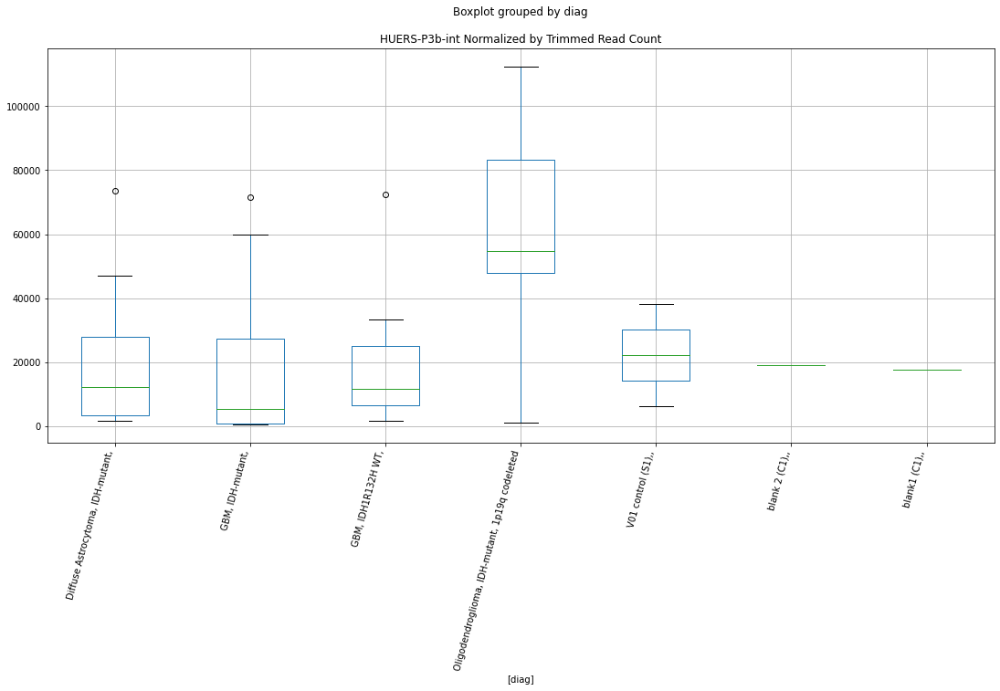

 p : 0.012565262674786646  ( t : 2.7720930671115975 ) :  D-plex  :  cutadapt2  :  GSATII
Control and blanks
76     37123.10
340     7045.86
Name: GSATII, dtype: float64
208    45853.66
Name: GSATII, dtype: float64
472    12137.07
Name: GSATII, dtype: float64


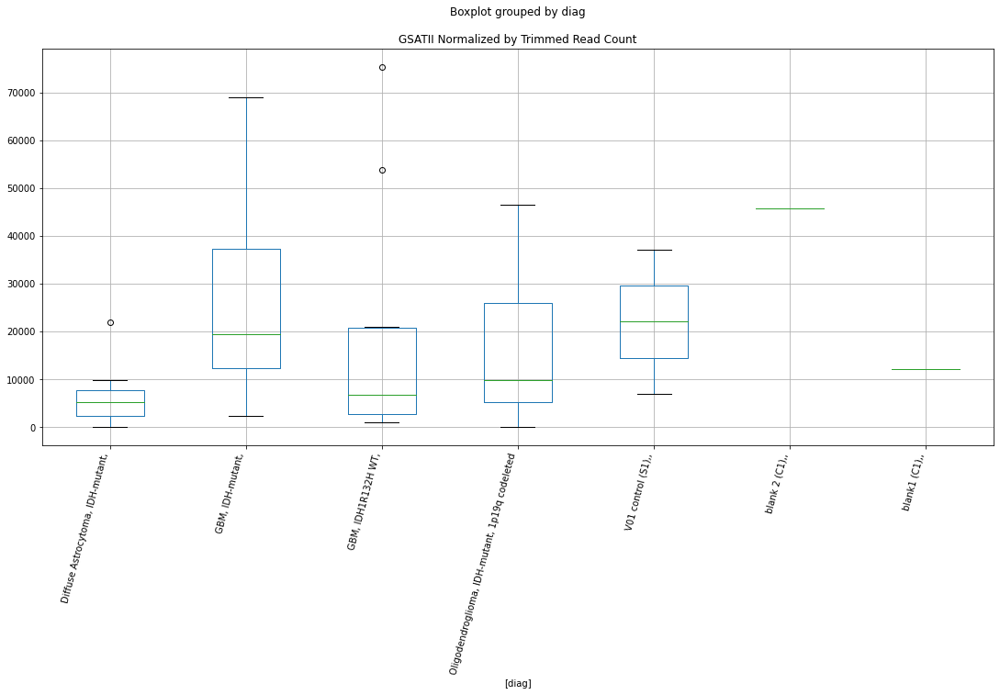

 p : 0.01259251330878072  ( t : 2.771079620705551 ) :  D-plex  :  bbduk2  :  (TTTCT)n
Control and blanks
73      2319.03
337    22253.93
Name: (TTTCT)n, dtype: float64
205    2328.18
Name: (TTTCT)n, dtype: float64
469    591.53
Name: (TTTCT)n, dtype: float64


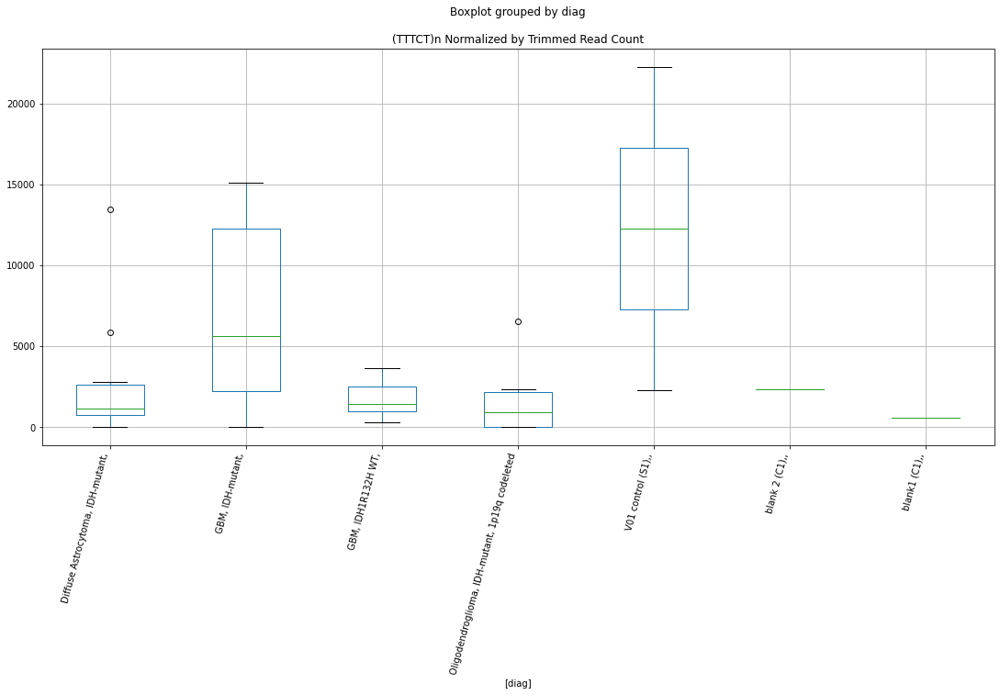

 p : 0.012850845019240926  ( t : 2.7615754480325654 ) :  D-plex  :  bbduk2  :  UCON4
Control and blanks
73     773.01
337      0.00
Name: UCON4, dtype: float64
205    895.45
Name: UCON4, dtype: float64
469    591.53
Name: UCON4, dtype: float64


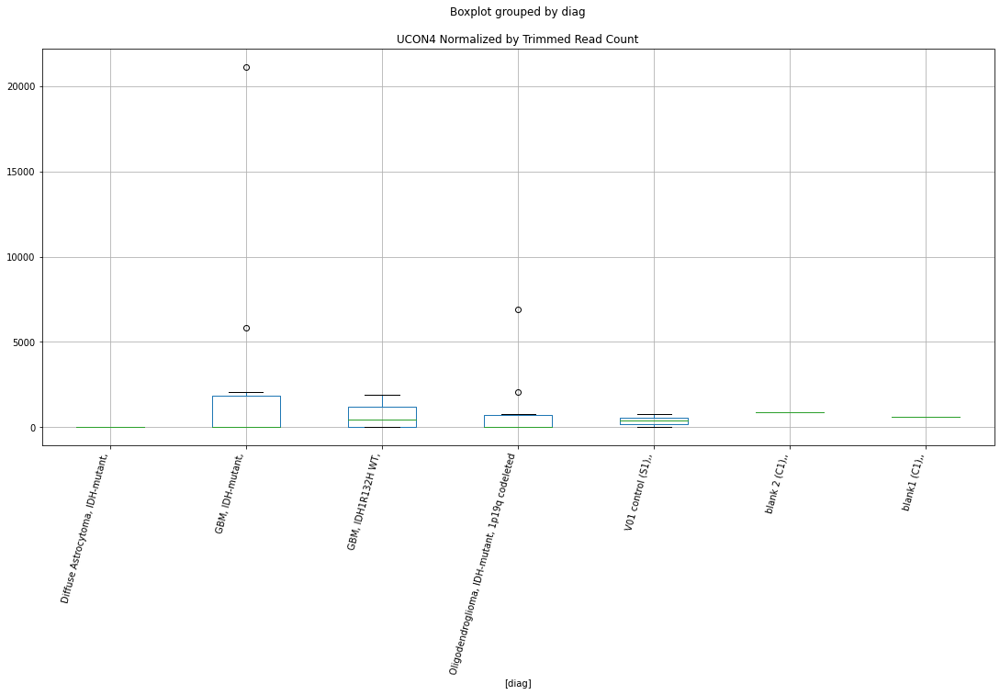

 p : 0.01293566749017685  ( t : 2.7584946975163653 ) :  D-plex  :  cutadapt2  :  UCON4
Control and blanks
76     757.61
340      0.00
Name: UCON4, dtype: float64
208    881.8
Name: UCON4, dtype: float64
472    577.96
Name: UCON4, dtype: float64


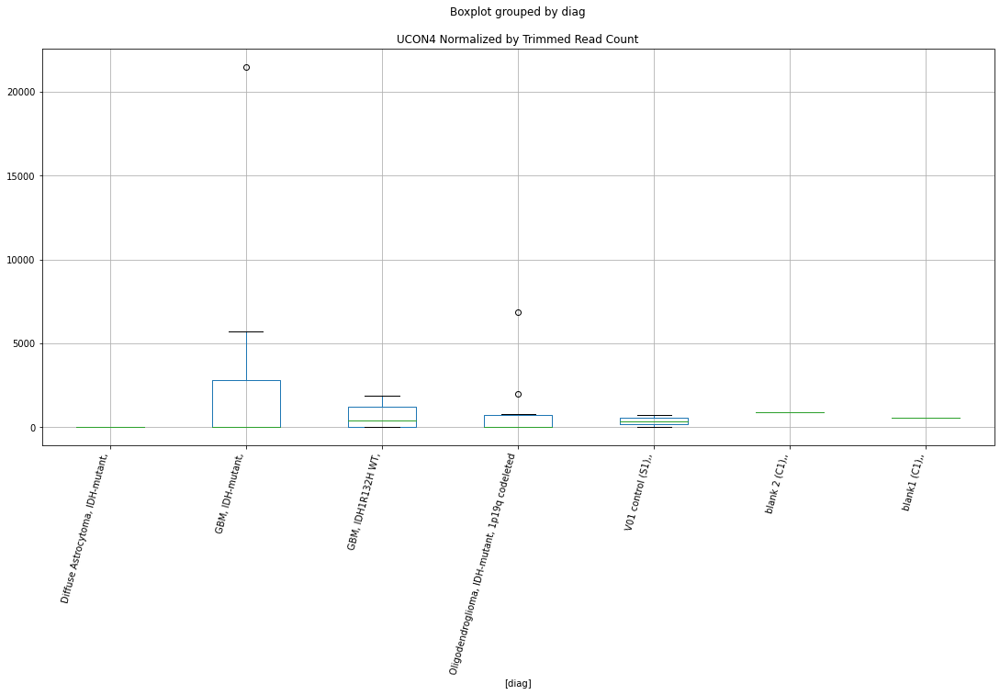

 p : 0.01296617732793875  ( t : 2.7573913140026494 ) :  D-plex  :  bbduk2  :  (CCCTCT)n
Control and blanks
73     6957.08
337    3560.63
Name: (CCCTCT)n, dtype: float64
205    3223.64
Name: (CCCTCT)n, dtype: float64
469    5915.27
Name: (CCCTCT)n, dtype: float64


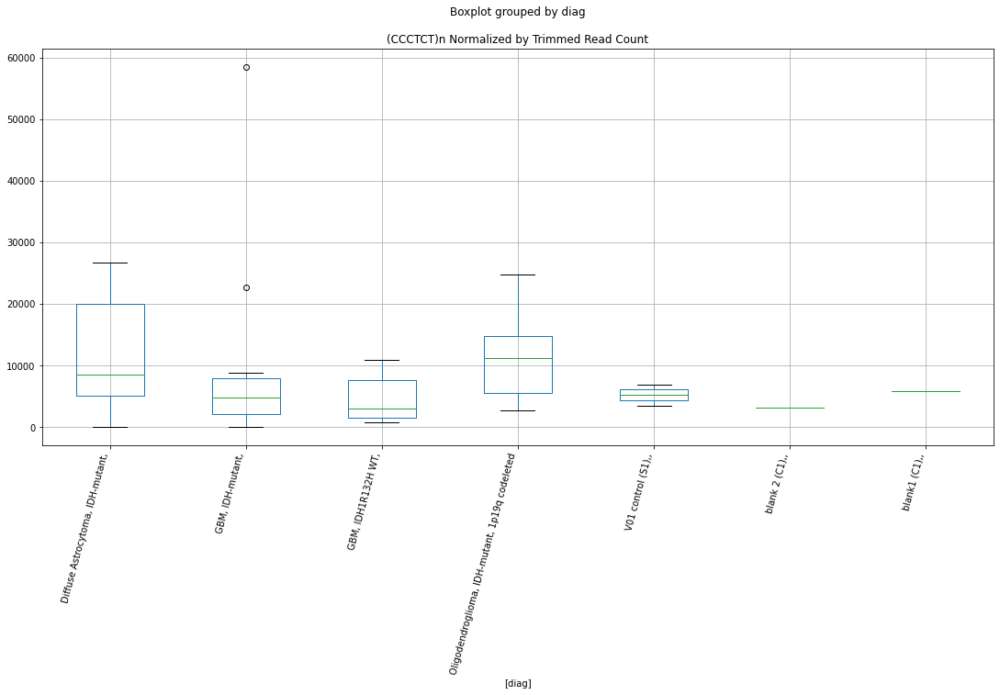

 p : 0.013033720529266091  ( t : 2.7549574503123218 ) :  D-plex  :  bbduk2  :  PABL_A
Control and blanks
73     1546.02
337       0.00
Name: PABL_A, dtype: float64
205    11103.64
Name: PABL_A, dtype: float64
469    2957.64
Name: PABL_A, dtype: float64


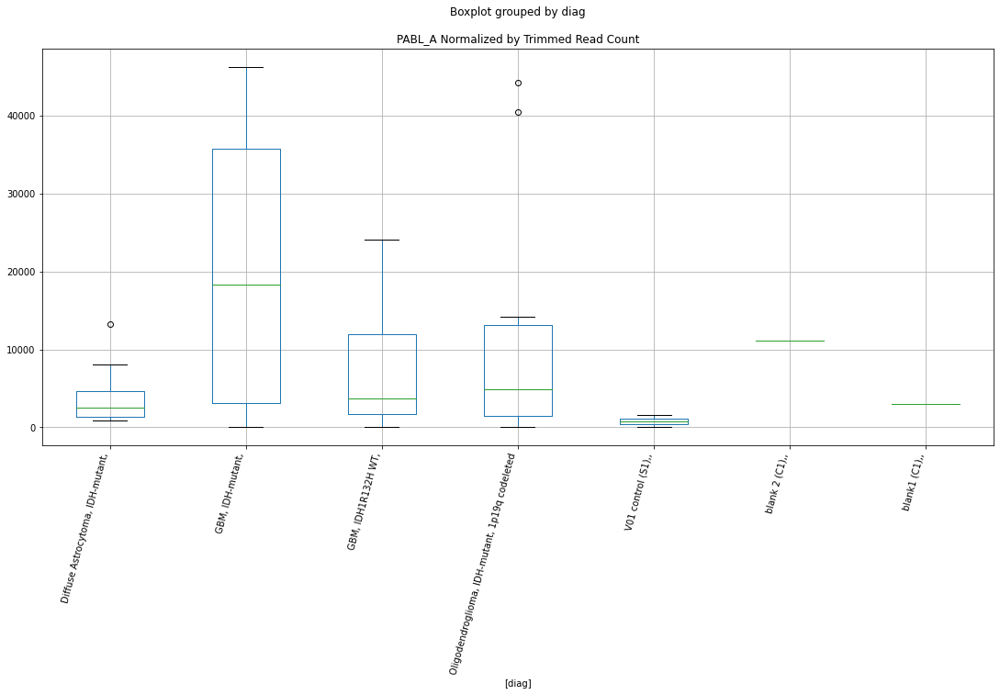

 p : 0.013040030594769016  ( t : 2.754730690020731 ) :  D-plex  :  cutadapt2  :  LTR33C
Control and blanks
76      1515.23
340    13210.98
Name: LTR33C, dtype: float64
208    16754.22
Name: LTR33C, dtype: float64
472    11559.12
Name: LTR33C, dtype: float64


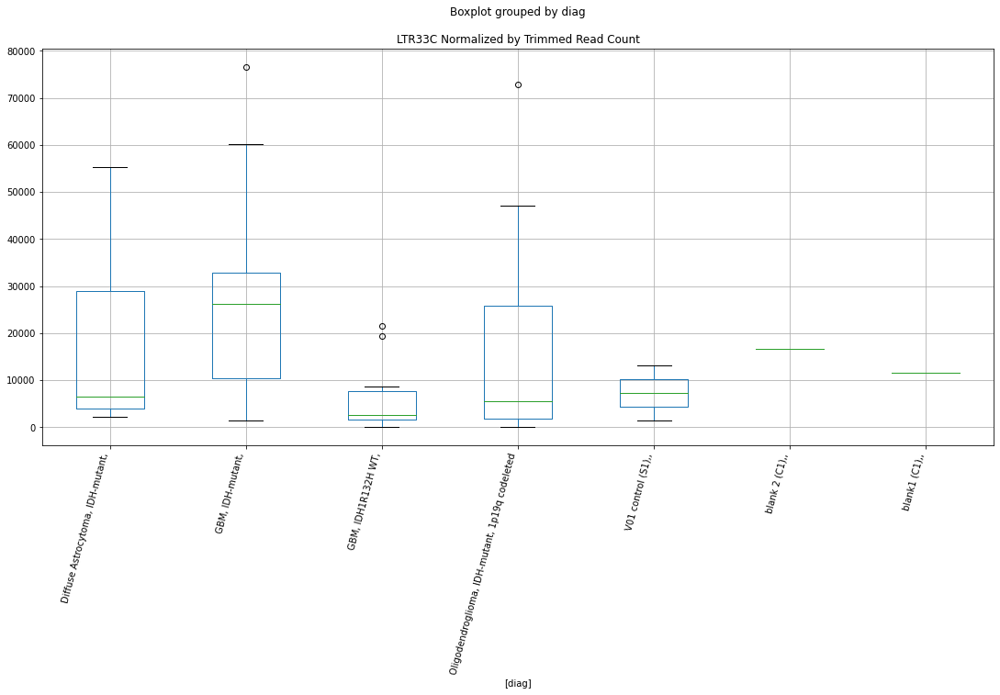

 p : 0.013111461108152452  ( t : 2.7521710496731338 ) :  D-plex  :  bbduk2  :  Tigger9b
Control and blanks
73     2319.03
337    5340.94
Name: Tigger9b, dtype: float64
205    7521.82
Name: Tigger9b, dtype: float64
469    12422.07
Name: Tigger9b, dtype: float64


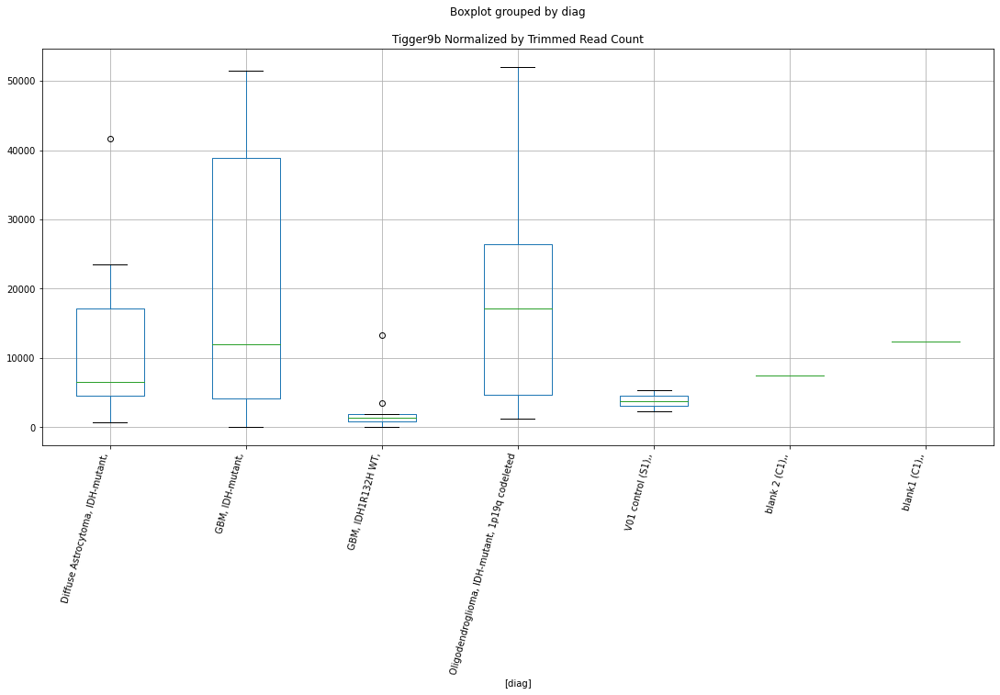

 p : 0.013135266480298355  ( t : 2.7513209759890302 ) :  Lexogen  :  bbduk2  :  (TTCC)n
Control and blanks
79     0.0
343    0.0
Name: (TTCC)n, dtype: float64
211    0.0
Name: (TTCC)n, dtype: float64
475    239.52
Name: (TTCC)n, dtype: float64


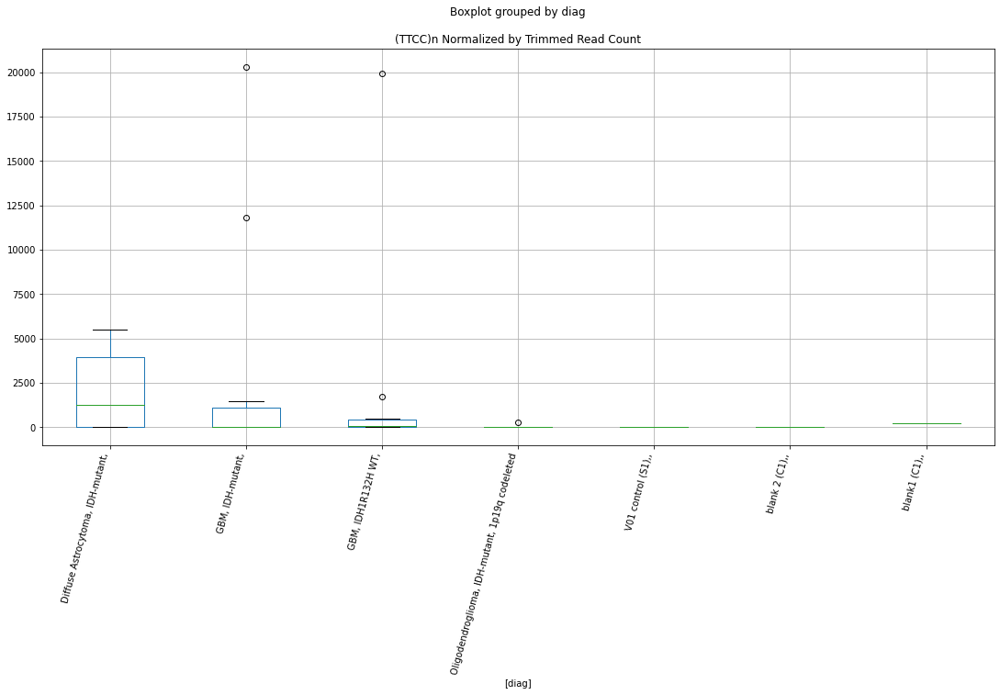

 p : 0.013152016214105486  ( t : 2.7507237385709074 ) :  D-plex  :  bbduk2  :  LTR40c
Control and blanks
73     0.0
337    0.0
Name: LTR40c, dtype: float64
205    9133.64
Name: LTR40c, dtype: float64
469    13013.6
Name: LTR40c, dtype: float64


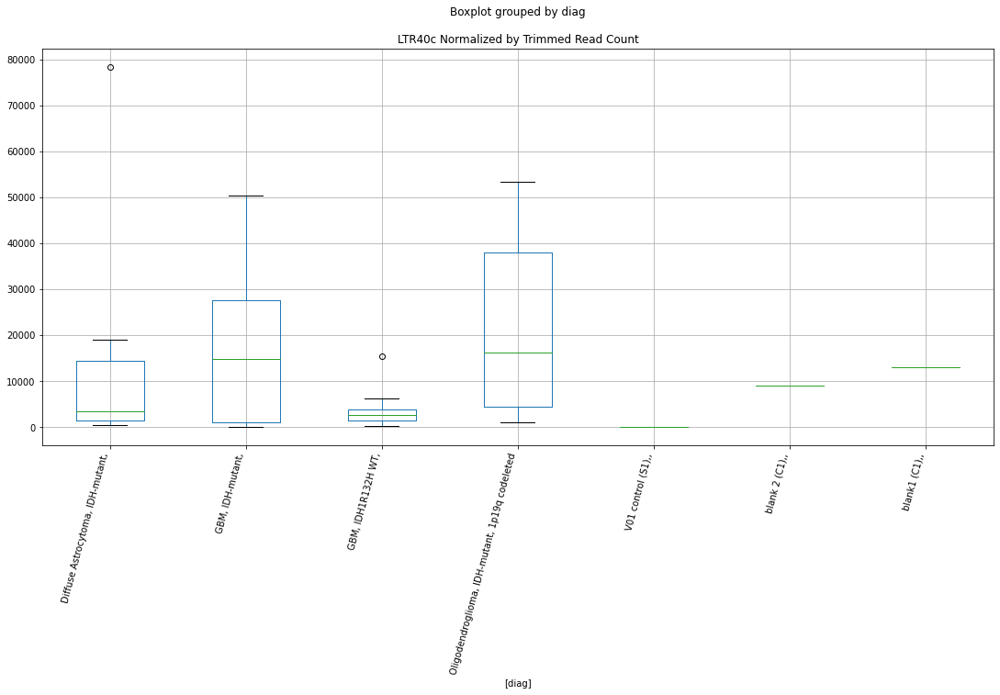

 p : 0.013308600192578955  ( t : 2.745175478445355 ) :  D-plex  :  cutadapt2  :  MER34C2
Control and blanks
76       757.61
340    22899.04
Name: MER34C2, dtype: float64
208    13227.02
Name: MER34C2, dtype: float64
472    13870.94
Name: MER34C2, dtype: float64


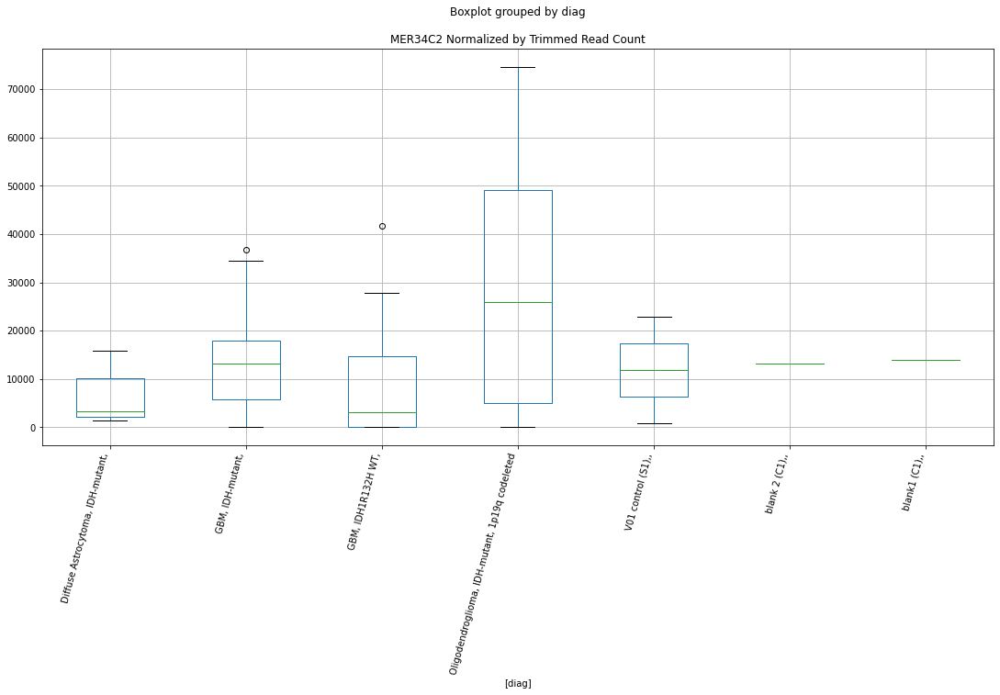

 p : 0.013335597685967829  ( t : 2.744225197064739 ) :  D-plex  :  cutadapt2  :  HUERS-P3b-int
Control and blanks
76      6060.91
340    38752.21
Name: HUERS-P3b-int, dtype: float64
208    18694.18
Name: HUERS-P3b-int, dtype: float64
472    17338.68
Name: HUERS-P3b-int, dtype: float64


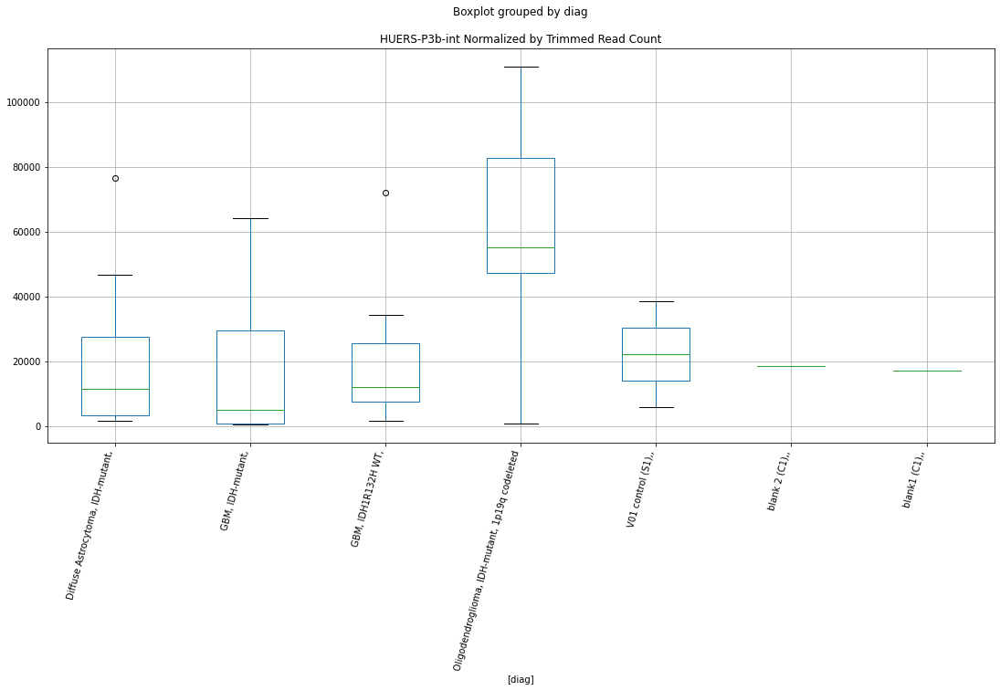

 p : 0.013417050845177272  ( t : 2.7413692616487313 ) :  D-plex  :  cutadapt2  :  LTR90B
Control and blanks
76     0.0
340    0.0
Name: LTR90B, dtype: float64
208    5819.89
Name: LTR90B, dtype: float64
472    5201.6
Name: LTR90B, dtype: float64


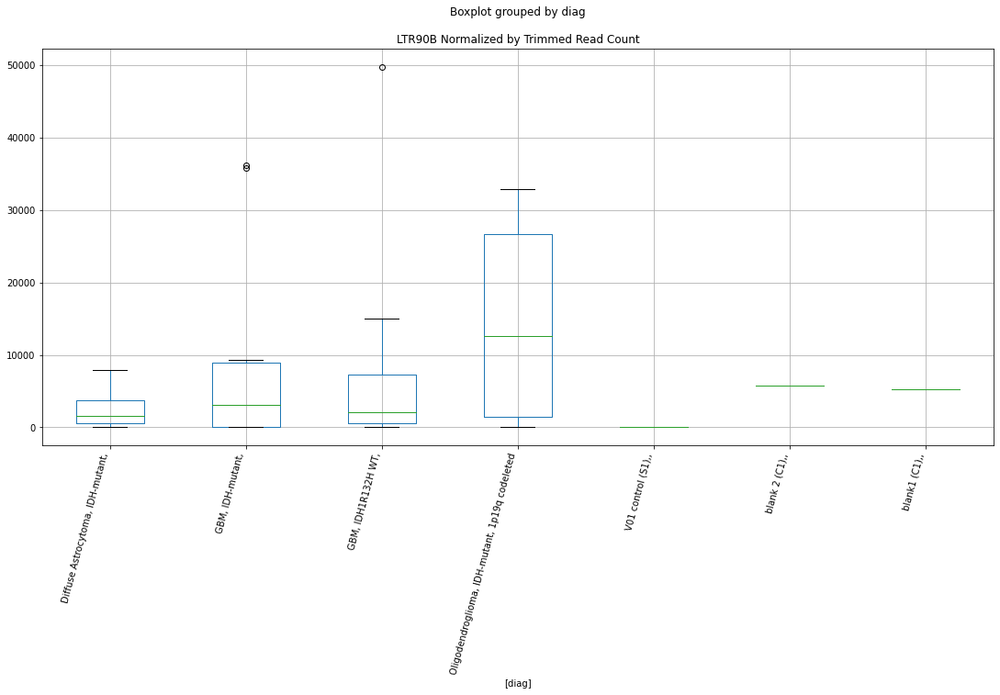

 p : 0.013653648312983813  ( t : 2.7331667770093793 ) :  D-plex  :  bbduk2  :  Kanga1b
Control and blanks
73        0.00
337    2670.47
Name: Kanga1b, dtype: float64
205    4477.27
Name: Kanga1b, dtype: float64
469    7689.86
Name: Kanga1b, dtype: float64


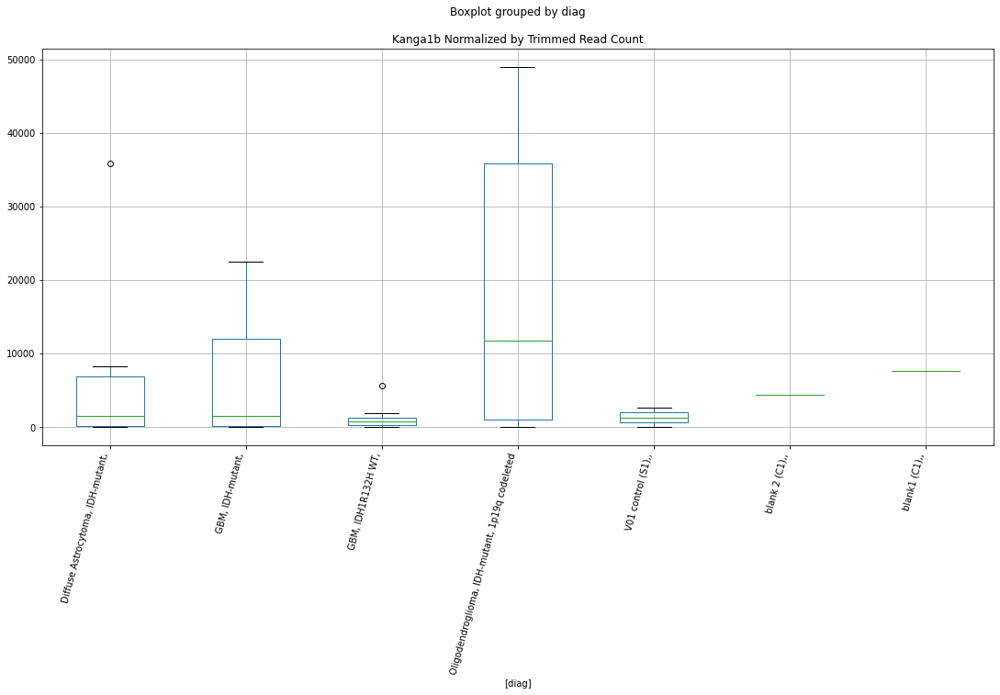

 p : 0.013764752386799637  ( t : 2.7293618001196602 ) :  D-plex  :  bbduk2  :  HUERS-P3-int
Control and blanks
73      5411.06
337    68542.11
Name: HUERS-P3-int, dtype: float64
205    33310.92
Name: HUERS-P3-int, dtype: float64
469    249624.53
Name: HUERS-P3-int, dtype: float64


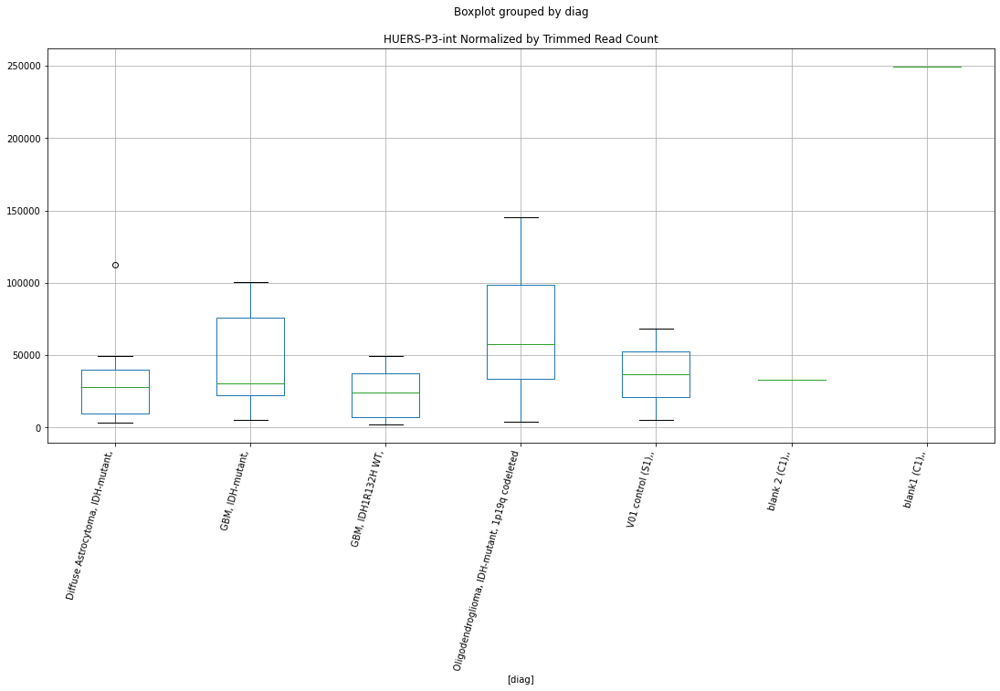

 p : 0.01378352759236259  ( t : 2.728721710710469 ) :  D-plex  :  cutadapt2  :  LTR2B
Control and blanks
76     757.61
340      0.00
Name: LTR2B, dtype: float64
208    4761.73
Name: LTR2B, dtype: float64
472    6357.51
Name: LTR2B, dtype: float64


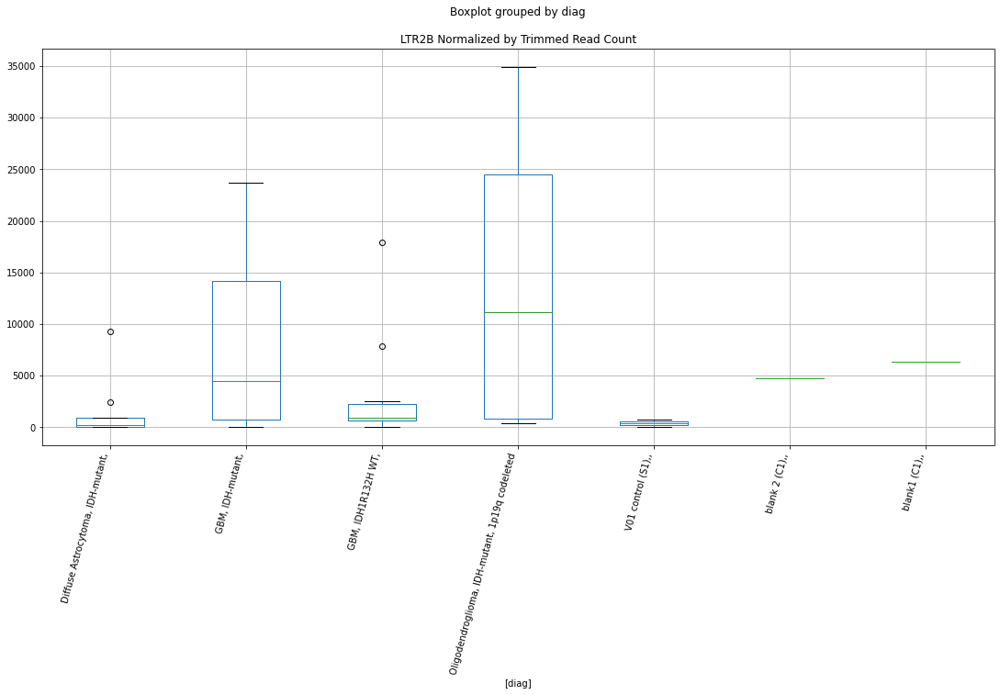

 p : 0.013894900363313216  ( t : 2.724941824849503 ) :  D-plex  :  bbduk2  :  LTR45B
Control and blanks
73      3865.04
337    16912.99
Name: LTR45B, dtype: float64
205    11103.64
Name: LTR45B, dtype: float64
469    13605.13
Name: LTR45B, dtype: float64


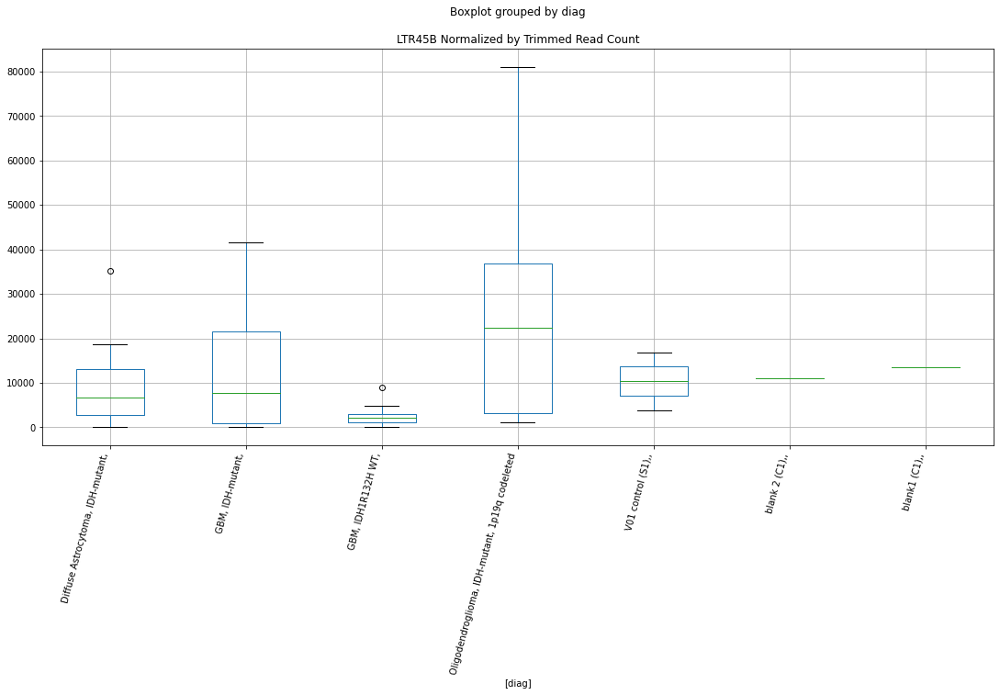

 p : 0.013924385043744977  ( t : 2.723945995182514 ) :  D-plex  :  bbduk2  :  LTR5
Control and blanks
73     0.0
337    0.0
Name: LTR5, dtype: float64
205    0.0
Name: LTR5, dtype: float64
469    0.0
Name: LTR5, dtype: float64


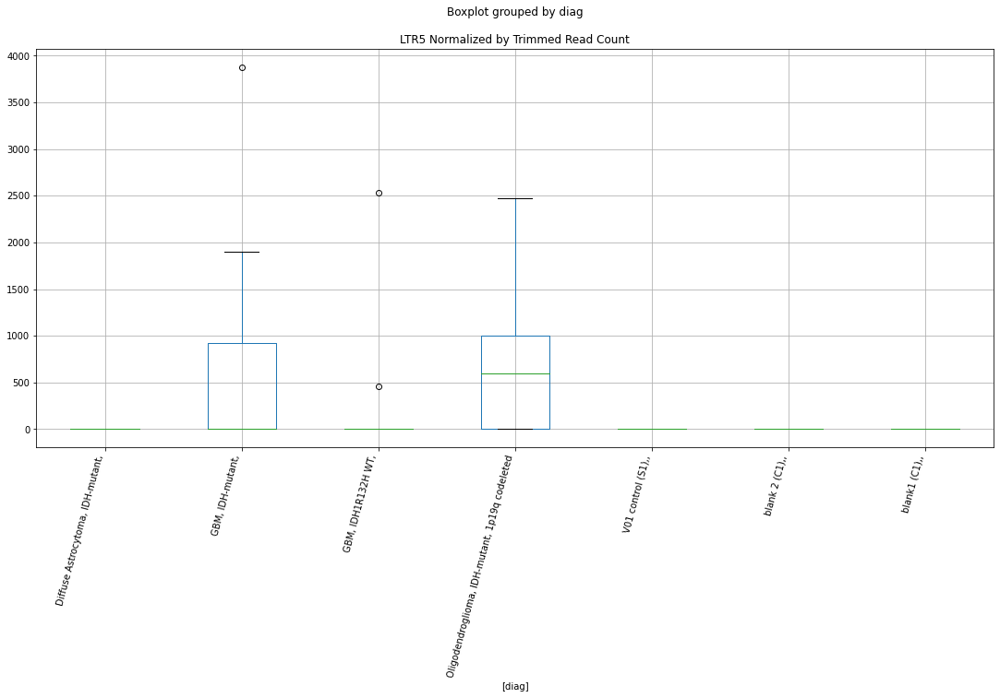

 p : 0.013946038787970003  ( t : 2.7232159350644842 ) :  D-plex  :  cutadapt2  :  AluYb9
Control and blanks
76      3030.46
340    10568.79
Name: AluYb9, dtype: float64
208    7759.85
Name: AluYb9, dtype: float64
472    5201.6
Name: AluYb9, dtype: float64


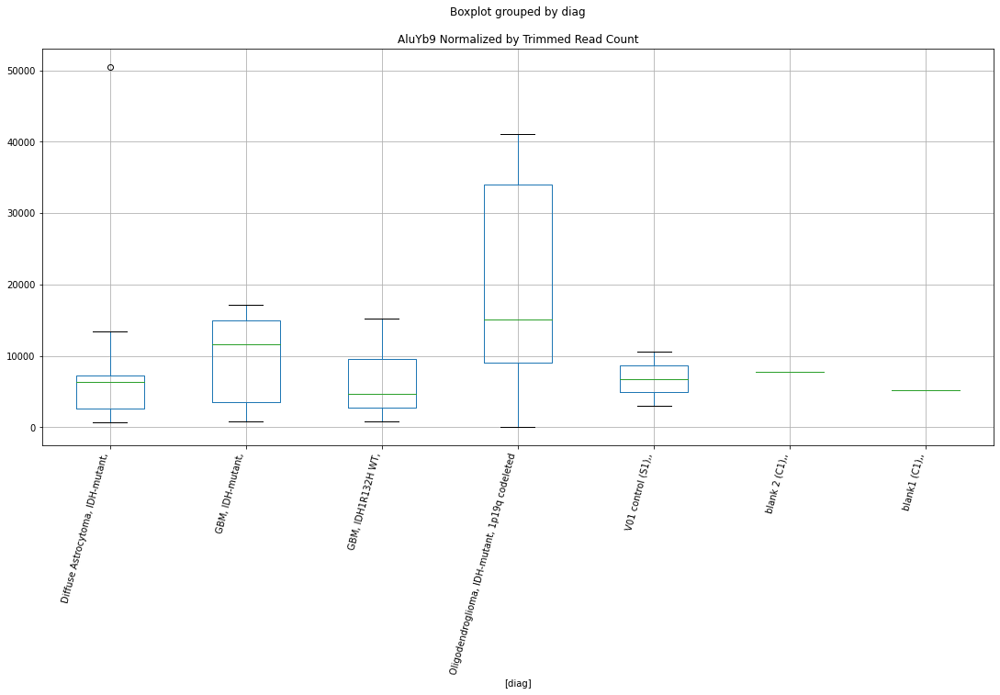

 p : 0.013977786459649989  ( t : 2.7221475140344187 ) :  D-plex  :  bbduk2  :  HERV30-int
Control and blanks
73     1546.02
337       0.00
Name: HERV30-int, dtype: float64
205    6268.18
Name: HERV30-int, dtype: float64
469    3549.16
Name: HERV30-int, dtype: float64


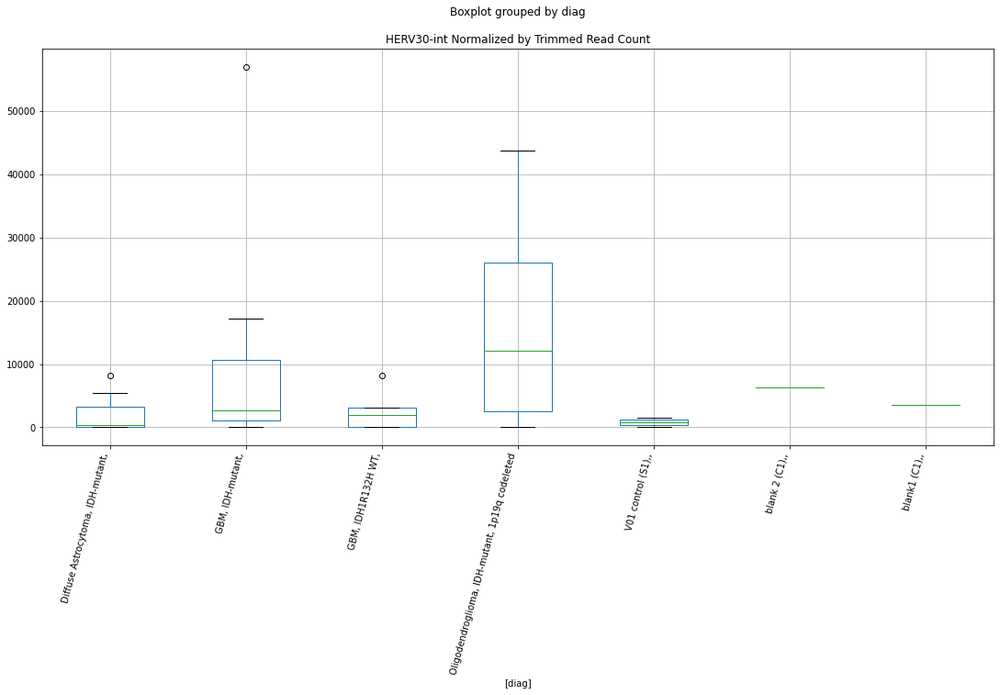

 p : 0.01399075640505805  ( t : 2.721711697316391 ) :  D-plex  :  cutadapt2  :  Ricksha_b
Control and blanks
76       0.00
340    880.73
Name: Ricksha_b, dtype: float64
208    2116.32
Name: Ricksha_b, dtype: float64
472    2889.78
Name: Ricksha_b, dtype: float64


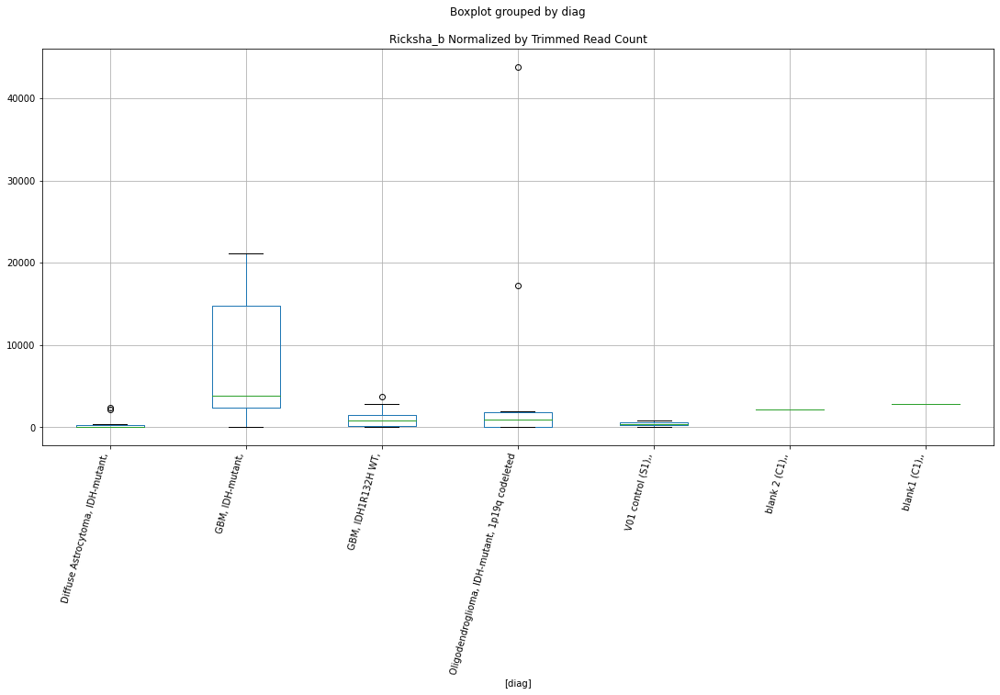

 p : 0.014226358894450805  ( t : 2.7138615048453514 ) :  D-plex  :  cutadapt2  :  AluYk4
Control and blanks
76      43941.62
340    116256.64
Name: AluYk4, dtype: float64
208    25924.95
Name: AluYk4, dtype: float64
472    27163.92
Name: AluYk4, dtype: float64


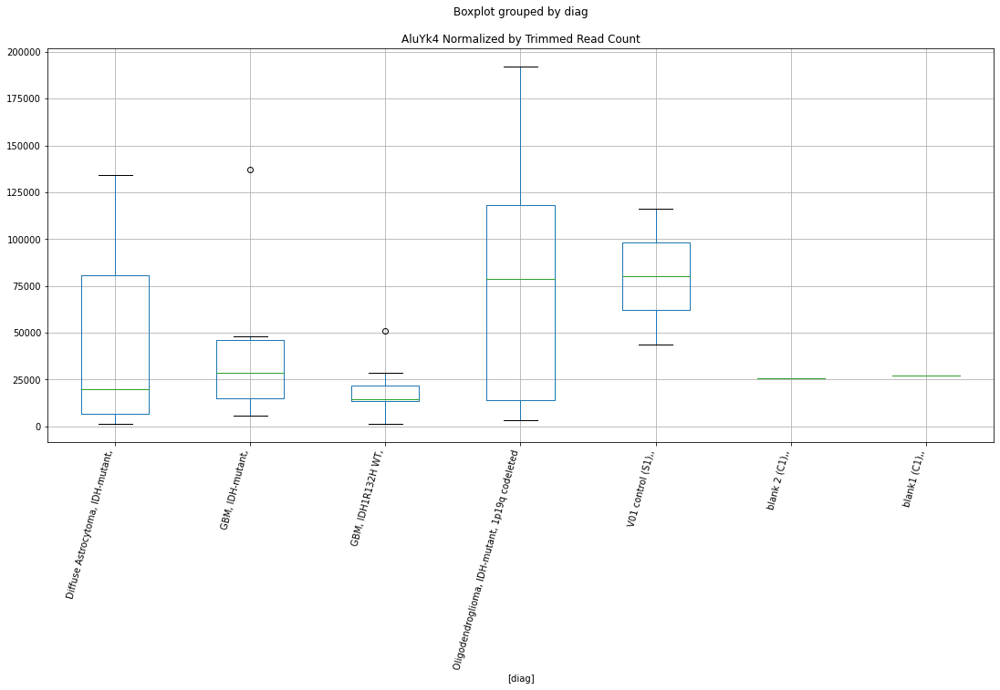

 p : 0.01437866875159136  ( t : 2.7088524714291022 ) :  D-plex  :  cutadapt2  :  HERV30-int
Control and blanks
76     1515.23
340       0.00
Name: HERV30-int, dtype: float64
208    5290.81
Name: HERV30-int, dtype: float64
472    2889.78
Name: HERV30-int, dtype: float64


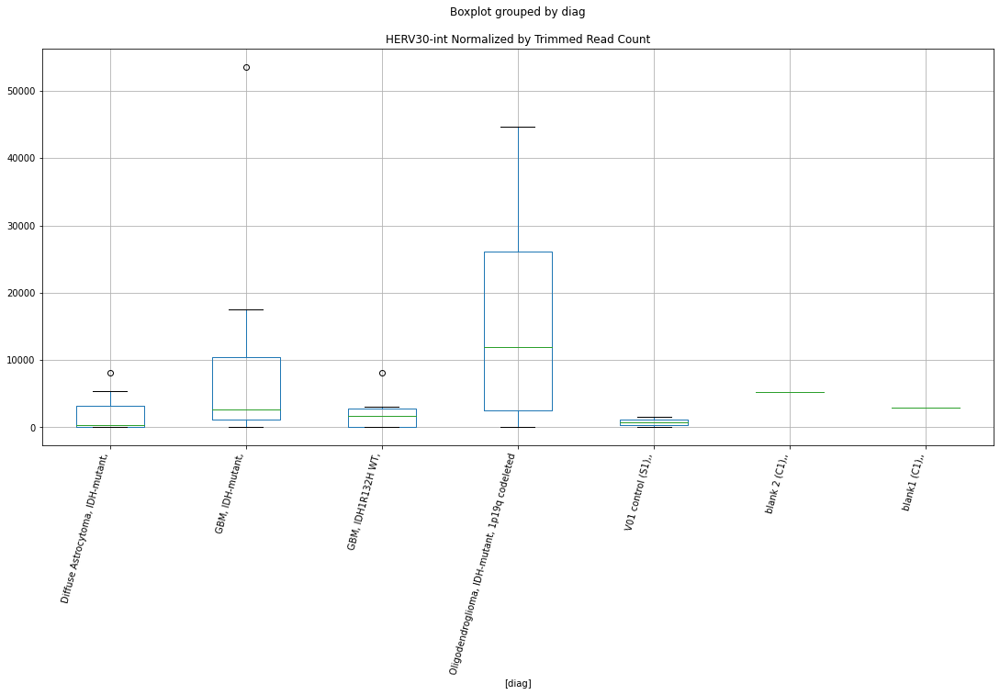

 p : 0.014451023729053165  ( t : 2.7064906656949947 ) :  D-plex  :  cutadapt2  :  MER61F
Control and blanks
76       0.00
340    880.73
Name: MER61F, dtype: float64
208    2469.04
Name: MER61F, dtype: float64
472    4623.65
Name: MER61F, dtype: float64


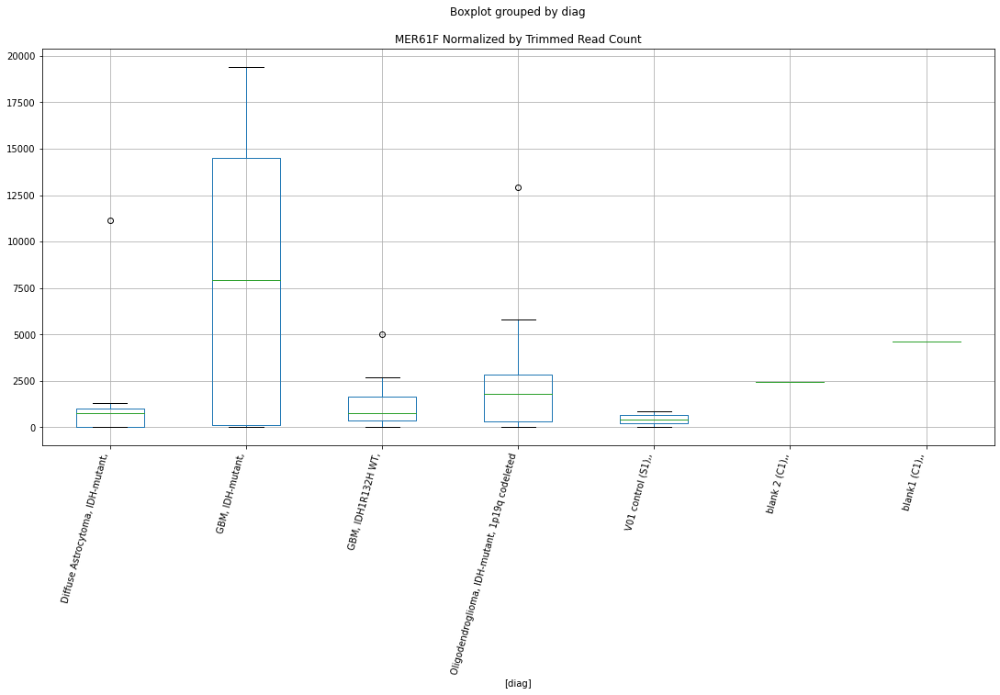

 p : 0.014472619996150965  ( t : 2.7057879114521803 ) :  D-plex  :  cutadapt2  :  HERV30-int
Control and blanks
76     1515.23
340       0.00
Name: HERV30-int, dtype: float64
208    5290.81
Name: HERV30-int, dtype: float64
472    2889.78
Name: HERV30-int, dtype: float64


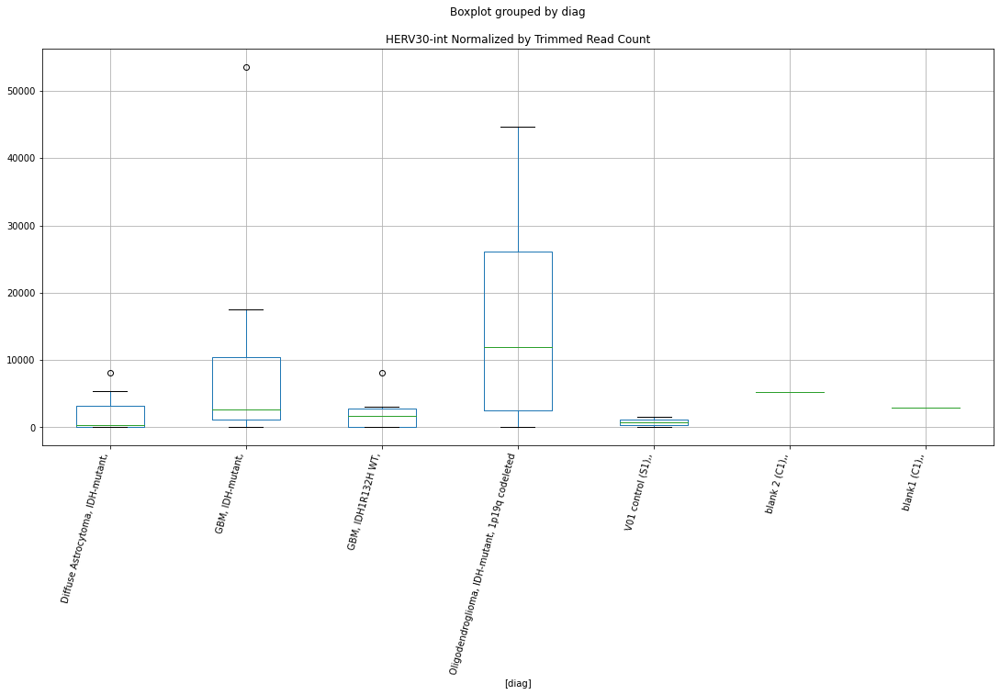

 p : 0.014504760906191795  ( t : 2.7047438818550025 ) :  D-plex  :  bbduk2  :  MER61F
Control and blanks
73       0.00
337    890.16
Name: MER61F, dtype: float64
205    2507.27
Name: MER61F, dtype: float64
469    4732.22
Name: MER61F, dtype: float64


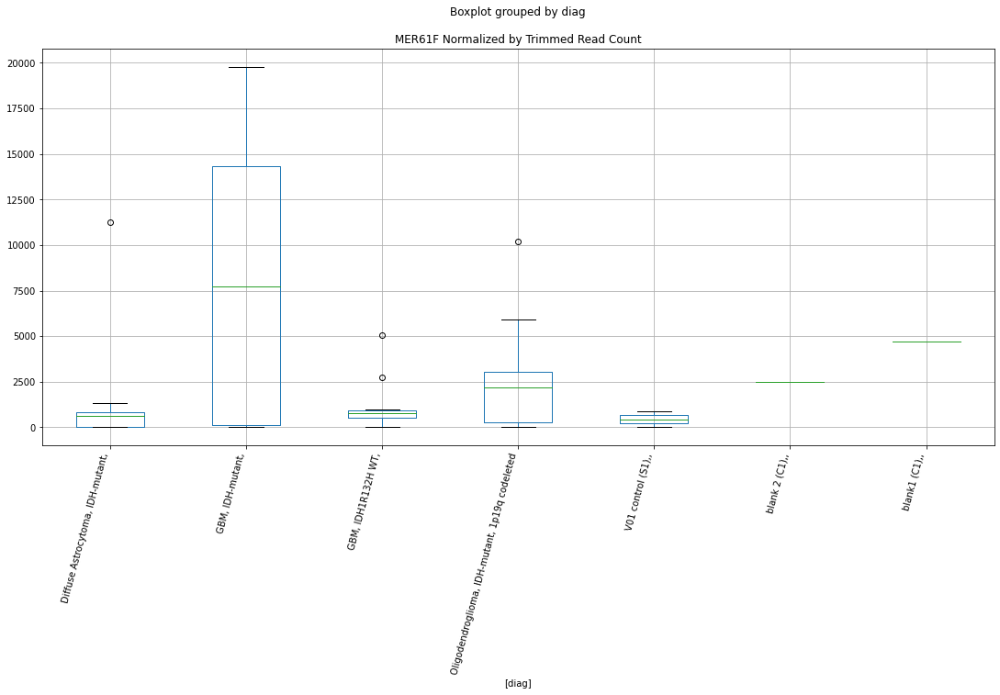

 p : 0.014588695973081253  ( t : 2.702027816010099 ) :  D-plex  :  cutadapt2  :  Charlie30a
Control and blanks
76      757.61
340    3522.93
Name: Charlie30a, dtype: float64
208    7230.77
Name: Charlie30a, dtype: float64
472    4623.65
Name: Charlie30a, dtype: float64


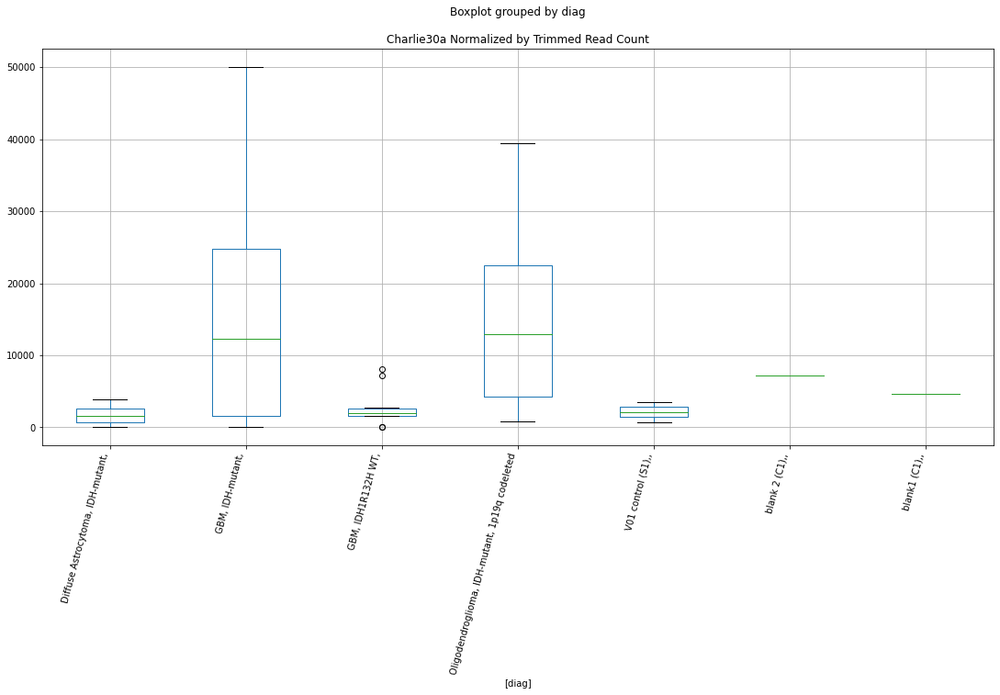

 p : 0.014597541338882416  ( t : 2.7017424576830344 ) :  D-plex  :  cutadapt2  :  MER101B
Control and blanks
76     0.0
340    0.0
Name: MER101B, dtype: float64
208    2821.76
Name: MER101B, dtype: float64
472    2311.82
Name: MER101B, dtype: float64


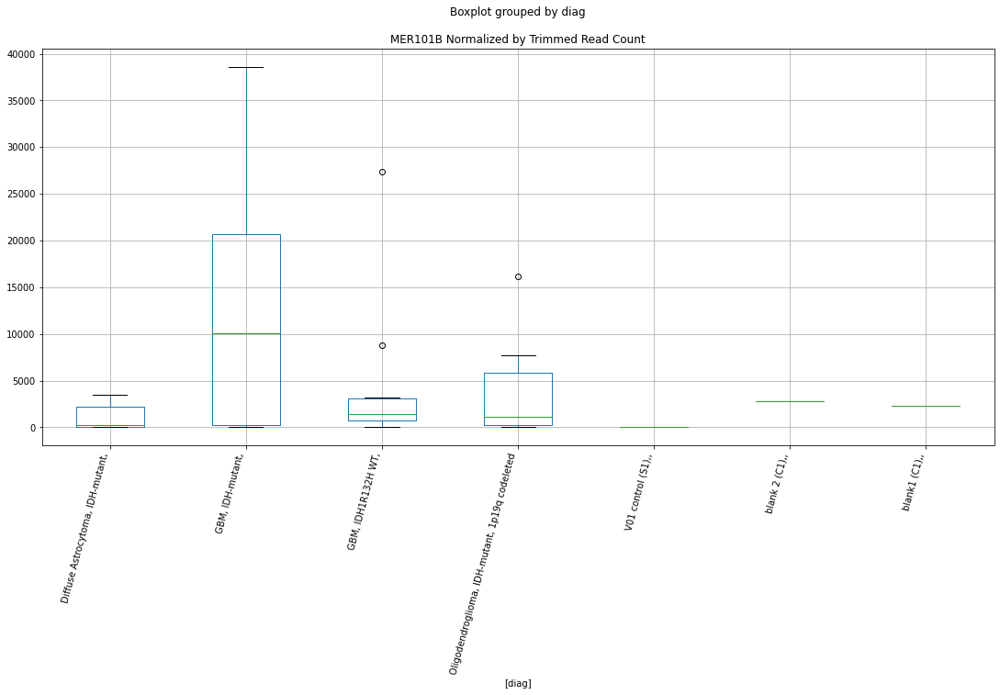

 p : 0.014653306530610363  ( t : 2.6999472235879756 ) :  D-plex  :  bbduk2  :  HERV30-int
Control and blanks
73     1546.02
337       0.00
Name: HERV30-int, dtype: float64
205    6268.18
Name: HERV30-int, dtype: float64
469    3549.16
Name: HERV30-int, dtype: float64


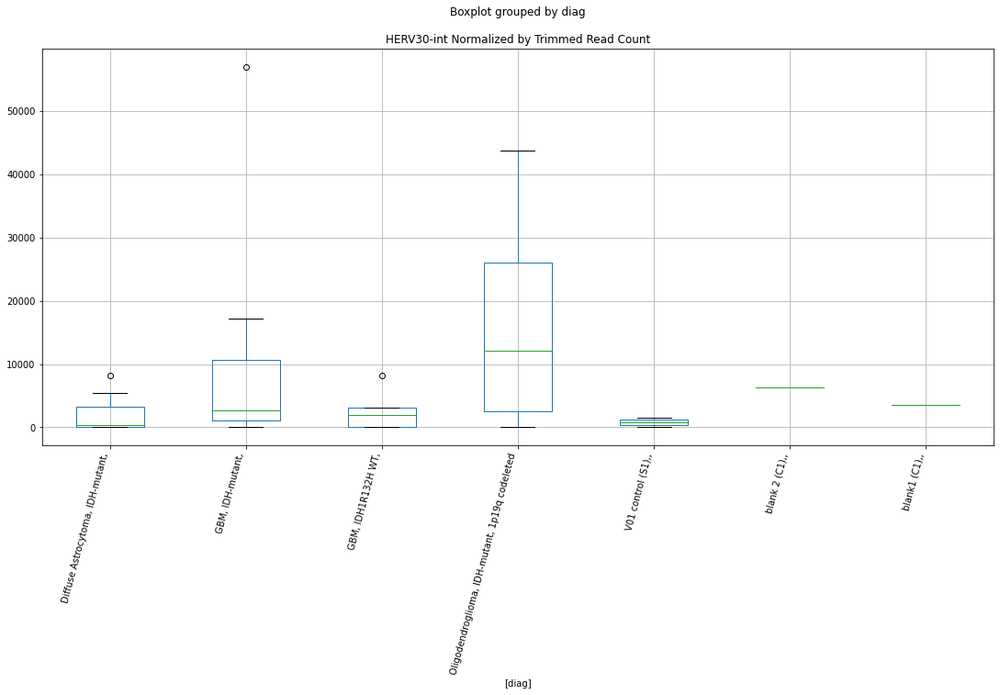

 p : 0.014773270834286572  ( t : 2.6961072593337914 ) :  D-plex  :  cutadapt2  :  Kanga1b
Control and blanks
76       0.00
340    880.73
Name: Kanga1b, dtype: float64
208    5467.17
Name: Kanga1b, dtype: float64
472    7513.43
Name: Kanga1b, dtype: float64


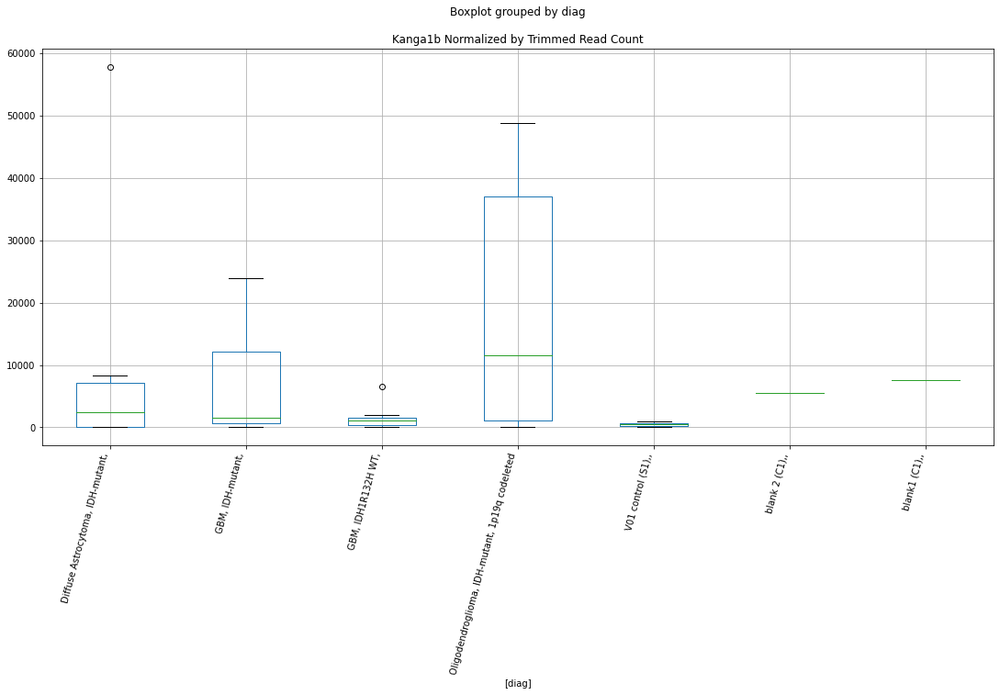

 p : 0.014823310991470667  ( t : 2.6945143068294106 ) :  D-plex  :  bbduk2  :  MER135
Control and blanks
73     0.0
337    0.0
Name: MER135, dtype: float64
205    3402.73
Name: MER135, dtype: float64
469    3549.16
Name: MER135, dtype: float64


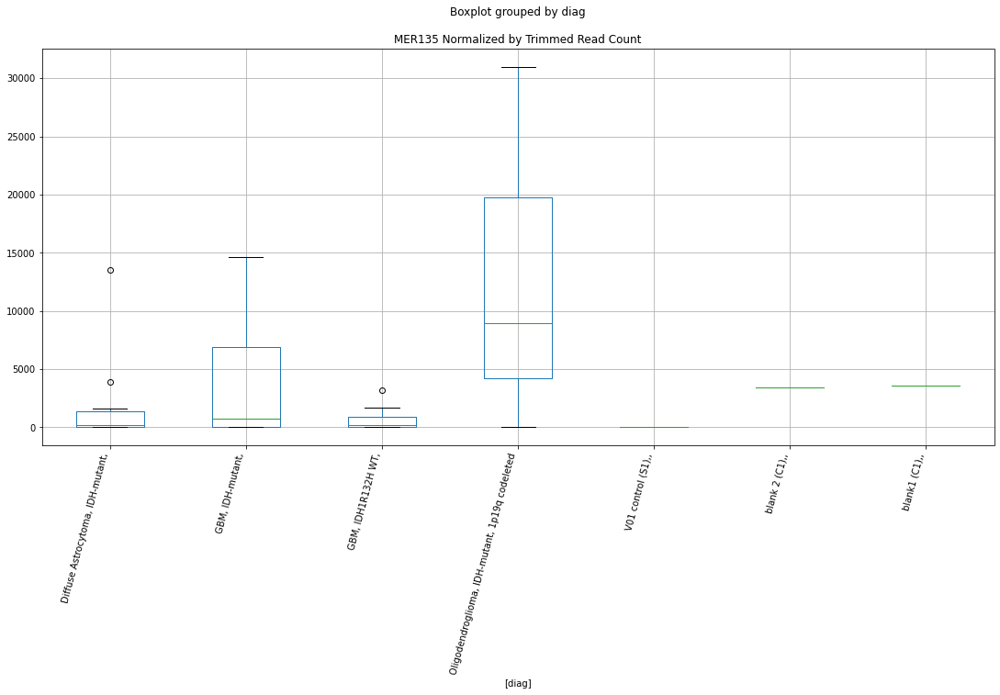

 p : 0.014858492785295677  ( t : 2.693397418853642 ) :  D-plex  :  bbduk2  :  MER84
Control and blanks
73     773.01
337      0.00
Name: MER84, dtype: float64
205    4298.18
Name: MER84, dtype: float64
469    4732.22
Name: MER84, dtype: float64


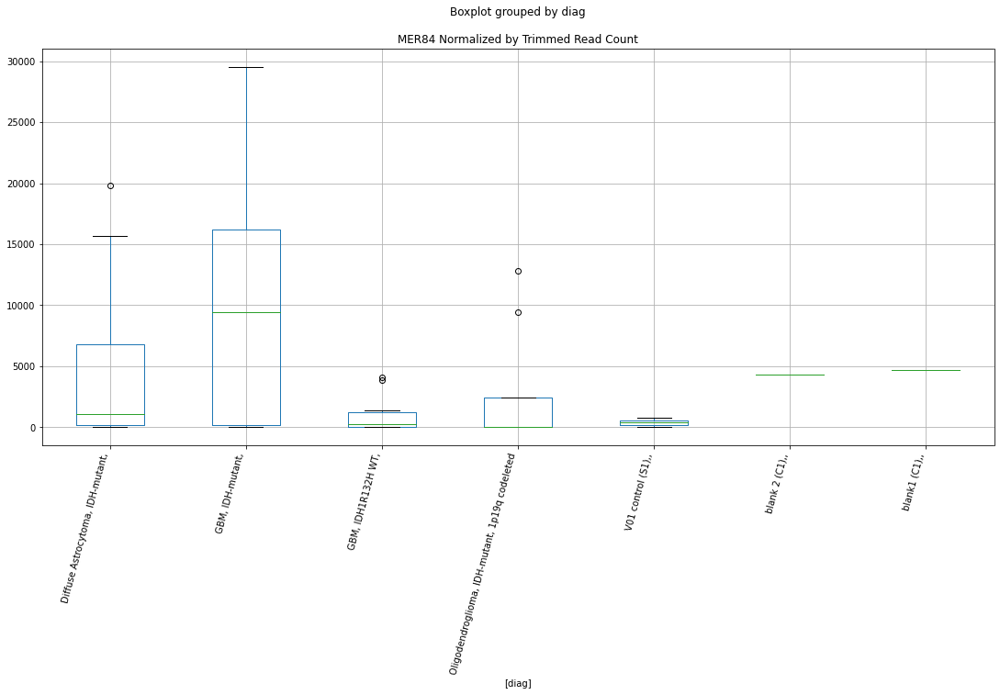

 p : 0.014882827469084915  ( t : 2.692626361568129 ) :  D-plex  :  bbduk2  :  (ATATATT)n
Control and blanks
73     0.0
337    0.0
Name: (ATATATT)n, dtype: float64
205    179.09
Name: (ATATATT)n, dtype: float64
469    591.53
Name: (ATATATT)n, dtype: float64


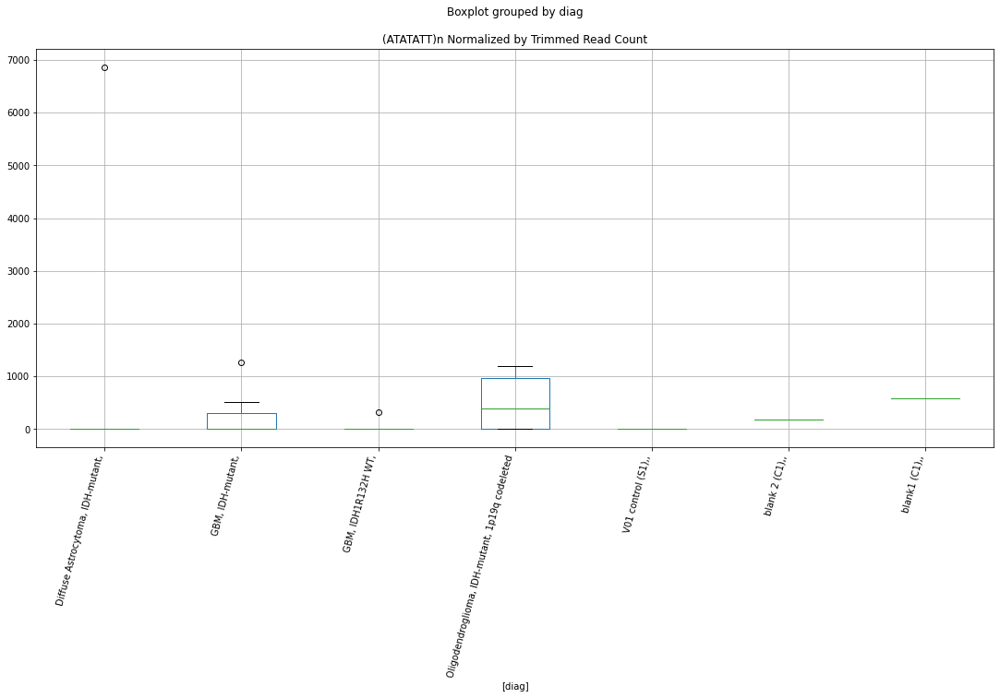

 p : 0.0149537809665018  ( t : 2.6903850142224073 ) :  D-plex  :  bbduk2  :  (CTAT)n
Control and blanks
73      5411.06
337    14242.52
Name: (CTAT)n, dtype: float64
205    12715.46
Name: (CTAT)n, dtype: float64
469    10647.49
Name: (CTAT)n, dtype: float64


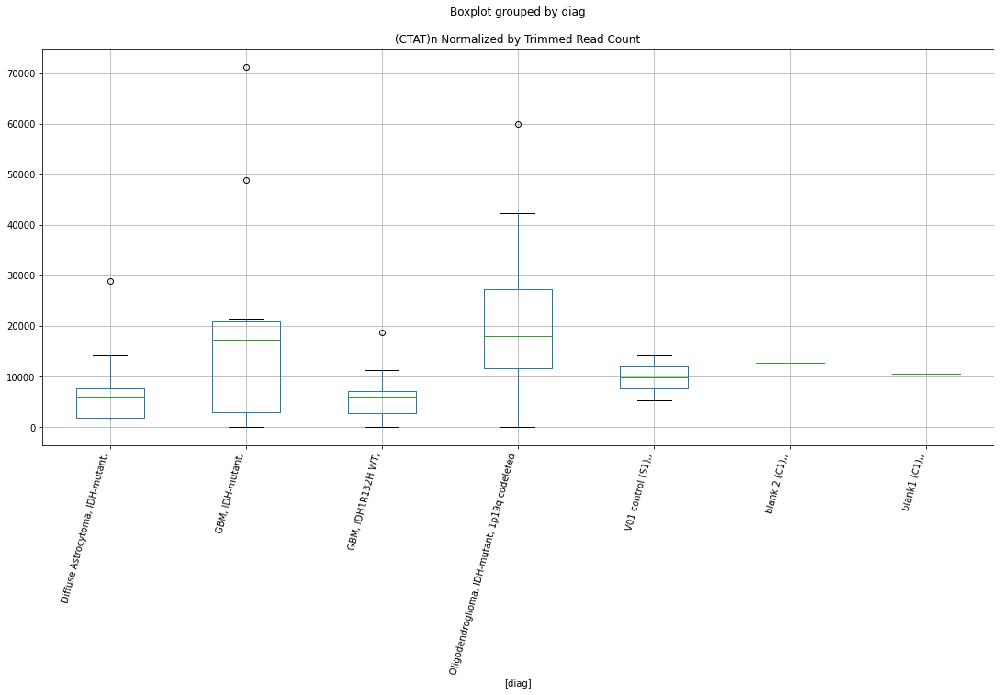

 p : 0.015112861447426289  ( t : 2.685396496949248 ) :  D-plex  :  bbduk2  :  MER49
Control and blanks
73     27828.30
337      890.16
Name: MER49, dtype: float64
205    27400.92
Name: MER49, dtype: float64
469    21886.51
Name: MER49, dtype: float64


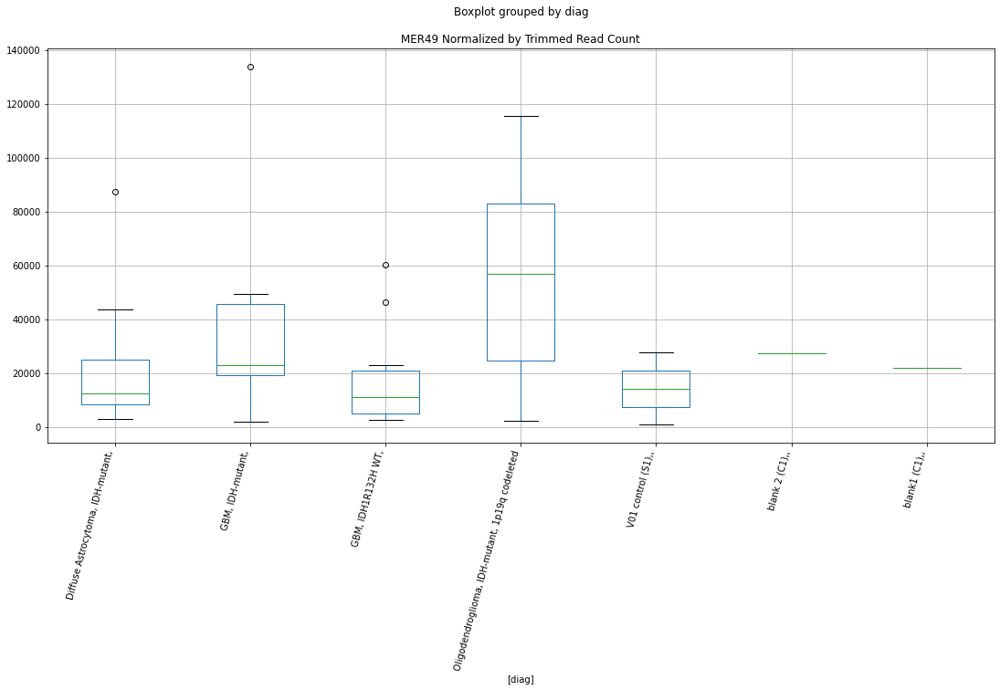

 p : 0.01511331694178804  ( t : 2.685382285435062 ) :  D-plex  :  bbduk2  :  MER101B
Control and blanks
73     0.0
337    0.0
Name: MER101B, dtype: float64
205    2686.36
Name: MER101B, dtype: float64
469    2366.11
Name: MER101B, dtype: float64


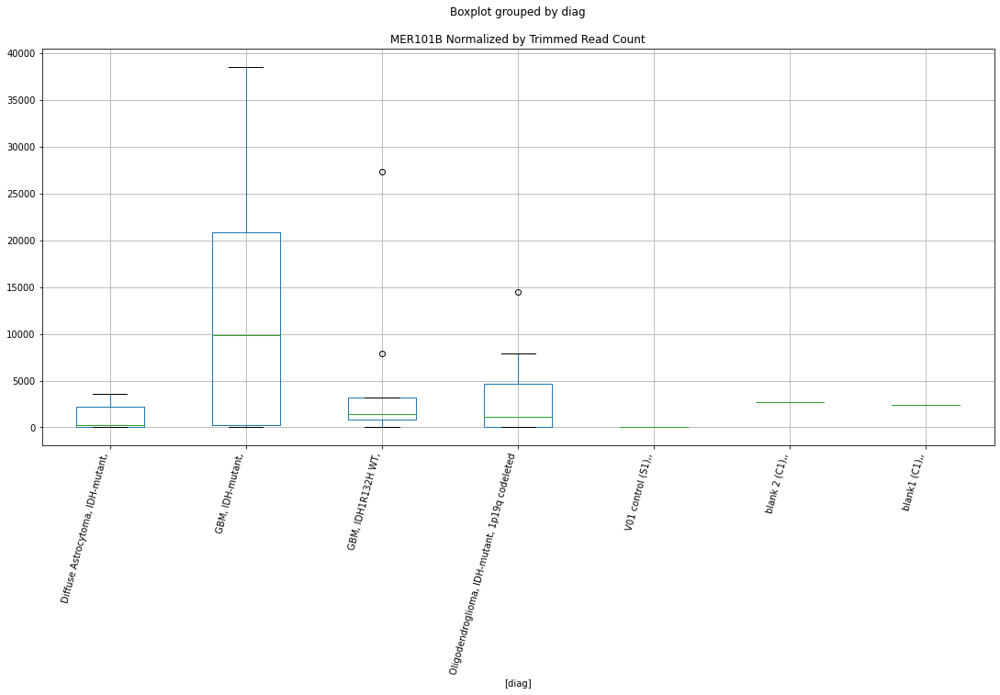

 p : 0.015118658197165477  ( t : 2.6852156677017933 ) :  D-plex  :  bbduk2  :  Charlie30a
Control and blanks
73      773.01
337    3560.63
Name: Charlie30a, dtype: float64
205    6626.37
Name: Charlie30a, dtype: float64
469    4140.69
Name: Charlie30a, dtype: float64


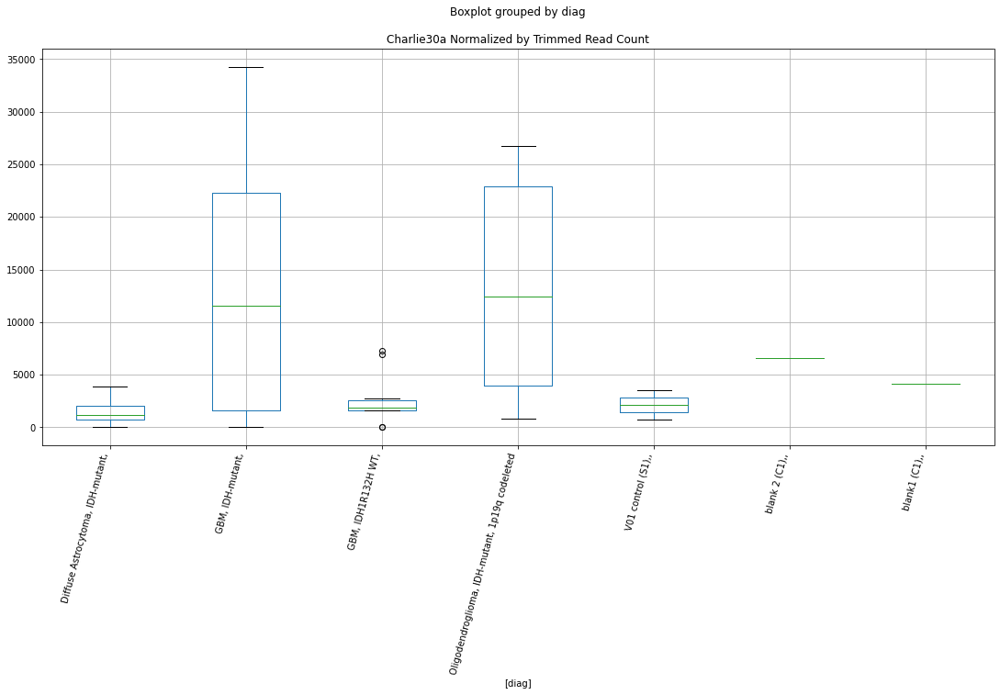

 p : 0.015237305753574367  ( t : 2.681528926624147 ) :  D-plex  :  bbduk2  :  MER77B
Control and blanks
73     14687.16
337    39166.92
Name: MER77B, dtype: float64
205    33131.83
Name: MER77B, dtype: float64
469    26618.73
Name: MER77B, dtype: float64


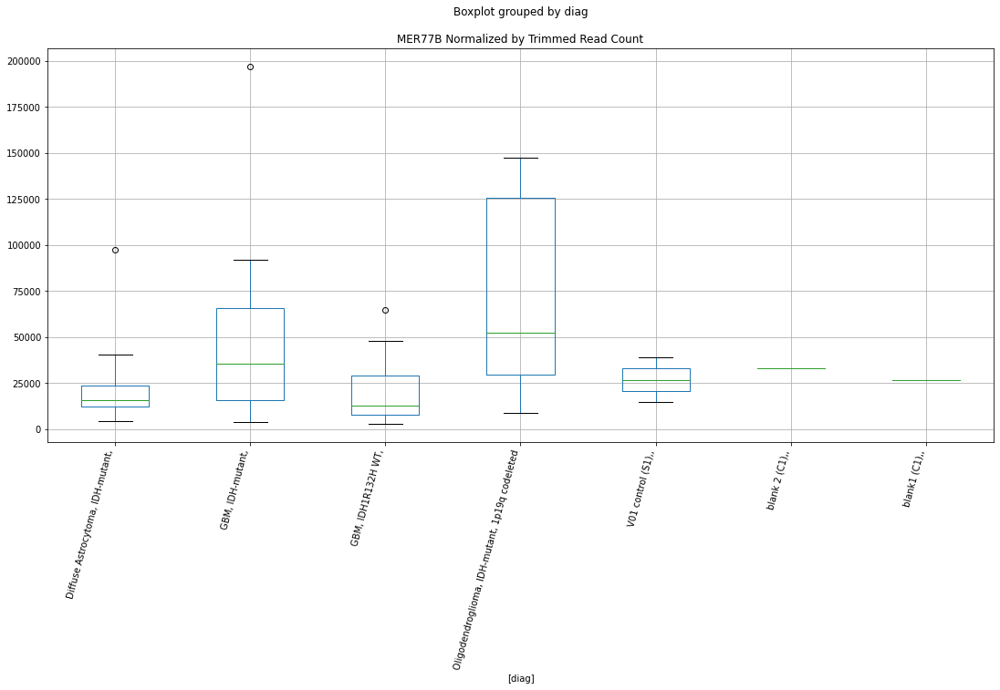

 p : 0.015370274032790428  ( t : 2.6774296033334717 ) :  D-plex  :  bbduk2  :  (GTG)n
Control and blanks
73     0.0
337    0.0
Name: (GTG)n, dtype: float64
205    3760.91
Name: (GTG)n, dtype: float64
469    2957.64
Name: (GTG)n, dtype: float64


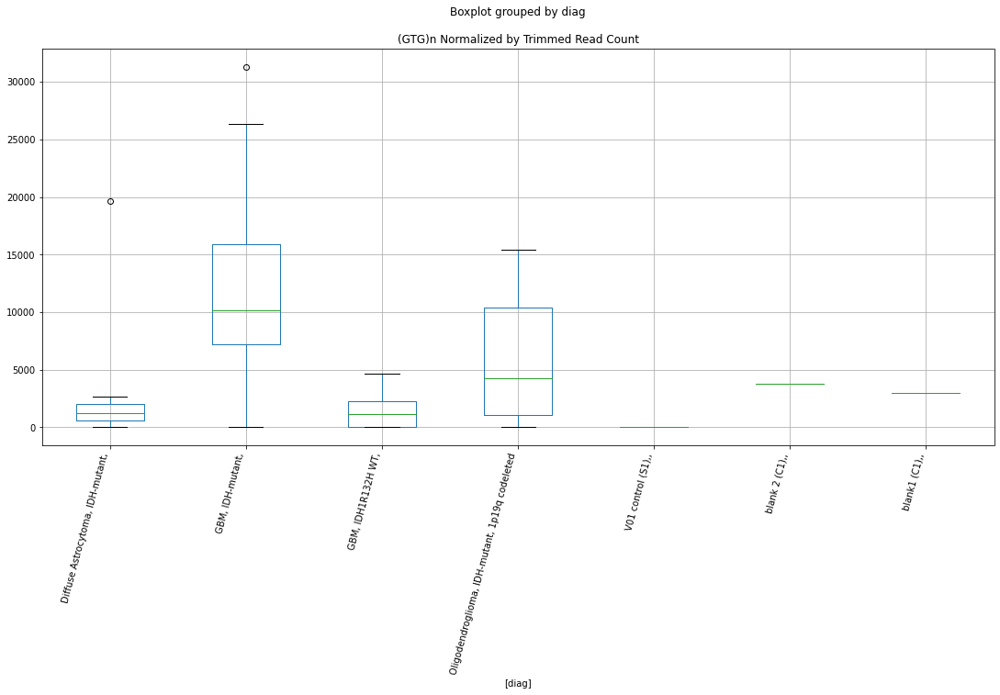

 p : 0.015412807122019232  ( t : 2.676125475295587 ) :  Lexogen  :  bbduk2  :  L1PA2
Control and blanks
79     1430.6
343       0.0
Name: L1PA2, dtype: float64
211    0.0
Name: L1PA2, dtype: float64
475    239.52
Name: L1PA2, dtype: float64


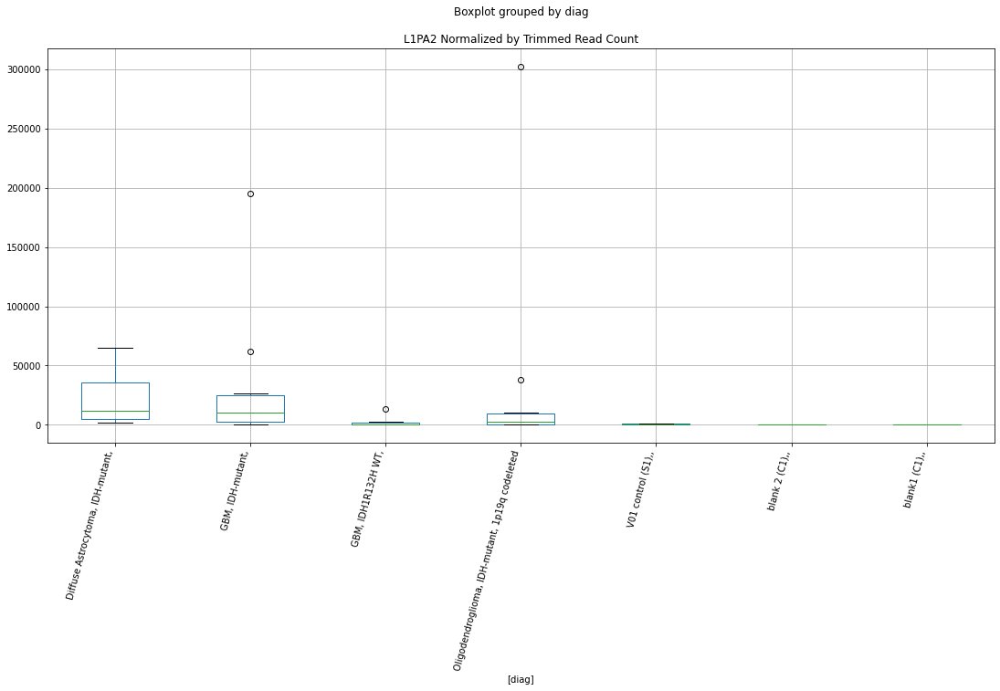

 p : 0.015470376282514634  ( t : 2.6743657750431575 ) :  D-plex  :  cutadapt2  :  HUERS-P3-int
Control and blanks
76      6060.91
340    70458.57
Name: HUERS-P3-int, dtype: float64
208    33332.08
Name: HUERS-P3-int, dtype: float64
472    244475.32
Name: HUERS-P3-int, dtype: float64


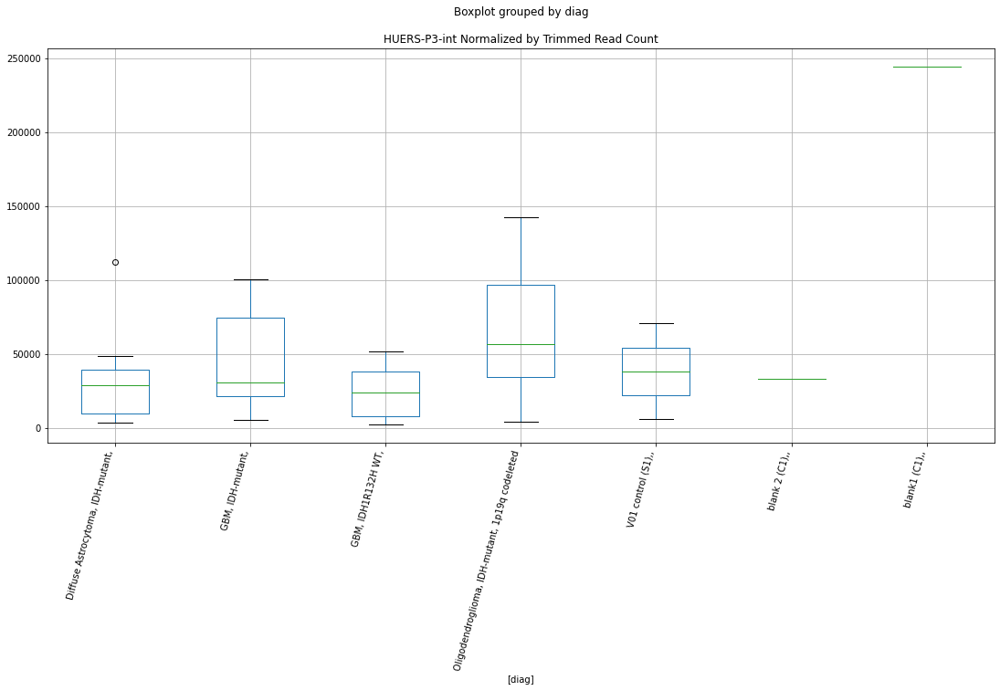

 p : 0.015532753526555977  ( t : 2.672466142220503 ) :  D-plex  :  bbduk2  :  (TCCCTC)n
Control and blanks
73     13914.15
337     7121.26
Name: (TCCCTC)n, dtype: float64
205    3044.55
Name: (TCCCTC)n, dtype: float64
469    7689.86
Name: (TCCCTC)n, dtype: float64


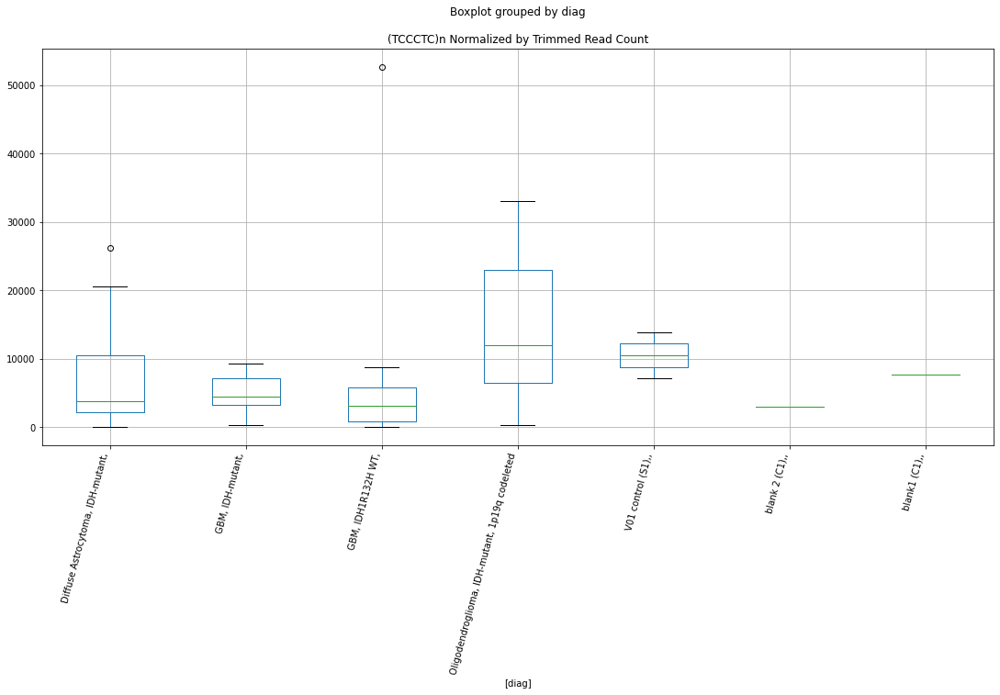

 p : 0.015533468295783595  ( t : 2.6724444168646486 ) :  D-plex  :  cutadapt2  :  MER85
Control and blanks
76      2272.84
340    29064.16
Name: MER85, dtype: float64
208    7759.85
Name: MER85, dtype: float64
472    8669.34
Name: MER85, dtype: float64


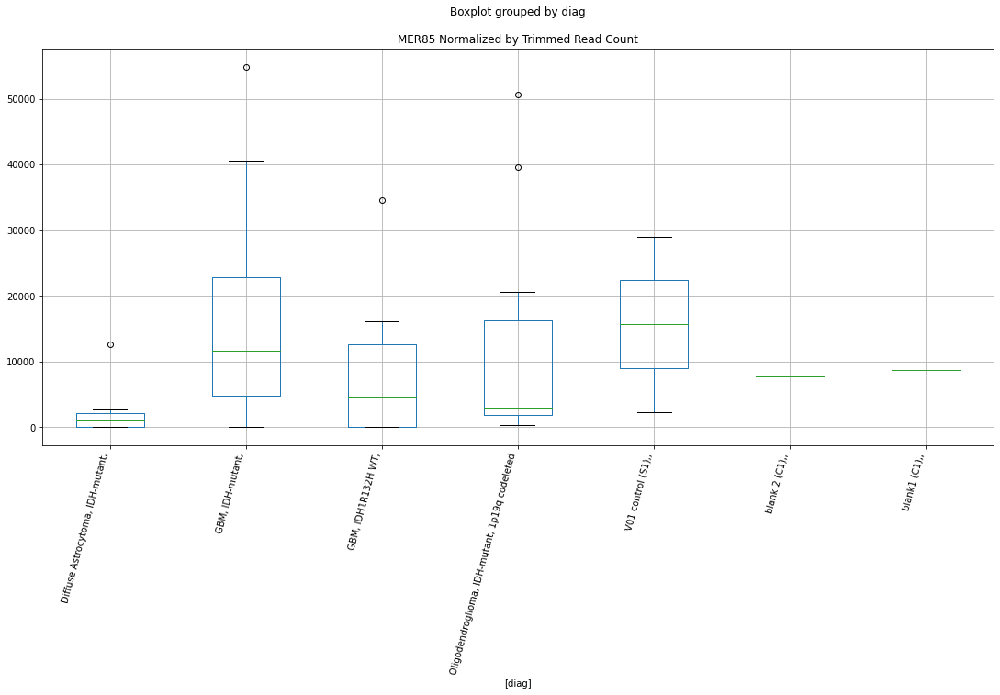

 p : 0.015699356524184114  ( t : 2.6674278589605667 ) :  D-plex  :  cutadapt2  :  LTR88b
Control and blanks
76     3788.07
340    1761.46
Name: LTR88b, dtype: float64
208    19575.98
Name: LTR88b, dtype: float64
472    12715.03
Name: LTR88b, dtype: float64


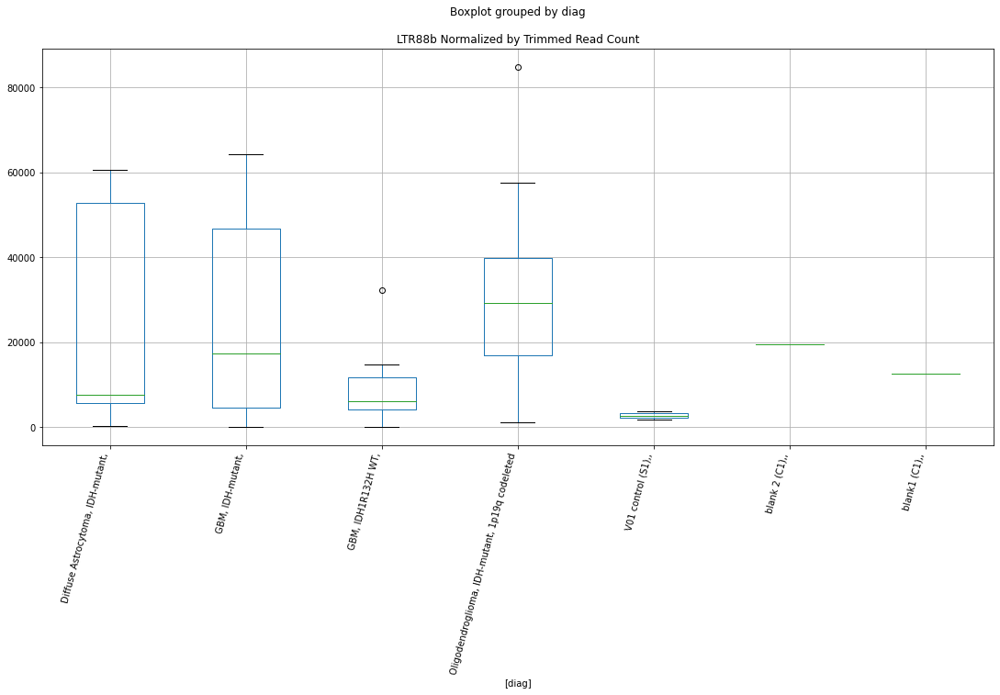

 p : 0.01574005257570637  ( t : 2.6662049063854334 ) :  D-plex  :  bbduk2  :  LTR90B
Control and blanks
73     0.0
337    0.0
Name: LTR90B, dtype: float64
205    5372.73
Name: LTR90B, dtype: float64
469    3549.16
Name: LTR90B, dtype: float64


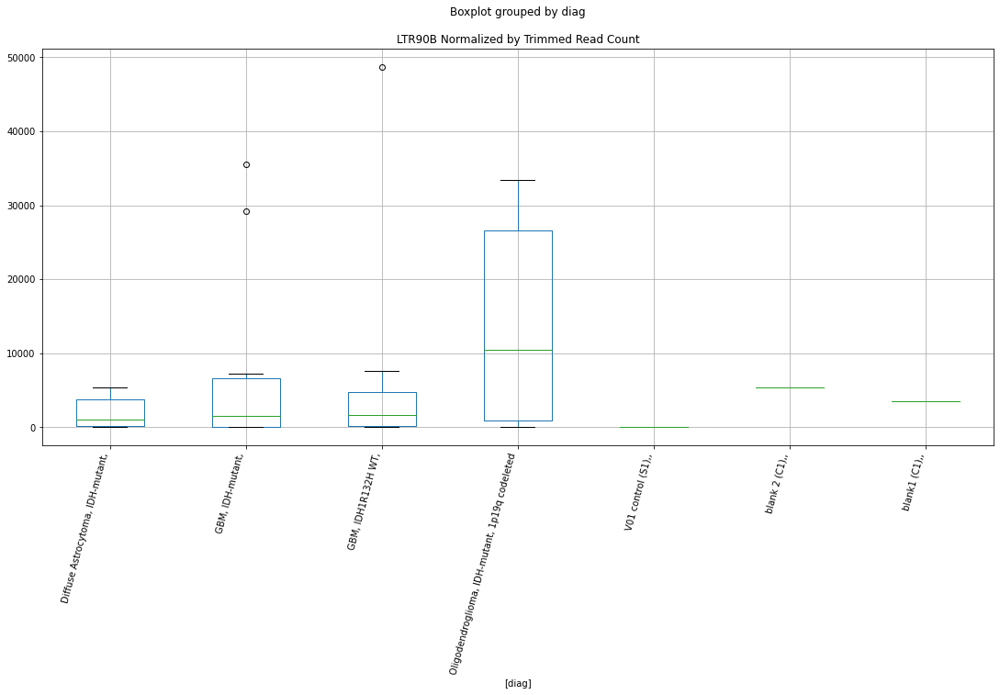

 p : 0.015885939967684642  ( t : 2.6618454878578968 ) :  D-plex  :  bbduk2  :  (CCCCCT)n
Control and blanks
73     0.0
337    0.0
Name: (CCCCCT)n, dtype: float64
205    1432.73
Name: (CCCCCT)n, dtype: float64
469    591.53
Name: (CCCCCT)n, dtype: float64


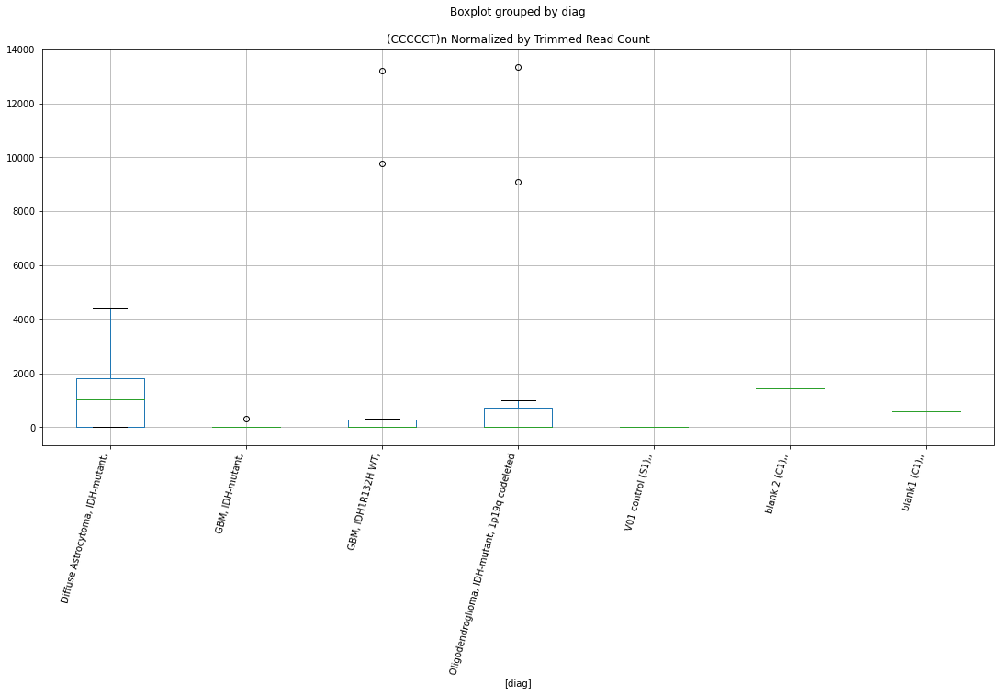

 p : 0.01597488829959357  ( t : 2.6592062093044233 ) :  D-plex  :  cutadapt2  :  MER77B
Control and blanks
76     31819.80
340    39632.95
Name: MER77B, dtype: float64
208    34919.32
Name: MER77B, dtype: float64
472    26008.01
Name: MER77B, dtype: float64


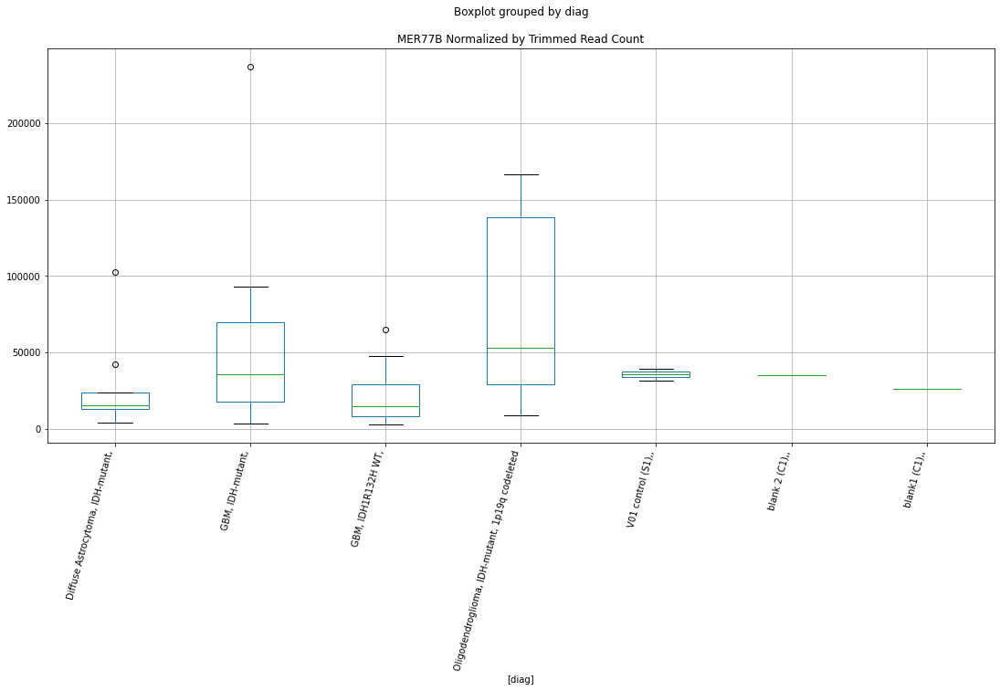

 p : 0.016171653895420867  ( t : 2.653417163298727 ) :  D-plex  :  bbduk2  :  (TCGAATGGAATCA)n
Control and blanks
73     773.01
337      0.00
Name: (TCGAATGGAATCA)n, dtype: float64
205    0.0
Name: (TCGAATGGAATCA)n, dtype: float64
469    0.0
Name: (TCGAATGGAATCA)n, dtype: float64


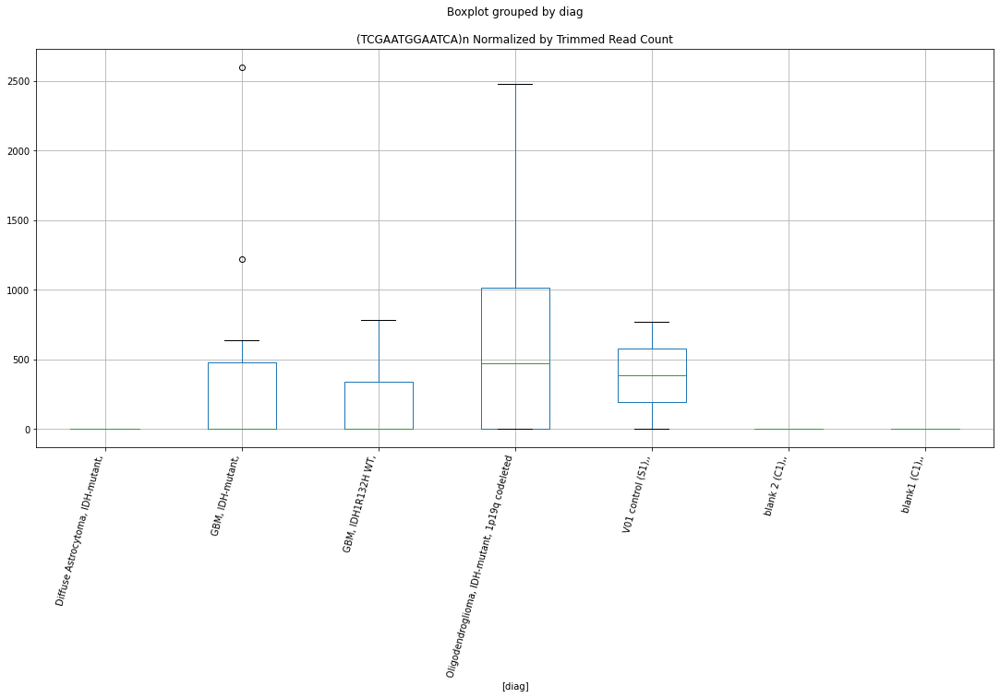

 p : 0.01620428135483005  ( t : 2.6524637197839644 ) :  D-plex  :  bbduk2  :  LTR81B
Control and blanks
73      4638.05
337    54299.59
Name: LTR81B, dtype: float64
205    17371.82
Name: LTR81B, dtype: float64
469    17154.29
Name: LTR81B, dtype: float64


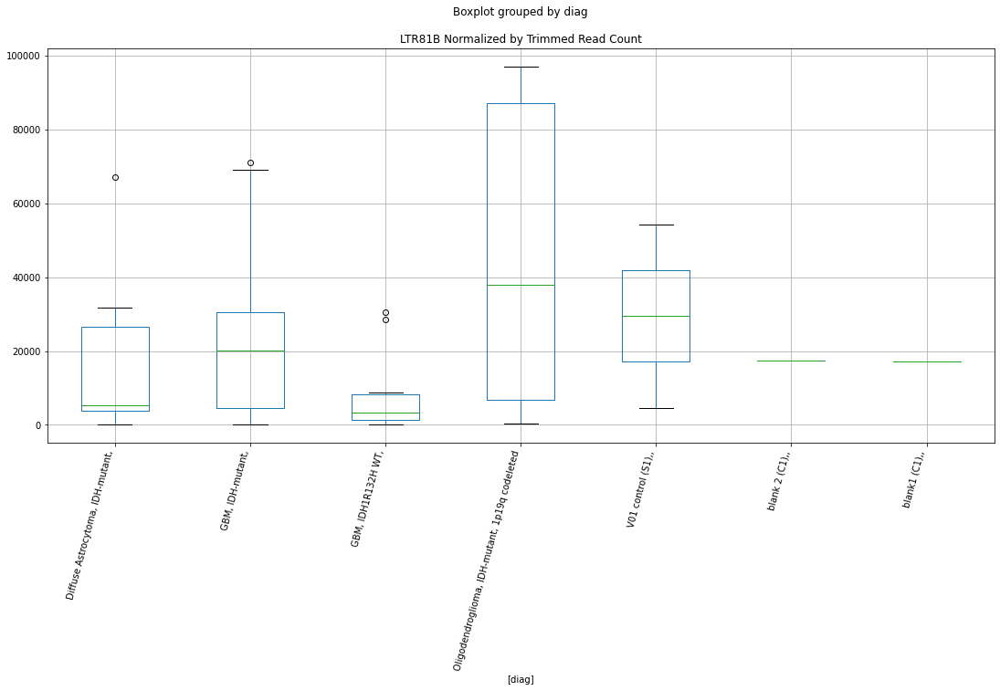

 p : 0.01621553056732302  ( t : 2.652135417733447 ) :  D-plex  :  bbduk2  :  Ricksha_b
Control and blanks
73       0.00
337    890.16
Name: Ricksha_b, dtype: float64
205    2149.09
Name: Ricksha_b, dtype: float64
469    2957.64
Name: Ricksha_b, dtype: float64


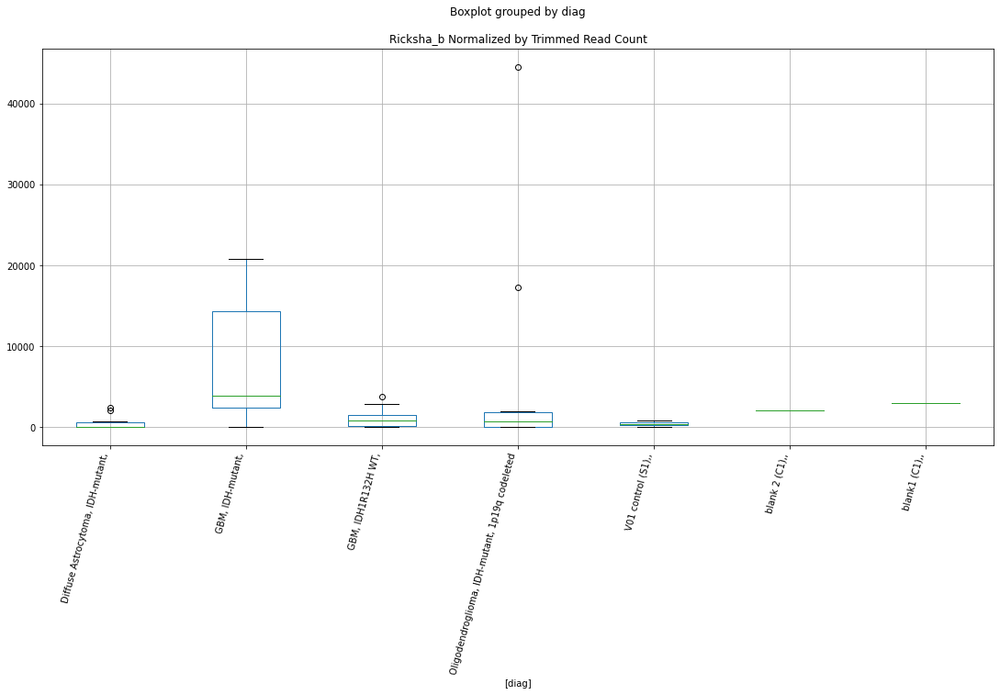

 p : 0.0163959636137805  ( t : 2.646899004625241 ) :  D-plex  :  cutadapt2  :  Tigger9b
Control and blanks
76     2272.84
340    5284.39
Name: Tigger9b, dtype: float64
208    8112.57
Name: Tigger9b, dtype: float64
472    13870.94
Name: Tigger9b, dtype: float64


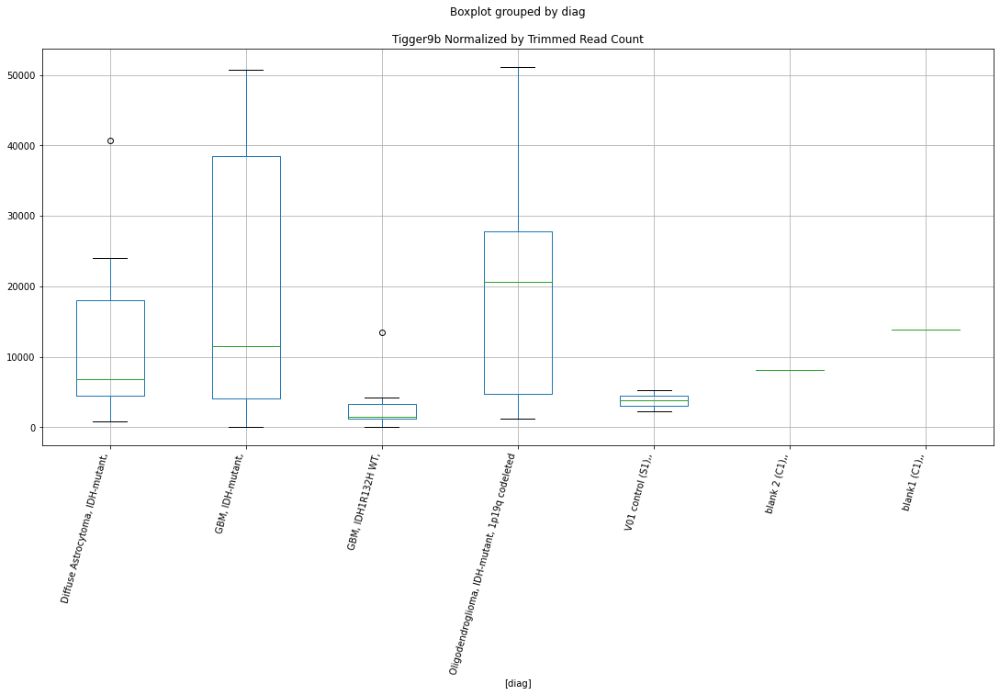

 p : 0.016437283455938045  ( t : 2.6457075689460527 ) :  D-plex  :  cutadapt2  :  (AAT)n
Control and blanks
76      2272.84
340    48440.27
Name: (AAT)n, dtype: float64
208    9523.45
Name: (AAT)n, dtype: float64
472    11559.12
Name: (AAT)n, dtype: float64


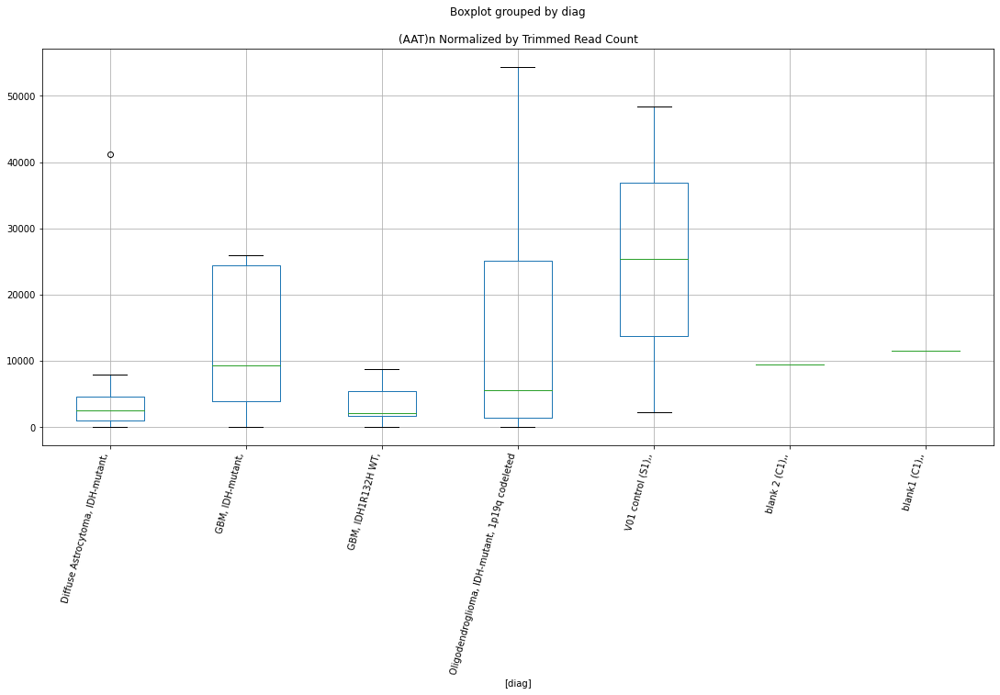

 p : 0.01654373900144321  ( t : 2.642651064224576 ) :  D-plex  :  cutadapt2  :  (TTATA)n
Control and blanks
76     0.0
340    0.0
Name: (TTATA)n, dtype: float64
208    1234.52
Name: (TTATA)n, dtype: float64
472    1155.91
Name: (TTATA)n, dtype: float64


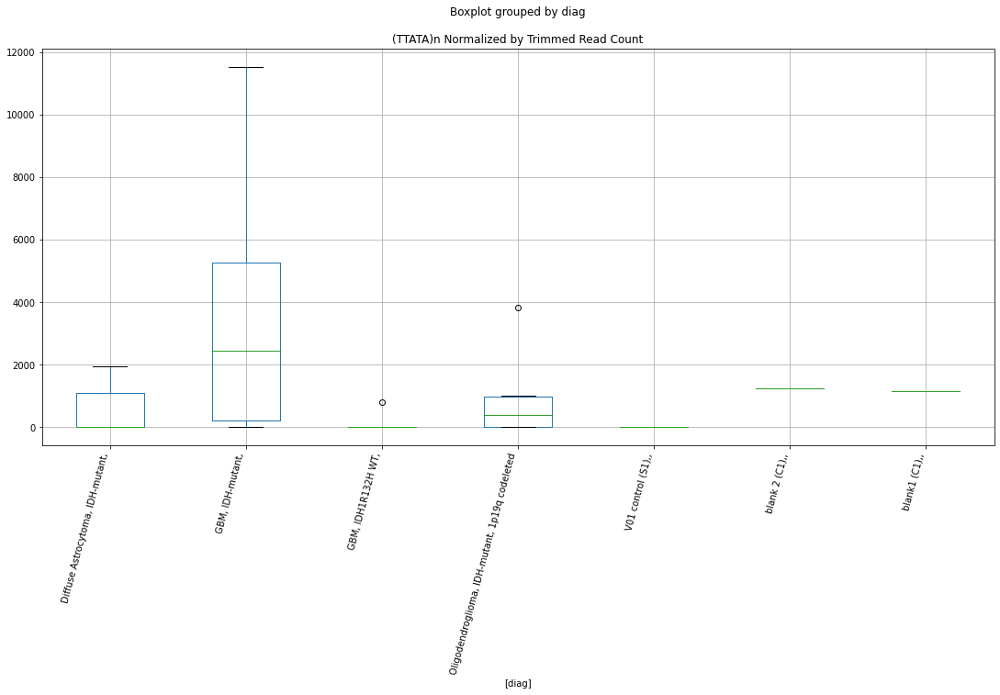

 p : 0.016552540785736175  ( t : 2.642399189752736 ) :  D-plex  :  bbduk2  :  LTR2B
Control and blanks
73     0.0
337    0.0
Name: LTR2B, dtype: float64
205    4477.27
Name: LTR2B, dtype: float64
469    6506.8
Name: LTR2B, dtype: float64


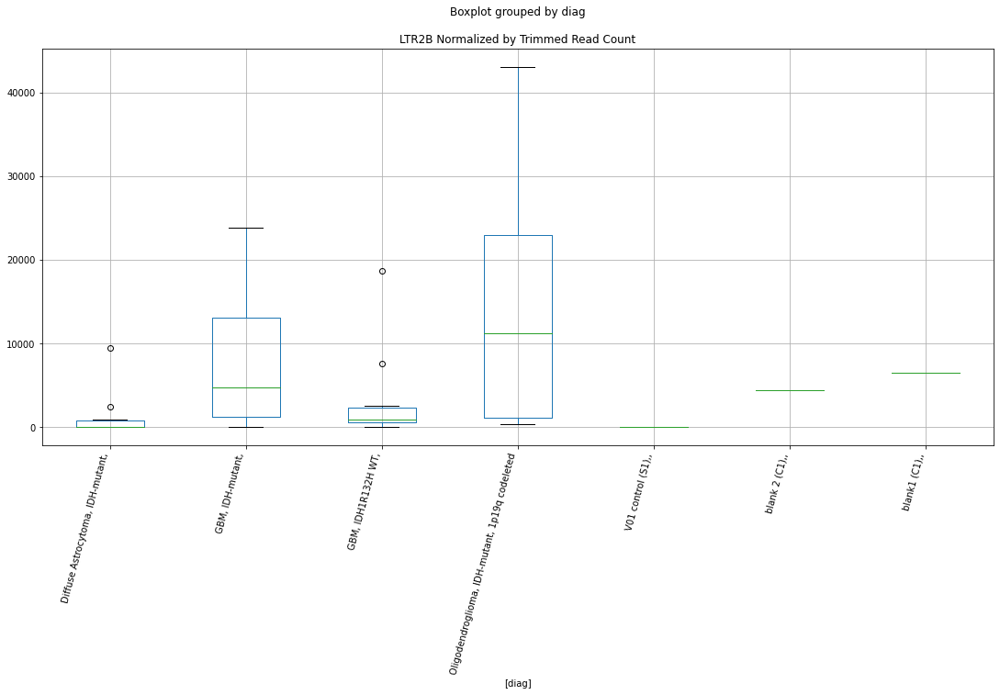

 p : 0.016679080853258806  ( t : 2.63879210081061 ) :  D-plex  :  cutadapt2  :  PABL_A-int
Control and blanks
76     30304.57
340     6165.12
Name: PABL_A-int, dtype: float64
208    14108.82
Name: PABL_A-int, dtype: float64
472    12137.07
Name: PABL_A-int, dtype: float64


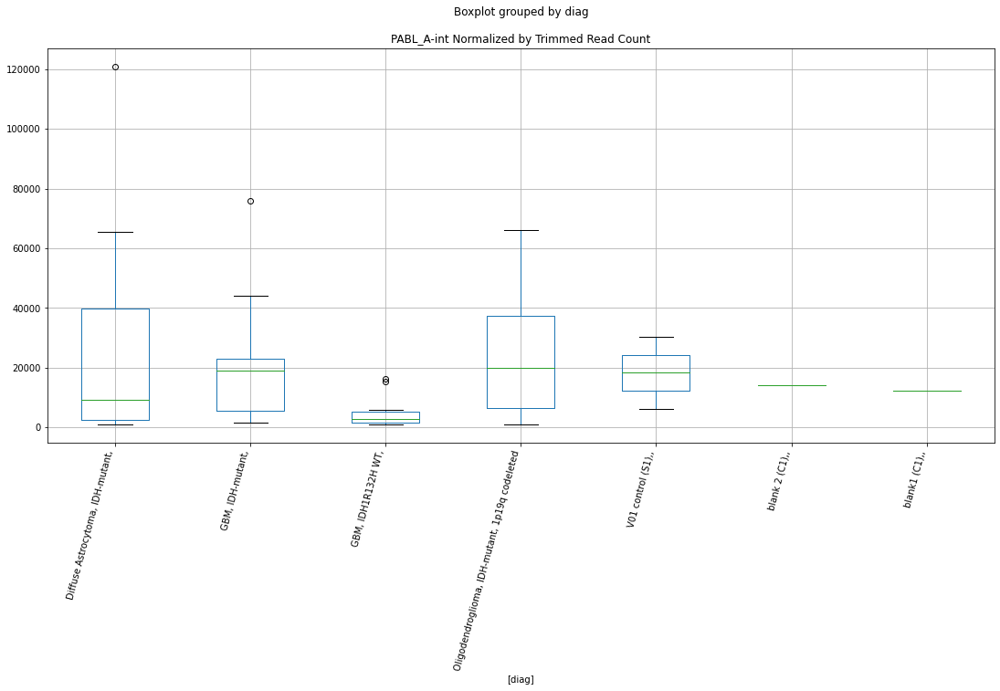

 p : 0.01671501005416346  ( t : 2.63777266665213 ) :  D-plex  :  bbduk2  :  MER34D
Control and blanks
73     34785.38
337      890.16
Name: MER34D, dtype: float64
205    5910.0
Name: MER34D, dtype: float64
469    4732.22
Name: MER34D, dtype: float64


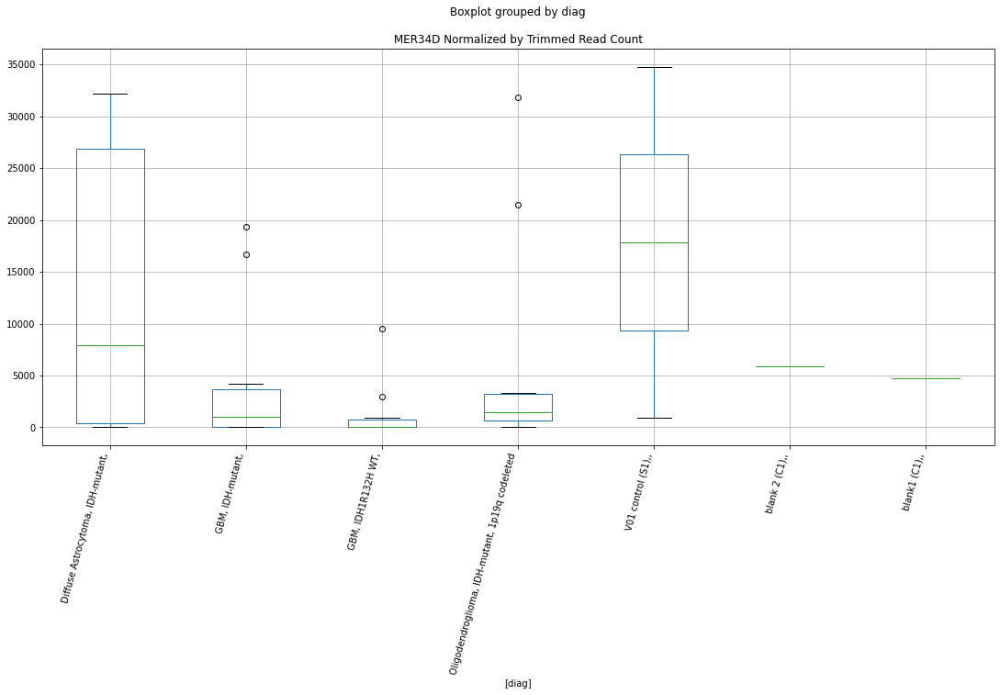

 p : 0.017025076986942153  ( t : 2.6290606234294946 ) :  D-plex  :  bbduk2  :  MER107
Control and blanks
73        0.00
337    8011.42
Name: MER107, dtype: float64
205    8775.46
Name: MER107, dtype: float64
469    10647.49
Name: MER107, dtype: float64


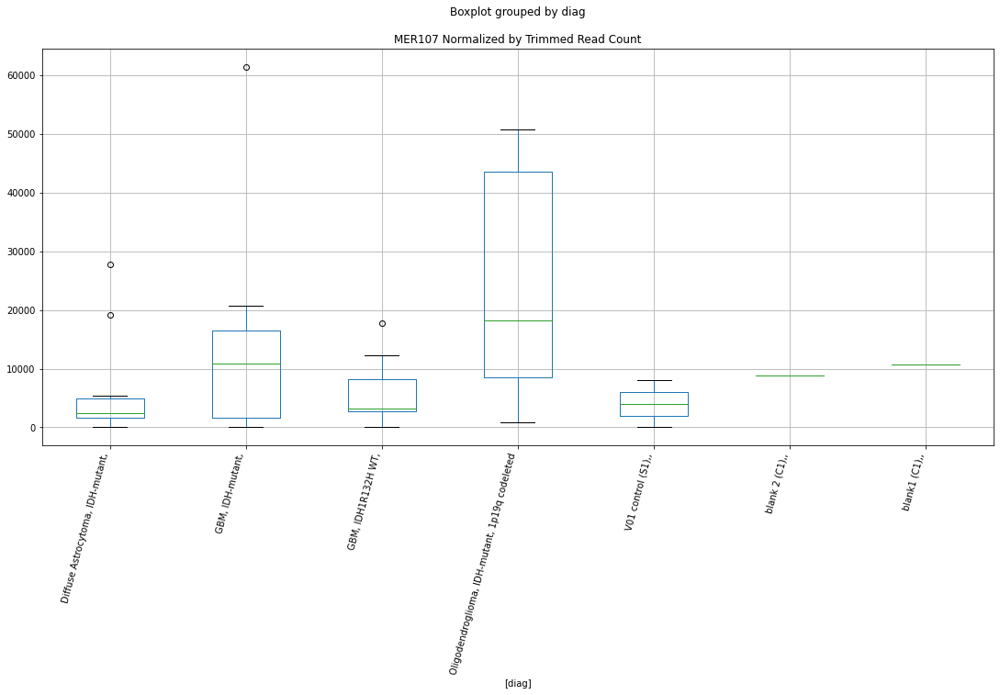

 p : 0.017230802814977263  ( t : 2.623363161647889 ) :  D-plex  :  bbduk2  :  MER85
Control and blanks
73      2319.03
337    28485.03
Name: MER85, dtype: float64
205    7163.64
Name: MER85, dtype: float64
469    7689.86
Name: MER85, dtype: float64


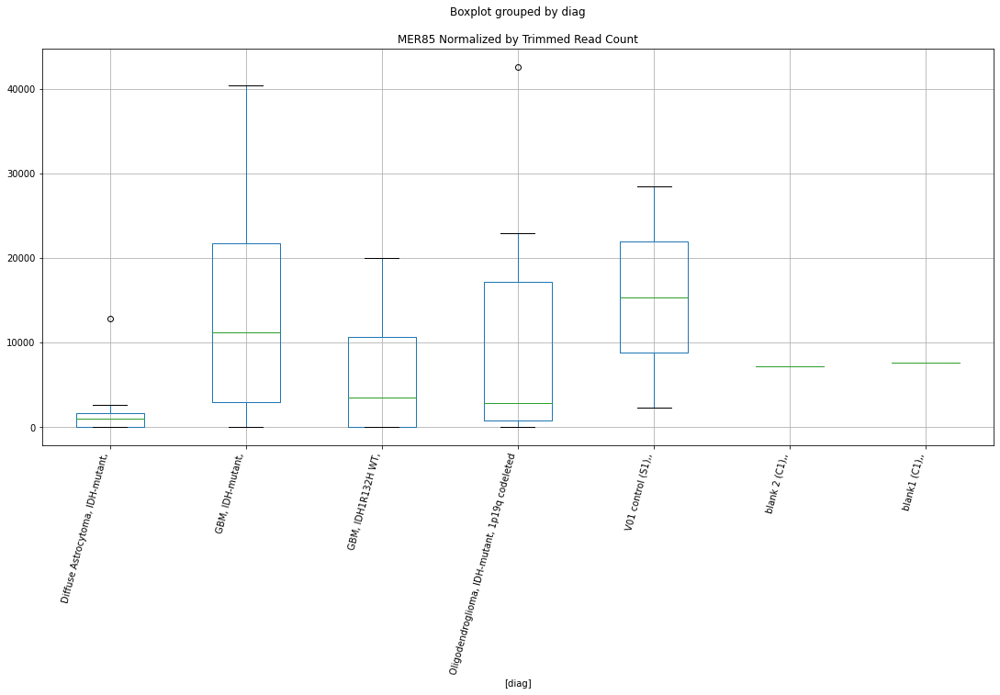

 p : 0.017266471237835968  ( t : 2.622381927063279 ) :  D-plex  :  bbduk2  :  HSMAR1
Control and blanks
73      1546.02
337    37386.61
Name: HSMAR1, dtype: float64
205    17730.0
Name: HSMAR1, dtype: float64
469    10647.49
Name: HSMAR1, dtype: float64


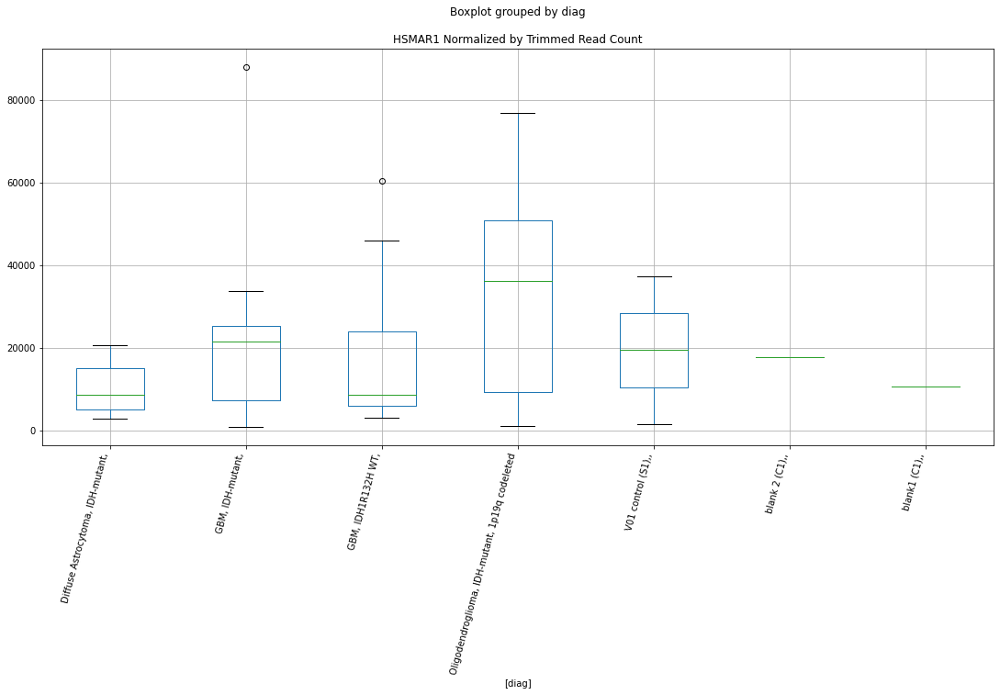

 p : 0.017617485473062404  ( t : 2.6128270084197065 ) :  D-plex  :  cutadapt2  :  (CTG)n
Control and blanks
76     757.61
340    880.73
Name: (CTG)n, dtype: float64
208    2469.04
Name: (CTG)n, dtype: float64
472    1733.87
Name: (CTG)n, dtype: float64


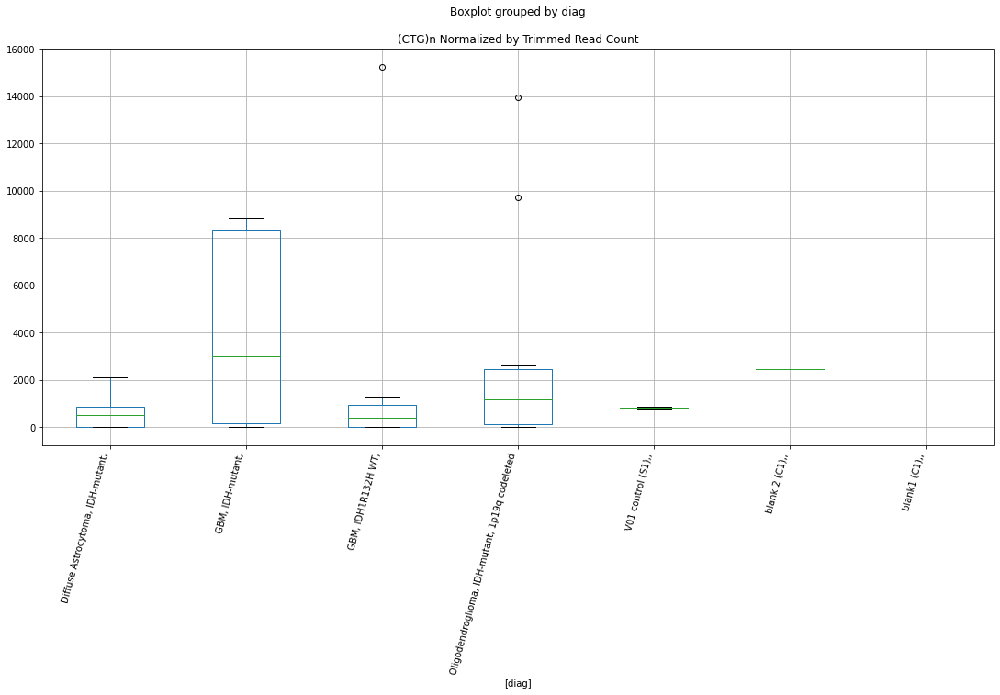

 p : 0.01774814205361015  ( t : 2.609316546746861 ) :  Lexogen  :  bbduk2  :  L1M5
Control and blanks
79     0.0
343    0.0
Name: L1M5, dtype: float64
211    273.31
Name: L1M5, dtype: float64
475    8143.54
Name: L1M5, dtype: float64


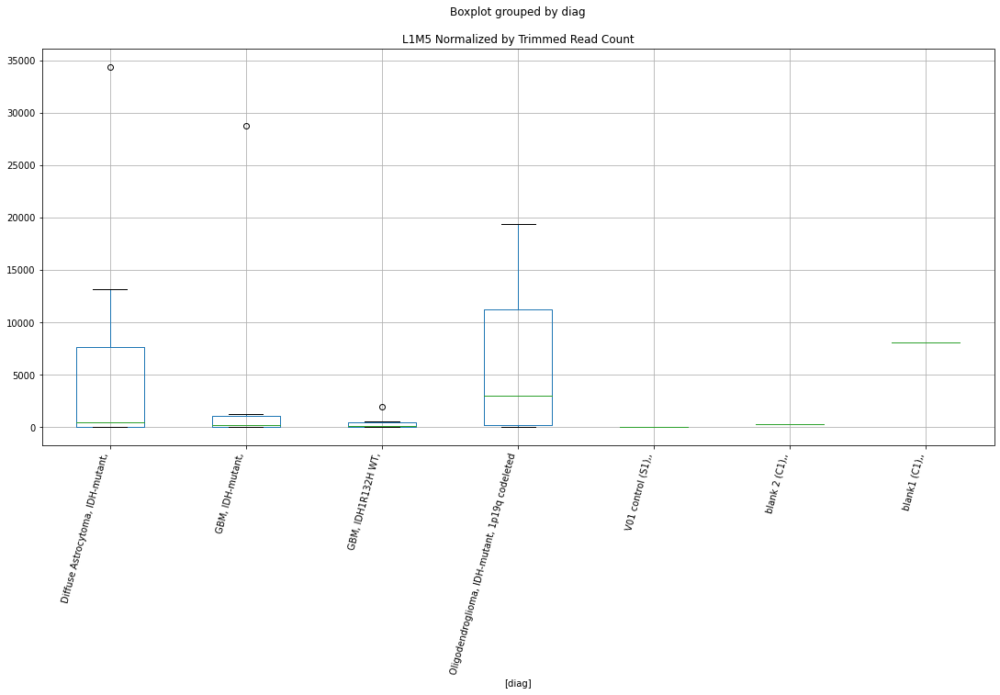

 p : 0.017815313065892794  ( t : 2.607521346446174 ) :  D-plex  :  bbduk2  :  (GTATT)n
Control and blanks
73        0.0
337    6231.1
Name: (GTATT)n, dtype: float64
205    537.27
Name: (GTATT)n, dtype: float64
469    0.0
Name: (GTATT)n, dtype: float64


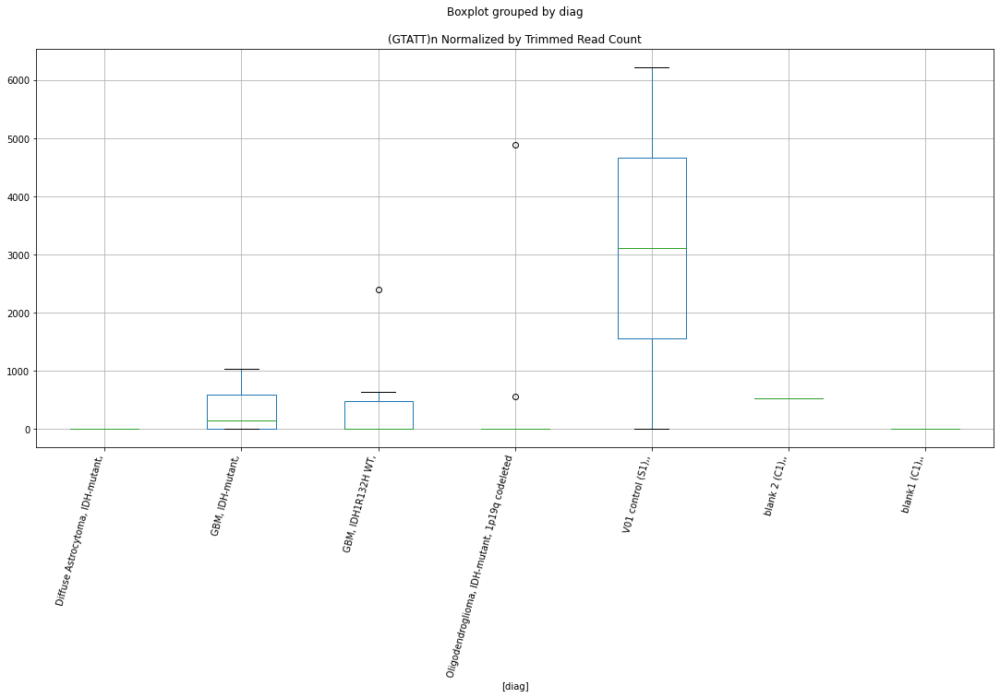

 p : 0.017874409409087865  ( t : 2.6059472547319165 ) :  D-plex  :  cutadapt2  :  LTR53B
Control and blanks
76     757.61
340      0.00
Name: LTR53B, dtype: float64
208    4232.65
Name: LTR53B, dtype: float64
472    1733.87
Name: LTR53B, dtype: float64


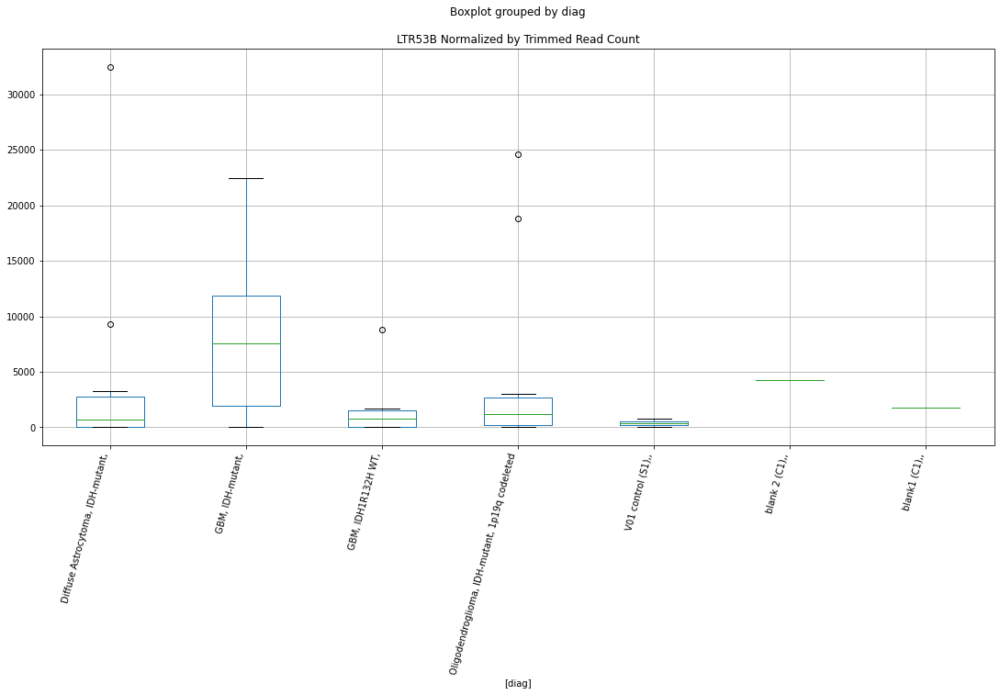

 p : 0.018150528062508983  ( t : 2.598657404889129 ) :  Lexogen  :  cutadapt2  :  L1PA2
Control and blanks
82     1420.05
346       0.00
Name: L1PA2, dtype: float64
214    0.0
Name: L1PA2, dtype: float64
478    237.46
Name: L1PA2, dtype: float64


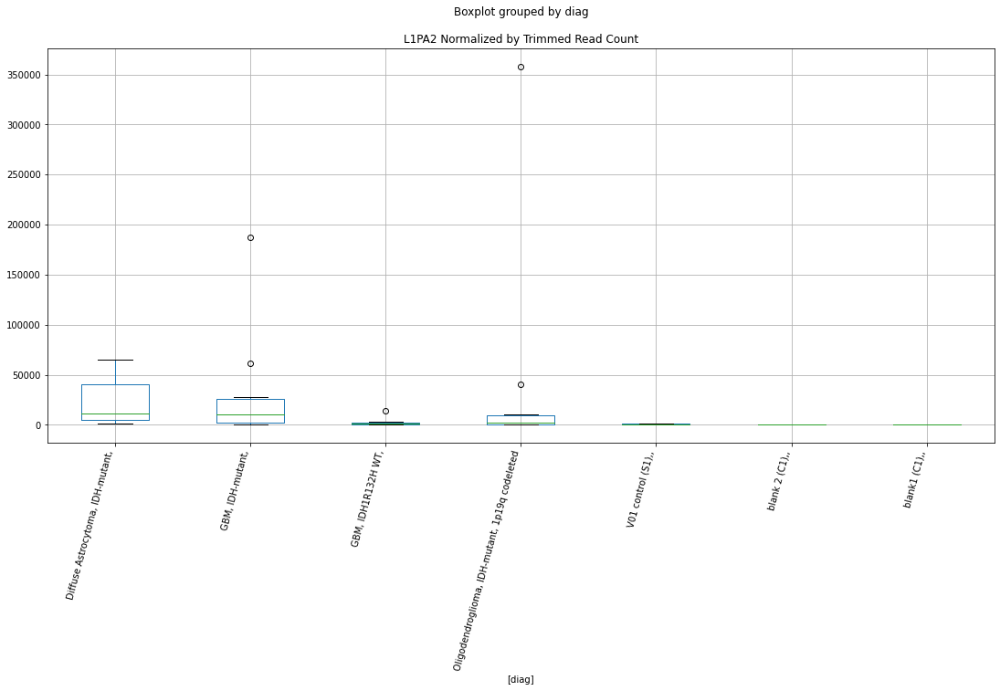

 p : 0.018311928437838812  ( t : 2.594444837345572 ) :  D-plex  :  bbduk2  :  LTR85c
Control and blanks
73     3092.03
337    5340.94
Name: LTR85c, dtype: float64
205    17909.1
Name: LTR85c, dtype: float64
469    14196.66
Name: LTR85c, dtype: float64


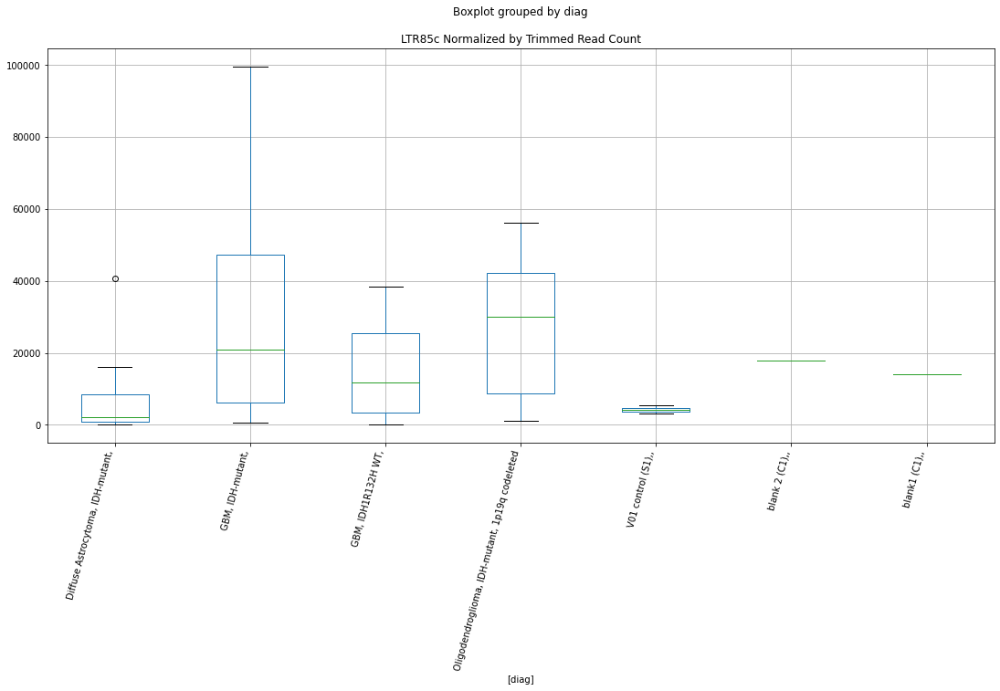

 p : 0.018352474116333863  ( t : 2.5933921273091514 ) :  D-plex  :  cutadapt2  :  (ATATGT)n
Control and blanks
76         0.00
340    18495.37
Name: (ATATGT)n, dtype: float64
208    3703.56
Name: (ATATGT)n, dtype: float64
472    577.96
Name: (ATATGT)n, dtype: float64


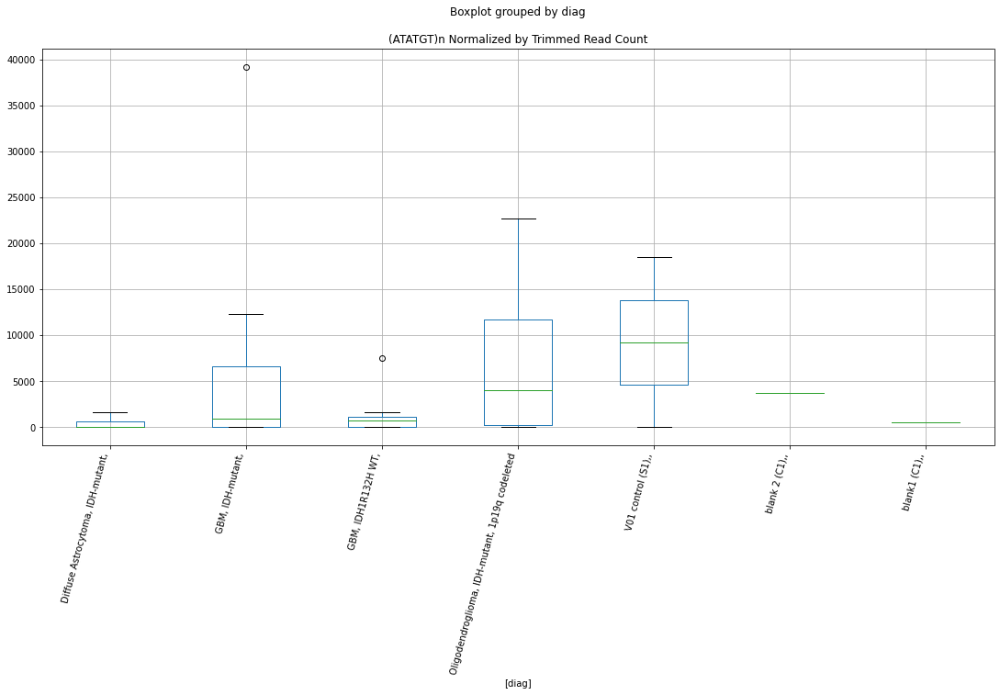

 p : 0.01845653206131646  ( t : 2.5907004759085135 ) :  D-plex  :  cutadapt2  :  (TTTTG)n
Control and blanks
76     3030.46
340    1761.46
Name: (TTTTG)n, dtype: float64
208    5467.17
Name: (TTTTG)n, dtype: float64
472    3467.74
Name: (TTTTG)n, dtype: float64


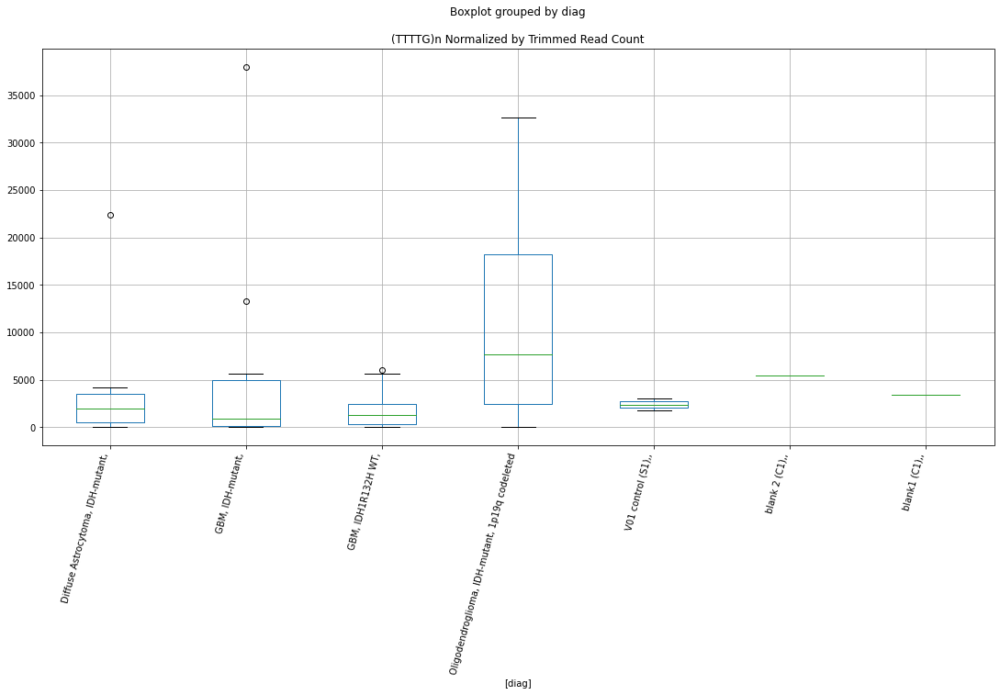

 p : 0.018517294756311878  ( t : 2.5891353847946403 ) :  D-plex  :  bbduk2  :  PABL_A-int
Control and blanks
73     30920.34
337     5340.94
Name: PABL_A-int, dtype: float64
205    14506.37
Name: PABL_A-int, dtype: float64
469    14196.66
Name: PABL_A-int, dtype: float64


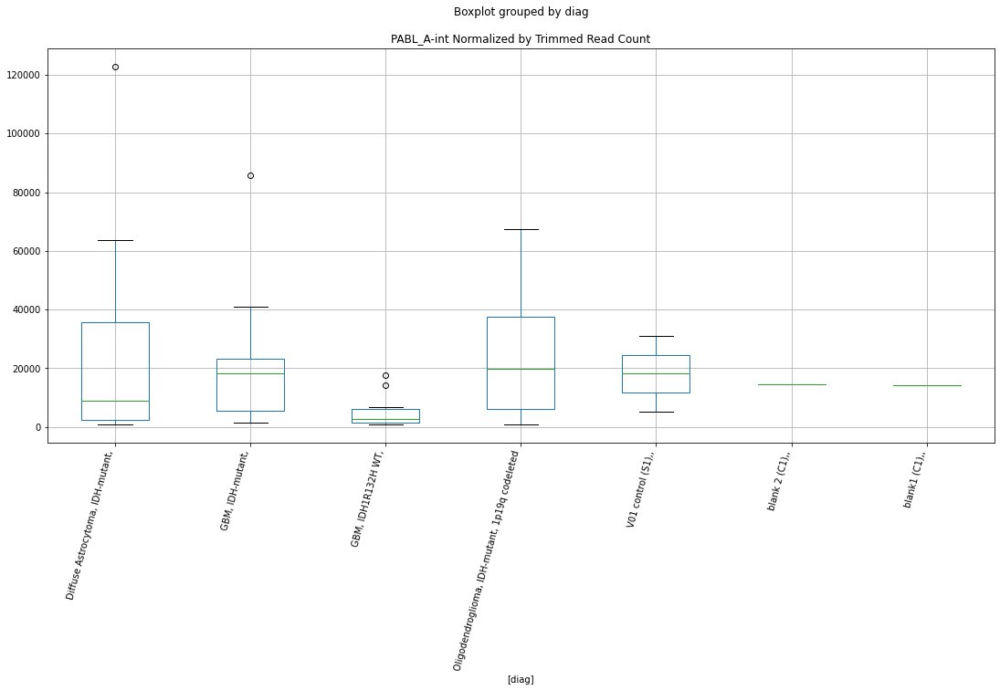

 p : 0.01853809237600994  ( t : 2.5886008100946123 ) :  D-plex  :  bbduk2  :  (GCT)n
Control and blanks
73     0.0
337    0.0
Name: (GCT)n, dtype: float64
205    1253.64
Name: (GCT)n, dtype: float64
469    1774.58
Name: (GCT)n, dtype: float64


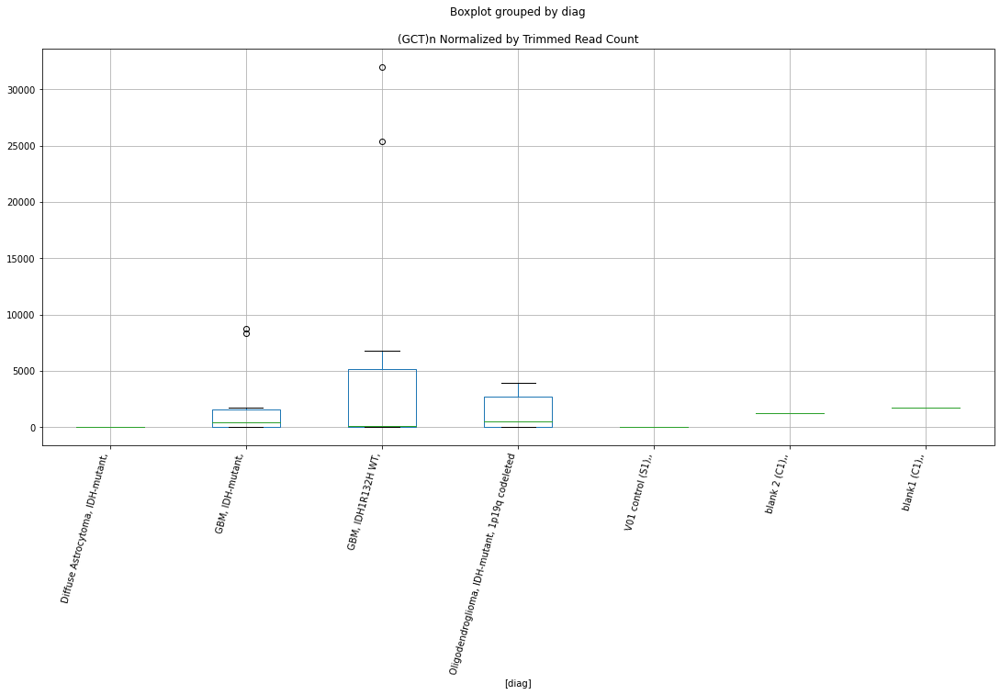

 p : 0.01865777723977291  ( t : 2.5855354812830895 ) :  D-plex  :  cutadapt2  :  LTR12_
Control and blanks
76      3030.46
340    11449.52
Name: LTR12_, dtype: float64
208    13050.66
Name: LTR12_, dtype: float64
472    8669.34
Name: LTR12_, dtype: float64


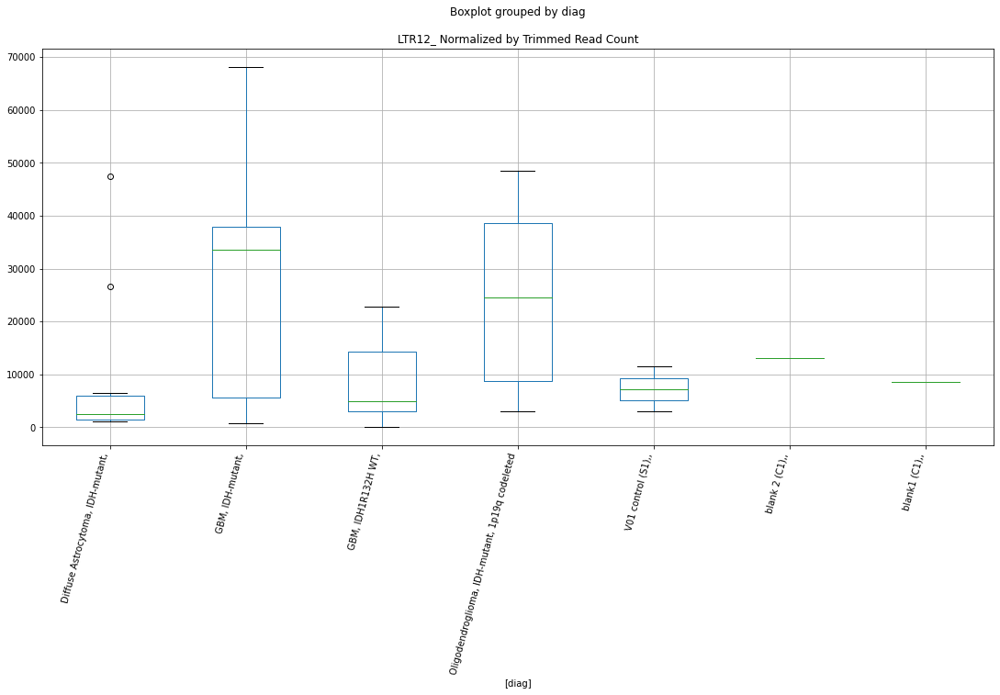

 p : 0.018847826306928973  ( t : 2.580706102014998 ) :  D-plex  :  bbduk2  :  LTR19B
Control and blanks
73     1546.02
337       0.00
Name: LTR19B, dtype: float64
205    8417.27
Name: LTR19B, dtype: float64
469    3549.16
Name: LTR19B, dtype: float64


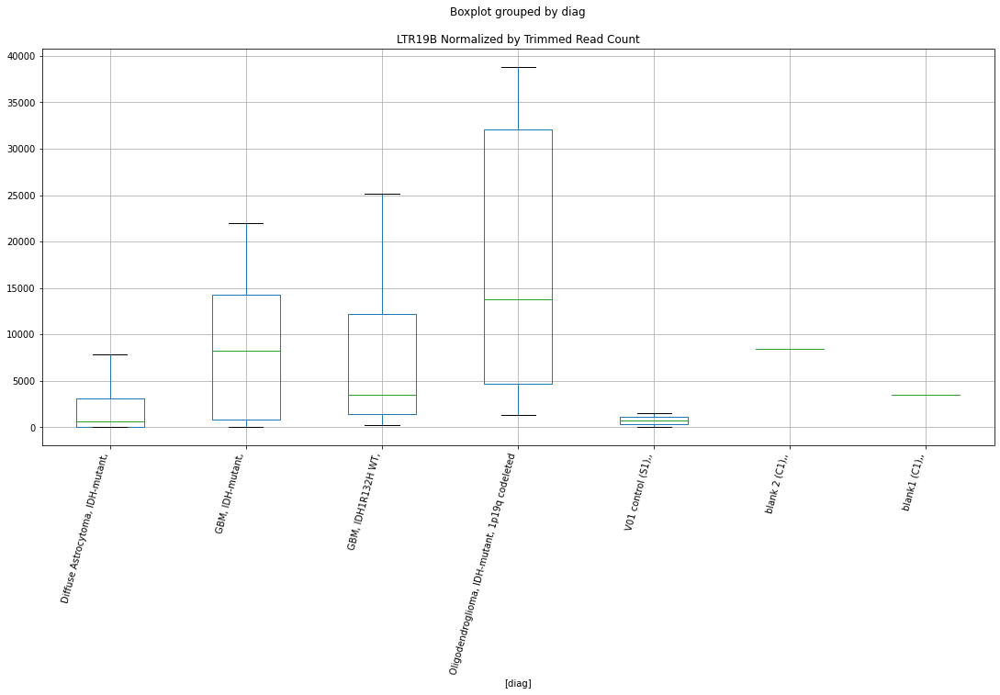

 p : 0.018874785956874036  ( t : 2.5800247657447892 ) :  D-plex  :  bbduk2  :  (AAAT)n
Control and blanks
73      2319.03
337    36496.45
Name: (AAAT)n, dtype: float64
205    3044.55
Name: (AAAT)n, dtype: float64
469    1774.58
Name: (AAAT)n, dtype: float64


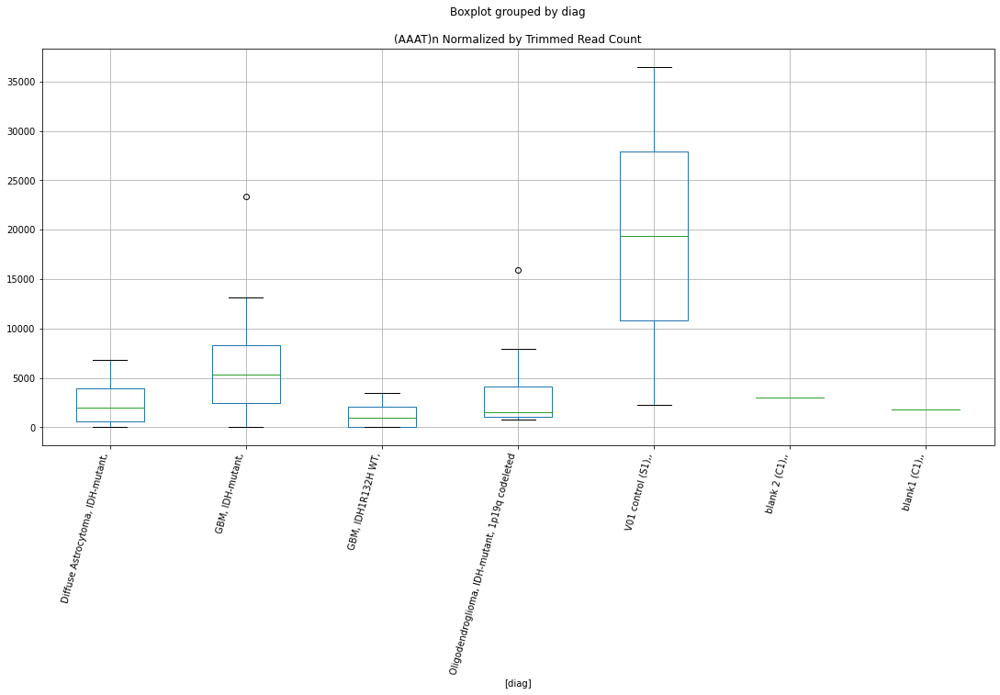

 p : 0.018910031190510244  ( t : 2.5791354222177865 ) :  D-plex  :  bbduk2  :  LTR55
Control and blanks
73     5411.06
337       0.00
Name: LTR55, dtype: float64
205    8954.55
Name: LTR55, dtype: float64
469    5915.27
Name: LTR55, dtype: float64


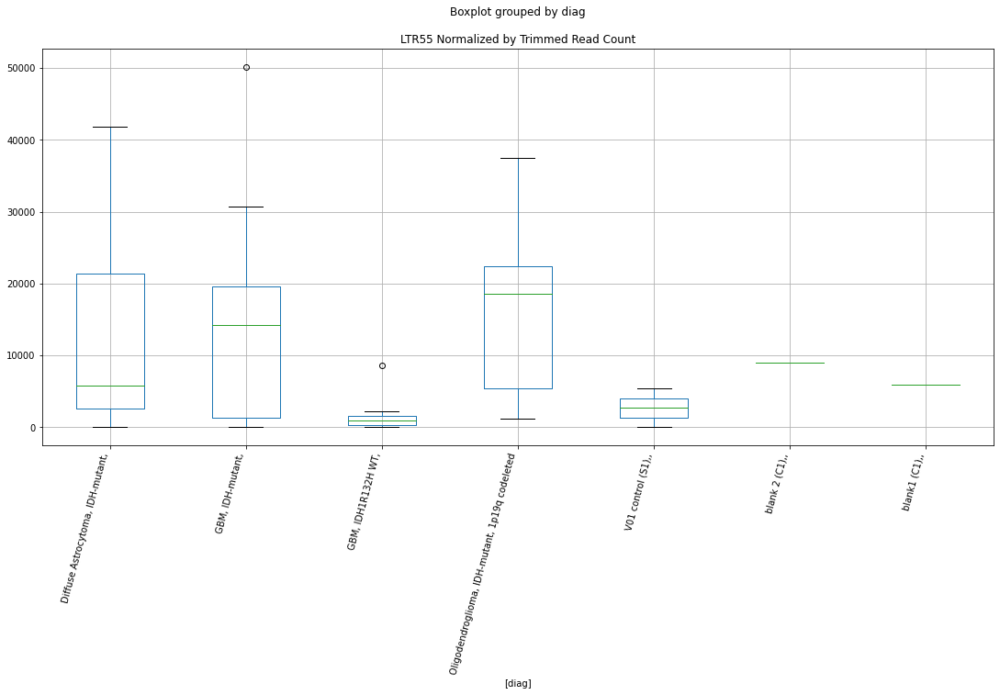

 p : 0.019214886397413457  ( t : 2.5715078935434685 ) :  D-plex  :  cutadapt2  :  MER107
Control and blanks
76      757.61
340    7926.59
Name: MER107, dtype: float64
208    9347.09
Name: MER107, dtype: float64
472    10403.21
Name: MER107, dtype: float64


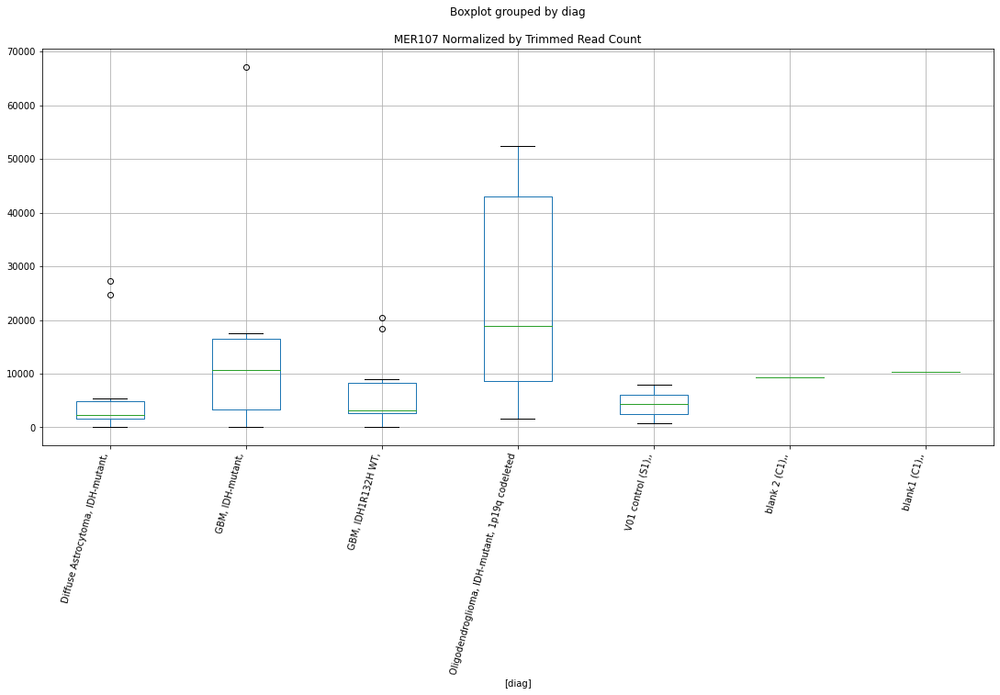

 p : 0.0194952558005451  ( t : 2.564593518903282 ) :  D-plex  :  cutadapt2  :  MER34D
Control and blanks
76     34092.64
340      880.73
Name: MER34D, dtype: float64
208    6348.97
Name: MER34D, dtype: float64
472    4623.65
Name: MER34D, dtype: float64


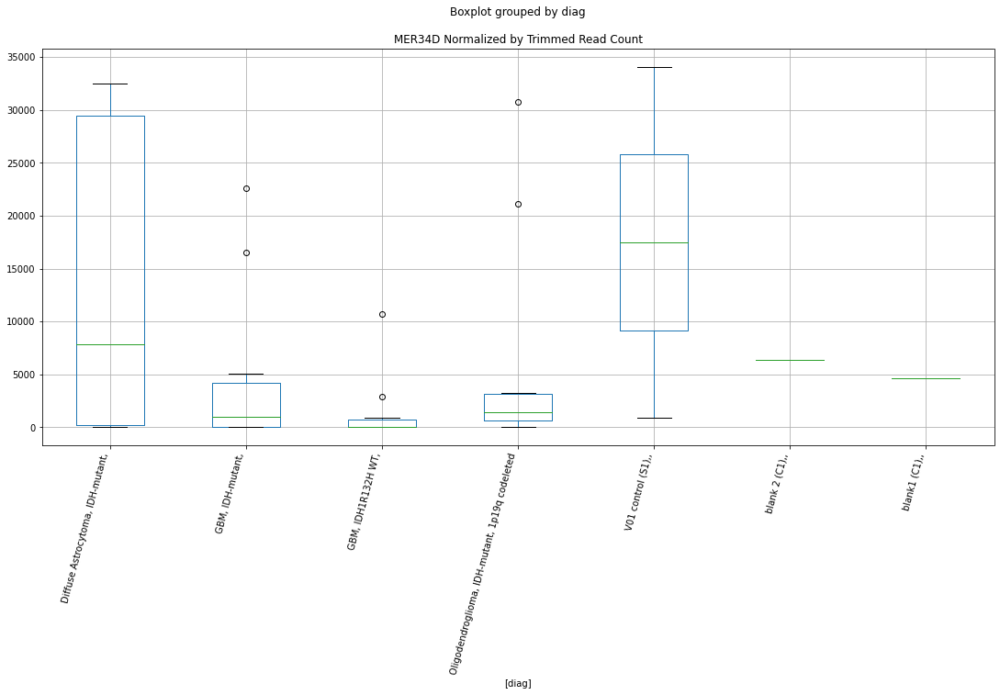

 p : 0.019516129473560444  ( t : 2.564082512279776 ) :  D-plex  :  bbduk2  :  CR1_Mam
Control and blanks
73     17779.19
337    30265.35
Name: CR1_Mam, dtype: float64
205    19700.0
Name: CR1_Mam, dtype: float64
469    25435.67
Name: CR1_Mam, dtype: float64


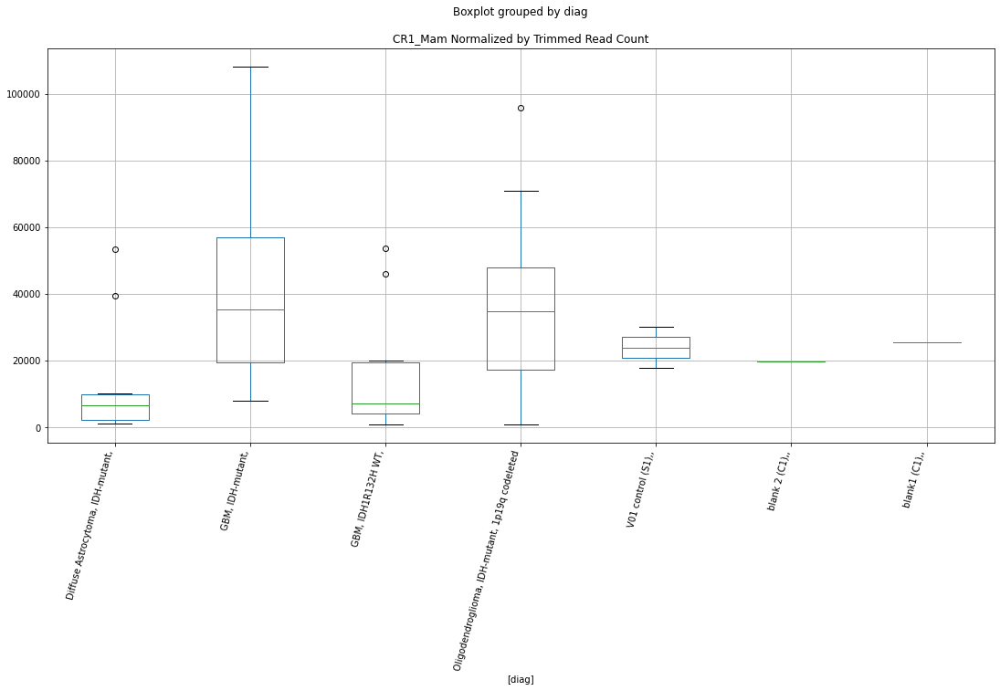

 p : 0.01971579023393233  ( t : 2.559220608258074 ) :  D-plex  :  cutadapt2  :  Ricksha_c
Control and blanks
76      1515.23
340    36990.75
Name: Ricksha_c, dtype: float64
208    16048.78
Name: Ricksha_c, dtype: float64
472    15604.81
Name: Ricksha_c, dtype: float64


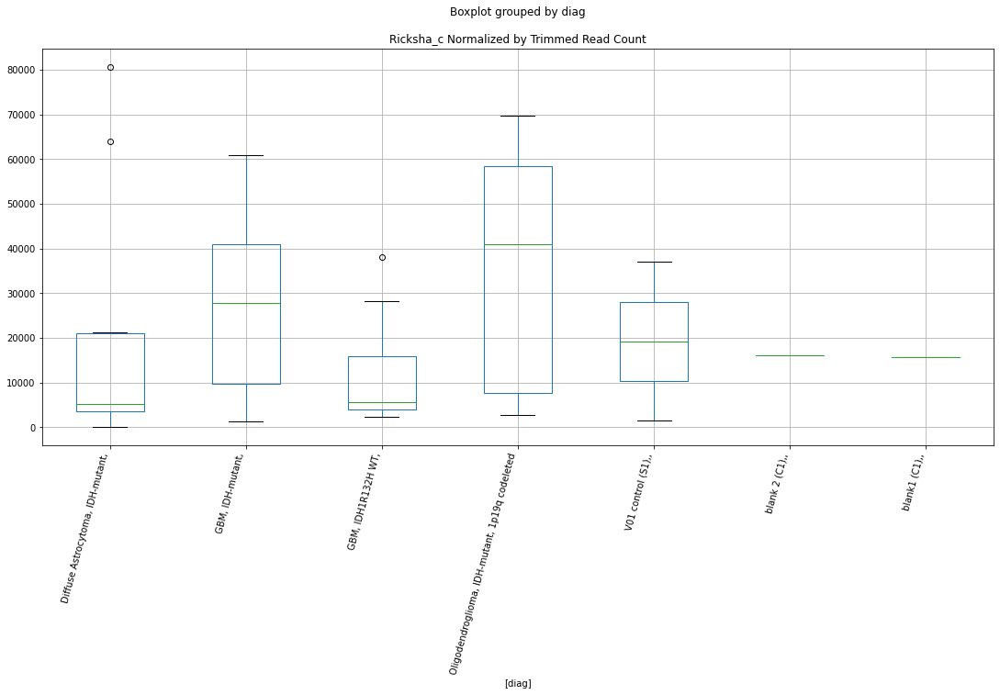

 p : 0.019729146439449882  ( t : 2.558897038792822 ) :  D-plex  :  bbduk2  :  Arthur1
Control and blanks
73      4638.05
337    47178.33
Name: Arthur1, dtype: float64
205    43340.01
Name: Arthur1, dtype: float64
469    39632.33
Name: Arthur1, dtype: float64


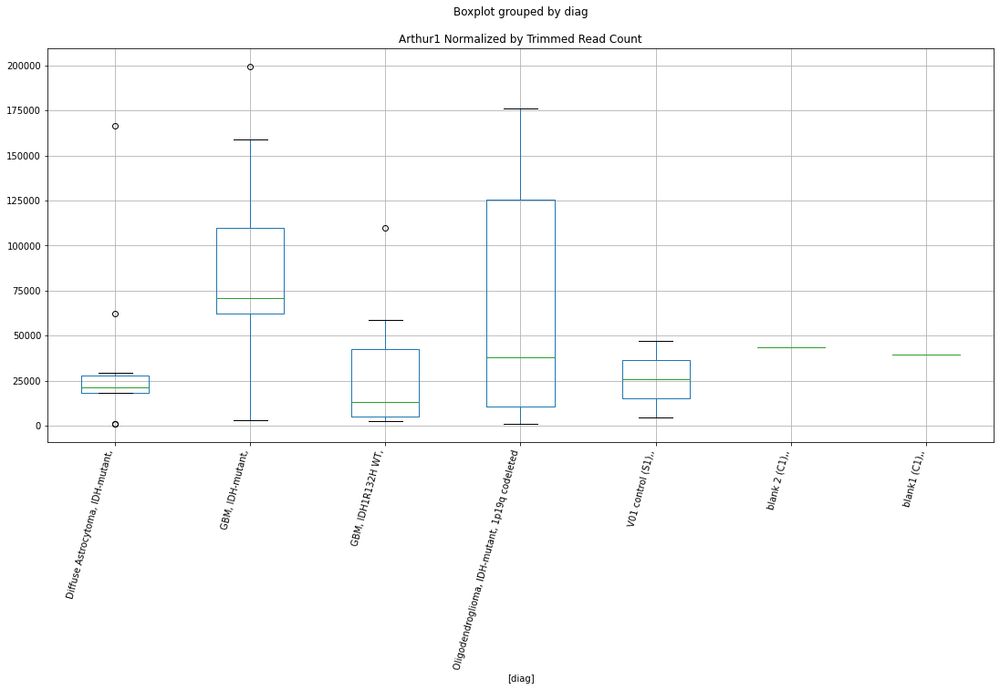

 p : 0.019803262624770803  ( t : 2.557105246802803 ) :  D-plex  :  bbduk2  :  (TGT)n
Control and blanks
73     1546.02
337    1780.31
Name: (TGT)n, dtype: float64
205    3223.64
Name: (TGT)n, dtype: float64
469    2366.11
Name: (TGT)n, dtype: float64


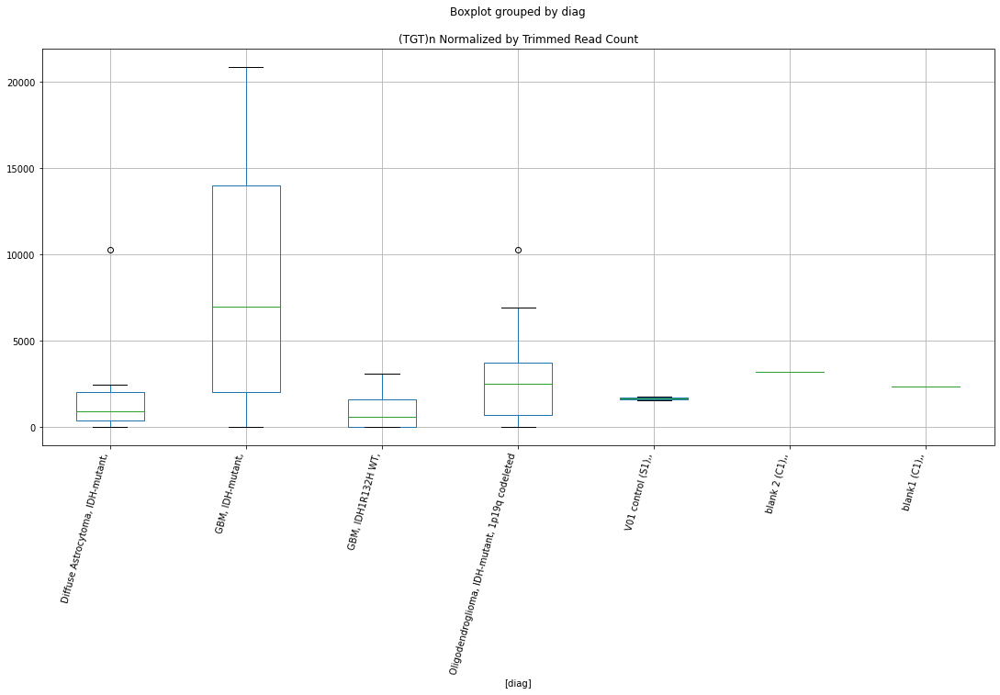

 p : 0.01984830937218913  ( t : 2.5560193193121616 ) :  D-plex  :  cutadapt2  :  Cheshire
Control and blanks
76     30304.57
340    23779.77
Name: Cheshire, dtype: float64
208    24690.43
Name: Cheshire, dtype: float64
472    19650.5
Name: Cheshire, dtype: float64


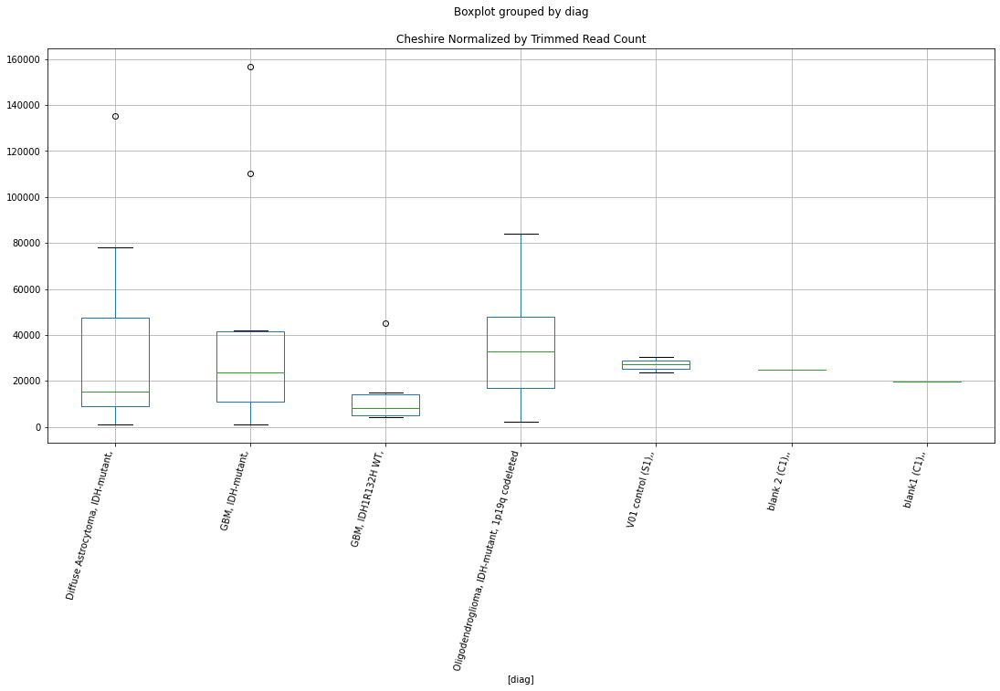

 p : 0.01987002828500046  ( t : 2.5554965813670893 ) :  D-plex  :  cutadapt2  :  HSMAR1
Control and blanks
76      1515.23
340    36990.75
Name: HSMAR1, dtype: float64
208    17283.3
Name: HSMAR1, dtype: float64
472    11559.12
Name: HSMAR1, dtype: float64


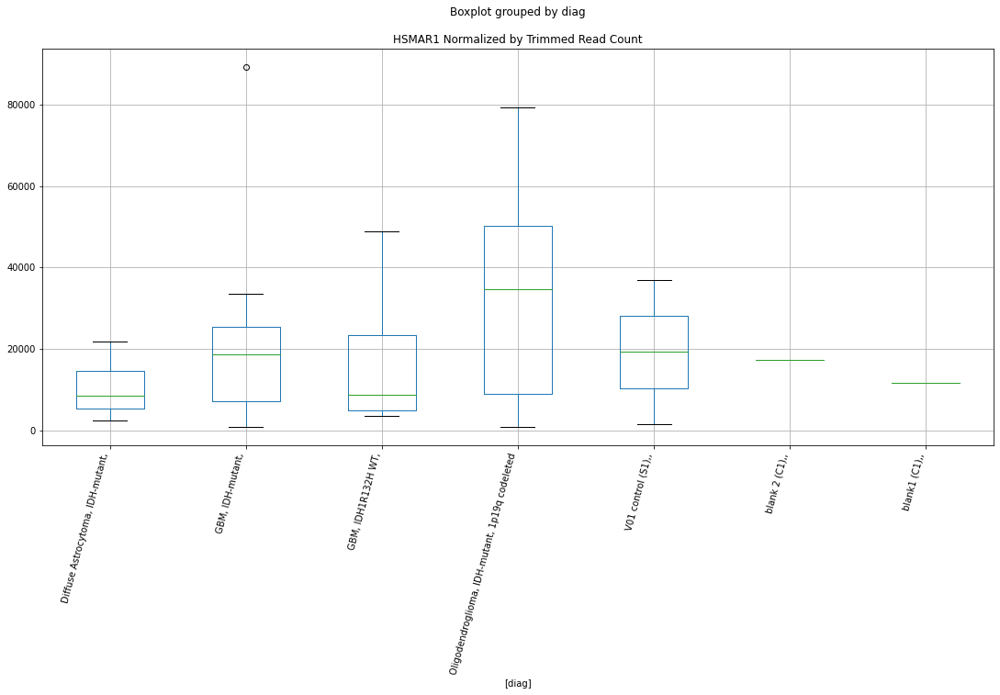

 p : 0.01988031919265265  ( t : 2.555249085140955 ) :  D-plex  :  cutadapt2  :  LTR81AB
Control and blanks
76     1515.23
340       0.00
Name: LTR81AB, dtype: float64
208    2645.4
Name: LTR81AB, dtype: float64
472    2311.82
Name: LTR81AB, dtype: float64


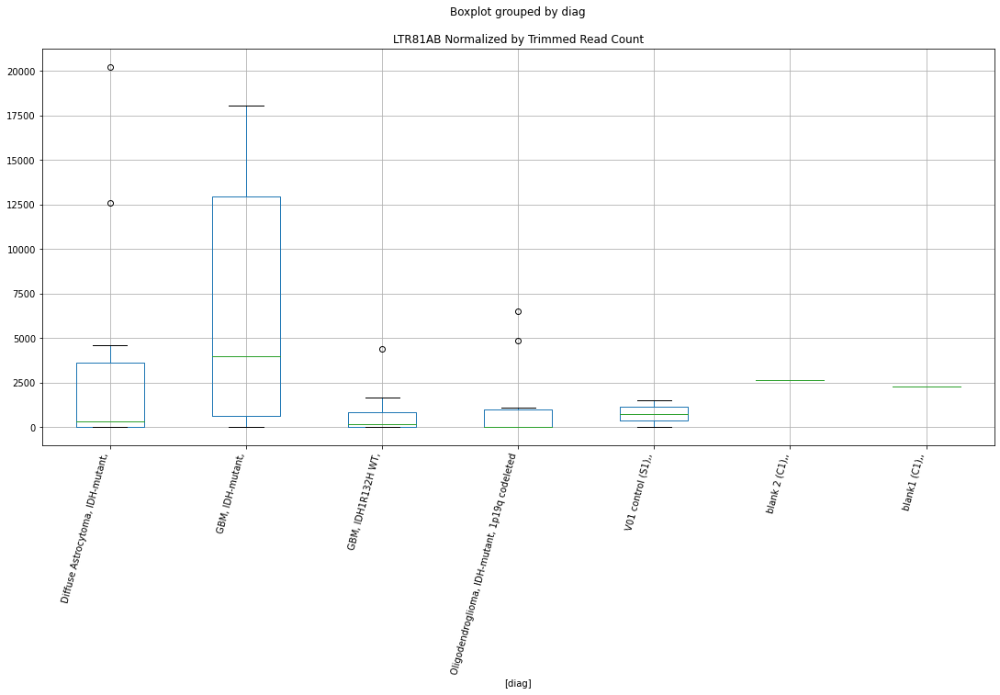

 p : 0.019942087804709217  ( t : 2.5537660928231083 ) :  D-plex  :  bbduk2  :  (ATATGT)n
Control and blanks
73         0.00
337    25814.56
Name: (ATATGT)n, dtype: float64
205    3760.91
Name: (ATATGT)n, dtype: float64
469    1183.05
Name: (ATATGT)n, dtype: float64


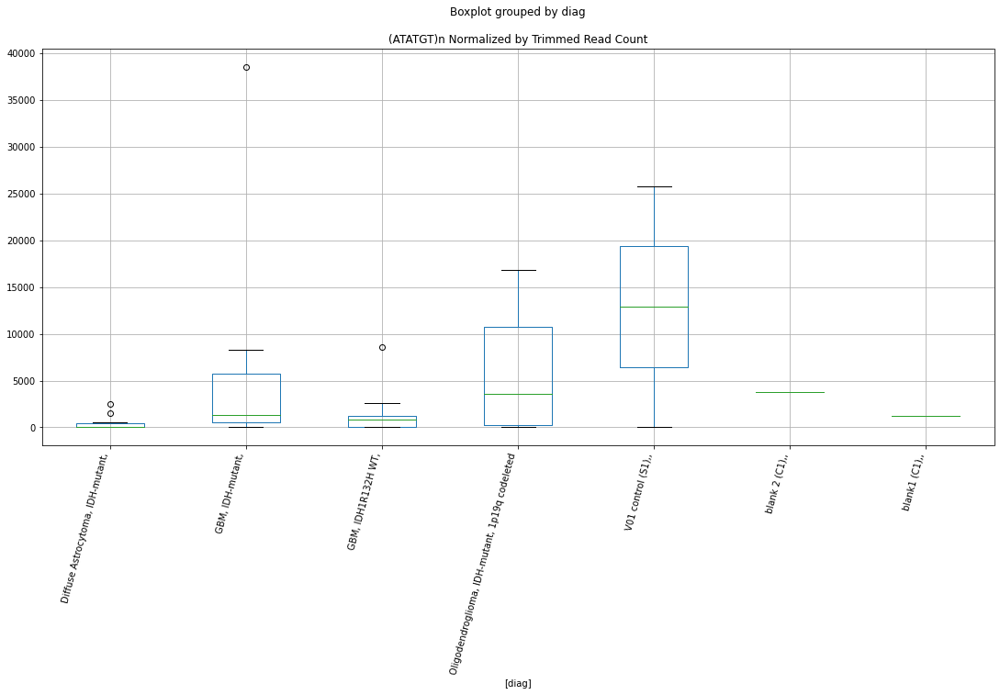

 p : 0.020014197730226304  ( t : 2.5520403052210594 ) :  D-plex  :  bbduk2  :  (CACC)n
Control and blanks
73     0.0
337    0.0
Name: (CACC)n, dtype: float64
205    179.09
Name: (CACC)n, dtype: float64
469    0.0
Name: (CACC)n, dtype: float64


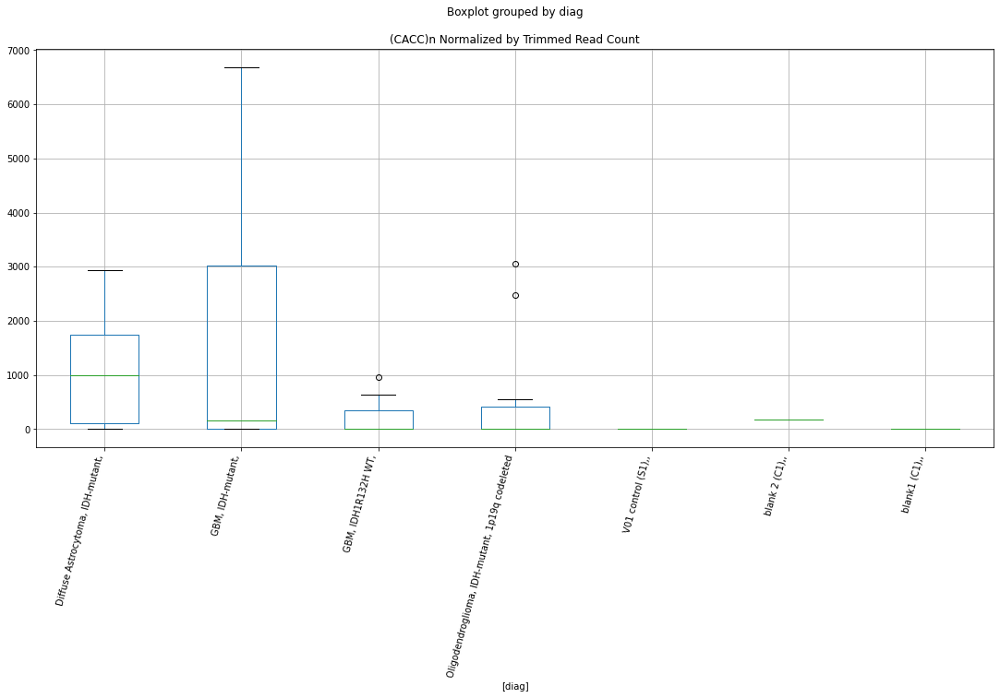

 p : 0.020120599078479632  ( t : 2.5495045415146045 ) :  D-plex  :  cutadapt2  :  (TGAA)n
Control and blanks
76      757.61
340    3522.93
Name: (TGAA)n, dtype: float64
208    7407.13
Name: (TGAA)n, dtype: float64
472    2311.82
Name: (TGAA)n, dtype: float64


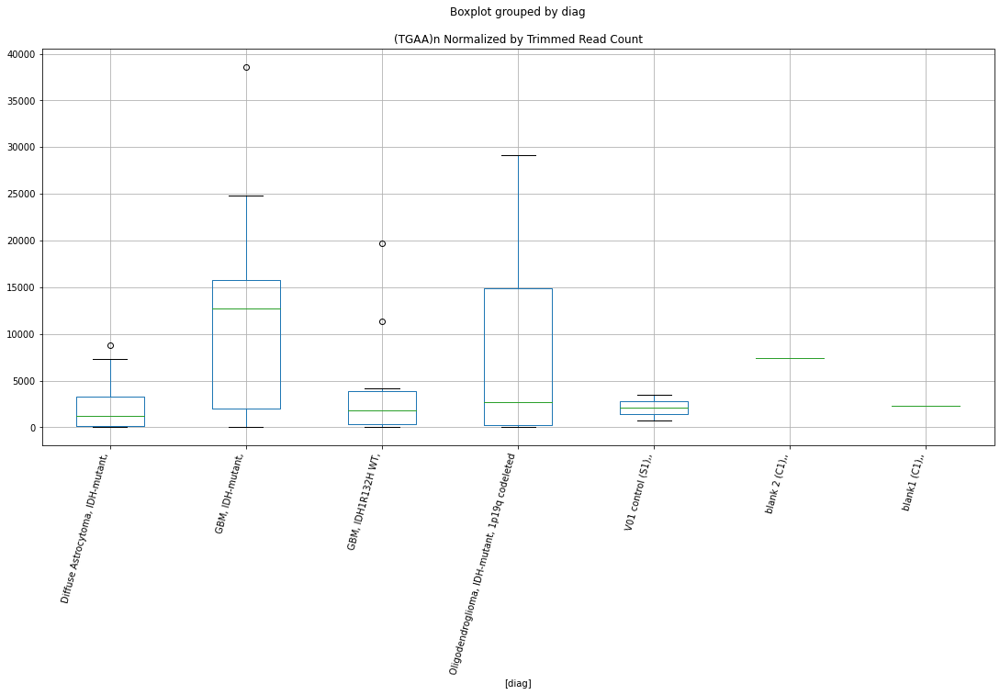

 p : 0.020247989402171  ( t : 2.5464851949826 ) :  D-plex  :  bbduk2  :  LTR35
Control and blanks
73     0.0
337    0.0
Name: LTR35, dtype: float64
205    2507.27
Name: LTR35, dtype: float64
469    5323.75
Name: LTR35, dtype: float64


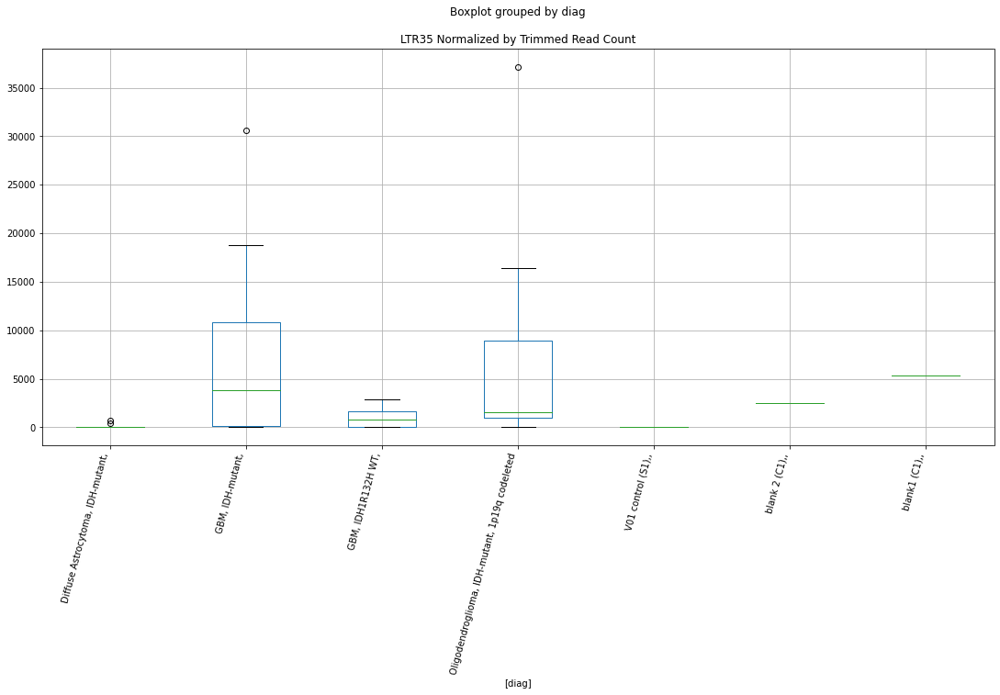

 p : 0.020365452727973982  ( t : 2.5437170077628024 ) :  D-plex  :  bbduk2  :  (TTTGTT)n
Control and blanks
73        0.00
337    5340.94
Name: (TTTGTT)n, dtype: float64
205    179.09
Name: (TTTGTT)n, dtype: float64
469    591.53
Name: (TTTGTT)n, dtype: float64


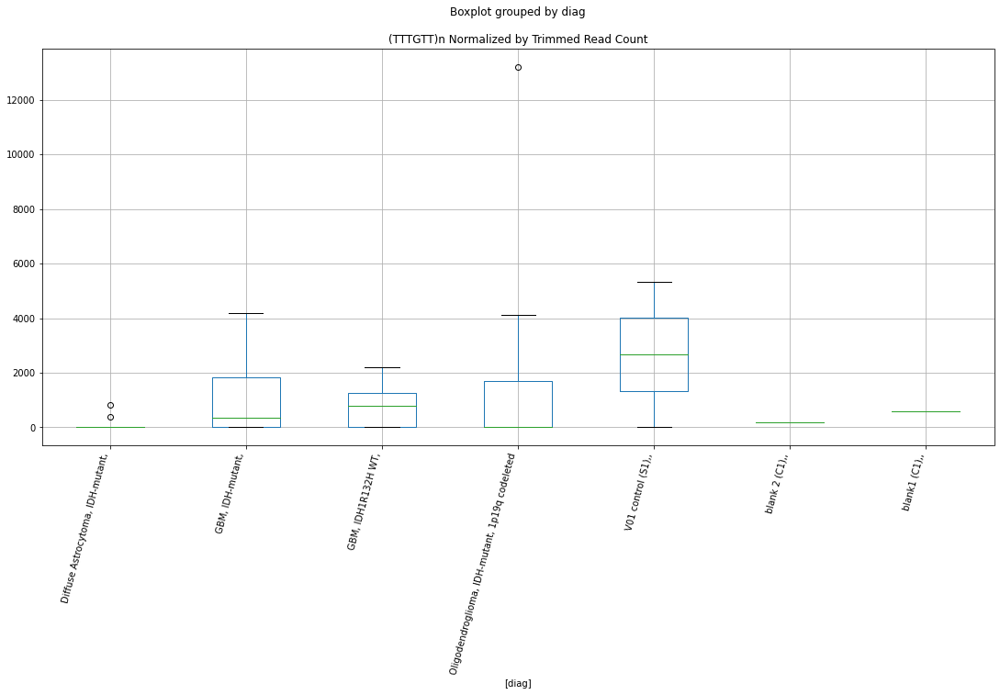

 p : 0.020382106791656817  ( t : 2.543325753841273 ) :  D-plex  :  bbduk2  :  (ATCT)n
Control and blanks
73     19325.21
337    32045.66
Name: (ATCT)n, dtype: float64
205    16655.46
Name: (ATCT)n, dtype: float64
469    16562.76
Name: (ATCT)n, dtype: float64


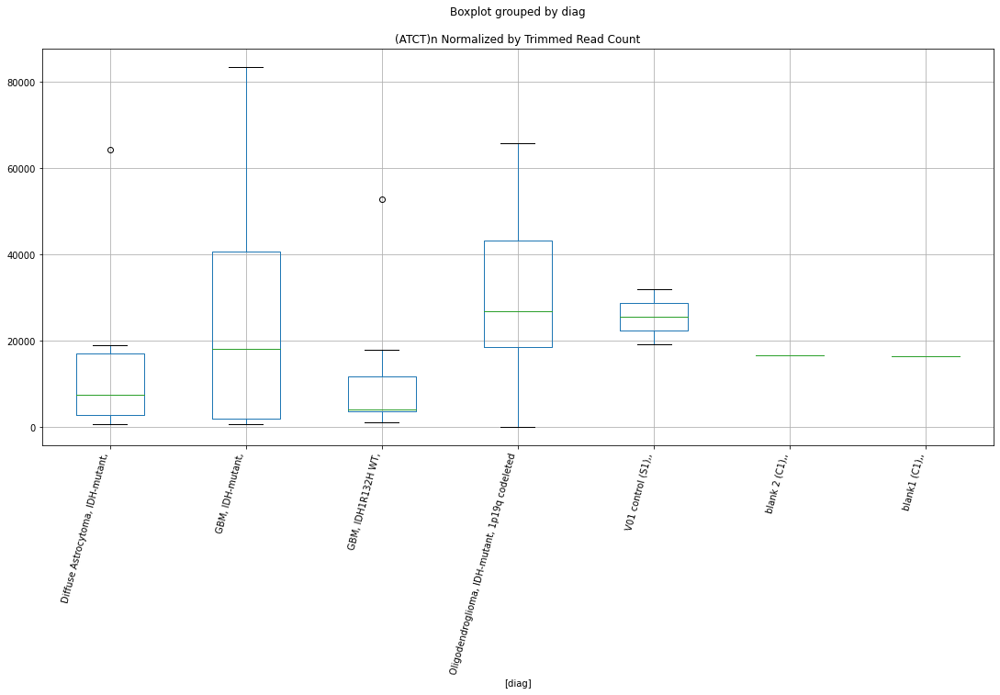

 p : 0.020519610771151317  ( t : 2.5401068714885637 ) :  D-plex  :  bbduk2  :  Cheshire
Control and blanks
73     30920.34
337    24034.25
Name: Cheshire, dtype: float64
205    24535.46
Name: Cheshire, dtype: float64
469    19520.4
Name: Cheshire, dtype: float64


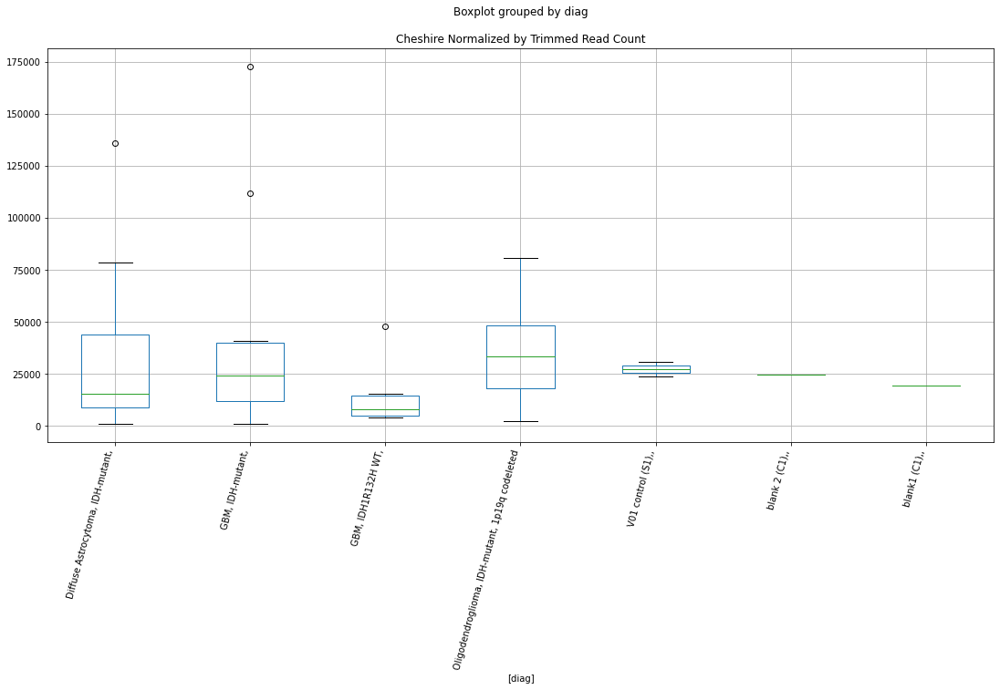

 p : 0.020614205284822967  ( t : 2.537904287706815 ) :  D-plex  :  cutadapt2  :  LTR55
Control and blanks
76     6818.53
340       0.00
Name: LTR55, dtype: float64
208    9876.17
Name: LTR55, dtype: float64
472    5779.56
Name: LTR55, dtype: float64


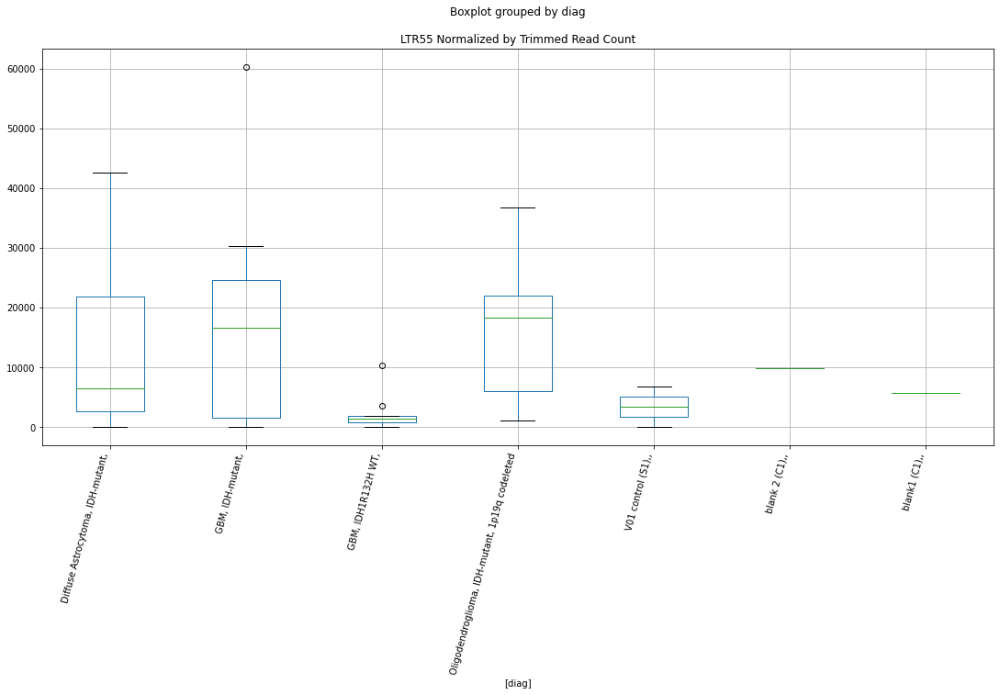

 p : 0.020667869620516074  ( t : 2.536658984050453 ) :  D-plex  :  bbduk2  :  Tigger17
Control and blanks
73     0.0
337    0.0
Name: Tigger17, dtype: float64
205    1074.55
Name: Tigger17, dtype: float64
469    0.0
Name: Tigger17, dtype: float64


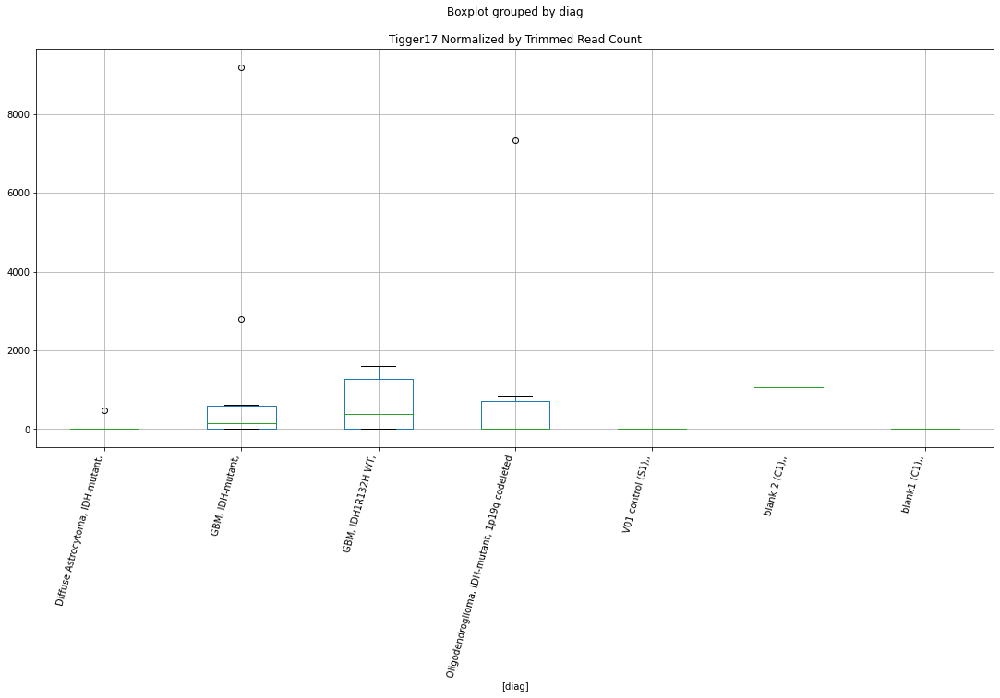

 p : 0.020698320428194788  ( t : 2.5359537181140674 ) :  D-plex  :  cutadapt2  :  LTR35
Control and blanks
76     0.0
340    0.0
Name: LTR35, dtype: float64
208    2645.4
Name: LTR35, dtype: float64
472    6357.51
Name: LTR35, dtype: float64


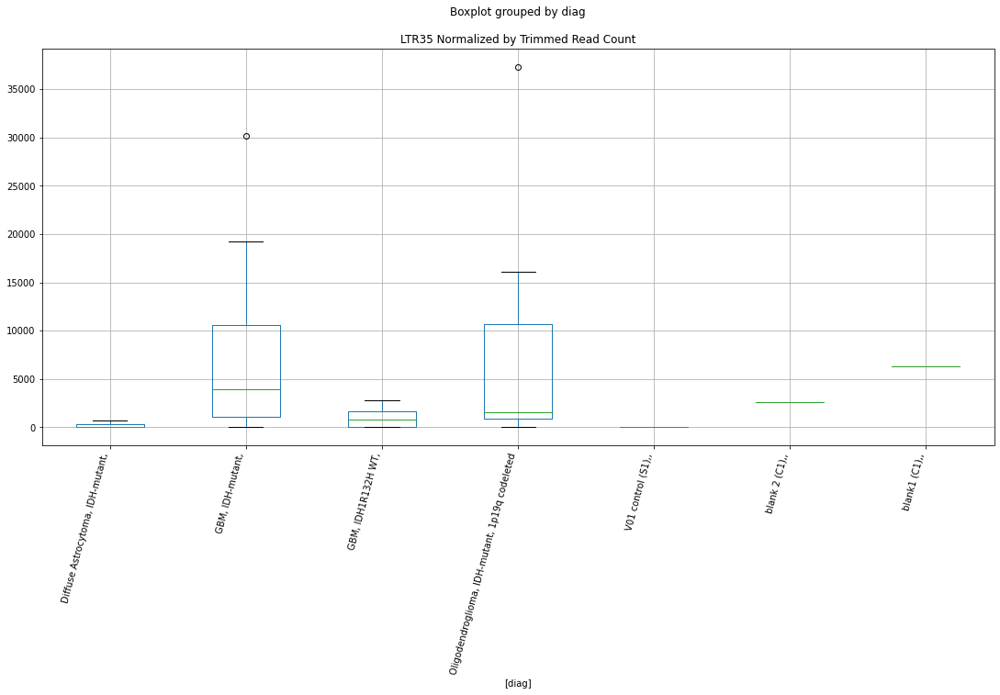

 p : 0.020807629435850055  ( t : 2.533430080574786 ) :  D-plex  :  bbduk2  :  MLT1E
Control and blanks
73     33239.36
337    14242.52
Name: MLT1E, dtype: float64
205    12715.46
Name: MLT1E, dtype: float64
469    15971.24
Name: MLT1E, dtype: float64


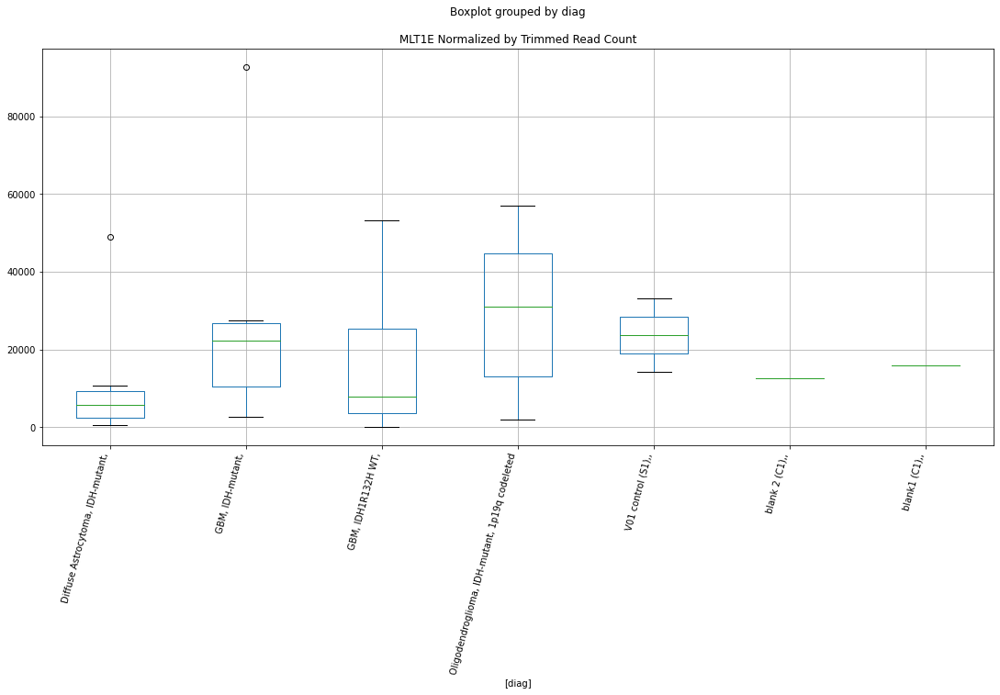

 p : 0.020856798077158924  ( t : 2.5322989961390534 ) :  D-plex  :  bbduk2  :  LTR53B
Control and blanks
73     773.01
337      0.00
Name: LTR53B, dtype: float64
205    3402.73
Name: LTR53B, dtype: float64
469    1774.58
Name: LTR53B, dtype: float64


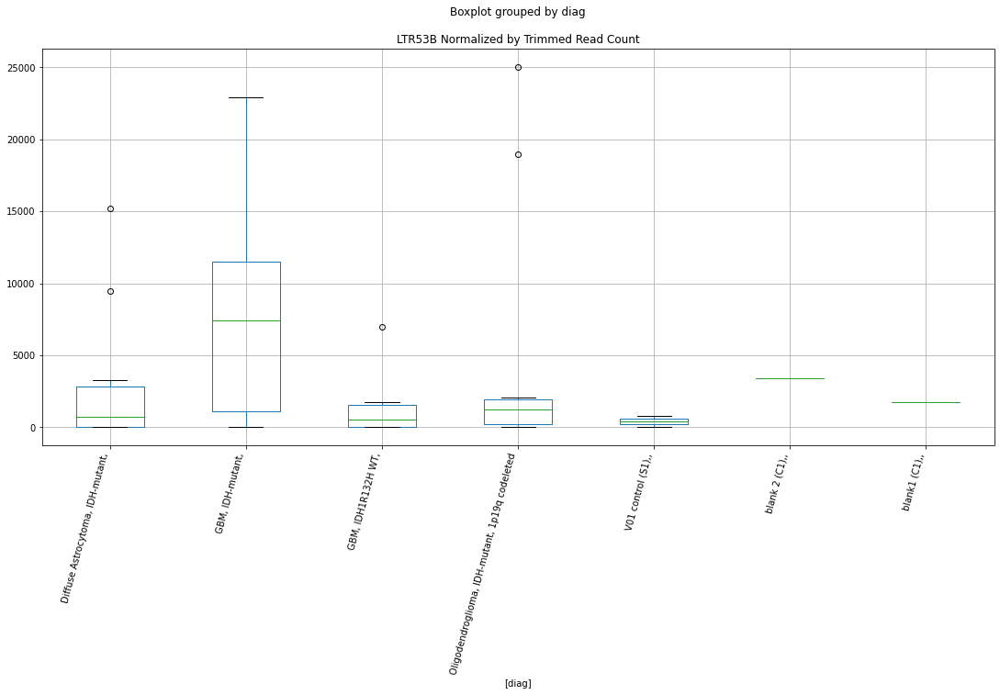

 p : 0.0208939055243946  ( t : 2.5314470360611354 ) :  D-plex  :  bbduk2  :  HERV3-int
Control and blanks
73       773.01
337    40057.08
Name: HERV3-int, dtype: float64
205    16834.55
Name: HERV3-int, dtype: float64
469    18337.35
Name: HERV3-int, dtype: float64


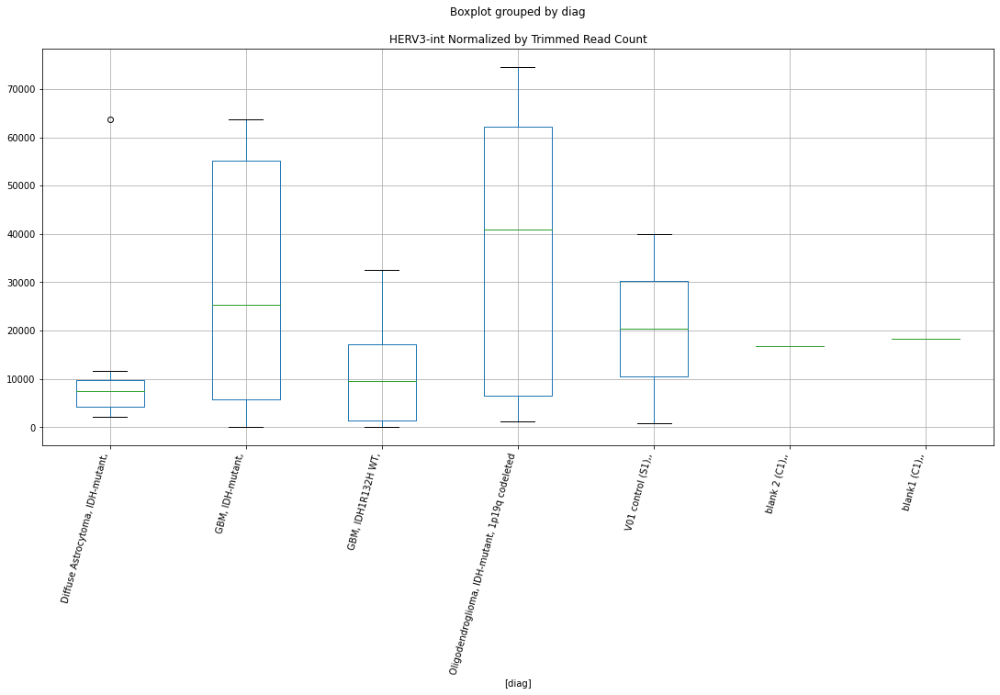

 p : 0.02091955570468054  ( t : 2.530858961468913 ) :  D-plex  :  bbduk2  :  Tigger18a
Control and blanks
73     10822.12
337    58750.38
Name: Tigger18a, dtype: float64
205    20416.37
Name: Tigger18a, dtype: float64
469    23661.09
Name: Tigger18a, dtype: float64


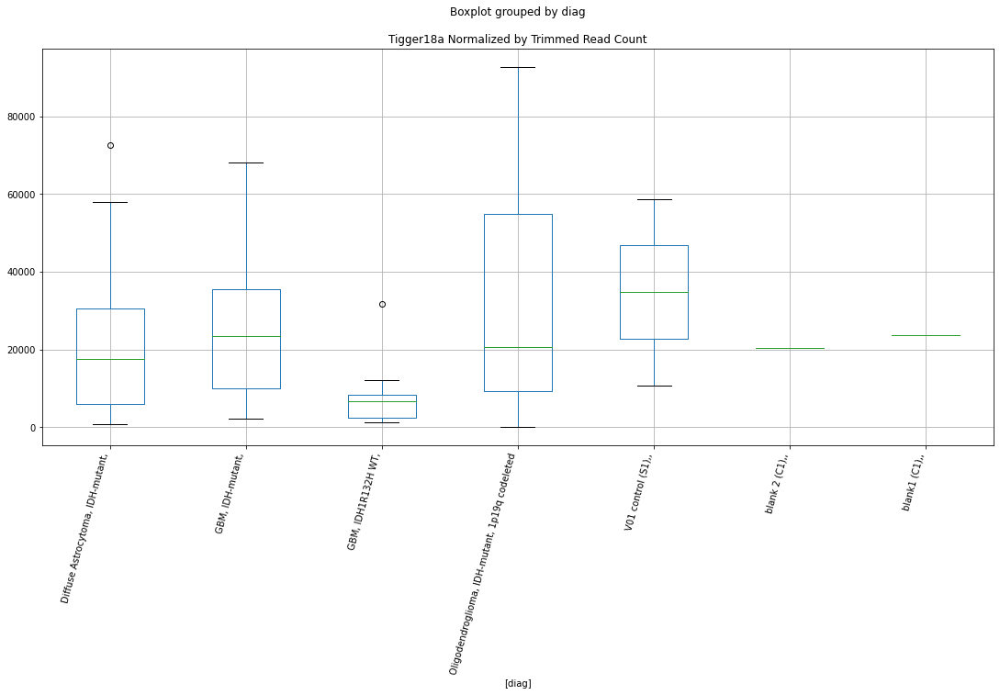

 p : 0.02101476181563285  ( t : 2.5286821357353504 ) :  D-plex  :  cutadapt2  :  MER51A
Control and blanks
76      7576.14
340    37871.48
Name: MER51A, dtype: float64
208    19046.9
Name: MER51A, dtype: float64
472    17916.63
Name: MER51A, dtype: float64


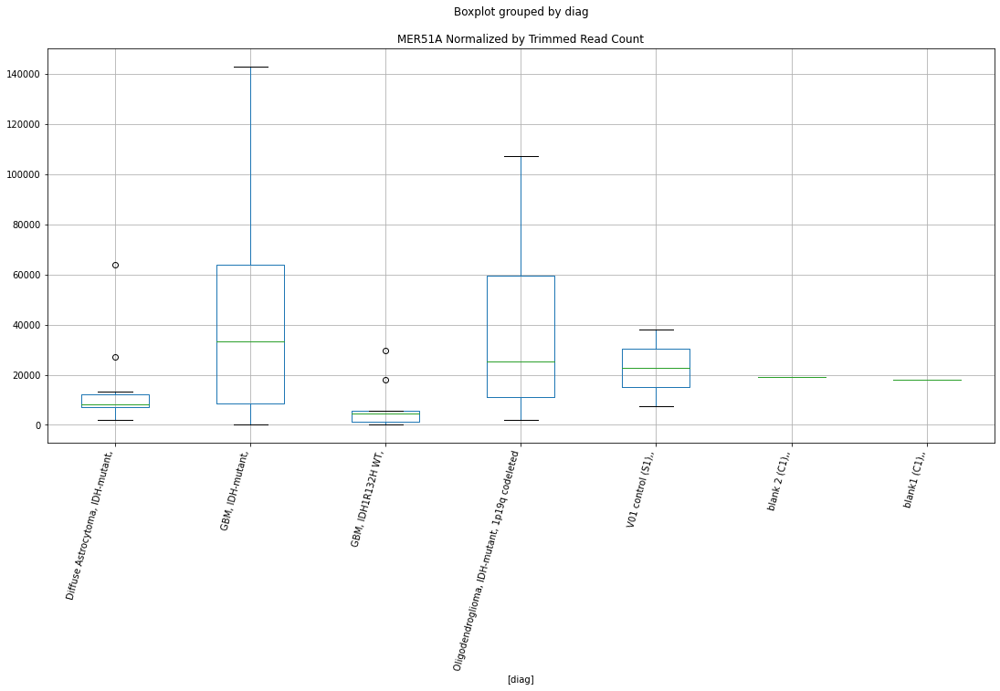

 p : 0.0211683083574408  ( t : 2.5251909377605894 ) :  D-plex  :  cutadapt2  :  Tigger2a
Control and blanks
76     75761.42
340    63412.71
Name: Tigger2a, dtype: float64
208    68075.04
Name: Tigger2a, dtype: float64
472    85537.46
Name: Tigger2a, dtype: float64


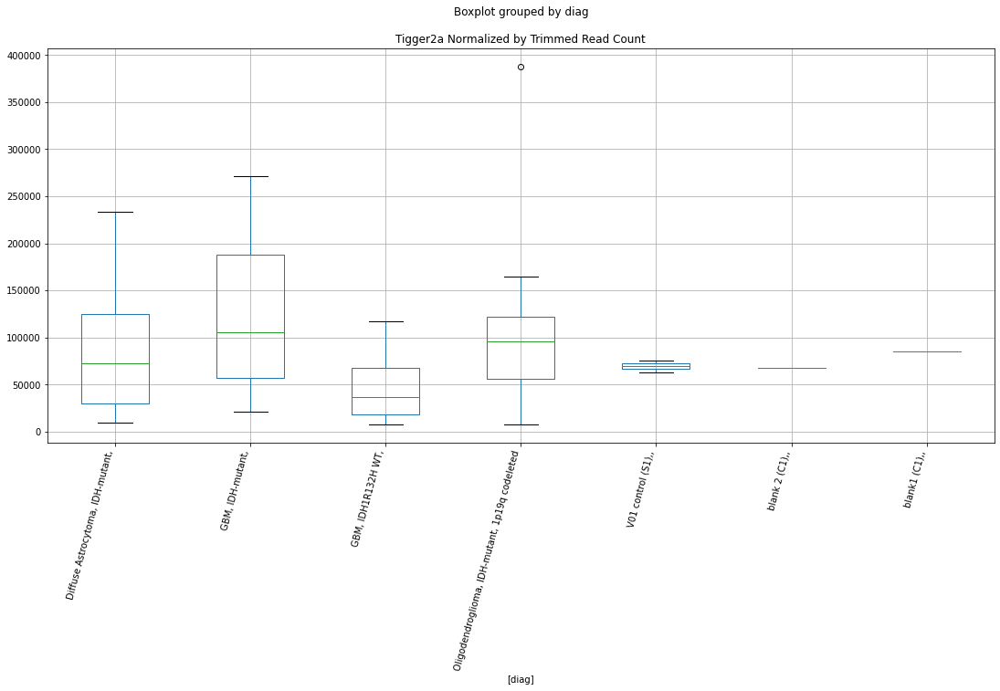

 p : 0.021185725218519375  ( t : 2.524796440383644 ) :  Lexogen  :  bbduk2  :  HY5
Control and blanks
79       0.00
343    212.31
Name: HY5, dtype: float64
211    0.0
Name: HY5, dtype: float64
475    0.0
Name: HY5, dtype: float64


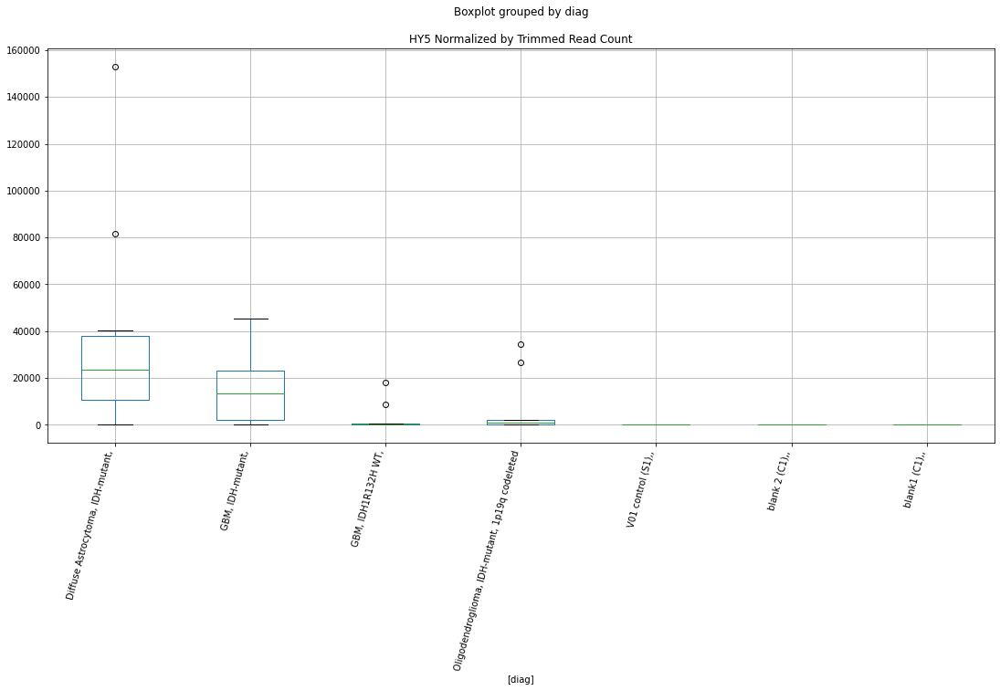

 p : 0.02128287612905532  ( t : 2.52260154262591 ) :  D-plex  :  cutadapt2  :  (GAAA)n
Control and blanks
76      3788.07
340    30825.62
Name: (GAAA)n, dtype: float64
208    11992.49
Name: (GAAA)n, dtype: float64
472    12137.07
Name: (GAAA)n, dtype: float64


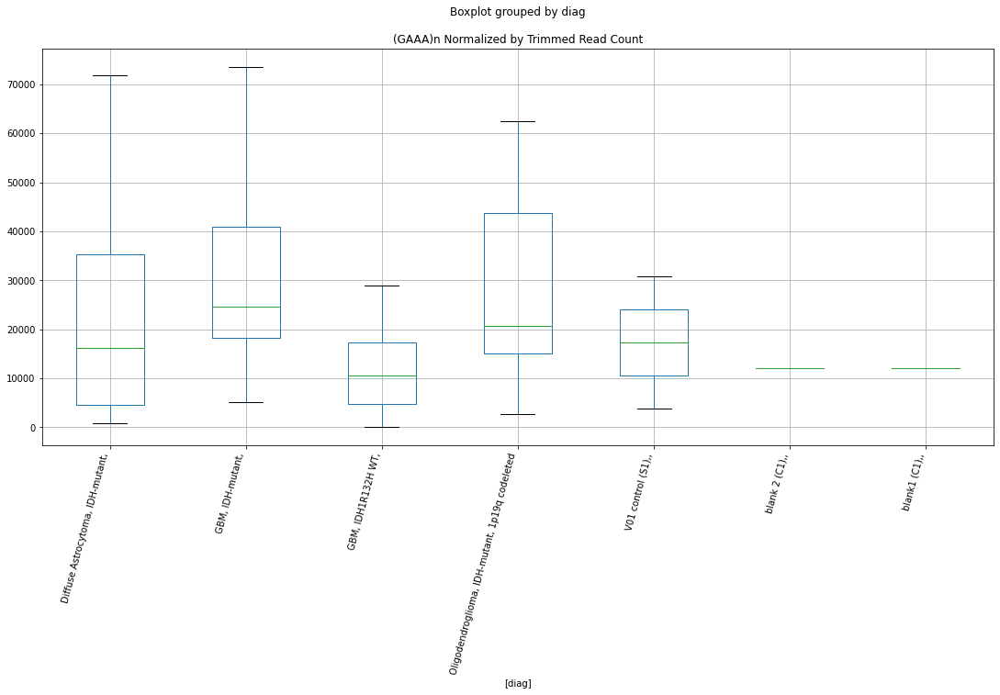

 p : 0.02133739412170915  ( t : 2.5213739750991855 ) :  D-plex  :  bbduk2  :  (CTG)n
Control and blanks
73     773.01
337    890.16
Name: (CTG)n, dtype: float64
205    2149.09
Name: (CTG)n, dtype: float64
469    1774.58
Name: (CTG)n, dtype: float64


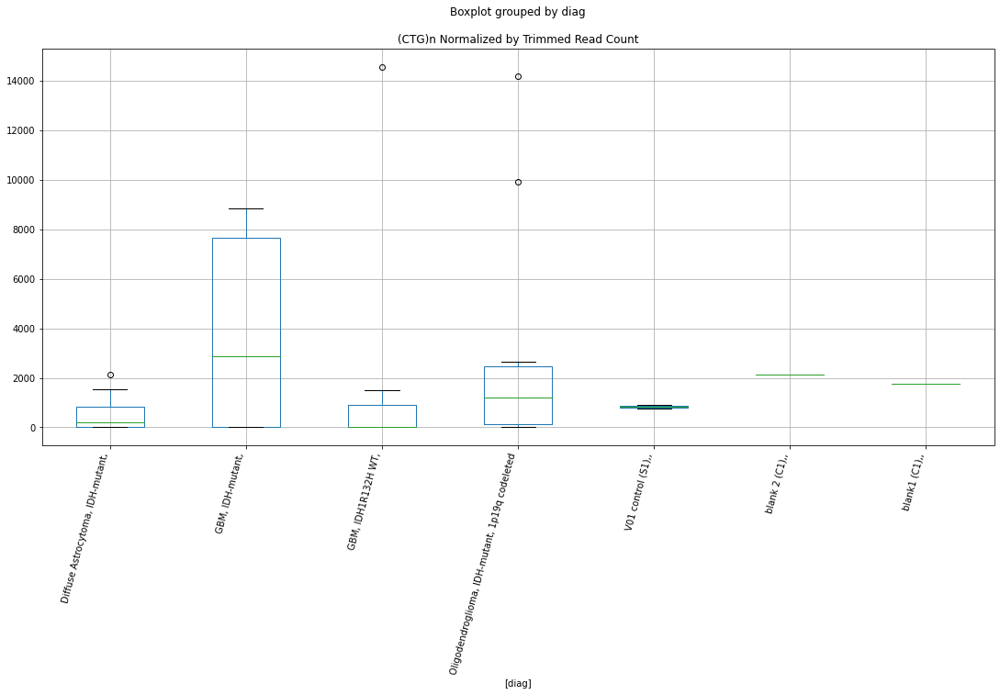

 p : 0.02134885010604527  ( t : 2.521116400090102 ) :  Lexogen  :  cutadapt2  :  HY5
Control and blanks
82       0.00
346    210.43
Name: HY5, dtype: float64
214    0.0
Name: HY5, dtype: float64
478    0.0
Name: HY5, dtype: float64


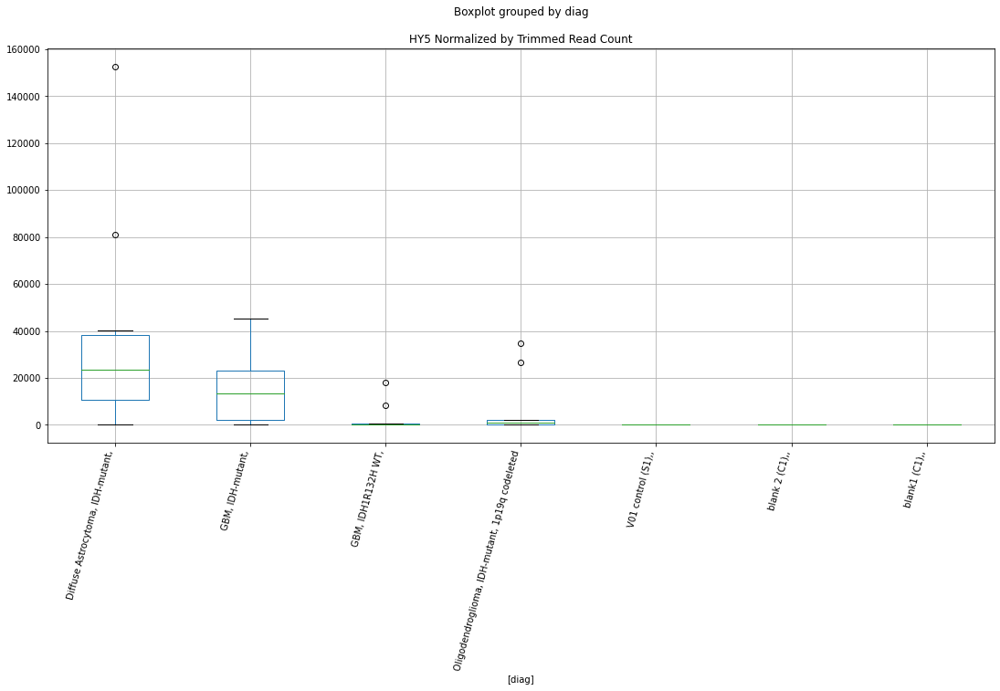

 p : 0.021490515847808818  ( t : 2.51794193892143 ) :  D-plex  :  cutadapt2  :  AmnSINE2
Control and blanks
76     2272.84
340       0.00
Name: AmnSINE2, dtype: float64
208    5114.45
Name: AmnSINE2, dtype: float64
472    2889.78
Name: AmnSINE2, dtype: float64


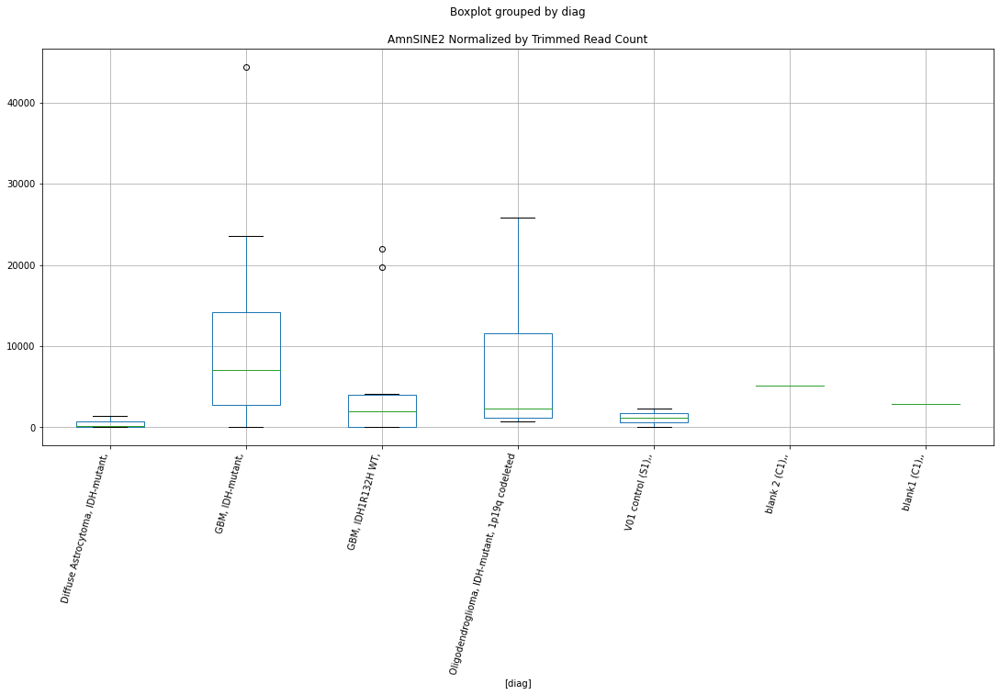

 p : 0.021538074572793556  ( t : 2.5168806639545576 ) :  D-plex  :  bbduk2  :  AluYk4
Control and blanks
73      44061.48
337    113049.97
Name: AluYk4, dtype: float64
205    24714.55
Name: AluYk4, dtype: float64
469    37266.22
Name: AluYk4, dtype: float64


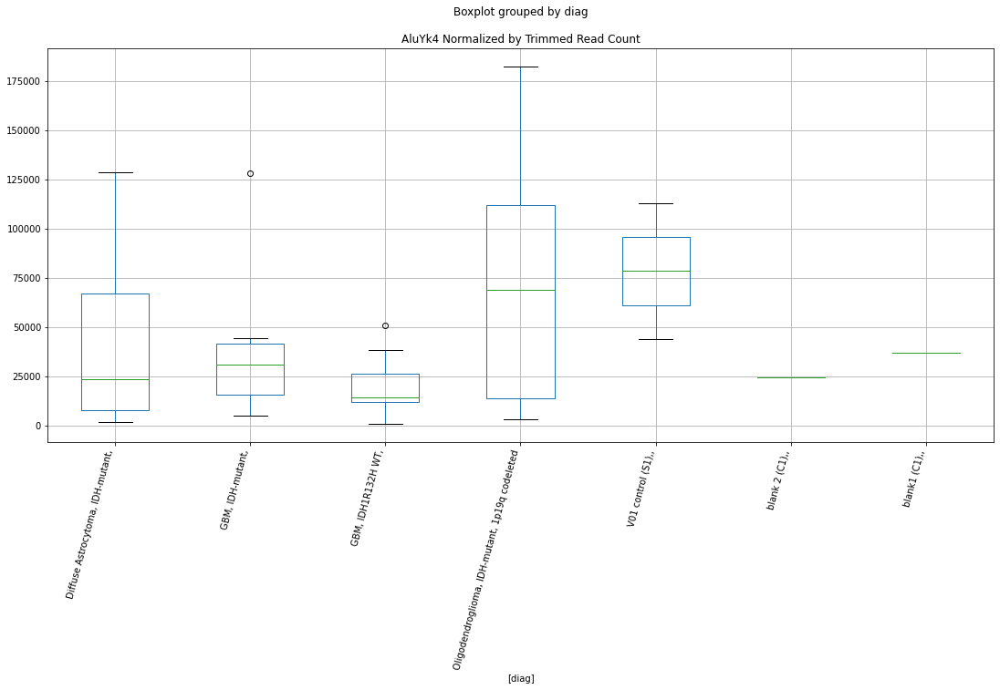

 p : 0.02177584504492048  ( t : 2.5116077393904757 ) :  D-plex  :  bbduk2  :  MamTip3
Control and blanks
73     20098.22
337    15132.67
Name: MamTip3, dtype: float64
205    11999.09
Name: MamTip3, dtype: float64
469    17745.82
Name: MamTip3, dtype: float64


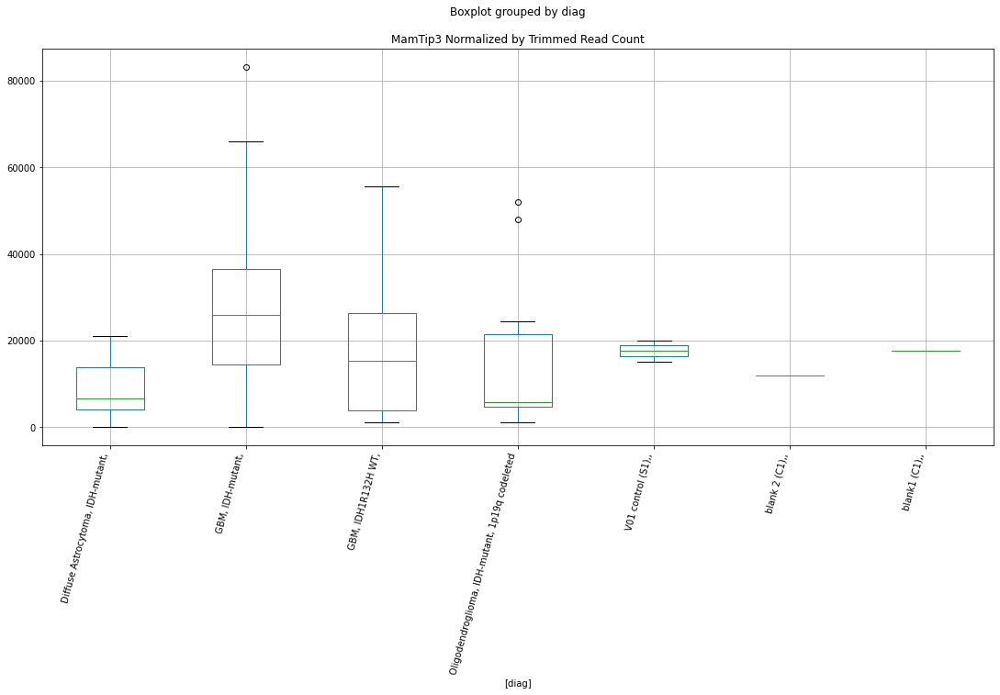

 p : 0.021796961525245896  ( t : 2.51114207821323 ) :  D-plex  :  cutadapt2  :  (G)n
Control and blanks
76     1.24e+06
340    5.51e+05
Name: (G)n, dtype: float64
208    511444.63
Name: (G)n, dtype: float64
472    2.10e+06
Name: (G)n, dtype: float64


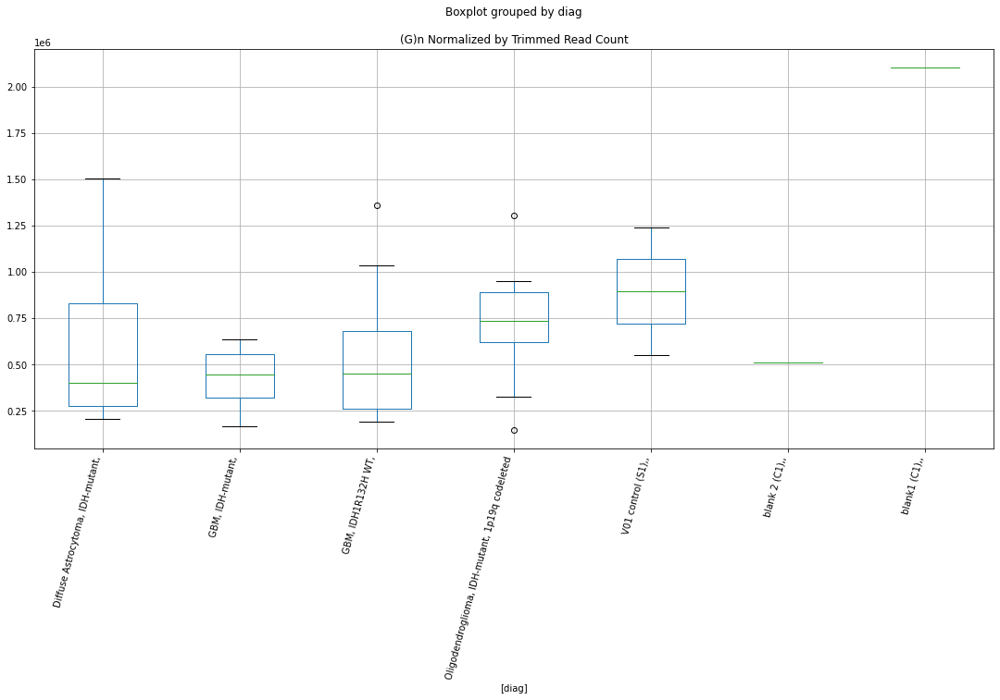

 p : 0.0223227262643976  ( t : 2.4996829541042023 ) :  D-plex  :  bbduk2  :  (TCT)n
Control and blanks
73      1546.02
337    24924.40
Name: (TCT)n, dtype: float64
205    8417.27
Name: (TCT)n, dtype: float64
469    5915.27
Name: (TCT)n, dtype: float64


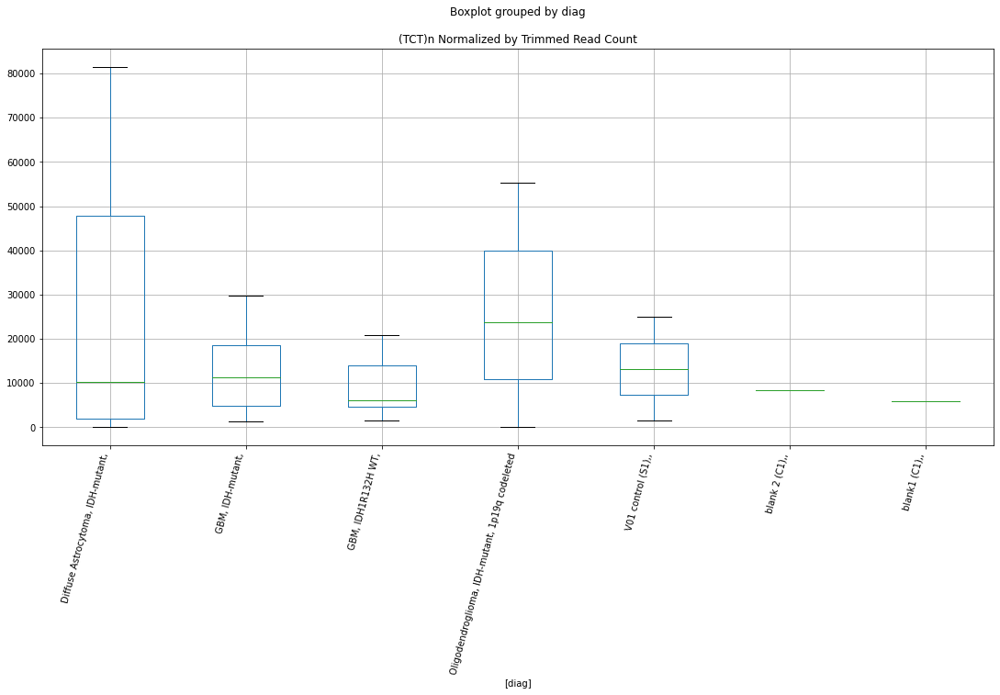

 p : 0.022341417663122018  ( t : 2.4992802720207767 ) :  D-plex  :  bbduk2  :  (ACCC)n
Control and blanks
73       0.00
337    890.16
Name: (ACCC)n, dtype: float64
205    179.09
Name: (ACCC)n, dtype: float64
469    591.53
Name: (ACCC)n, dtype: float64


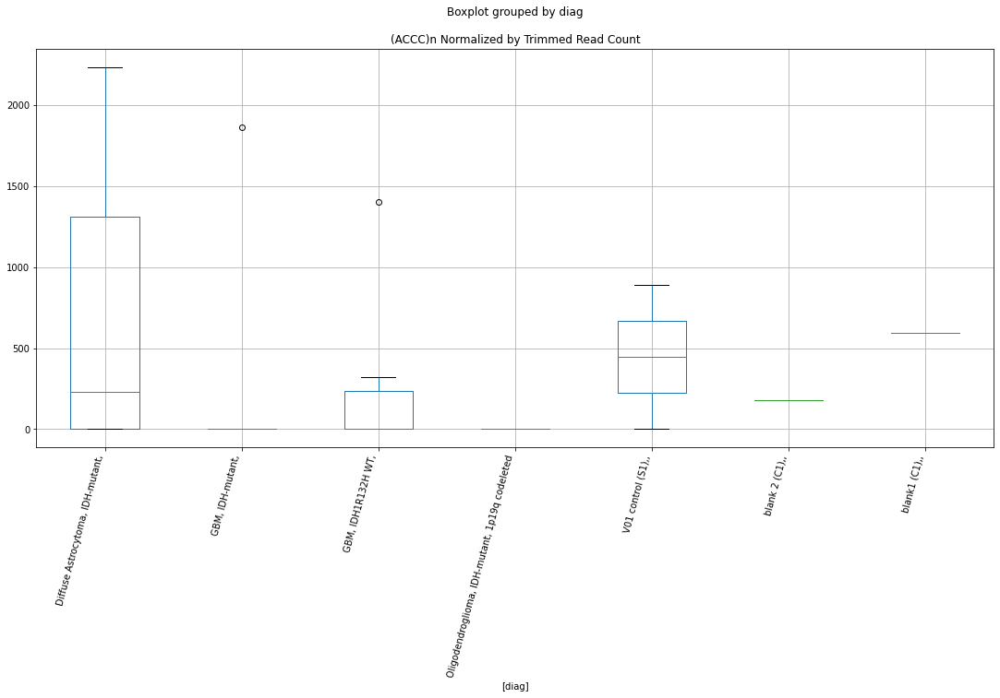

 p : 0.022382274951580402  ( t : 2.4984011586257506 ) :  D-plex  :  bbduk2  :  LTR28B
Control and blanks
73     773.01
337      0.00
Name: LTR28B, dtype: float64
205    11103.64
Name: LTR28B, dtype: float64
469    10055.96
Name: LTR28B, dtype: float64


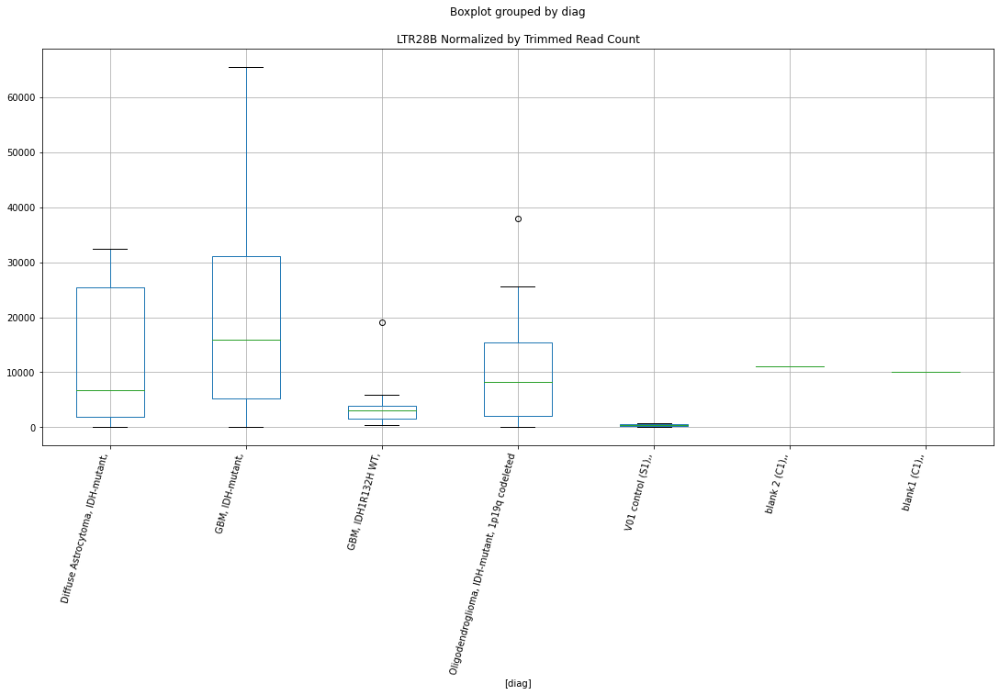

 p : 0.022397841199797184  ( t : 2.4980666223005032 ) :  D-plex  :  bbduk2  :  MER76-int
Control and blanks
73     40969.45
337        0.00
Name: MER76-int, dtype: float64
205    5910.0
Name: MER76-int, dtype: float64
469    5915.27
Name: MER76-int, dtype: float64


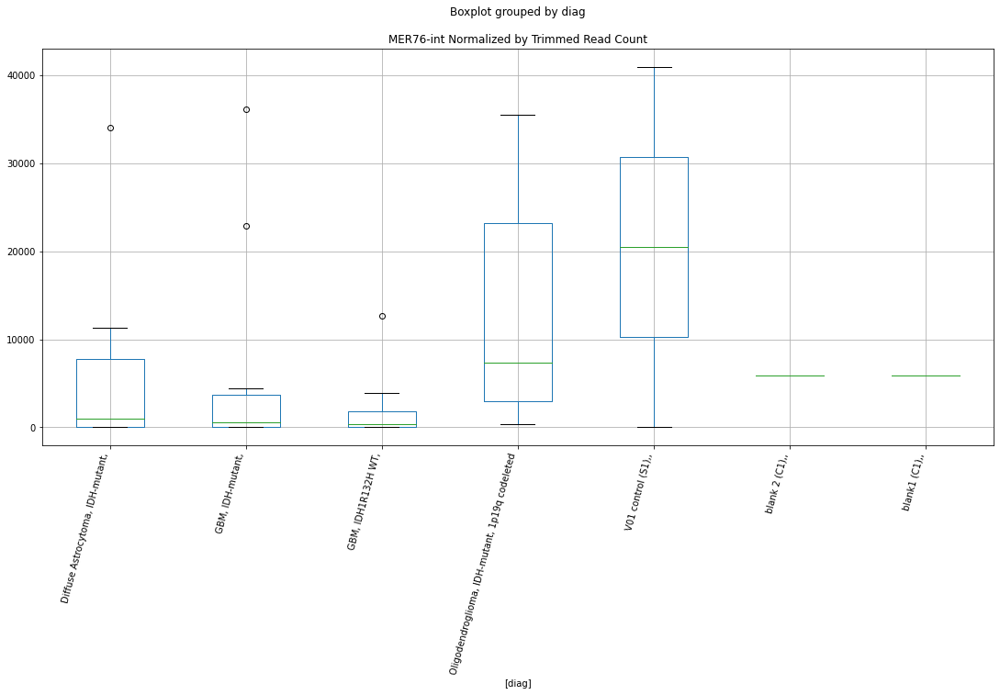

 p : 0.02244266864056675  ( t : 2.4971044520876307 ) :  D-plex  :  bbduk2  :  MER41C
Control and blanks
73      4638.05
337    28485.03
Name: MER41C, dtype: float64
205    11282.73
Name: MER41C, dtype: float64
469    13013.6
Name: MER41C, dtype: float64


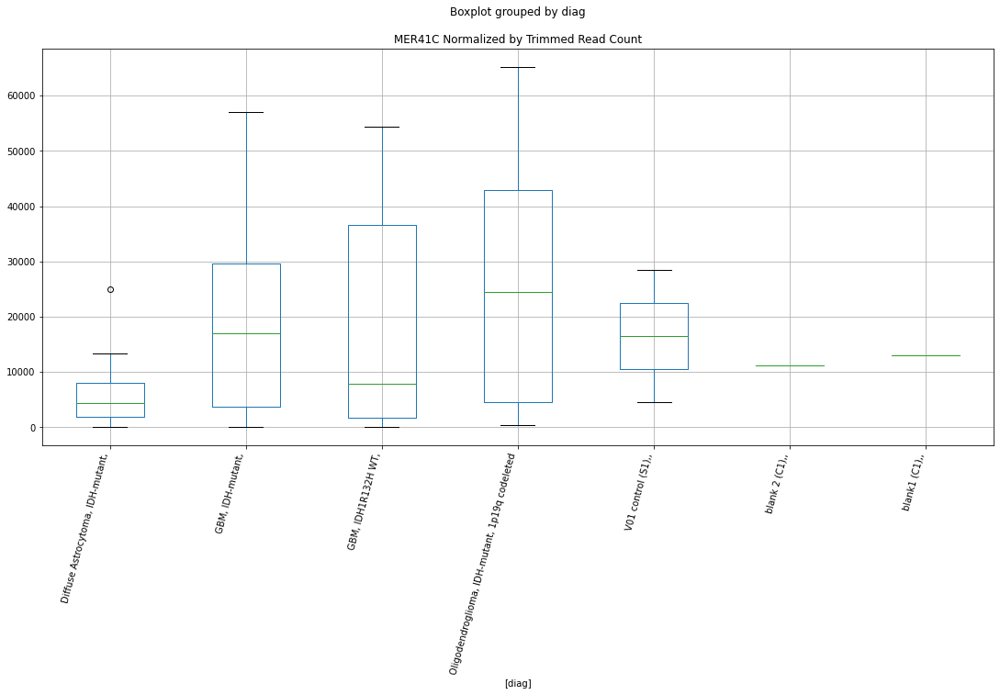

 p : 0.02247329588789125  ( t : 2.496448113528871 ) :  D-plex  :  bbduk2  :  LTR29
Control and blanks
73      1546.02
337    36496.45
Name: LTR29, dtype: float64
205    11282.73
Name: LTR29, dtype: float64
469    5323.75
Name: LTR29, dtype: float64


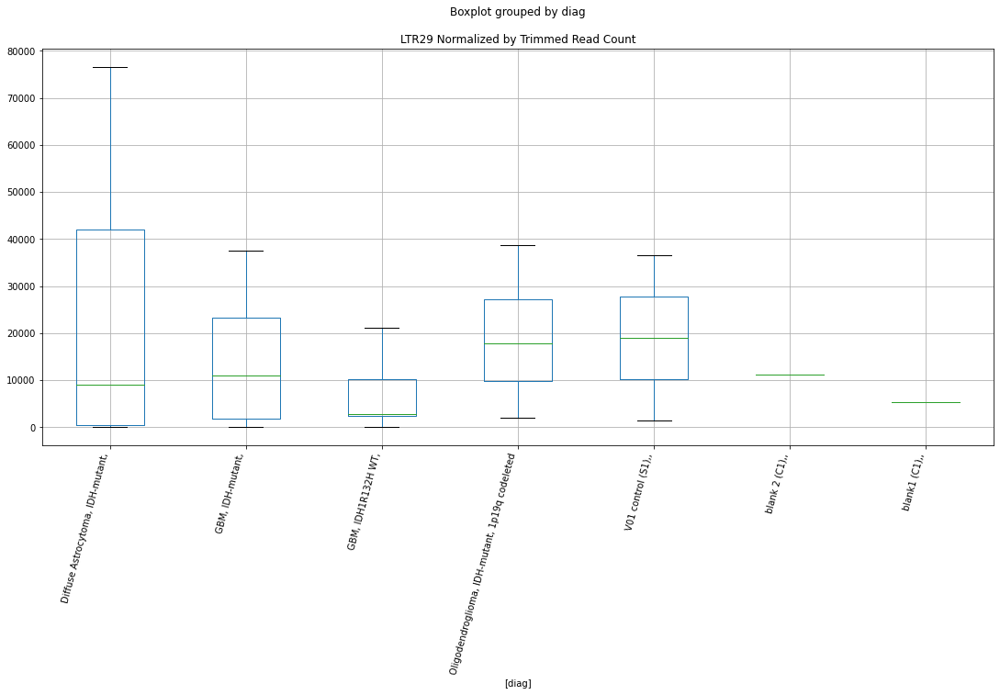

 p : 0.022710278833336286  ( t : 2.4913978917918436 ) :  D-plex  :  cutadapt2  :  MLT1E
Control and blanks
76     33335.03
340    14091.71
Name: MLT1E, dtype: float64
208    11463.41
Name: MLT1E, dtype: float64
472    15604.81
Name: MLT1E, dtype: float64


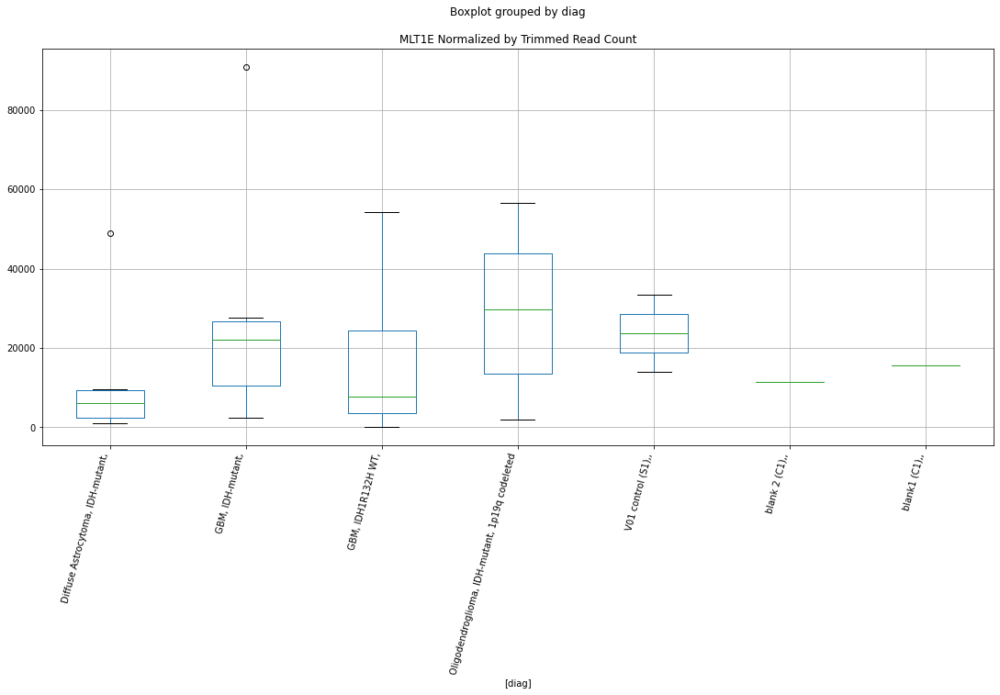

 p : 0.02283083387291515  ( t : 2.488847821119609 ) :  D-plex  :  cutadapt2  :  MamTip3
Control and blanks
76     18940.36
340    14972.45
Name: MamTip3, dtype: float64
208    15519.7
Name: MamTip3, dtype: float64
472    17916.63
Name: MamTip3, dtype: float64


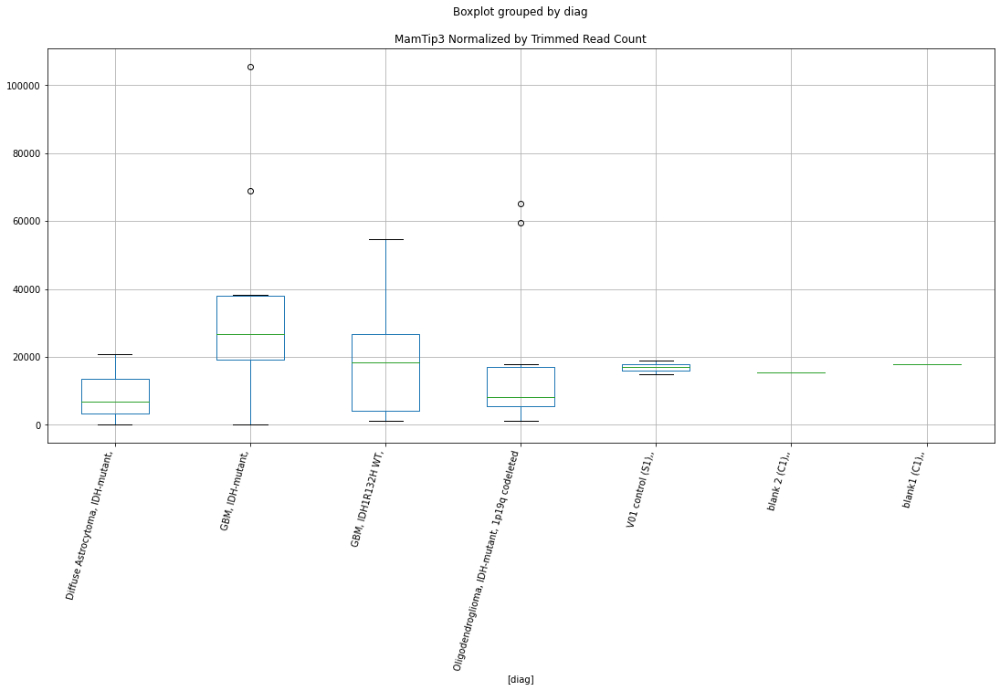

 p : 0.022841599430433138  ( t : 2.488620717026642 ) :  D-plex  :  bbduk2  :  MER11B
Control and blanks
73     27828.30
337    55189.75
Name: MER11B, dtype: float64
205    19879.1
Name: MER11B, dtype: float64
469    17745.82
Name: MER11B, dtype: float64


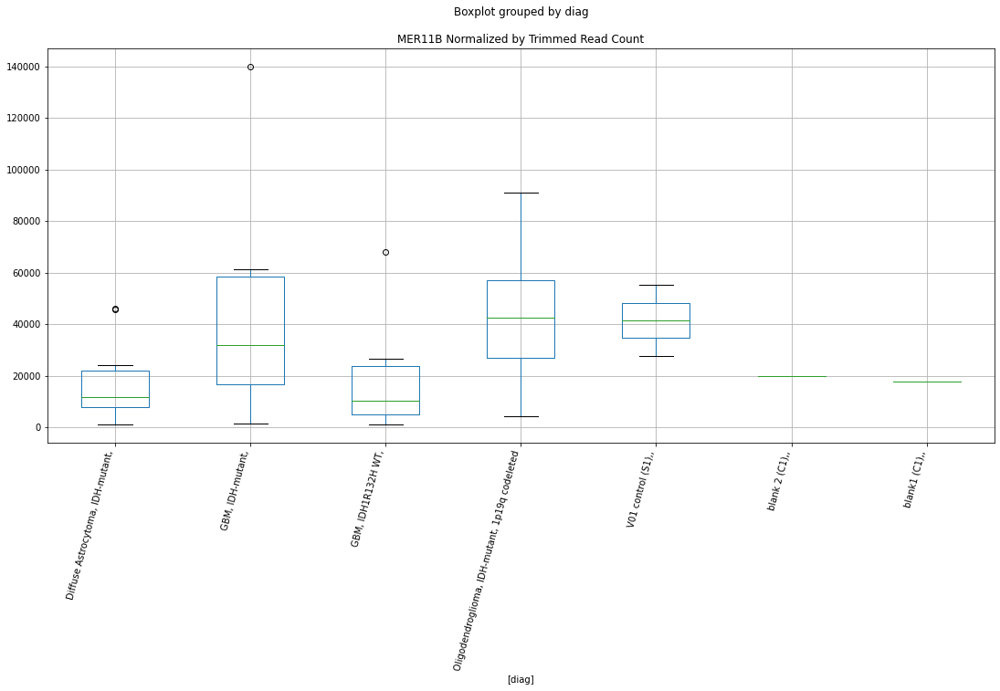

 p : 0.022905770882714536  ( t : 2.487269079576076 ) :  D-plex  :  bbduk2  :  LTR12_
Control and blanks
73      3092.03
337    12462.20
Name: LTR12_, dtype: float64
205    13073.64
Name: LTR12_, dtype: float64
469    8872.91
Name: LTR12_, dtype: float64


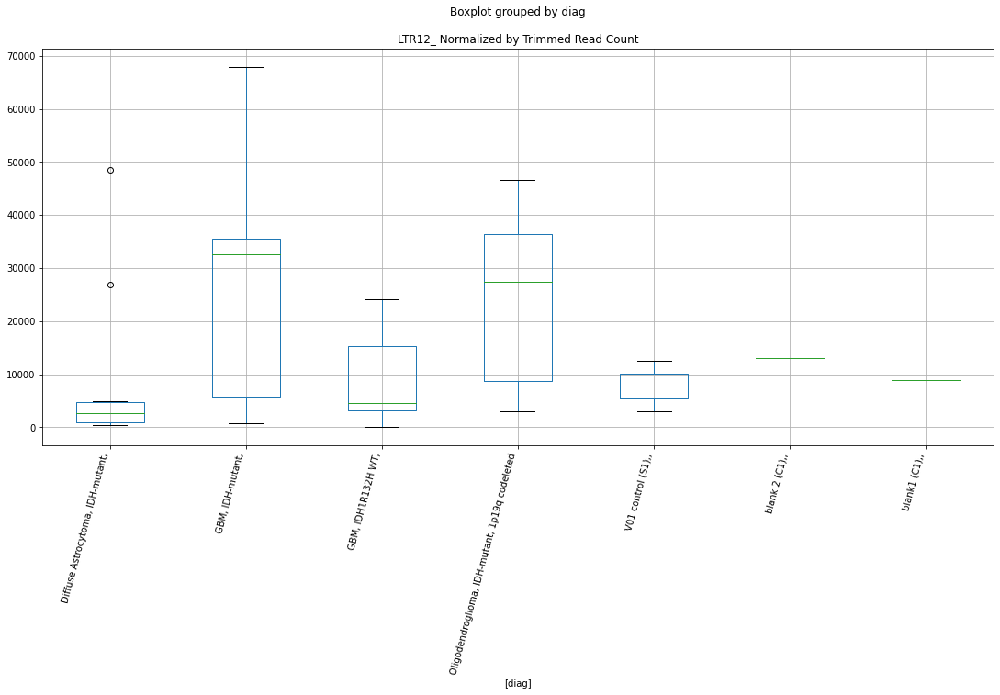

 p : 0.022930560887104597  ( t : 2.4867478843826207 ) :  D-plex  :  bbduk2  :  LTR48
Control and blanks
73      3865.04
337    23144.09
Name: LTR48, dtype: float64
205    20416.37
Name: LTR48, dtype: float64
469    20703.46
Name: LTR48, dtype: float64


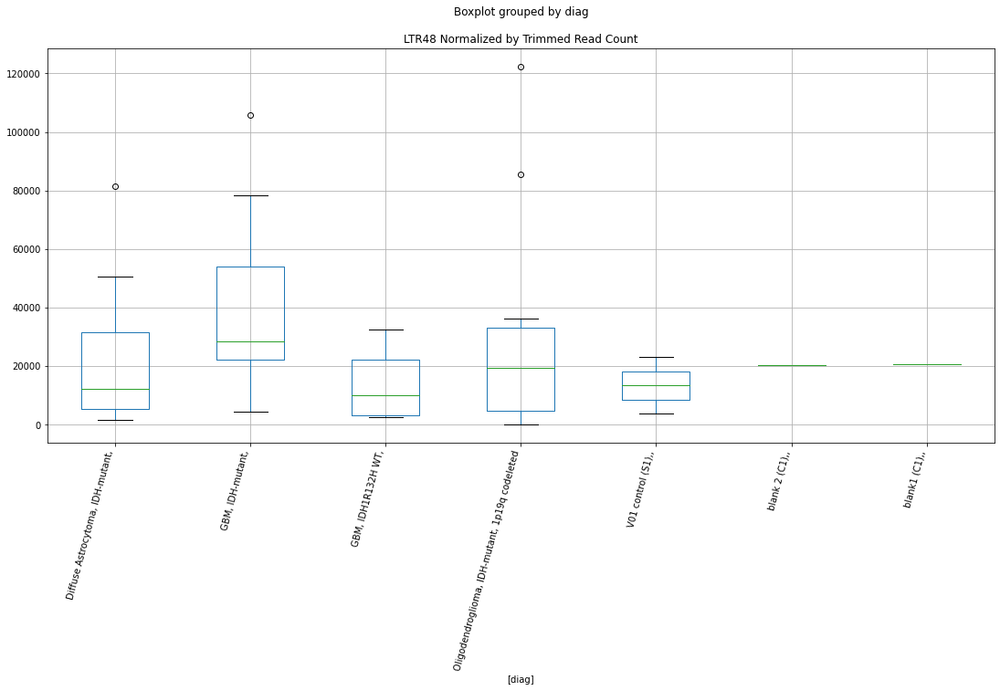

 p : 0.02301245727613222  ( t : 2.4850298238711113 ) :  D-plex  :  bbduk2  :  L1M3d
Control and blanks
73      2319.03
337    97027.14
Name: L1M3d, dtype: float64
205    23281.82
Name: L1M3d, dtype: float64
469    15971.24
Name: L1M3d, dtype: float64


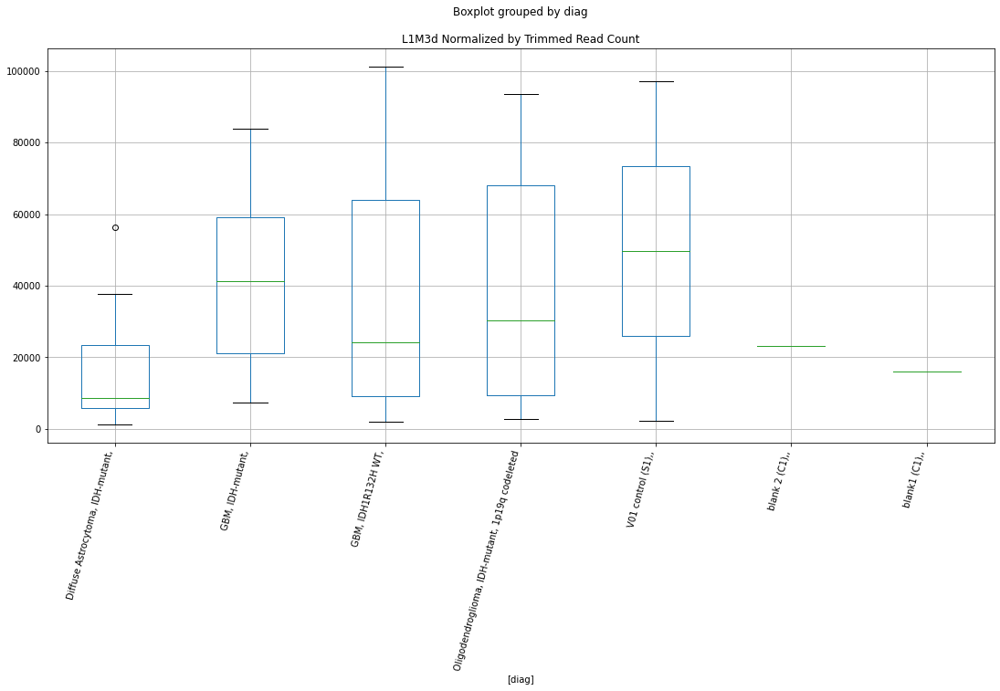

 p : 0.023040367777579243  ( t : 2.484445619148775 ) :  Lexogen  :  bbduk2  :  HY3
Control and blanks
79          0.00
343    201486.29
Name: HY3, dtype: float64
211    0.0
Name: HY3, dtype: float64
475    0.0
Name: HY3, dtype: float64


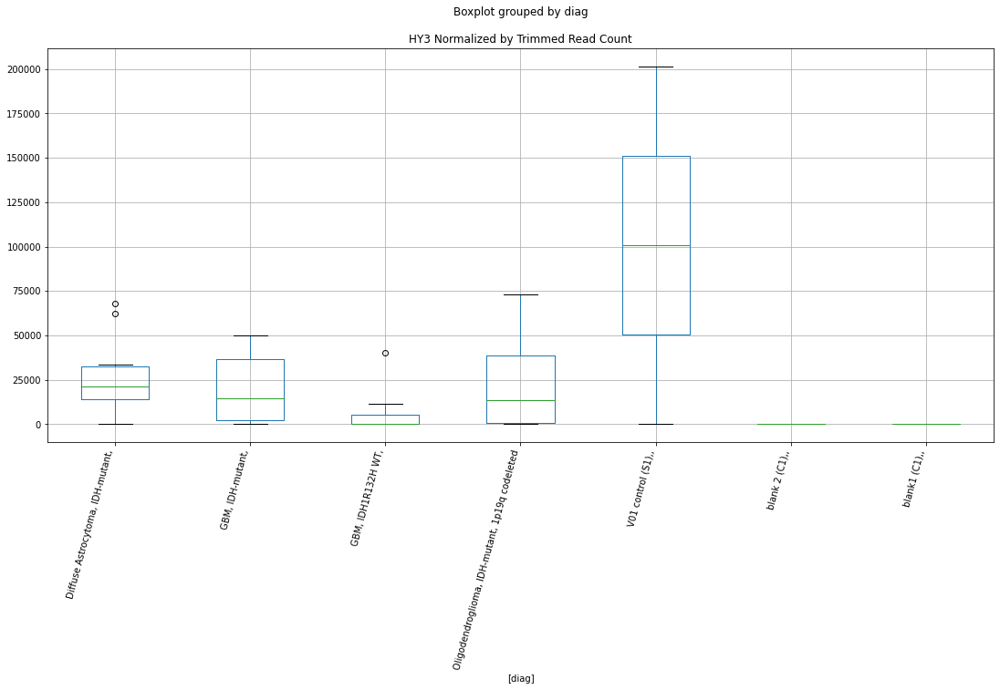

 p : 0.023044174295206582  ( t : 2.4843659951861925 ) :  D-plex  :  cutadapt2  :  MLT1G3-int
Control and blanks
76     2272.84
340    8807.32
Name: MLT1G3-int, dtype: float64
208    5643.53
Name: MLT1G3-int, dtype: float64
472    7513.43
Name: MLT1G3-int, dtype: float64


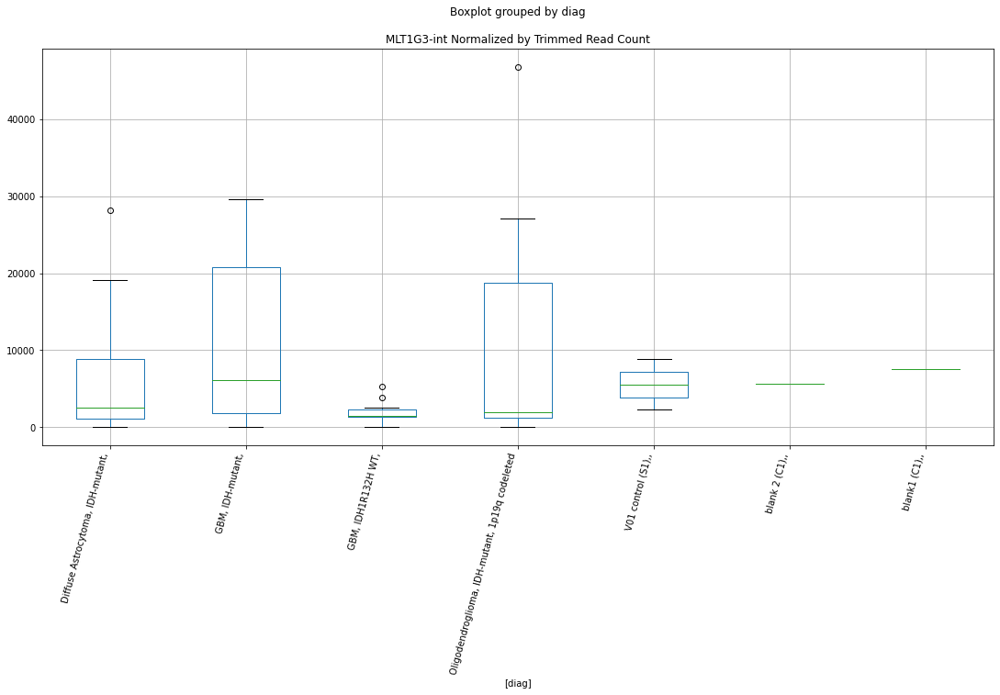

 p : 0.023154773690635507  ( t : 2.482057887985127 ) :  Lexogen  :  cutadapt2  :  HY3
Control and blanks
82          0.00
346    201596.27
Name: HY3, dtype: float64
214    0.0
Name: HY3, dtype: float64
478    0.0
Name: HY3, dtype: float64


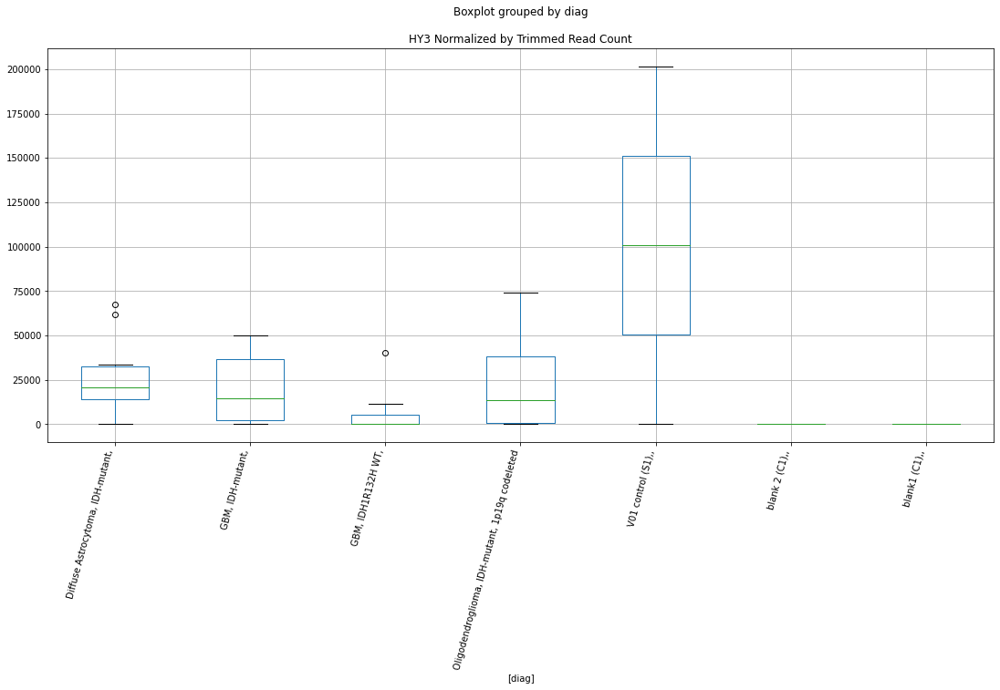

 p : 0.02334882776175154  ( t : 2.478033115389757 ) :  D-plex  :  bbduk2  :  (TTCCA)n
Control and blanks
73     76527.83
337    81894.47
Name: (TTCCA)n, dtype: float64
205    75934.56
Name: (TTCCA)n, dtype: float64
469    72166.33
Name: (TTCCA)n, dtype: float64


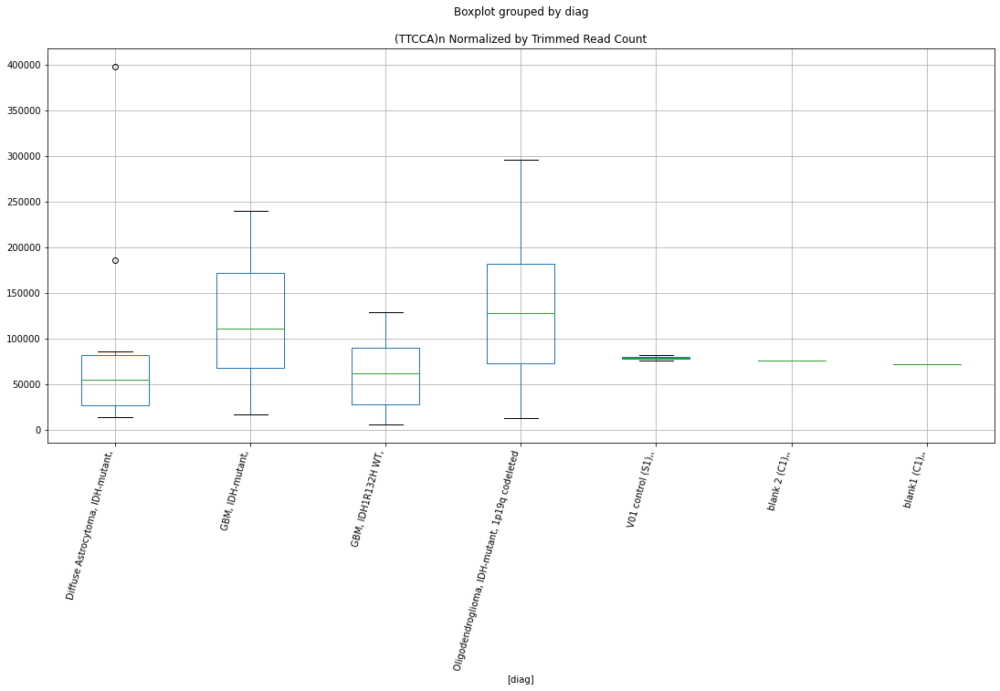

 p : 0.02344463845680223  ( t : 2.476057547925928 ) :  D-plex  :  cutadapt2  :  Arthur1B
Control and blanks
76      6818.53
340    36990.75
Name: Arthur1B, dtype: float64
208    39504.69
Name: Arthur1B, dtype: float64
472    35255.31
Name: Arthur1B, dtype: float64


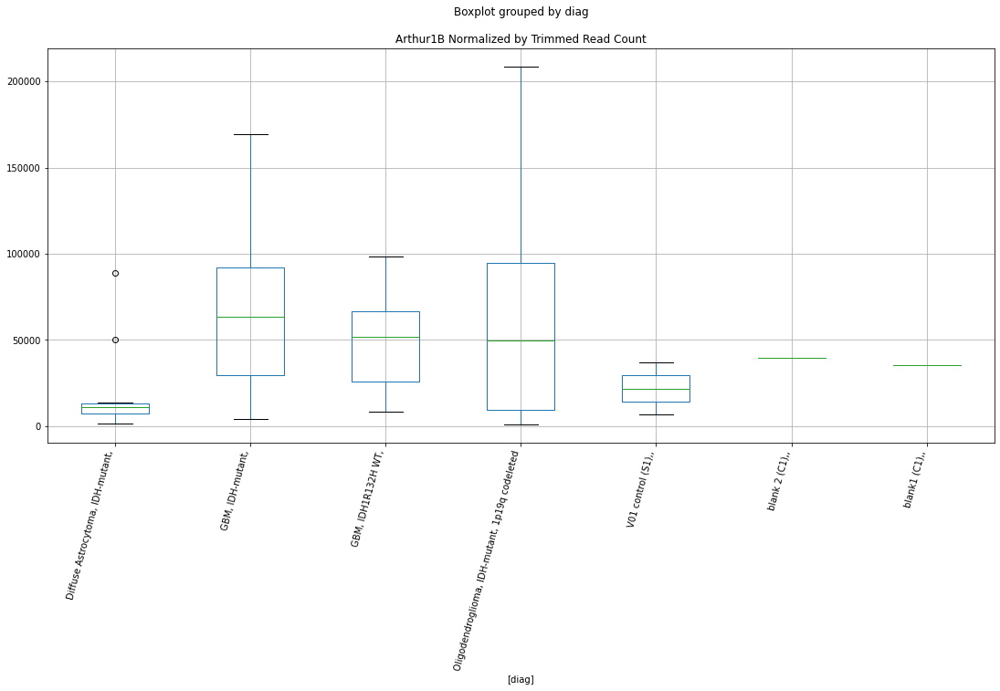

 p : 0.023507636374157058  ( t : 2.4747626973985337 ) :  D-plex  :  bbduk2  :  LTR1A2
Control and blanks
73     24736.27
337        0.00
Name: LTR1A2, dtype: float64
205    23460.91
Name: LTR1A2, dtype: float64
469    24252.62
Name: LTR1A2, dtype: float64


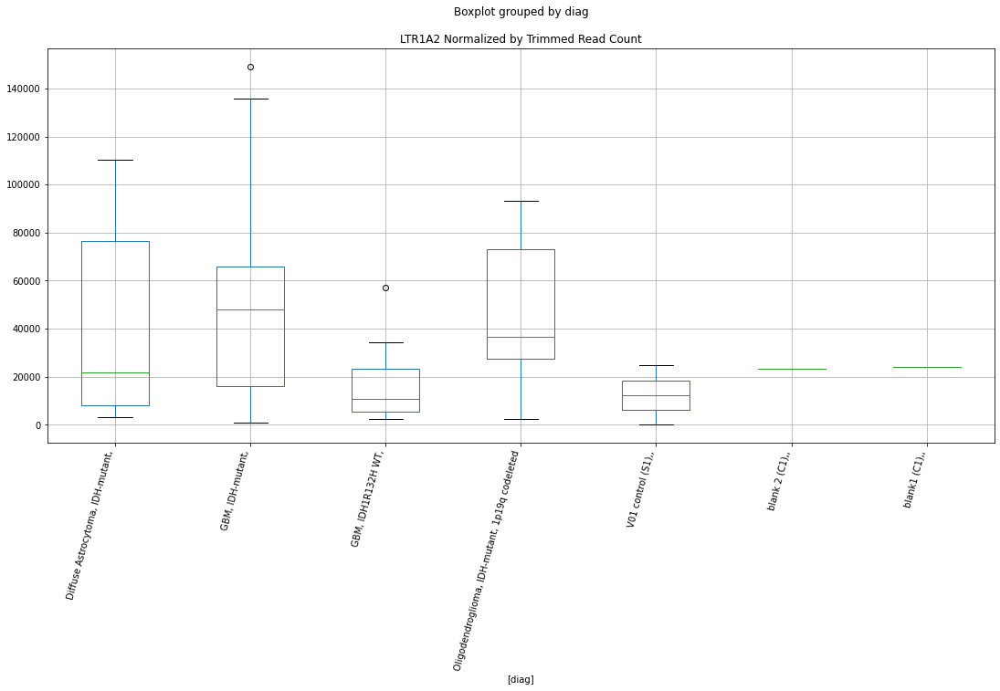

 p : 0.023636464519307298  ( t : 2.4721249114754857 ) :  D-plex  :  bbduk2  :  MLT1G3-int
Control and blanks
73     2319.03
337    8901.57
Name: MLT1G3-int, dtype: float64
205    5730.91
Name: MLT1G3-int, dtype: float64
469    8281.38
Name: MLT1G3-int, dtype: float64


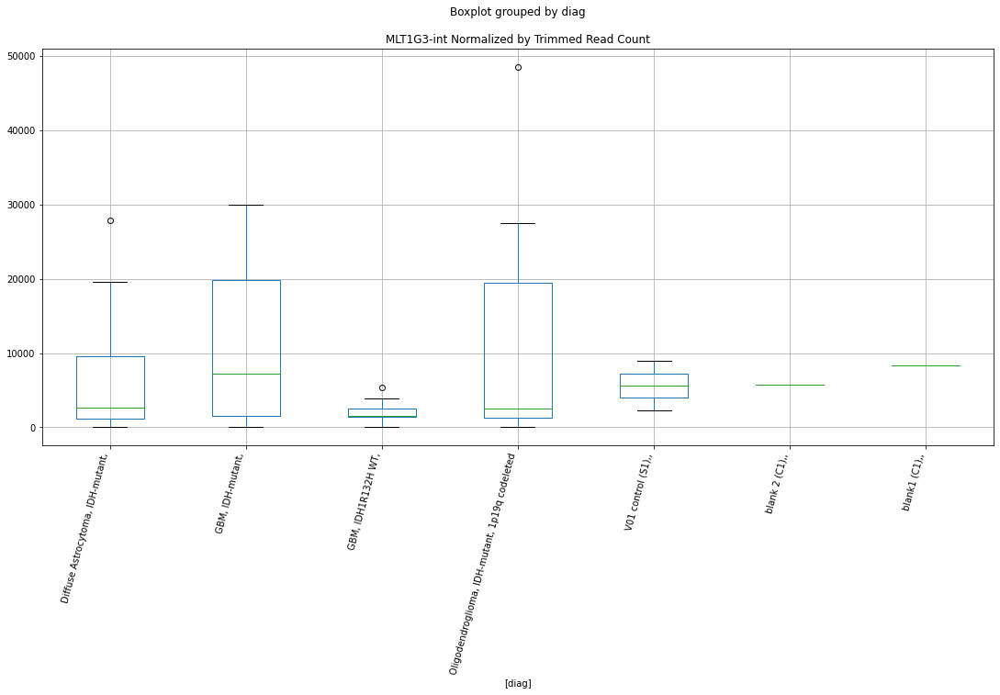

 p : 0.023719959894957916  ( t : 2.4704225357168306 ) :  D-plex  :  bbduk2  :  LTR101_Mam
Control and blanks
73     23190.25
337    39166.92
Name: LTR101_Mam, dtype: float64
205    24893.64
Name: LTR101_Mam, dtype: float64
469    26618.73
Name: LTR101_Mam, dtype: float64


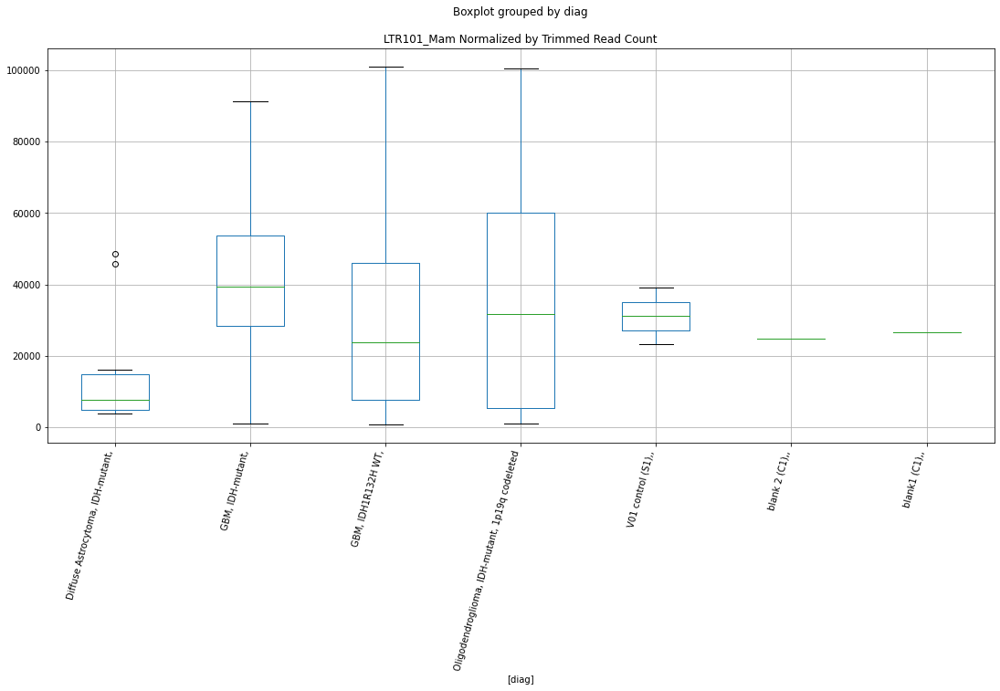

 p : 0.024024377619235517  ( t : 2.464263155499255 ) :  D-plex  :  bbduk2  :  MER51A
Control and blanks
73      7730.08
337    38276.76
Name: MER51A, dtype: float64
205    18446.37
Name: MER51A, dtype: float64
469    18337.35
Name: MER51A, dtype: float64


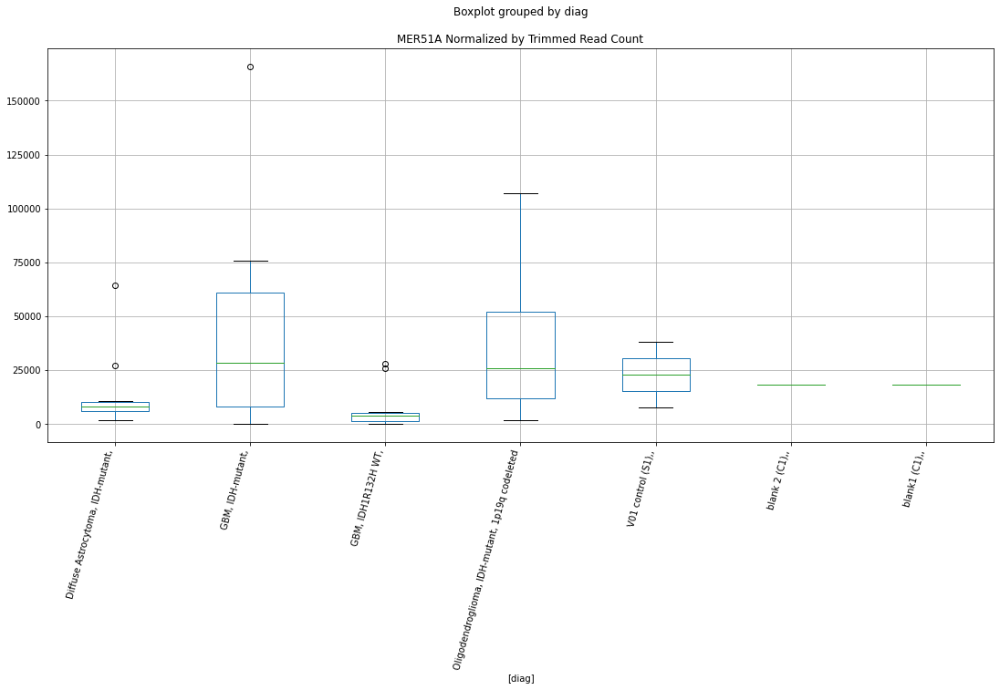

 p : 0.024028451775253836  ( t : 2.4641812203507585 ) :  D-plex  :  cutadapt2  :  (CCTTT)n
Control and blanks
76     0.0
340    0.0
Name: (CCTTT)n, dtype: float64
208    1058.16
Name: (CCTTT)n, dtype: float64
472    1155.91
Name: (CCTTT)n, dtype: float64


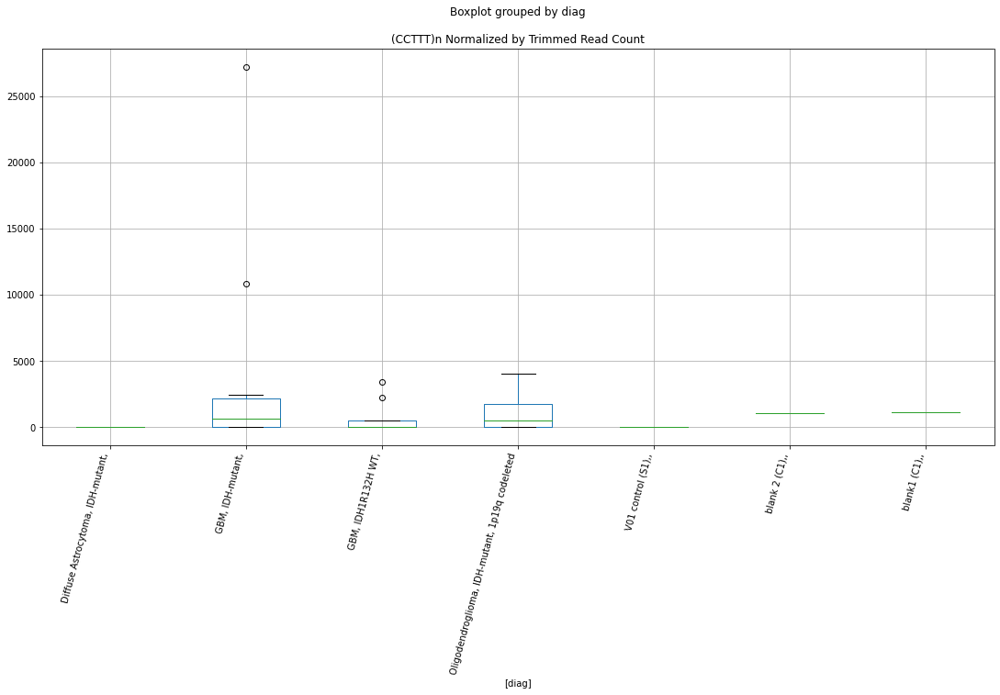

 p : 0.02410351673597436  ( t : 2.4626739243055424 ) :  D-plex  :  cutadapt2  :  (TCT)n
Control and blanks
76      1515.23
340    30825.62
Name: (TCT)n, dtype: float64
208    10228.89
Name: (TCT)n, dtype: float64
472    8091.38
Name: (TCT)n, dtype: float64


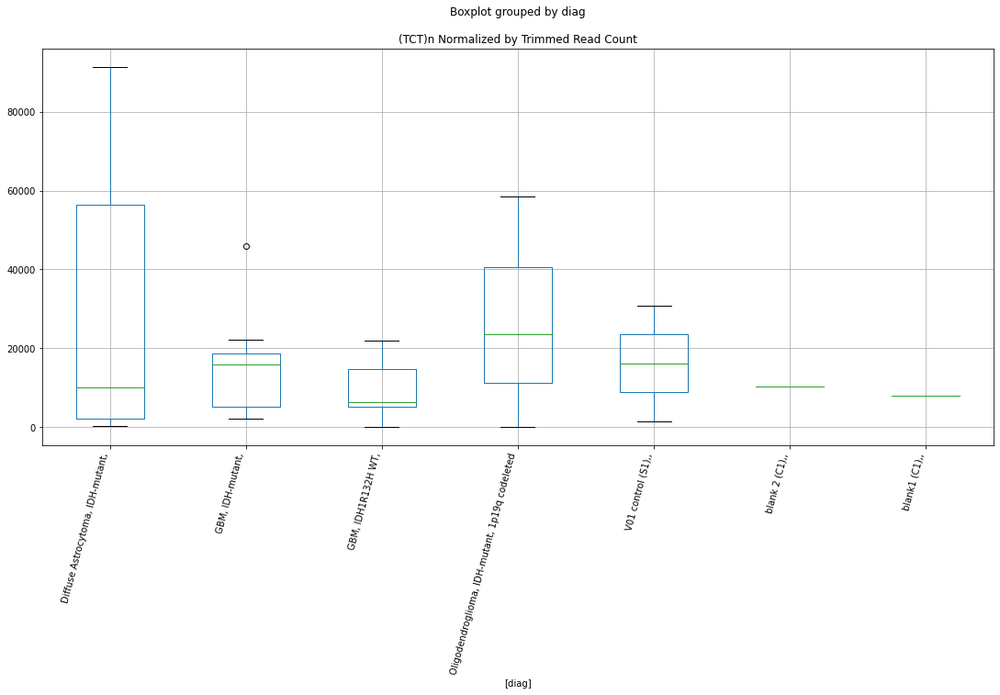

 p : 0.024281532097119675  ( t : 2.459116954686146 ) :  D-plex  :  cutadapt2  :  MER51A
Control and blanks
76      7576.14
340    37871.48
Name: MER51A, dtype: float64
208    19046.9
Name: MER51A, dtype: float64
472    17916.63
Name: MER51A, dtype: float64


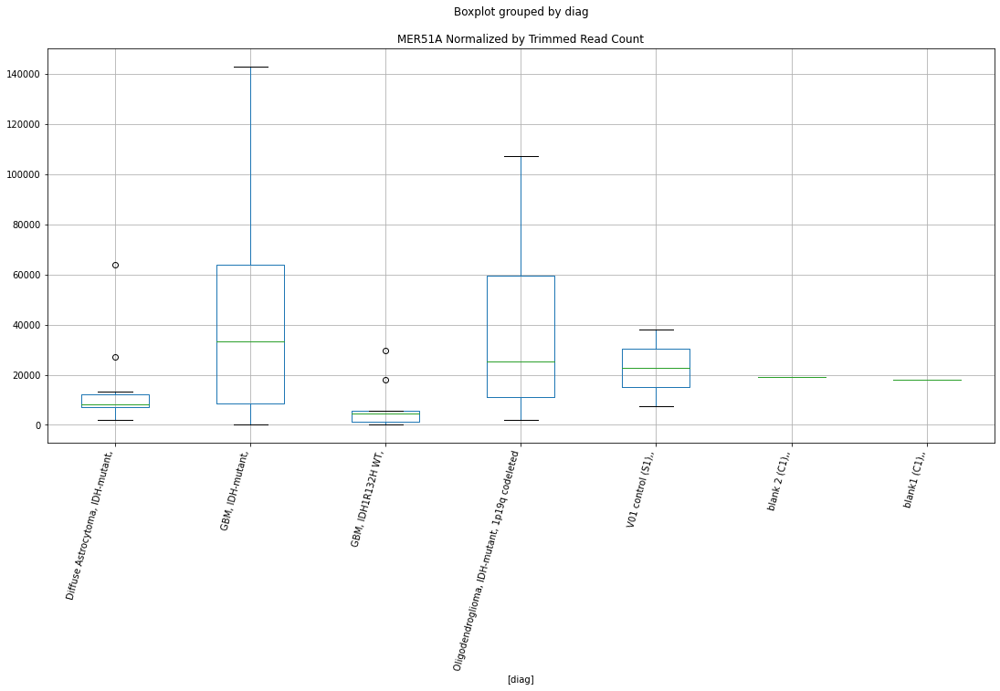

 p : 0.024295228922439353  ( t : 2.458844290983021 ) :  D-plex  :  bbduk2  :  Tigger2a
Control and blanks
73     78846.86
337    64091.32
Name: Tigger2a, dtype: float64
205    66263.65
Name: Tigger2a, dtype: float64
469    84588.41
Name: Tigger2a, dtype: float64


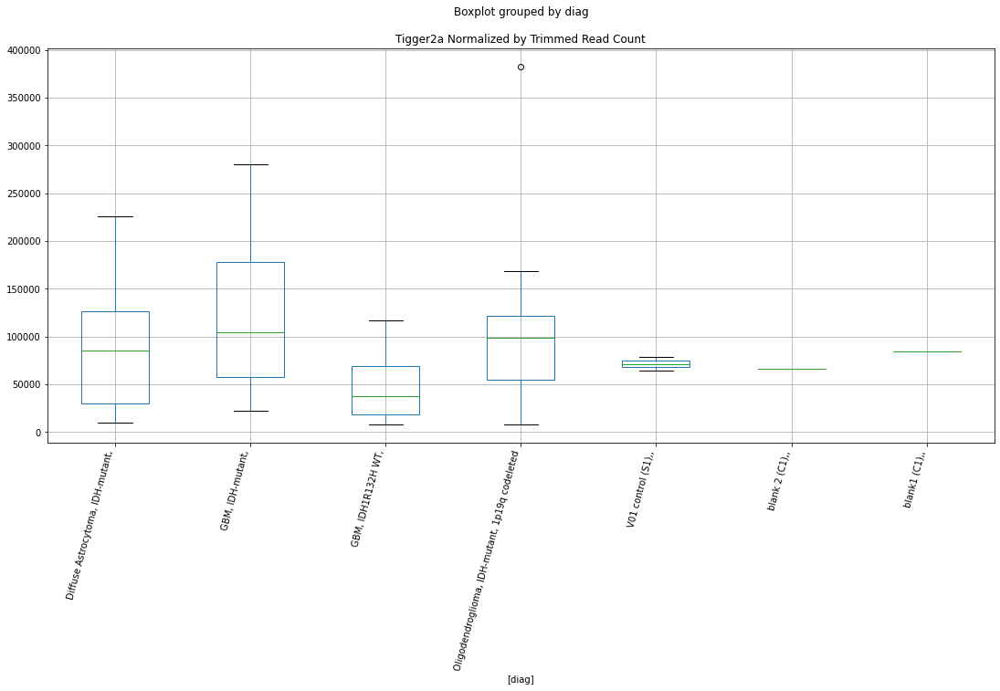

 p : 0.024422081382030912  ( t : 2.45632586885002 ) :  D-plex  :  cutadapt2  :  Charlie30a
Control and blanks
76      757.61
340    3522.93
Name: Charlie30a, dtype: float64
208    7230.77
Name: Charlie30a, dtype: float64
472    4623.65
Name: Charlie30a, dtype: float64


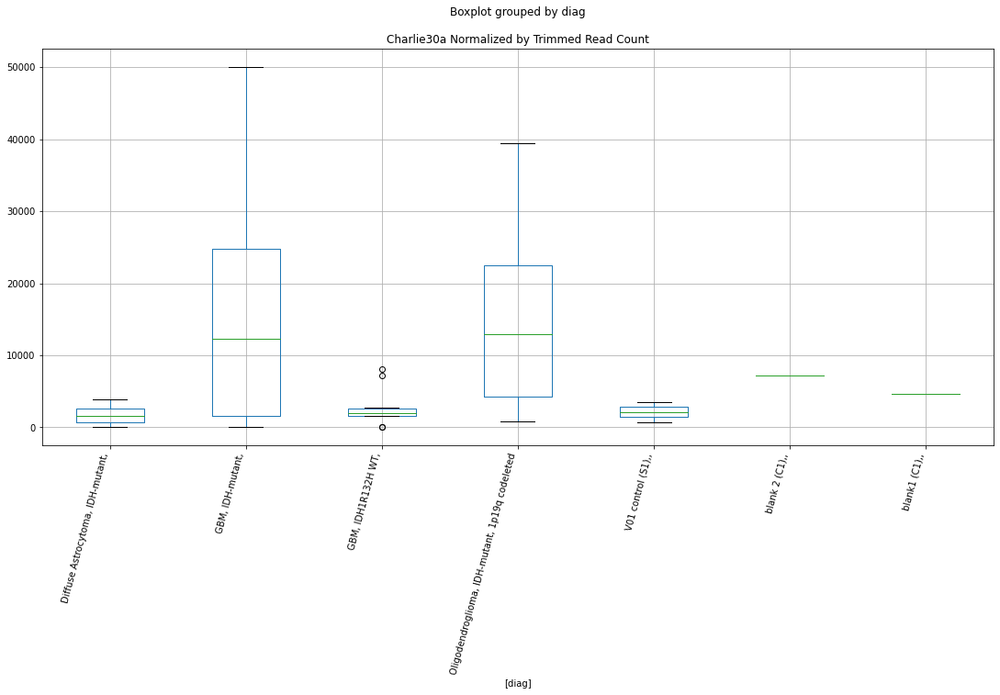

 p : 0.024431910796982512  ( t : 2.4561312371694224 ) :  D-plex  :  bbduk2  :  Charlie18a
Control and blanks
73      6957.08
337    24034.25
Name: Charlie18a, dtype: float64
205    22923.64
Name: Charlie18a, dtype: float64
469    18928.87
Name: Charlie18a, dtype: float64


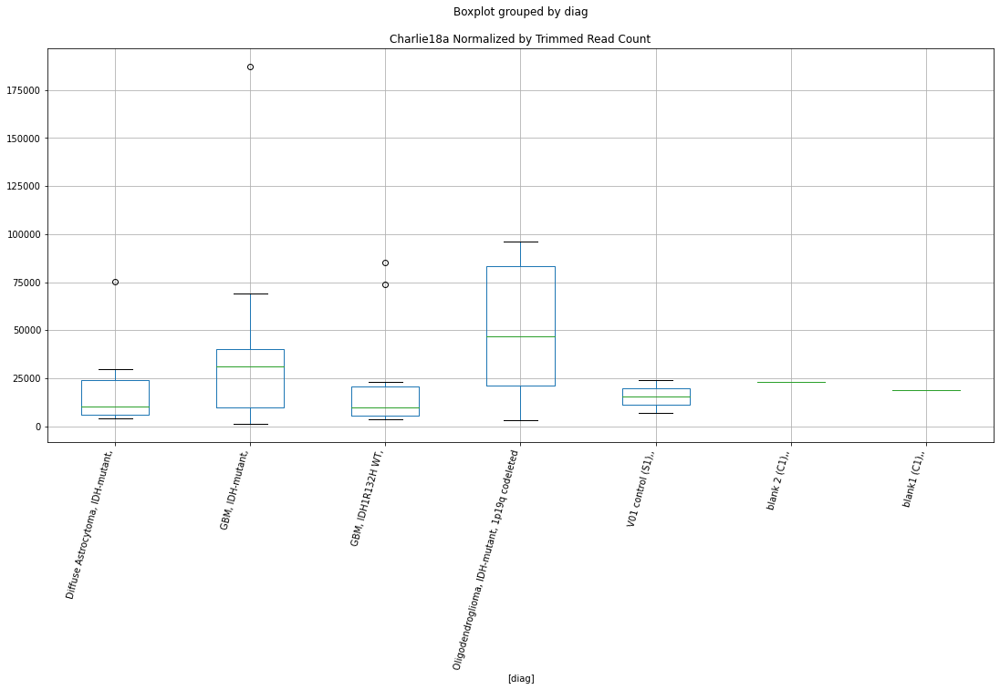

 p : 0.02444312929629347  ( t : 2.4559091901575703 ) :  Lexogen  :  cutadapt2  :  (CTCTC)n
Control and blanks
82       0.00
346    210.43
Name: (CTCTC)n, dtype: float64
214    0.0
Name: (CTCTC)n, dtype: float64
478    0.0
Name: (CTCTC)n, dtype: float64


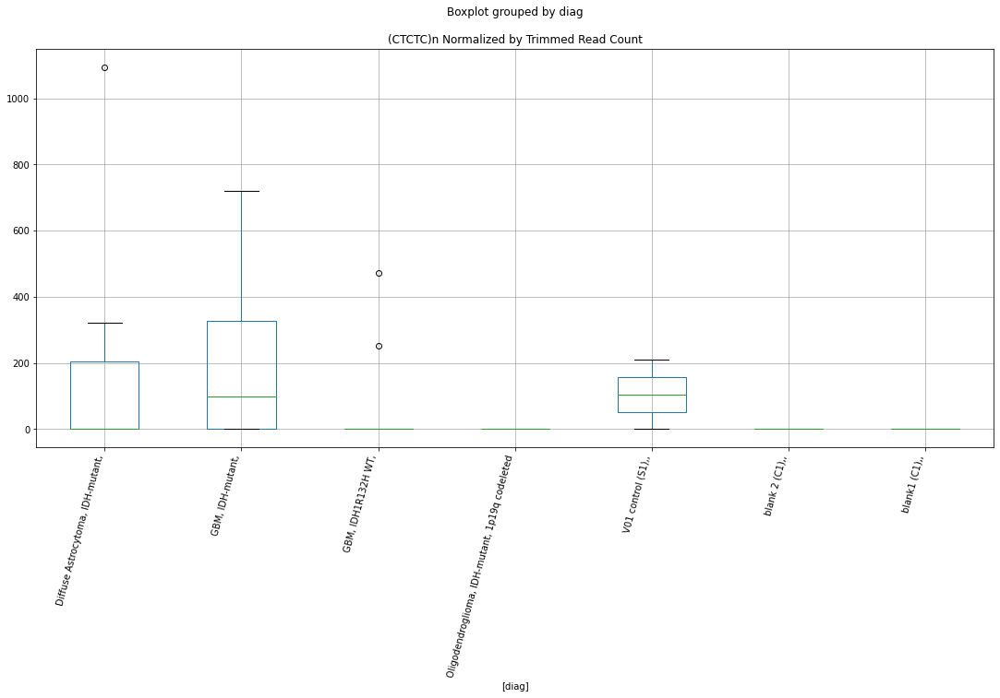

 p : 0.024486078200053513  ( t : 2.4550599890627107 ) :  D-plex  :  cutadapt2  :  CR1_Mam
Control and blanks
76     17425.13
340    29944.89
Name: CR1_Mam, dtype: float64
208    21692.31
Name: CR1_Mam, dtype: float64
472    26585.97
Name: CR1_Mam, dtype: float64


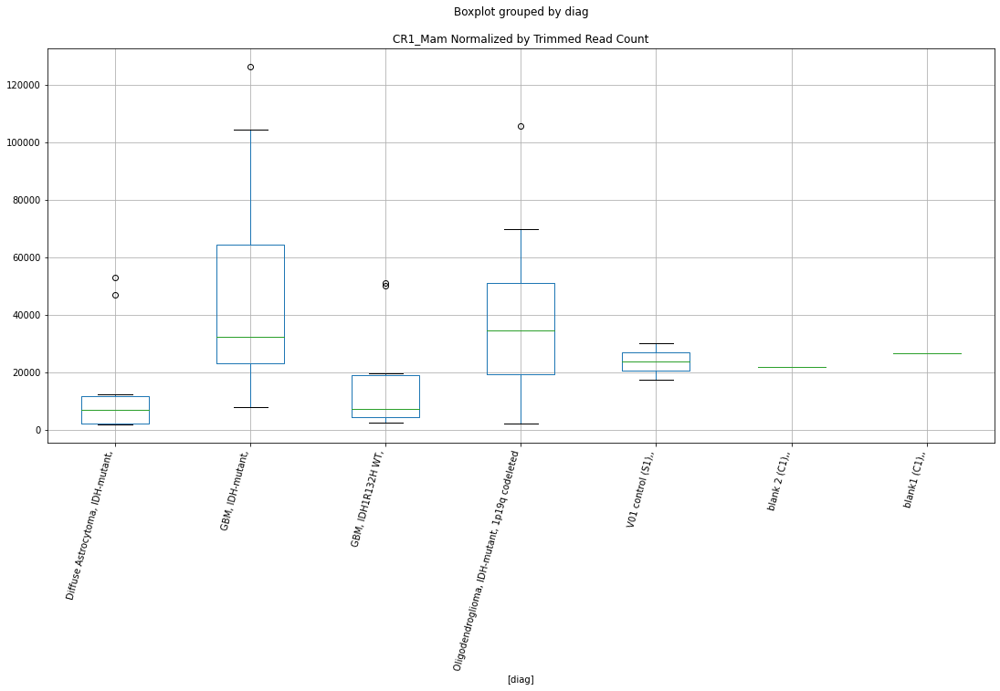

 p : 0.02454738280637357  ( t : 2.4538502726504863 ) :  D-plex  :  cutadapt2  :  (CAAGCCAGC)n
Control and blanks
76     0.0
340    0.0
Name: (CAAGCCAGC)n, dtype: float64
208    21692.31
Name: (CAAGCCAGC)n, dtype: float64
472    0.0
Name: (CAAGCCAGC)n, dtype: float64


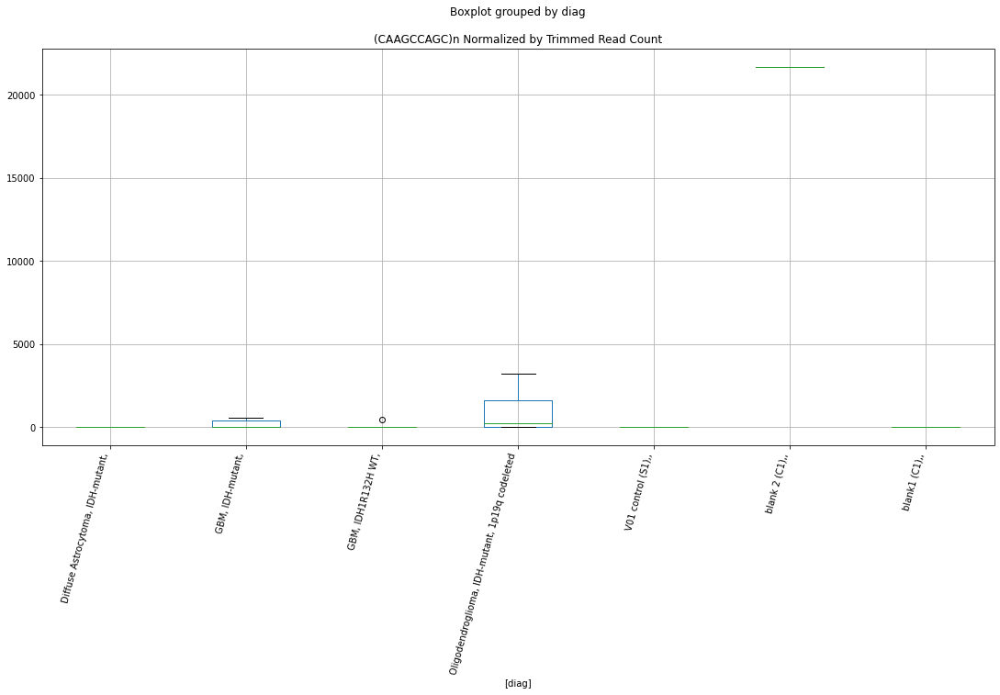

 p : 0.024559386094773733  ( t : 2.453613745377079 ) :  D-plex  :  bbduk2  :  MER54B
Control and blanks
73     0.0
337    0.0
Name: MER54B, dtype: float64
205    8059.09
Name: MER54B, dtype: float64
469    5915.27
Name: MER54B, dtype: float64


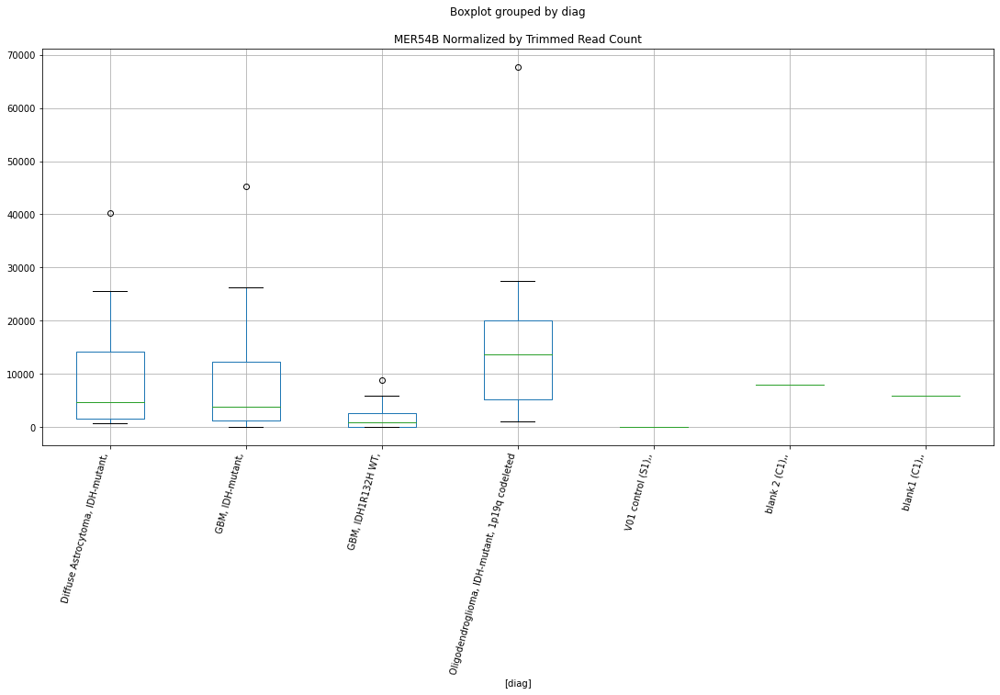

 p : 0.024578069836648987  ( t : 2.453245794292081 ) :  D-plex  :  cutadapt2  :  LTR88c
Control and blanks
76       757.61
340    30825.62
Name: LTR88c, dtype: float64
208    10405.25
Name: LTR88c, dtype: float64
472    11559.12
Name: LTR88c, dtype: float64


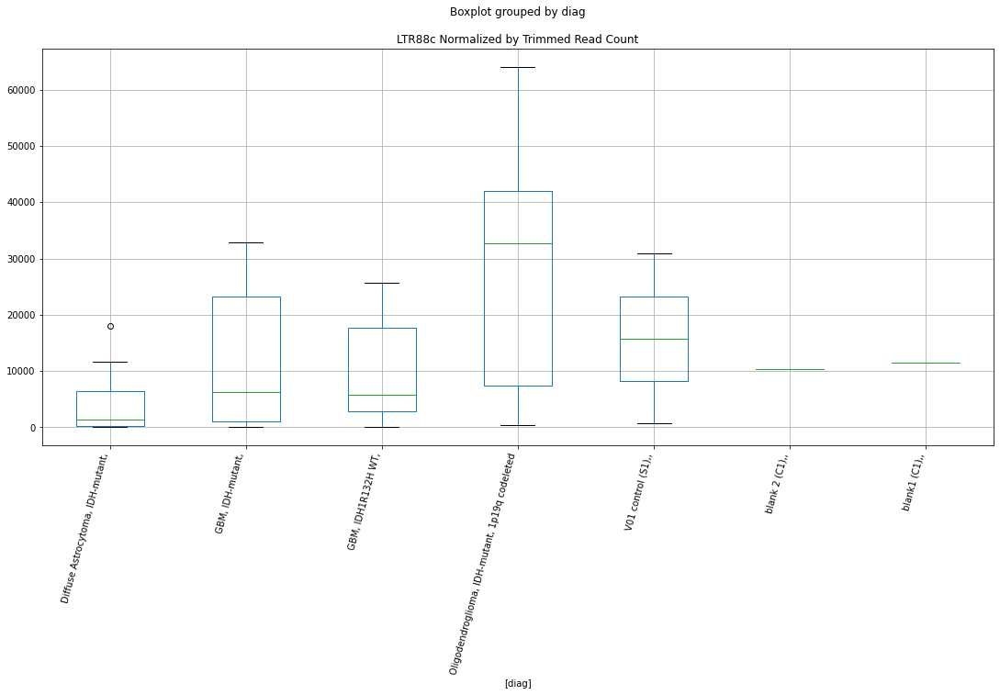

 p : 0.024580983702406245  ( t : 2.4531884333145855 ) :  D-plex  :  cutadapt2  :  LTR81B
Control and blanks
76      5303.30
340    53724.66
Name: LTR81B, dtype: float64
208    19399.62
Name: LTR81B, dtype: float64
472    21384.37
Name: LTR81B, dtype: float64


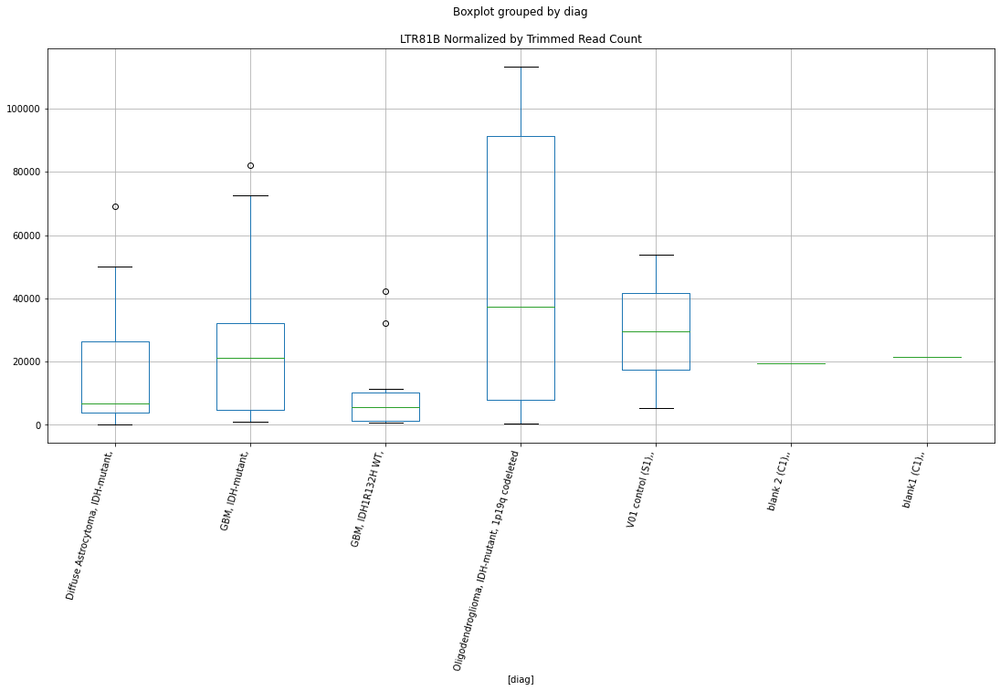

 p : 0.024606637258023374  ( t : 2.452683704970604 ) :  D-plex  :  bbduk2  :  LTR55
Control and blanks
73     5411.06
337       0.00
Name: LTR55, dtype: float64
205    8954.55
Name: LTR55, dtype: float64
469    5915.27
Name: LTR55, dtype: float64


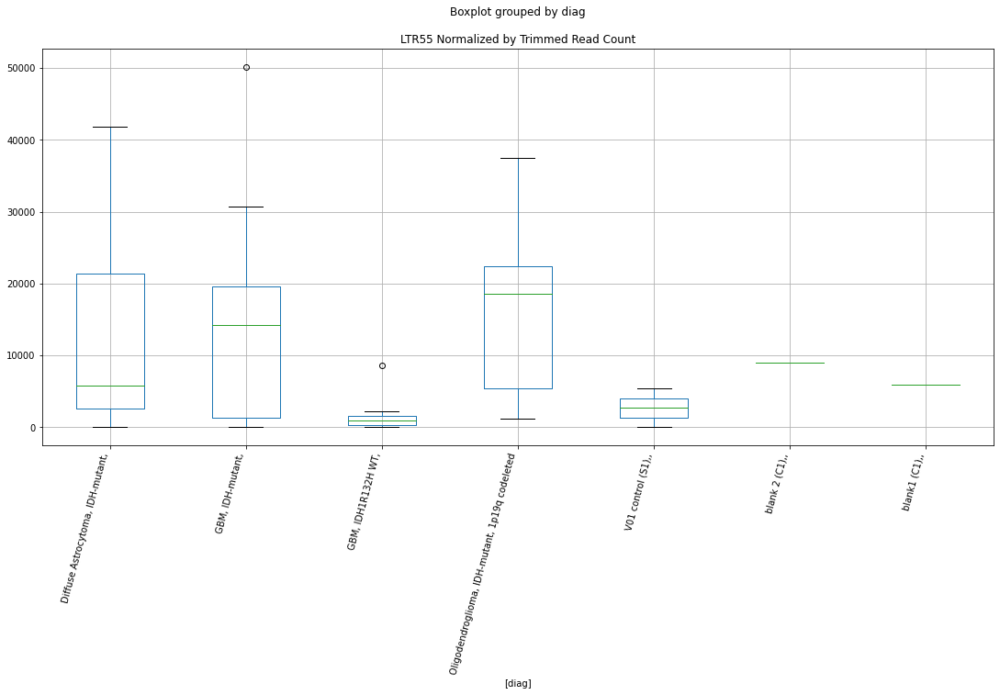

 p : 0.024742403669637657  ( t : 2.4500207277804096 ) :  D-plex  :  cutadapt2  :  (CACC)n
Control and blanks
76     757.61
340      0.00
Name: (CACC)n, dtype: float64
208    176.36
Name: (CACC)n, dtype: float64
472    577.96
Name: (CACC)n, dtype: float64


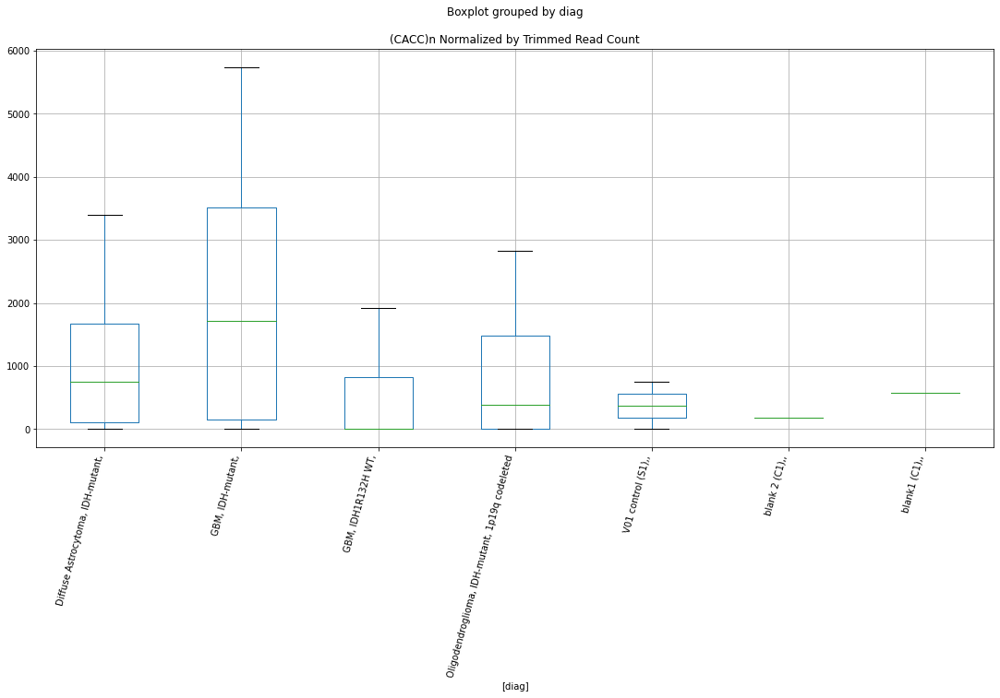

 p : 0.02492285682142984  ( t : 2.4465024006286407 ) :  D-plex  :  cutadapt2  :  (ATTTTT)n
Control and blanks
76     0.0
340    0.0
Name: (ATTTTT)n, dtype: float64
208    1587.24
Name: (ATTTTT)n, dtype: float64
472    2311.82
Name: (ATTTTT)n, dtype: float64


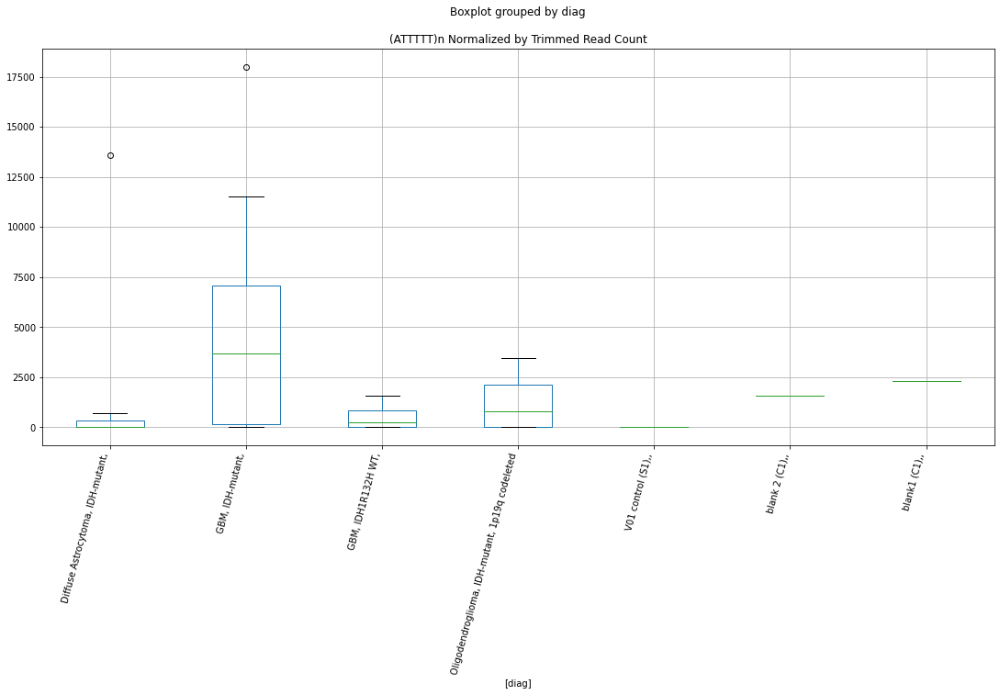

 p : 0.024961525616416257  ( t : 2.445751579882711 ) :  D-plex  :  bbduk2  :  (ATTAT)n
Control and blanks
73     773.01
337      0.00
Name: (ATTAT)n, dtype: float64
205    2865.46
Name: (ATTAT)n, dtype: float64
469    2957.64
Name: (ATTAT)n, dtype: float64


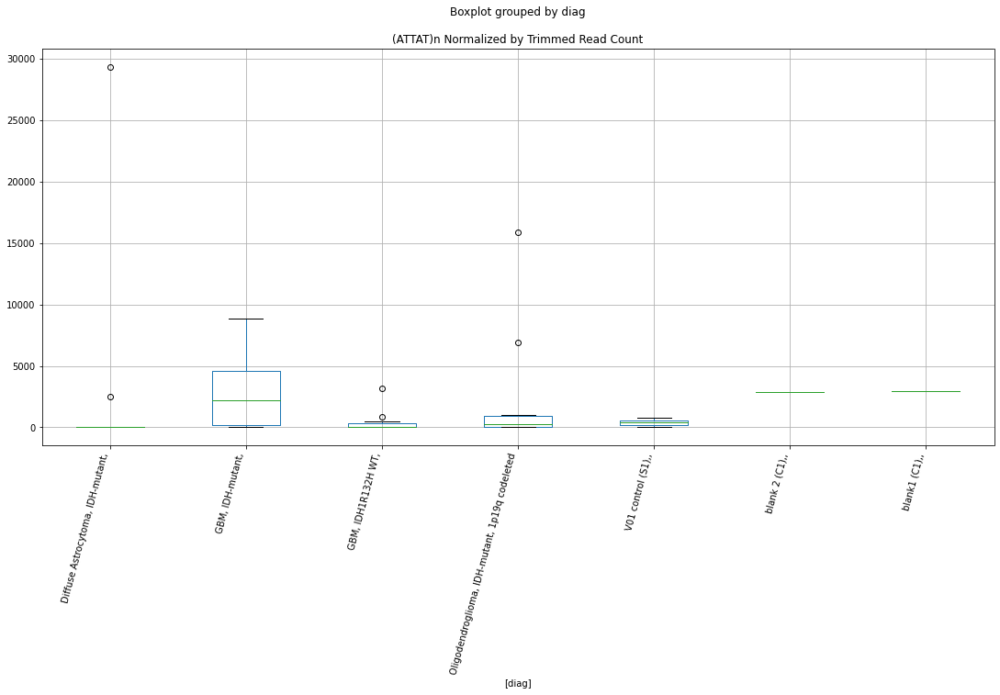

 p : 0.025227217218512895  ( t : 2.440622042565815 ) :  D-plex  :  cutadapt2  :  Arthur1
Control and blanks
76      6818.53
340    53724.66
Name: Arthur1, dtype: float64
208    45500.94
Name: Arthur1, dtype: float64
472    45080.56
Name: Arthur1, dtype: float64


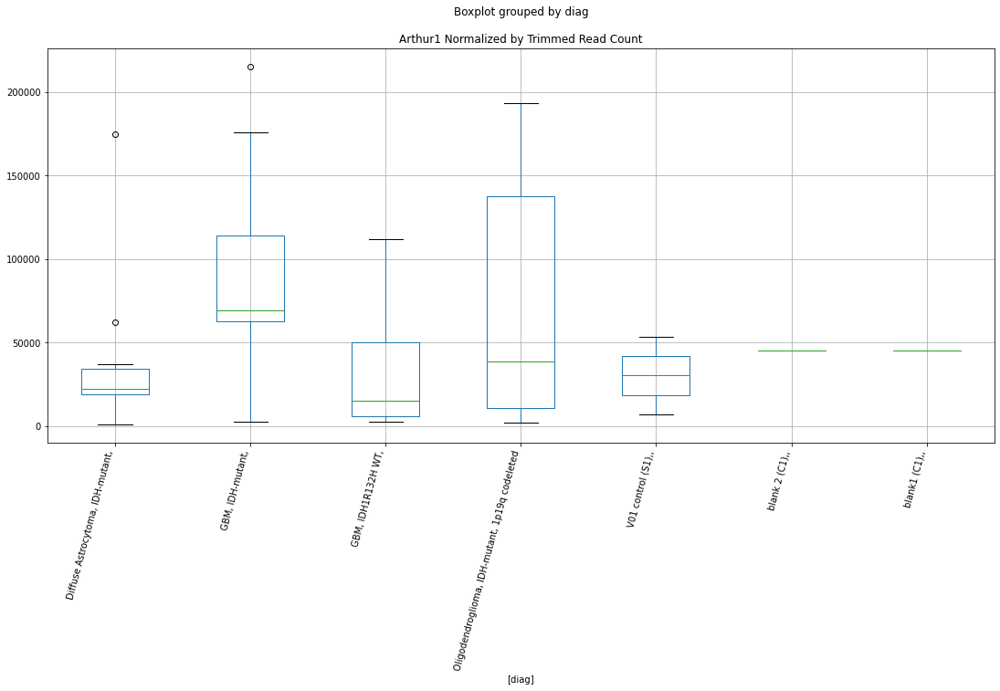

 p : 0.025277739058768147  ( t : 2.4396523883482595 ) :  D-plex  :  cutadapt2  :  (CCCTAA)n
Control and blanks
76     3788.07
340       0.00
Name: (CCCTAA)n, dtype: float64
208    2821.76
Name: (CCCTAA)n, dtype: float64
472    2889.78
Name: (CCCTAA)n, dtype: float64


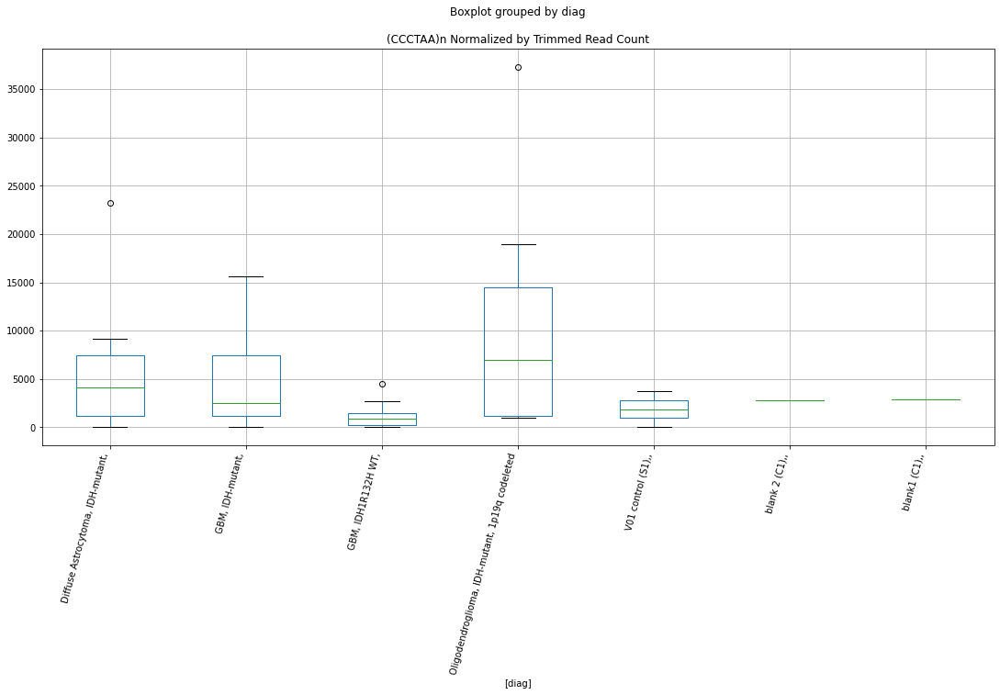

 p : 0.025399767158831372  ( t : 2.4373178079365525 ) :  D-plex  :  bbduk2  :  Ricksha_c
Control and blanks
73      1546.02
337    37386.61
Name: Ricksha_c, dtype: float64
205    15760.0
Name: Ricksha_c, dtype: float64
469    18337.35
Name: Ricksha_c, dtype: float64


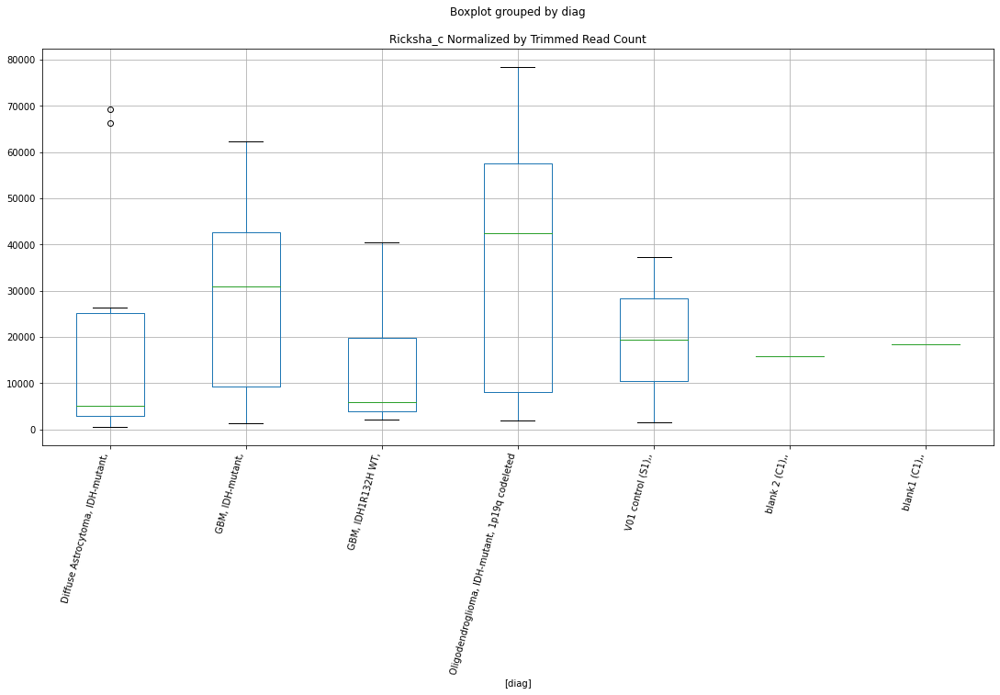

 p : 0.025458556616086994  ( t : 2.4361968297996675 ) :  D-plex  :  bbduk2  :  MER65D
Control and blanks
73     0.0
337    0.0
Name: MER65D, dtype: float64
205    6805.46
Name: MER65D, dtype: float64
469    10055.96
Name: MER65D, dtype: float64


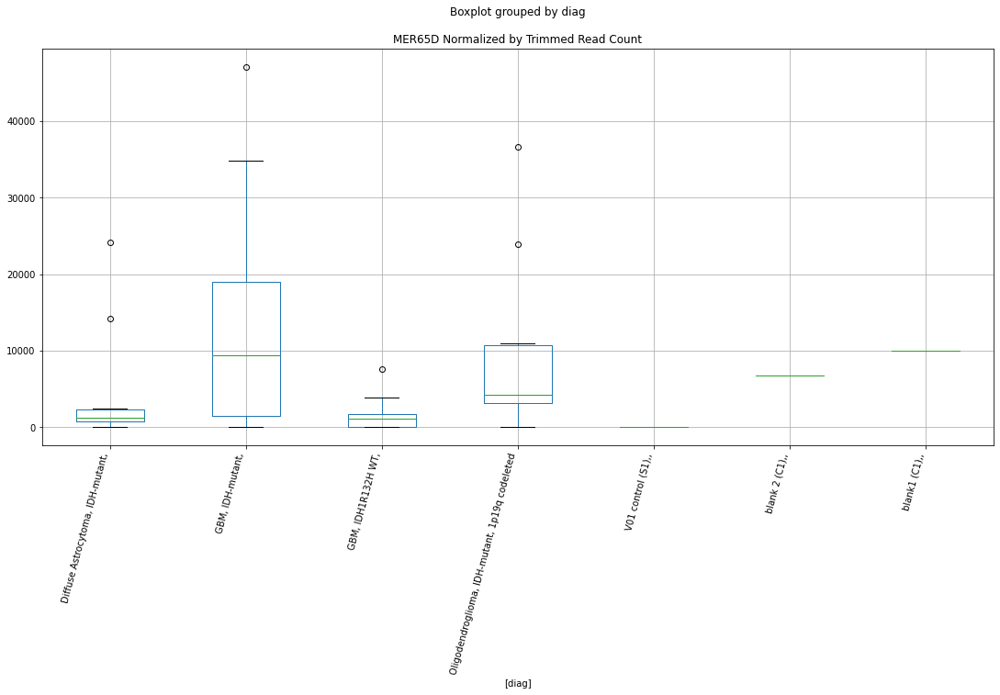

 p : 0.02549175318133177  ( t : 2.4355649204657412 ) :  D-plex  :  cutadapt2  :  (ATCGAATGGAATC)n
Control and blanks
76      2272.84
340    10568.79
Name: (ATCGAATGGAATC)n, dtype: float64
208    1939.96
Name: (ATCGAATGGAATC)n, dtype: float64
472    1733.87
Name: (ATCGAATGGAATC)n, dtype: float64


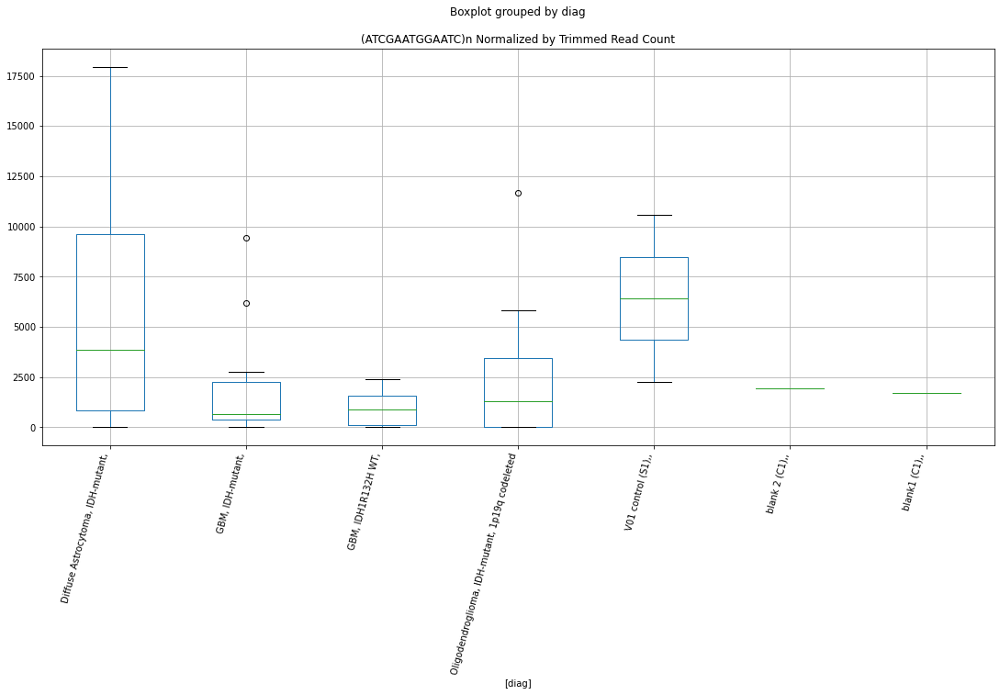

 p : 0.025731141662772627  ( t : 2.431030780198726 ) :  D-plex  :  cutadapt2  :  (TCCAC)n
Control and blanks
76     3030.46
340    4403.66
Name: (TCCAC)n, dtype: float64
208    5643.53
Name: (TCCAC)n, dtype: float64
472    6935.47
Name: (TCCAC)n, dtype: float64


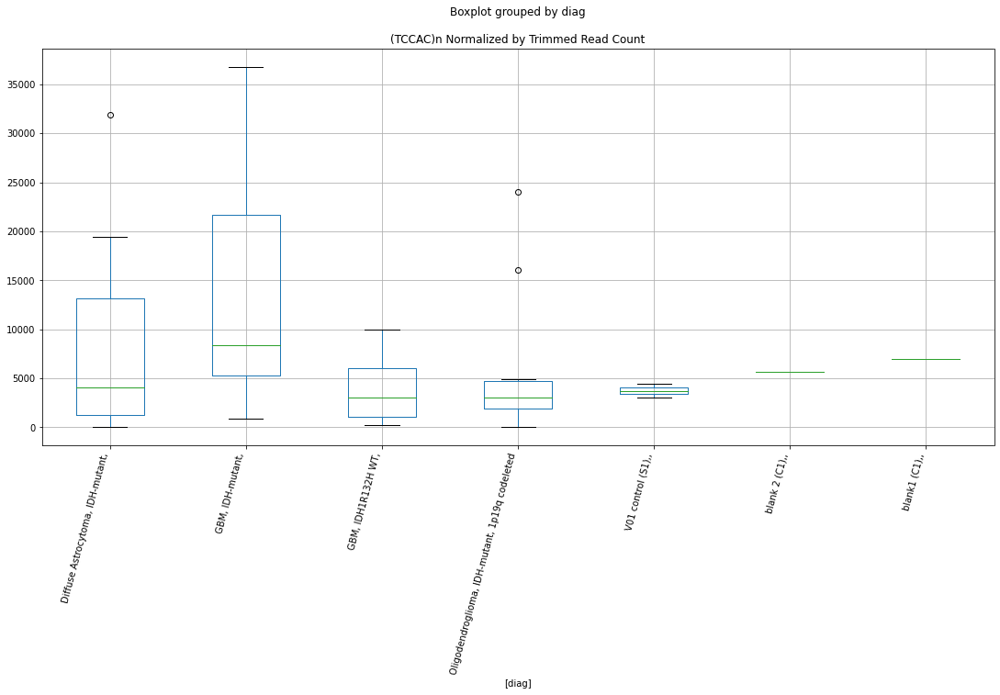

 p : 0.02574181500637703  ( t : 2.4308295437960585 ) :  D-plex  :  cutadapt2  :  (CAC)n
Control and blanks
76     4545.69
340    1761.46
Name: (CAC)n, dtype: float64
208    6525.33
Name: (CAC)n, dtype: float64
472    5779.56
Name: (CAC)n, dtype: float64


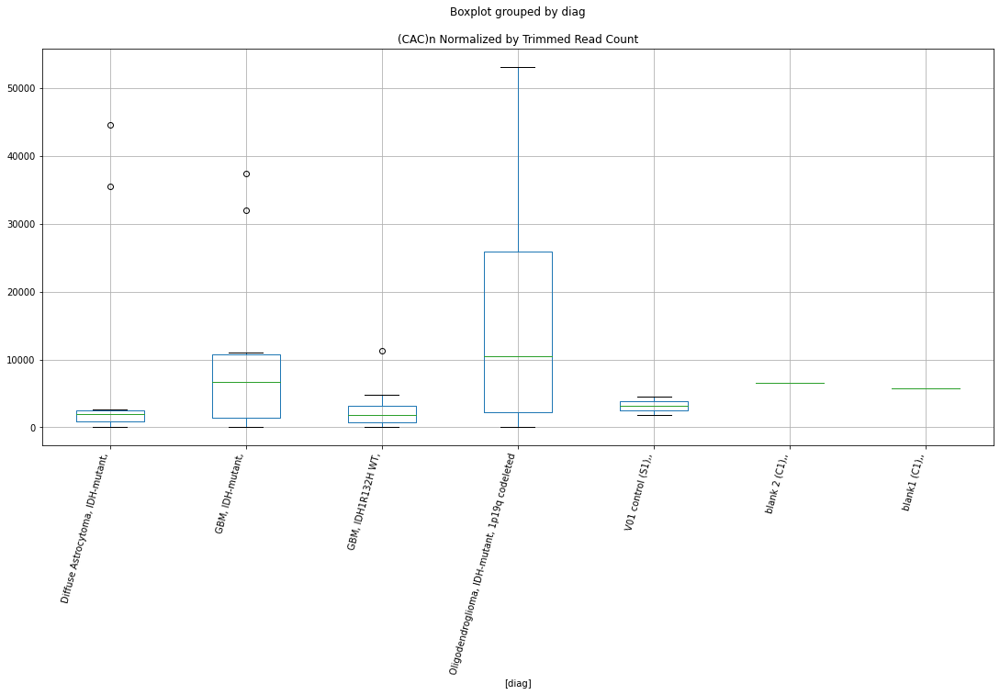

 p : 0.025752384530184698  ( t : 2.4306303418836874 ) :  D-plex  :  bbduk2  :  Charlie4a
Control and blanks
73      4638.05
337    62311.01
Name: Charlie4a, dtype: float64
205    37609.1
Name: Charlie4a, dtype: float64
469    41406.91
Name: Charlie4a, dtype: float64


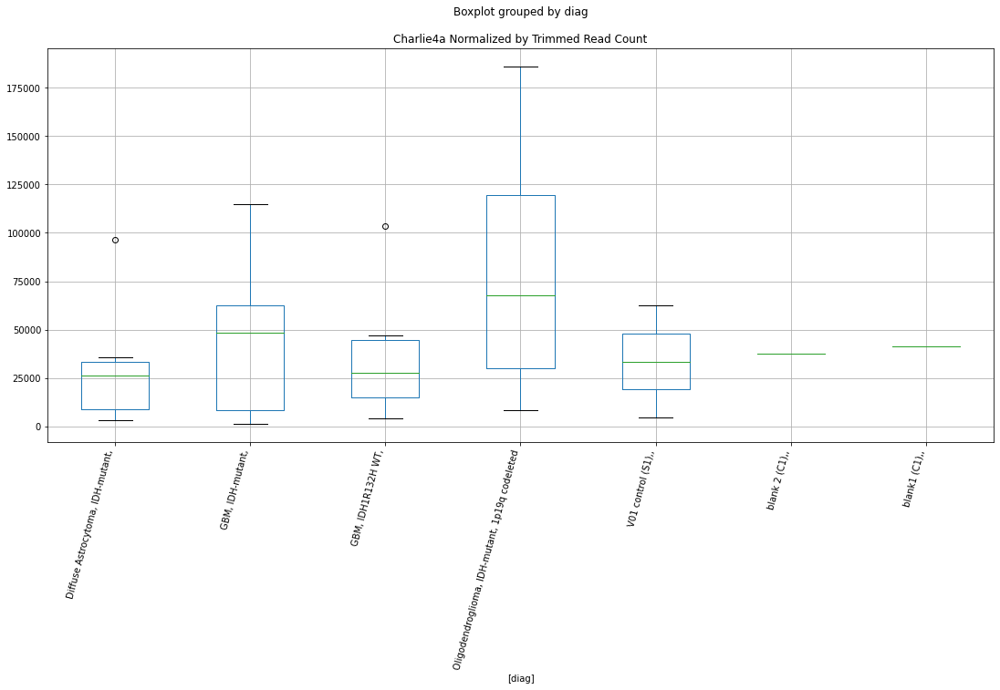

 p : 0.02588560270729073  ( t : 2.4281261512832115 ) :  D-plex  :  bbduk2  :  (GAAA)n
Control and blanks
73      5411.06
337    30265.35
Name: (GAAA)n, dtype: float64
205    14506.37
Name: (GAAA)n, dtype: float64
469    12422.07
Name: (GAAA)n, dtype: float64


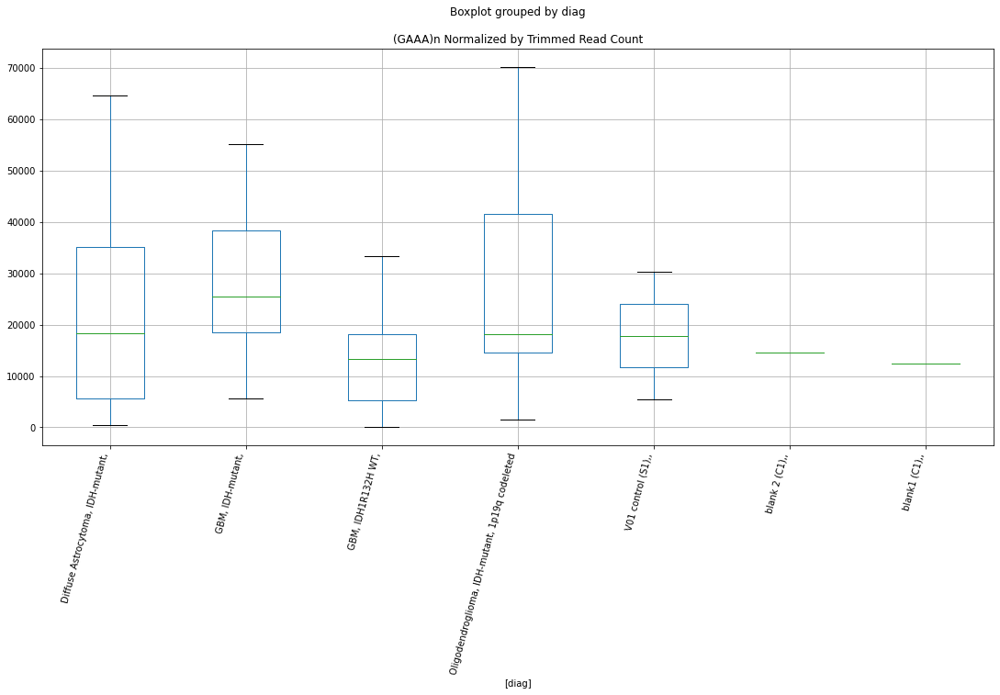

 p : 0.02598667436188306  ( t : 2.4262342851973595 ) :  D-plex  :  bbduk2  :  LTR35
Control and blanks
73     0.0
337    0.0
Name: LTR35, dtype: float64
205    2507.27
Name: LTR35, dtype: float64
469    5323.75
Name: LTR35, dtype: float64


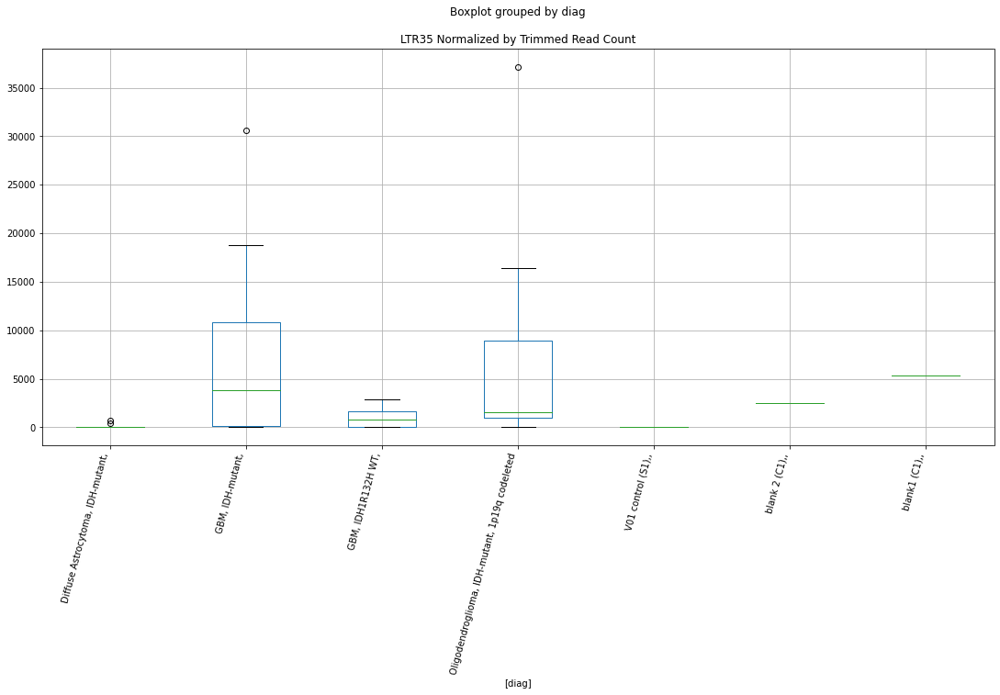

 p : 0.02602627580549203  ( t : 2.4254949021751826 ) :  Lexogen  :  bbduk2  :  (TTTC)n
Control and blanks
79         0.0
343    17834.4
Name: (TTTC)n, dtype: float64
211    0.0
Name: (TTTC)n, dtype: float64
475    0.0
Name: (TTTC)n, dtype: float64


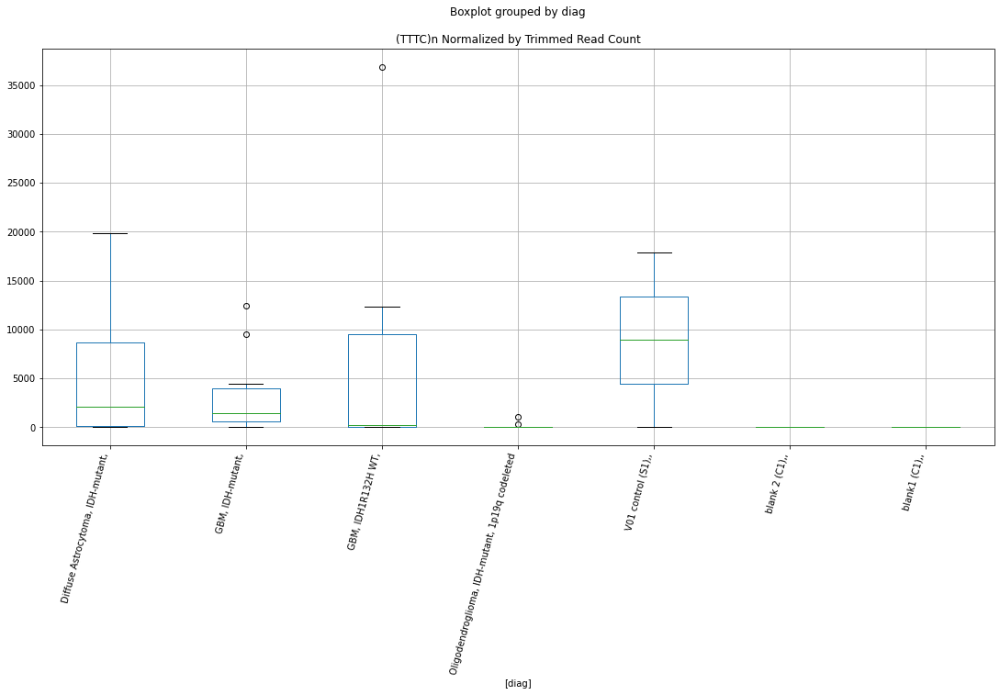

 p : 0.026118154371283366  ( t : 2.42378352516845 ) :  D-plex  :  cutadapt2  :  L1M3d
Control and blanks
76       3030.46
340    108330.05
Name: L1M3d, dtype: float64
208    24161.35
Name: L1M3d, dtype: float64
472    16182.76
Name: L1M3d, dtype: float64


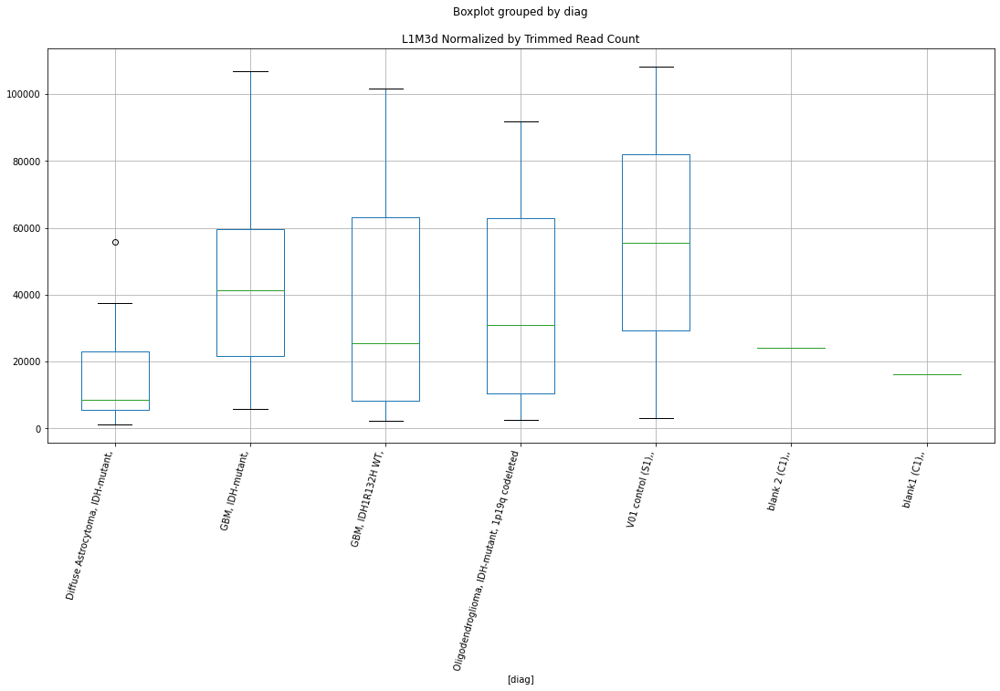

 p : 0.026124129522573196  ( t : 2.42367242437789 ) :  D-plex  :  bbduk2  :  (ATCATC)n
Control and blanks
73       0.00
337    890.16
Name: (ATCATC)n, dtype: float64
205    358.18
Name: (ATCATC)n, dtype: float64
469    0.0
Name: (ATCATC)n, dtype: float64


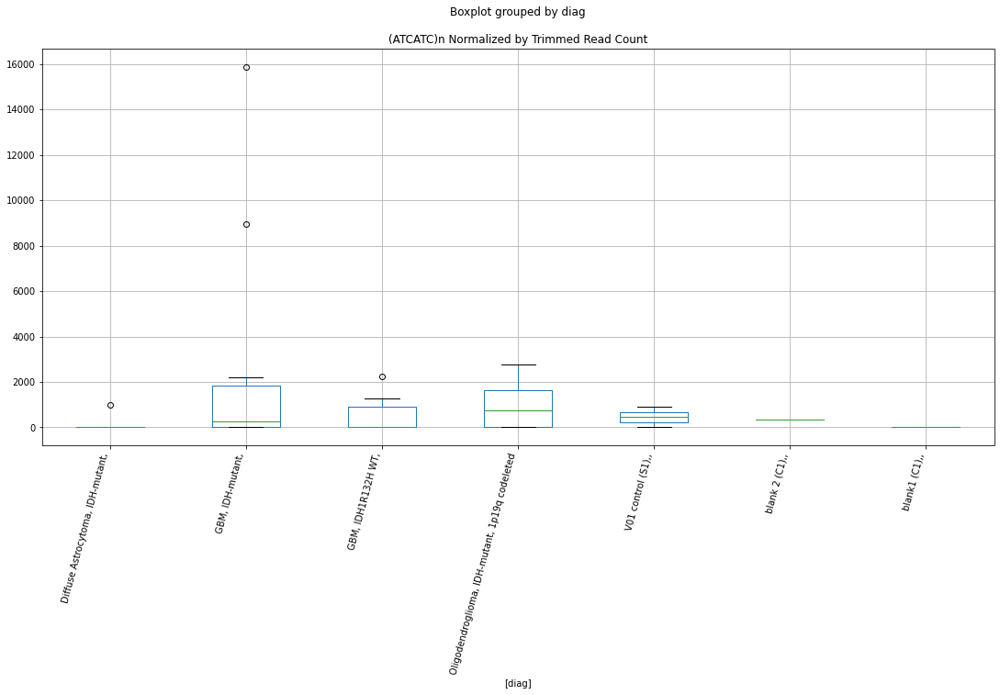

 p : 0.026243933184151063  ( t : 2.4214498275498566 ) :  D-plex  :  cutadapt2  :  LTR35
Control and blanks
76     0.0
340    0.0
Name: LTR35, dtype: float64
208    2645.4
Name: LTR35, dtype: float64
472    6357.51
Name: LTR35, dtype: float64


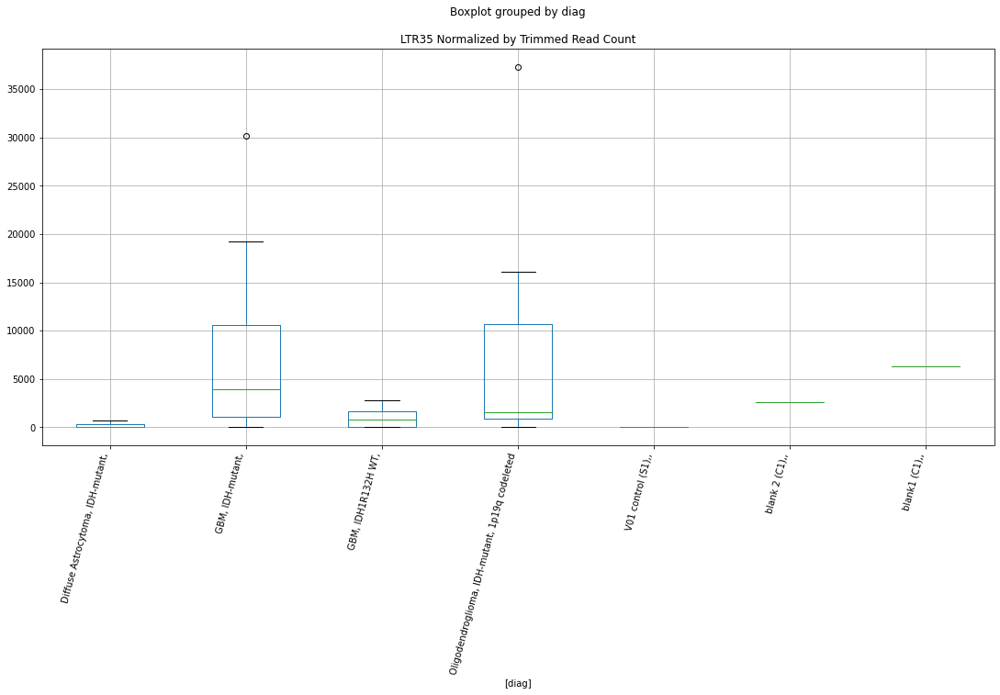

 p : 0.02629832763885574  ( t : 2.4204438373997235 ) :  D-plex  :  bbduk2  :  (TTTTTA)n
Control and blanks
73        0.00
337    5340.94
Name: (TTTTTA)n, dtype: float64
205    1253.64
Name: (TTTTTA)n, dtype: float64
469    591.53
Name: (TTTTTA)n, dtype: float64


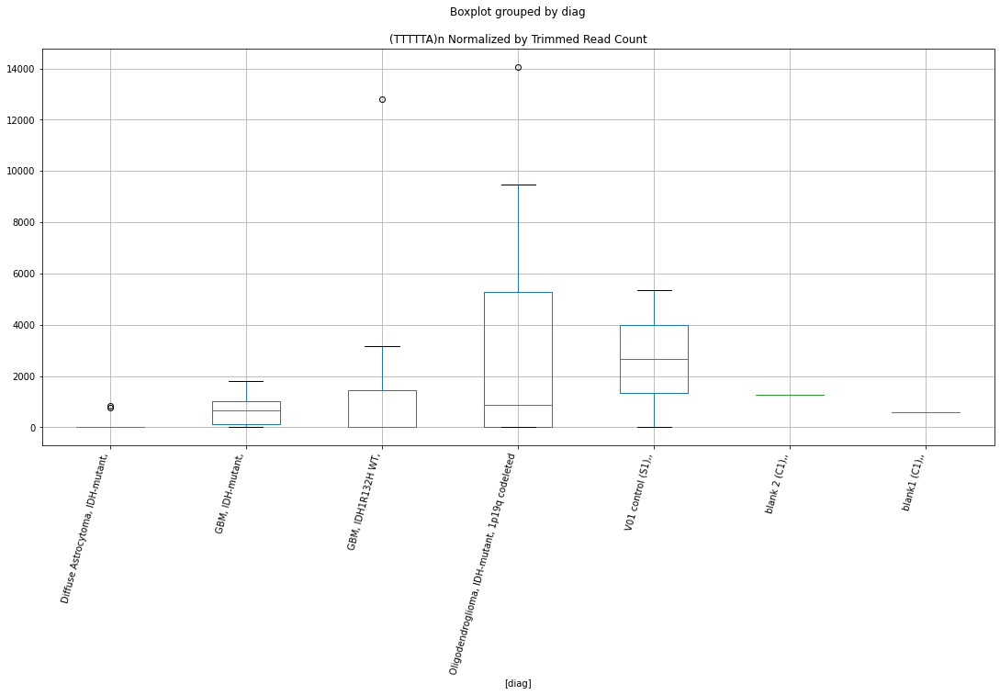

 p : 0.026698285705641173  ( t : 2.4131061496283324 ) :  D-plex  :  cutadapt2  :  LTR85a
Control and blanks
76      3030.46
340    19376.11
Name: LTR85a, dtype: float64
208    20634.15
Name: LTR85a, dtype: float64
472    14448.9
Name: LTR85a, dtype: float64


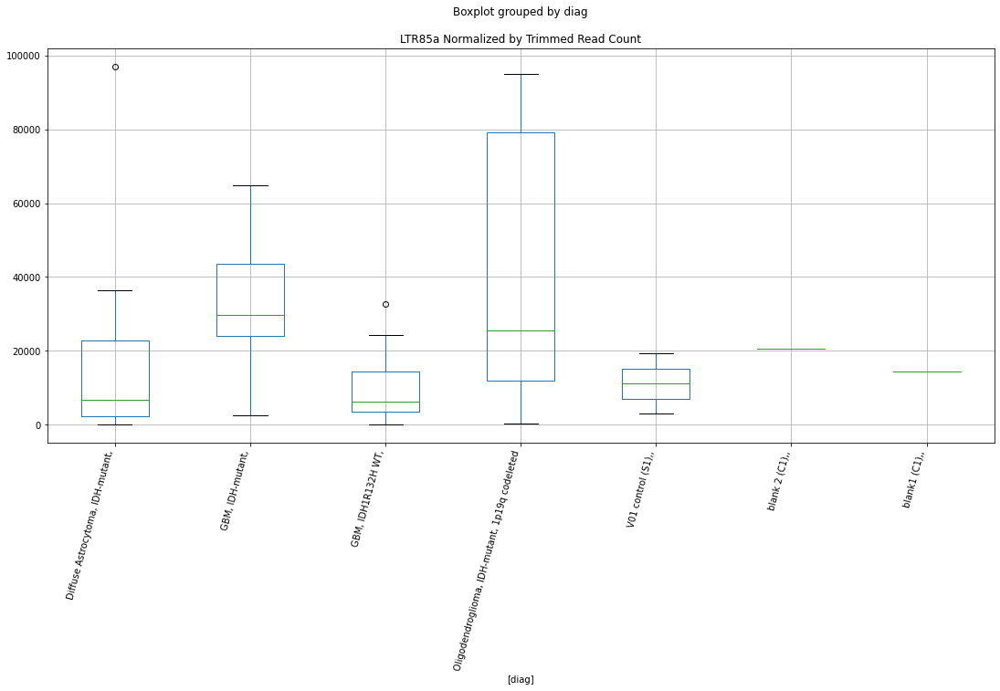

 p : 0.026705189531472173  ( t : 2.412980396861659 ) :  D-plex  :  bbduk2  :  Tigger9b
Control and blanks
73     2319.03
337    5340.94
Name: Tigger9b, dtype: float64
205    7521.82
Name: Tigger9b, dtype: float64
469    12422.07
Name: Tigger9b, dtype: float64


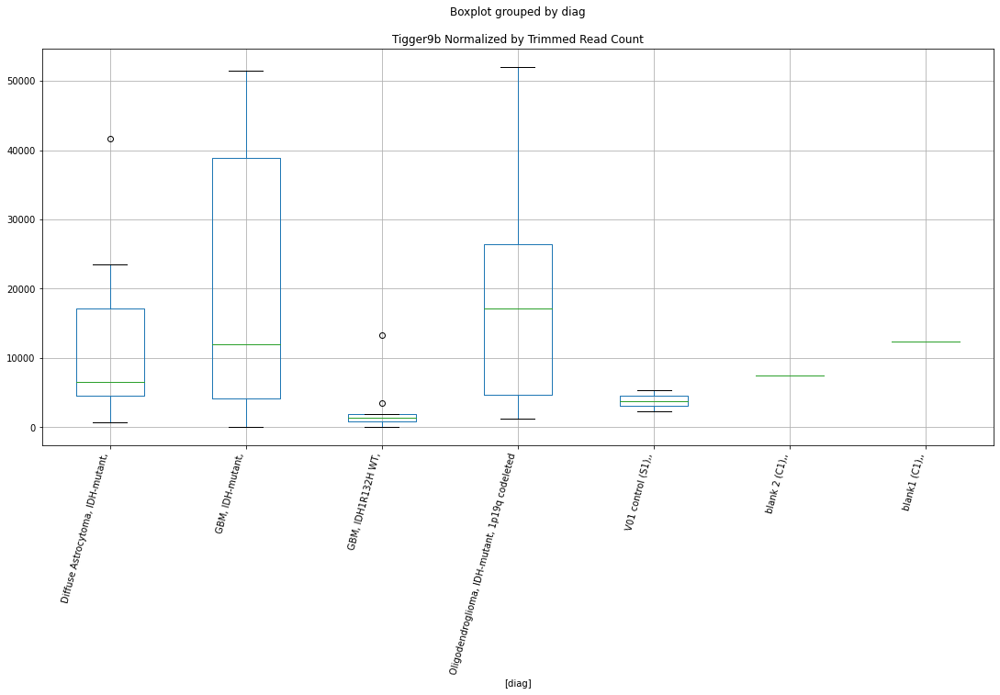

 p : 0.02671137028888438  ( t : 2.412867840555856 ) :  D-plex  :  cutadapt2  :  MER11B
Control and blanks
76     28789.34
340    52843.93
Name: MER11B, dtype: float64
208    20105.06
Name: MER11B, dtype: float64
472    18494.59
Name: MER11B, dtype: float64


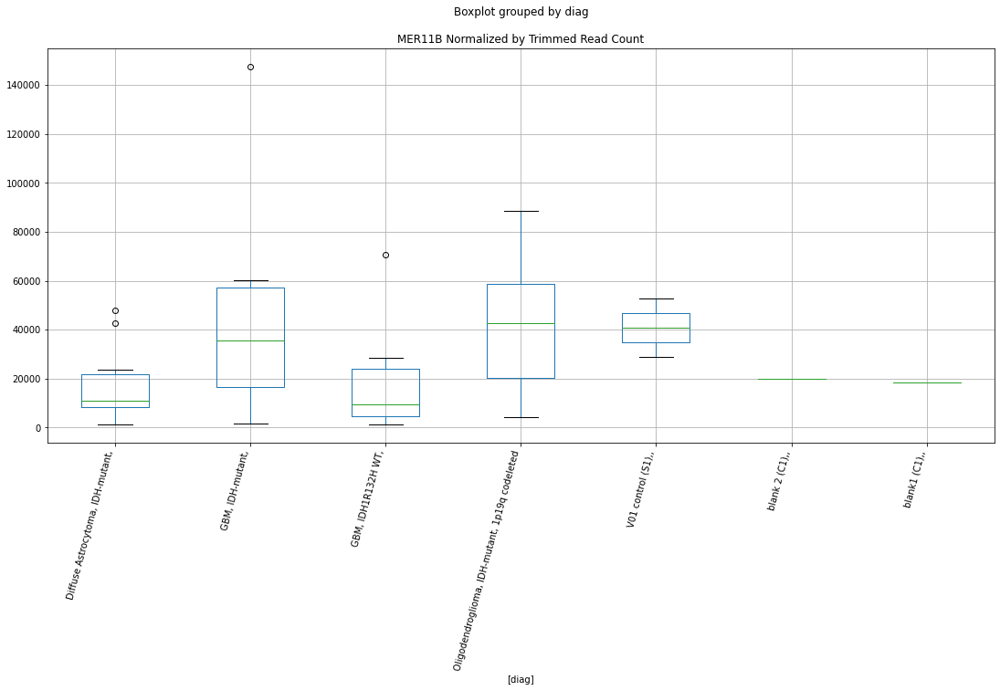

 p : 0.026729075176939933  ( t : 2.4125455559234763 ) :  D-plex  :  cutadapt2  :  (TCCC)n
Control and blanks
76     59851.52
340    24660.50
Name: (TCCC)n, dtype: float64
208    16048.78
Name: (TCCC)n, dtype: float64
472    22540.28
Name: (TCCC)n, dtype: float64


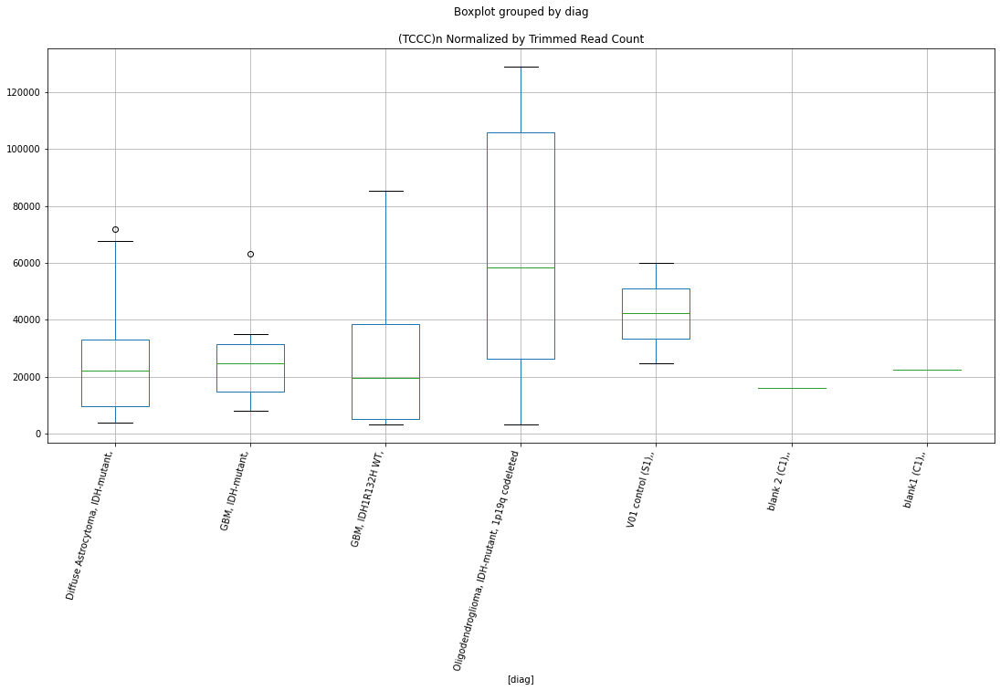

 p : 0.02675958749632048  ( t : 2.4119906043835115 ) :  D-plex  :  cutadapt2  :  MER4B
Control and blanks
76     9848.98
340    6165.12
Name: MER4B, dtype: float64
208    35801.12
Name: MER4B, dtype: float64
472    36411.22
Name: MER4B, dtype: float64


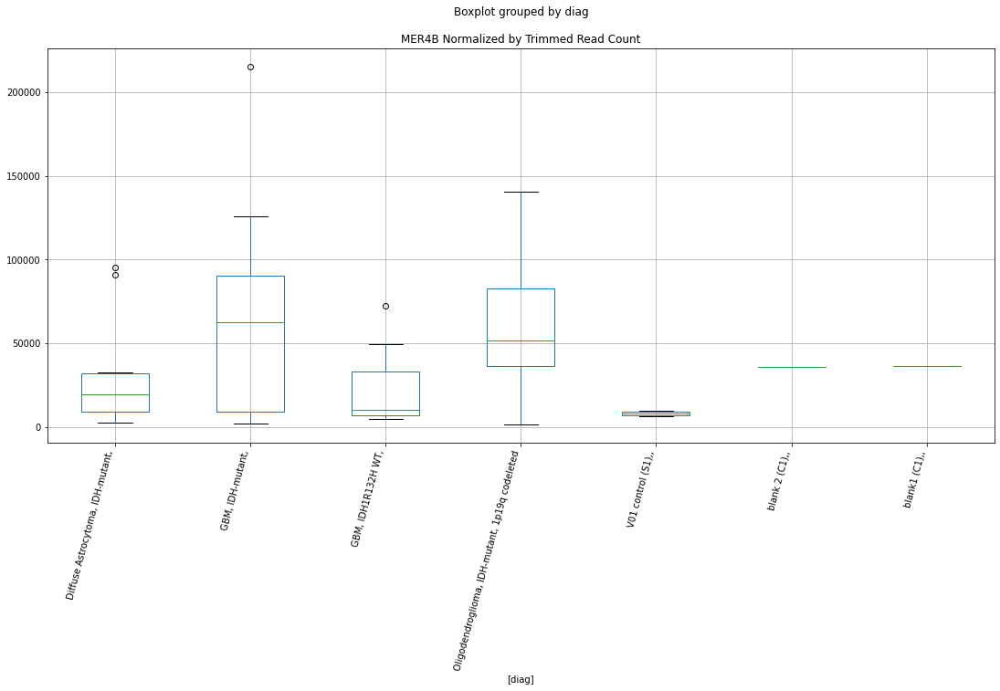

 p : 0.026760012188079947  ( t : 2.411982884360541 ) :  D-plex  :  cutadapt2  :  MER61F
Control and blanks
76       0.00
340    880.73
Name: MER61F, dtype: float64
208    2469.04
Name: MER61F, dtype: float64
472    4623.65
Name: MER61F, dtype: float64


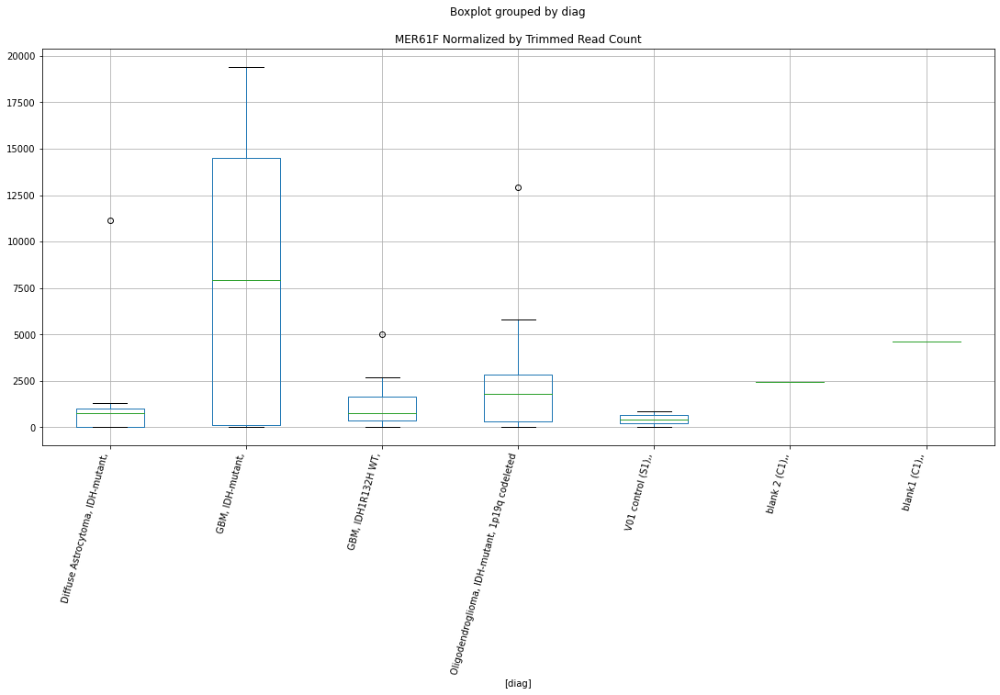

 p : 0.026775553292654082  ( t : 2.411700457882107 ) :  D-plex  :  bbduk2  :  LTR70
Control and blanks
73       773.01
337    19583.46
Name: LTR70, dtype: float64
205    2686.36
Name: LTR70, dtype: float64
469    5915.27
Name: LTR70, dtype: float64


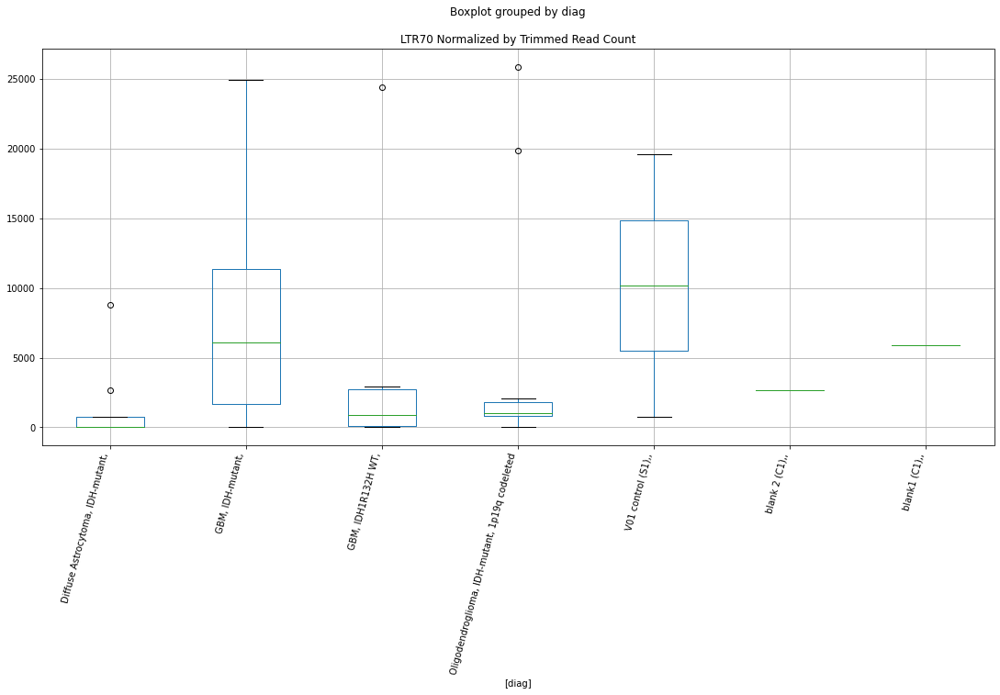

 p : 0.02682787524515245  ( t : 2.4107507442651945 ) :  D-plex  :  cutadapt2  :  (CTAT)n
Control and blanks
76      4545.69
340    13210.98
Name: (CTAT)n, dtype: float64
208    13932.46
Name: (CTAT)n, dtype: float64
472    10403.21
Name: (CTAT)n, dtype: float64


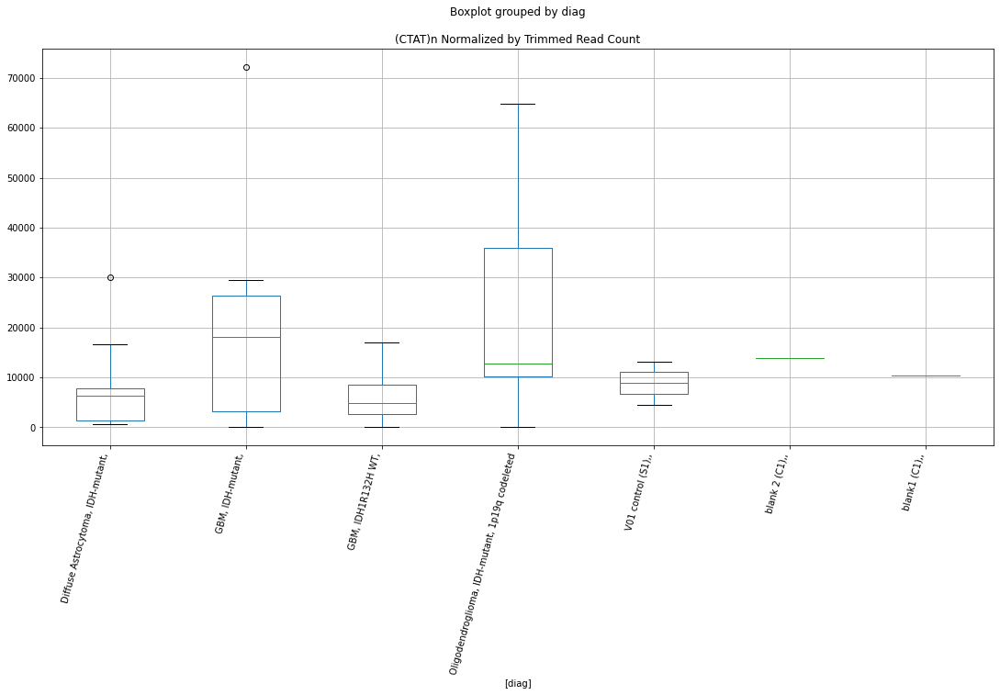

 p : 0.026886818829653117  ( t : 2.409682913280027 ) :  D-plex  :  bbduk2  :  MER67B
Control and blanks
73      773.01
337    1780.31
Name: MER67B, dtype: float64
205    7342.73
Name: MER67B, dtype: float64
469    8281.38
Name: MER67B, dtype: float64


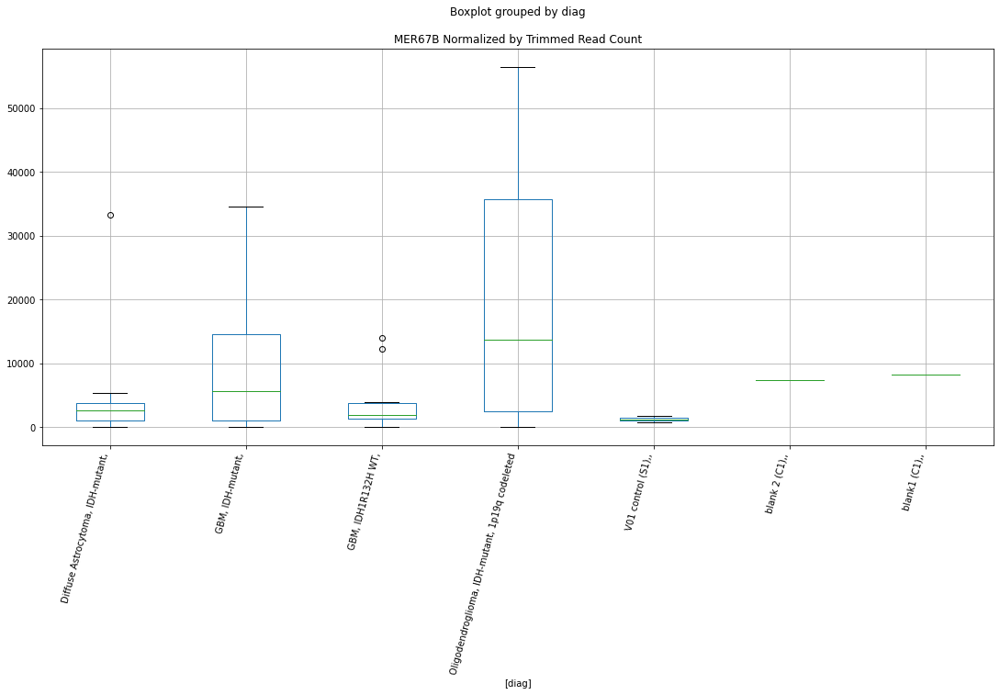

 p : 0.026904792419318  ( t : 2.4093577368168537 ) :  D-plex  :  cutadapt2  :  LTR32
Control and blanks
76      4545.69
340    36110.02
Name: LTR32, dtype: float64
208    18870.54
Name: LTR32, dtype: float64
472    24274.15
Name: LTR32, dtype: float64


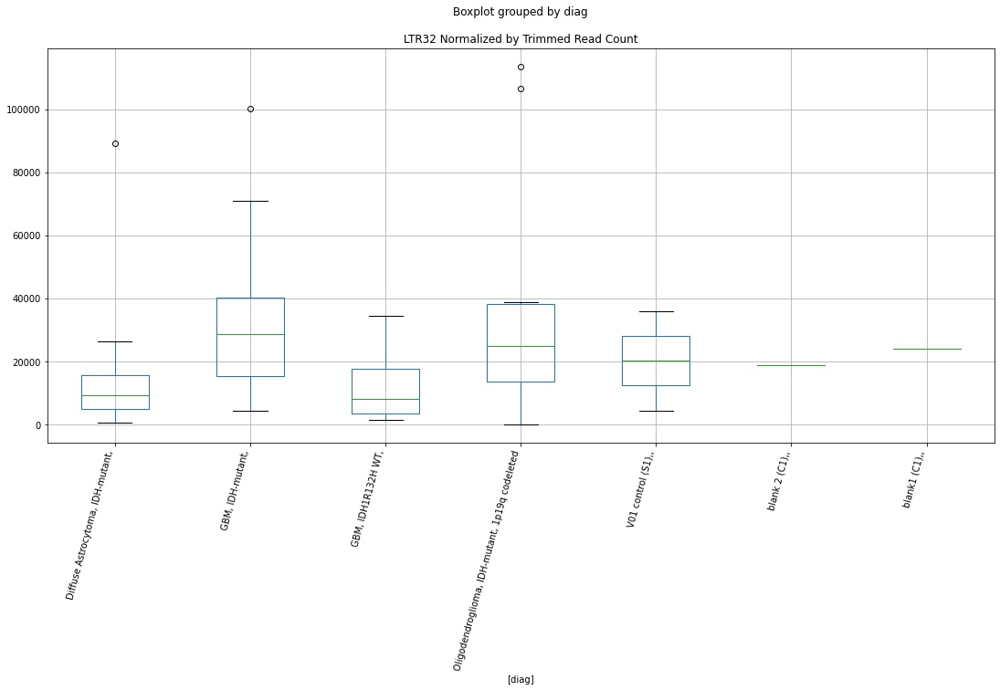

 p : 0.02707344385390421  ( t : 2.406316374390933 ) :  Lexogen  :  cutadapt2  :  (TTTC)n
Control and blanks
82         0.0
346    17676.5
Name: (TTTC)n, dtype: float64
214    0.0
Name: (TTTC)n, dtype: float64
478    0.0
Name: (TTTC)n, dtype: float64


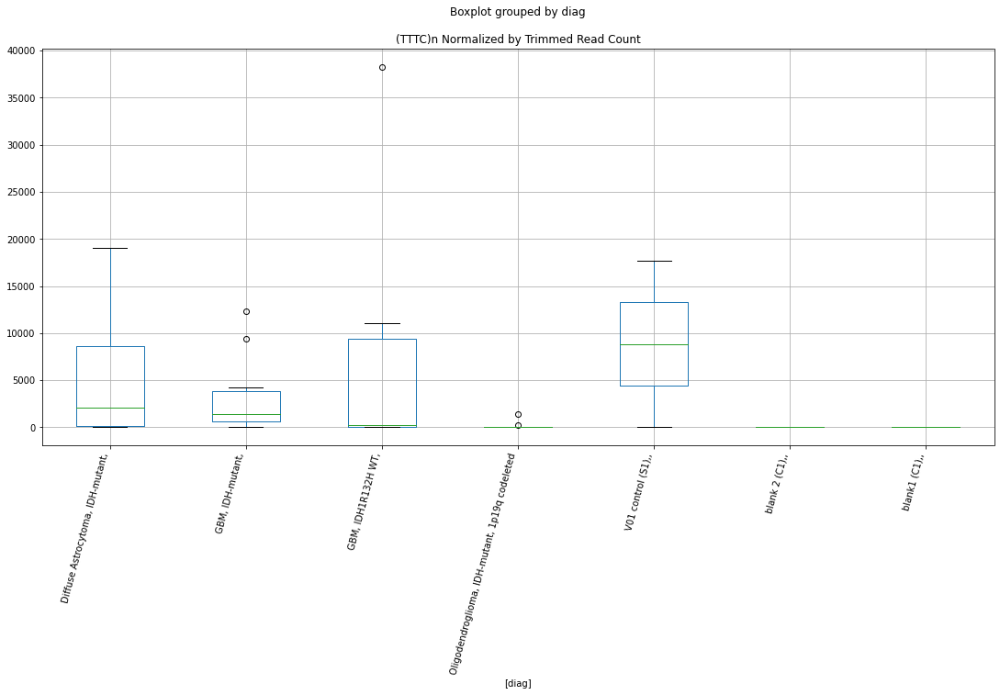

 p : 0.02710207594210264  ( t : 2.4058018007170454 ) :  D-plex  :  bbduk2  :  MLT1N2
Control and blanks
73     102037.11
337     56970.06
Name: MLT1N2, dtype: float64
205    61786.38
Name: MLT1N2, dtype: float64
469    61518.84
Name: MLT1N2, dtype: float64


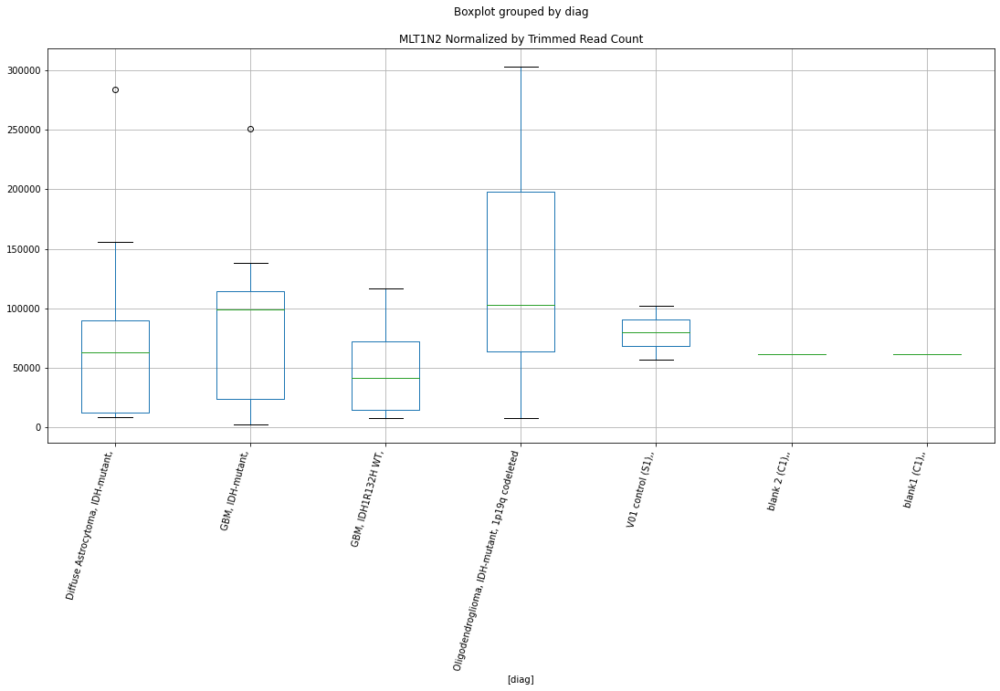

 p : 0.02726822544918242  ( t : 2.402825774356947 ) :  D-plex  :  cutadapt2  :  (GTGATC)n
Control and blanks
76       0.00
340    880.73
Name: (GTGATC)n, dtype: float64
208    17812.38
Name: (GTGATC)n, dtype: float64
472    1155.91
Name: (GTGATC)n, dtype: float64


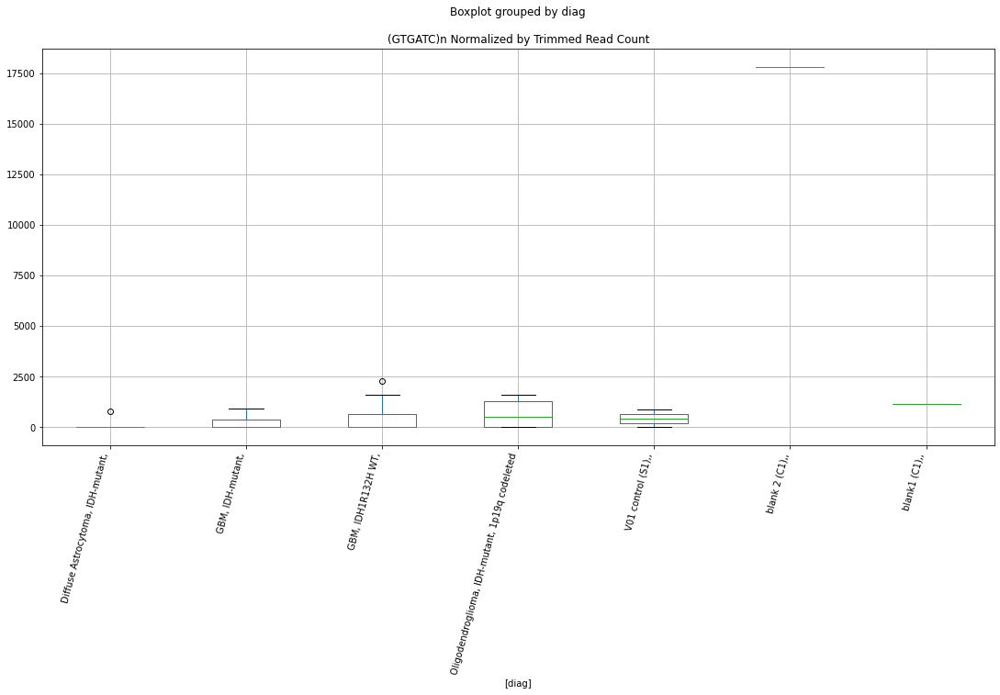

 p : 0.027319395669623738  ( t : 2.4019126424386266 ) :  D-plex  :  cutadapt2  :  HERV3-int
Control and blanks
76      1515.23
340    39632.95
Name: HERV3-int, dtype: float64
208    17459.66
Name: HERV3-int, dtype: float64
472    19072.54
Name: HERV3-int, dtype: float64


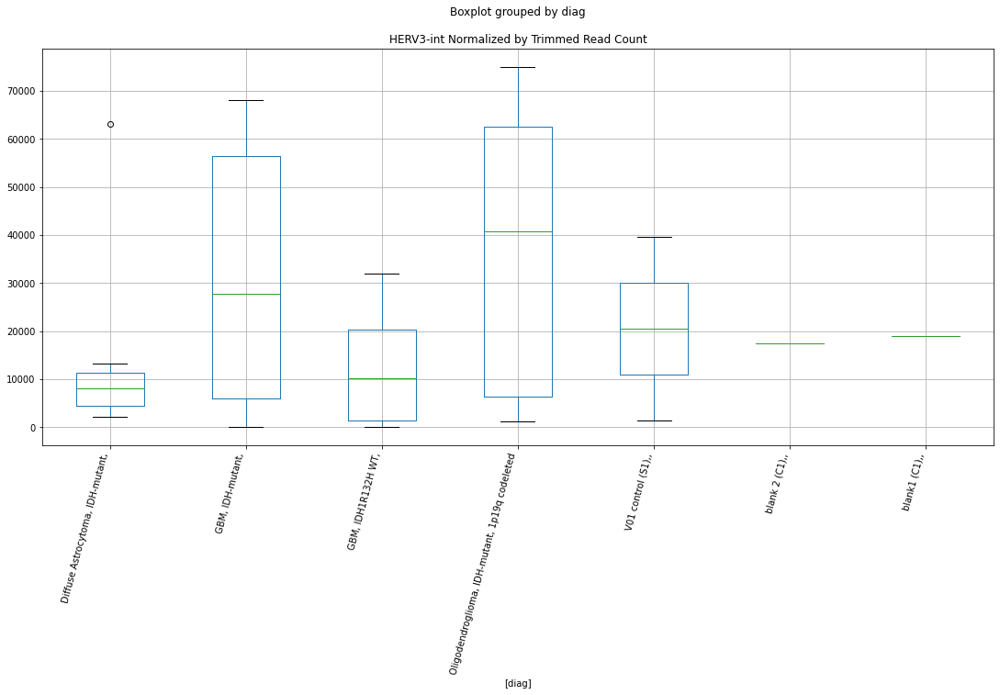

 p : 0.02740087878128498  ( t : 2.4004618735252916 ) :  D-plex  :  cutadapt2  :  MER41C
Control and blanks
76      3788.07
340    28183.43
Name: MER41C, dtype: float64
208    11816.13
Name: MER41C, dtype: float64
472    12715.03
Name: MER41C, dtype: float64


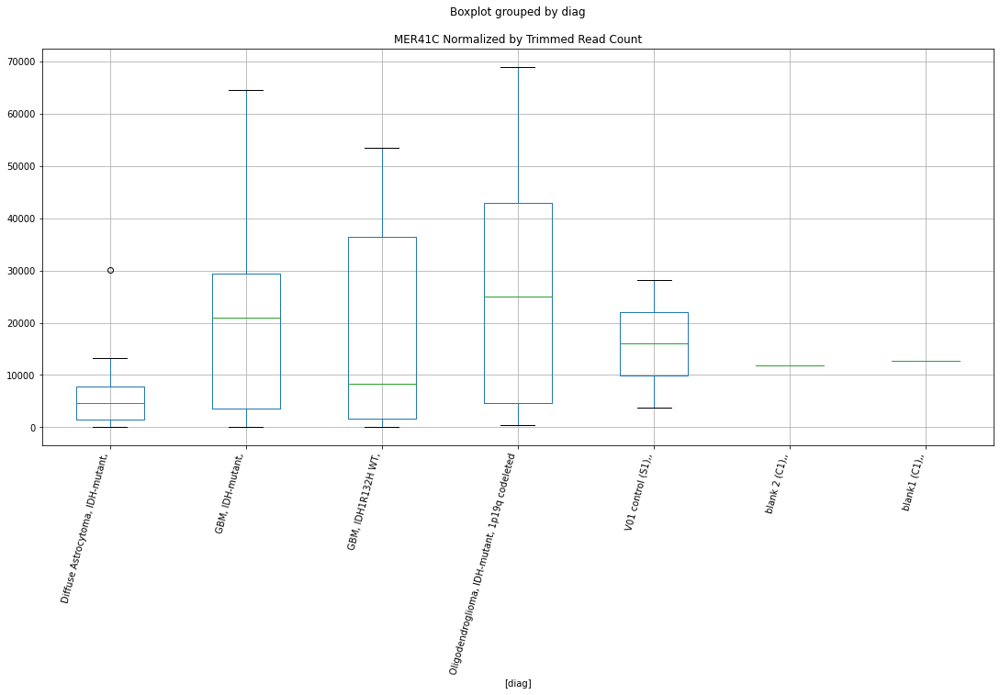

 p : 0.027412888838405376  ( t : 2.400248381262859 ) :  Lexogen  :  bbduk2  :  (TTTC)n
Control and blanks
79         0.0
343    17834.4
Name: (TTTC)n, dtype: float64
211    0.0
Name: (TTTC)n, dtype: float64
475    0.0
Name: (TTTC)n, dtype: float64


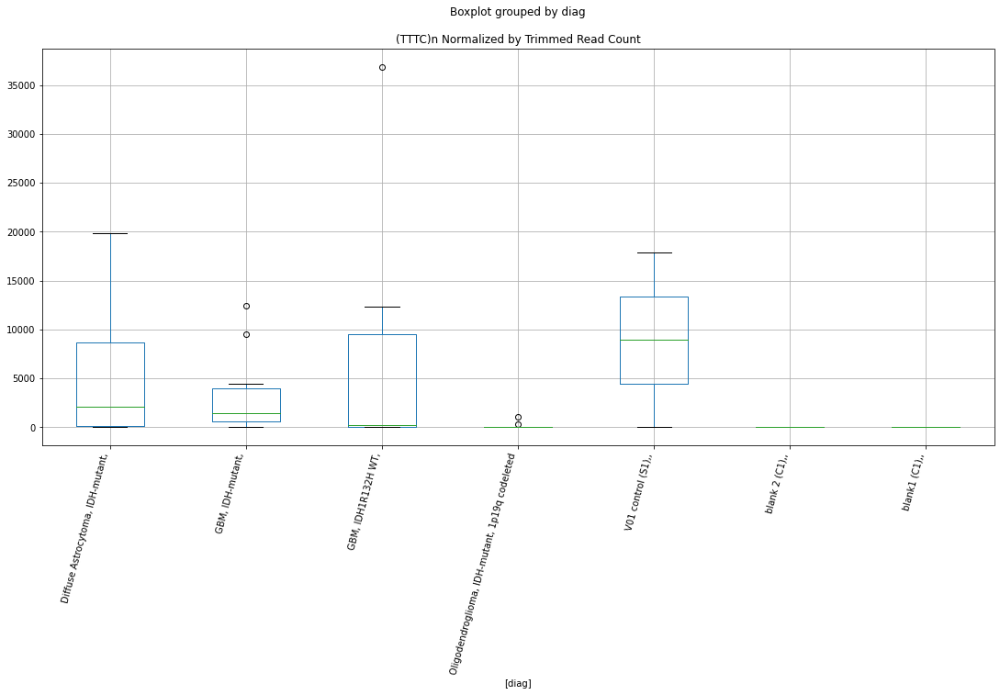

 p : 0.027470902718655644  ( t : 2.3992183493496717 ) :  D-plex  :  bbduk2  :  MamRep1894
Control and blanks
73     773.01
337      0.00
Name: MamRep1894, dtype: float64
205    4119.09
Name: MamRep1894, dtype: float64
469    5323.75
Name: MamRep1894, dtype: float64


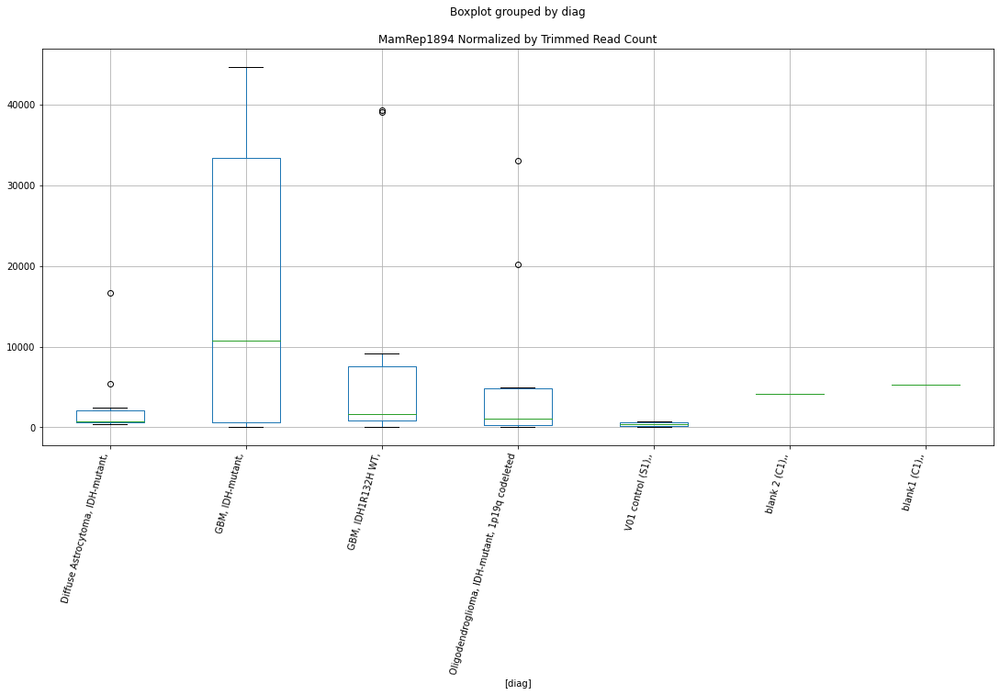

 p : 0.027526845514290427  ( t : 2.398227013807809 ) :  D-plex  :  bbduk2  :  MER77B
Control and blanks
73     14687.16
337    39166.92
Name: MER77B, dtype: float64
205    33131.83
Name: MER77B, dtype: float64
469    26618.73
Name: MER77B, dtype: float64


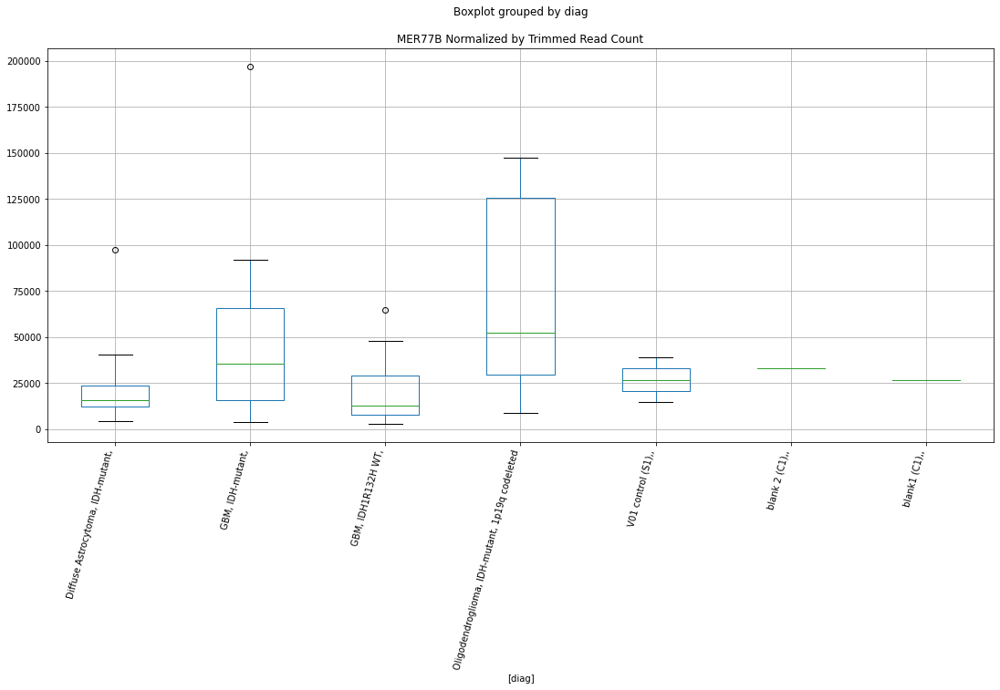

 p : 0.027555967879194447  ( t : 2.3977116955588764 ) :  D-plex  :  cutadapt2  :  MamGypLTR3a
Control and blanks
76      1515.23
340    59889.79
Name: MamGypLTR3a, dtype: float64
208    14814.26
Name: MamGypLTR3a, dtype: float64
472    14448.9
Name: MamGypLTR3a, dtype: float64


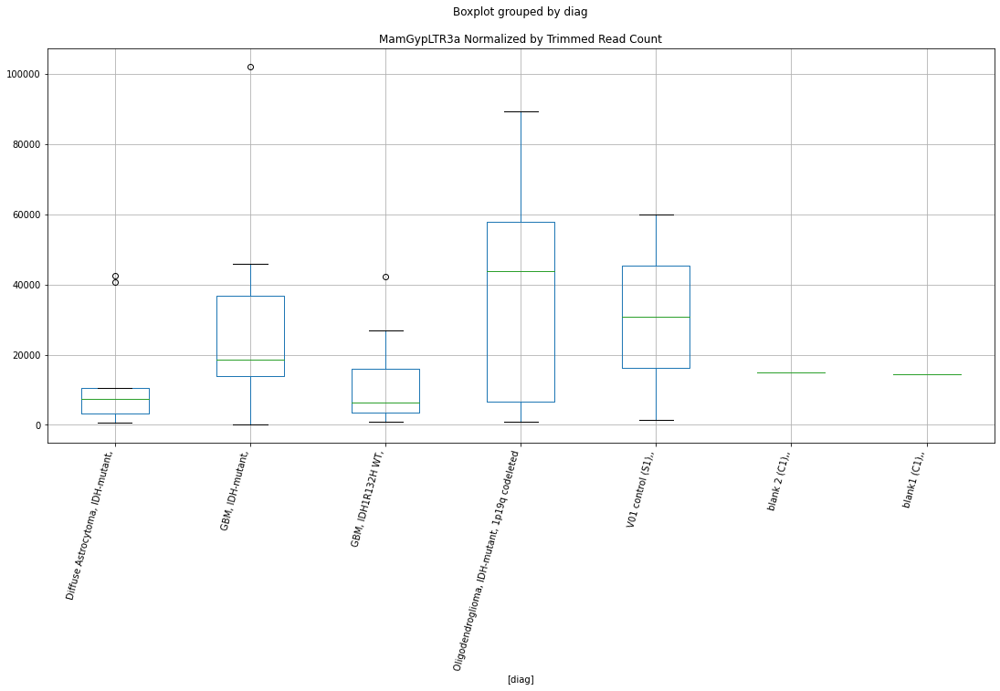

 p : 0.027707818943761276  ( t : 2.395032922045085 ) :  D-plex  :  bbduk2  :  (TATTT)n
Control and blanks
73      773.01
337    7121.26
Name: (TATTT)n, dtype: float64
205    3223.64
Name: (TATTT)n, dtype: float64
469    2366.11
Name: (TATTT)n, dtype: float64


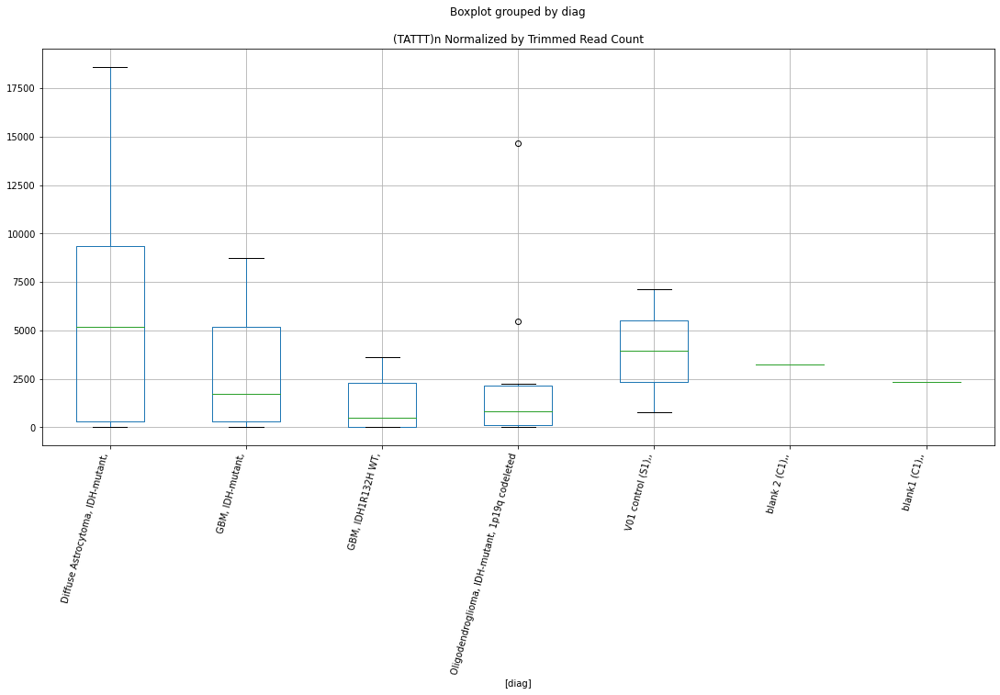

 p : 0.027711162564095903  ( t : 2.394974092470747 ) :  D-plex  :  cutadapt2  :  LTR16A2
Control and blanks
76     43941.62
340    10568.79
Name: LTR16A2, dtype: float64
208    46206.38
Name: LTR16A2, dtype: float64
472    31209.62
Name: LTR16A2, dtype: float64


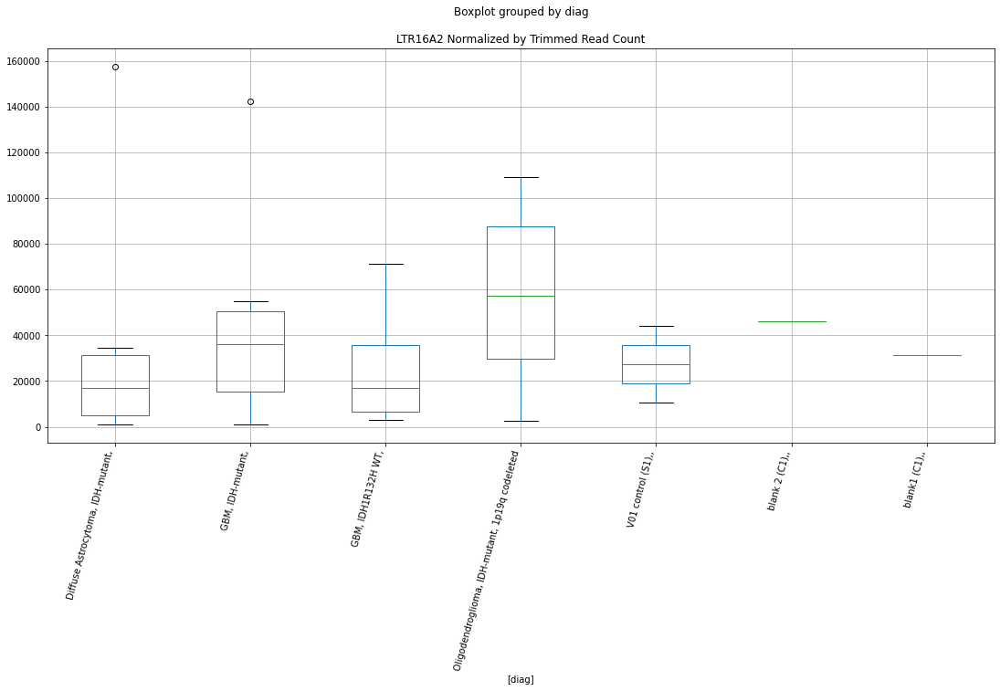

 p : 0.027780903413034946  ( t : 2.3937485418906217 ) :  D-plex  :  bbduk2  :  MER61F
Control and blanks
73       0.00
337    890.16
Name: MER61F, dtype: float64
205    2507.27
Name: MER61F, dtype: float64
469    4732.22
Name: MER61F, dtype: float64


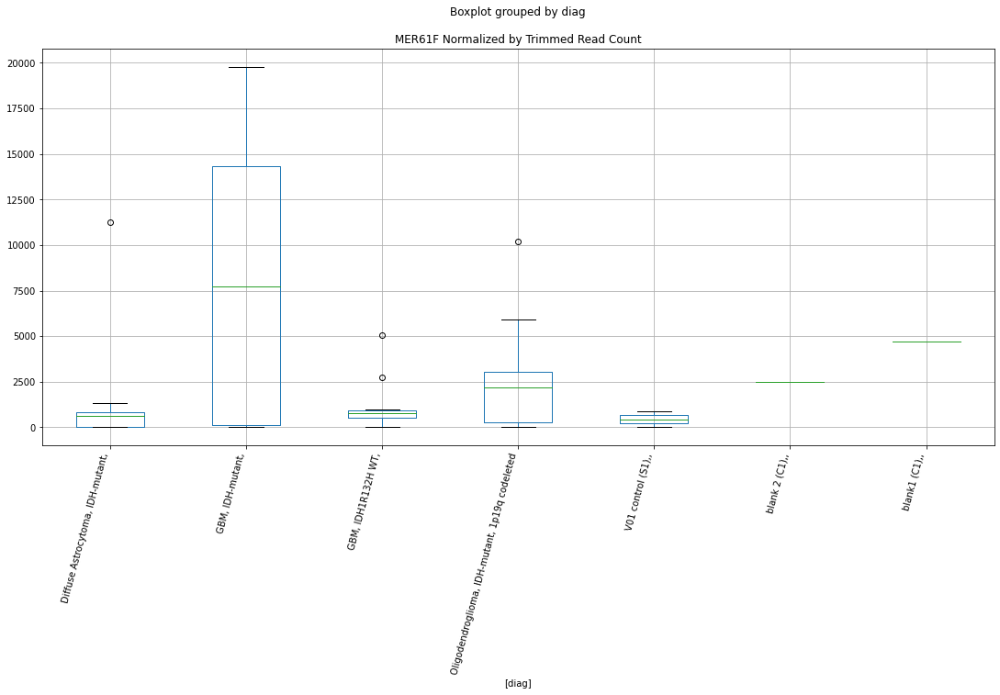

 p : 0.027786633309030764  ( t : 2.393647978734954 ) :  D-plex  :  bbduk2  :  MamGypLTR3a
Control and blanks
73       773.01
337    60530.69
Name: MamGypLTR3a, dtype: float64
205    14327.28
Name: MamGypLTR3a, dtype: float64
469    14788.18
Name: MamGypLTR3a, dtype: float64


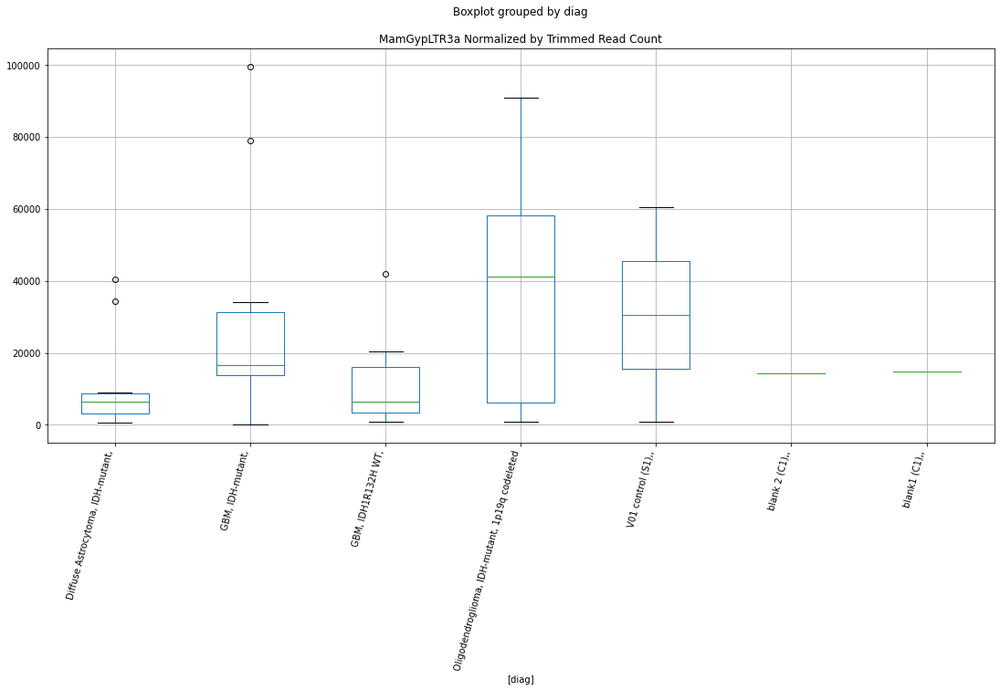

 p : 0.027829289883417072  ( t : 2.392899938531092 ) :  D-plex  :  cutadapt2  :  AmnSINE2
Control and blanks
76     2272.84
340       0.00
Name: AmnSINE2, dtype: float64
208    5114.45
Name: AmnSINE2, dtype: float64
472    2889.78
Name: AmnSINE2, dtype: float64


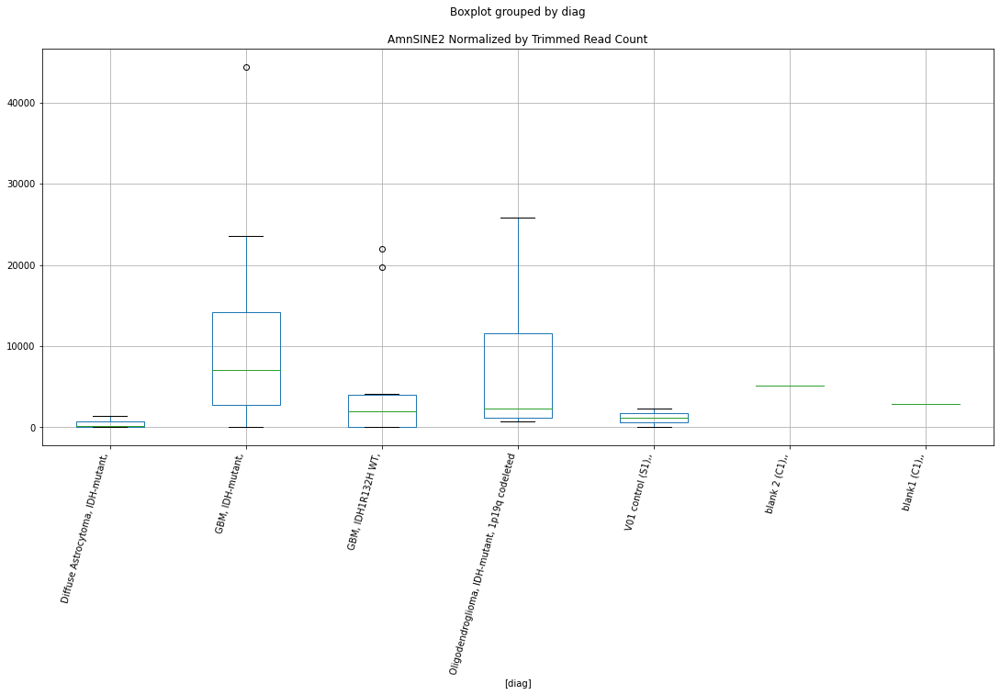

 p : 0.02785755980173596  ( t : 2.3924047777713655 ) :  D-plex  :  cutadapt2  :  (GGGCAGGCGT)n
Control and blanks
76     0.0
340    0.0
Name: (GGGCAGGCGT)n, dtype: float64
208    176.36
Name: (GGGCAGGCGT)n, dtype: float64
472    0.0
Name: (GGGCAGGCGT)n, dtype: float64


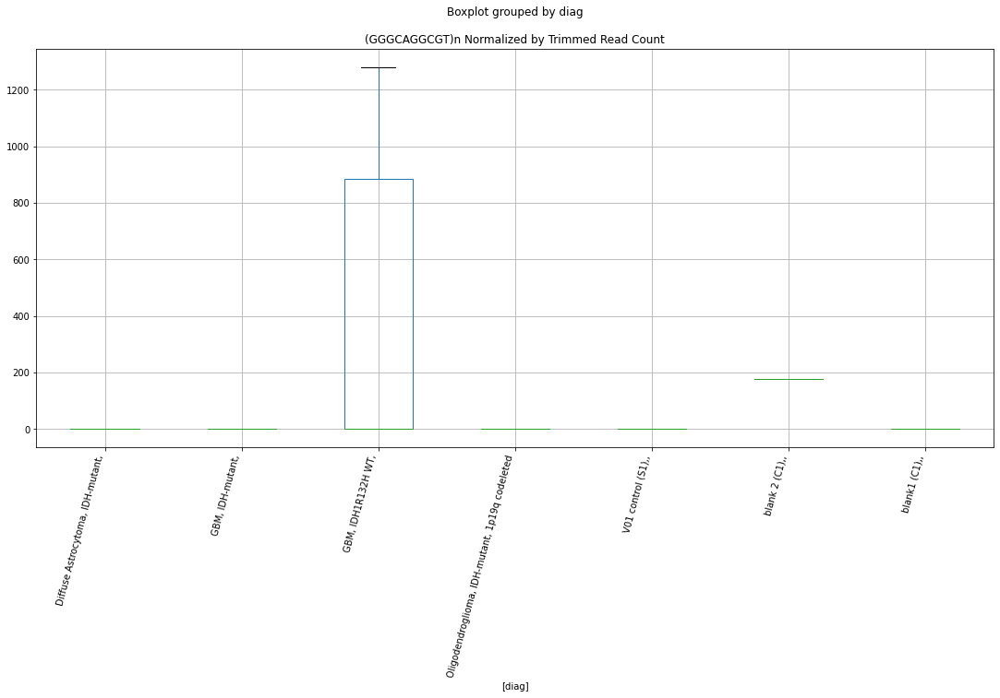

 p : 0.027895226376821725  ( t : 2.39174575931364 ) :  D-plex  :  bbduk2  :  Charlie6
Control and blanks
73     4638.05
337       0.00
Name: Charlie6, dtype: float64
205    5014.55
Name: Charlie6, dtype: float64
469    5323.75
Name: Charlie6, dtype: float64


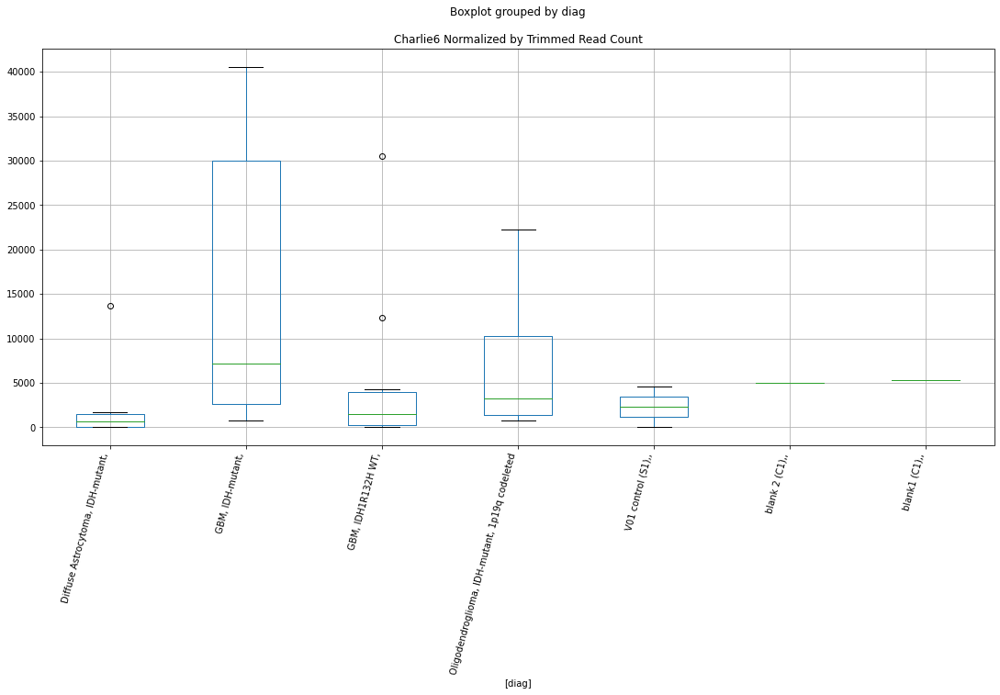

 p : 0.027908114800122907  ( t : 2.3915204529977796 ) :  D-plex  :  bbduk2  :  Tigger2
Control and blanks
73      92761.01
337    165569.25
Name: Tigger2, dtype: float64
205    95813.66
Name: Tigger2, dtype: float64
469    103517.28
Name: Tigger2, dtype: float64


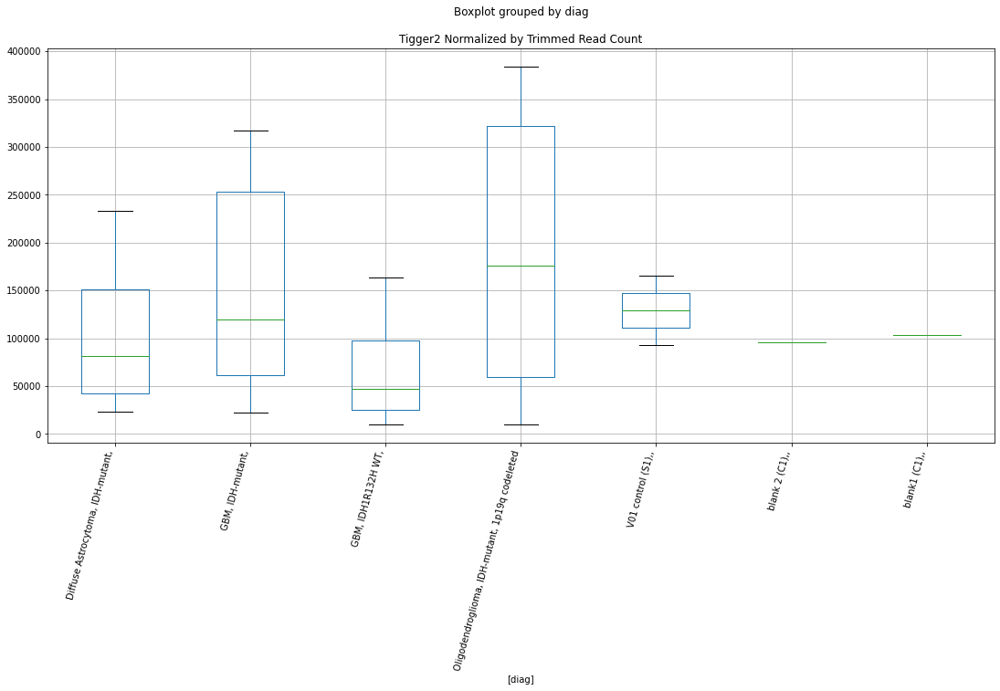

 p : 0.027941333984543258  ( t : 2.390940186598778 ) :  D-plex  :  cutadapt2  :  (TTCCA)n
Control and blanks
76     71215.74
340    81908.09
Name: (TTCCA)n, dtype: float64
208    75482.17
Name: (TTCCA)n, dtype: float64
472    72244.48
Name: (TTCCA)n, dtype: float64


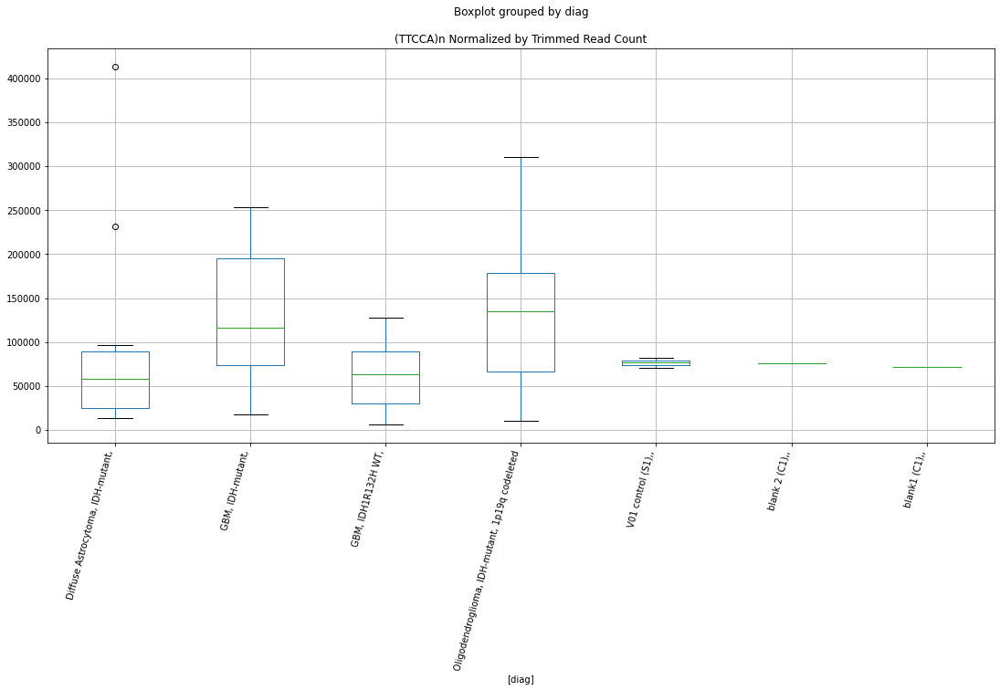

 p : 0.028016482553711492  ( t : 2.389629880477118 ) :  D-plex  :  bbduk2  :  ORSL
Control and blanks
73      1546.02
337    29375.19
Name: ORSL, dtype: float64
205    16476.37
Name: ORSL, dtype: float64
469    10055.96
Name: ORSL, dtype: float64


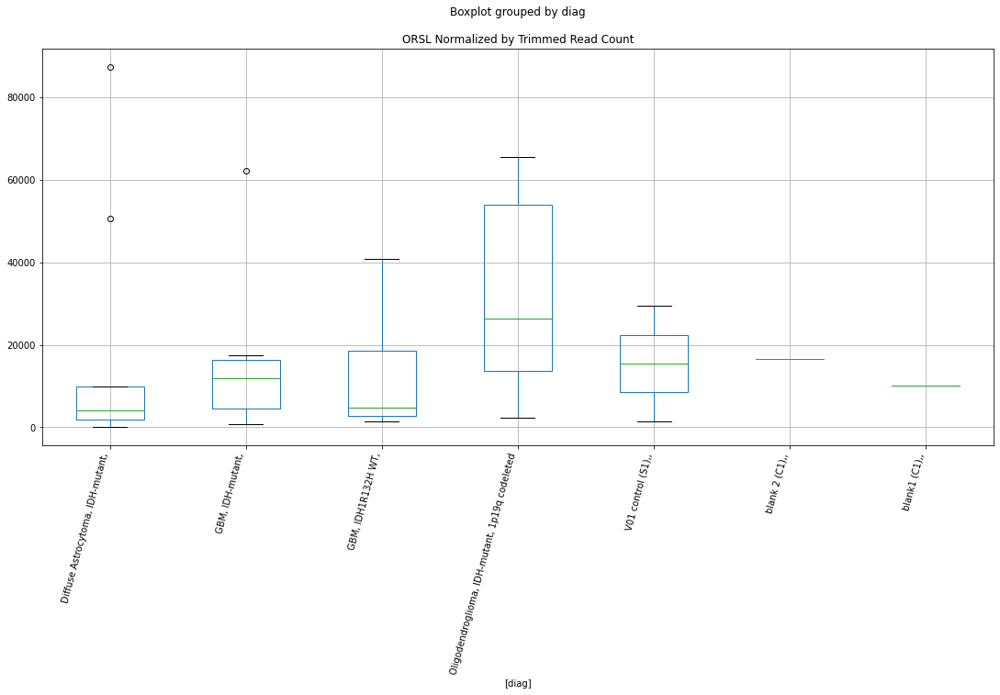

 p : 0.02813576205317451  ( t : 2.387556825051916 ) :  D-plex  :  cutadapt2  :  MERX
Control and blanks
76       0.00
340    880.73
Name: MERX, dtype: float64
208    5996.25
Name: MERX, dtype: float64
472    4623.65
Name: MERX, dtype: float64


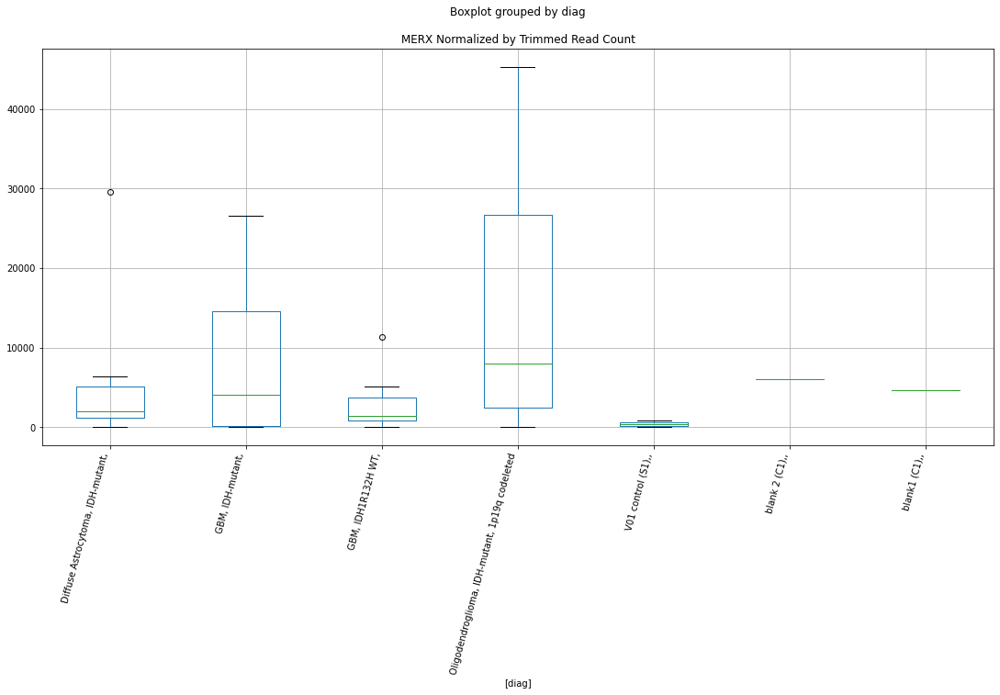

 p : 0.02815515758689504  ( t : 2.3872205105543727 ) :  D-plex  :  cutadapt2  :  LTR16
Control and blanks
76     45456.85
340    11449.52
Name: LTR16, dtype: float64
208    54318.95
Name: LTR16, dtype: float64
472    54327.85
Name: LTR16, dtype: float64


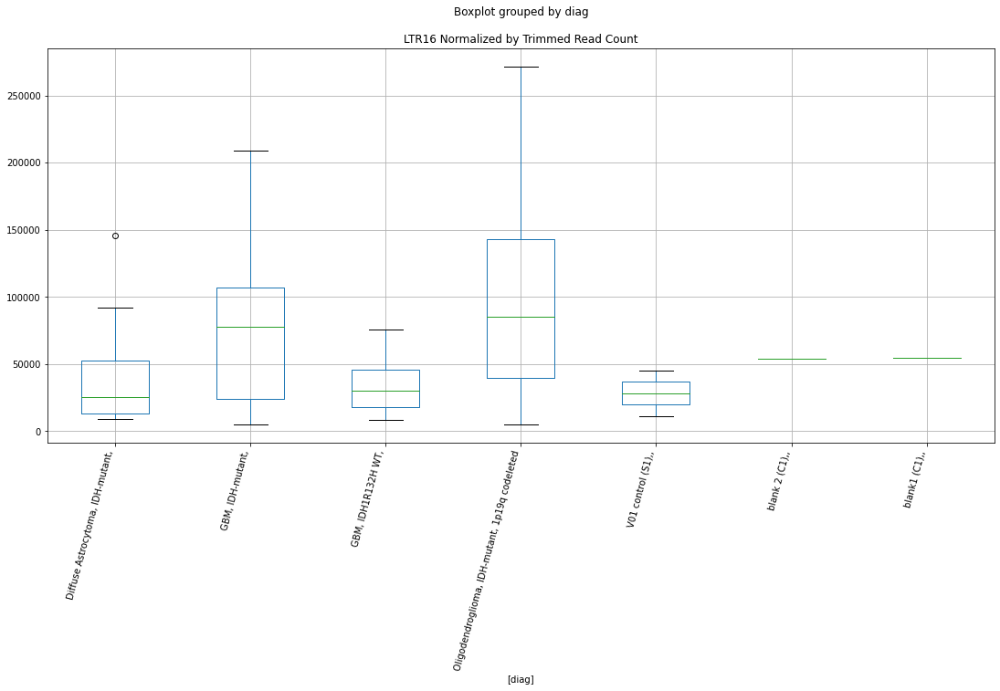

 p : 0.02820543367163716  ( t : 2.386349740234069 ) :  D-plex  :  cutadapt2  :  (CATCAC)n
Control and blanks
76     1515.23
340       0.00
Name: (CATCAC)n, dtype: float64
208    2469.04
Name: (CATCAC)n, dtype: float64
472    2889.78
Name: (CATCAC)n, dtype: float64


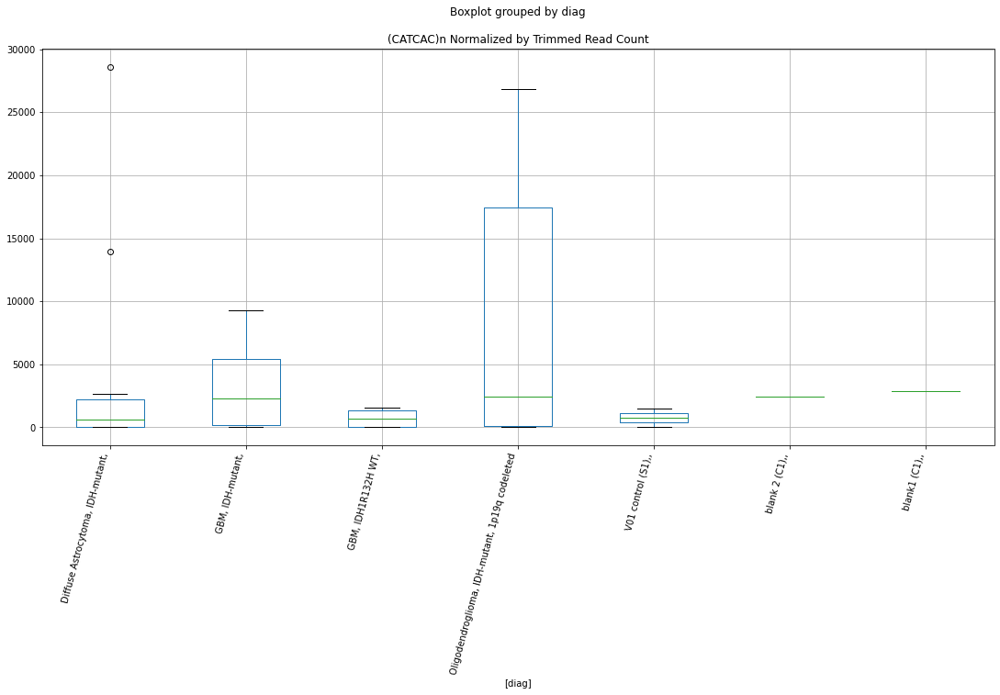

 p : 0.028237415329459302  ( t : 2.3857965793196785 ) :  D-plex  :  bbduk2  :  MERX
Control and blanks
73     0.0
337    0.0
Name: MERX, dtype: float64
205    5910.0
Name: MERX, dtype: float64
469    4732.22
Name: MERX, dtype: float64


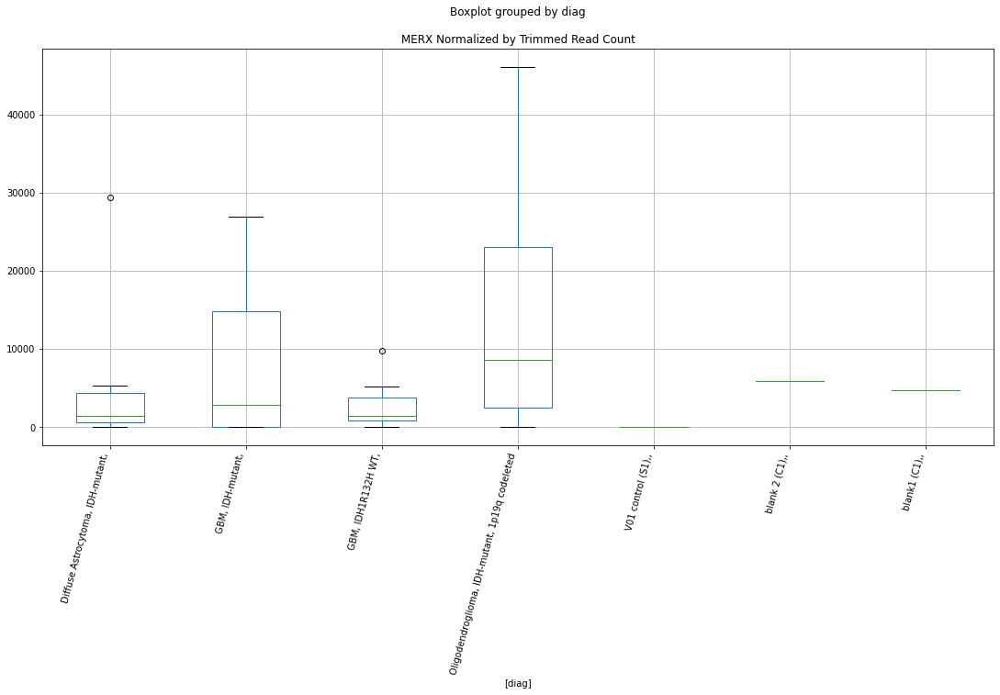

 p : 0.028270450517847896  ( t : 2.385225810366184 ) :  D-plex  :  bbduk2  :  (ACAAGA)n
Control and blanks
73     0.0
337    0.0
Name: (ACAAGA)n, dtype: float64
205    358.18
Name: (ACAAGA)n, dtype: float64
469    0.0
Name: (ACAAGA)n, dtype: float64


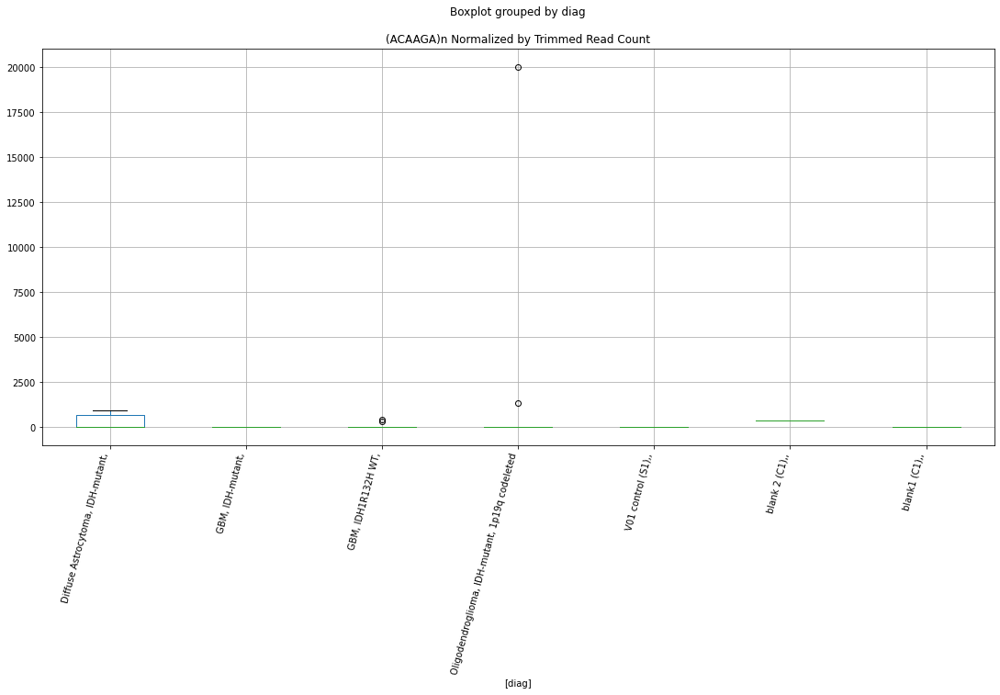

 p : 0.02838696930126583  ( t : 2.383217605521548 ) :  D-plex  :  bbduk2  :  (CATCAC)n
Control and blanks
73     2319.03
337       0.00
Name: (CATCAC)n, dtype: float64
205    2328.18
Name: (CATCAC)n, dtype: float64
469    1774.58
Name: (CATCAC)n, dtype: float64


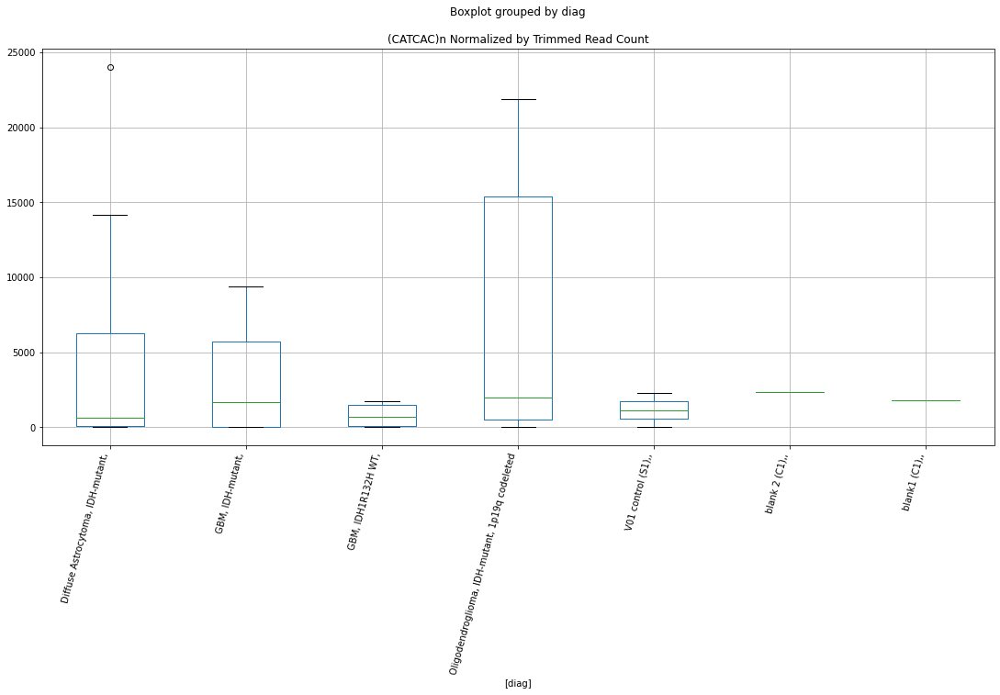

 p : 0.0284387204322521  ( t : 2.3823281406218504 ) :  D-plex  :  bbduk2  :  MER11B
Control and blanks
73     27828.30
337    55189.75
Name: MER11B, dtype: float64
205    19879.1
Name: MER11B, dtype: float64
469    17745.82
Name: MER11B, dtype: float64


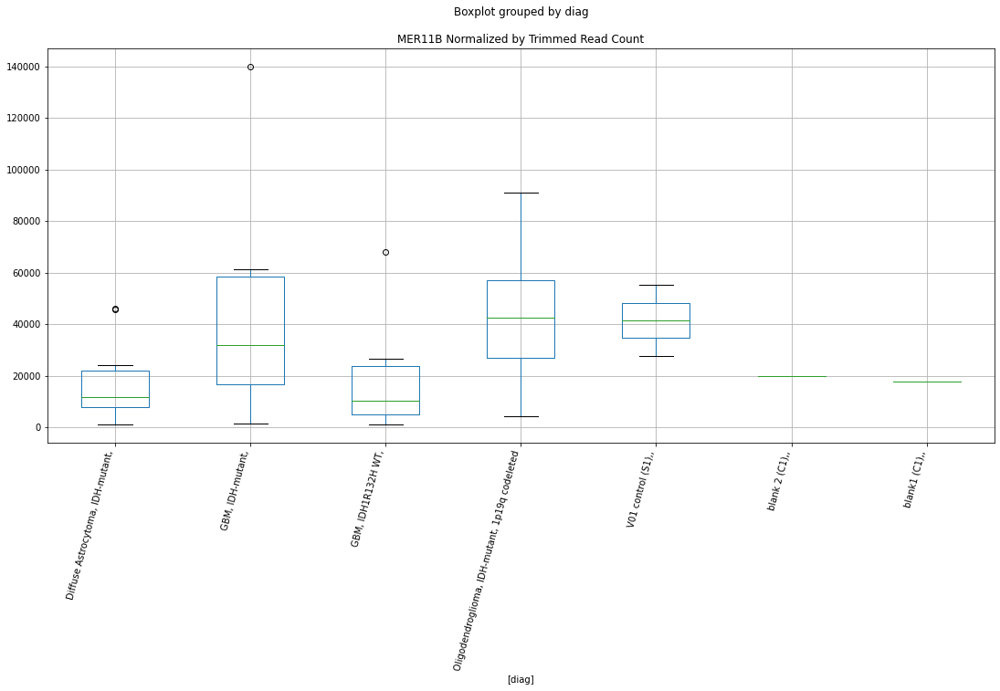

 p : 0.02849890386807305  ( t : 2.381295645460738 ) :  D-plex  :  cutadapt2  :  Tigger11a
Control and blanks
76     2272.84
340     880.73
Name: Tigger11a, dtype: float64
208    5996.25
Name: Tigger11a, dtype: float64
472    6357.51
Name: Tigger11a, dtype: float64


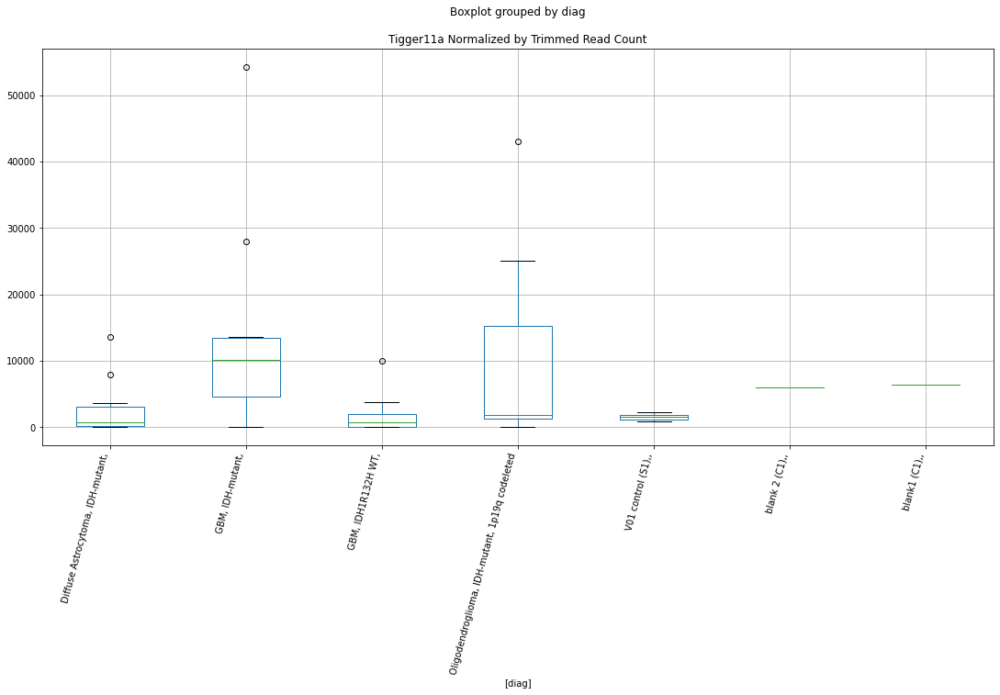

 p : 0.028501413113438616  ( t : 2.3812526415632527 ) :  D-plex  :  cutadapt2  :  (GTG)n
Control and blanks
76     757.61
340      0.00
Name: (GTG)n, dtype: float64
208    3879.92
Name: (GTG)n, dtype: float64
472    3467.74
Name: (GTG)n, dtype: float64


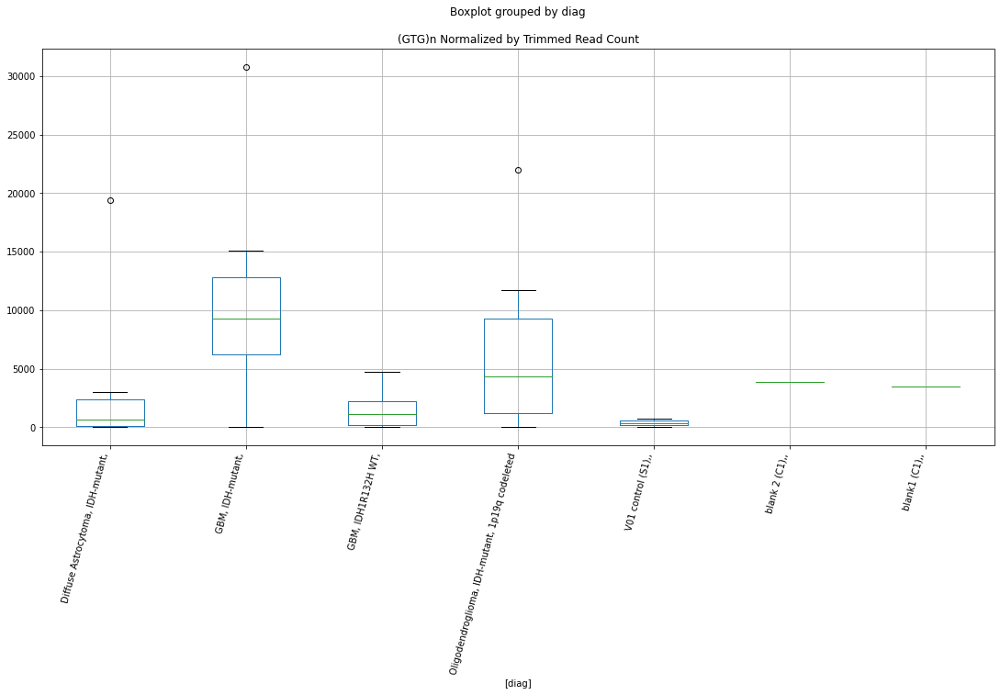

 p : 0.02850456802645491  ( t : 2.3811985771134014 ) :  D-plex  :  cutadapt2  :  MER65D
Control and blanks
76     0.0
340    0.0
Name: MER65D, dtype: float64
208    6878.05
Name: MER65D, dtype: float64
472    9825.25
Name: MER65D, dtype: float64


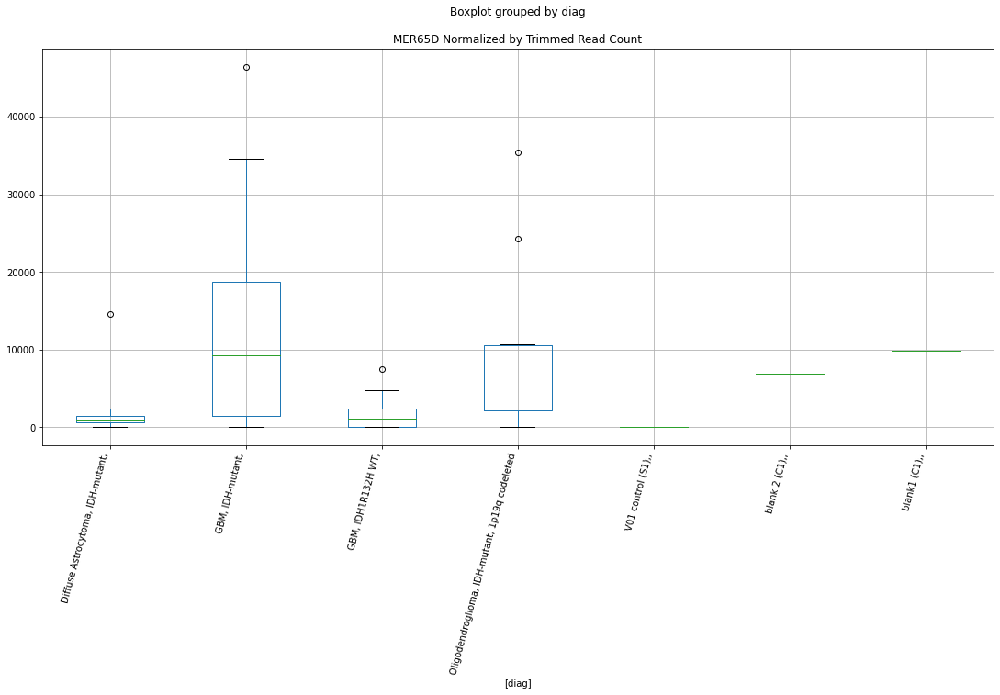

 p : 0.028513423161072634  ( t : 2.381046860145326 ) :  D-plex  :  bbduk2  :  MamGypLTR3a
Control and blanks
73       773.01
337    60530.69
Name: MamGypLTR3a, dtype: float64
205    14327.28
Name: MamGypLTR3a, dtype: float64
469    14788.18
Name: MamGypLTR3a, dtype: float64


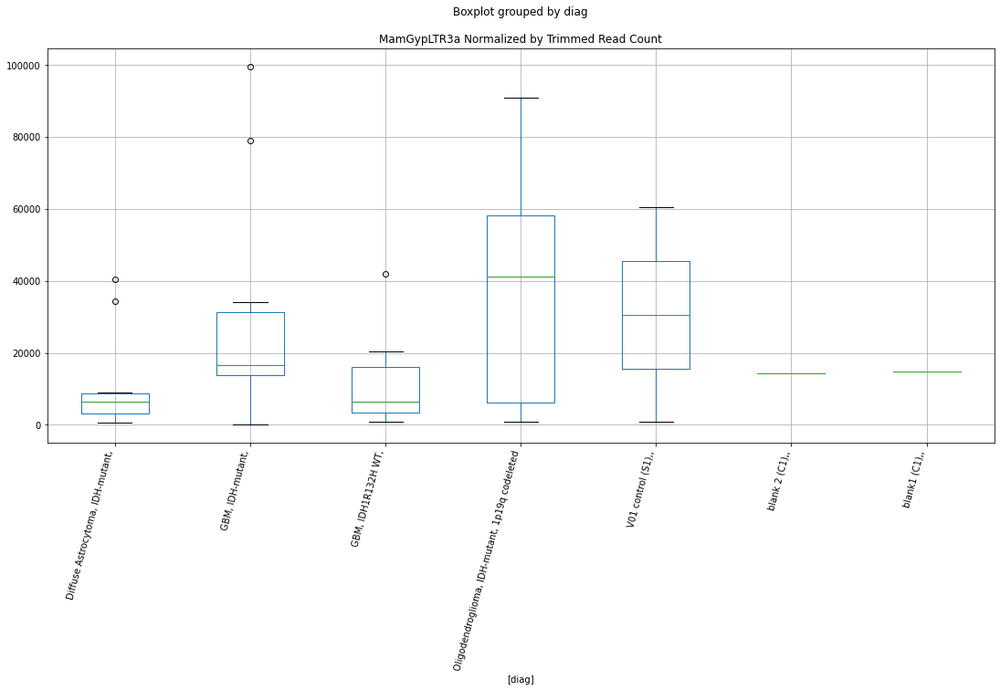

 p : 0.028531851584996187  ( t : 2.3807312628845745 ) :  D-plex  :  cutadapt2  :  (CTTTCT)n
Control and blanks
76     757.61
340    880.73
Name: (CTTTCT)n, dtype: float64
208    1058.16
Name: (CTTTCT)n, dtype: float64
472    1155.91
Name: (CTTTCT)n, dtype: float64


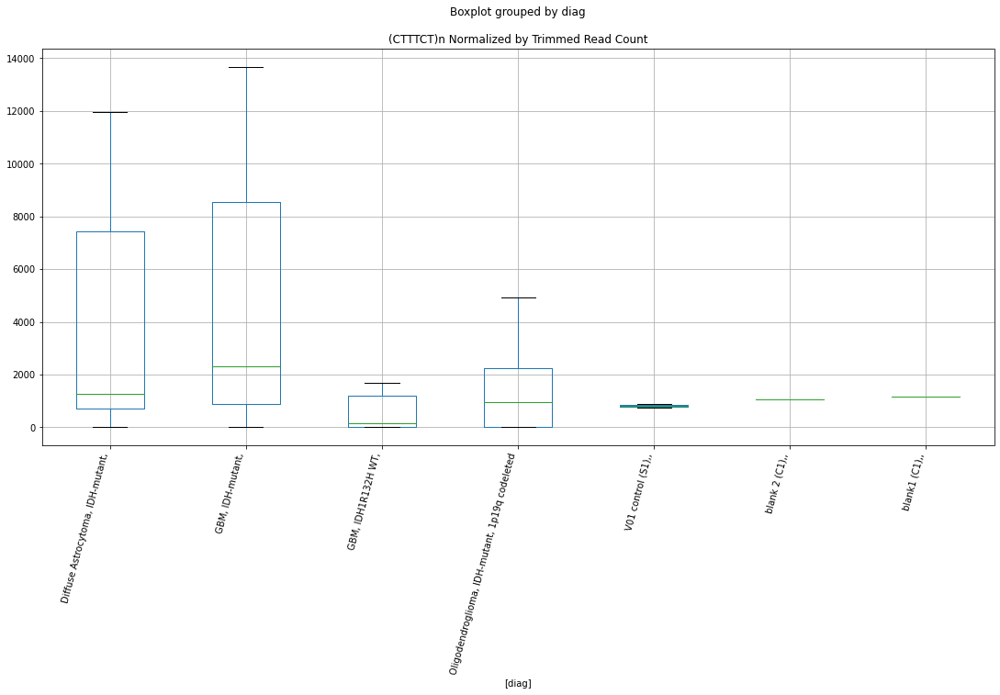

 p : 0.028533390848892743  ( t : 2.3807049107254015 ) :  D-plex  :  cutadapt2  :  LTR40c
Control and blanks
76     0.0
340    0.0
Name: LTR40c, dtype: float64
208    9876.17
Name: LTR40c, dtype: float64
472    13870.94
Name: LTR40c, dtype: float64


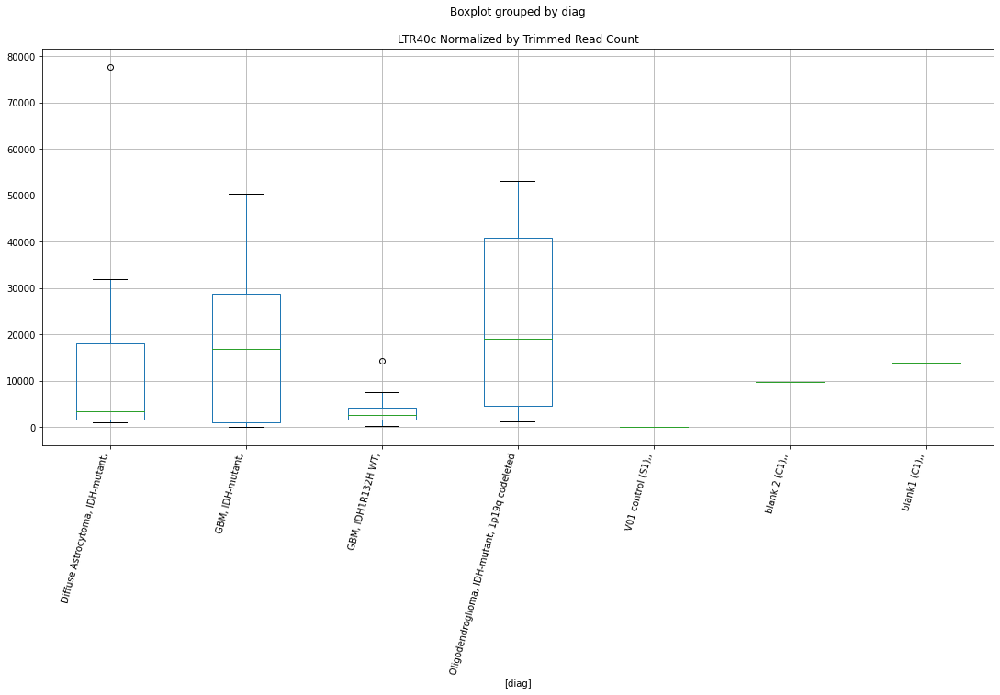

 p : 0.028643691922030923  ( t : 2.3788200053819413 ) :  D-plex  :  bbduk2  :  LTR16B2
Control and blanks
73      4638.05
337    35606.29
Name: LTR16B2, dtype: float64
205    27938.19
Name: LTR16B2, dtype: float64
469    29576.37
Name: LTR16B2, dtype: float64


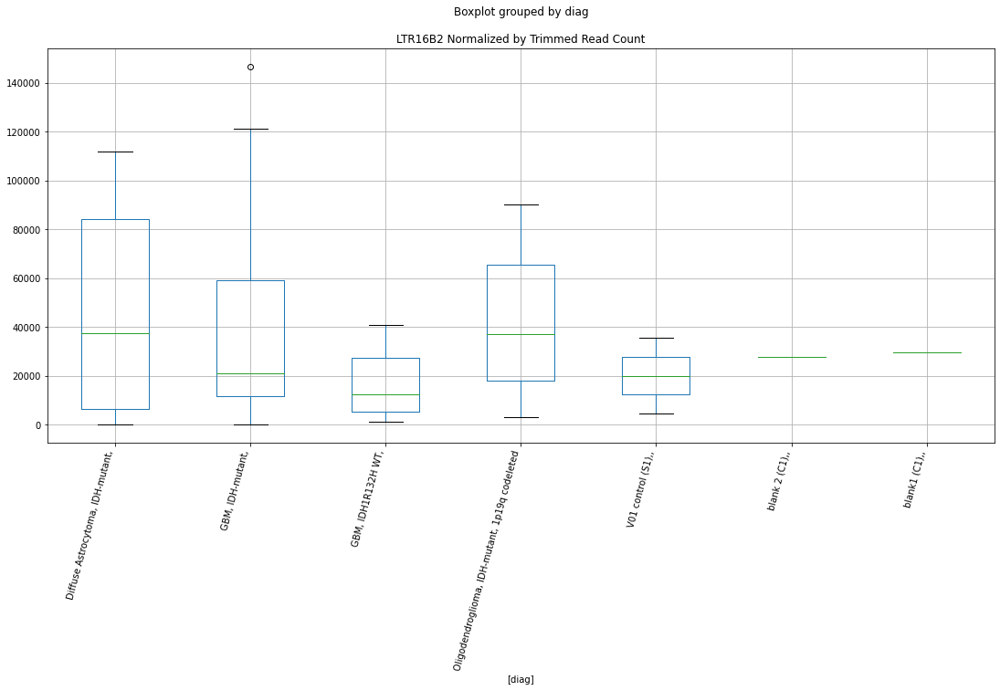

 p : 0.028652370685623263  ( t : 2.3786719839980917 ) :  D-plex  :  cutadapt2  :  Charlie23a
Control and blanks
76     4545.69
340     880.73
Name: Charlie23a, dtype: float64
208    17106.94
Name: Charlie23a, dtype: float64
472    12715.03
Name: Charlie23a, dtype: float64


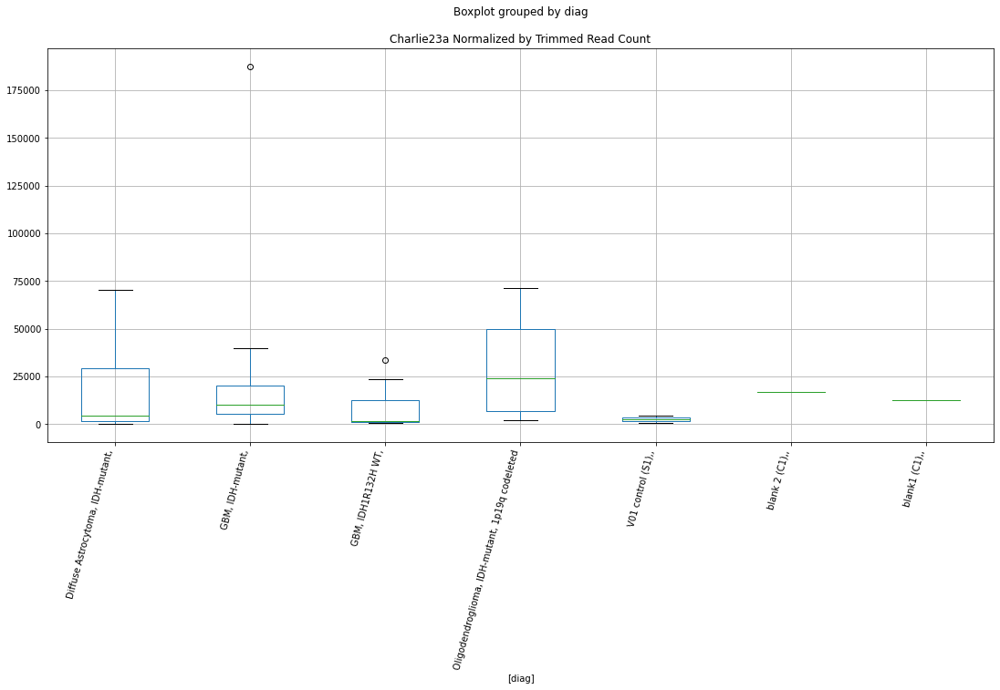

 p : 0.02866905632600838  ( t : 2.3783875181899177 ) :  D-plex  :  cutadapt2  :  (TCCCT)n
Control and blanks
76     2272.84
340       0.00
Name: (TCCCT)n, dtype: float64
208    4232.65
Name: (TCCCT)n, dtype: float64
472    4045.69
Name: (TCCCT)n, dtype: float64


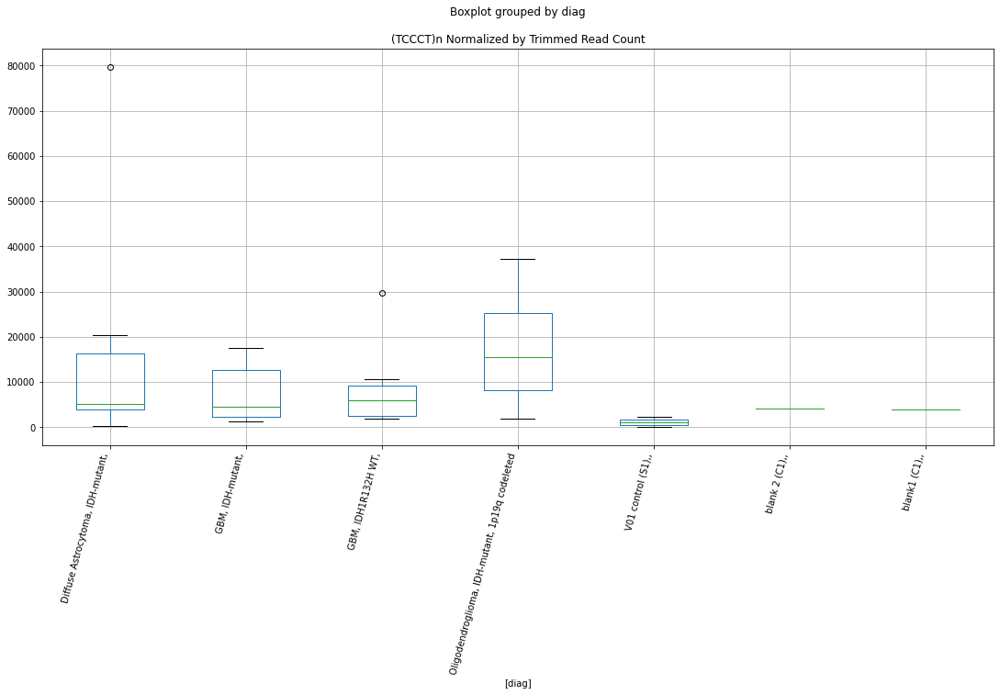

 p : 0.028762520883472944  ( t : 2.3767969353398284 ) :  D-plex  :  cutadapt2  :  Tigger9b
Control and blanks
76     2272.84
340    5284.39
Name: Tigger9b, dtype: float64
208    8112.57
Name: Tigger9b, dtype: float64
472    13870.94
Name: Tigger9b, dtype: float64


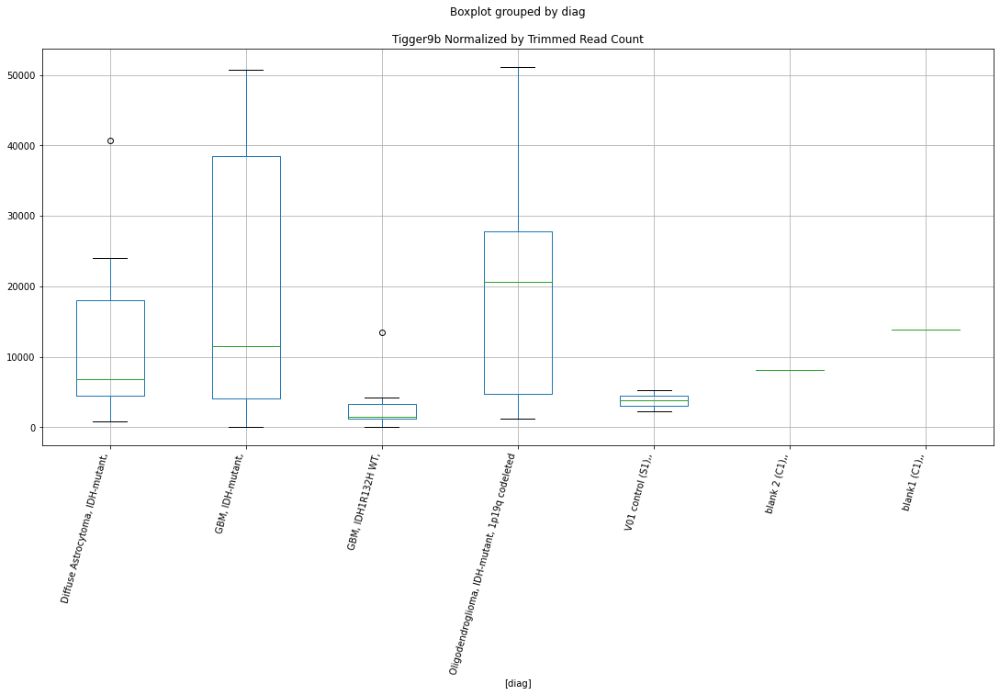

 p : 0.02877500822015978  ( t : 2.3765847908547766 ) :  D-plex  :  cutadapt2  :  LTR16B2
Control and blanks
76      5303.30
340    35229.29
Name: LTR16B2, dtype: float64
208    25748.59
Name: LTR16B2, dtype: float64
472    29475.75
Name: LTR16B2, dtype: float64


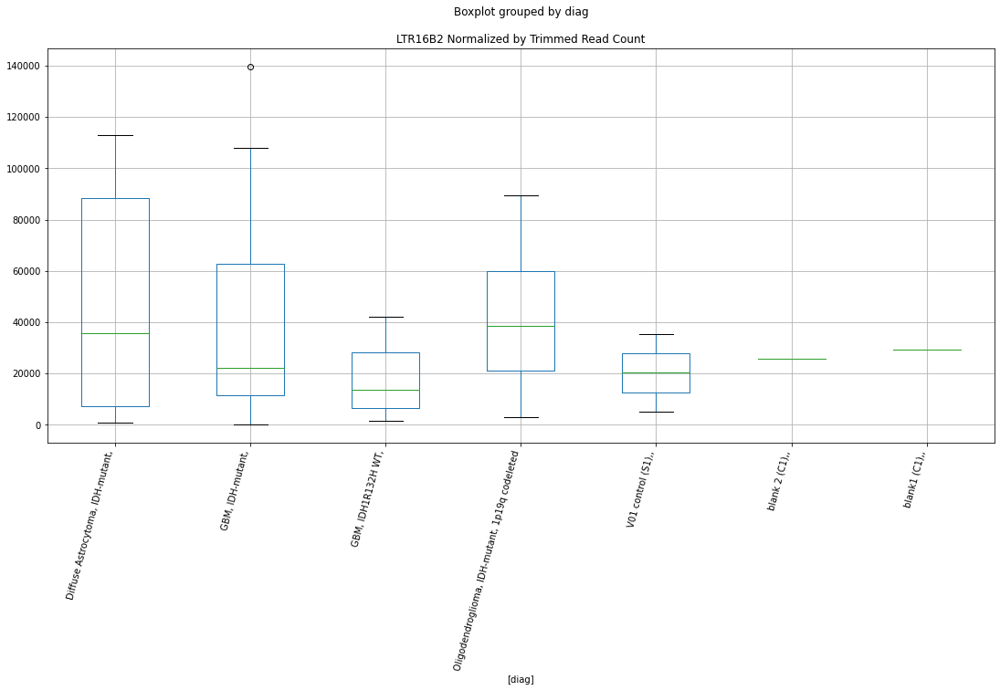

 p : 0.028800841742956395  ( t : 2.3761461836823408 ) :  D-plex  :  cutadapt2  :  (ACCC)n
Control and blanks
76       0.00
340    880.73
Name: (ACCC)n, dtype: float64
208    176.36
Name: (ACCC)n, dtype: float64
472    577.96
Name: (ACCC)n, dtype: float64


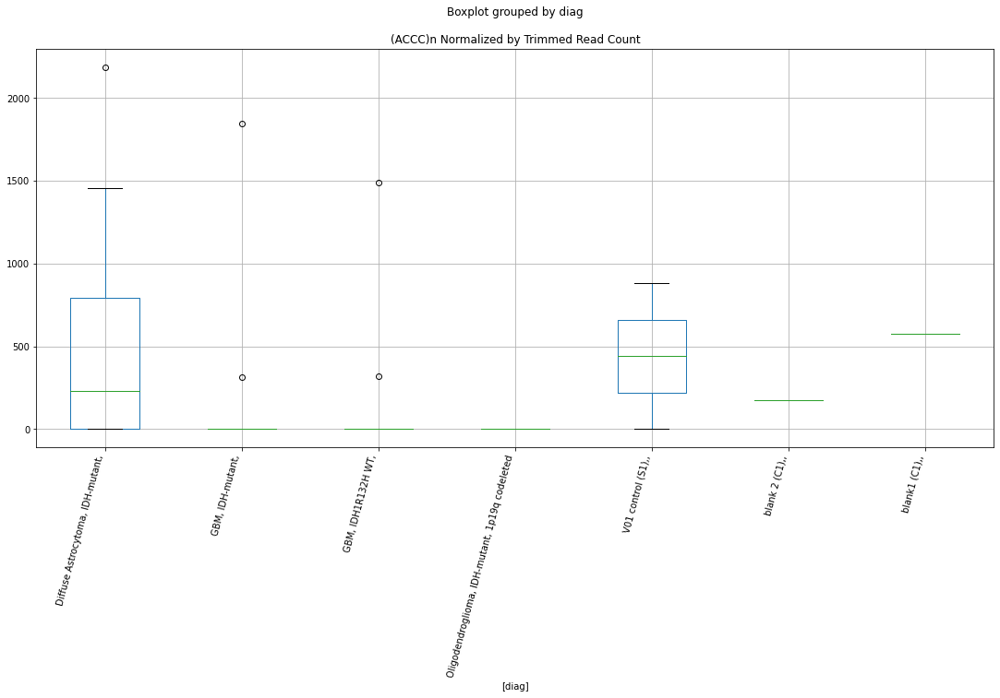

 p : 0.02900793581657562  ( t : 2.372643303961087 ) :  D-plex  :  bbduk2  :  (TTTCTTT)n
Control and blanks
73     0.0
337    0.0
Name: (TTTCTTT)n, dtype: float64
205    0.0
Name: (TTTCTTT)n, dtype: float64
469    0.0
Name: (TTTCTTT)n, dtype: float64


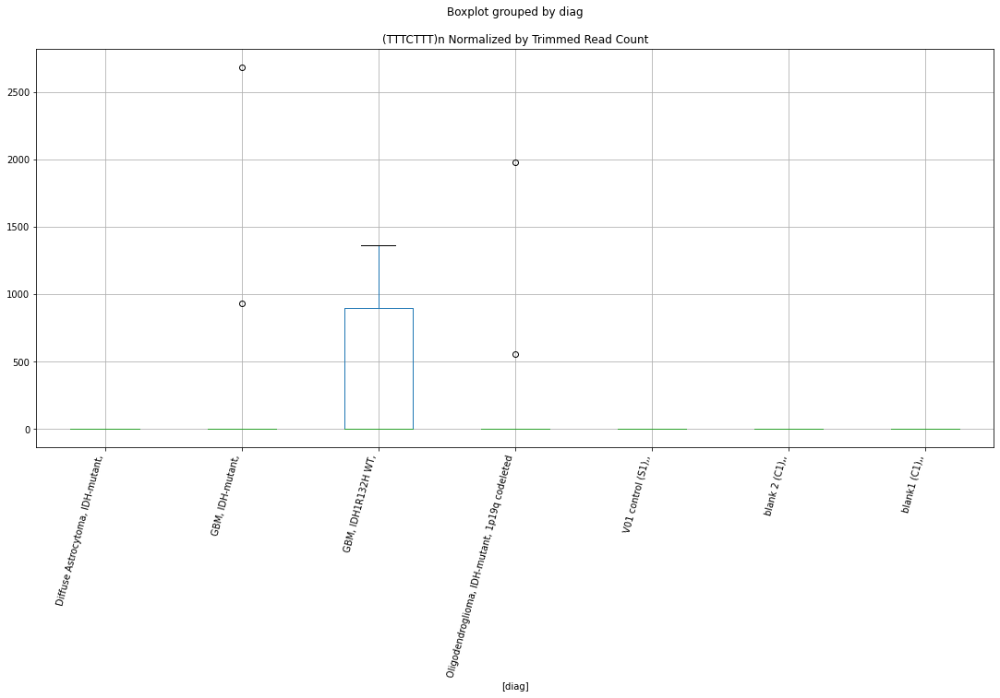

 p : 0.02900995881827284  ( t : 2.372609201245831 ) :  D-plex  :  bbduk2  :  MER52D
Control and blanks
73     12368.13
337    24034.25
Name: MER52D, dtype: float64
205    26863.64
Name: MER52D, dtype: float64
469    23069.57
Name: MER52D, dtype: float64


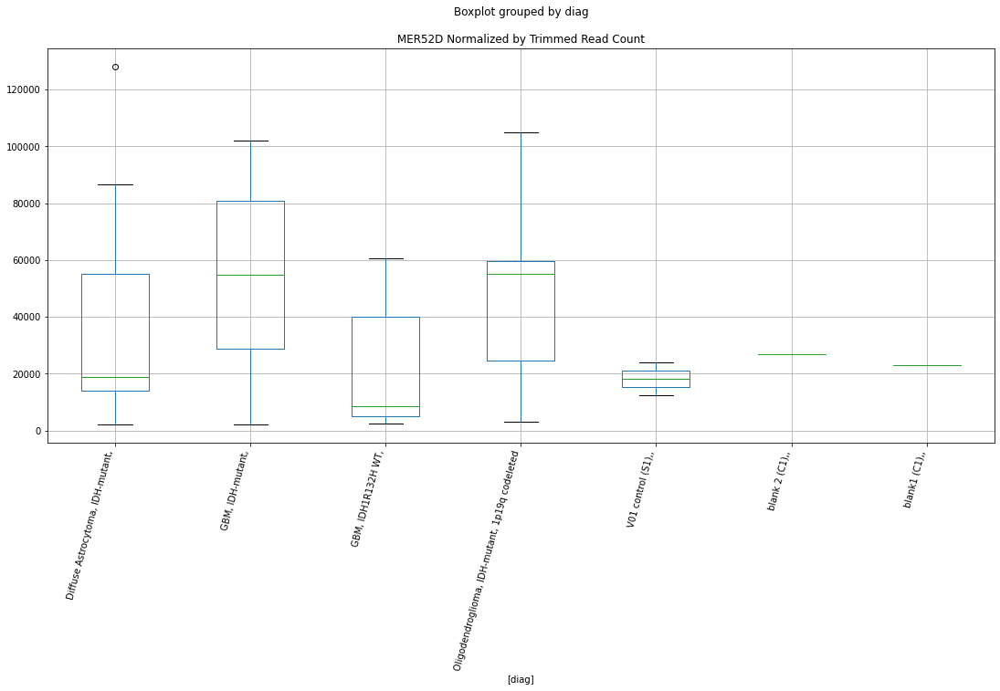

 p : 0.029018055645442513  ( t : 2.3724727313320644 ) :  D-plex  :  bbduk2  :  AmnSINE2
Control and blanks
73     2319.03
337       0.00
Name: AmnSINE2, dtype: float64
205    4119.09
Name: AmnSINE2, dtype: float64
469    2957.64
Name: AmnSINE2, dtype: float64


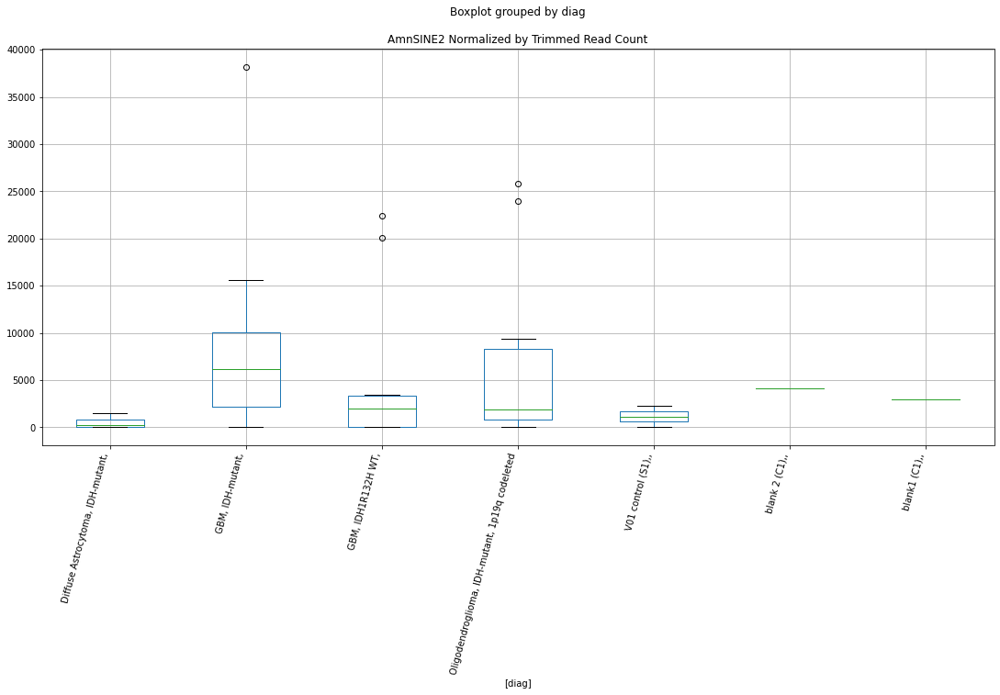

 p : 0.02909869674475119  ( t : 2.371115481995083 ) :  D-plex  :  cutadapt2  :  (GGAGGG)n
Control and blanks
76     1515.23
340    1761.46
Name: (GGAGGG)n, dtype: float64
208    705.44
Name: (GGAGGG)n, dtype: float64
472    1733.87
Name: (GGAGGG)n, dtype: float64


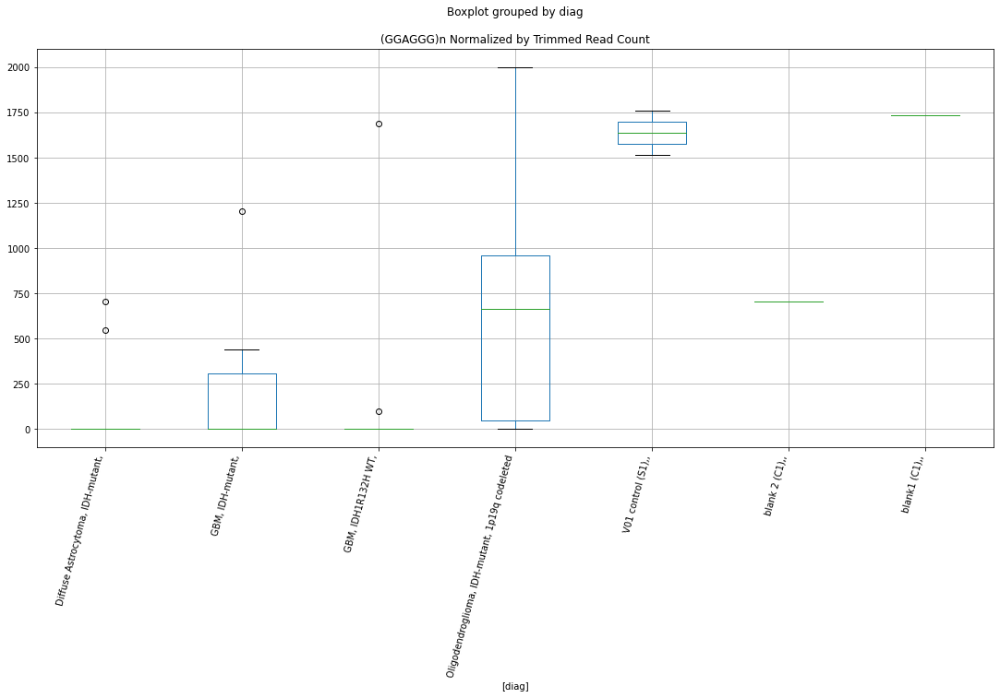

 p : 0.02910987075493767  ( t : 2.3709276919904165 ) :  D-plex  :  cutadapt2  :  (GTTT)n
Control and blanks
76     1515.23
340    1761.46
Name: (GTTT)n, dtype: float64
208    1939.96
Name: (GTTT)n, dtype: float64
472    3467.74
Name: (GTTT)n, dtype: float64


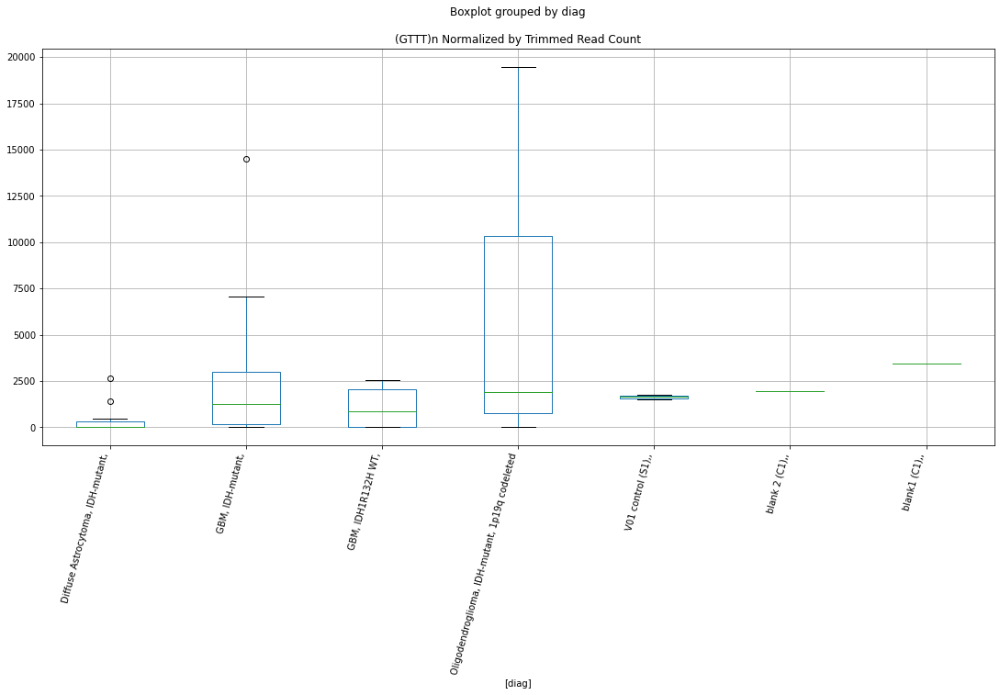

 p : 0.029194203942358804  ( t : 2.3695125563866997 ) :  D-plex  :  bbduk2  :  LTR85a
Control and blanks
73         0.00
337    19583.46
Name: LTR85a, dtype: float64
205    17013.64
Name: LTR85a, dtype: float64
469    11239.02
Name: LTR85a, dtype: float64


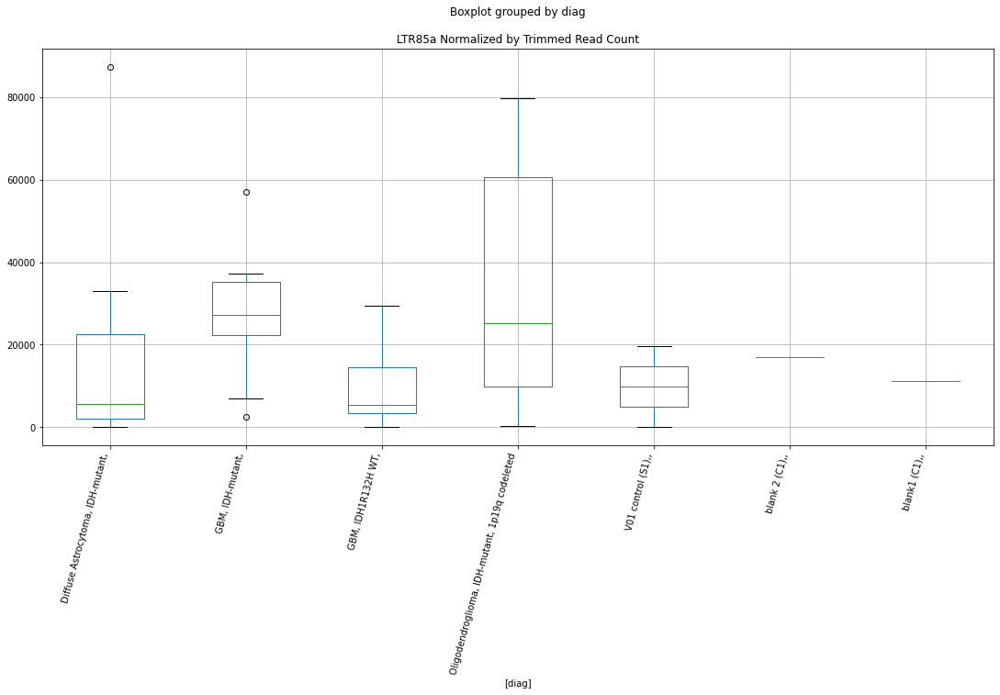

 p : 0.029207109147498838  ( t : 2.369296339721074 ) :  D-plex  :  cutadapt2  :  MLT1E2-int
Control and blanks
76     0.0
340    0.0
Name: MLT1E2-int, dtype: float64
208    6172.61
Name: MLT1E2-int, dtype: float64
472    6357.51
Name: MLT1E2-int, dtype: float64


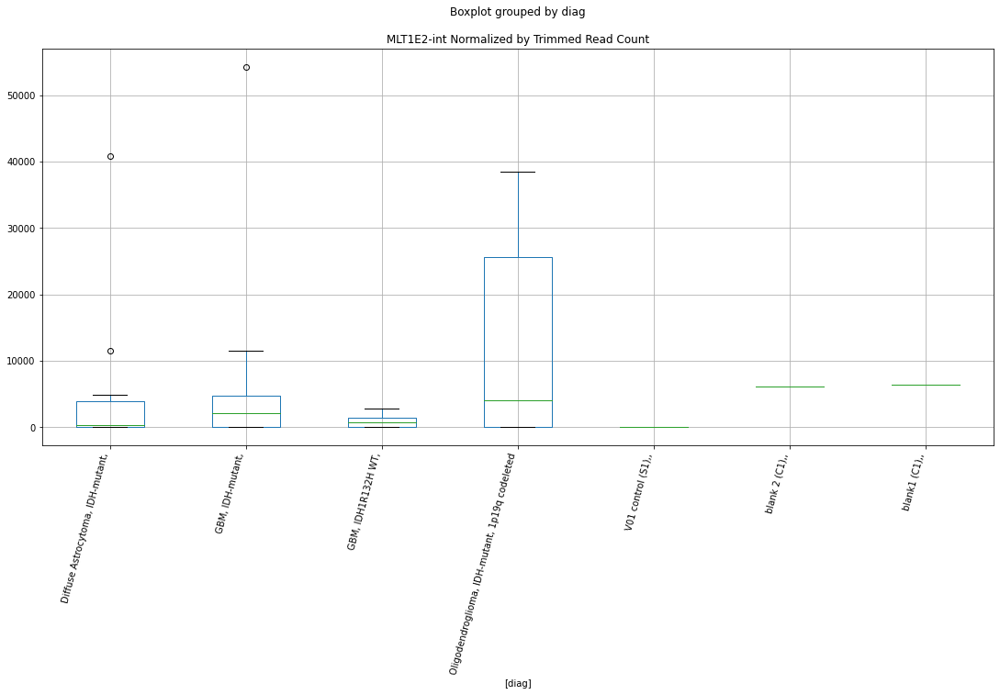

 p : 0.029210528462178684  ( t : 2.3692390666976753 ) :  D-plex  :  cutadapt2  :  MER67B
Control and blanks
76      757.61
340    1761.46
Name: MER67B, dtype: float64
208    7054.41
Name: MER67B, dtype: float64
472    8669.34
Name: MER67B, dtype: float64


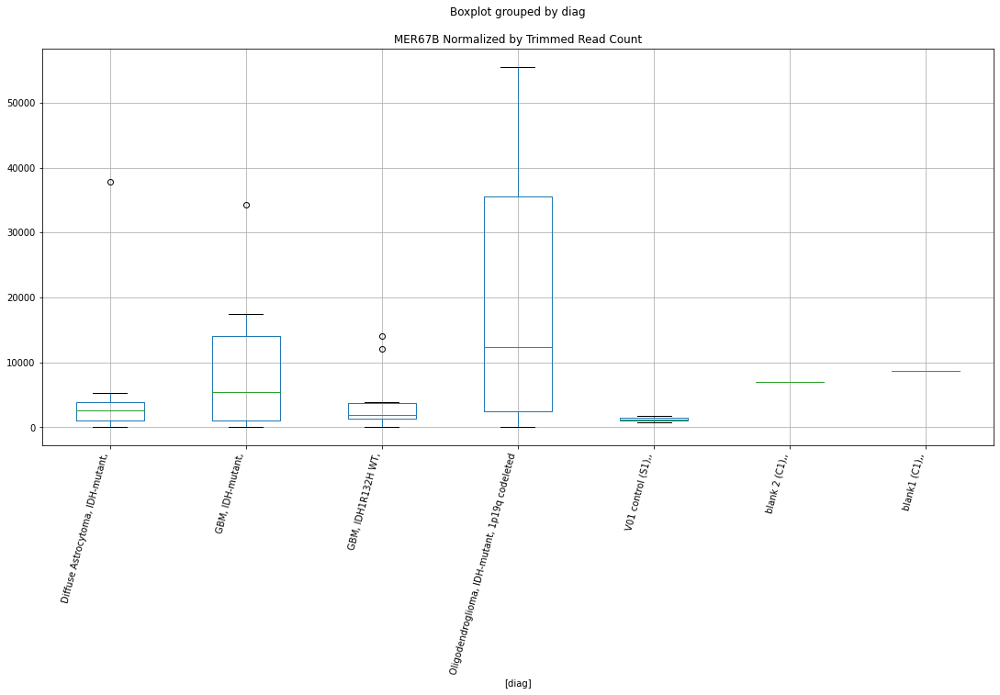

 p : 0.029220715046286757  ( t : 2.3690684799503856 ) :  D-plex  :  cutadapt2  :  MER77B
Control and blanks
76     31819.80
340    39632.95
Name: MER77B, dtype: float64
208    34919.32
Name: MER77B, dtype: float64
472    26008.01
Name: MER77B, dtype: float64


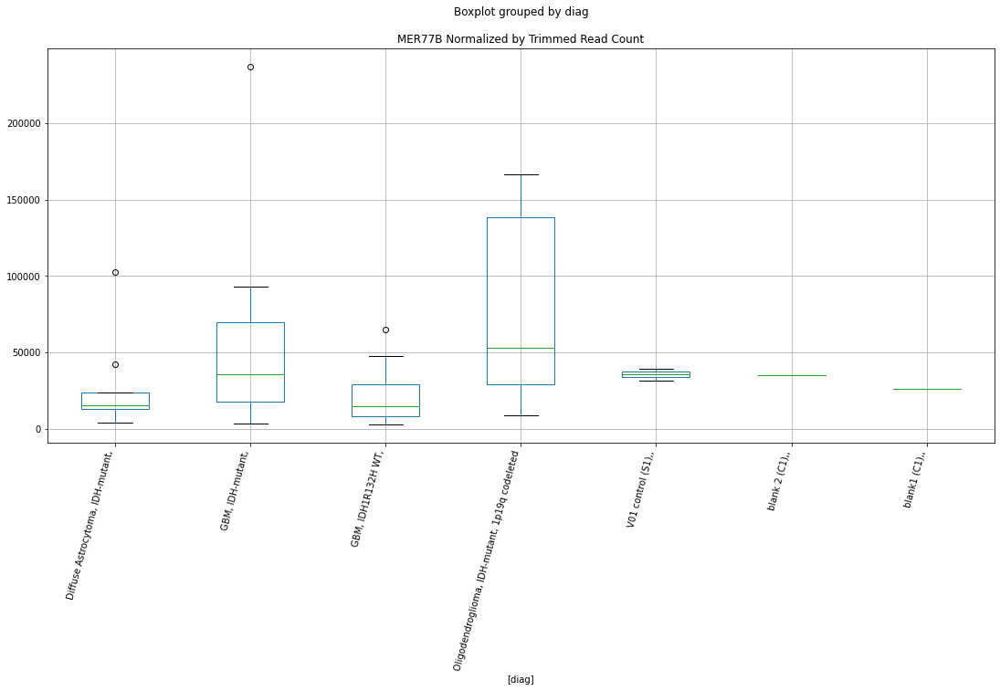

 p : 0.029448816929886126  ( t : 2.3652630893913993 ) :  Lexogen  :  cutadapt2  :  L1HS
Control and blanks
82     1420.05
346       0.00
Name: L1HS, dtype: float64
214    0.0
Name: L1HS, dtype: float64
478    237.46
Name: L1HS, dtype: float64


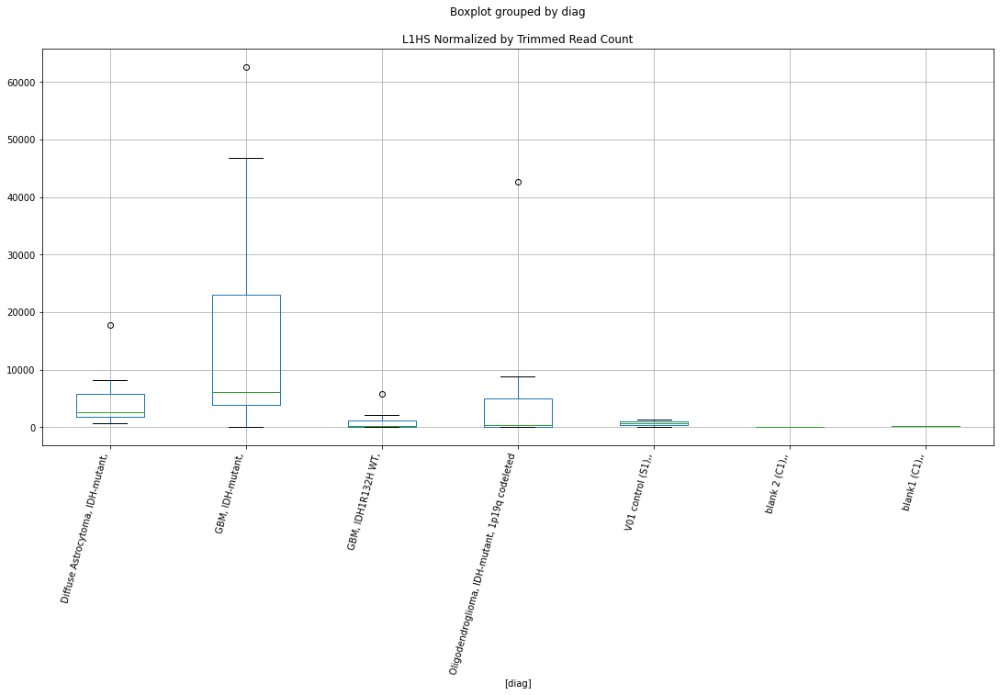

 p : 0.029631053791267643  ( t : 2.362242556279156 ) :  Lexogen  :  cutadapt2  :  HY5
Control and blanks
82       0.00
346    210.43
Name: HY5, dtype: float64
214    0.0
Name: HY5, dtype: float64
478    0.0
Name: HY5, dtype: float64


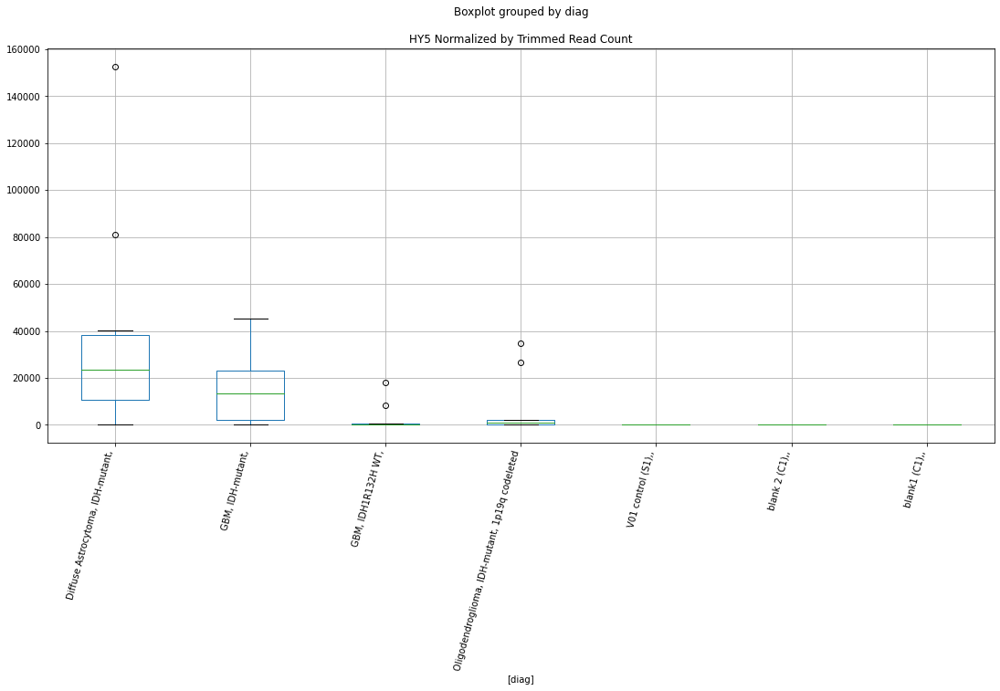

 p : 0.029658984383384195  ( t : 2.3617811445028827 ) :  D-plex  :  bbduk2  :  (CCCTAA)n
Control and blanks
73     1546.02
337       0.00
Name: (CCCTAA)n, dtype: float64
205    2328.18
Name: (CCCTAA)n, dtype: float64
469    3549.16
Name: (CCCTAA)n, dtype: float64


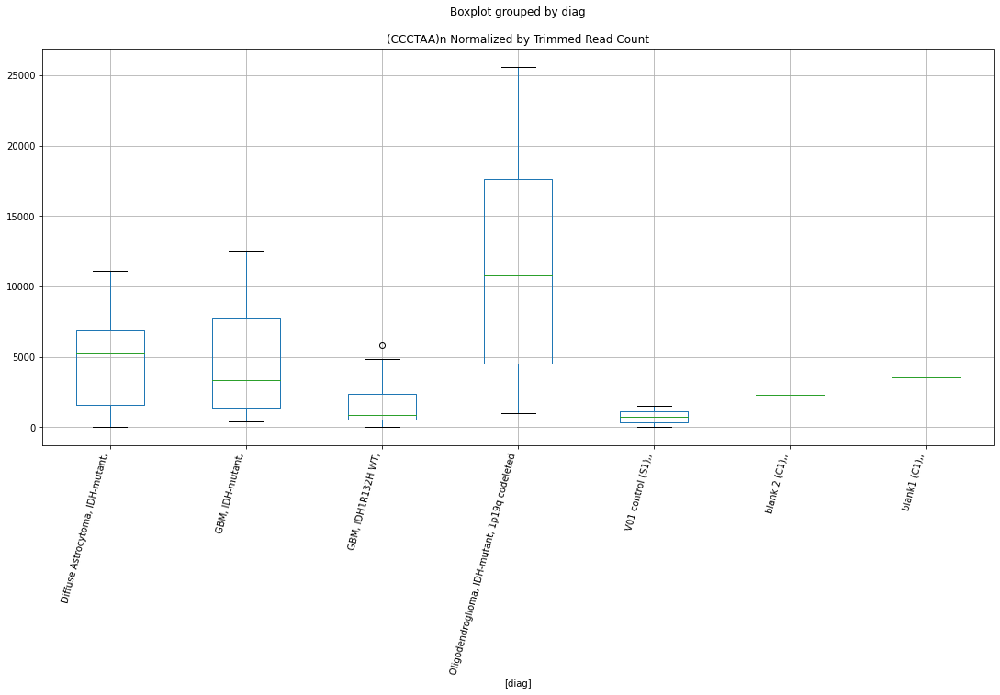

 p : 0.02967761527623561  ( t : 2.361473588358387 ) :  D-plex  :  bbduk2  :  (CAC)n
Control and blanks
73     2319.03
337    1780.31
Name: (CAC)n, dtype: float64
205    5910.0
Name: (CAC)n, dtype: float64
469    7098.33
Name: (CAC)n, dtype: float64


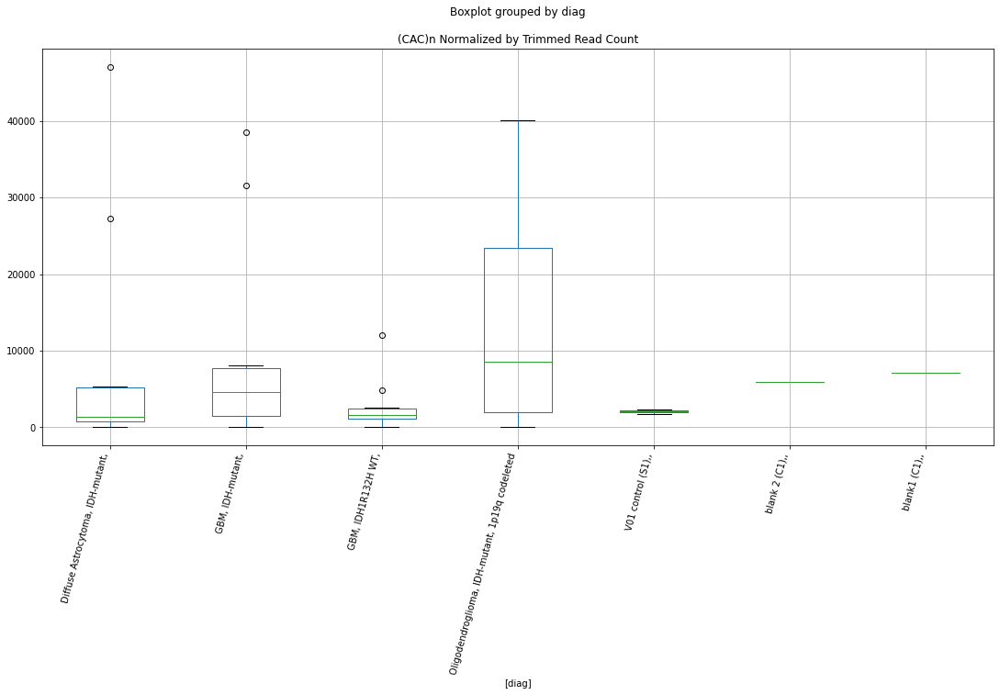

 p : 0.029707273418008  ( t : 2.3609843670046384 ) :  D-plex  :  bbduk2  :  LTR16
Control and blanks
73     44834.49
337    14242.52
Name: LTR16, dtype: float64
205    48712.74
Name: LTR16, dtype: float64
469    50871.35
Name: LTR16, dtype: float64


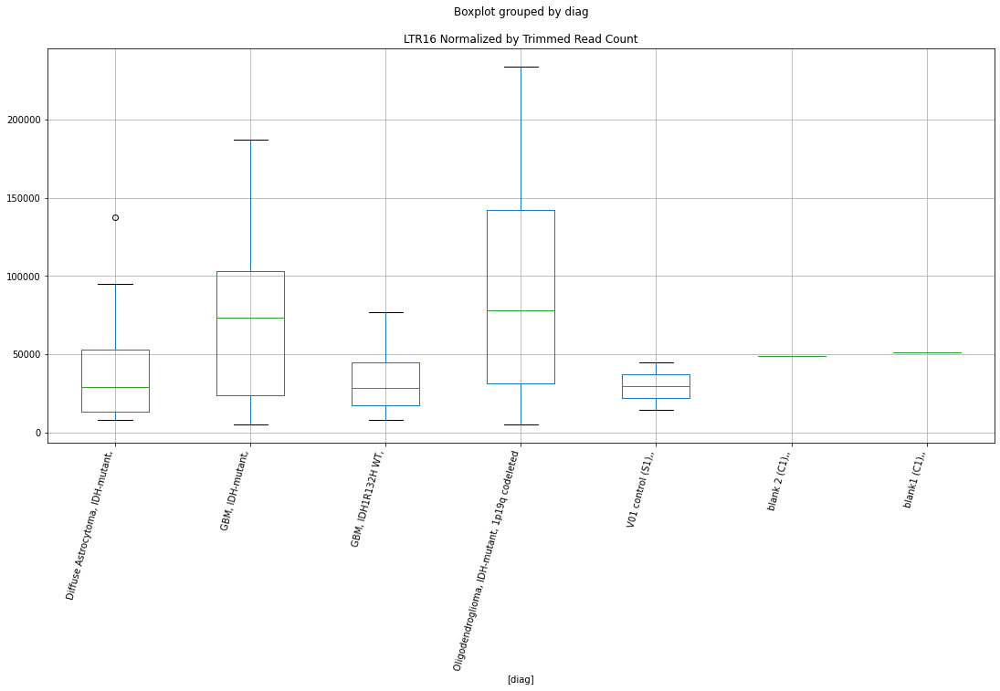

 p : 0.029843095633034614  ( t : 2.3587497319515633 ) :  Lexogen  :  bbduk2  :  HY5
Control and blanks
79       0.00
343    212.31
Name: HY5, dtype: float64
211    0.0
Name: HY5, dtype: float64
475    0.0
Name: HY5, dtype: float64


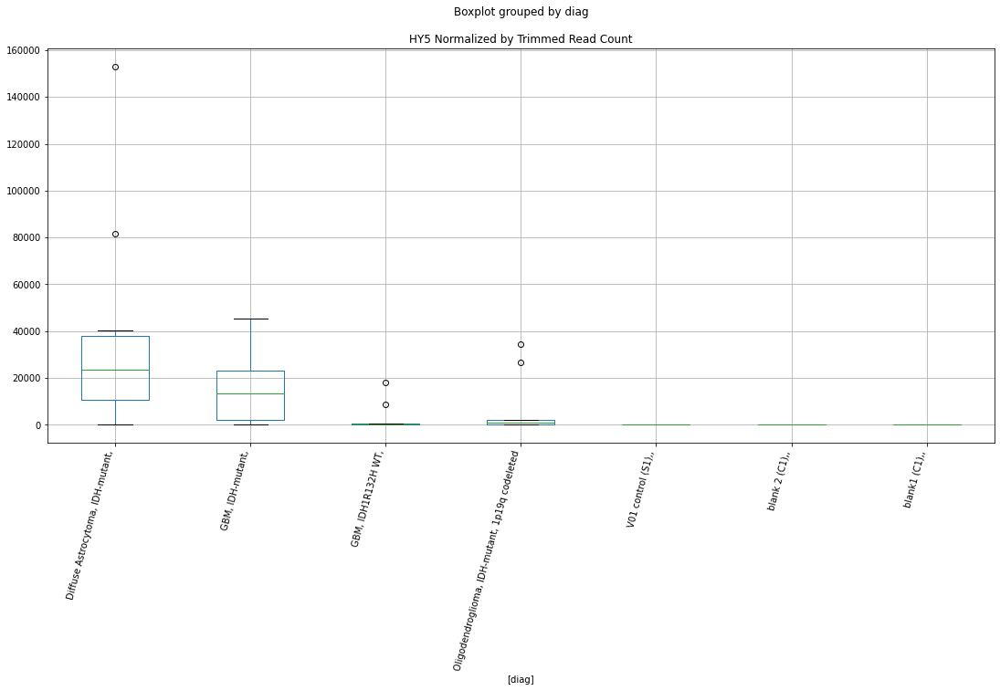

 p : 0.02993891175843601  ( t : 2.3571789970754367 ) :  D-plex  :  bbduk2  :  (ATCGAATGGAATC)n
Control and blanks
73      6957.08
337    13352.36
Name: (ATCGAATGGAATC)n, dtype: float64
205    2686.36
Name: (ATCGAATGGAATC)n, dtype: float64
469    5323.75
Name: (ATCGAATGGAATC)n, dtype: float64


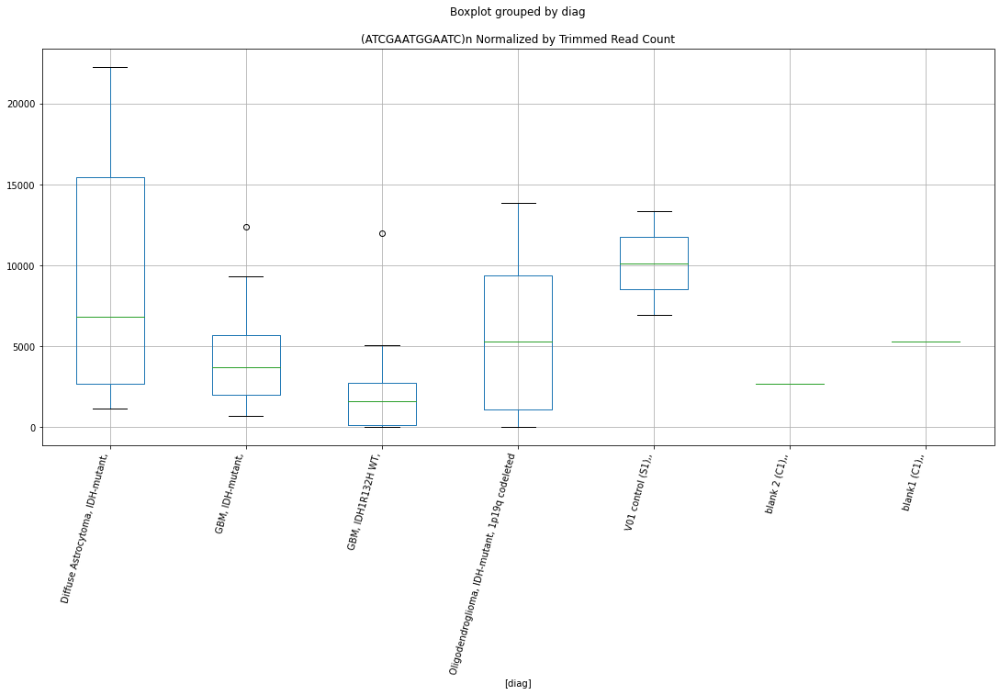

 p : 0.029973796904695805  ( t : 2.3566082800832433 ) :  D-plex  :  bbduk2  :  HERVFH19-int
Control and blanks
73      3865.04
337    21363.77
Name: HERVFH19-int, dtype: float64
205    8417.27
Name: HERVFH19-int, dtype: float64
469    5323.75
Name: HERVFH19-int, dtype: float64


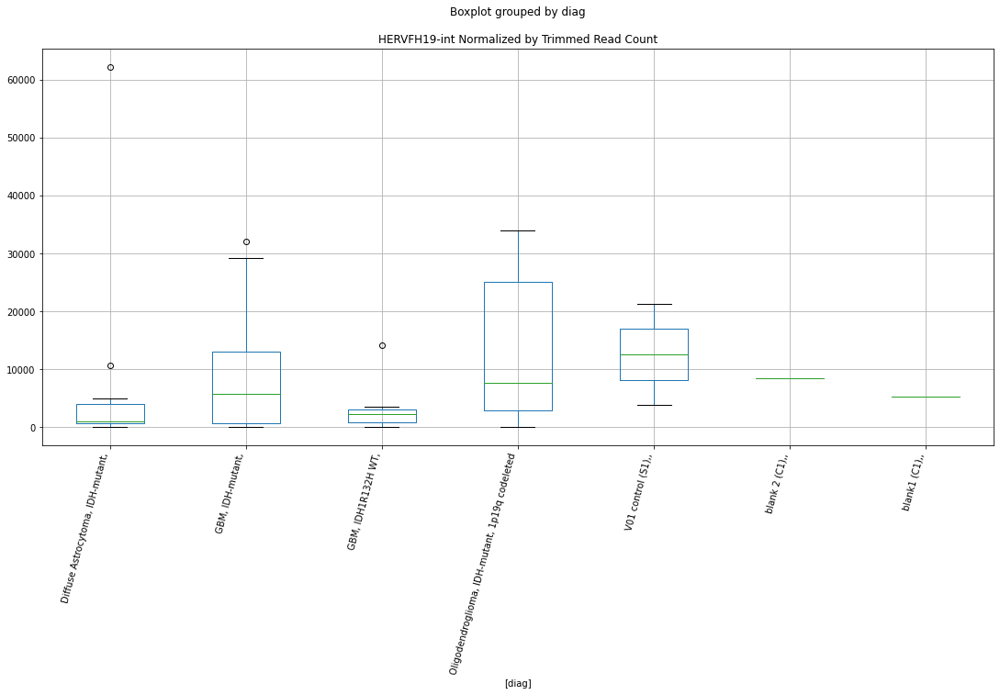

 p : 0.029983658823041315  ( t : 2.3564470524338836 ) :  D-plex  :  bbduk2  :  (CCCTCCT)n
Control and blanks
73     0.0
337    0.0
Name: (CCCTCCT)n, dtype: float64
205    358.18
Name: (CCCTCCT)n, dtype: float64
469    1183.05
Name: (CCCTCCT)n, dtype: float64


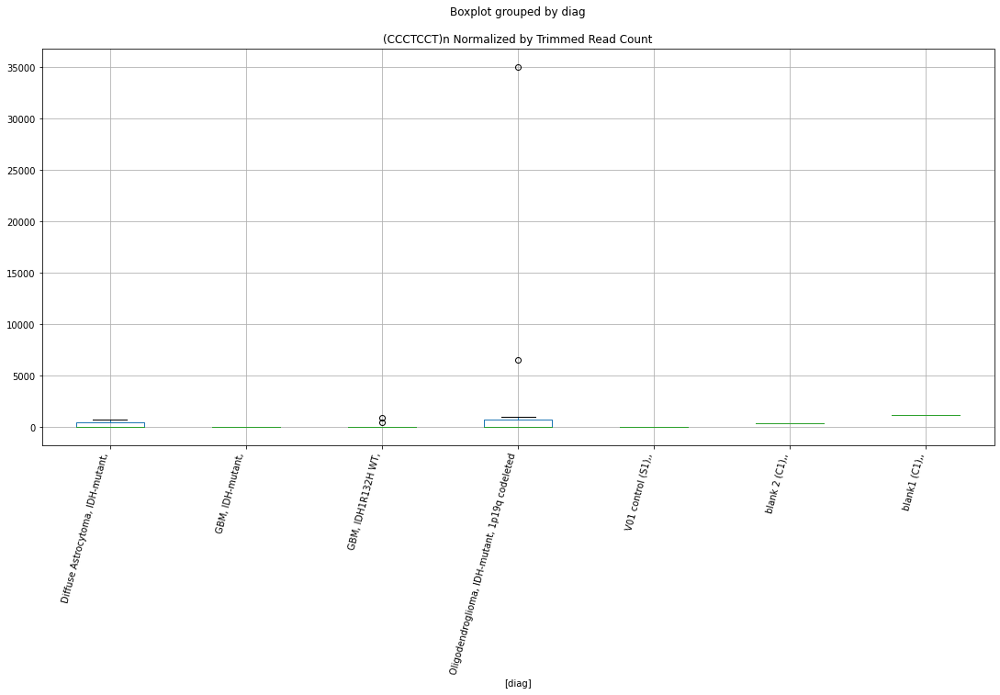

 p : 0.030049867528776864  ( t : 2.355365916377561 ) :  D-plex  :  bbduk2  :  (CAAGCCAGC)n
Control and blanks
73     0.0
337    0.0
Name: (CAAGCCAGC)n, dtype: float64
205    20953.64
Name: (CAAGCCAGC)n, dtype: float64
469    0.0
Name: (CAAGCCAGC)n, dtype: float64


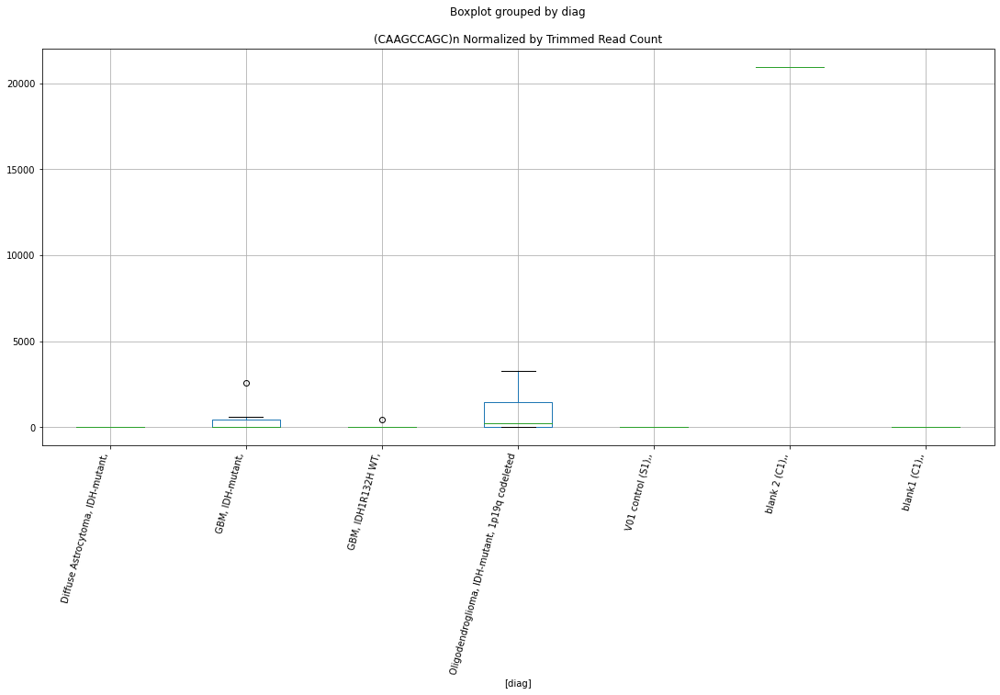

 p : 0.030069840842529196  ( t : 2.3550402035737745 ) :  D-plex  :  cutadapt2  :  (TTTCT)n
Control and blanks
76      3788.07
340    22018.30
Name: (TTTCT)n, dtype: float64
208    2998.12
Name: (TTTCT)n, dtype: float64
472    1155.91
Name: (TTTCT)n, dtype: float64


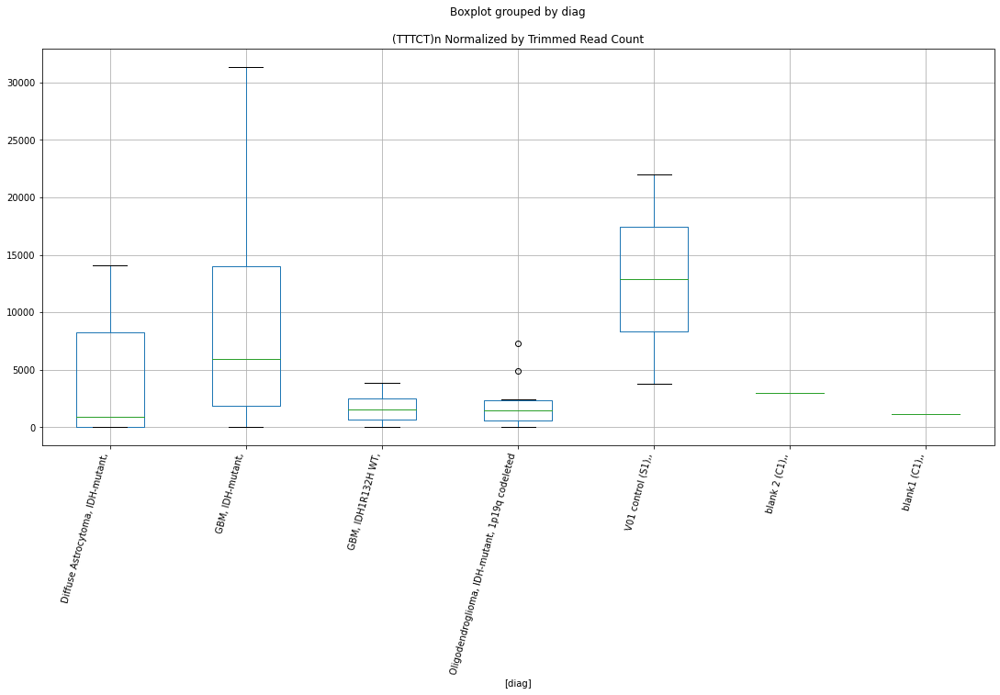

 p : 0.030072688258565676  ( t : 2.354993786038482 ) :  D-plex  :  cutadapt2  :  (CAAGCCAGC)n
Control and blanks
76     0.0
340    0.0
Name: (CAAGCCAGC)n, dtype: float64
208    21692.31
Name: (CAAGCCAGC)n, dtype: float64
472    0.0
Name: (CAAGCCAGC)n, dtype: float64


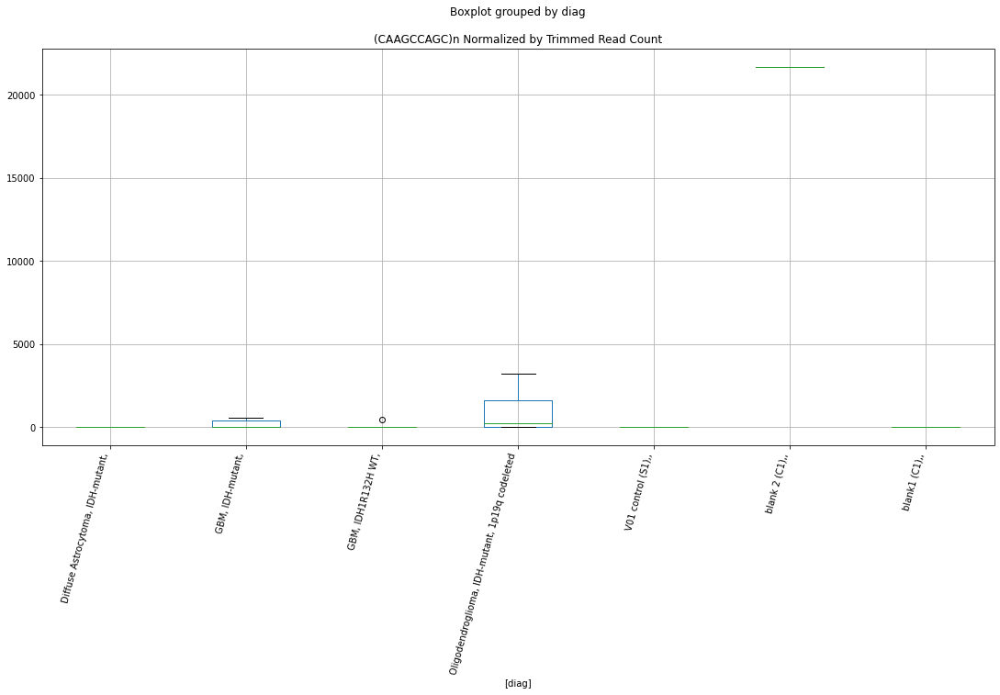

 p : 0.03008879591013354  ( t : 2.354731282055192 ) :  D-plex  :  cutadapt2  :  Tigger2
Control and blanks
76      89398.48
340    159412.52
Name: Tigger2, dtype: float64
208    97879.92
Name: Tigger2, dtype: float64
472    104610.01
Name: Tigger2, dtype: float64


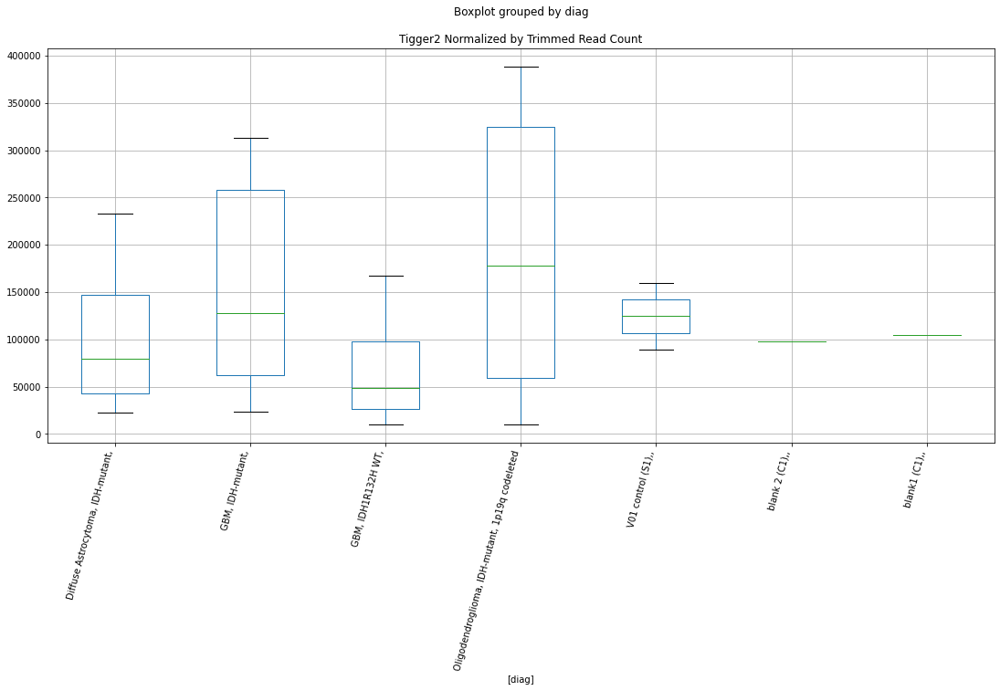

 p : 0.030167642529238134  ( t : 2.353448216185132 ) :  D-plex  :  bbduk2  :  MER87
Control and blanks
73     0.0
337    0.0
Name: MER87, dtype: float64
205    3402.73
Name: MER87, dtype: float64
469    1183.05
Name: MER87, dtype: float64


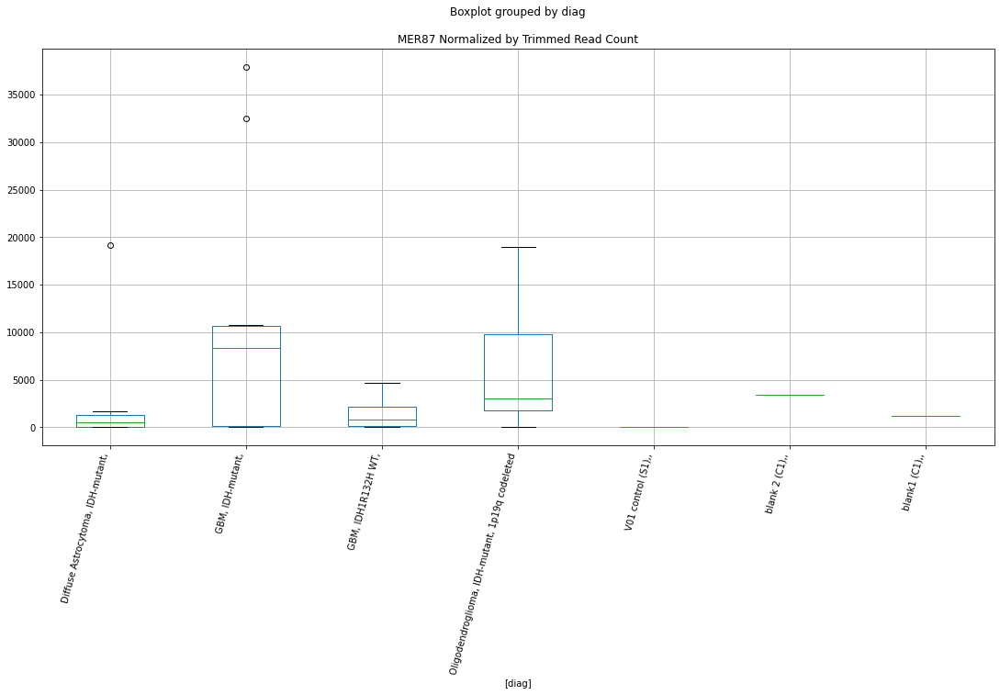

 p : 0.03022005763314542  ( t : 2.3525969959187667 ) :  Lexogen  :  cutadapt2  :  (TTTC)n
Control and blanks
82         0.0
346    17676.5
Name: (TTTC)n, dtype: float64
214    0.0
Name: (TTTC)n, dtype: float64
478    0.0
Name: (TTTC)n, dtype: float64


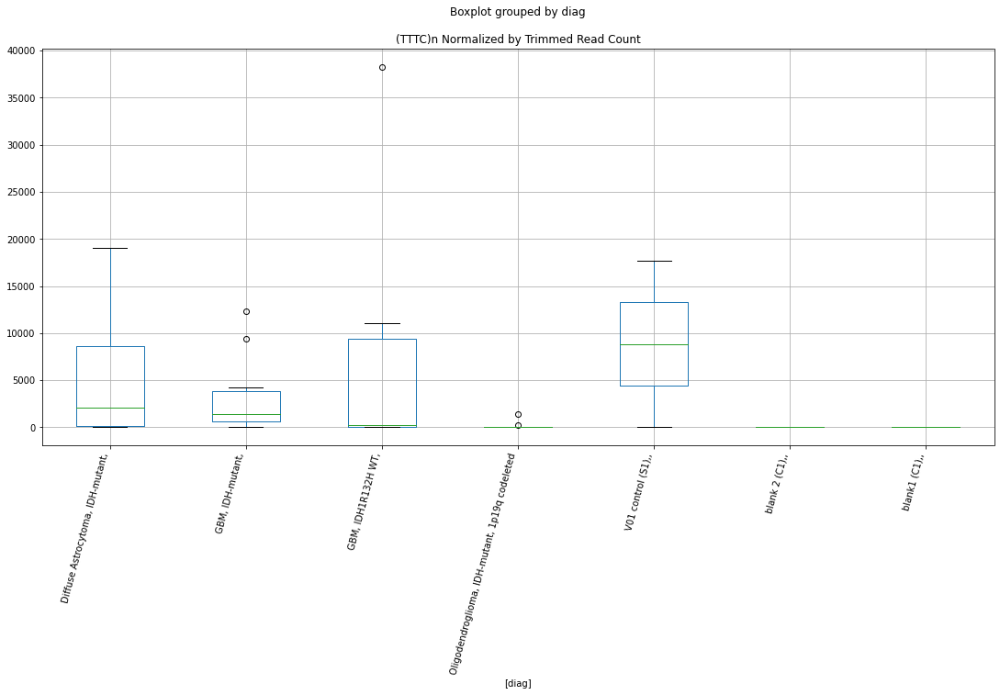

 p : 0.03022031094744258  ( t : 2.3525928854394245 ) :  Lexogen  :  bbduk2  :  L1HS
Control and blanks
79     0.0
343    0.0
Name: L1HS, dtype: float64
211    0.0
Name: L1HS, dtype: float64
475    0.0
Name: L1HS, dtype: float64


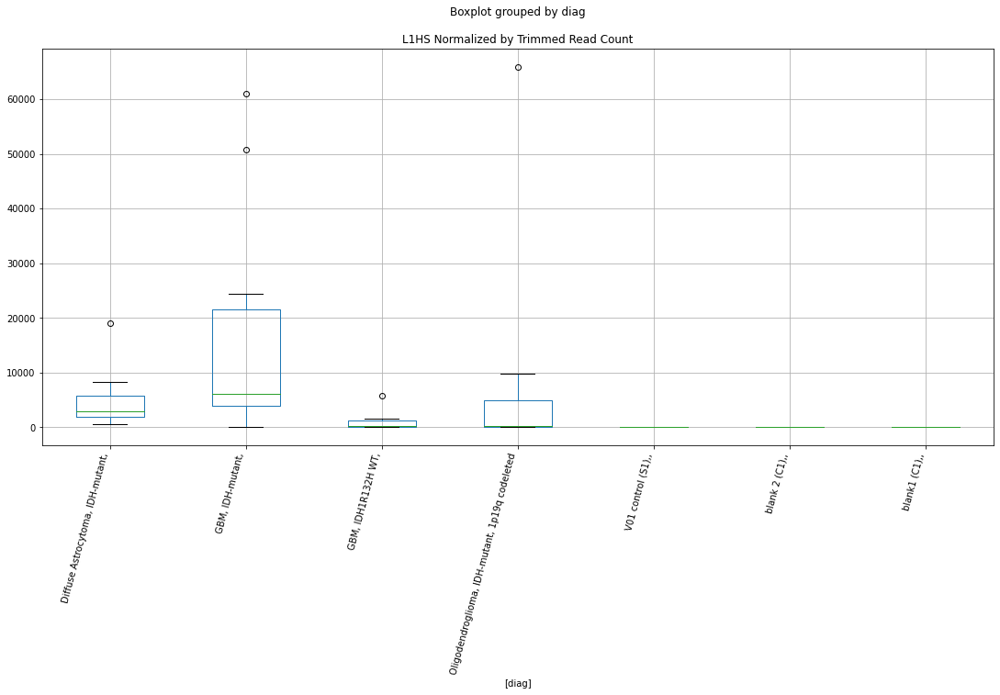

 p : 0.030399633604771974  ( t : 2.3496910741422705 ) :  D-plex  :  cutadapt2  :  (CTTTCT)n
Control and blanks
76     757.61
340    880.73
Name: (CTTTCT)n, dtype: float64
208    1058.16
Name: (CTTTCT)n, dtype: float64
472    1155.91
Name: (CTTTCT)n, dtype: float64


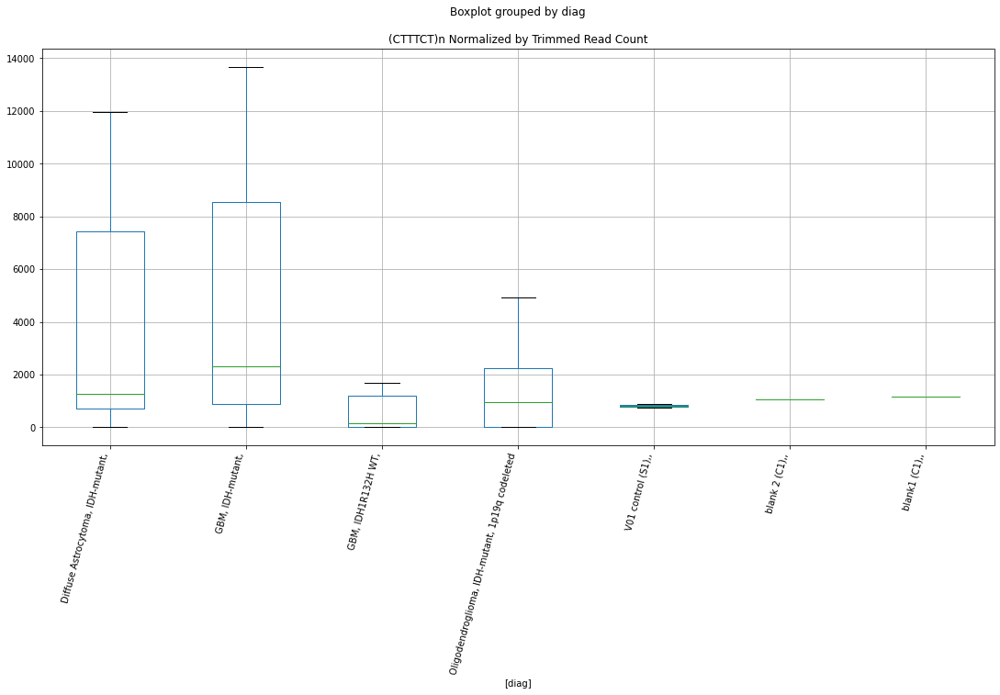

 p : 0.03041524804441096  ( t : 2.3494391551789544 ) :  D-plex  :  cutadapt2  :  LTR28B
Control and blanks
76     757.61
340      0.00
Name: LTR28B, dtype: float64
208    10934.33
Name: LTR28B, dtype: float64
472    9825.25
Name: LTR28B, dtype: float64


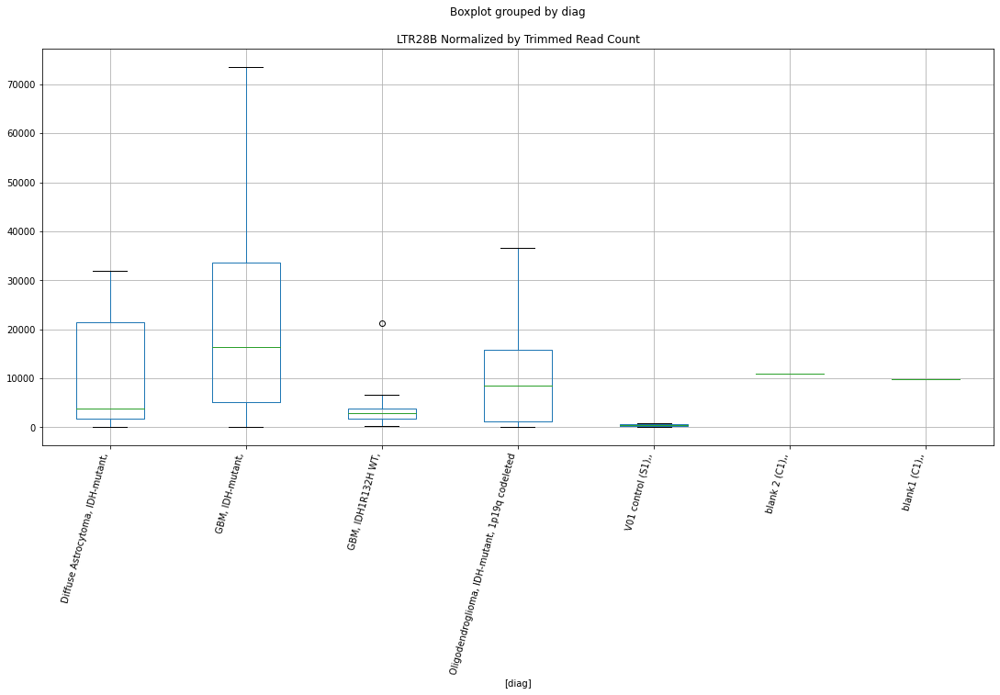

 p : 0.03042042983823187  ( t : 2.3493555801915327 ) :  Lexogen  :  cutadapt2  :  (TCCCCCC)n
Control and blanks
82       0.00
346    420.87
Name: (TCCCCCC)n, dtype: float64
214    0.0
Name: (TCCCCCC)n, dtype: float64
478    237.46
Name: (TCCCCCC)n, dtype: float64


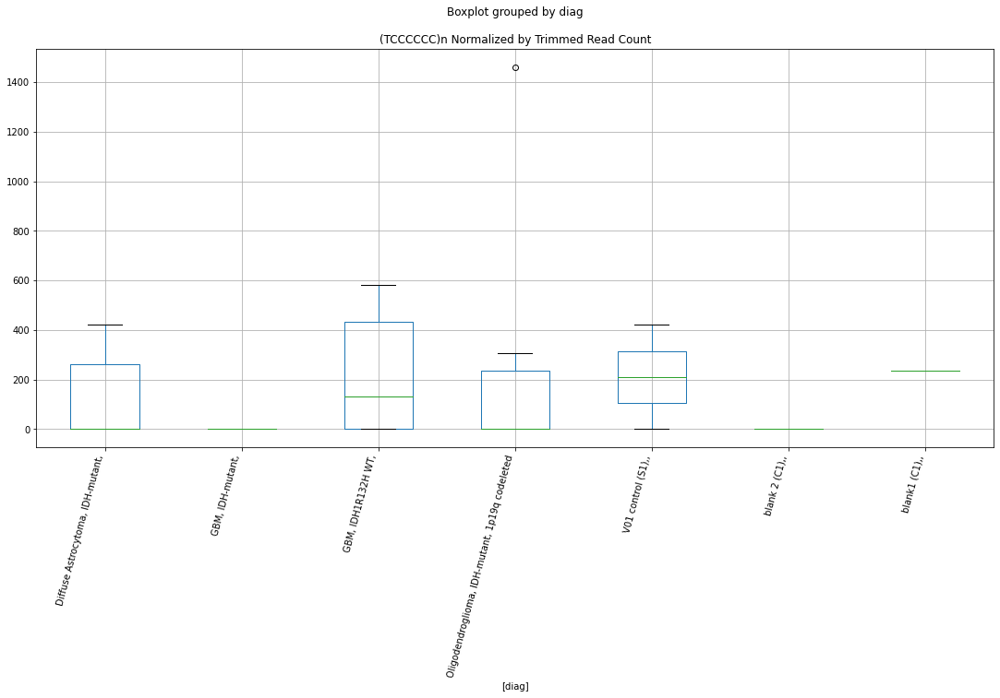

 p : 0.030482912975360314  ( t : 2.348348857995007 ) :  D-plex  :  cutadapt2  :  (GAGGG)n
Control and blanks
76      757.61
340    1761.46
Name: (GAGGG)n, dtype: float64
208    529.08
Name: (GAGGG)n, dtype: float64
472    2889.78
Name: (GAGGG)n, dtype: float64


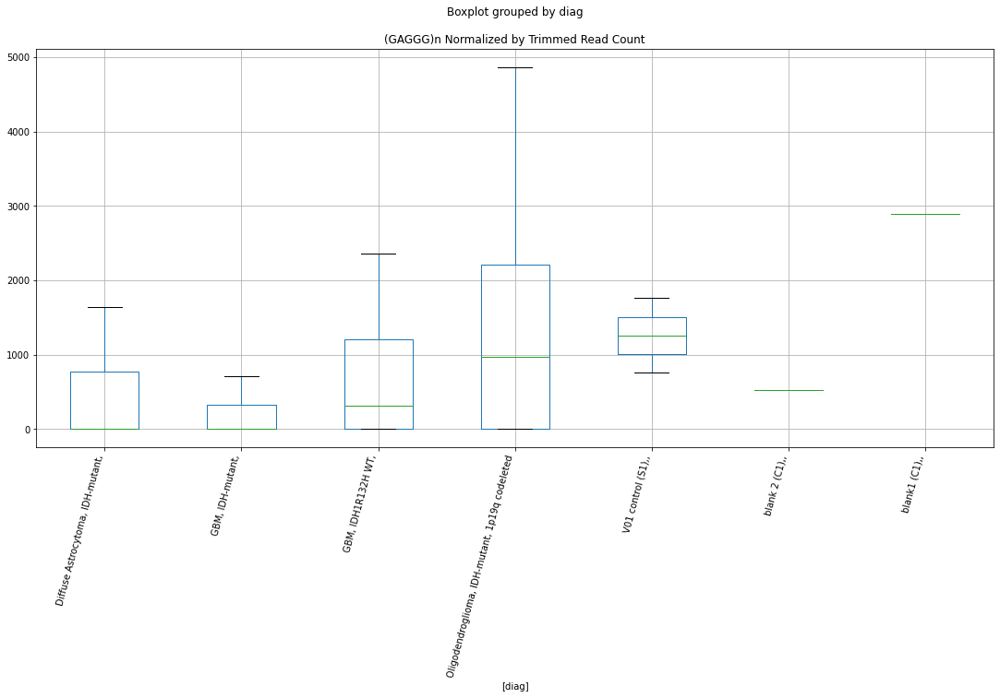

 p : 0.030600812984006753  ( t : 2.346454486172015 ) :  D-plex  :  bbduk2  :  (TCCC)n
Control and blanks
73     63386.69
337    24034.25
Name: (TCCC)n, dtype: float64
205    12894.55
Name: (TCCC)n, dtype: float64
469    18337.35
Name: (TCCC)n, dtype: float64


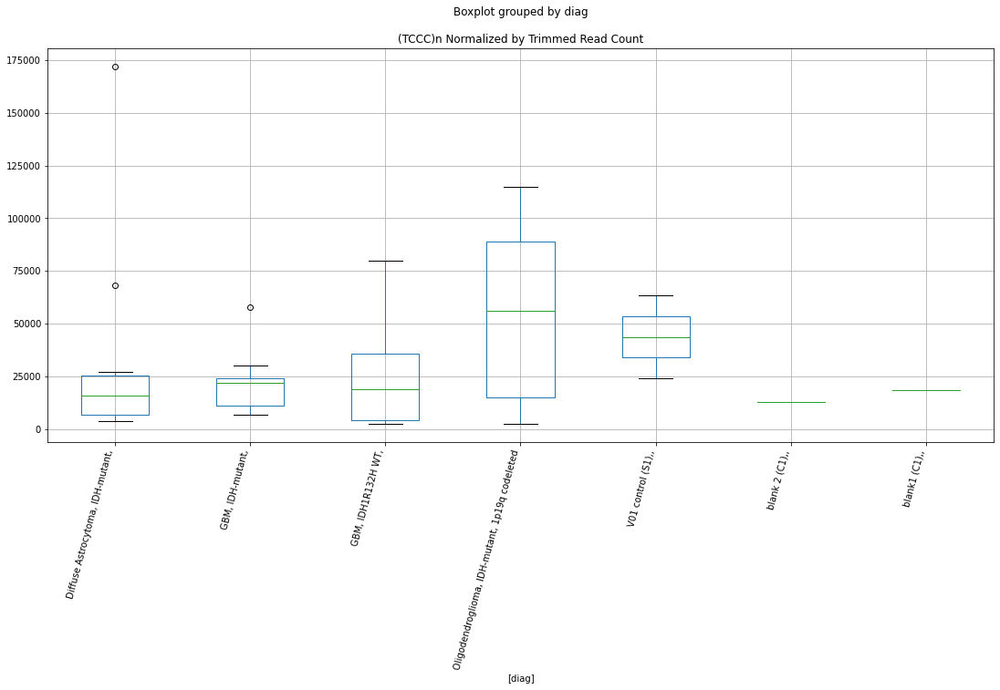

 p : 0.030613539525497394  ( t : 2.3462504074857047 ) :  D-plex  :  bbduk2  :  MER4B
Control and blanks
73     10049.11
337     6231.10
Name: MER4B, dtype: float64
205    33669.1
Name: MER4B, dtype: float64
469    40223.86
Name: MER4B, dtype: float64


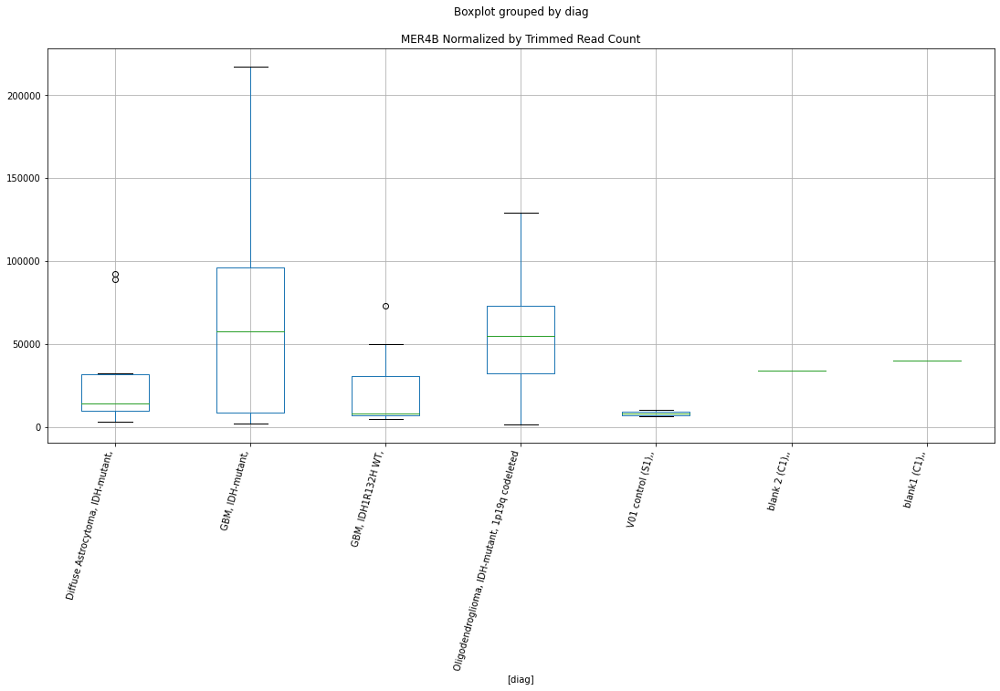

 p : 0.030616550607173533  ( t : 2.3462021343109143 ) :  D-plex  :  cutadapt2  :  (TTCCA)n
Control and blanks
76     71215.74
340    81908.09
Name: (TTCCA)n, dtype: float64
208    75482.17
Name: (TTCCA)n, dtype: float64
472    72244.48
Name: (TTCCA)n, dtype: float64


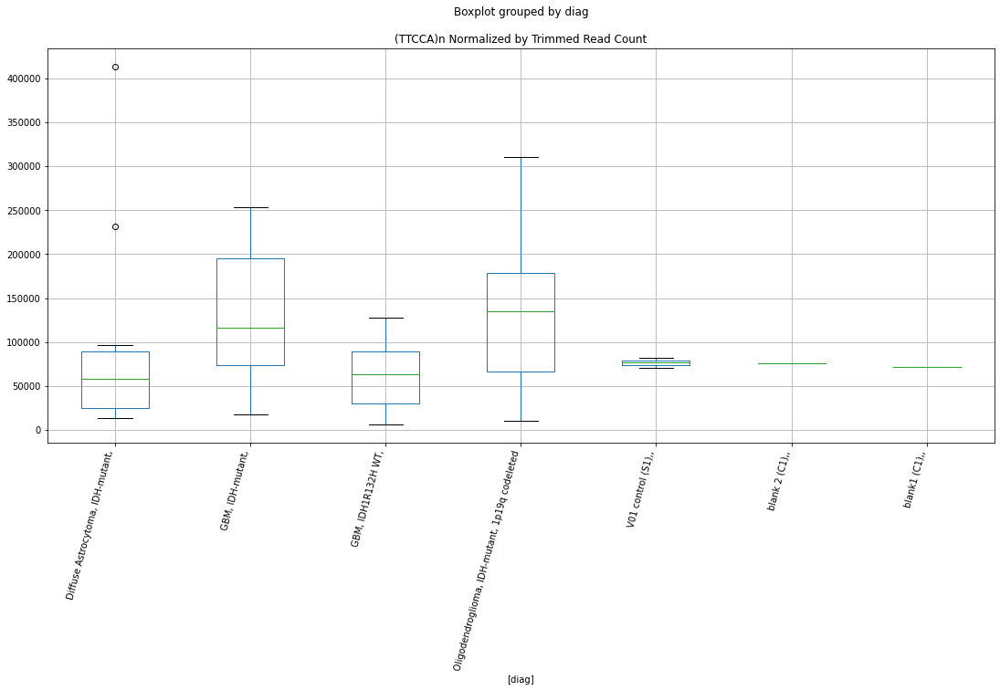

 p : 0.030839526997418553  ( t : 2.3426396353409404 ) :  D-plex  :  cutadapt2  :  LTR30
Control and blanks
76     0.0
340    0.0
Name: LTR30, dtype: float64
208    3527.2
Name: LTR30, dtype: float64
472    4623.65
Name: LTR30, dtype: float64


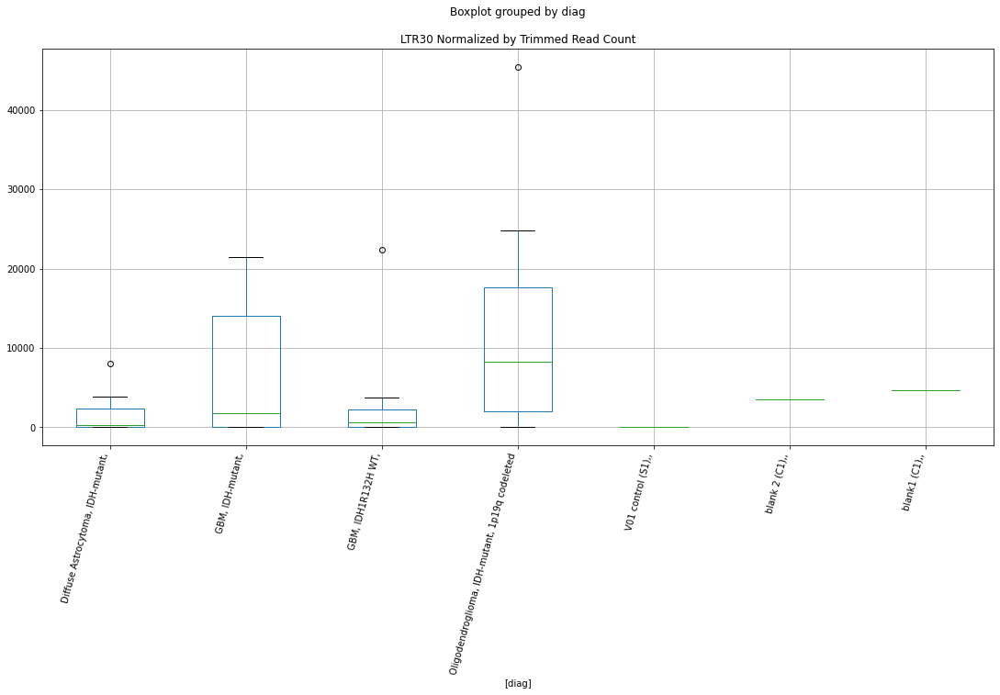

 p : 0.030872213534045446  ( t : 2.3421194175950752 ) :  D-plex  :  cutadapt2  :  (CATCT)n
Control and blanks
76       0.00
340    880.73
Name: (CATCT)n, dtype: float64
208    705.44
Name: (CATCT)n, dtype: float64
472    1155.91
Name: (CATCT)n, dtype: float64


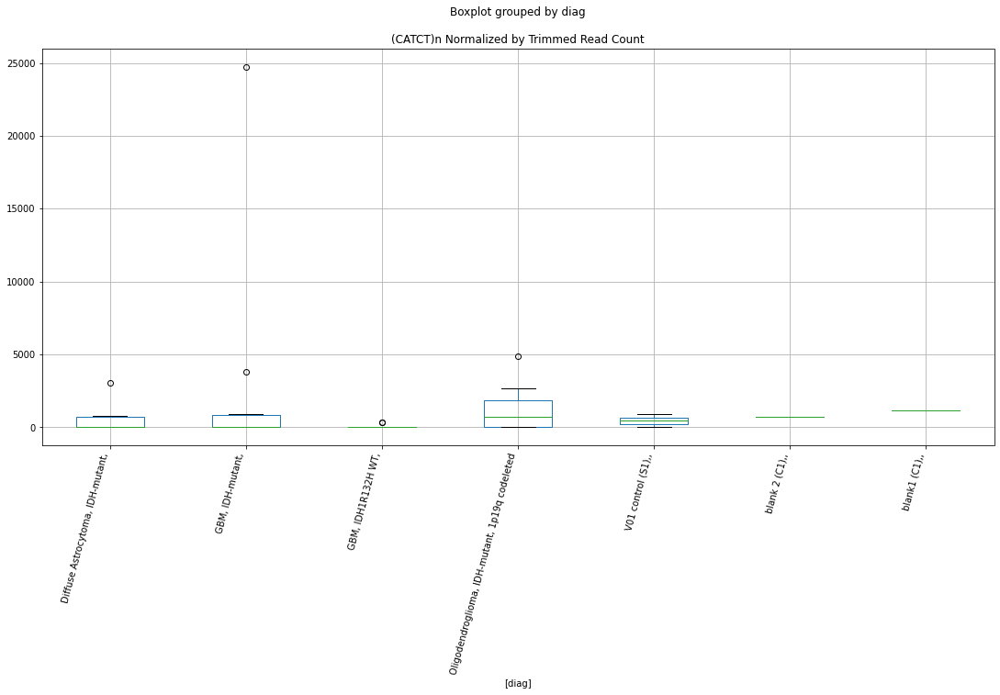

 p : 0.030888223303184425  ( t : 2.341864803449178 ) :  D-plex  :  cutadapt2  :  MER135
Control and blanks
76     0.0
340    0.0
Name: MER135, dtype: float64
208    4409.01
Name: MER135, dtype: float64
472    3467.74
Name: MER135, dtype: float64


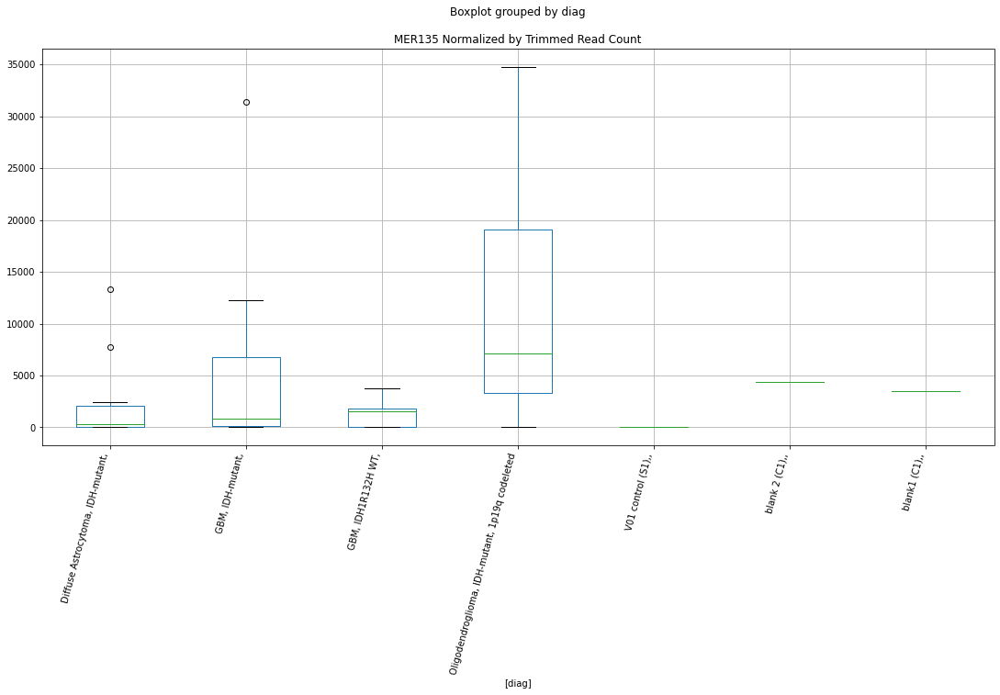

 p : 0.030892675703705894  ( t : 2.341794015748244 ) :  D-plex  :  bbduk2  :  LTR81AB
Control and blanks
73     1546.02
337       0.00
Name: LTR81AB, dtype: float64
205    2328.18
Name: LTR81AB, dtype: float64
469    1774.58
Name: LTR81AB, dtype: float64


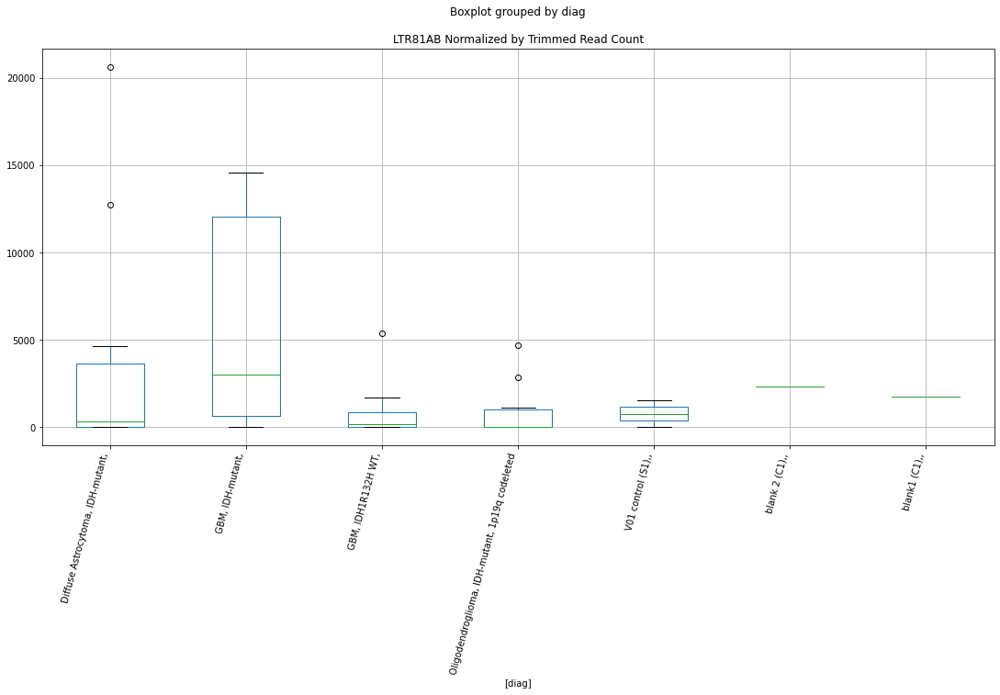

 p : 0.030901191443359146  ( t : 2.3416586523829075 ) :  D-plex  :  cutadapt2  :  HERVL40-int
Control and blanks
76      4545.69
340    20256.84
Name: HERVL40-int, dtype: float64
208    28041.27
Name: HERVL40-int, dtype: float64
472    30053.7
Name: HERVL40-int, dtype: float64


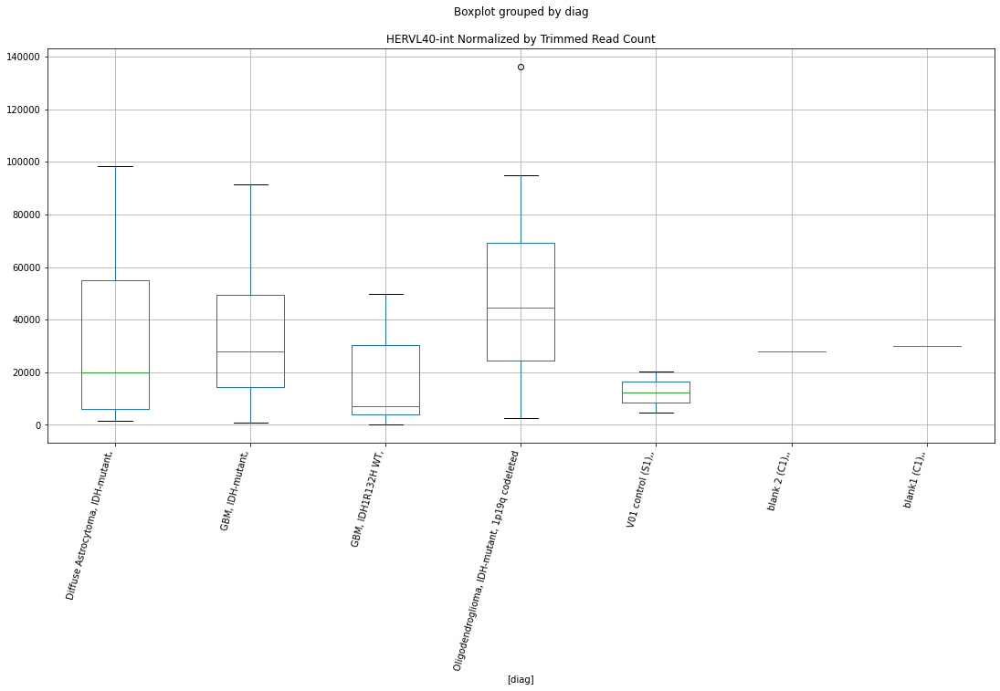

 p : 0.030901519764676165  ( t : 2.3416534341914064 ) :  D-plex  :  cutadapt2  :  Charlie5
Control and blanks
76     25001.27
340    23779.77
Name: Charlie5, dtype: float64
208    22221.39
Name: Charlie5, dtype: float64
472    26585.97
Name: Charlie5, dtype: float64


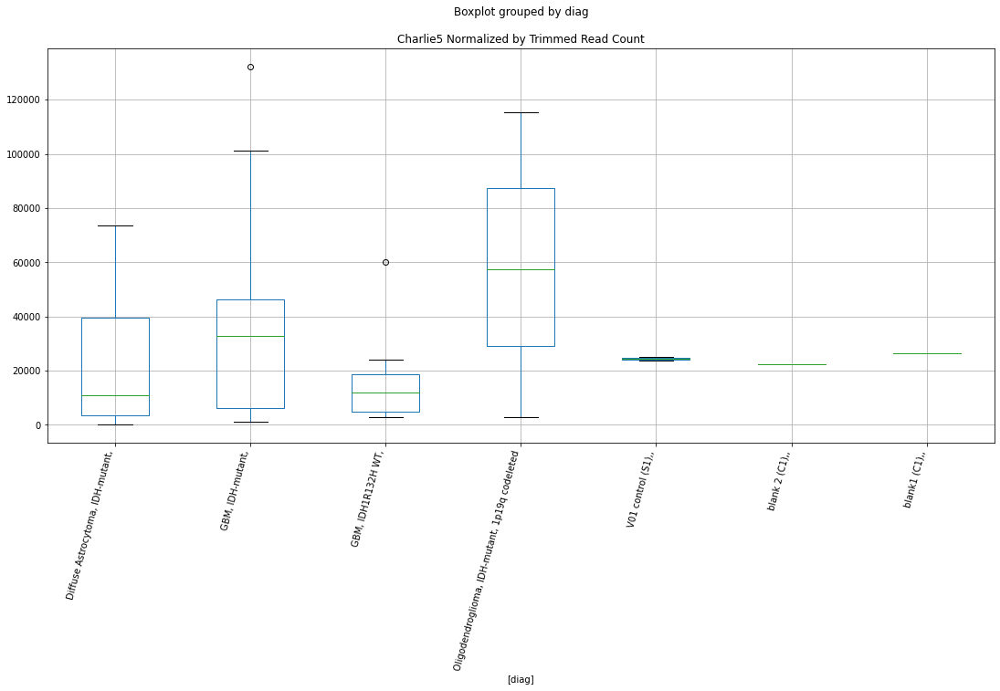

 p : 0.030939971159773486  ( t : 2.3410426615172804 ) :  D-plex  :  bbduk2  :  L1MEg1
Control and blanks
73      3865.04
337    71212.58
Name: L1MEg1, dtype: float64
205    19700.0
Name: L1MEg1, dtype: float64
469    18337.35
Name: L1MEg1, dtype: float64


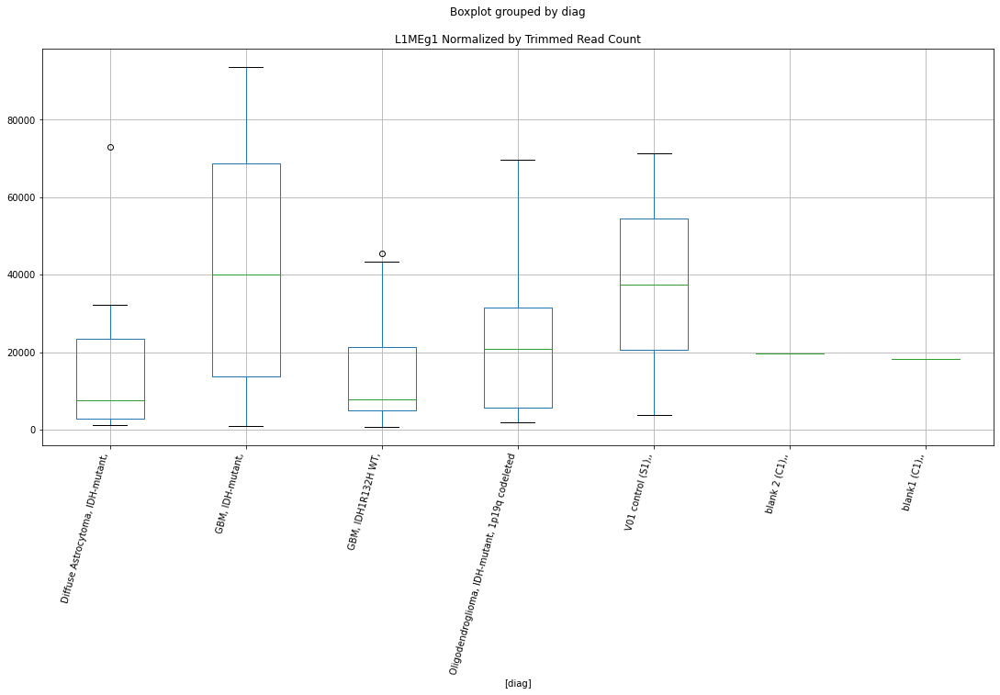

 p : 0.031011704947285397  ( t : 2.339905107428366 ) :  D-plex  :  bbduk2  :  Arthur1B
Control and blanks
73      5411.06
337    35606.29
Name: Arthur1B, dtype: float64
205    36355.46
Name: Arthur1B, dtype: float64
469    33717.06
Name: Arthur1B, dtype: float64


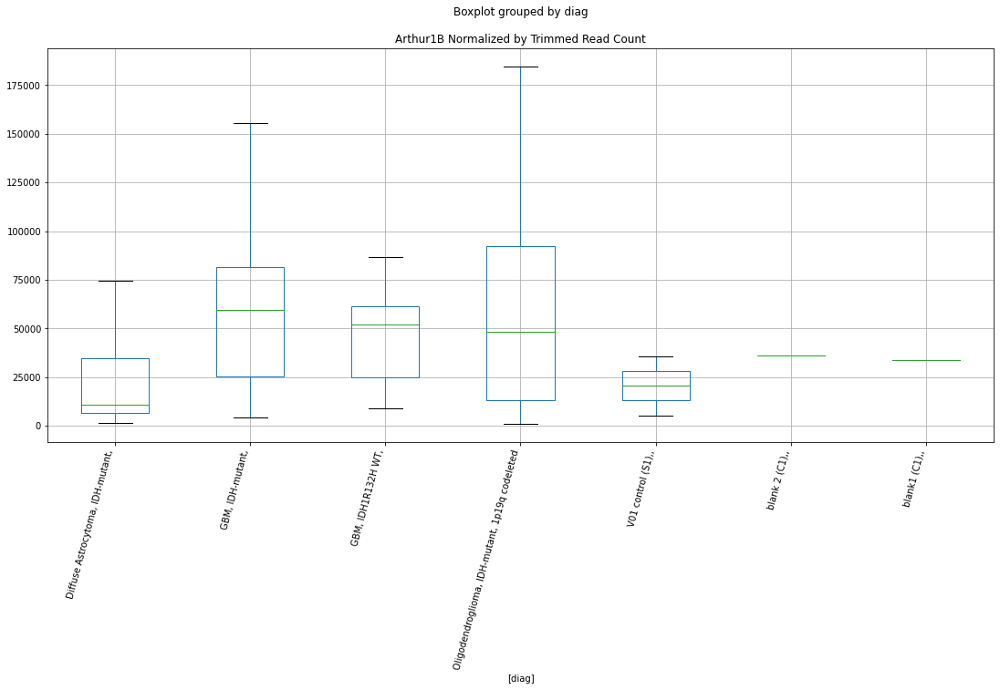

 p : 0.031017044104733636  ( t : 2.33982053701057 ) :  D-plex  :  bbduk2  :  LTR40c
Control and blanks
73     0.0
337    0.0
Name: LTR40c, dtype: float64
205    9133.64
Name: LTR40c, dtype: float64
469    13013.6
Name: LTR40c, dtype: float64


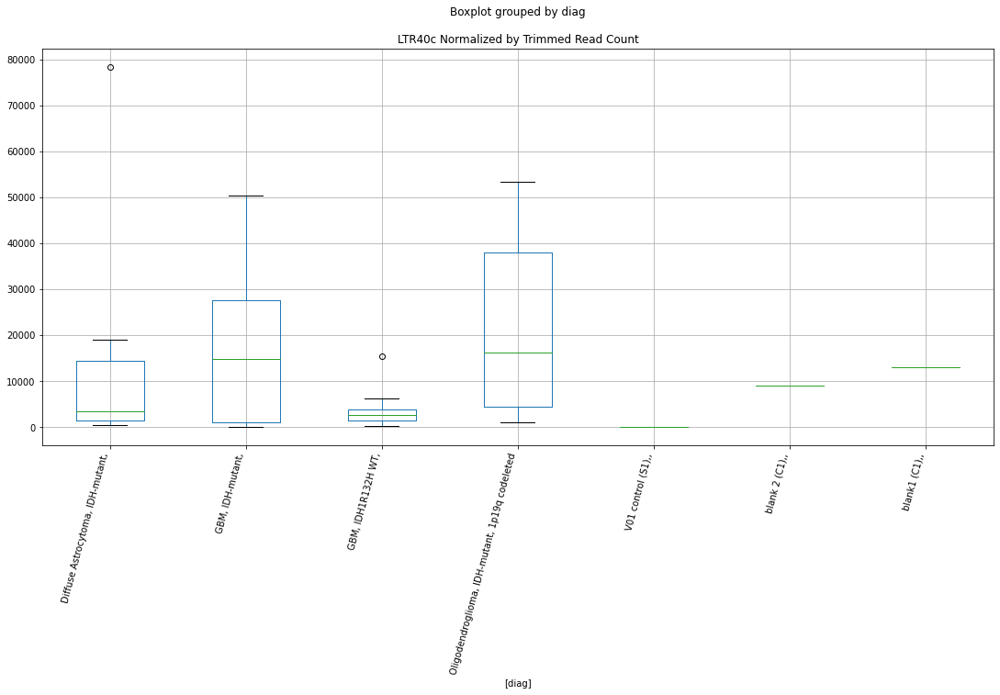

 p : 0.031253905406048624  ( t : 2.3360822958158063 ) :  D-plex  :  bbduk2  :  (CTAT)n
Control and blanks
73      5411.06
337    14242.52
Name: (CTAT)n, dtype: float64
205    12715.46
Name: (CTAT)n, dtype: float64
469    10647.49
Name: (CTAT)n, dtype: float64


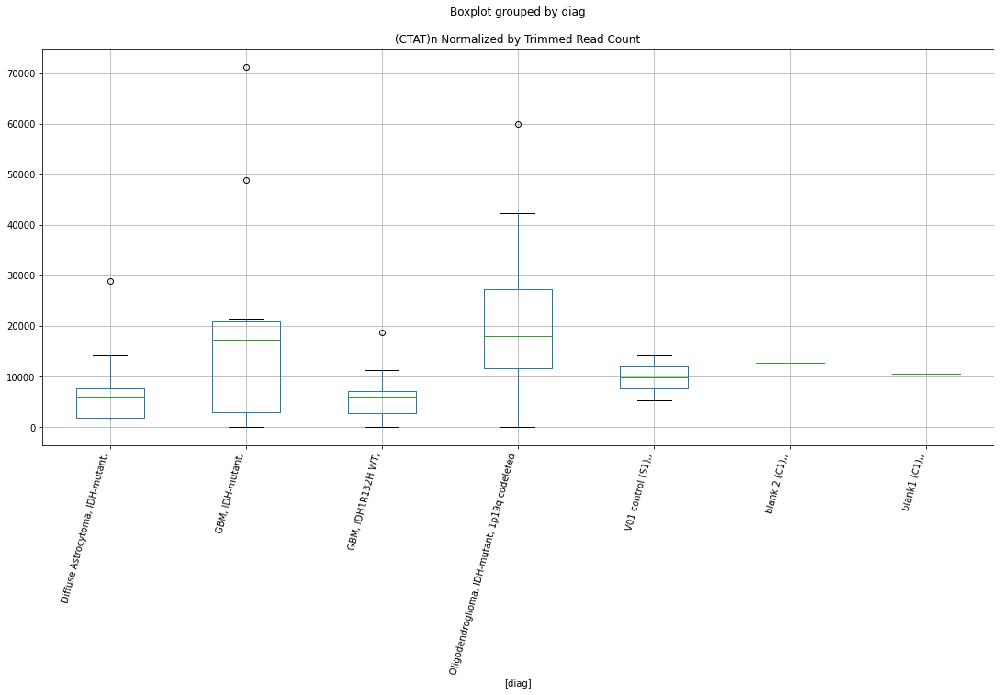

 p : 0.03131705556673799  ( t : 2.335090083896652 ) :  D-plex  :  cutadapt2  :  LTR55
Control and blanks
76     6818.53
340       0.00
Name: LTR55, dtype: float64
208    9876.17
Name: LTR55, dtype: float64
472    5779.56
Name: LTR55, dtype: float64


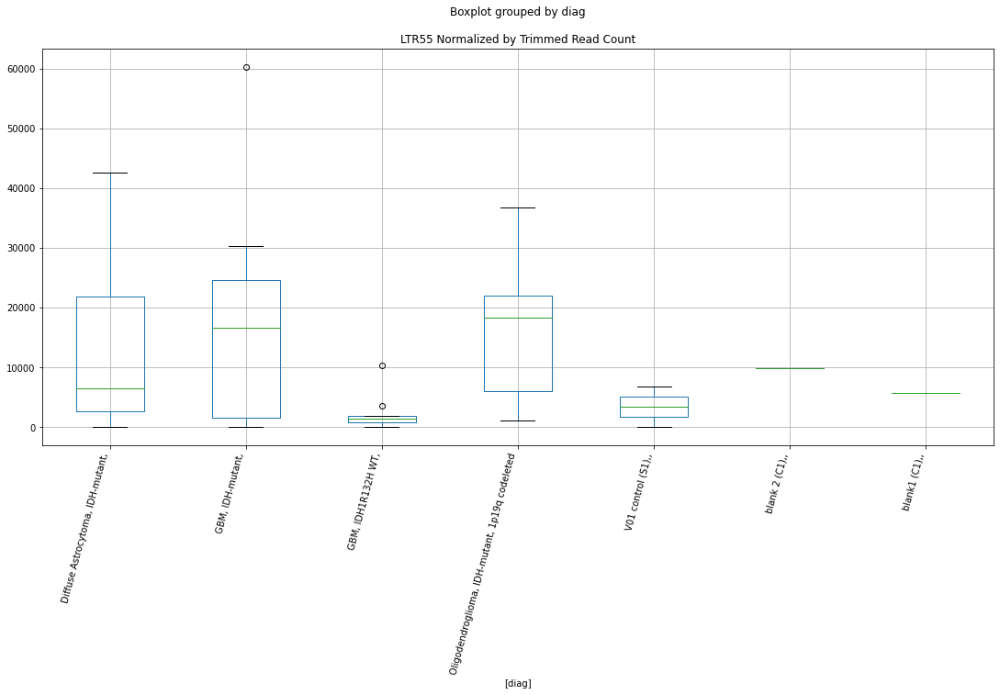

 p : 0.031354366041635856  ( t : 2.334504737790993 ) :  Lexogen  :  bbduk2  :  L1MB3
Control and blanks
79       0.00
343    212.31
Name: L1MB3, dtype: float64
211    0.0
Name: L1MB3, dtype: float64
475    0.0
Name: L1MB3, dtype: float64


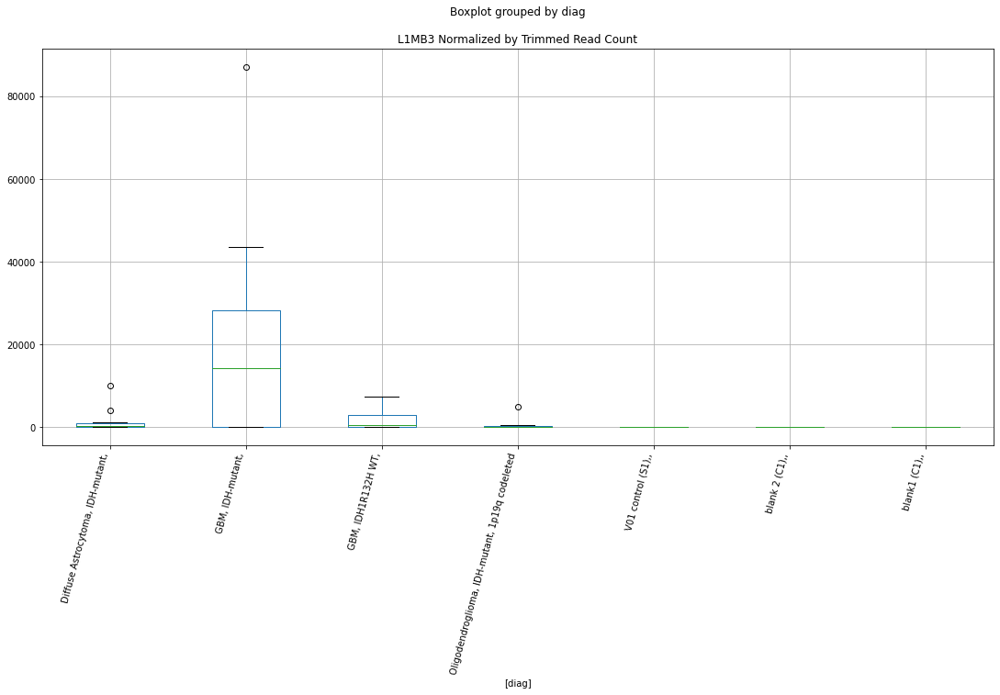

 p : 0.03140551337155047  ( t : 2.333703363622908 ) :  D-plex  :  cutadapt2  :  (TATTT)n
Control and blanks
76      757.61
340    7045.86
Name: (TATTT)n, dtype: float64
208    3879.92
Name: (TATTT)n, dtype: float64
472    2889.78
Name: (TATTT)n, dtype: float64


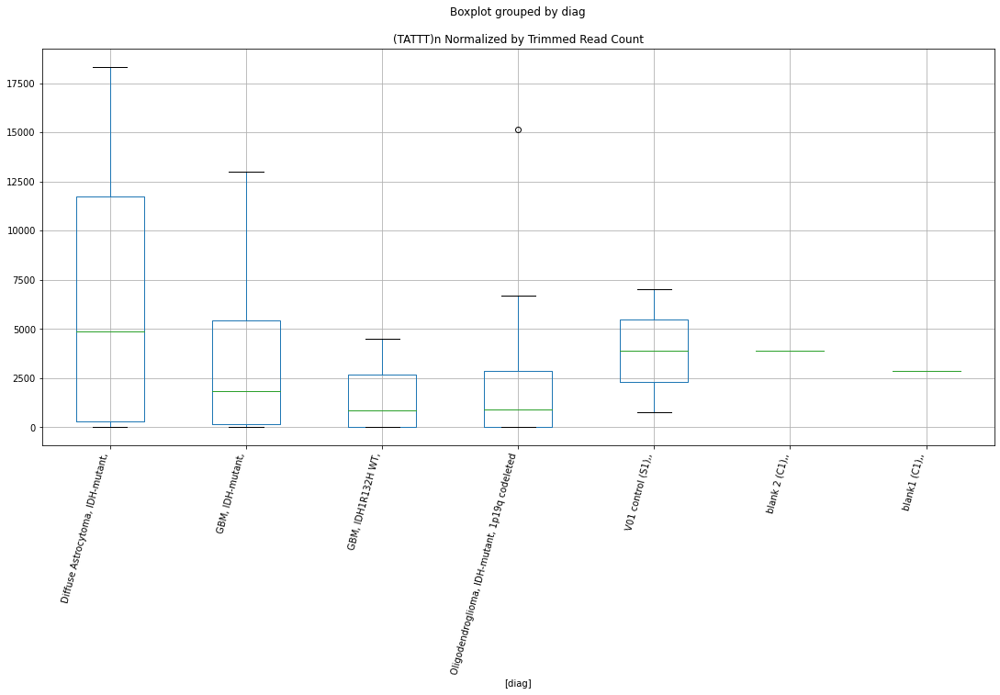

 p : 0.031424890390139716  ( t : 2.3334000822695296 ) :  D-plex  :  cutadapt2  :  L1MEa
Control and blanks
76      2272.84
340    33467.82
Name: L1MEa, dtype: float64
208    7936.21
Name: L1MEa, dtype: float64
472    8669.34
Name: L1MEa, dtype: float64


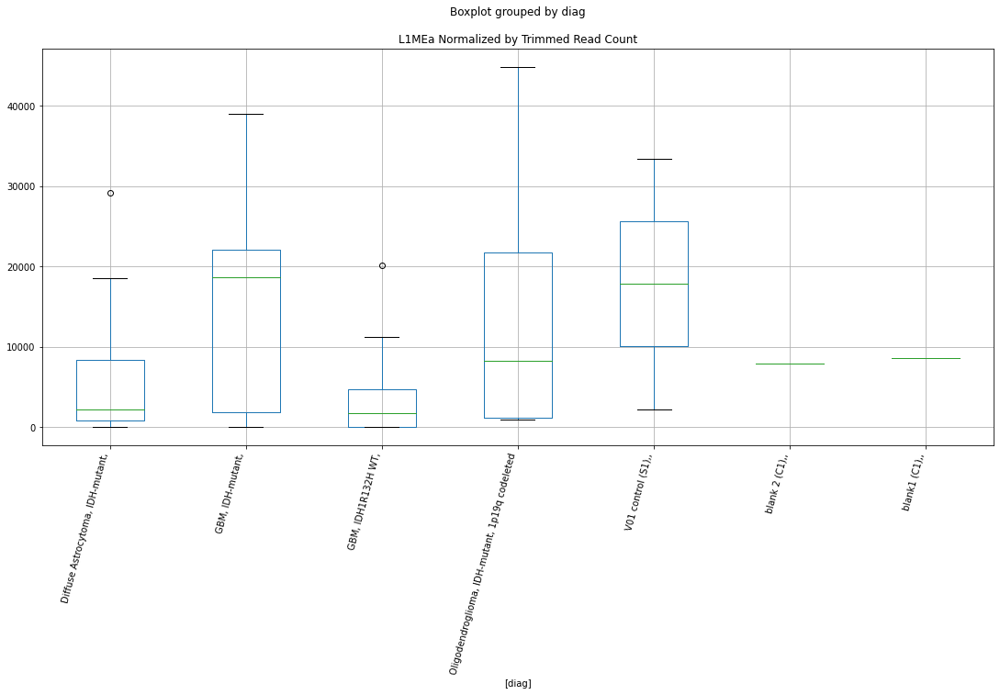

 p : 0.031425991386193924  ( t : 2.3333828551404228 ) :  D-plex  :  cutadapt2  :  (TGGAGTGGAA)n
Control and blanks
76     3030.46
340       0.00
Name: (TGGAGTGGAA)n, dtype: float64
208    6172.61
Name: (TGGAGTGGAA)n, dtype: float64
472    3467.74
Name: (TGGAGTGGAA)n, dtype: float64


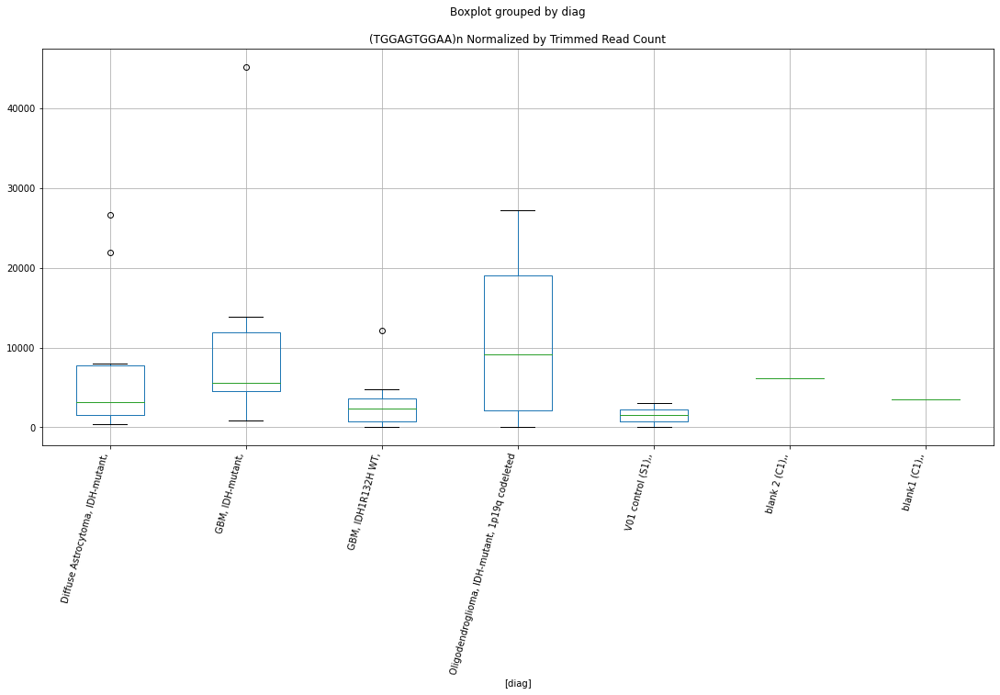

 p : 0.03142972384470656  ( t : 2.333324458067194 ) :  D-plex  :  cutadapt2  :  Charlie4a
Control and blanks
76      5303.30
340    59889.79
Name: Charlie4a, dtype: float64
208    39857.41
Name: Charlie4a, dtype: float64
472    39301.0
Name: Charlie4a, dtype: float64


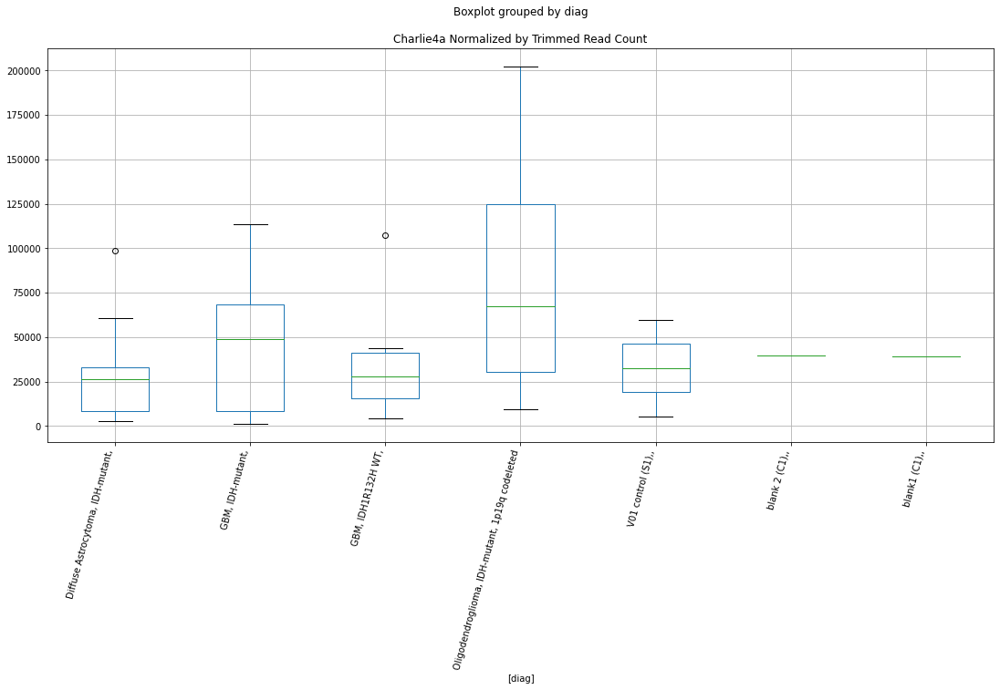

 p : 0.031447964442964216  ( t : 2.333039163146274 ) :  D-plex  :  cutadapt2  :  MER102c
Control and blanks
76     32577.41
340    46678.80
Name: MER102c, dtype: float64
208    31392.12
Name: MER102c, dtype: float64
472    28897.79
Name: MER102c, dtype: float64


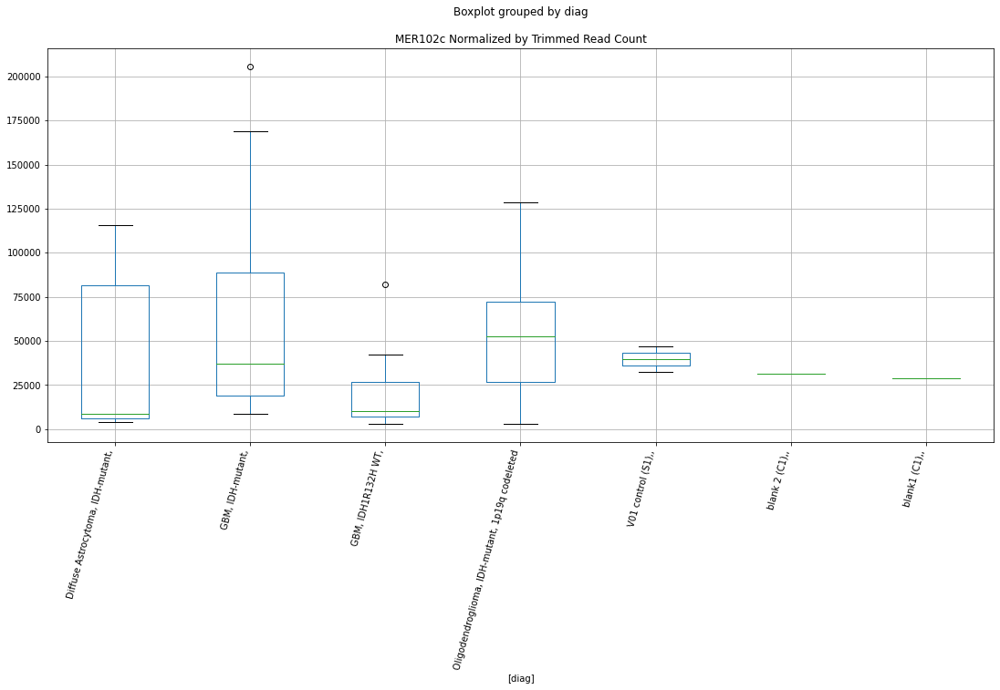

 p : 0.03159148830212076  ( t : 2.33079970862364 ) :  D-plex  :  cutadapt2  :  (CAT)n
Control and blanks
76     0.0
340    0.0
Name: (CAT)n, dtype: float64
208    3527.2
Name: (CAT)n, dtype: float64
472    2311.82
Name: (CAT)n, dtype: float64


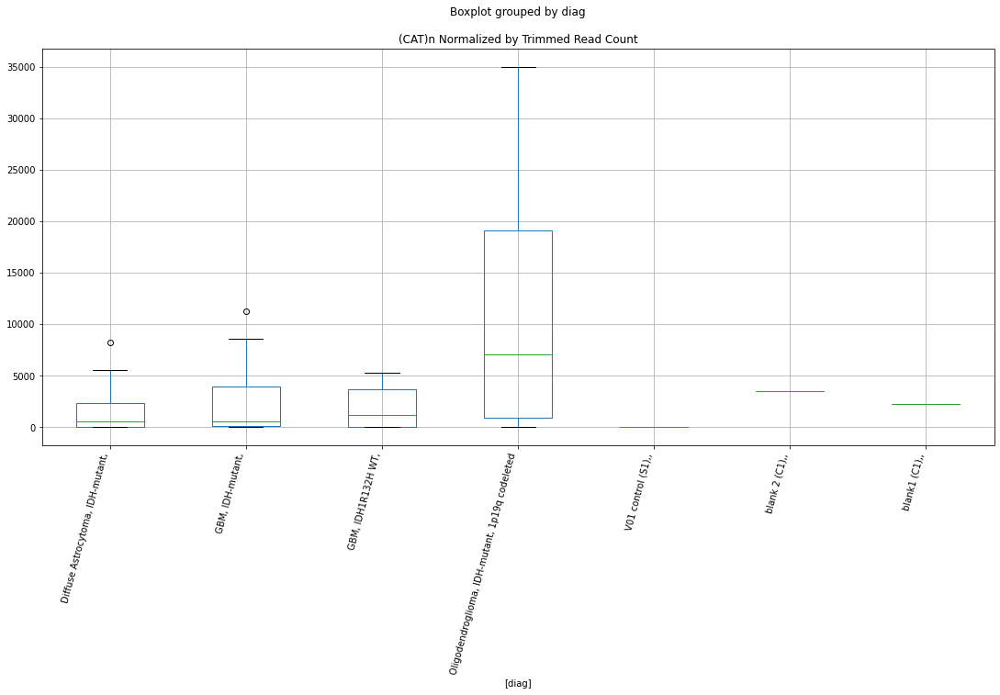

 p : 0.03162360460213242  ( t : 2.330299881698475 ) :  D-plex  :  bbduk2  :  LFSINE_Vert
Control and blanks
73      1546.02
337    11572.04
Name: LFSINE_Vert, dtype: float64
205    16655.46
Name: LFSINE_Vert, dtype: float64
469    15971.24
Name: LFSINE_Vert, dtype: float64


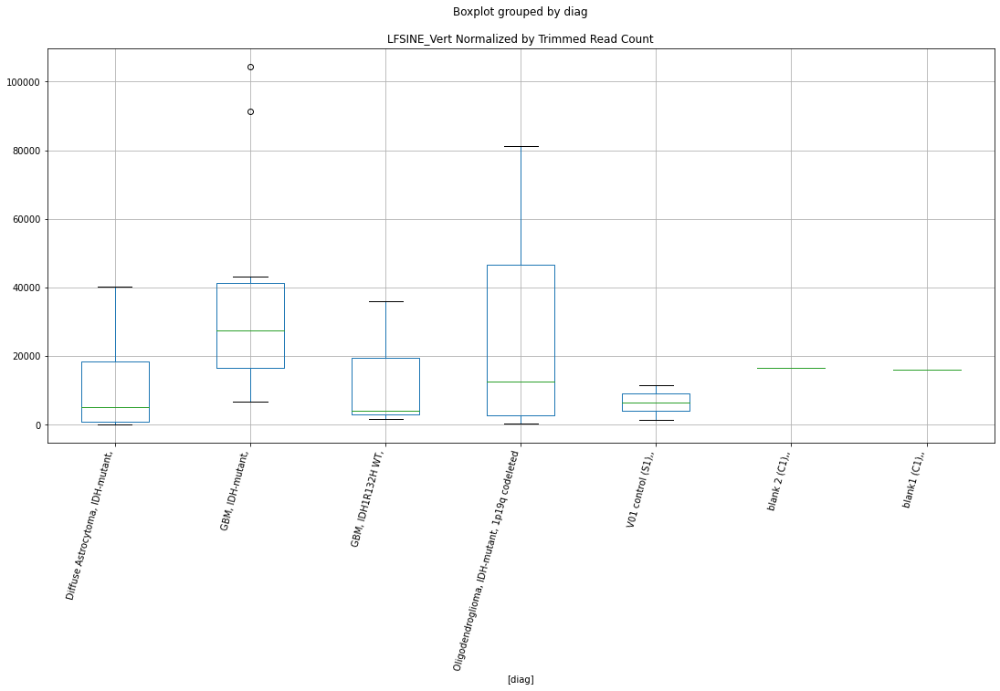

 p : 0.03170024045188233  ( t : 2.3291090994320016 ) :  D-plex  :  cutadapt2  :  (AAAC)n
Control and blanks
76        0.0
340    2642.2
Name: (AAAC)n, dtype: float64
208    4232.65
Name: (AAAC)n, dtype: float64
472    2311.82
Name: (AAAC)n, dtype: float64


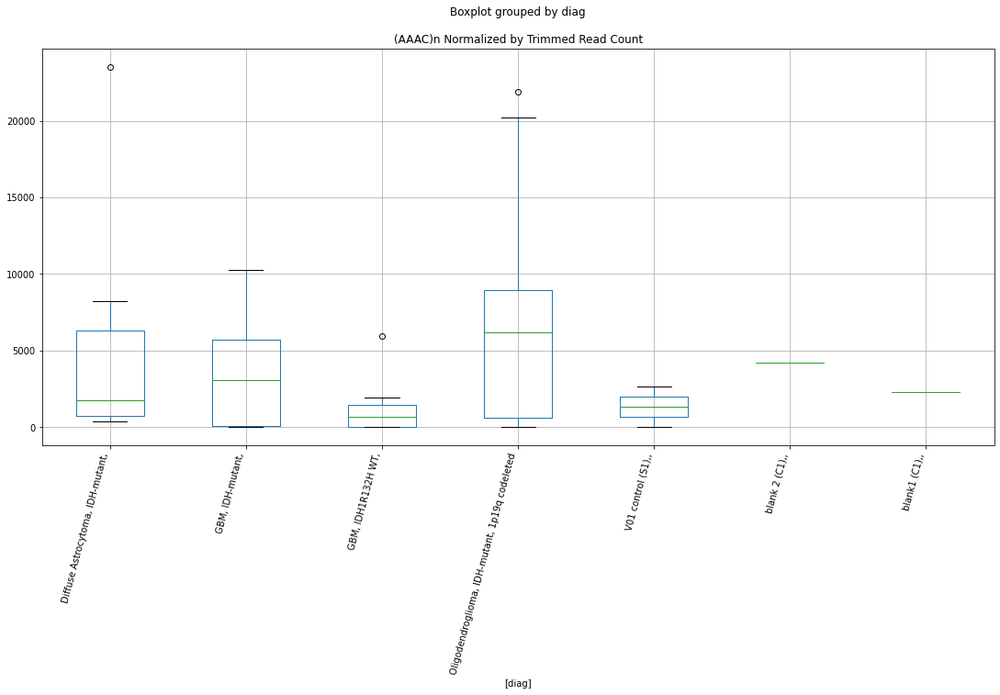

 p : 0.03171083148538607  ( t : 2.328944744456128 ) :  D-plex  :  bbduk2  :  LTR30
Control and blanks
73     0.0
337    0.0
Name: LTR30, dtype: float64
205    3581.82
Name: LTR30, dtype: float64
469    4732.22
Name: LTR30, dtype: float64


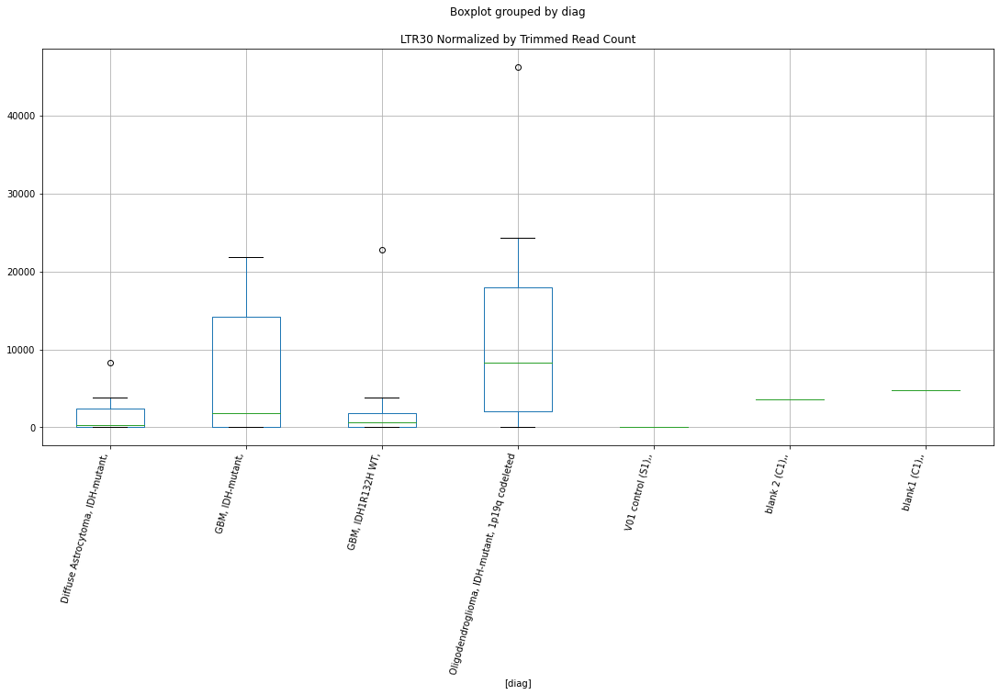

 p : 0.03173121089951442  ( t : 2.328628633815094 ) :  D-plex  :  bbduk2  :  LTR2B
Control and blanks
73     0.0
337    0.0
Name: LTR2B, dtype: float64
205    4477.27
Name: LTR2B, dtype: float64
469    6506.8
Name: LTR2B, dtype: float64


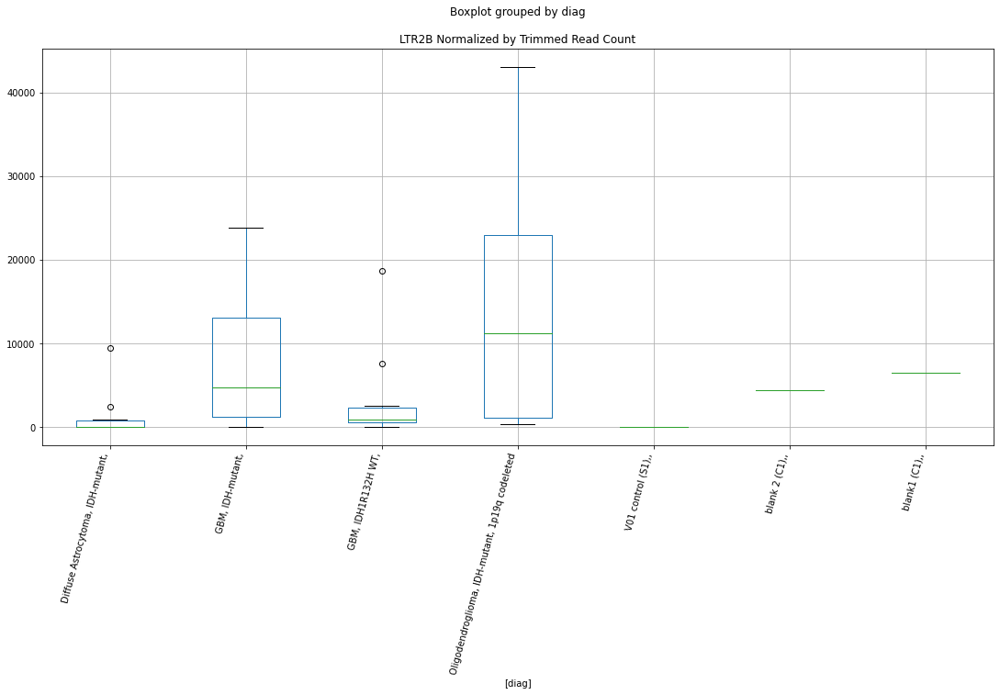

 p : 0.031750951808334954  ( t : 2.3283226070756182 ) :  D-plex  :  cutadapt2  :  (GCT)n
Control and blanks
76     1515.23
340       0.00
Name: (GCT)n, dtype: float64
208    1058.16
Name: (GCT)n, dtype: float64
472    2889.78
Name: (GCT)n, dtype: float64


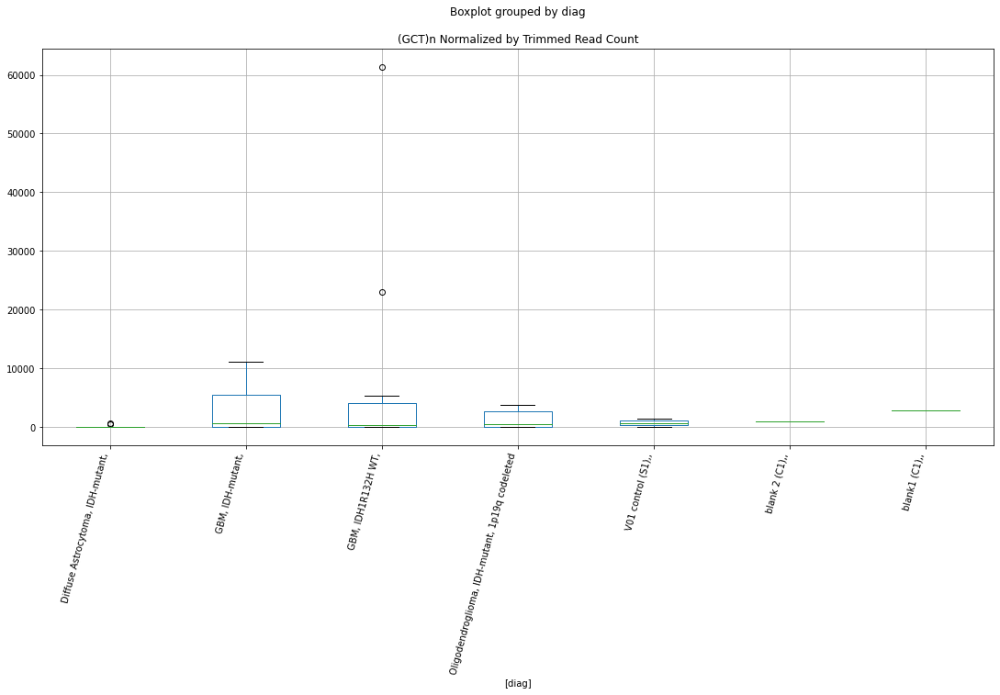

 p : 0.03180605005797596  ( t : 2.3274693997948903 ) :  D-plex  :  cutadapt2  :  (TTTATTA)n
Control and blanks
76     0.0
340    0.0
Name: (TTTATTA)n, dtype: float64
208    352.72
Name: (TTTATTA)n, dtype: float64
472    0.0
Name: (TTTATTA)n, dtype: float64


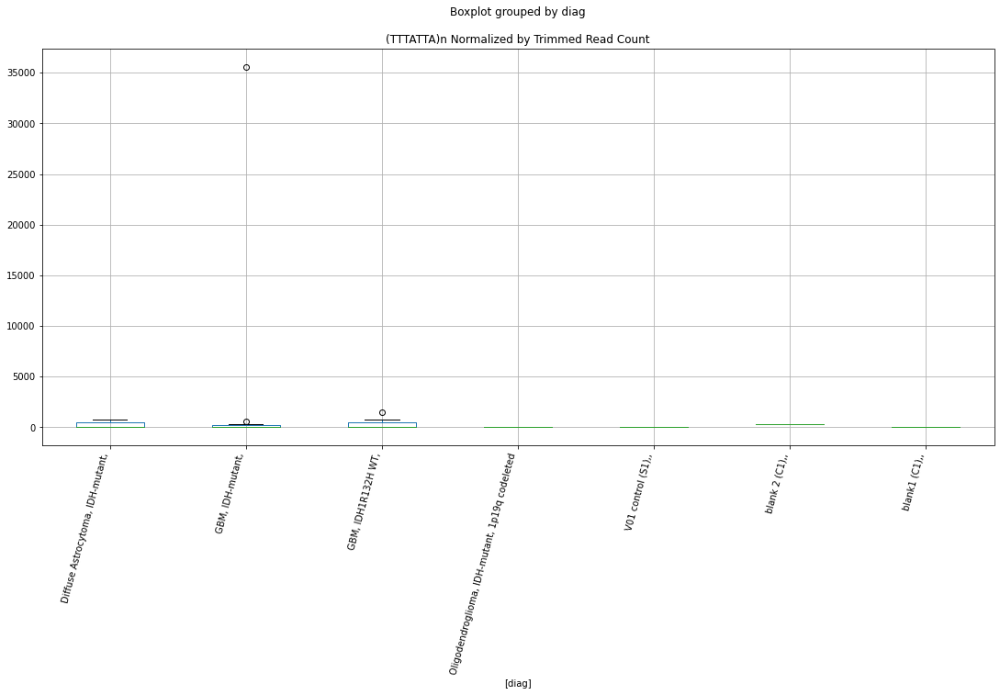

 p : 0.0318220980747736  ( t : 2.3272211513891503 ) :  D-plex  :  cutadapt2  :  LOR1b
Control and blanks
76      8333.76
340    67816.37
Name: LOR1b, dtype: float64
208    19928.7
Name: LOR1b, dtype: float64
472    20228.45
Name: LOR1b, dtype: float64


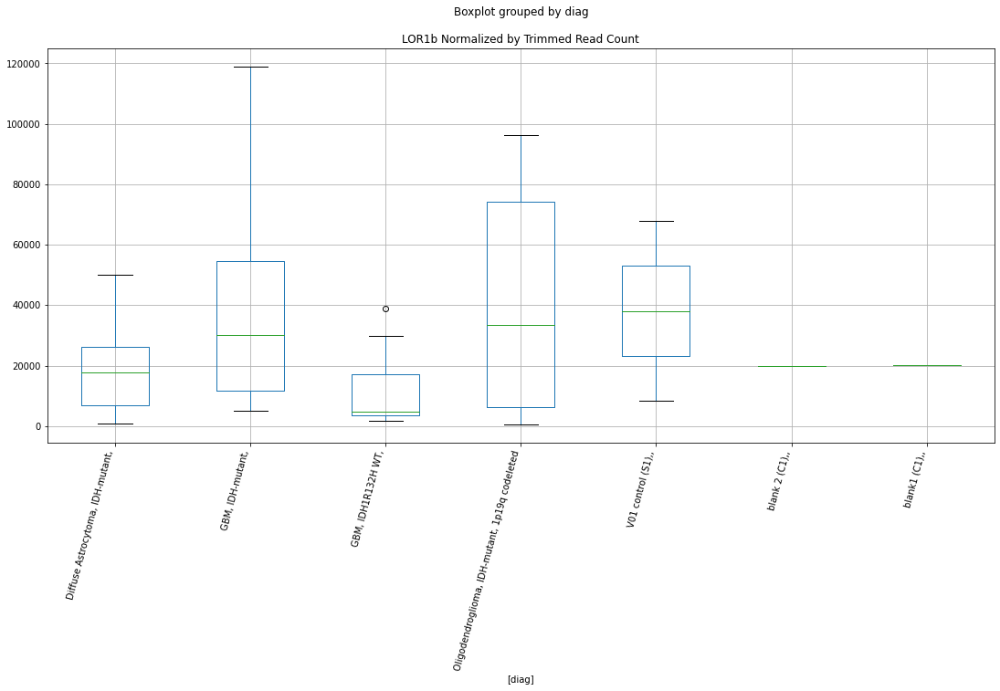

 p : 0.031849703303547285  ( t : 2.3267943953644163 ) :  D-plex  :  bbduk2  :  (TGTA)n
Control and blanks
73         0.00
337    37386.61
Name: (TGTA)n, dtype: float64
205    8954.55
Name: (TGTA)n, dtype: float64
469    9464.44
Name: (TGTA)n, dtype: float64


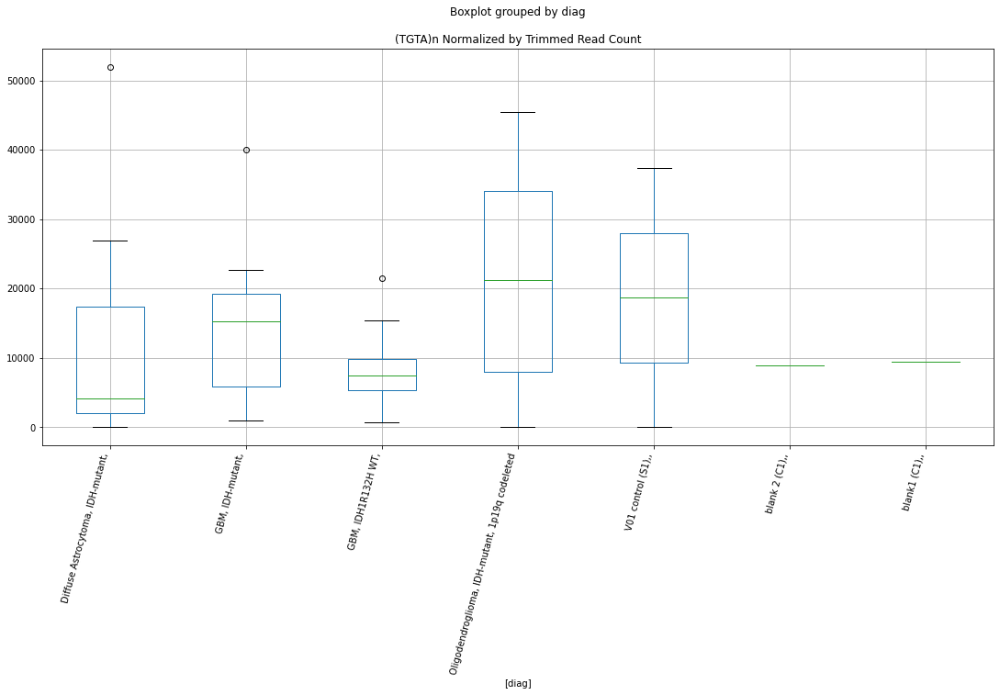

 p : 0.03199163418511452  ( t : 2.3246056628400273 ) :  D-plex  :  cutadapt2  :  PABL_A-int
Control and blanks
76     30304.57
340     6165.12
Name: PABL_A-int, dtype: float64
208    14108.82
Name: PABL_A-int, dtype: float64
472    12137.07
Name: PABL_A-int, dtype: float64


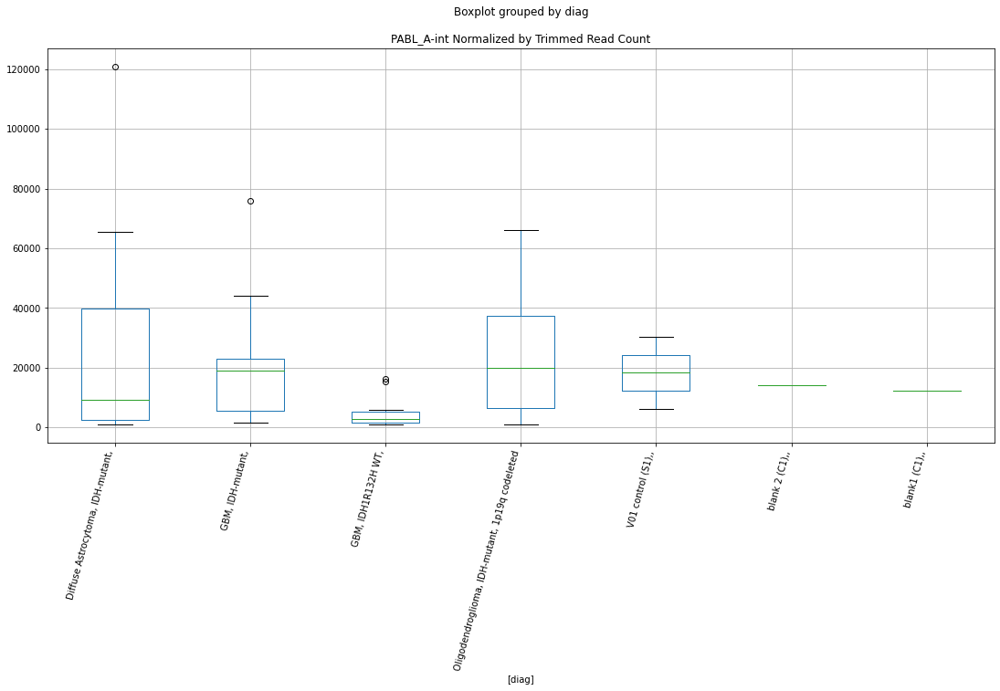

 p : 0.03201947474138924  ( t : 2.3241773891410222 ) :  D-plex  :  cutadapt2  :  LTR101_Mam
Control and blanks
76     22728.43
340    41394.41
Name: LTR101_Mam, dtype: float64
208    26454.03
Name: LTR101_Mam, dtype: float64
472    27163.92
Name: LTR101_Mam, dtype: float64


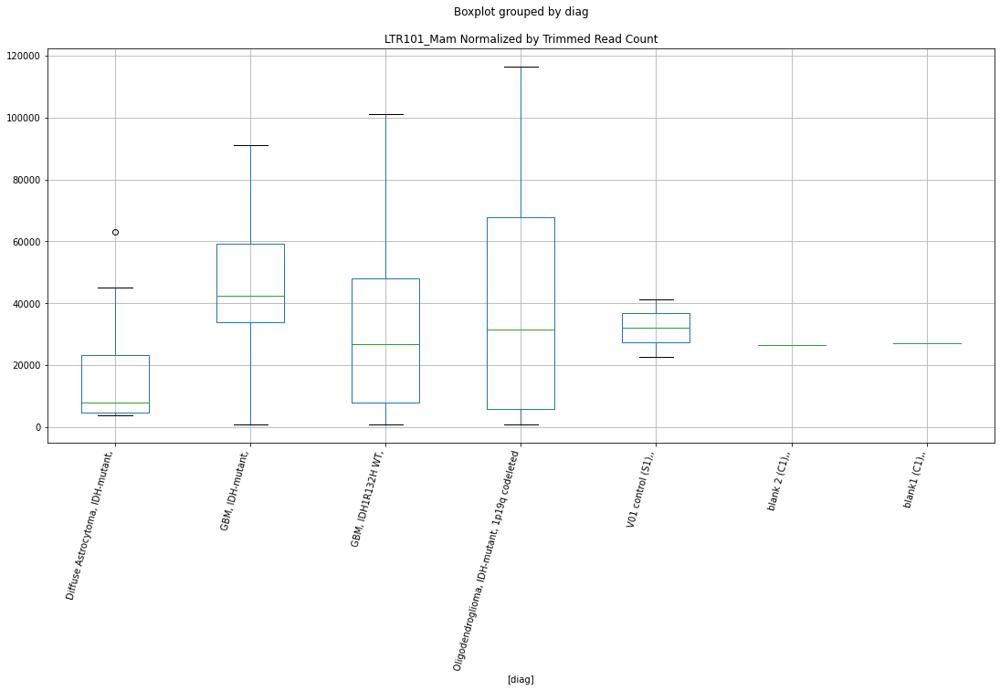

 p : 0.03203609381996218  ( t : 2.3239219012838257 ) :  D-plex  :  bbduk2  :  (ATT)n
Control and blanks
73       773.01
337    21363.77
Name: (ATT)n, dtype: float64
205    8059.09
Name: (ATT)n, dtype: float64
469    7689.86
Name: (ATT)n, dtype: float64


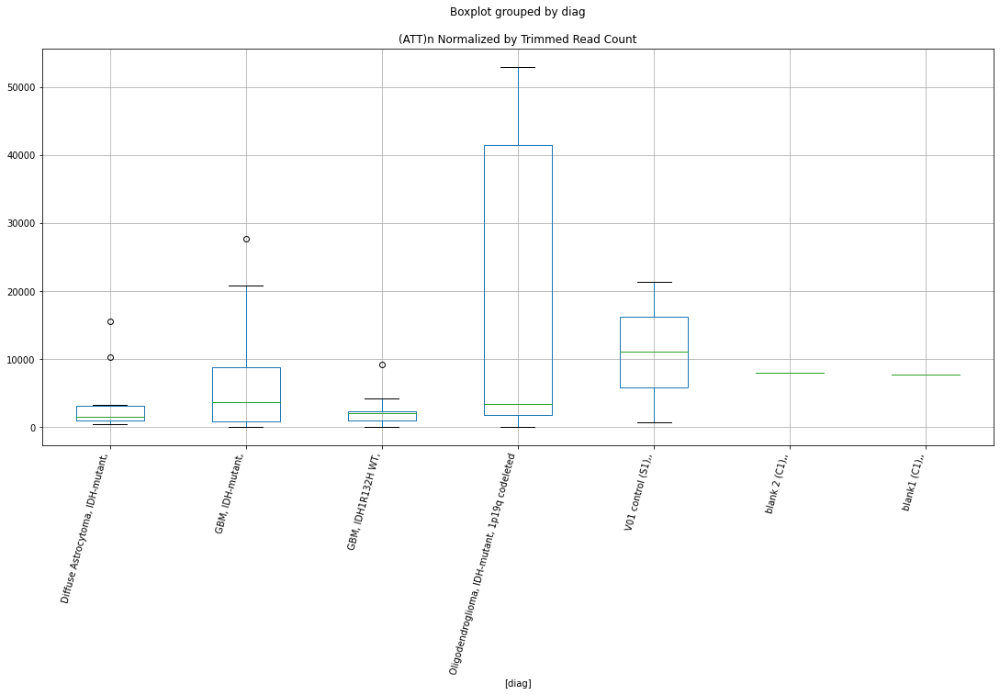

 p : 0.032072120255637715  ( t : 2.323368483418003 ) :  D-plex  :  cutadapt2  :  (CAAGCCAGC)n
Control and blanks
76     0.0
340    0.0
Name: (CAAGCCAGC)n, dtype: float64
208    21692.31
Name: (CAAGCCAGC)n, dtype: float64
472    0.0
Name: (CAAGCCAGC)n, dtype: float64


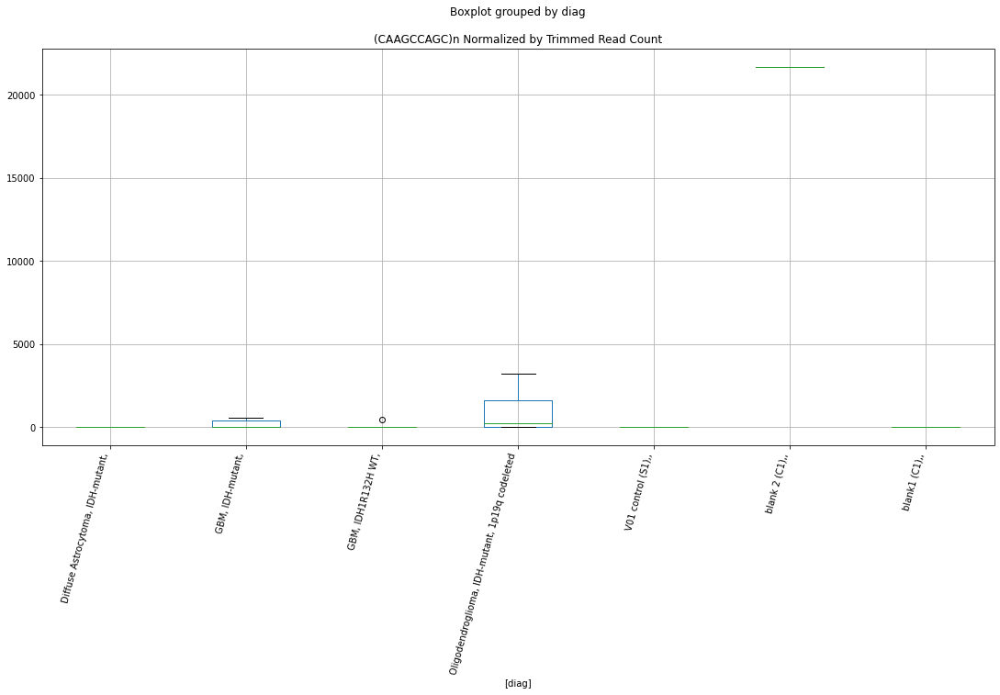

 p : 0.03209449420932606  ( t : 2.3230250779489605 ) :  D-plex  :  cutadapt2  :  (AATACA)n
Control and blanks
76     0.0
340    0.0
Name: (AATACA)n, dtype: float64
208    0.0
Name: (AATACA)n, dtype: float64
472    0.0
Name: (AATACA)n, dtype: float64


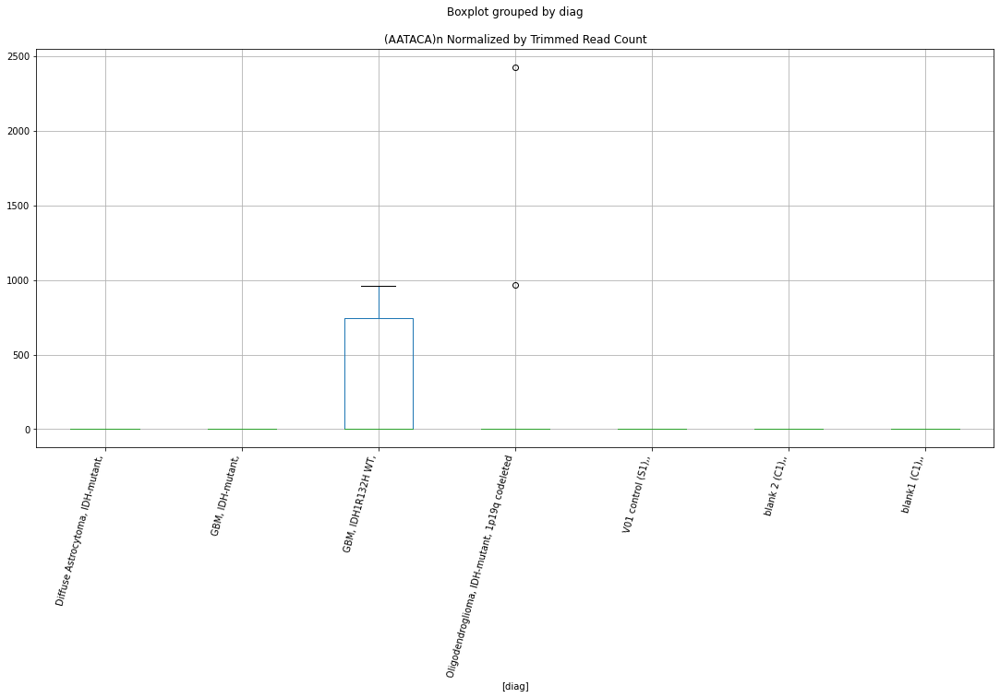

 p : 0.032156378353278094  ( t : 2.32207640932336 ) :  D-plex  :  cutadapt2  :  LTR18B
Control and blanks
76     25001.27
340    12330.25
Name: LTR18B, dtype: float64
208    4409.01
Name: LTR18B, dtype: float64
472    6357.51
Name: LTR18B, dtype: float64


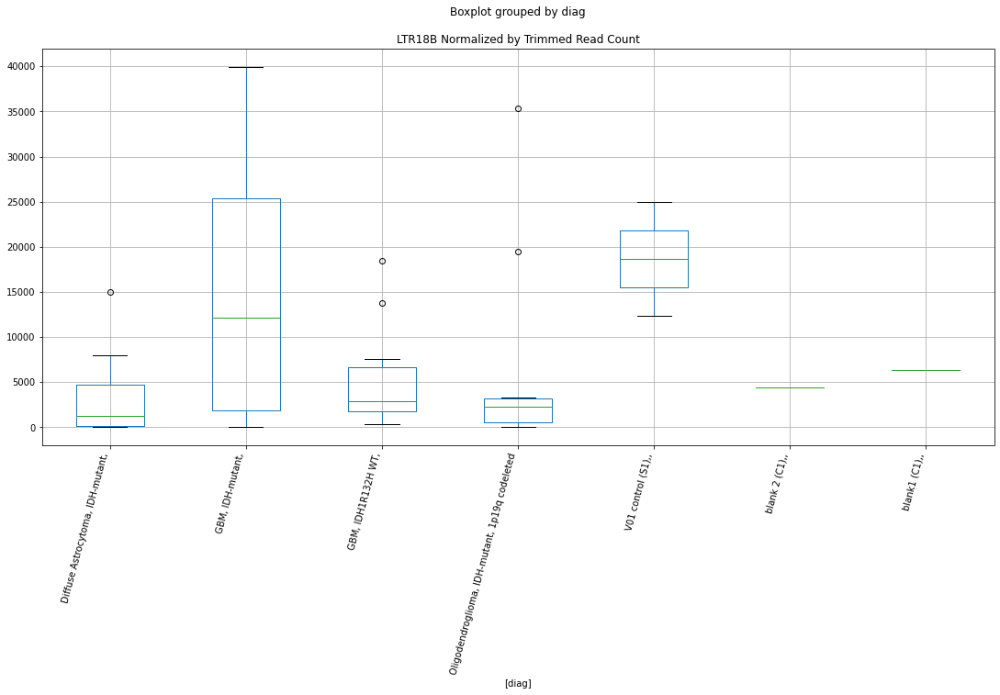

 p : 0.03219502719476009  ( t : 2.3214847920975505 ) :  D-plex  :  bbduk2  :  LTR81AB
Control and blanks
73     1546.02
337       0.00
Name: LTR81AB, dtype: float64
205    2328.18
Name: LTR81AB, dtype: float64
469    1774.58
Name: LTR81AB, dtype: float64


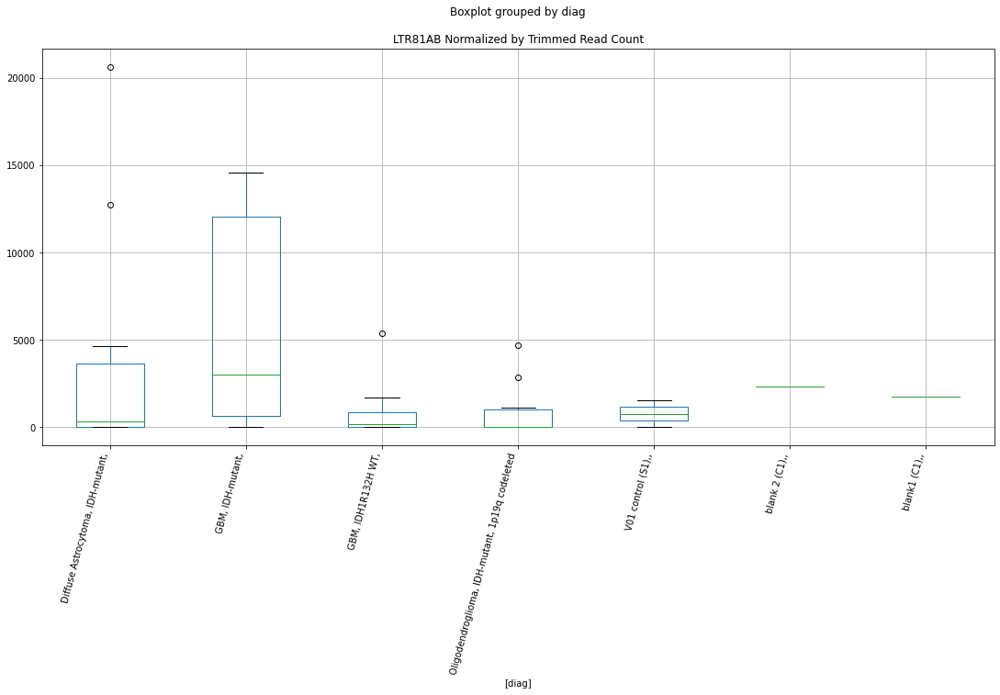

 p : 0.03221156756159693  ( t : 2.321231801950193 ) :  D-plex  :  bbduk2  :  (ATTCC)n
Control and blanks
73      66478.72
337    103258.24
Name: (ATTCC)n, dtype: float64
205    82202.75
Name: (ATTCC)n, dtype: float64
469    88137.57
Name: (ATTCC)n, dtype: float64


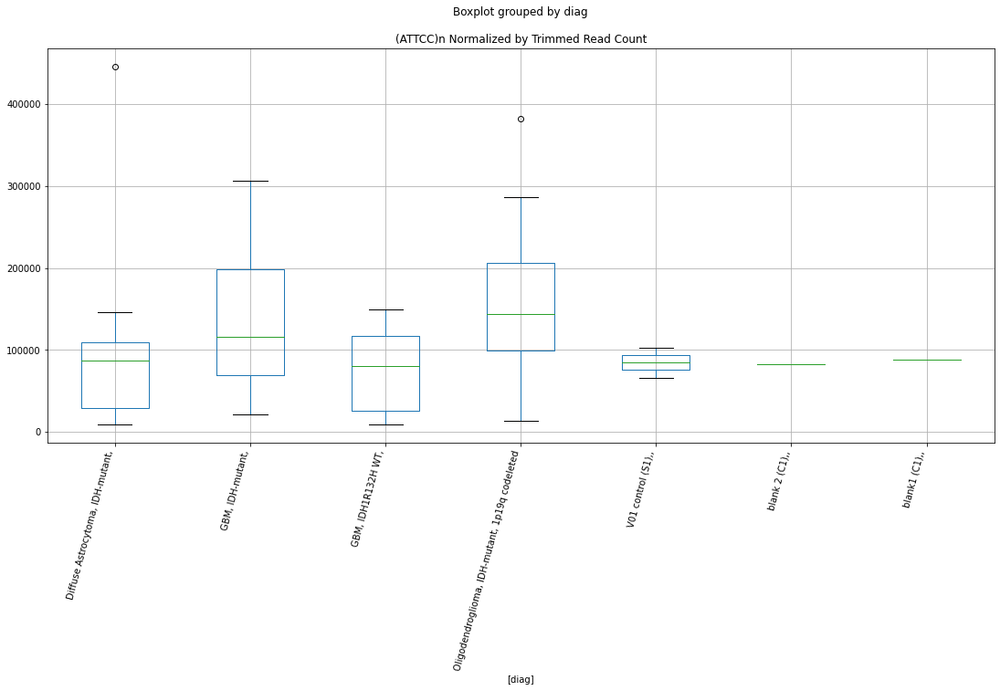

 p : 0.03224016640731177  ( t : 2.320794658096652 ) :  D-plex  :  cutadapt2  :  (TTTCTTT)n
Control and blanks
76     0.0
340    0.0
Name: (TTTCTTT)n, dtype: float64
208    0.0
Name: (TTTCTTT)n, dtype: float64
472    0.0
Name: (TTTCTTT)n, dtype: float64


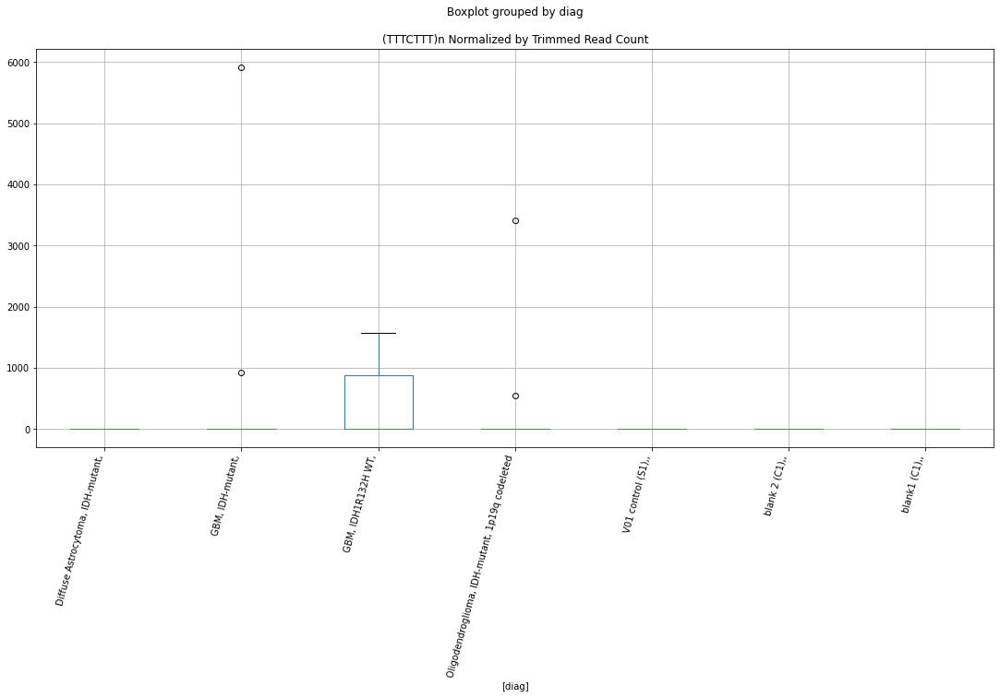

 p : 0.03227130564705187  ( t : 2.3203190927745285 ) :  D-plex  :  cutadapt2  :  (CCCCGC)n
Control and blanks
76     1515.23
340       0.00
Name: (CCCCGC)n, dtype: float64
208    176.36
Name: (CCCCGC)n, dtype: float64
472    0.0
Name: (CCCCGC)n, dtype: float64


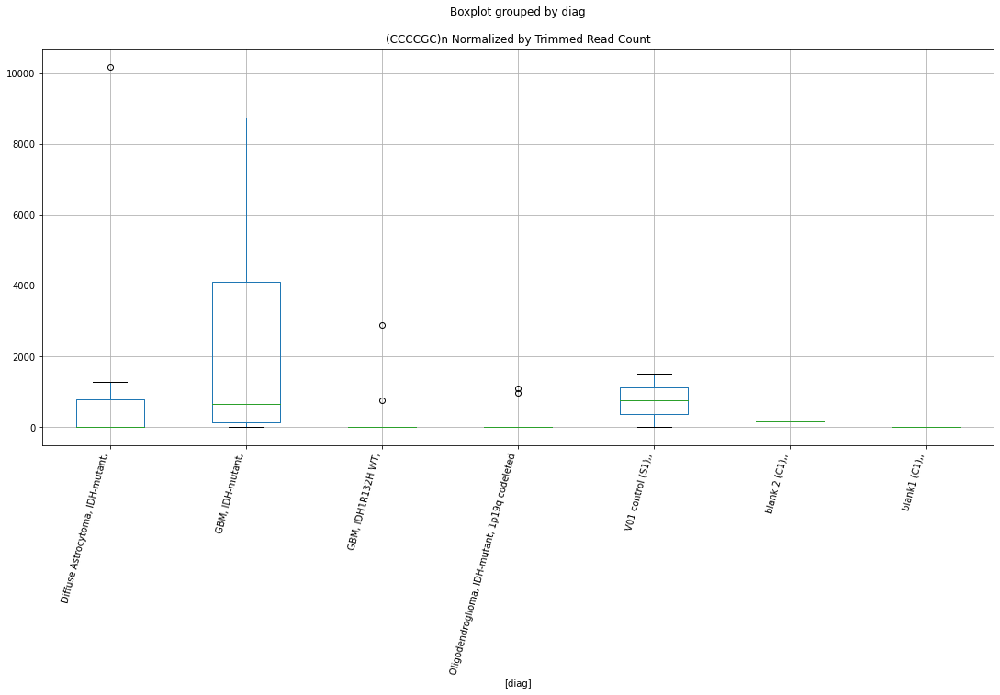

 p : 0.032308427848786875  ( t : 2.3197527109183627 ) :  D-plex  :  bbduk2  :  LTR10F
Control and blanks
73     0.0
337    0.0
Name: LTR10F, dtype: float64
205    9850.0
Name: LTR10F, dtype: float64
469    13013.6
Name: LTR10F, dtype: float64


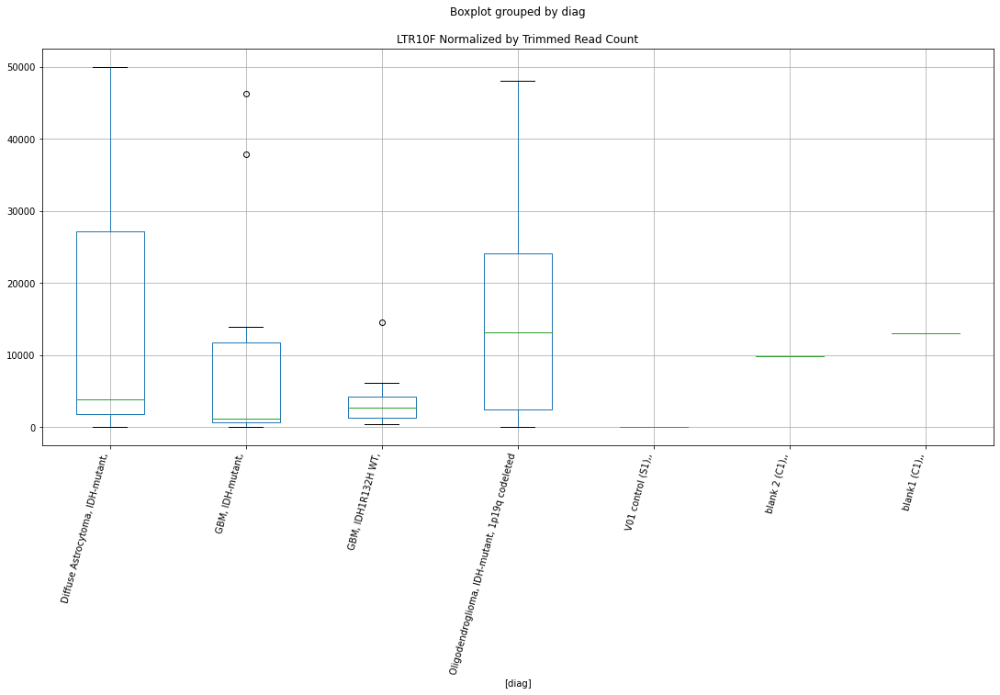

 p : 0.03231227348857204  ( t : 2.3196940716728665 ) :  D-plex  :  cutadapt2  :  LTR1A2
Control and blanks
76     25001.27
340      880.73
Name: LTR1A2, dtype: float64
208    24161.35
Name: LTR1A2, dtype: float64
472    24852.1
Name: LTR1A2, dtype: float64


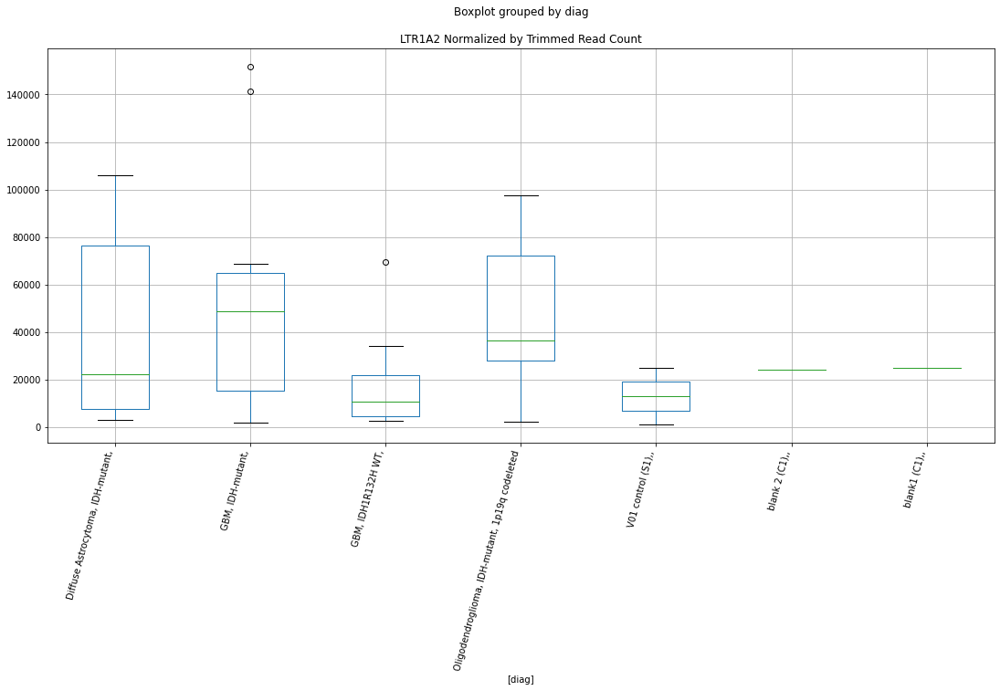

 p : 0.03234130415085138  ( t : 2.319251614139636 ) :  D-plex  :  cutadapt2  :  MER52D
Control and blanks
76     15152.28
340    24660.50
Name: MER52D, dtype: float64
208    25748.59
Name: MER52D, dtype: float64
472    22540.28
Name: MER52D, dtype: float64


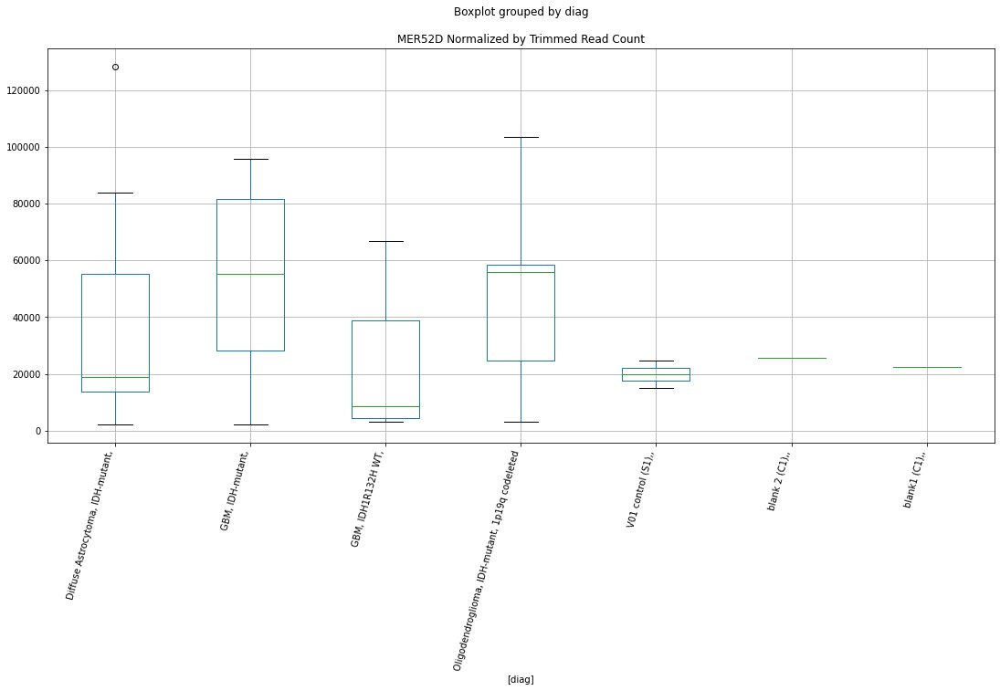

 p : 0.032451898347684284  ( t : 2.317569415401215 ) :  D-plex  :  bbduk2  :  (CCCCGC)n
Control and blanks
73     0.0
337    0.0
Name: (CCCCGC)n, dtype: float64
205    179.09
Name: (CCCCGC)n, dtype: float64
469    0.0
Name: (CCCCGC)n, dtype: float64


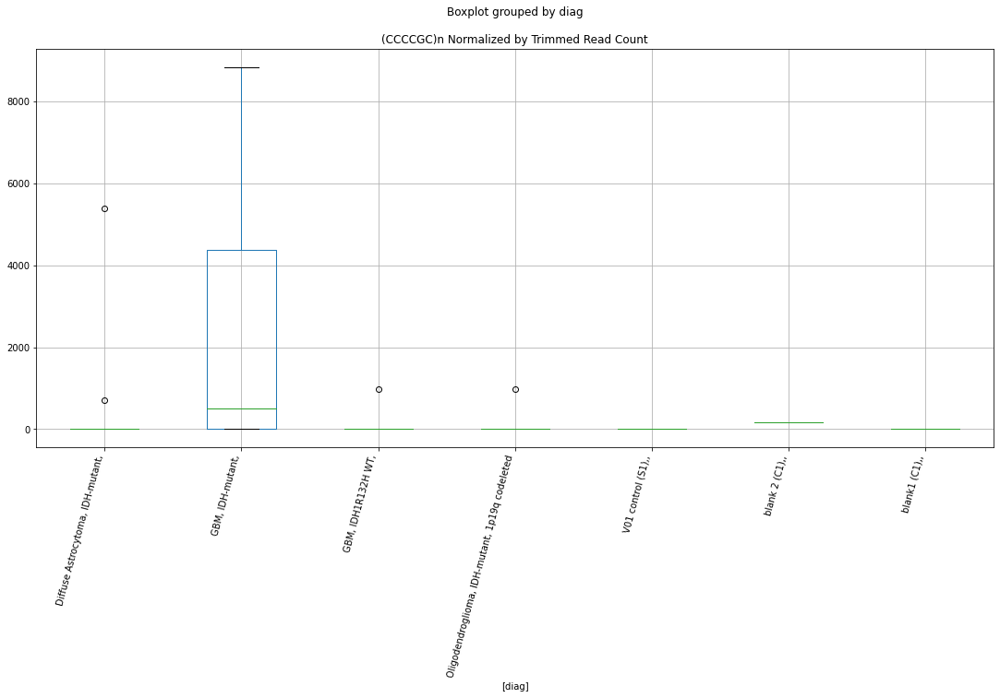

 p : 0.0325476361375087  ( t : 2.316117483929316 ) :  D-plex  :  bbduk2  :  (CCCCGC)n
Control and blanks
73     0.0
337    0.0
Name: (CCCCGC)n, dtype: float64
205    179.09
Name: (CCCCGC)n, dtype: float64
469    0.0
Name: (CCCCGC)n, dtype: float64


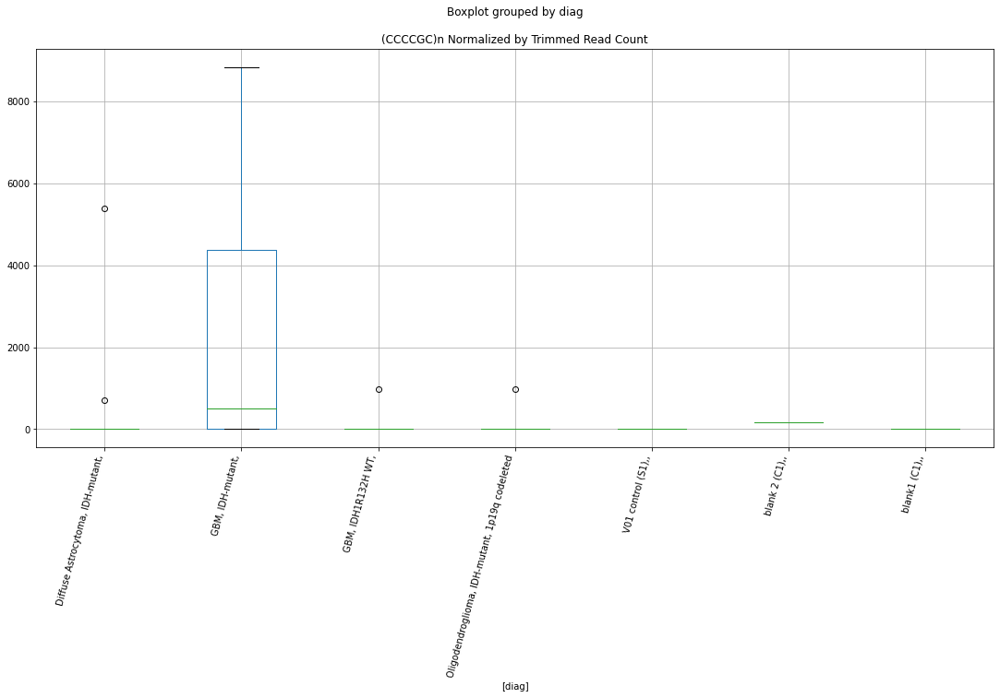

 p : 0.032631044564231416  ( t : 2.3148557644473393 ) :  D-plex  :  bbduk2  :  (AAT)n
Control and blanks
73      2319.03
337    39166.92
Name: (AAT)n, dtype: float64
205    9133.64
Name: (AAT)n, dtype: float64
469    11830.55
Name: (AAT)n, dtype: float64


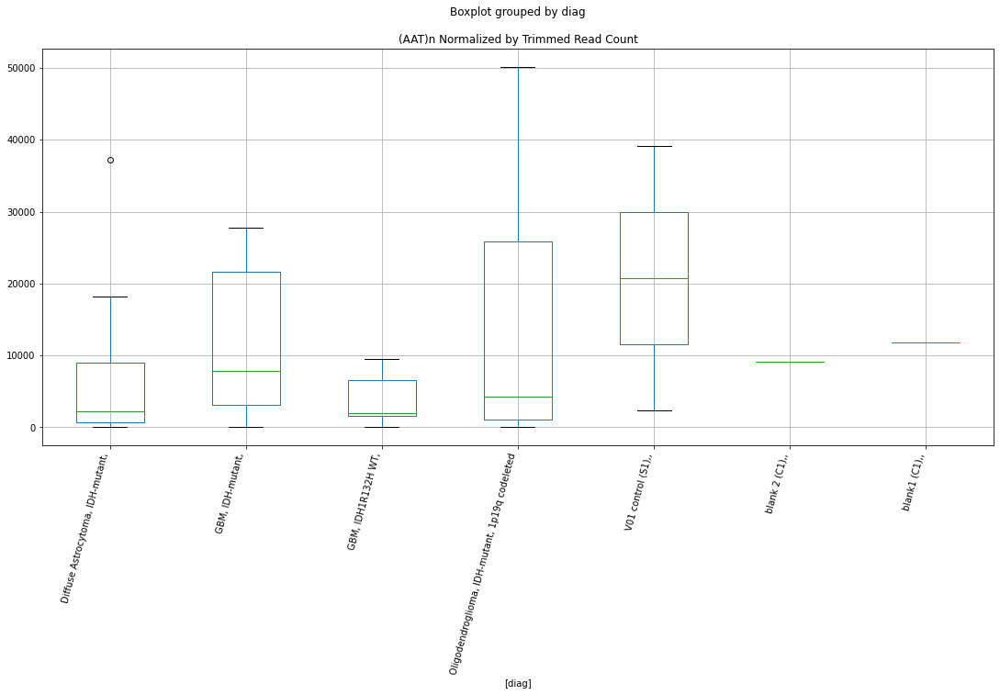

 p : 0.03271223640042529  ( t : 2.313630447698486 ) :  D-plex  :  cutadapt2  :  LSU-rRNA_Hsa
Control and blanks
76     1.07e+06
340    1.07e+06
Name: LSU-rRNA_Hsa, dtype: float64
208    712848.0
Name: LSU-rRNA_Hsa, dtype: float64
472    758278.06
Name: LSU-rRNA_Hsa, dtype: float64


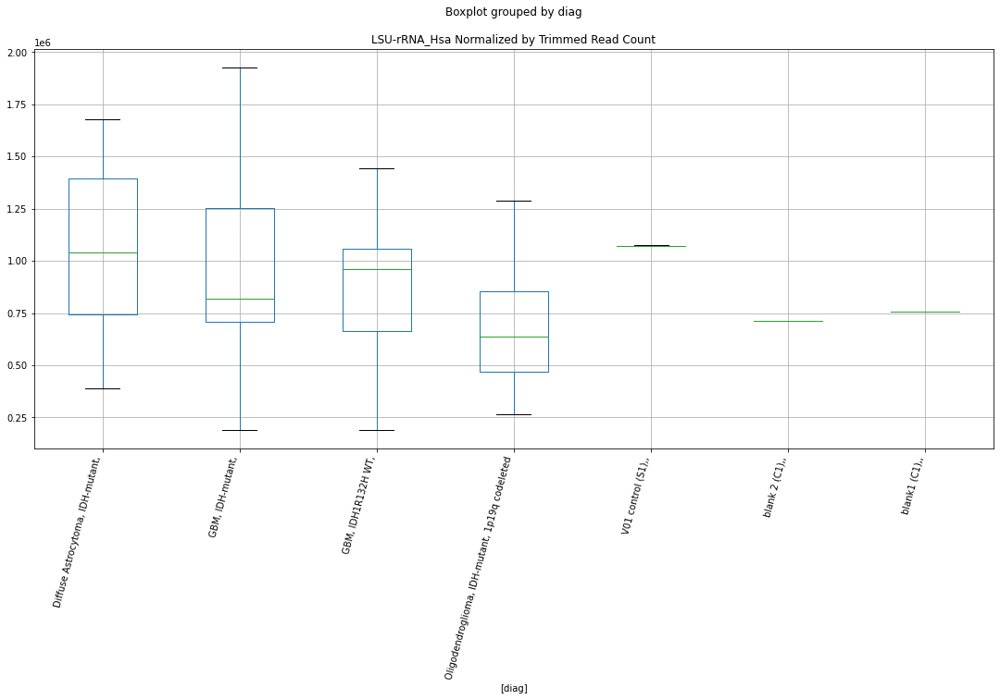

 p : 0.03281996804144098  ( t : 2.3120089527435104 ) :  D-plex  :  cutadapt2  :  LTR70
Control and blanks
76       757.61
340    20256.84
Name: LTR70, dtype: float64
208    2821.76
Name: LTR70, dtype: float64
472    5779.56
Name: LTR70, dtype: float64


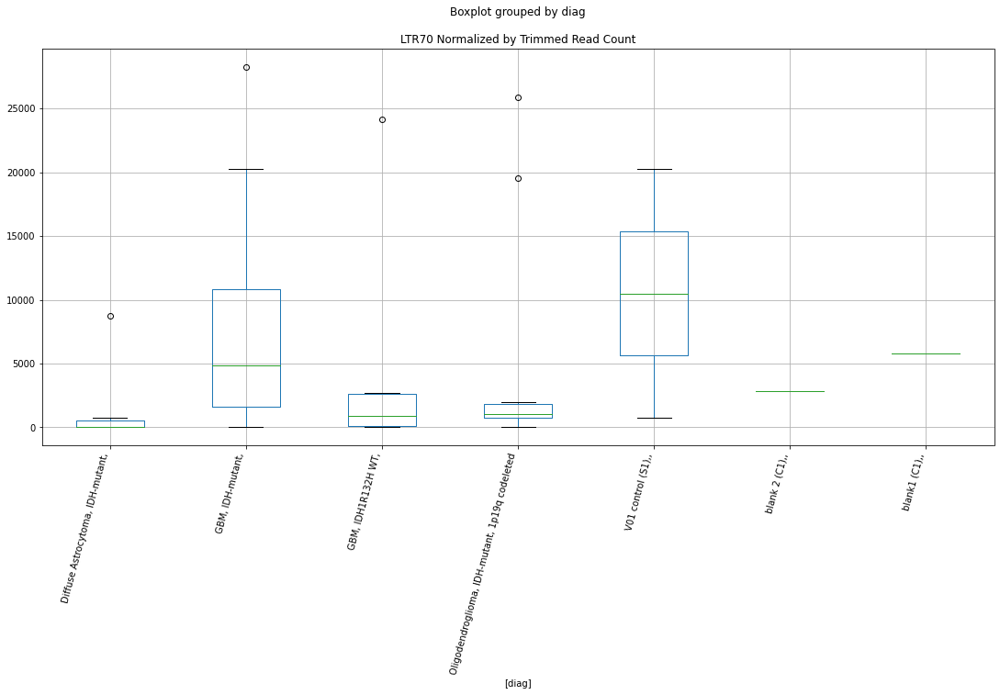

 p : 0.03294247650803526  ( t : 2.3101710399575284 ) :  D-plex  :  bbduk2  :  MLT1H2
Control and blanks
73     11595.13
337    48958.65
Name: MLT1H2, dtype: float64
205    65189.11
Name: MLT1H2, dtype: float64
469    65068.0
Name: MLT1H2, dtype: float64


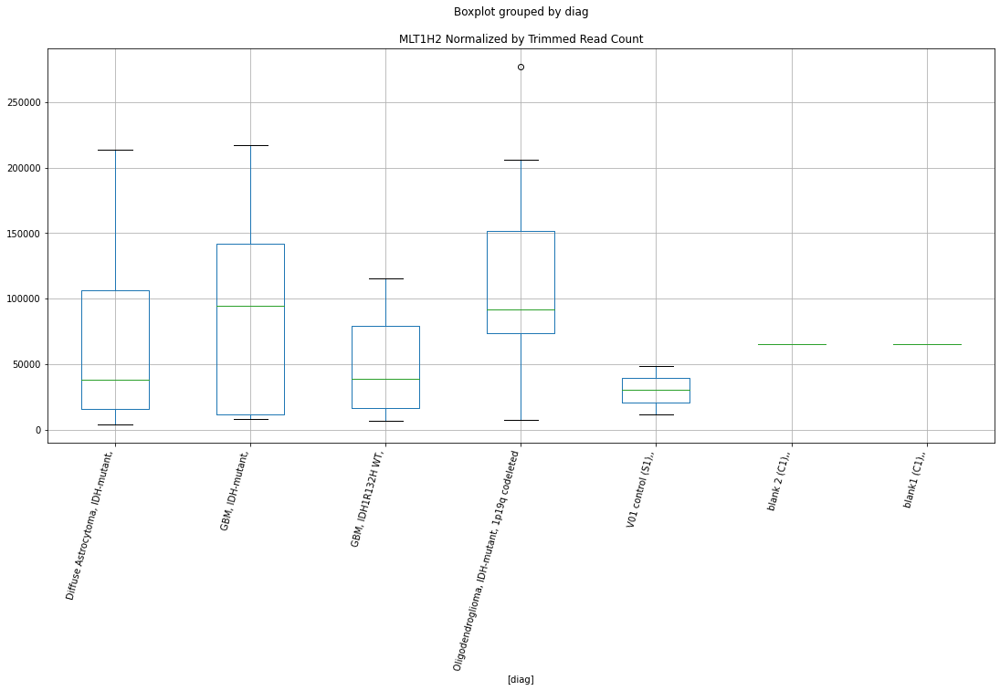

 p : 0.03306274823461854  ( t : 2.308372842917005 ) :  D-plex  :  cutadapt2  :  (TTCA)n
Control and blanks
76       757.61
340    16733.91
Name: (TTCA)n, dtype: float64
208    3527.2
Name: (TTCA)n, dtype: float64
472    8091.38
Name: (TTCA)n, dtype: float64


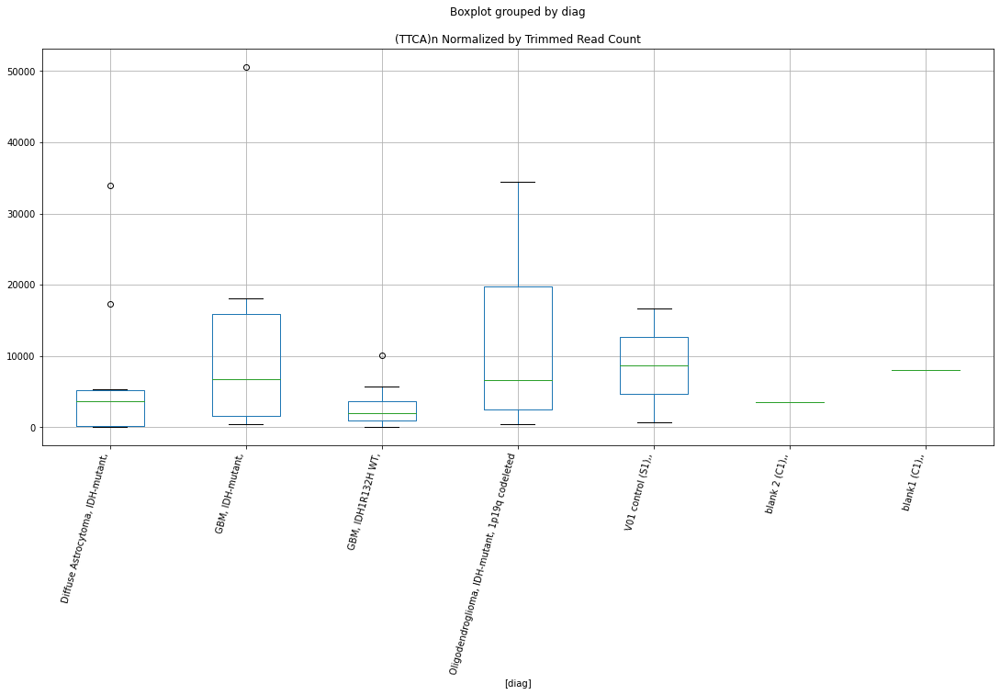

 p : 0.033092867472814334  ( t : 2.307923476878495 ) :  D-plex  :  bbduk2  :  (AATACA)n
Control and blanks
73     0.0
337    0.0
Name: (AATACA)n, dtype: float64
205    0.0
Name: (AATACA)n, dtype: float64
469    0.0
Name: (AATACA)n, dtype: float64


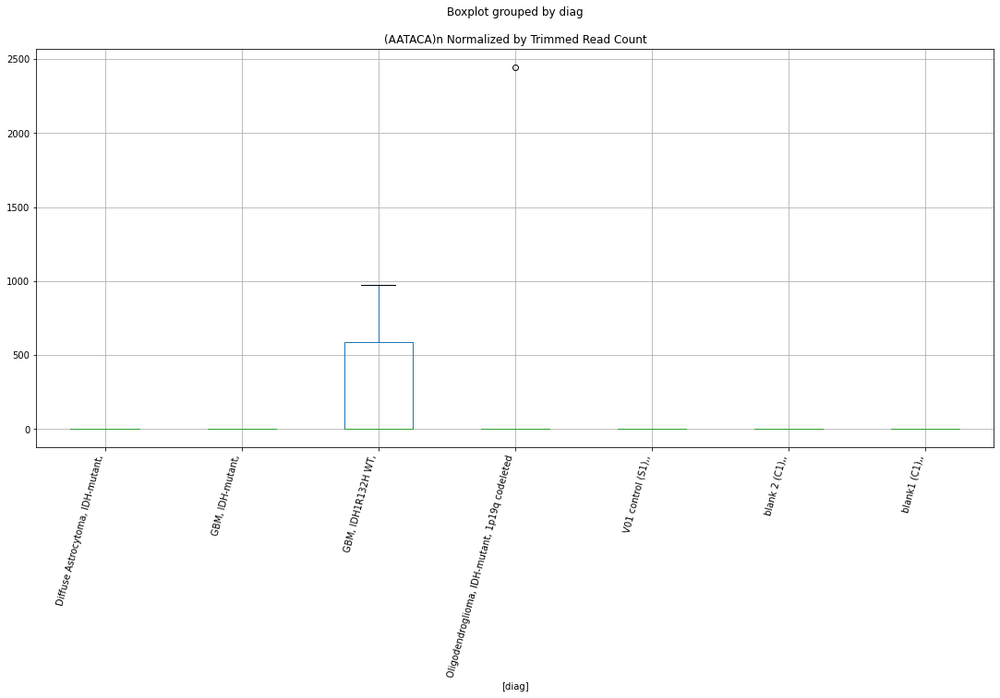

 p : 0.0331864542809022  ( t : 2.3065296192112923 ) :  D-plex  :  bbduk2  :  MLT1J2-int
Control and blanks
73         0.00
337    21363.77
Name: MLT1J2-int, dtype: float64
205    12357.28
Name: MLT1J2-int, dtype: float64
469    18928.87
Name: MLT1J2-int, dtype: float64


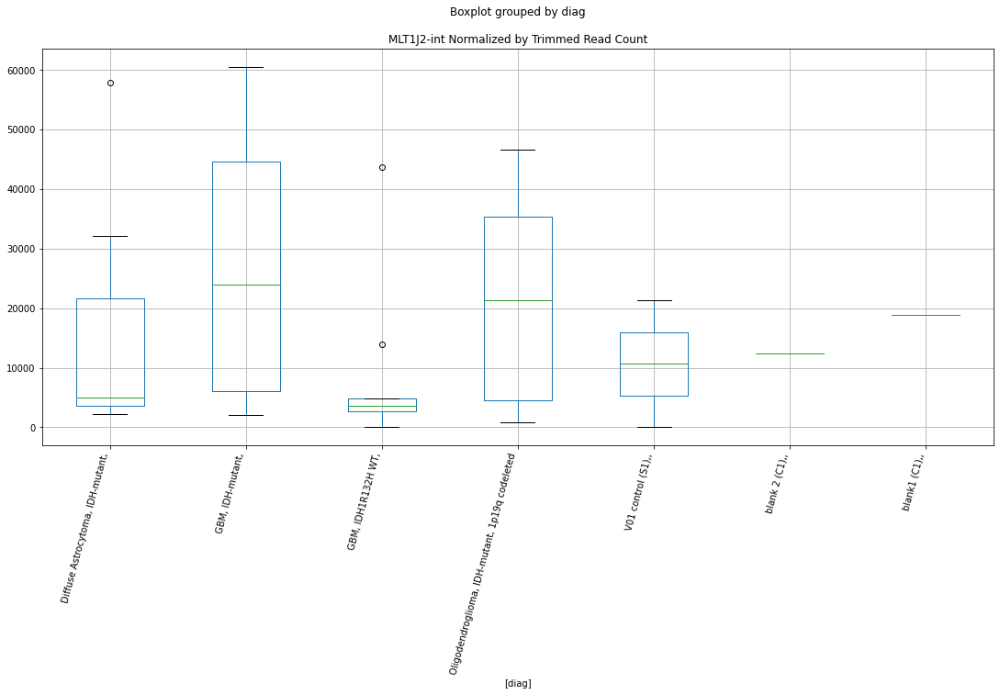

 p : 0.033195671810860444  ( t : 2.306392533030672 ) :  D-plex  :  bbduk2  :  MER63C
Control and blanks
73      3092.03
337    63201.17
Name: MER63C, dtype: float64
205    17550.91
Name: MER63C, dtype: float64
469    23069.57
Name: MER63C, dtype: float64


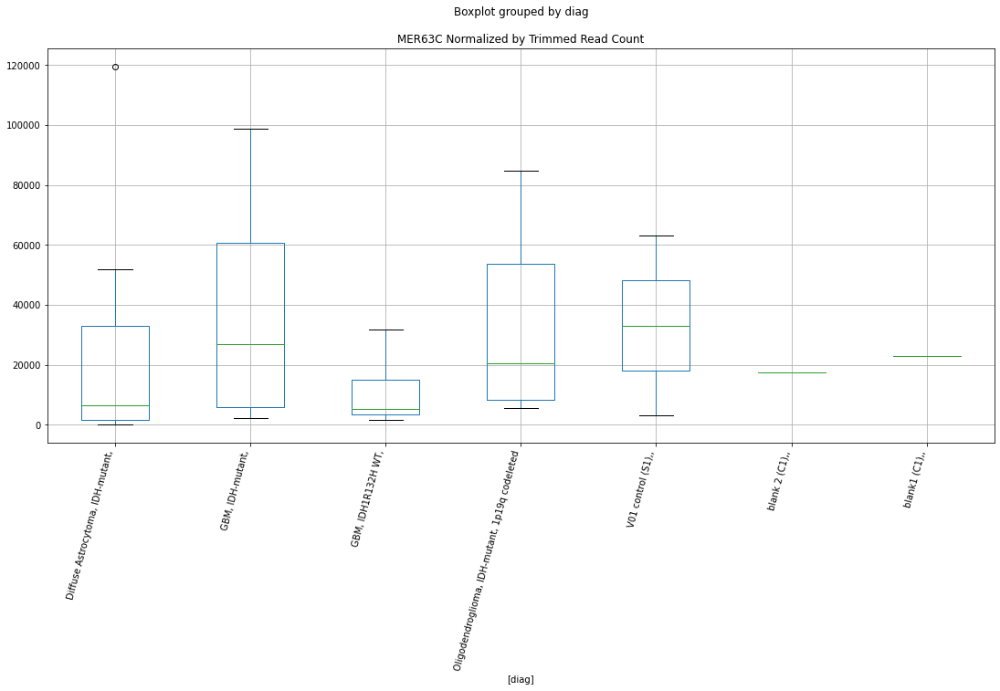

 p : 0.03321364365680495  ( t : 2.306125351250477 ) :  D-plex  :  cutadapt2  :  MamRep488
Control and blanks
76         0.00
340    12330.25
Name: MamRep488, dtype: float64
208    5290.81
Name: MamRep488, dtype: float64
472    8669.34
Name: MamRep488, dtype: float64


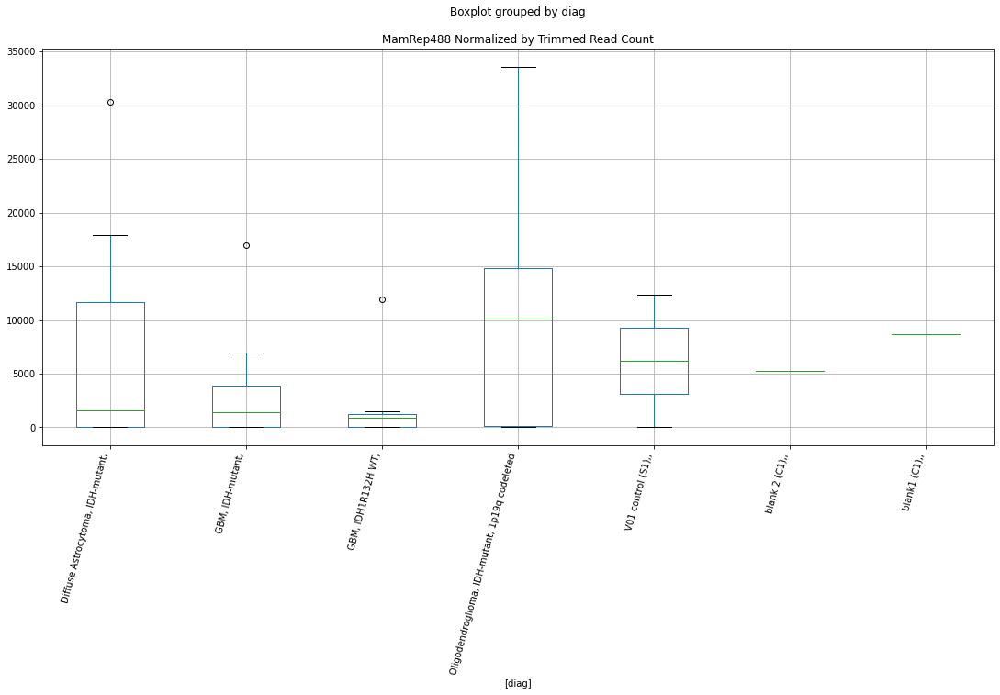

 p : 0.033245353046719134  ( t : 2.3056542646021647 ) :  D-plex  :  bbduk2  :  (GAAGG)n
Control and blanks
73       0.00
337    890.16
Name: (GAAGG)n, dtype: float64
205    179.09
Name: (GAAGG)n, dtype: float64
469    591.53
Name: (GAAGG)n, dtype: float64


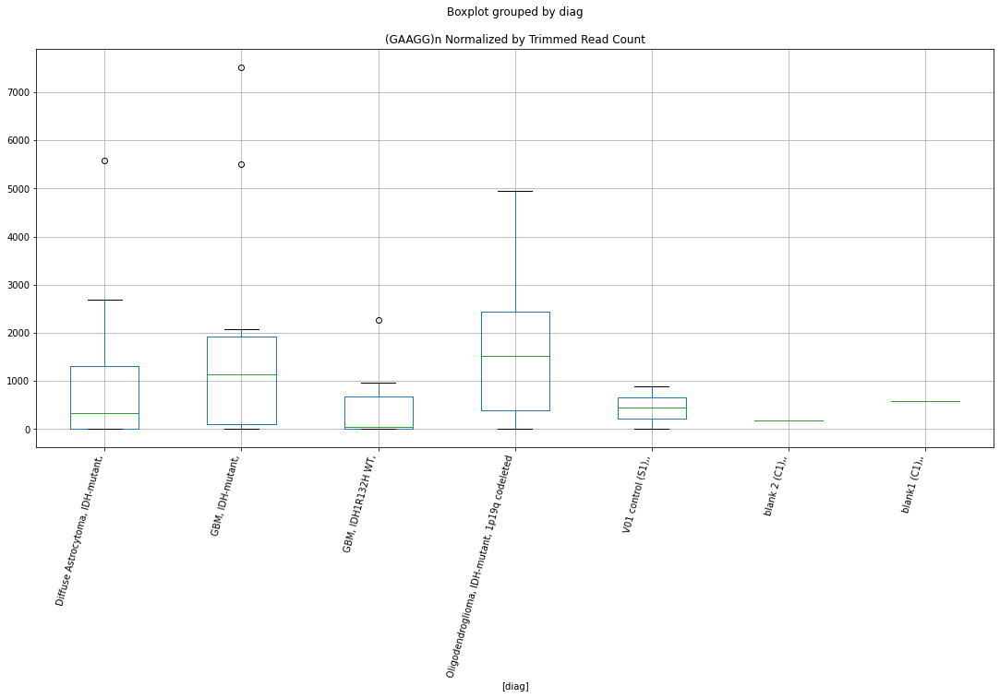

 p : 0.03329954460586084  ( t : 2.304850138294811 ) :  D-plex  :  bbduk2  :  (CTTCCT)n
Control and blanks
73     773.01
337      0.00
Name: (CTTCCT)n, dtype: float64
205    3044.55
Name: (CTTCCT)n, dtype: float64
469    1774.58
Name: (CTTCCT)n, dtype: float64


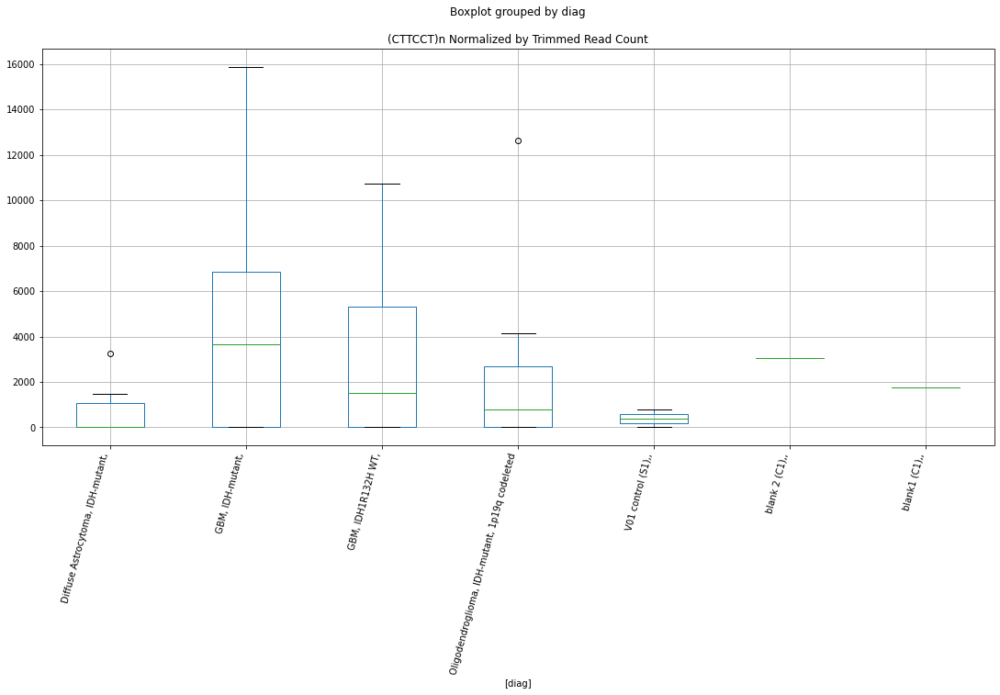

 p : 0.03330694317652722  ( t : 2.304740448123348 ) :  Lexogen  :  cutadapt2  :  L1MB3
Control and blanks
82       0.00
346    210.43
Name: L1MB3, dtype: float64
214    271.23
Name: L1MB3, dtype: float64
478    237.46
Name: L1MB3, dtype: float64


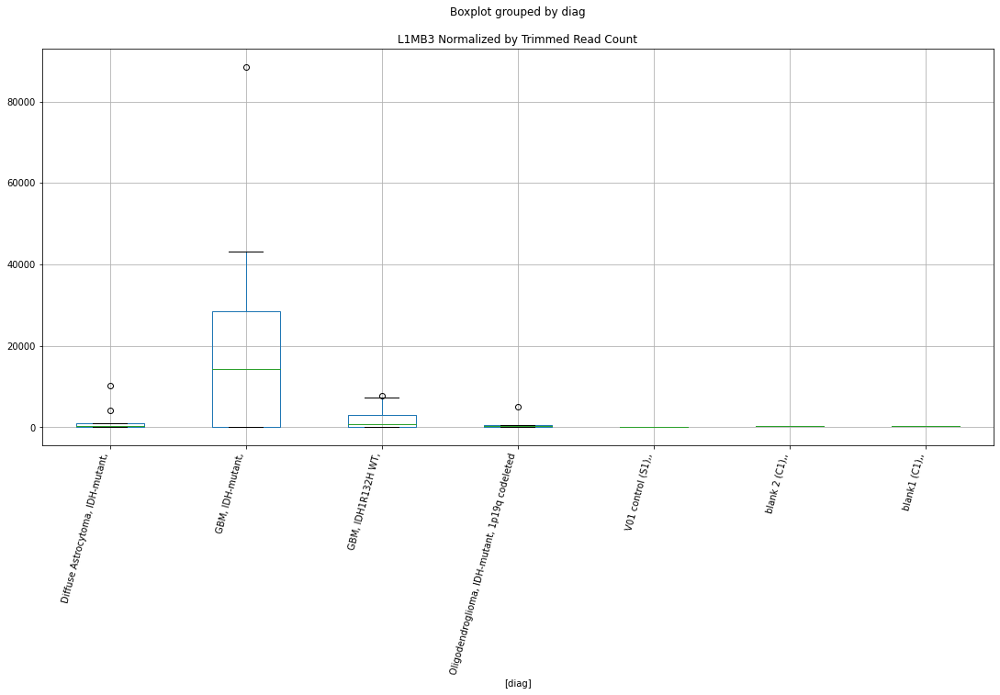

 p : 0.033313536890117956  ( t : 2.304642709693483 ) :  D-plex  :  cutadapt2  :  (TCTG)n
Control and blanks
76     0.0
340    0.0
Name: (TCTG)n, dtype: float64
208    1234.52
Name: (TCTG)n, dtype: float64
472    0.0
Name: (TCTG)n, dtype: float64


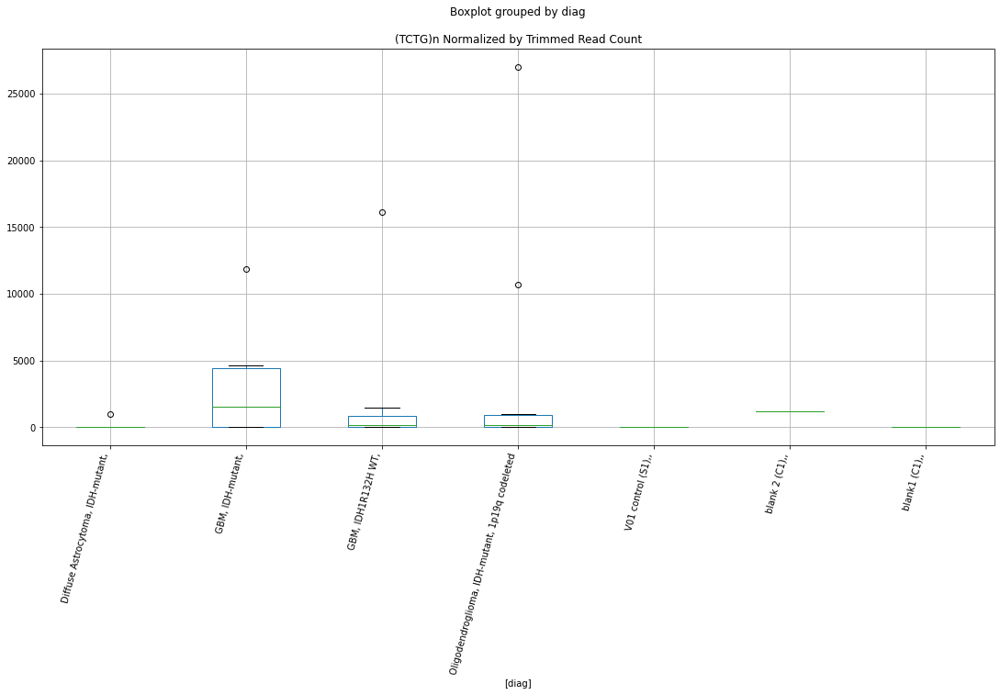

 p : 0.033428658150550405  ( t : 2.3029391553462055 ) :  D-plex  :  cutadapt2  :  (ATT)n
Control and blanks
76       757.61
340    29944.89
Name: (ATT)n, dtype: float64
208    7407.13
Name: (ATT)n, dtype: float64
472    8091.38
Name: (ATT)n, dtype: float64


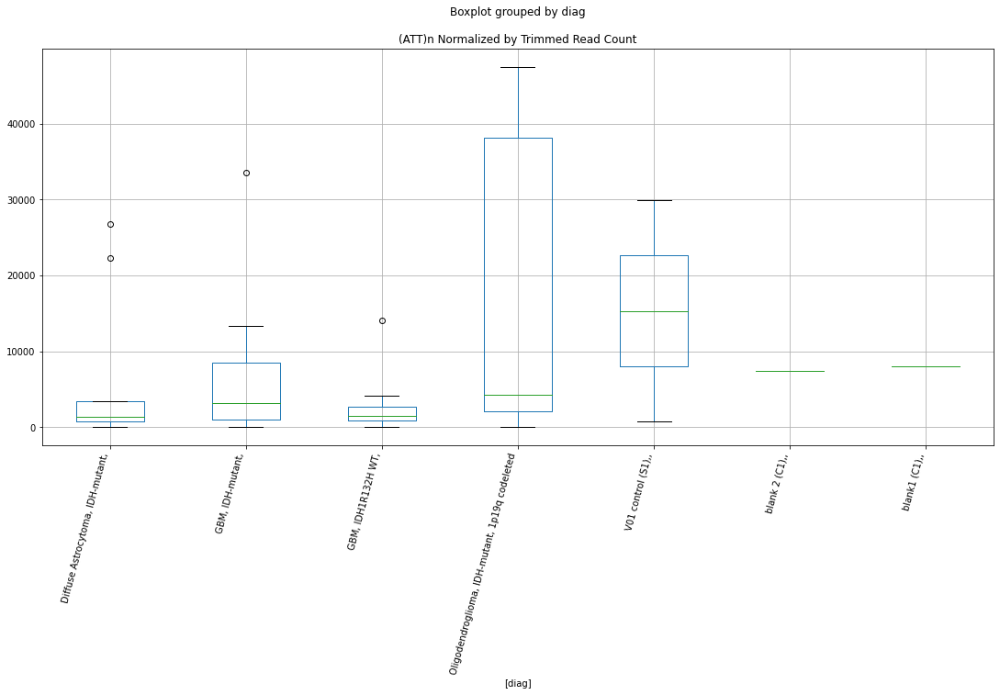

 p : 0.033445687163839576  ( t : 2.3026876235503524 ) :  D-plex  :  cutadapt2  :  (CAT)n
Control and blanks
76     0.0
340    0.0
Name: (CAT)n, dtype: float64
208    3527.2
Name: (CAT)n, dtype: float64
472    2311.82
Name: (CAT)n, dtype: float64


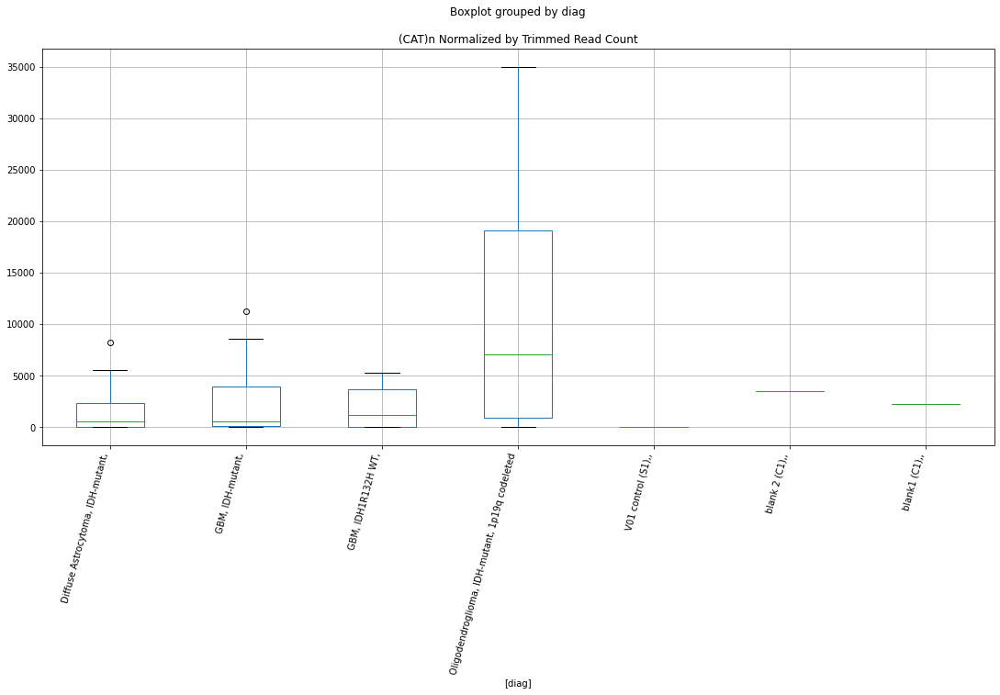

 p : 0.03354540349973071  ( t : 2.3012171149348335 ) :  D-plex  :  bbduk2  :  (CTTTCT)n
Control and blanks
73     2319.03
337       0.00
Name: (CTTTCT)n, dtype: float64
205    1074.55
Name: (CTTTCT)n, dtype: float64
469    1774.58
Name: (CTTTCT)n, dtype: float64


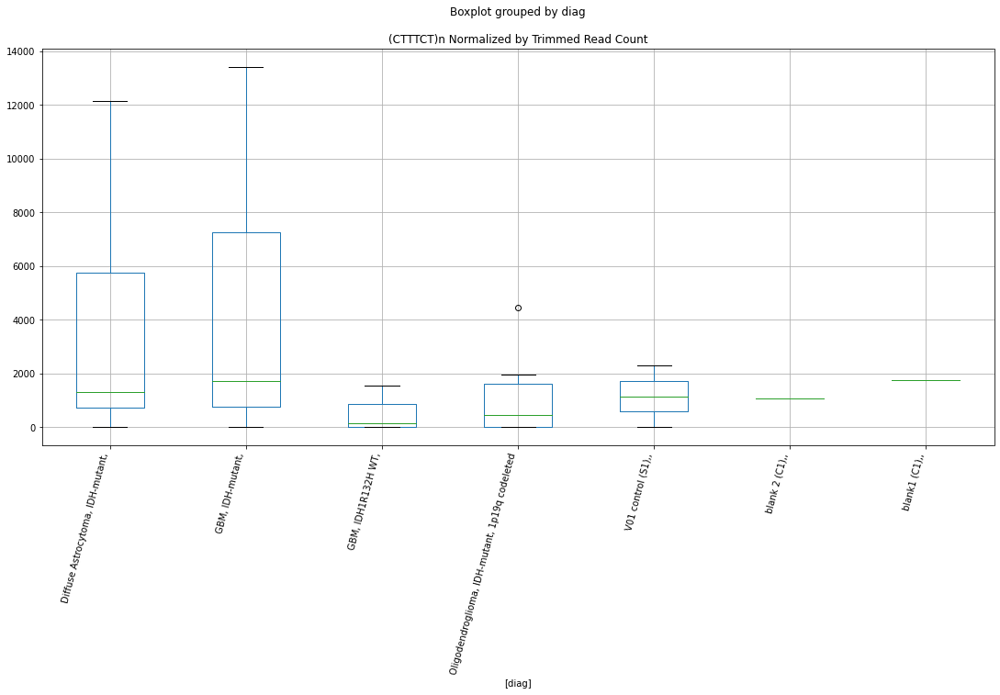

 p : 0.03356134135840155  ( t : 2.3009824564071613 ) :  D-plex  :  cutadapt2  :  (CATCAC)n
Control and blanks
76     1515.23
340       0.00
Name: (CATCAC)n, dtype: float64
208    2469.04
Name: (CATCAC)n, dtype: float64
472    2889.78
Name: (CATCAC)n, dtype: float64


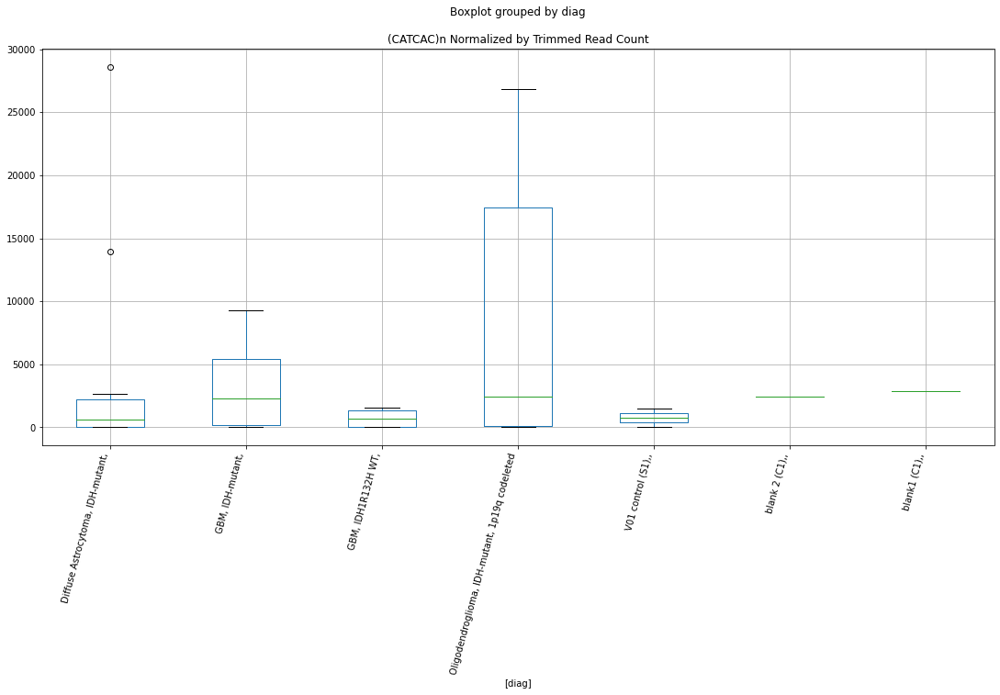

 p : 0.03356735727312573  ( t : 2.300893908903003 ) :  D-plex  :  cutadapt2  :  Helitron1Na_Mam
Control and blanks
76       0.00
340    880.73
Name: Helitron1Na_Mam, dtype: float64
208    7407.13
Name: Helitron1Na_Mam, dtype: float64
472    4045.69
Name: Helitron1Na_Mam, dtype: float64


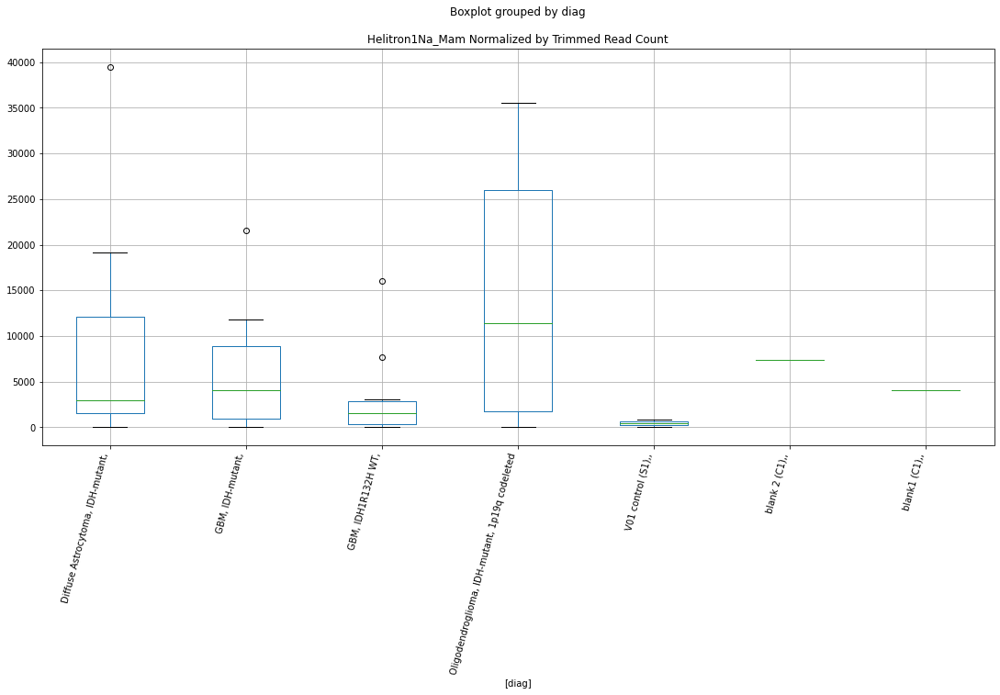

 p : 0.03359234125437369  ( t : 2.3005263301419365 ) :  D-plex  :  cutadapt2  :  (ACACAC)n
Control and blanks
76       757.61
340    16733.91
Name: (ACACAC)n, dtype: float64
208    2821.76
Name: (ACACAC)n, dtype: float64
472    2311.82
Name: (ACACAC)n, dtype: float64


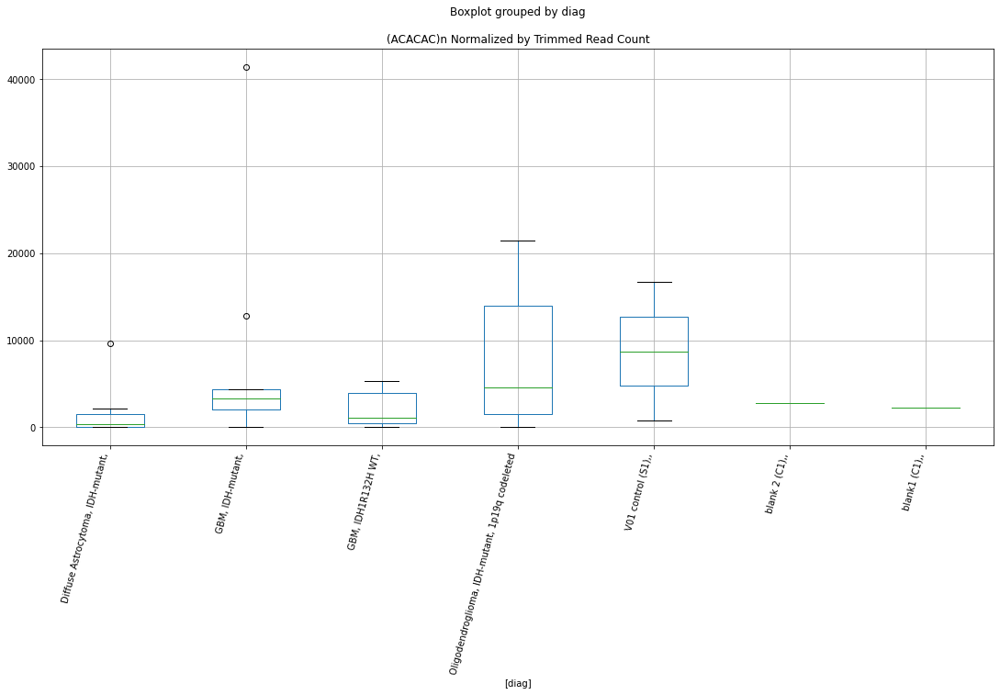

 p : 0.03361661968922333  ( t : 2.3001693745355047 ) :  D-plex  :  bbduk2  :  LSU-rRNA_Hsa
Control and blanks
73     1.07e+06
337    1.07e+06
Name: LSU-rRNA_Hsa, dtype: float64
205    714035.63
Name: LSU-rRNA_Hsa, dtype: float64
469    764844.82
Name: LSU-rRNA_Hsa, dtype: float64


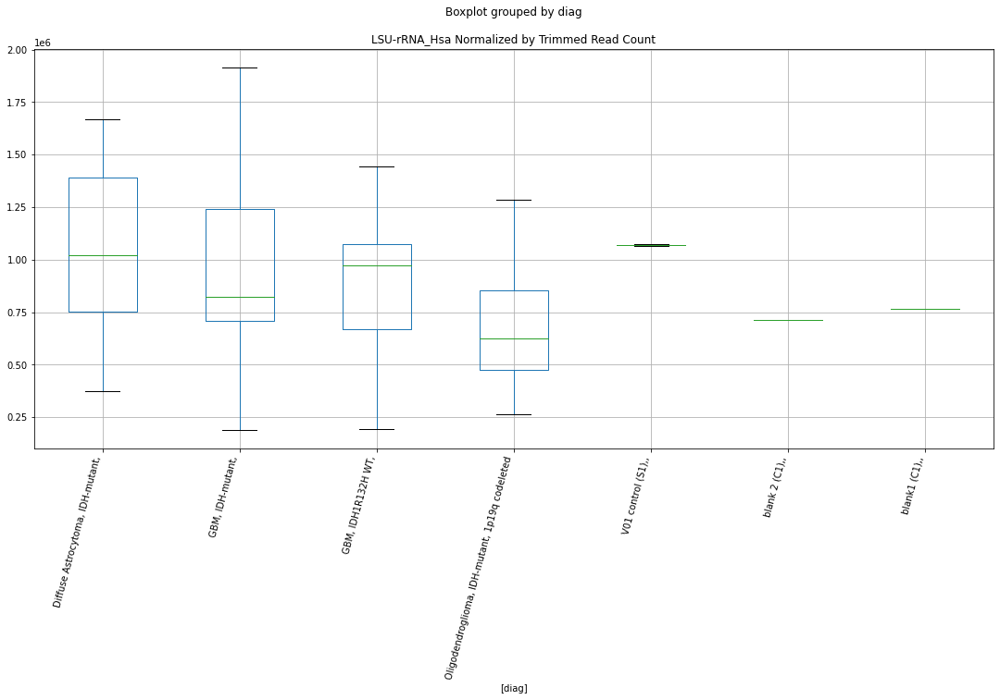

 p : 0.033716541190414624  ( t : 2.2987027822793196 ) :  D-plex  :  bbduk2  :  (TTTTG)n
Control and blanks
73     773.01
337    890.16
Name: (TTTTG)n, dtype: float64
205    4477.27
Name: (TTTTG)n, dtype: float64
469    4732.22
Name: (TTTTG)n, dtype: float64


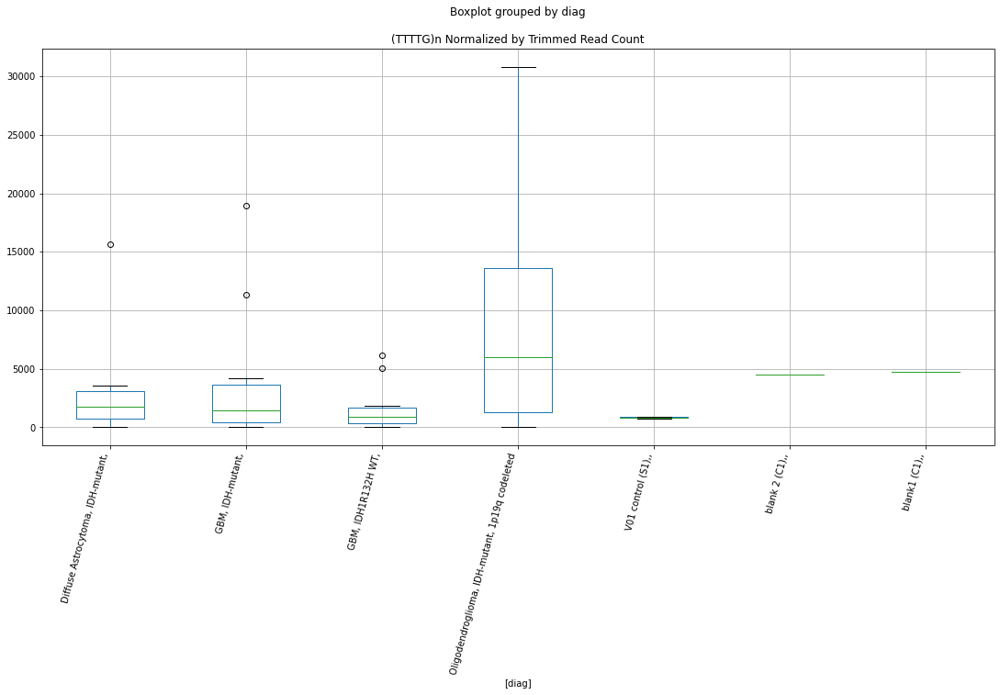

 p : 0.03376418326477323  ( t : 2.2980049363653516 ) :  D-plex  :  cutadapt2  :  ORSL
Control and blanks
76      3030.46
340    32587.09
Name: ORSL, dtype: float64
208    18165.1
Name: ORSL, dtype: float64
472    13292.98
Name: ORSL, dtype: float64


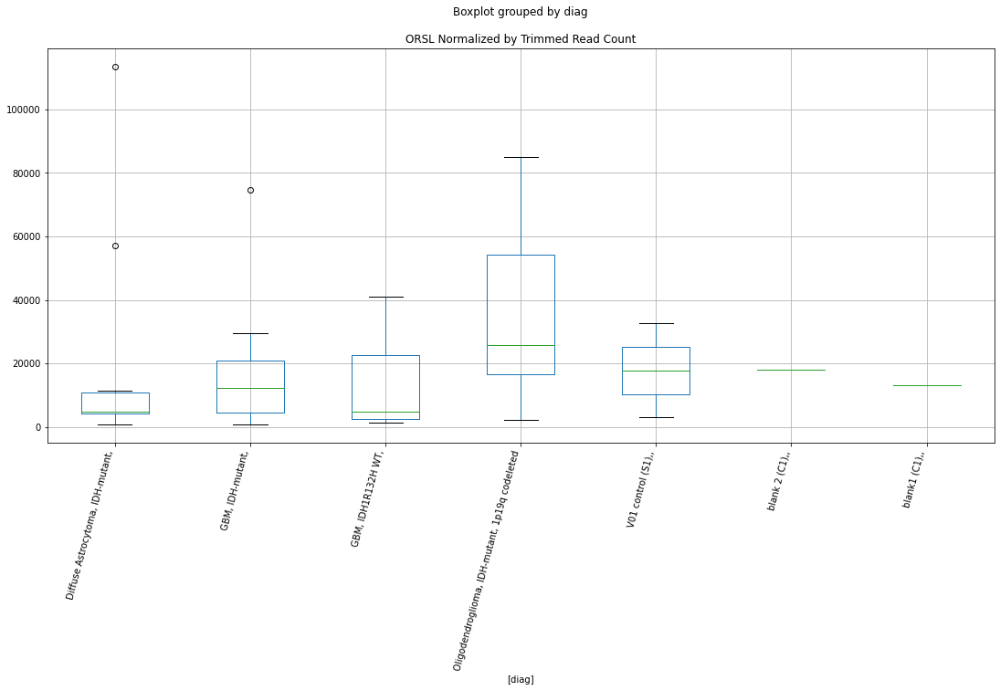

 p : 0.03392281489904293  ( t : 2.2956879113718083 ) :  D-plex  :  cutadapt2  :  (GGAAGG)n
Control and blanks
76     0.0
340    0.0
Name: (GGAAGG)n, dtype: float64
208    176.36
Name: (GGAAGG)n, dtype: float64
472    0.0
Name: (GGAAGG)n, dtype: float64


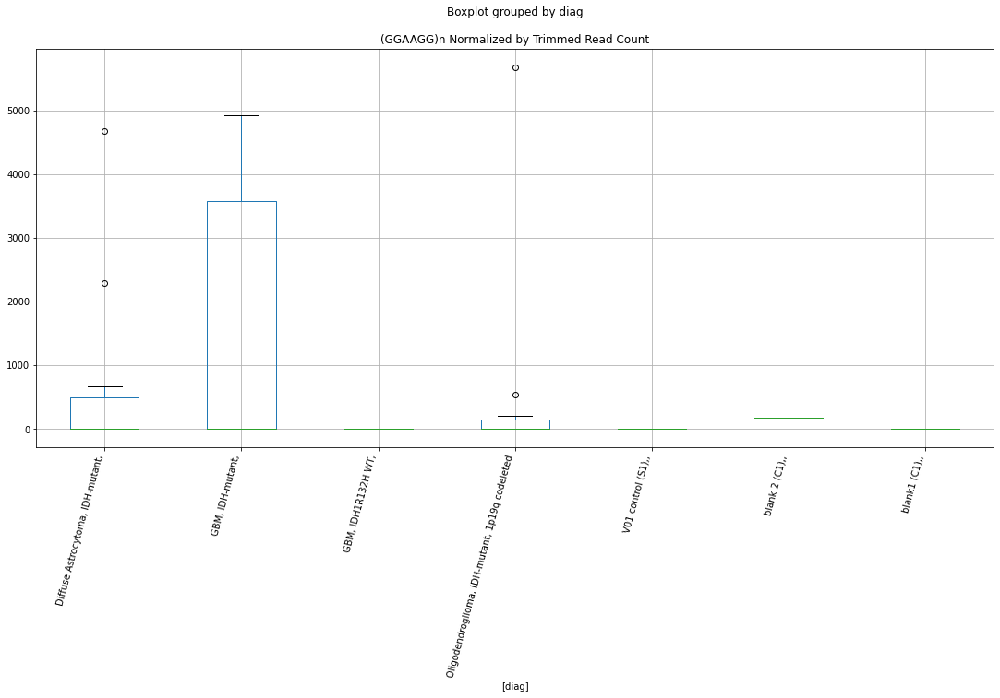

 p : 0.03397793896139366  ( t : 2.294885102001357 ) :  D-plex  :  cutadapt2  :  LTR84a
Control and blanks
76     3030.46
340     880.73
Name: LTR84a, dtype: float64
208    6878.05
Name: LTR84a, dtype: float64
472    6357.51
Name: LTR84a, dtype: float64


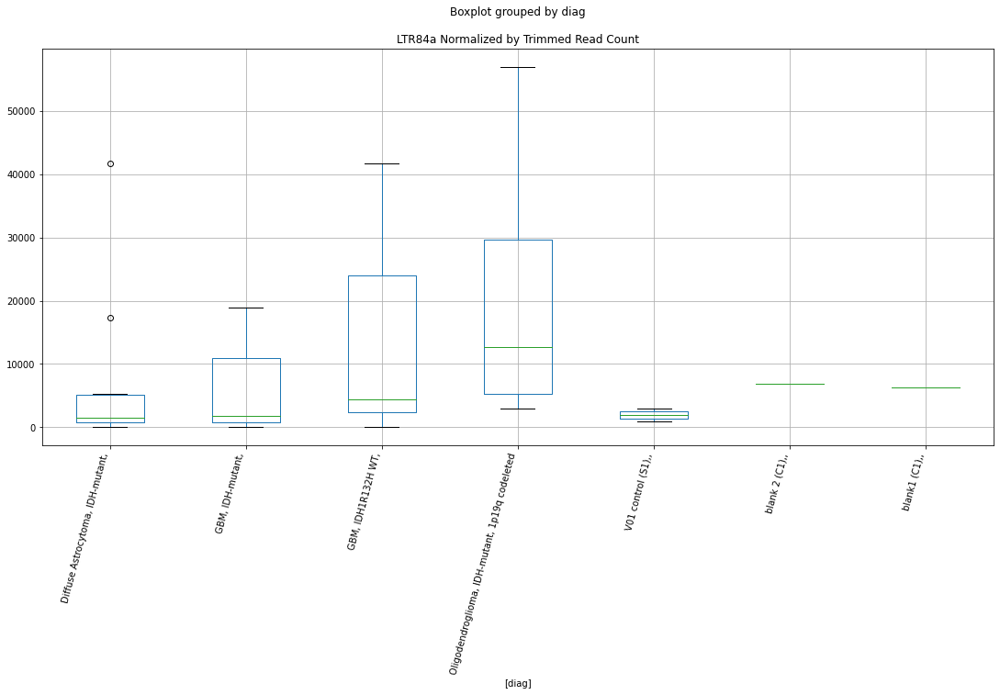

 p : 0.034023107956317314  ( t : 2.294228174239375 ) :  D-plex  :  cutadapt2  :  (TTATA)n
Control and blanks
76     0.0
340    0.0
Name: (TTATA)n, dtype: float64
208    1234.52
Name: (TTATA)n, dtype: float64
472    1155.91
Name: (TTATA)n, dtype: float64


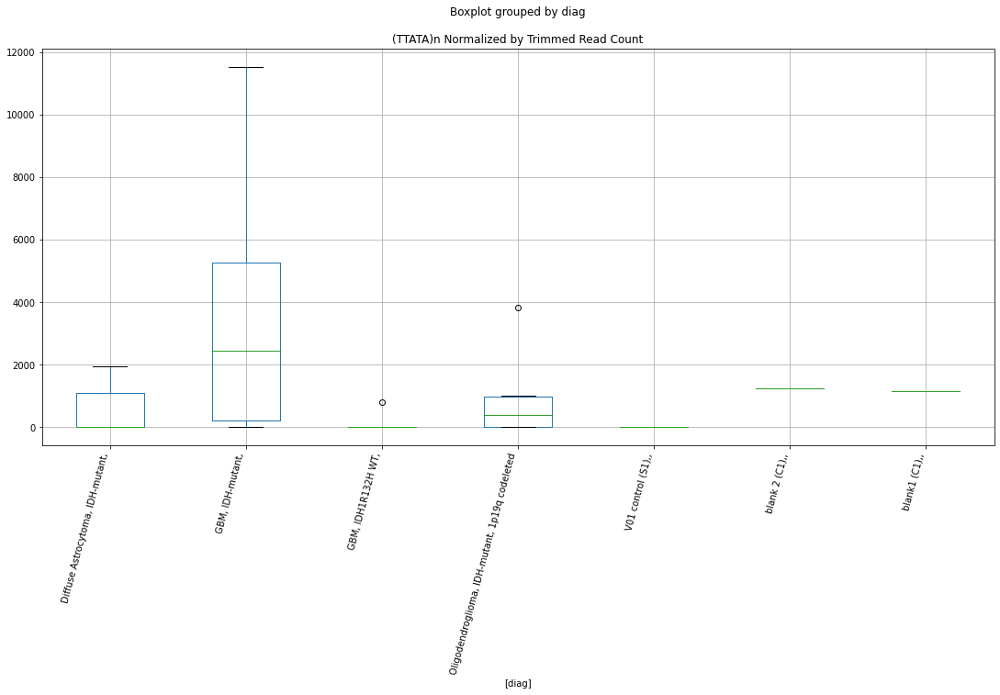

 p : 0.03403680621769177  ( t : 2.2940291094903937 ) :  D-plex  :  cutadapt2  :  Tigger18a
Control and blanks
76     10606.60
340    58128.32
Name: Tigger18a, dtype: float64
208    22045.03
Name: Tigger18a, dtype: float64
472    25430.06
Name: Tigger18a, dtype: float64


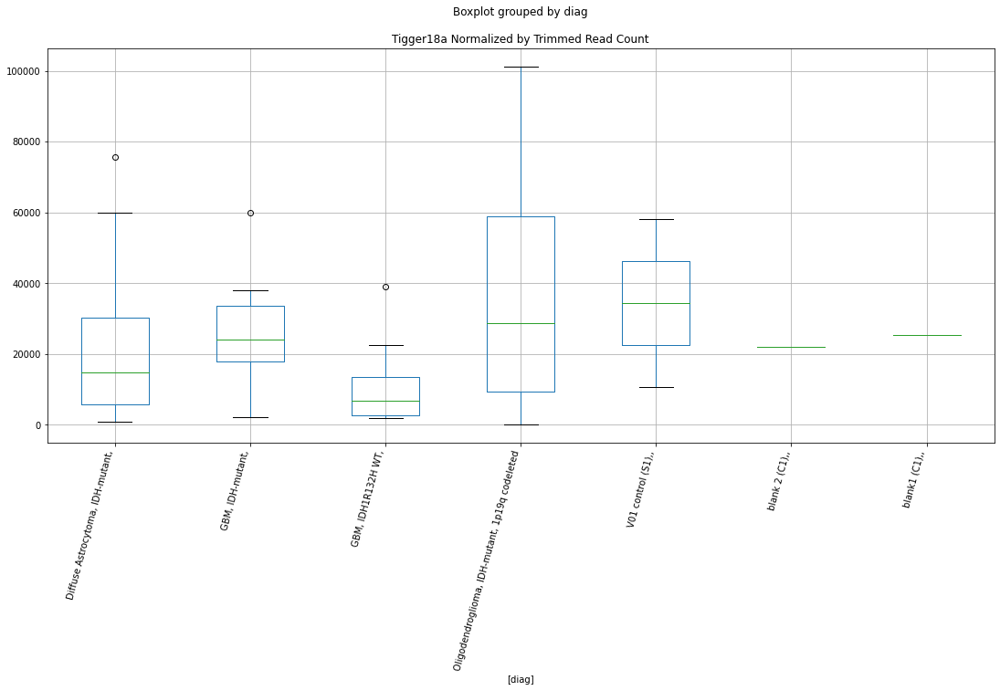

 p : 0.034143535552475464  ( t : 2.292480643632627 ) :  D-plex  :  bbduk2  :  CR1_Mam
Control and blanks
73     17779.19
337    30265.35
Name: CR1_Mam, dtype: float64
205    19700.0
Name: CR1_Mam, dtype: float64
469    25435.67
Name: CR1_Mam, dtype: float64


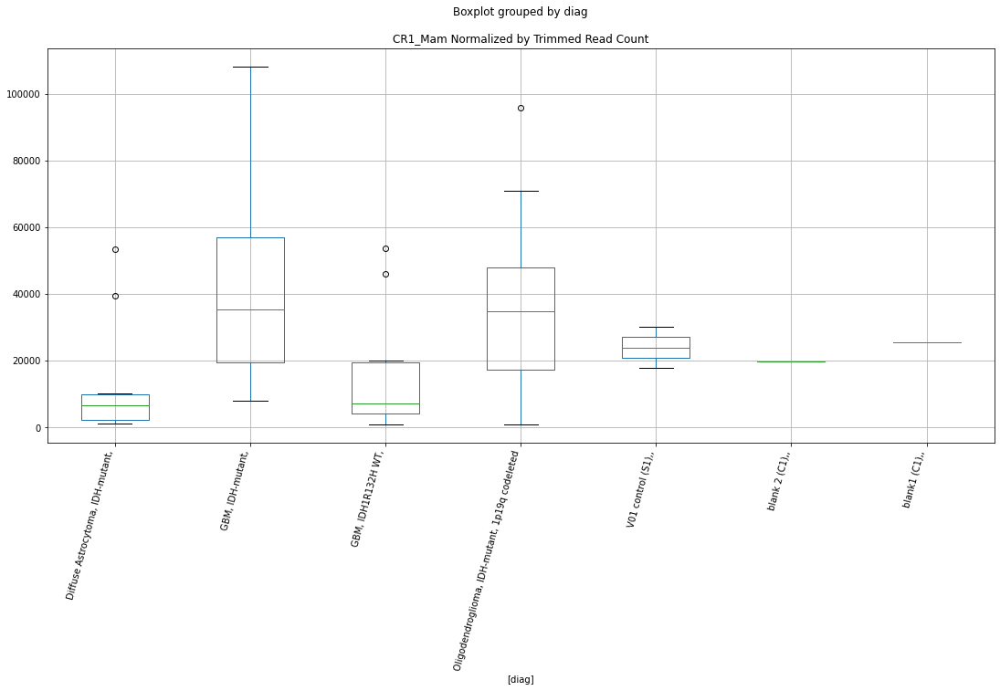

 p : 0.03428693212086413  ( t : 2.2904072418443637 ) :  D-plex  :  bbduk2  :  (GTG)n
Control and blanks
73     0.0
337    0.0
Name: (GTG)n, dtype: float64
205    3760.91
Name: (GTG)n, dtype: float64
469    2957.64
Name: (GTG)n, dtype: float64


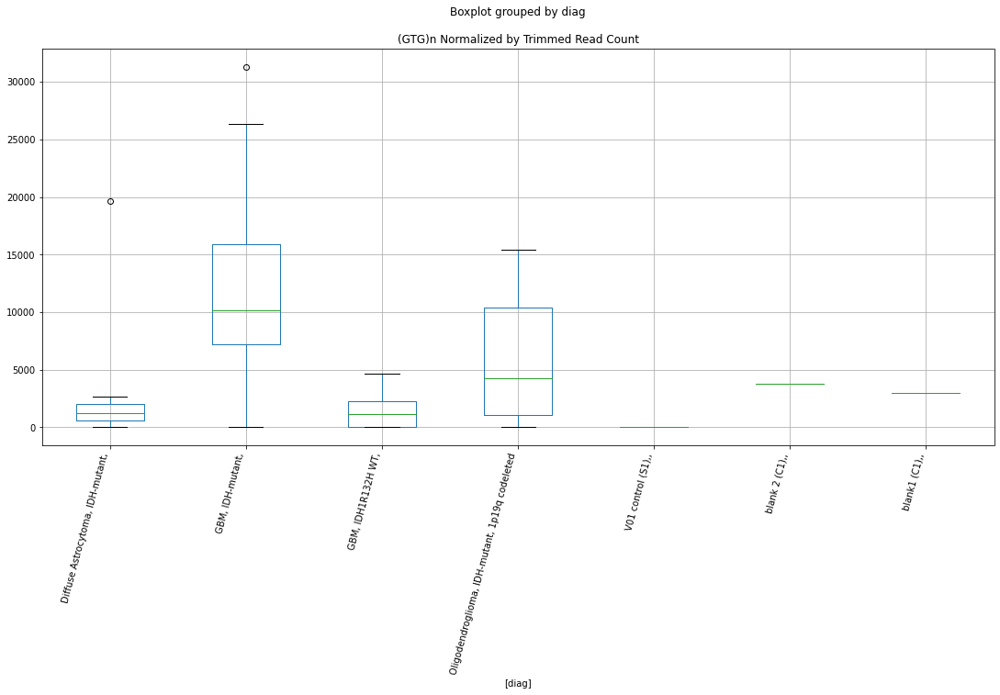

 p : 0.03429789689747168  ( t : 2.2902490305607803 ) :  D-plex  :  bbduk2  :  L1P4e
Control and blanks
73     4638.05
337       0.00
Name: L1P4e, dtype: float64
205    10566.37
Name: L1P4e, dtype: float64
469    8872.91
Name: L1P4e, dtype: float64


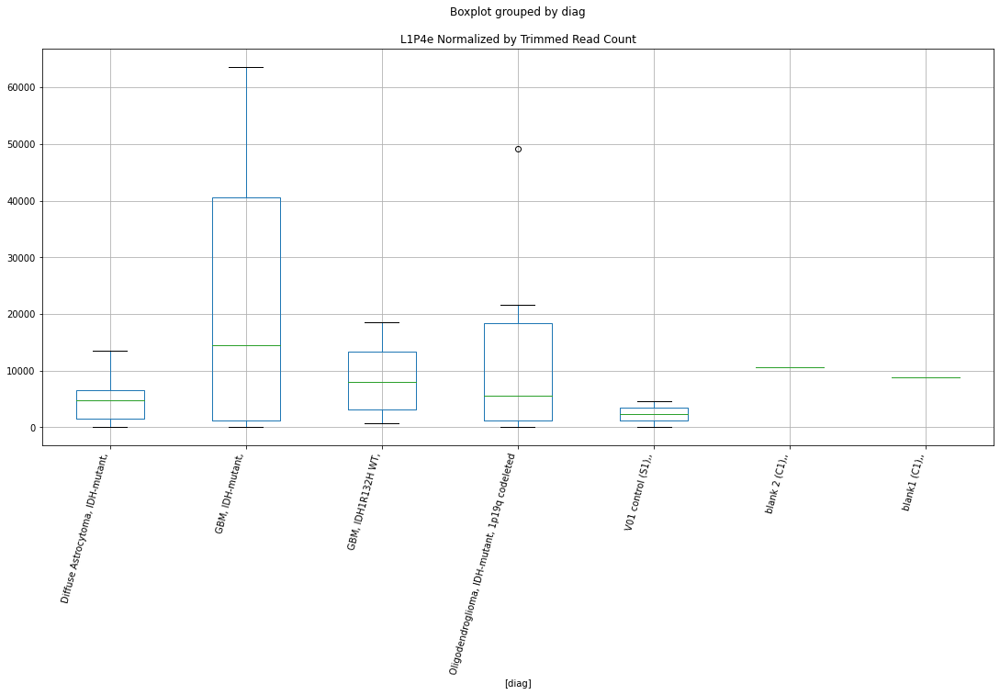

 p : 0.03434308949993059  ( t : 2.2895974384416613 ) :  D-plex  :  bbduk2  :  (ATGAA)n
Control and blanks
73         0.00
337    10681.89
Name: (ATGAA)n, dtype: float64
205    1790.91
Name: (ATGAA)n, dtype: float64
469    1774.58
Name: (ATGAA)n, dtype: float64


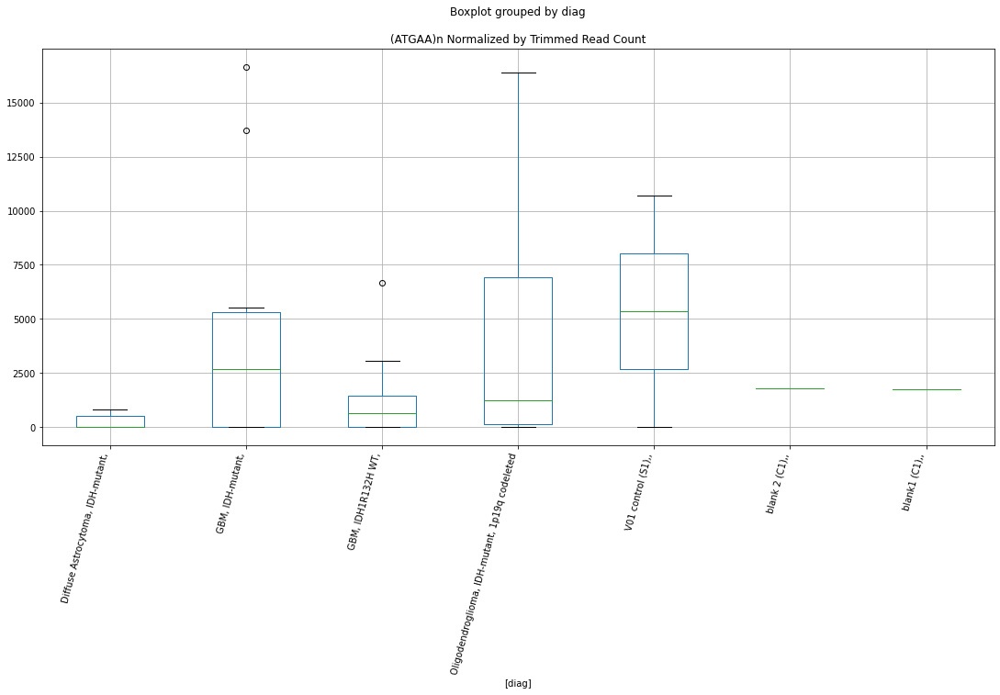

 p : 0.034411016253239744  ( t : 2.288619555117664 ) :  D-plex  :  cutadapt2  :  MamGypLTR2c
Control and blanks
76      2272.84
340    24660.50
Name: MamGypLTR2c, dtype: float64
208    15343.34
Name: MamGypLTR2c, dtype: float64
472    17338.68
Name: MamGypLTR2c, dtype: float64


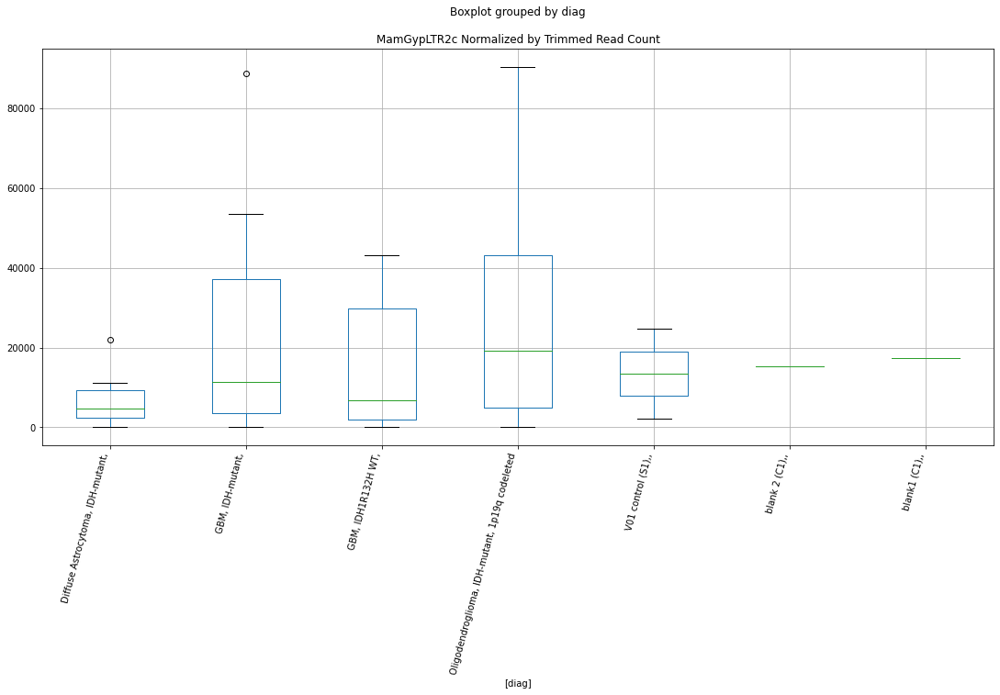

 p : 0.03445253192784856  ( t : 2.288022769354944 ) :  D-plex  :  cutadapt2  :  (TGT)n
Control and blanks
76     3030.46
340    1761.46
Name: (TGT)n, dtype: float64
208    3527.2
Name: (TGT)n, dtype: float64
472    4045.69
Name: (TGT)n, dtype: float64


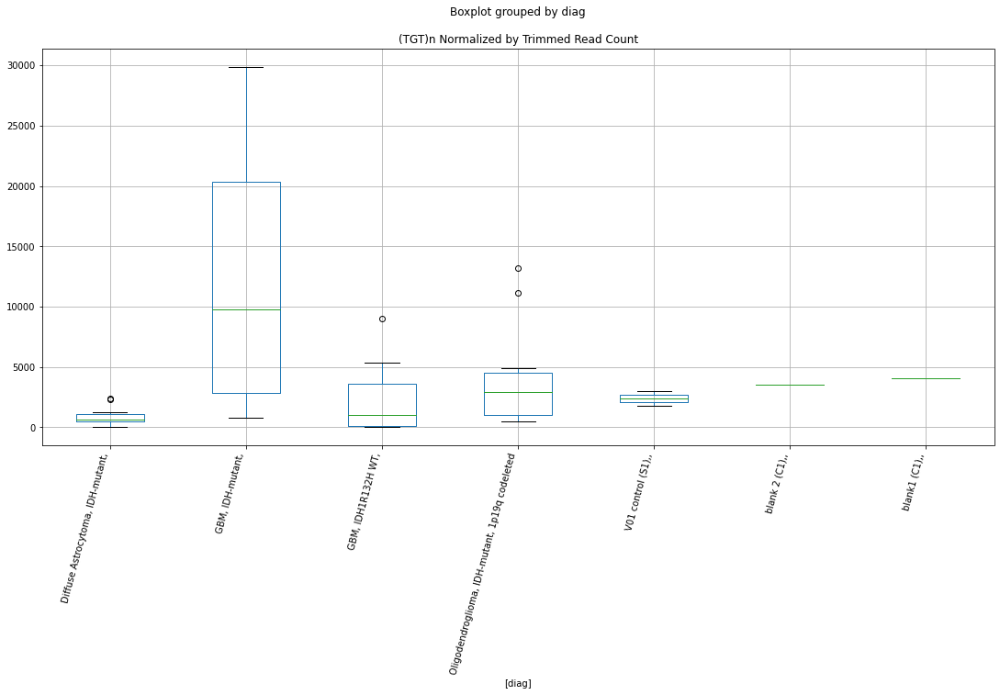

 p : 0.03455062732262771  ( t : 2.2866152945344034 ) :  D-plex  :  cutadapt2  :  LTR80B
Control and blanks
76     3788.07
340       0.00
Name: LTR80B, dtype: float64
208    8465.29
Name: LTR80B, dtype: float64
472    7513.43
Name: LTR80B, dtype: float64


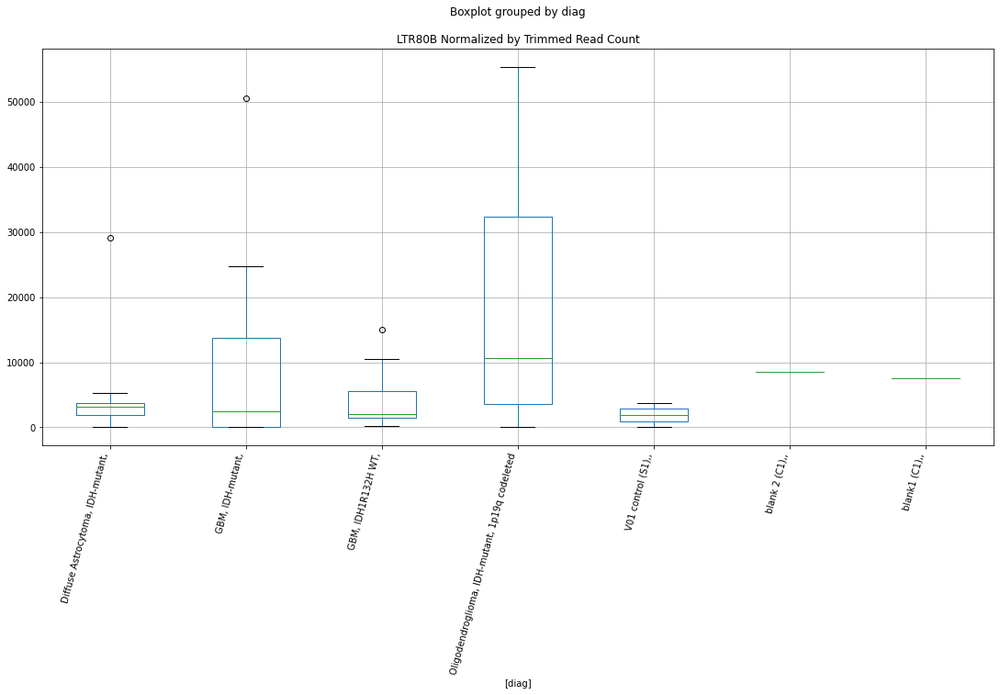

 p : 0.03458178121101674  ( t : 2.2861690720342582 ) :  D-plex  :  bbduk2  :  LTR16A2
Control and blanks
73     44834.49
337    10681.89
Name: LTR16A2, dtype: float64
205    44414.56
Name: LTR16A2, dtype: float64
469    26618.73
Name: LTR16A2, dtype: float64


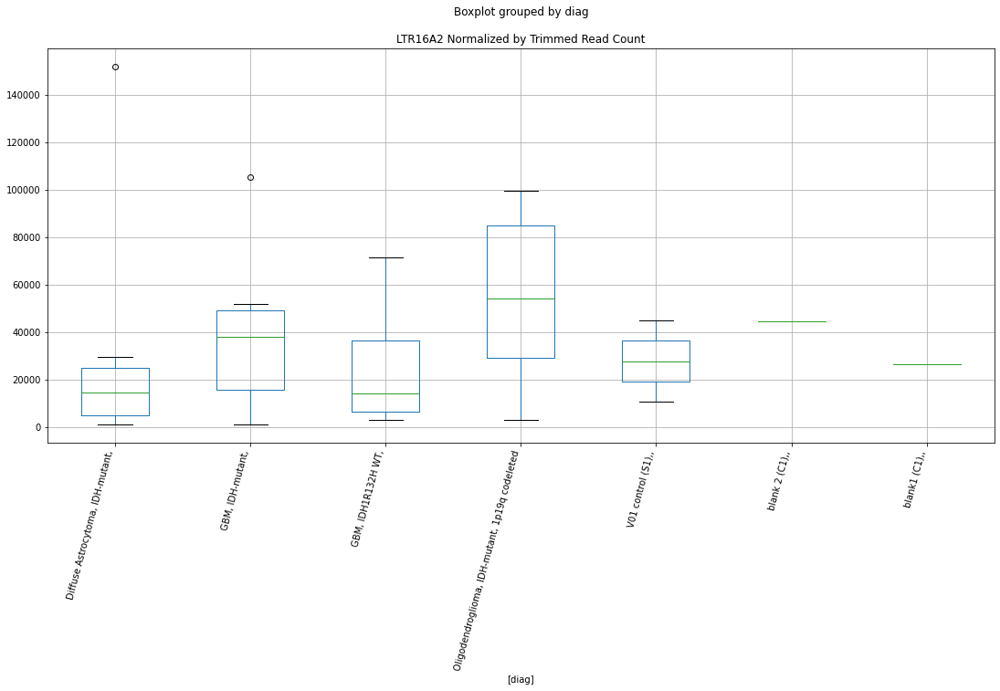

 p : 0.03464305029430919  ( t : 2.2852925891855884 ) :  D-plex  :  cutadapt2  :  MLT1N2
Control and blanks
76     97732.23
340    56366.86
Name: MLT1N2, dtype: float64
208    71425.89
Name: MLT1N2, dtype: float64
472    65309.01
Name: MLT1N2, dtype: float64


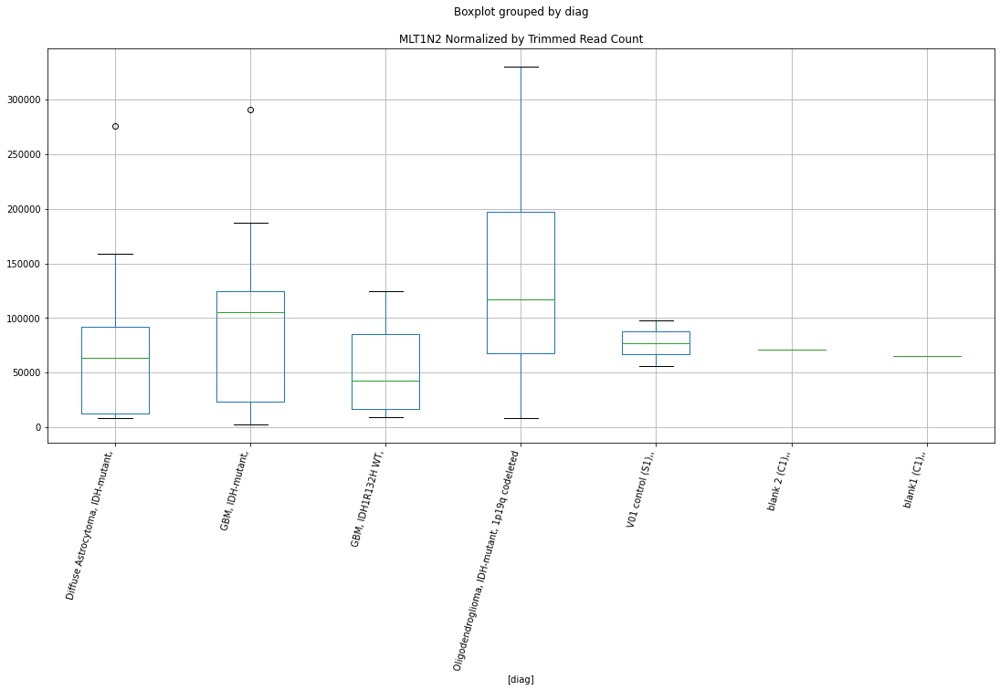

 p : 0.03465504988241665  ( t : 2.2851210975626923 ) :  D-plex  :  cutadapt2  :  (AAAT)n
Control and blanks
76      2272.84
340    36110.02
Name: (AAAT)n, dtype: float64
208    2292.68
Name: (AAAT)n, dtype: float64
472    0.0
Name: (AAAT)n, dtype: float64


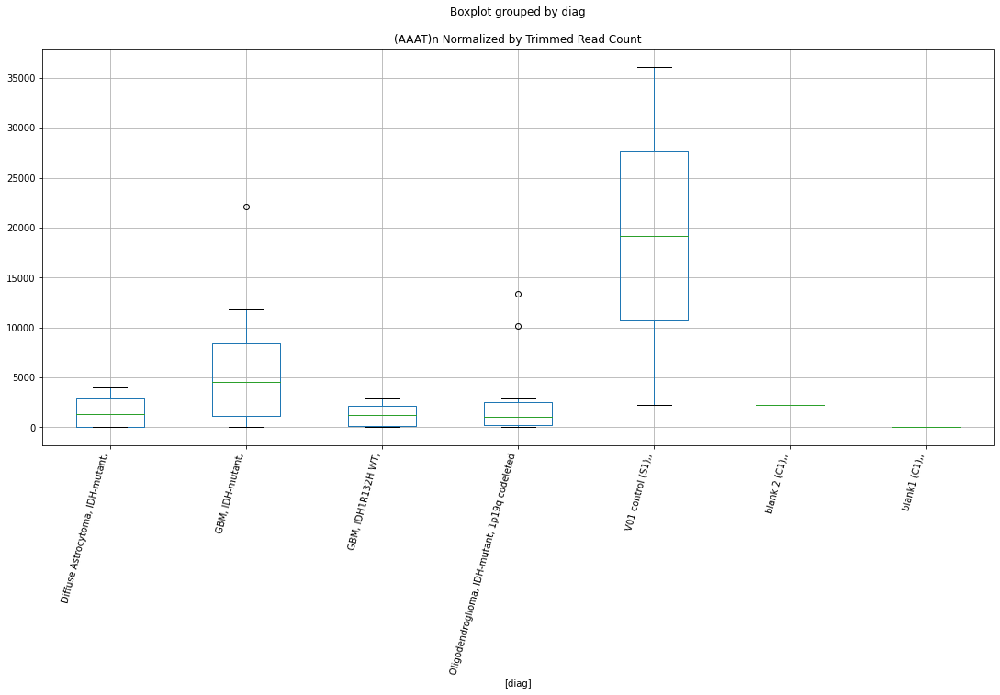

 p : 0.034678188509803434  ( t : 2.2847905679742664 ) :  D-plex  :  bbduk2  :  (GATGATTCCATTC)n
Control and blanks
73     0.0
337    0.0
Name: (GATGATTCCATTC)n, dtype: float64
205    0.0
Name: (GATGATTCCATTC)n, dtype: float64
469    591.53
Name: (GATGATTCCATTC)n, dtype: float64


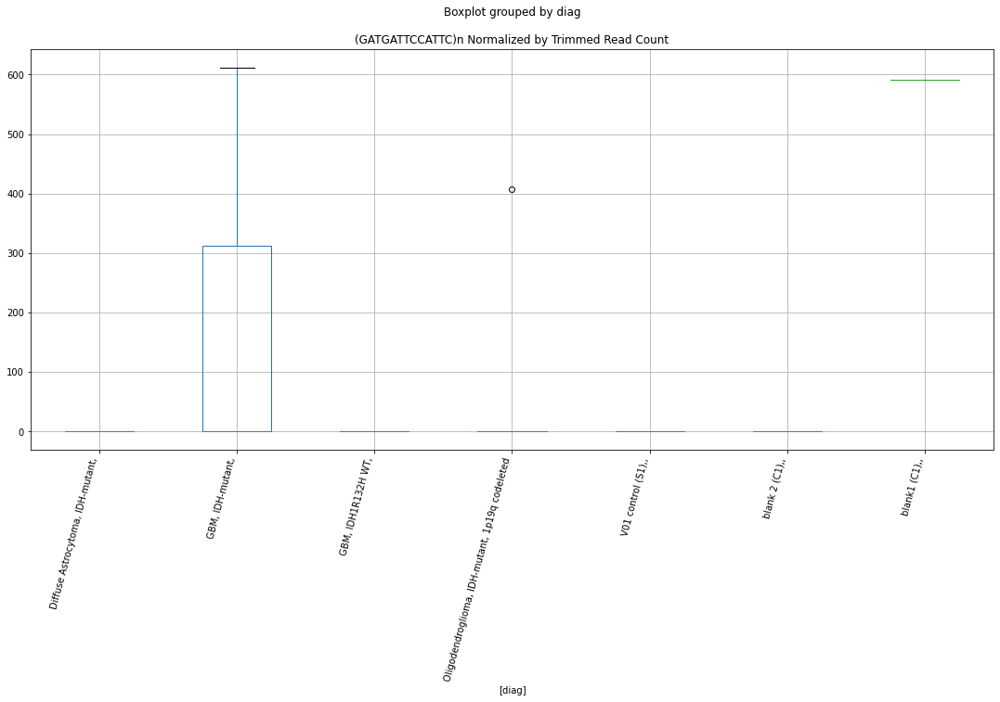

 p : 0.03469425478783147  ( t : 2.2845611852394705 ) :  D-plex  :  cutadapt2  :  CR1_Mam
Control and blanks
76     17425.13
340    29944.89
Name: CR1_Mam, dtype: float64
208    21692.31
Name: CR1_Mam, dtype: float64
472    26585.97
Name: CR1_Mam, dtype: float64


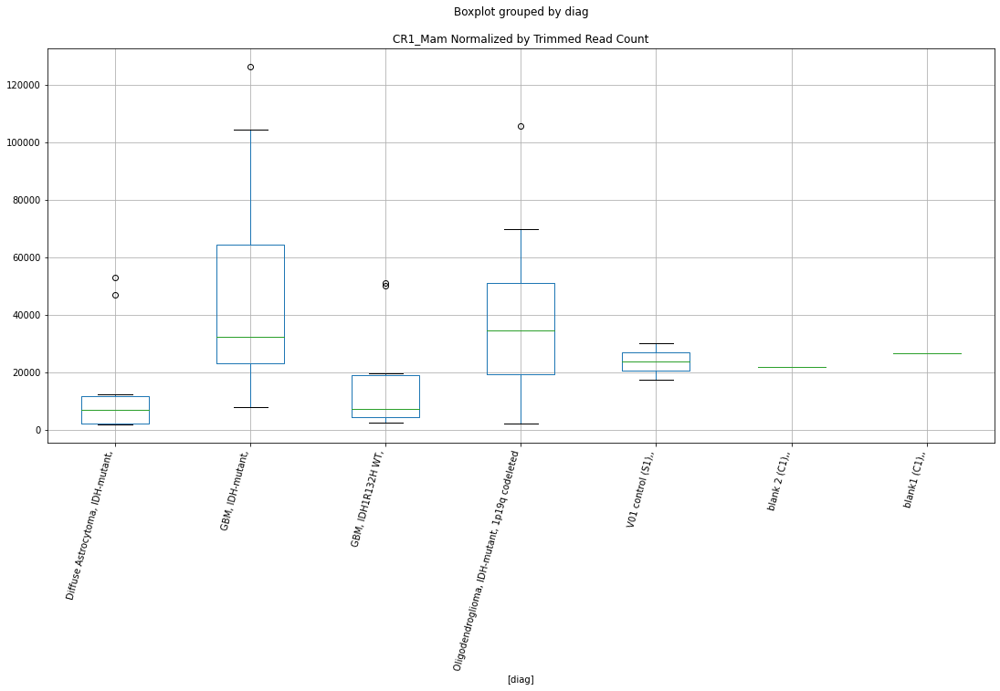

 p : 0.03478135277618999  ( t : 2.2833193719363187 ) :  D-plex  :  cutadapt2  :  MER61A
Control and blanks
76     757.61
340    880.73
Name: MER61A, dtype: float64
208    9523.45
Name: MER61A, dtype: float64
472    8091.38
Name: MER61A, dtype: float64


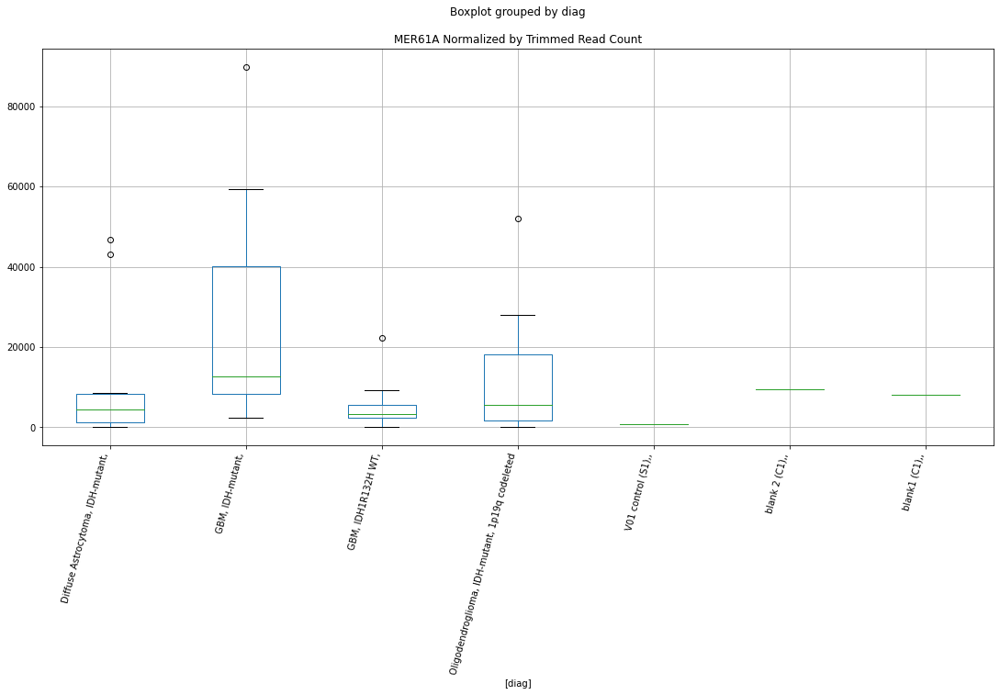

 p : 0.03484866908915287  ( t : 2.282361569634855 ) :  D-plex  :  cutadapt2  :  L1P4e
Control and blanks
76     4545.69
340       0.00
Name: L1P4e, dtype: float64
208    10405.25
Name: L1P4e, dtype: float64
472    8669.34
Name: L1P4e, dtype: float64


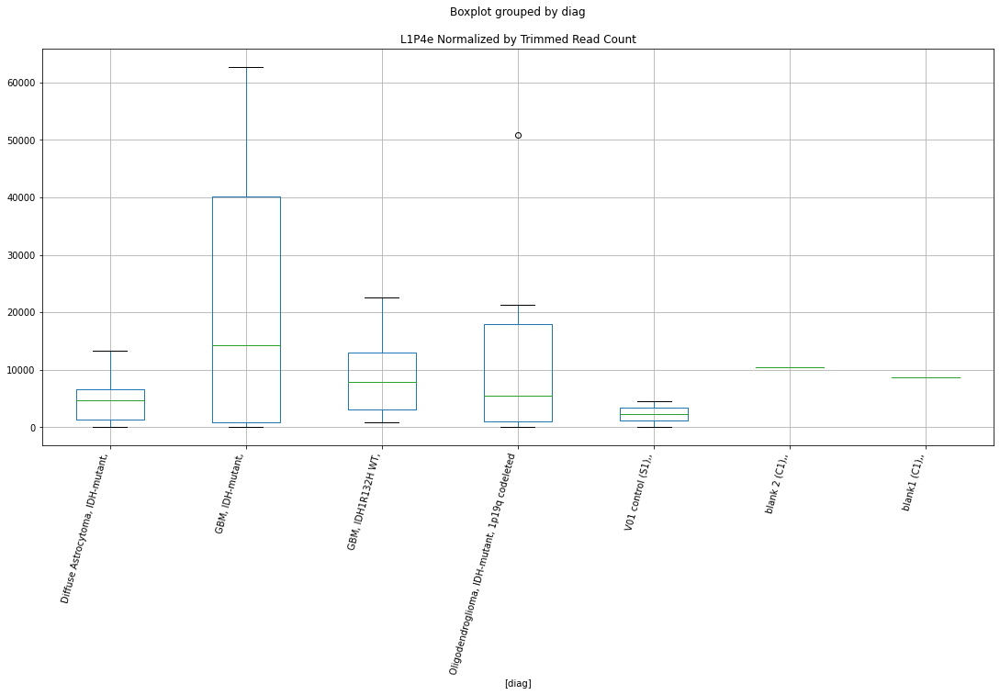

 p : 0.03486445028454545  ( t : 2.2821372765561305 ) :  D-plex  :  bbduk2  :  MLT1E2-int
Control and blanks
73     0.0
337    0.0
Name: MLT1E2-int, dtype: float64
205    6268.18
Name: MLT1E2-int, dtype: float64
469    6506.8
Name: MLT1E2-int, dtype: float64


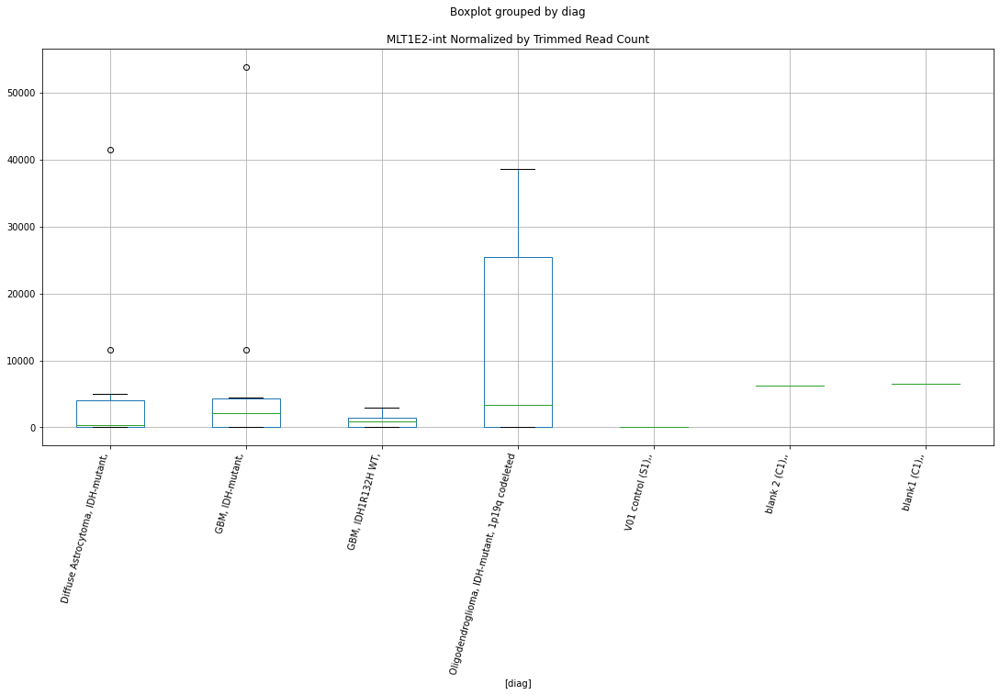

 p : 0.034882092091708915  ( t : 2.2818866504140933 ) :  D-plex  :  cutadapt2  :  (GAAGAA)n
Control and blanks
76     0.0
340    0.0
Name: (GAAGAA)n, dtype: float64
208    352.72
Name: (GAAGAA)n, dtype: float64
472    577.96
Name: (GAAGAA)n, dtype: float64


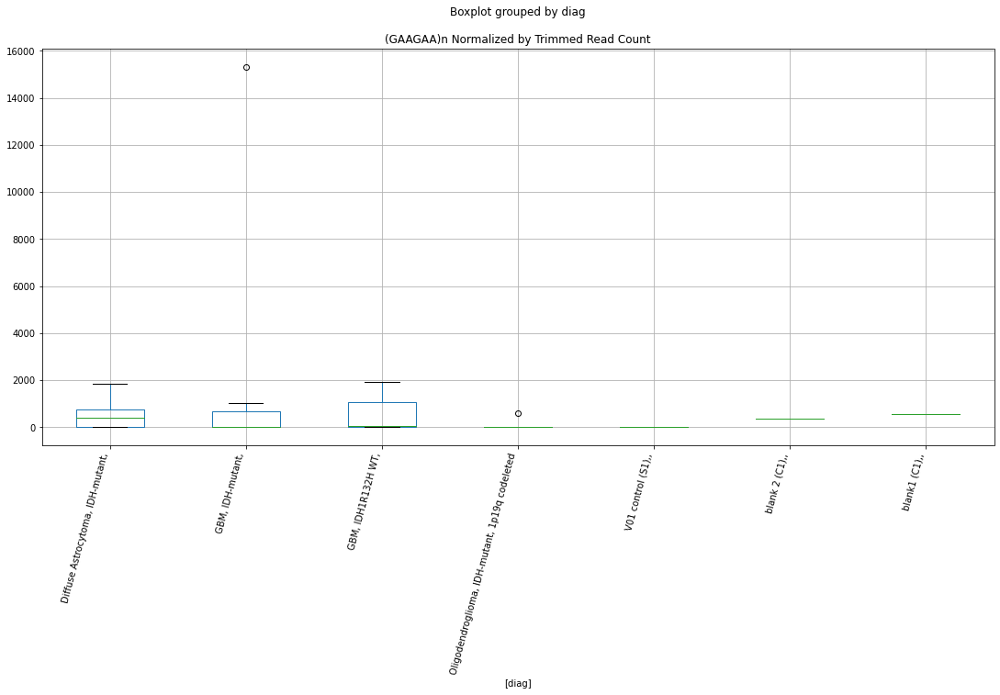

 p : 0.03501058368543676  ( t : 2.280064781412309 ) :  D-plex  :  cutadapt2  :  L1PBa
Control and blanks
76     136370.56
340    461503.64
Name: L1PBa, dtype: float64
208    226446.52
Name: L1PBa, dtype: float64
472    220779.13
Name: L1PBa, dtype: float64


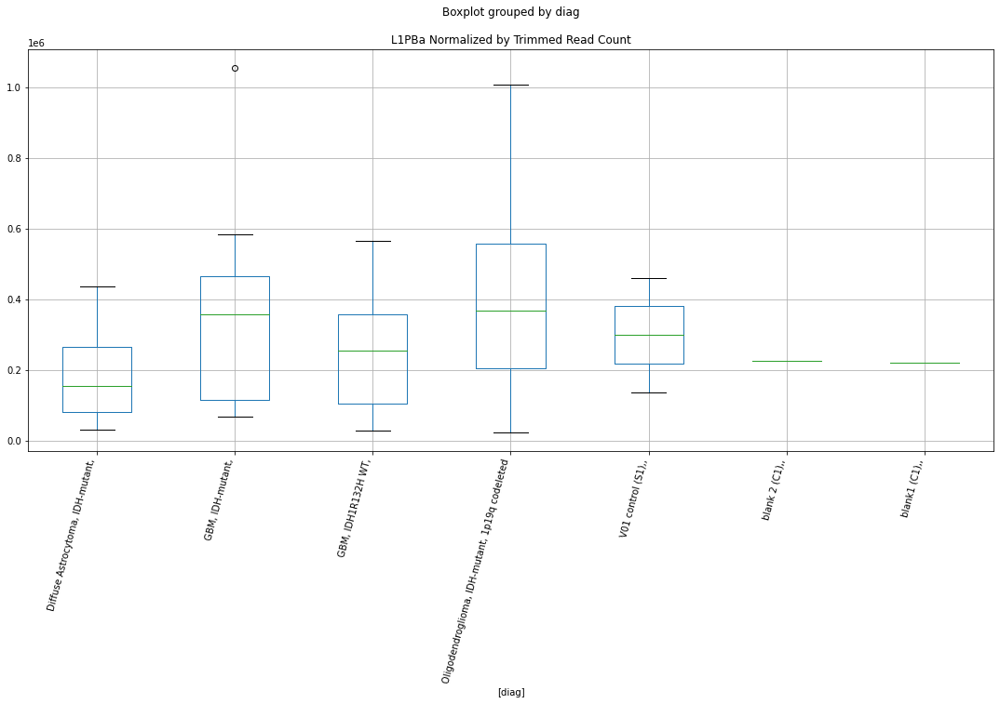

 p : 0.03501703502729757  ( t : 2.2799734717382827 ) :  D-plex  :  cutadapt2  :  LTR14C
Control and blanks
76     0.0
340    0.0
Name: LTR14C, dtype: float64
208    2645.4
Name: LTR14C, dtype: float64
472    577.96
Name: LTR14C, dtype: float64


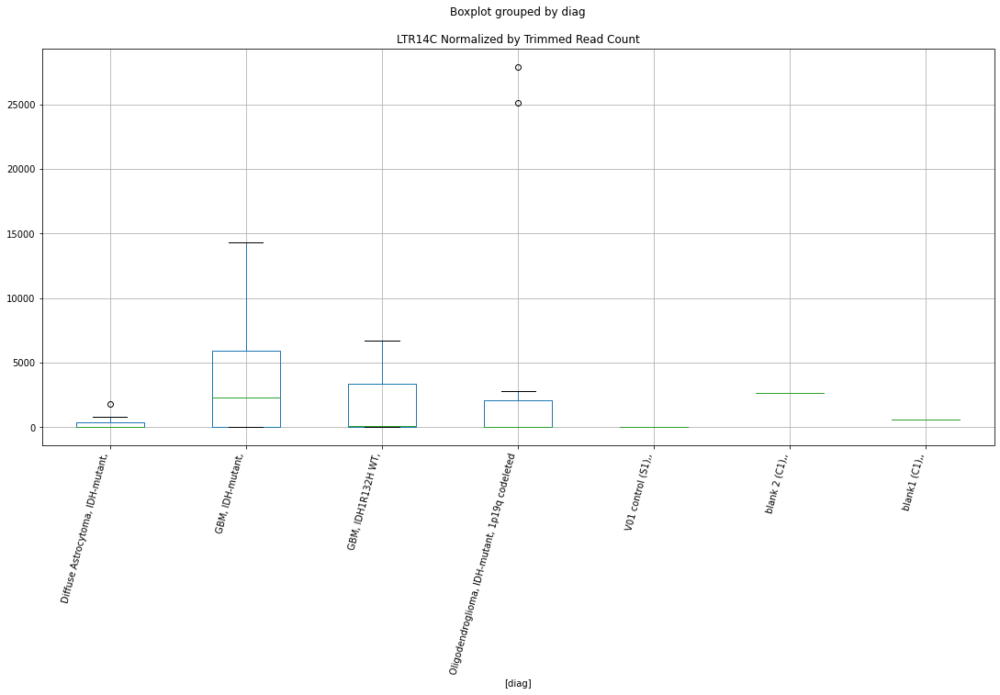

 p : 0.03513701877394115  ( t : 2.2782781013841302 ) :  D-plex  :  bbduk2  :  LTR14C
Control and blanks
73     0.0
337    0.0
Name: LTR14C, dtype: float64
205    2507.27
Name: LTR14C, dtype: float64
469    591.53
Name: LTR14C, dtype: float64


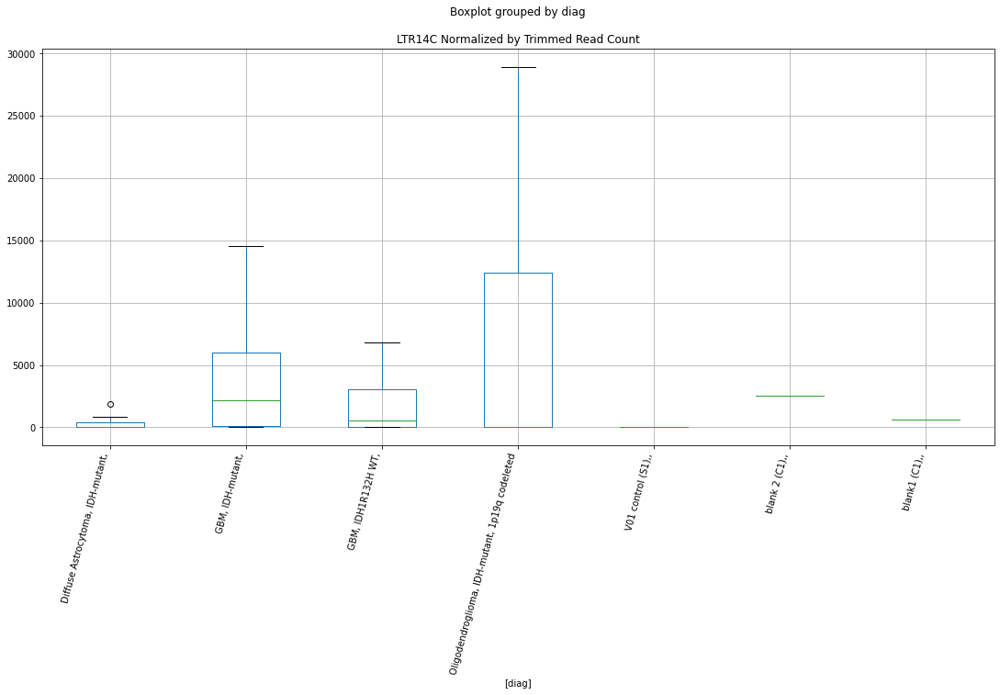

 p : 0.035357704373251586  ( t : 2.2751737526068796 ) :  D-plex  :  cutadapt2  :  (TTAT)n
Control and blanks
76       757.61
340    36990.75
Name: (TTAT)n, dtype: float64
208    3527.2
Name: (TTAT)n, dtype: float64
472    6357.51
Name: (TTAT)n, dtype: float64


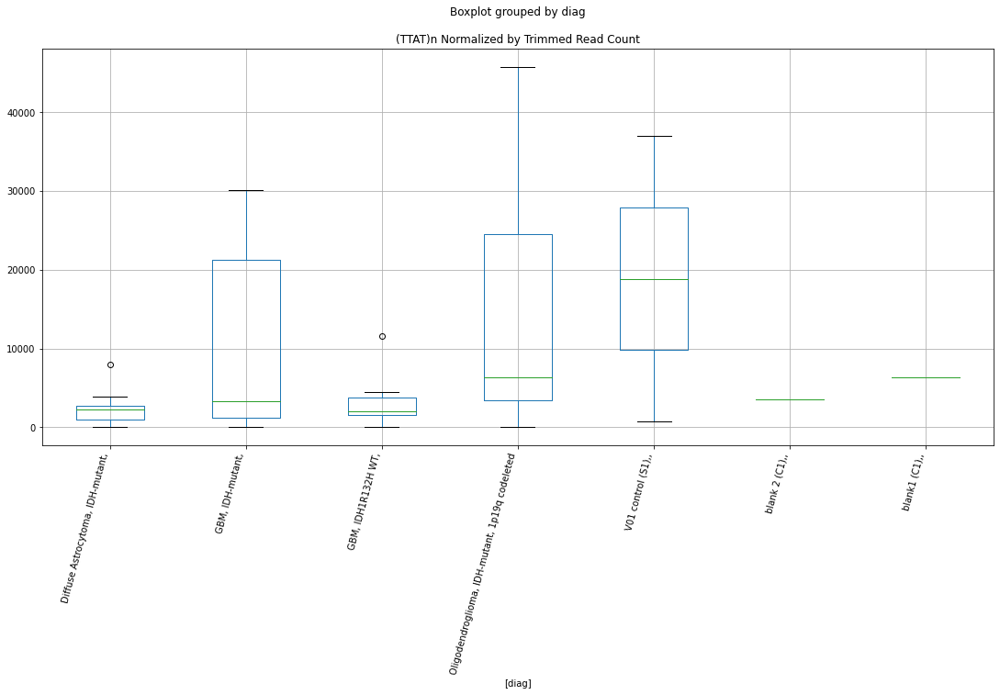

 p : 0.03536416241532097  ( t : 2.275083178581832 ) :  D-plex  :  cutadapt2  :  LTR2B
Control and blanks
76     757.61
340      0.00
Name: LTR2B, dtype: float64
208    4761.73
Name: LTR2B, dtype: float64
472    6357.51
Name: LTR2B, dtype: float64


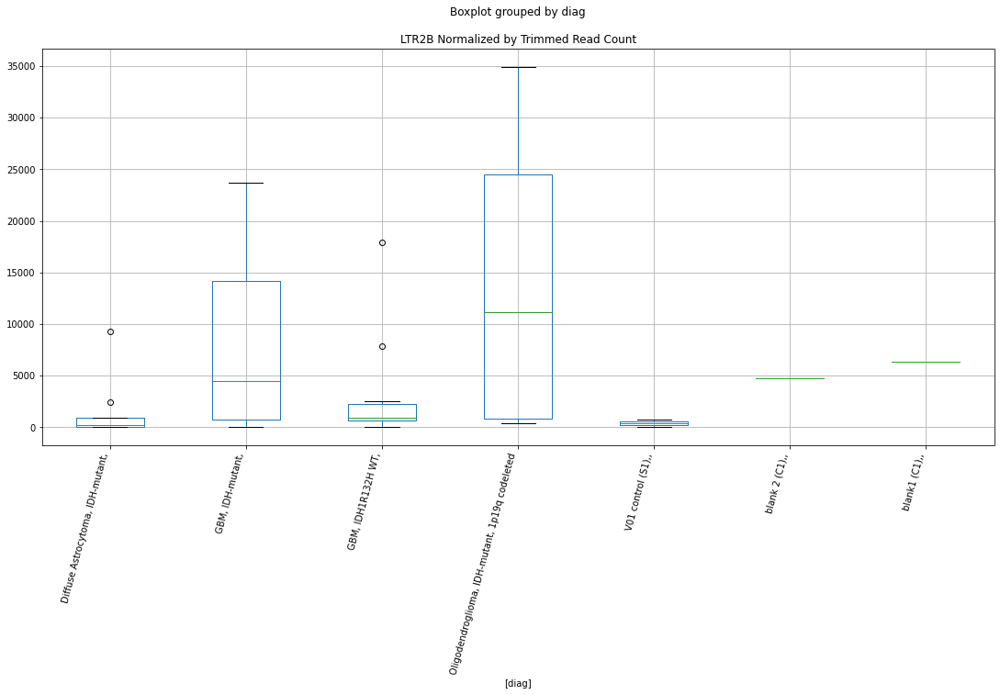

 p : 0.035401164128742404  ( t : 2.2745645244029227 ) :  Lexogen  :  bbduk2  :  L2
Control and blanks
79        0.00
343    9766.46
Name: L2, dtype: float64
211    0.0
Name: L2, dtype: float64
475    0.0
Name: L2, dtype: float64


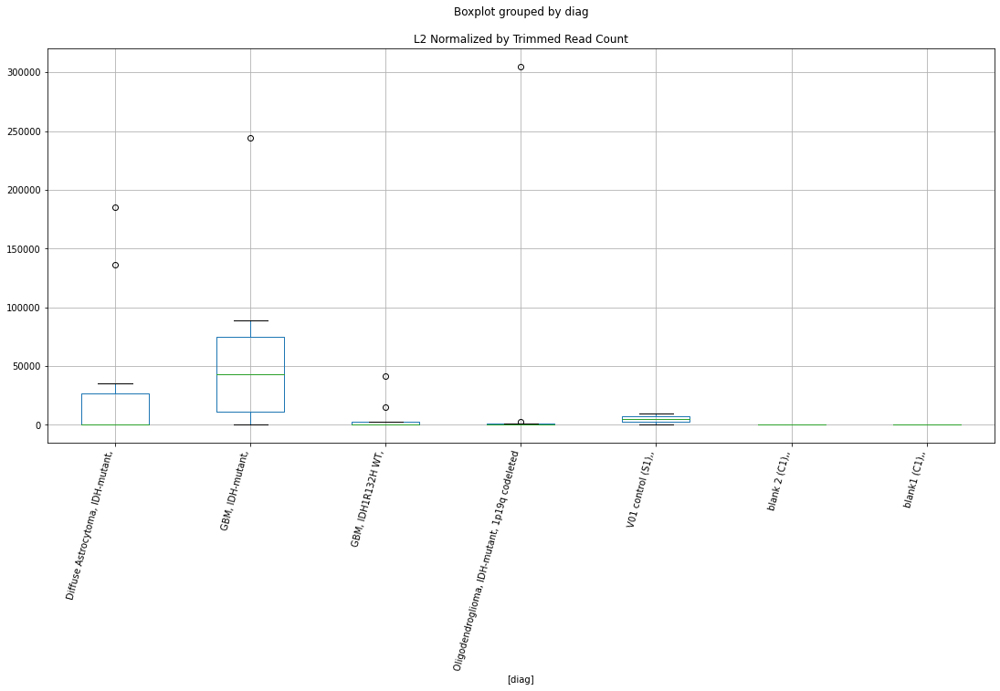

 p : 0.03542173702413126  ( t : 2.2742763703417954 ) :  D-plex  :  bbduk2  :  LTR32
Control and blanks
73      3865.04
337    36496.45
Name: LTR32, dtype: float64
205    17371.82
Name: LTR32, dtype: float64
469    26027.2
Name: LTR32, dtype: float64


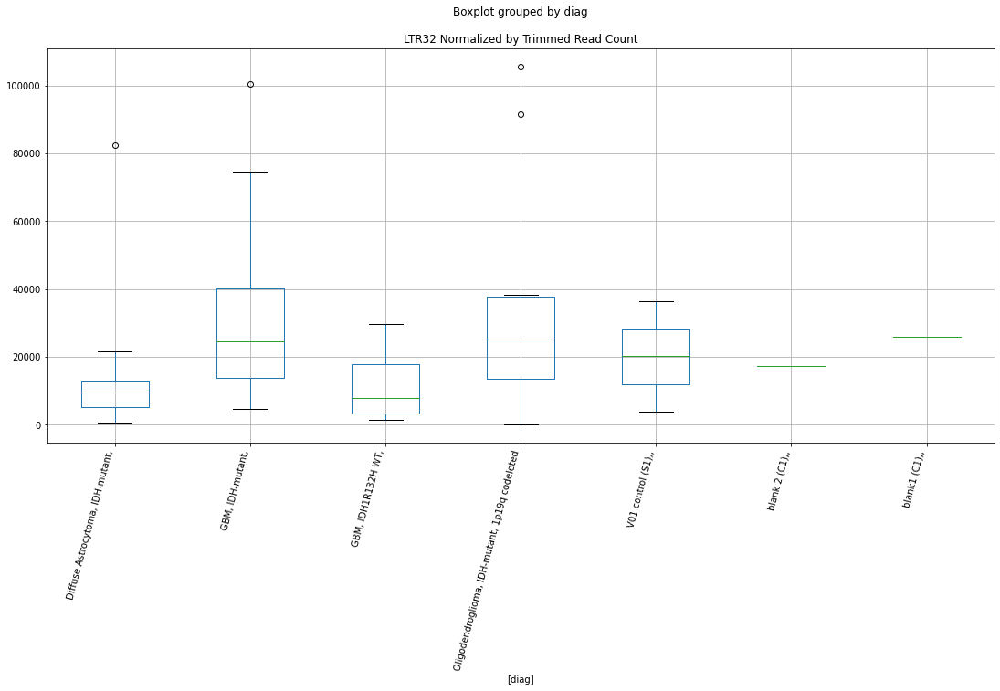

 p : 0.035677105217363135  ( t : 2.2707123850725446 ) :  D-plex  :  cutadapt2  :  LTR10F
Control and blanks
76     0.0
340    0.0
Name: LTR10F, dtype: float64
208    10405.25
Name: LTR10F, dtype: float64
472    13292.98
Name: LTR10F, dtype: float64


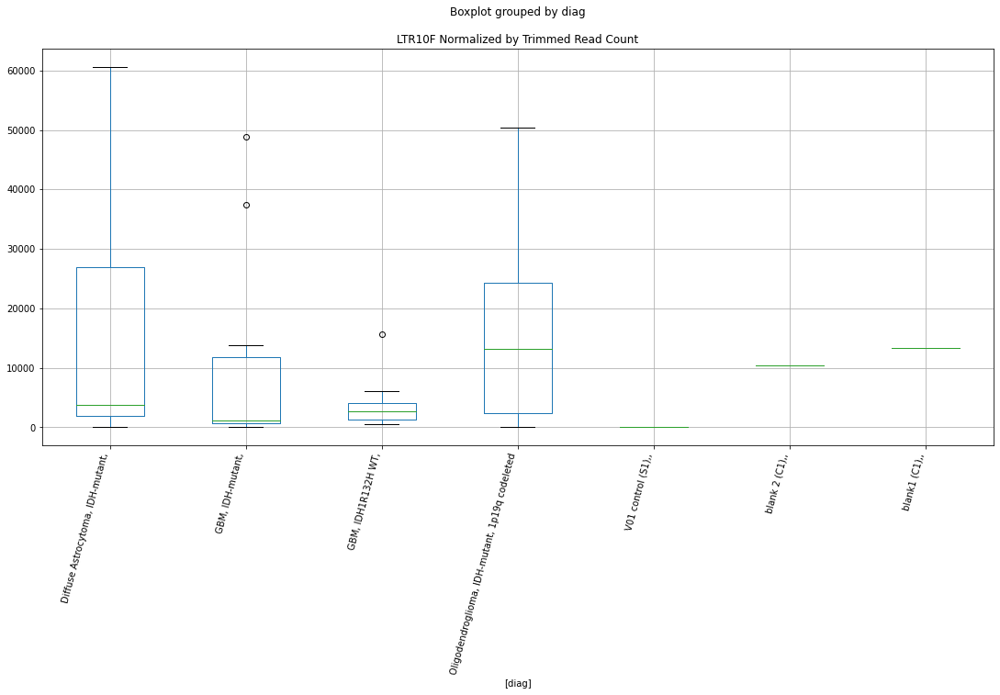

 p : 0.03578950068530801  ( t : 2.269151234909294 ) :  D-plex  :  cutadapt2  :  LTR48
Control and blanks
76      3788.07
340    23779.77
Name: LTR48, dtype: float64
208    22221.39
Name: LTR48, dtype: float64
472    23696.19
Name: LTR48, dtype: float64


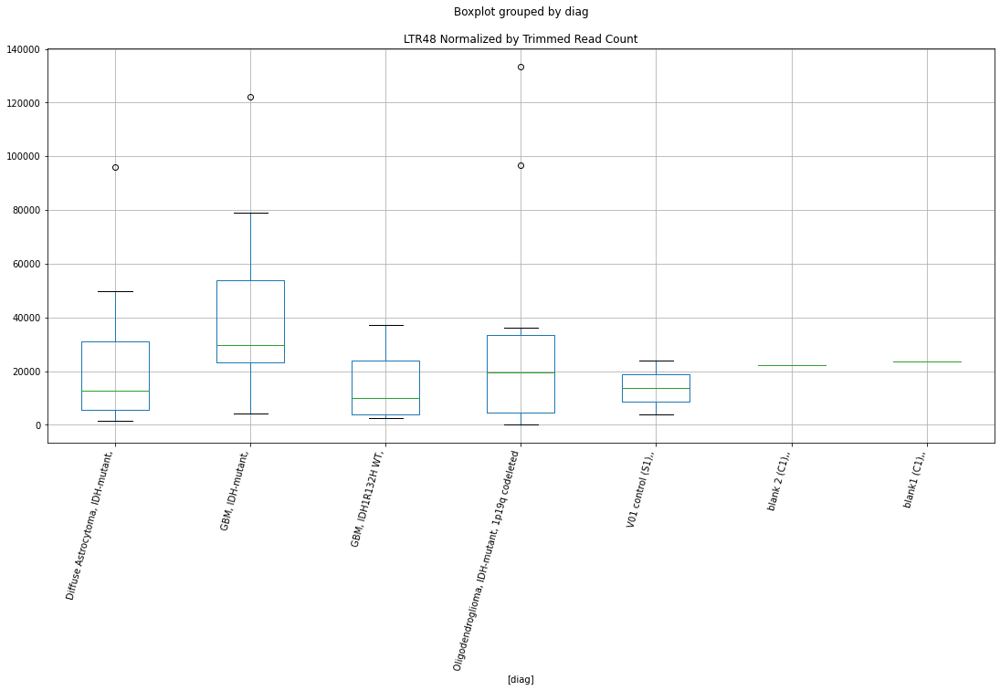

 p : 0.03595006200712887  ( t : 2.266928914837251 ) :  D-plex  :  cutadapt2  :  (GAAA)n
Control and blanks
76      3788.07
340    30825.62
Name: (GAAA)n, dtype: float64
208    11992.49
Name: (GAAA)n, dtype: float64
472    12137.07
Name: (GAAA)n, dtype: float64


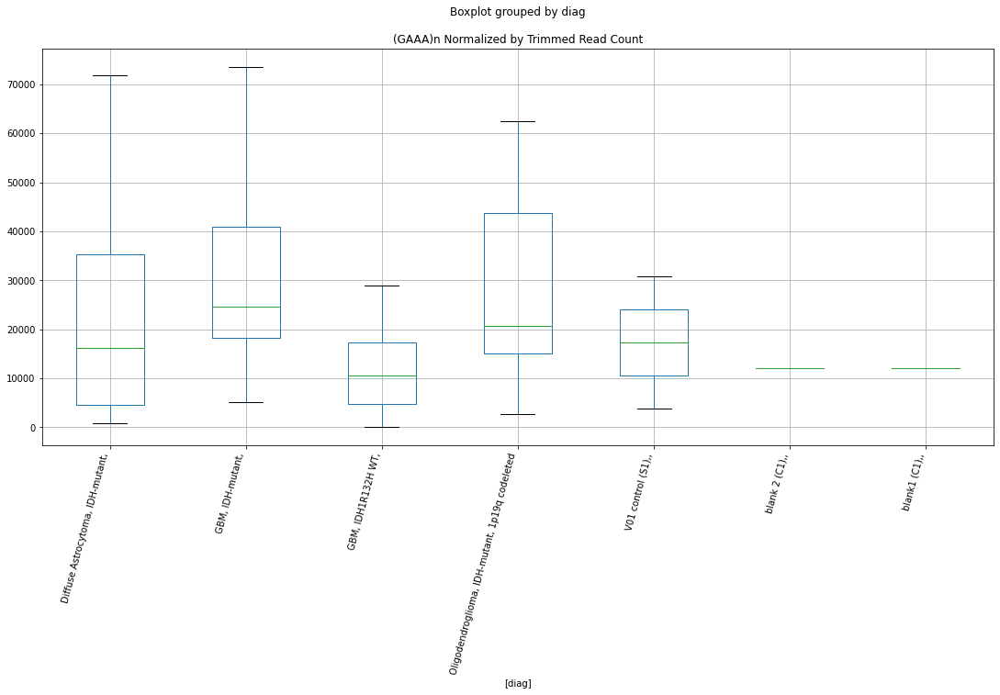

 p : 0.03596725854154976  ( t : 2.266691442792504 ) :  D-plex  :  bbduk2  :  LFSINE_Vert
Control and blanks
73      1546.02
337    11572.04
Name: LFSINE_Vert, dtype: float64
205    16655.46
Name: LFSINE_Vert, dtype: float64
469    15971.24
Name: LFSINE_Vert, dtype: float64


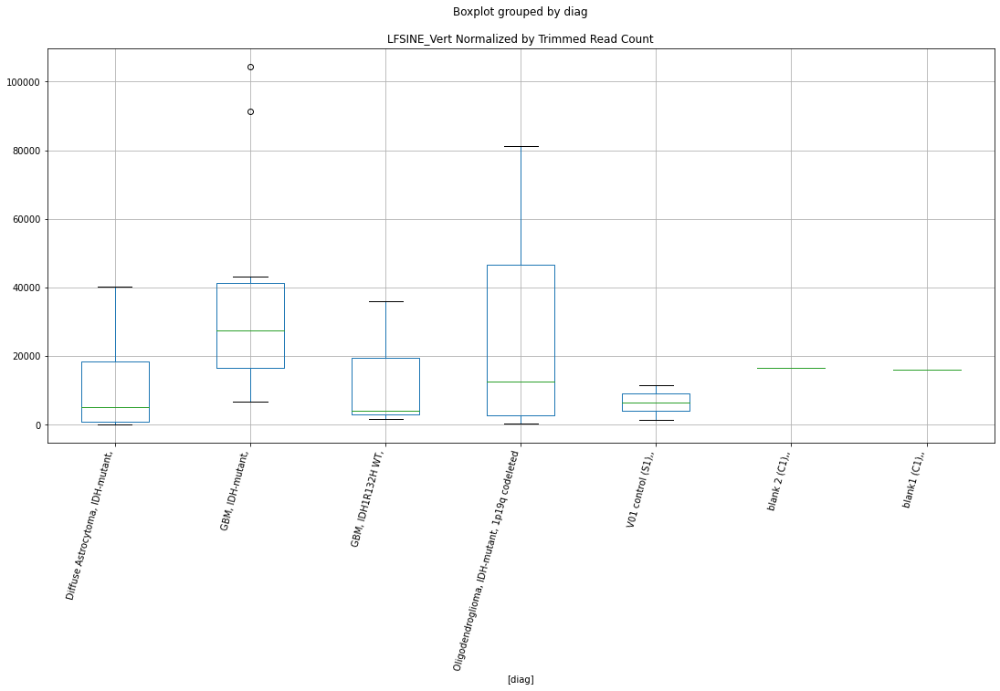

 p : 0.035993951873718864  ( t : 2.2663230344457284 ) :  D-plex  :  cutadapt2  :  MER63C
Control and blanks
76      3030.46
340    63412.71
Name: MER63C, dtype: float64
208    17636.02
Name: MER63C, dtype: float64
472    23696.19
Name: MER63C, dtype: float64


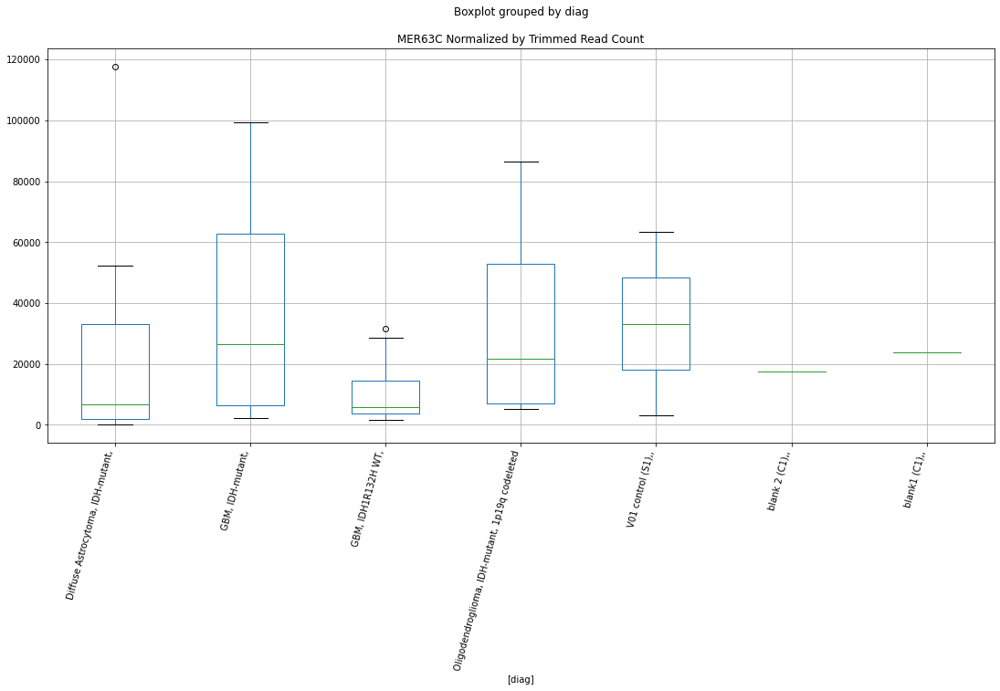

 p : 0.03611088843493648  ( t : 2.2647121033102504 ) :  Lexogen  :  cutadapt2  :  L1P1
Control and blanks
82     0.0
346    0.0
Name: L1P1, dtype: float64
214    0.0
Name: L1P1, dtype: float64
478    0.0
Name: L1P1, dtype: float64


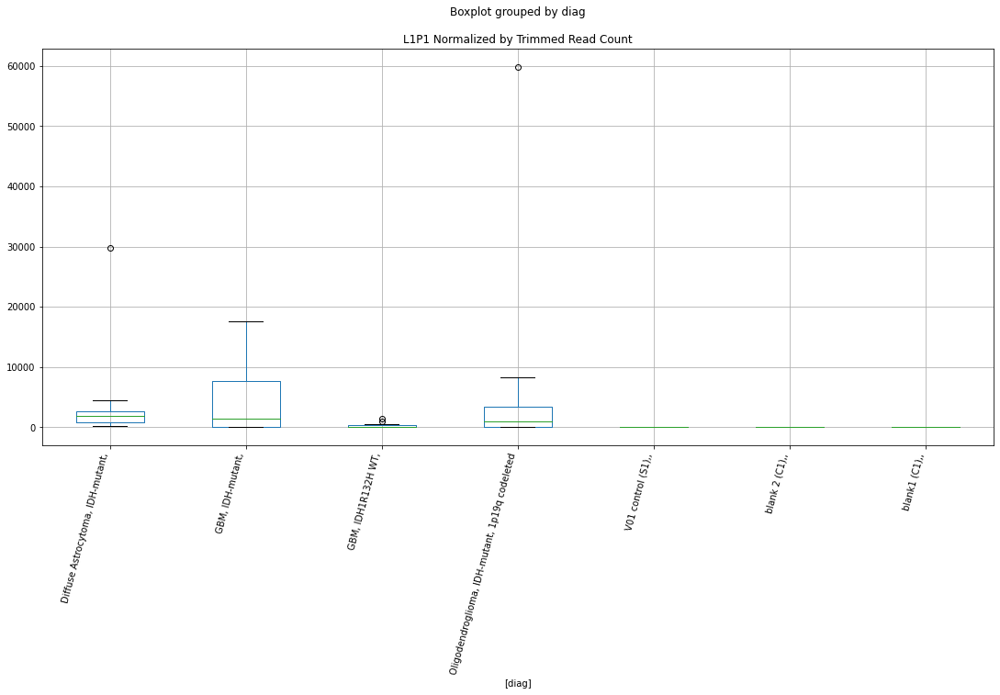

 p : 0.03612201685767153  ( t : 2.2645590482390894 ) :  D-plex  :  bbduk2  :  LTR22C0
Control and blanks
73     773.01
337      0.00
Name: LTR22C0, dtype: float64
205    4119.09
Name: LTR22C0, dtype: float64
469    1183.05
Name: LTR22C0, dtype: float64


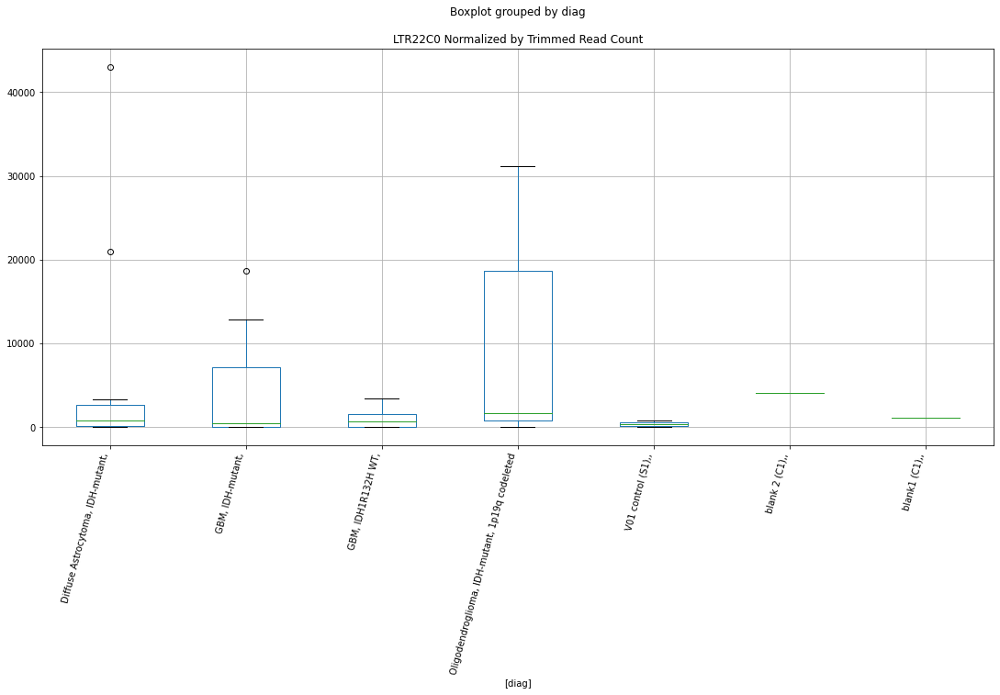

 p : 0.03613916188415775  ( t : 2.264323328899881 ) :  D-plex  :  cutadapt2  :  MER49
Control and blanks
76     27274.11
340      880.73
Name: MER49, dtype: float64
208    27159.47
Name: MER49, dtype: float64
472    20806.41
Name: MER49, dtype: float64


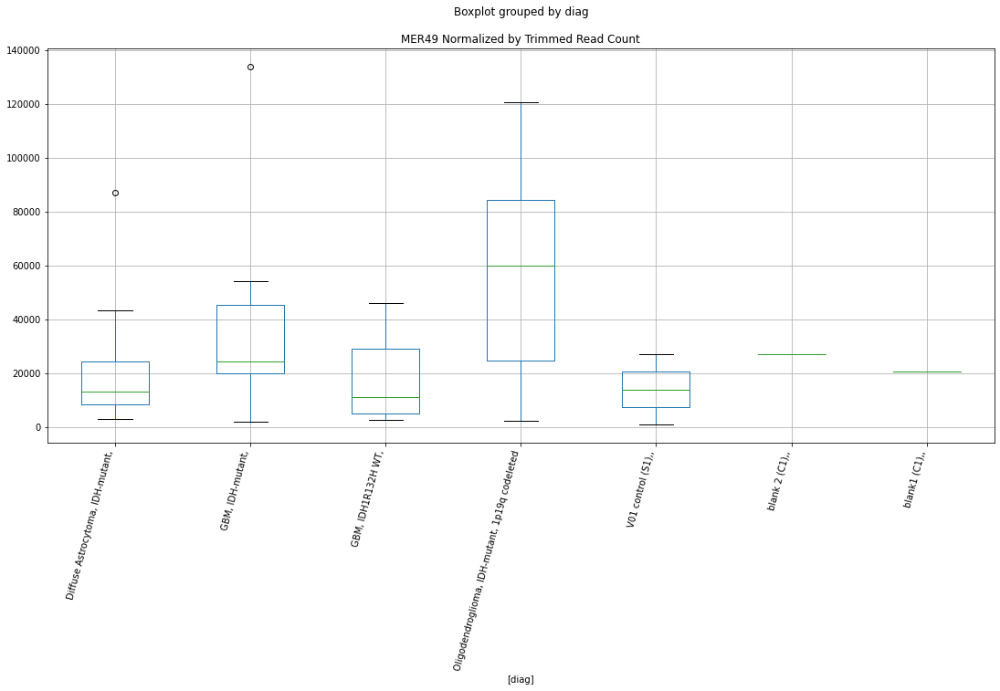

 p : 0.03620364637048545  ( t : 2.263437684651249 ) :  D-plex  :  bbduk2  :  (TCCAC)n
Control and blanks
73     1546.02
337    4450.79
Name: (TCCAC)n, dtype: float64
205    7342.73
Name: (TCCAC)n, dtype: float64
469    5323.75
Name: (TCCAC)n, dtype: float64


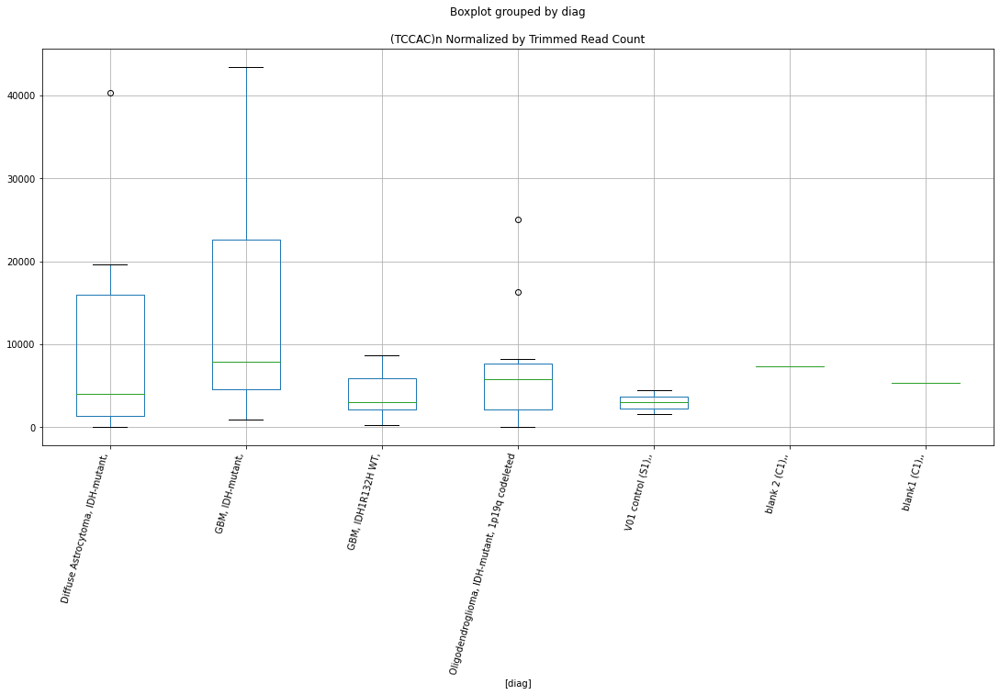

 p : 0.036229457471076705  ( t : 2.263083597695083 ) :  D-plex  :  bbduk2  :  MER52D
Control and blanks
73     12368.13
337    24034.25
Name: MER52D, dtype: float64
205    26863.64
Name: MER52D, dtype: float64
469    23069.57
Name: MER52D, dtype: float64


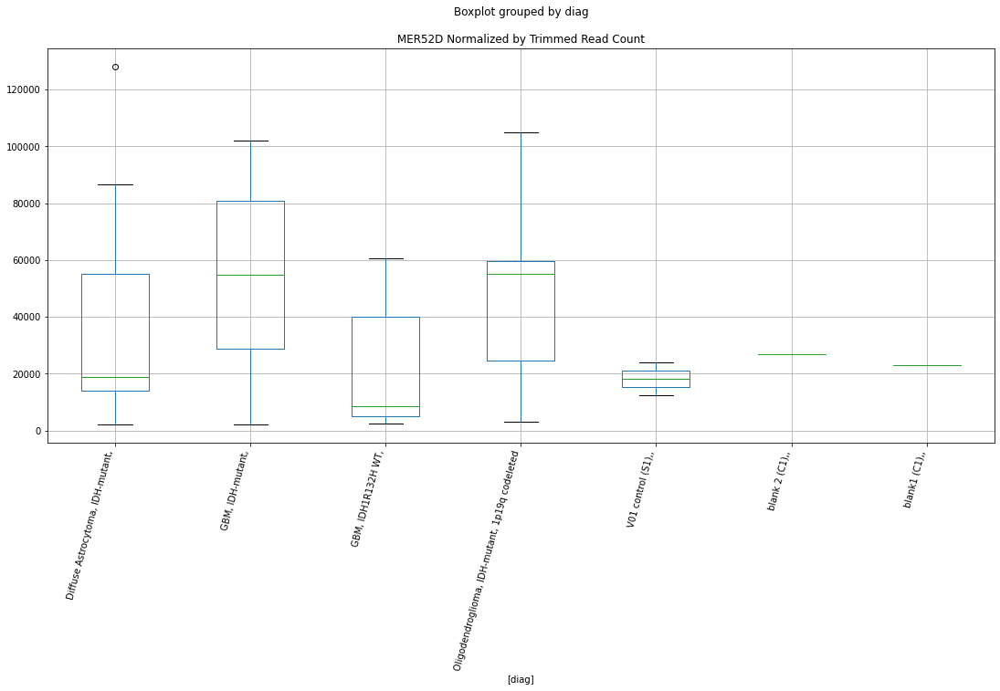

 p : 0.036231573917714935  ( t : 2.2630545737781254 ) :  D-plex  :  cutadapt2  :  (TCTC)n
Control and blanks
76     480327.41
340    452696.32
Name: (TCTC)n, dtype: float64
208    241613.5
Name: (TCTC)n, dtype: float64
472    241007.59
Name: (TCTC)n, dtype: float64


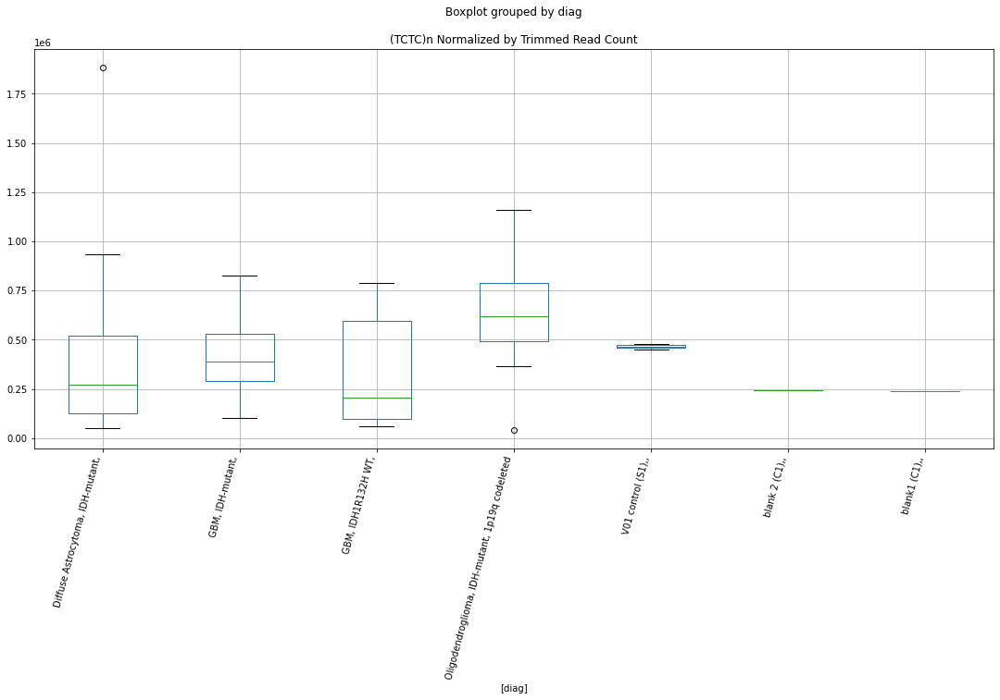

 p : 0.03628011917768591  ( t : 2.262389277433958 ) :  D-plex  :  cutadapt2  :  LTR35
Control and blanks
76     0.0
340    0.0
Name: LTR35, dtype: float64
208    2645.4
Name: LTR35, dtype: float64
472    6357.51
Name: LTR35, dtype: float64


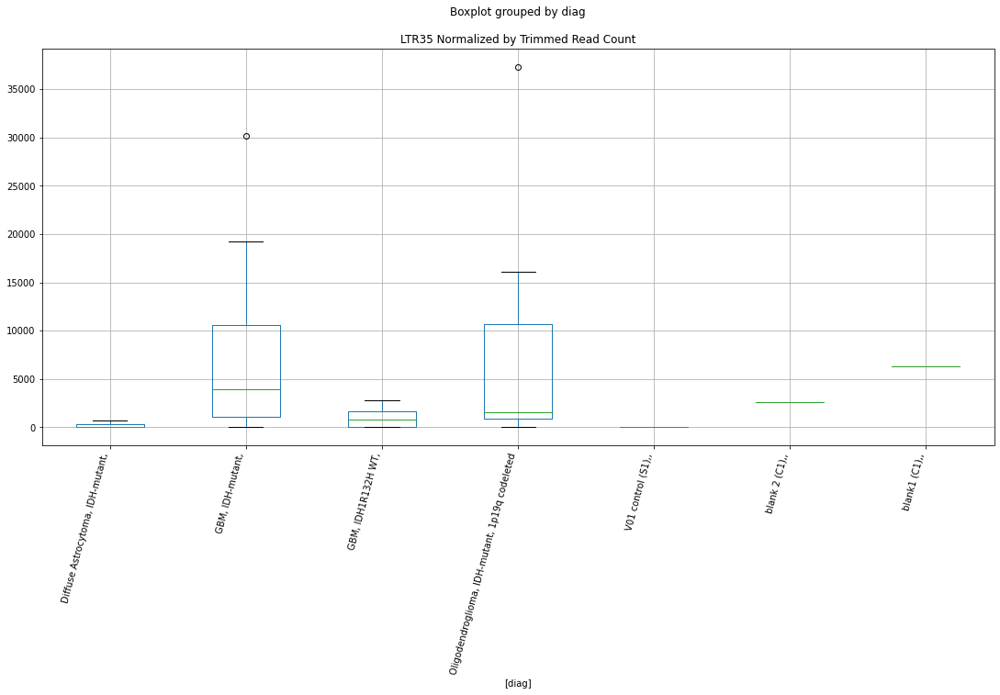

 p : 0.03630271966083794  ( t : 2.262079826013327 ) :  D-plex  :  bbduk2  :  L1ME3Cz
Control and blanks
73      60294.66
337    489586.50
Name: L1ME3Cz, dtype: float64
205    250369.15
Name: L1ME3Cz, dtype: float64
469    242526.2
Name: L1ME3Cz, dtype: float64


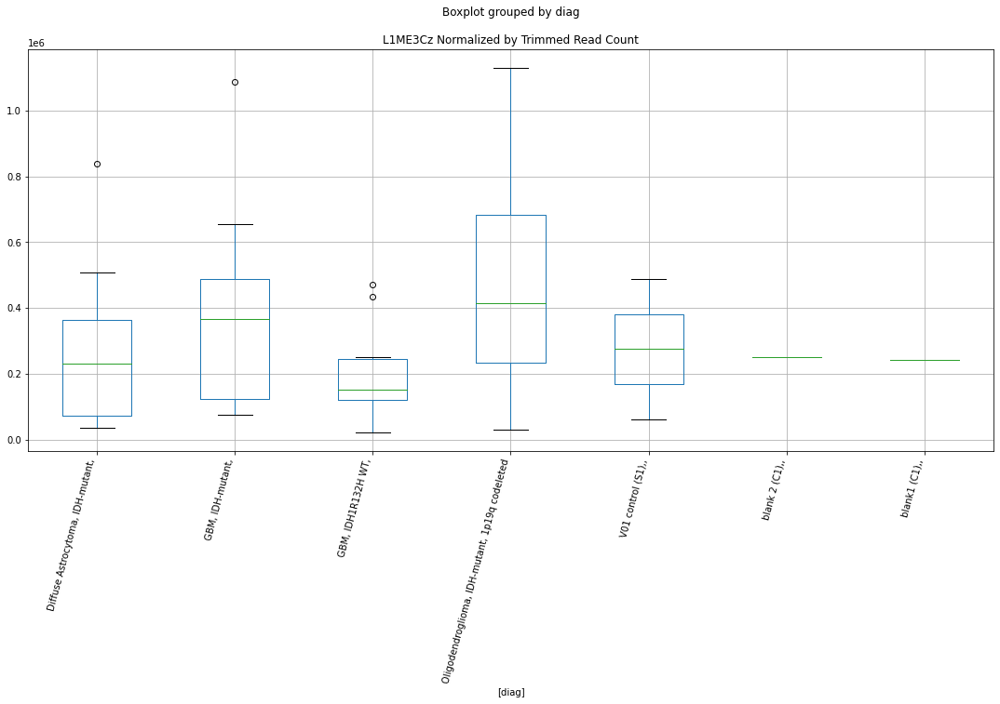

 p : 0.03630804719616719  ( t : 2.262006906002267 ) :  D-plex  :  bbduk2  :  (AATTA)n
Control and blanks
73     0.0
337    0.0
Name: (AATTA)n, dtype: float64
205    716.36
Name: (AATTA)n, dtype: float64
469    1183.05
Name: (AATTA)n, dtype: float64


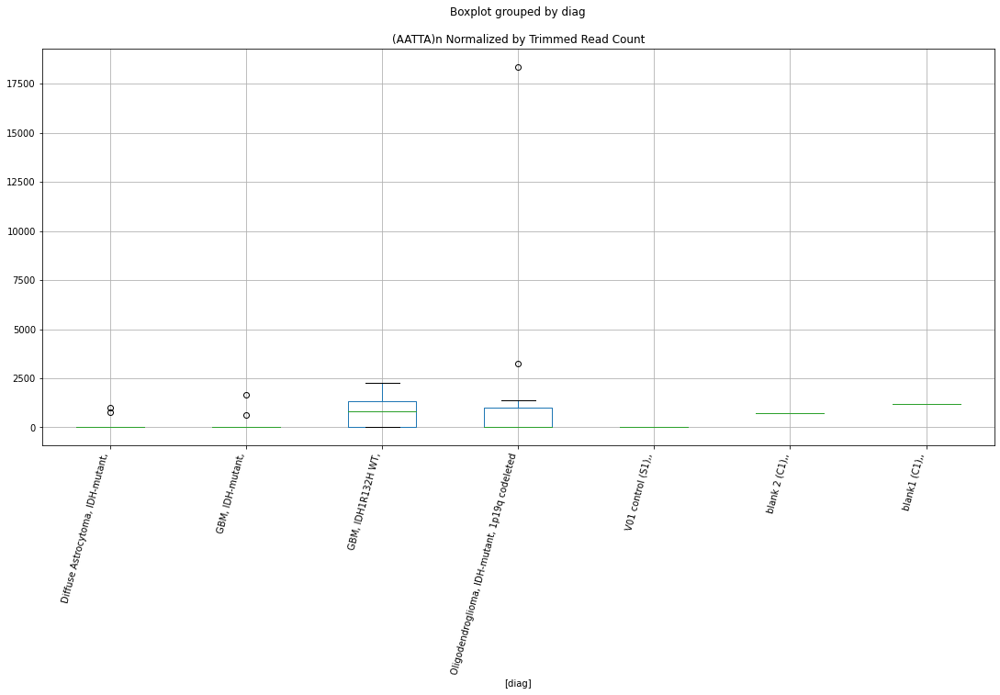

 p : 0.03642357953879552  ( t : 2.26042799728142 ) :  D-plex  :  cutadapt2  :  MER52D
Control and blanks
76     15152.28
340    24660.50
Name: MER52D, dtype: float64
208    25748.59
Name: MER52D, dtype: float64
472    22540.28
Name: MER52D, dtype: float64


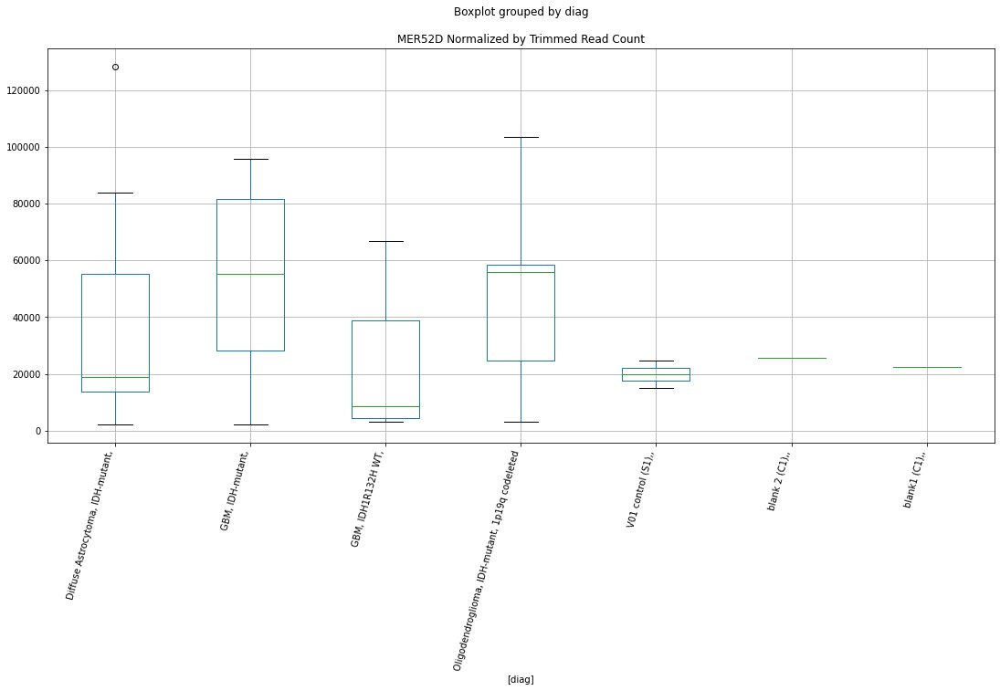

 p : 0.03642611802669171  ( t : 2.2603933573158717 ) :  D-plex  :  bbduk2  :  (TTCCA)n
Control and blanks
73     76527.83
337    81894.47
Name: (TTCCA)n, dtype: float64
205    75934.56
Name: (TTCCA)n, dtype: float64
469    72166.33
Name: (TTCCA)n, dtype: float64


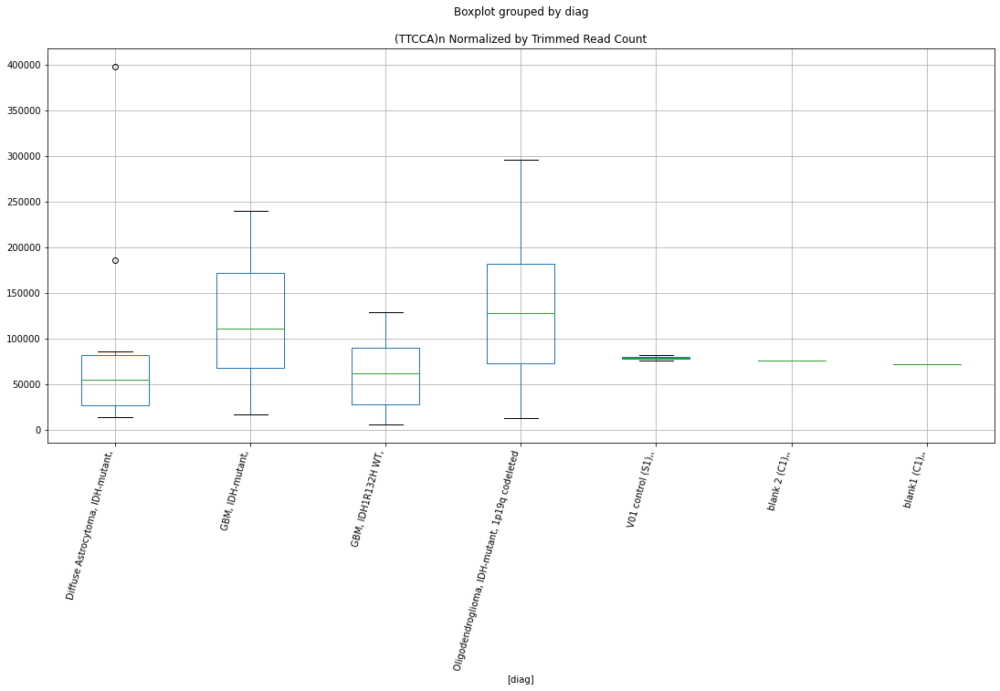

 p : 0.036531283299190156  ( t : 2.258960238087663 ) :  Lexogen  :  bbduk2  :  L1PA8
Control and blanks
79         0.00
343    22080.69
Name: L1PA8, dtype: float64
211    0.0
Name: L1PA8, dtype: float64
475    0.0
Name: L1PA8, dtype: float64


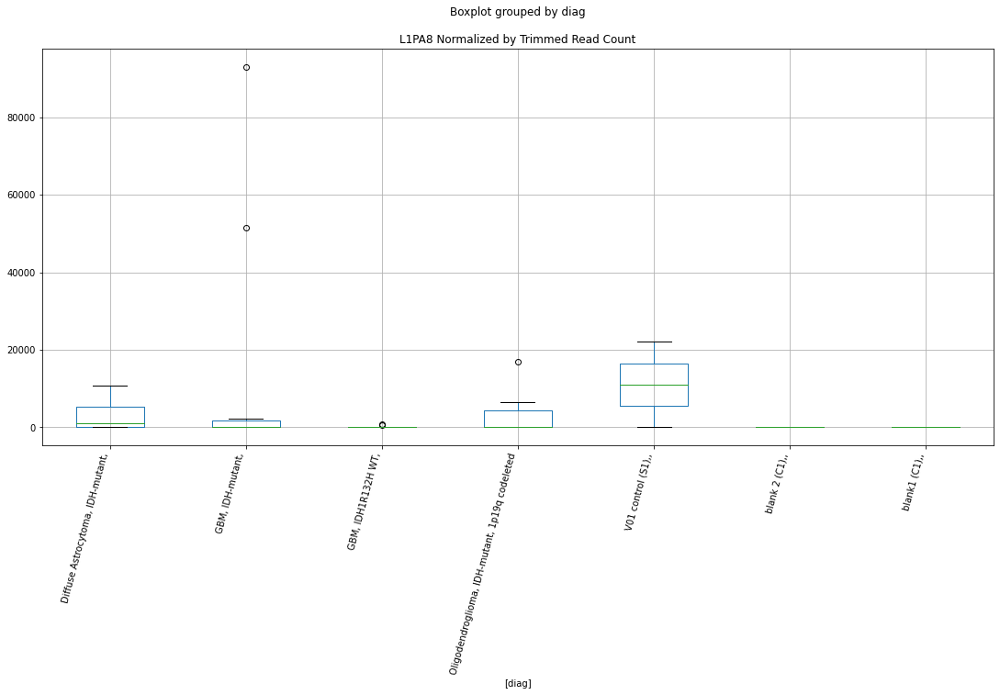

 p : 0.03656108747125678  ( t : 2.2585547805459982 ) :  D-plex  :  bbduk2  :  MamRep488
Control and blanks
73         0.0
337    12462.2
Name: MamRep488, dtype: float64
205    5193.64
Name: MamRep488, dtype: float64
469    10055.96
Name: MamRep488, dtype: float64


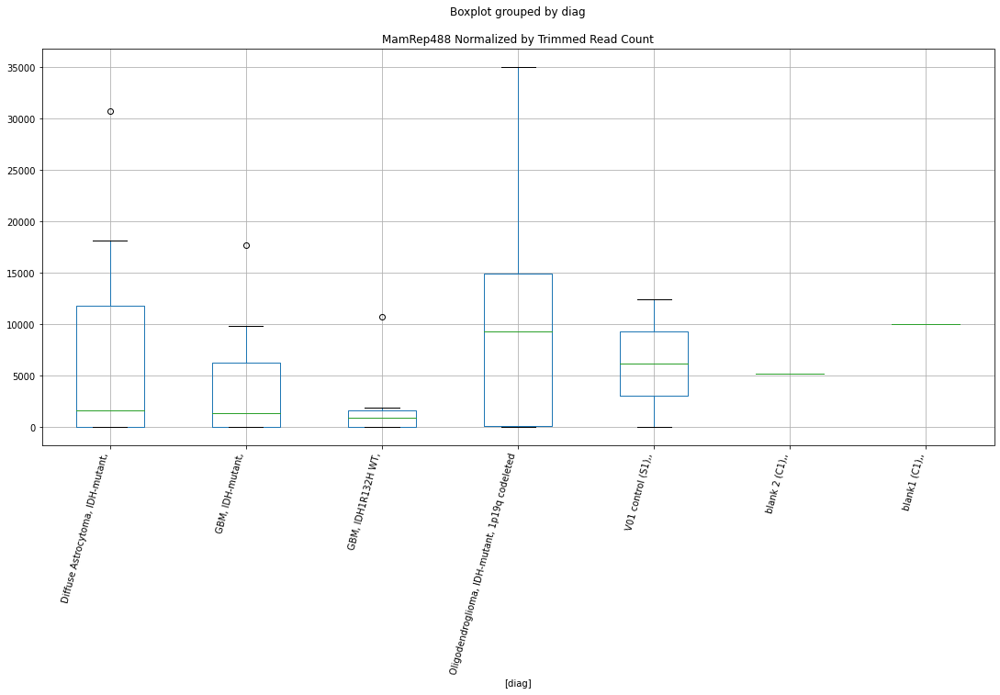

 p : 0.03657130929432297  ( t : 2.2584157926214012 ) :  D-plex  :  bbduk2  :  (TTATA)n
Control and blanks
73     0.0
337    0.0
Name: (TTATA)n, dtype: float64
205    1074.55
Name: (TTATA)n, dtype: float64
469    1183.05
Name: (TTATA)n, dtype: float64


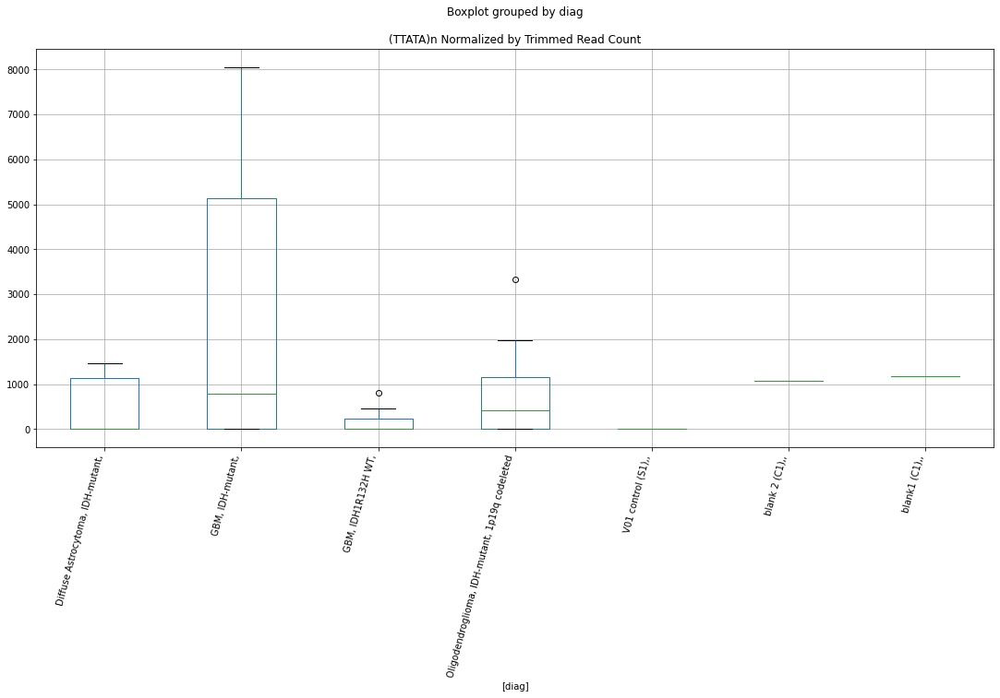

 p : 0.0365825649646291  ( t : 2.2582627887933677 ) :  D-plex  :  cutadapt2  :  MamGypLTR3a
Control and blanks
76      1515.23
340    59889.79
Name: MamGypLTR3a, dtype: float64
208    14814.26
Name: MamGypLTR3a, dtype: float64
472    14448.9
Name: MamGypLTR3a, dtype: float64


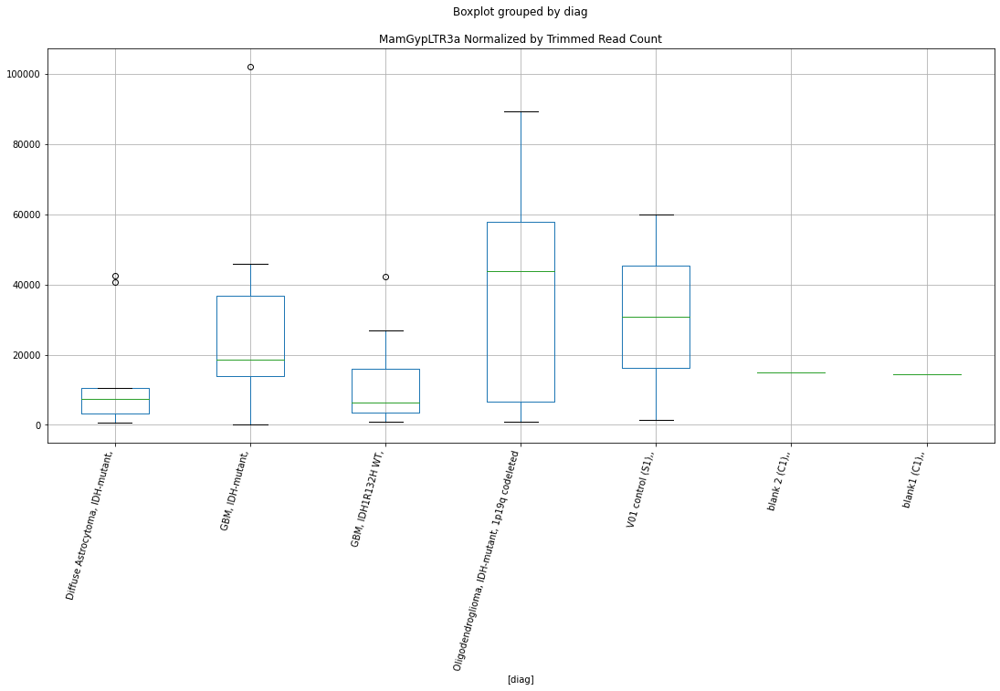

 p : 0.036585350188760905  ( t : 2.2582249345908063 ) :  D-plex  :  bbduk2  :  MER74C
Control and blanks
73     1546.02
337       0.00
Name: MER74C, dtype: float64
205    6447.27
Name: MER74C, dtype: float64
469    2957.64
Name: MER74C, dtype: float64


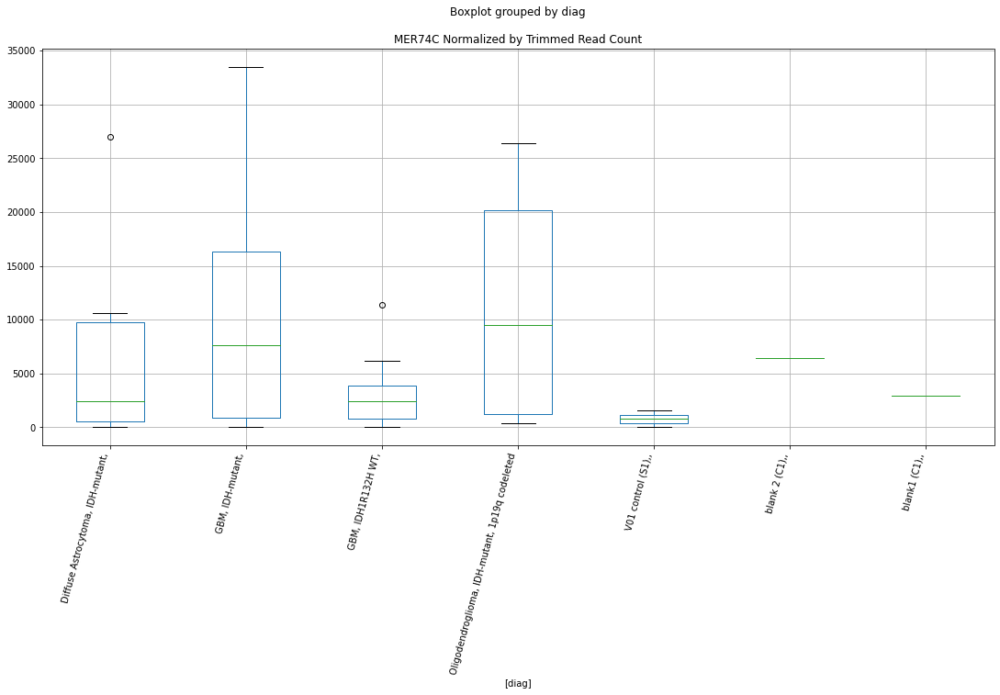

 p : 0.03665652460704978  ( t : 2.257258499297358 ) :  D-plex  :  cutadapt2  :  LTR19B
Control and blanks
76     1515.23
340       0.00
Name: LTR19B, dtype: float64
208    9170.73
Name: LTR19B, dtype: float64
472    3467.74
Name: LTR19B, dtype: float64


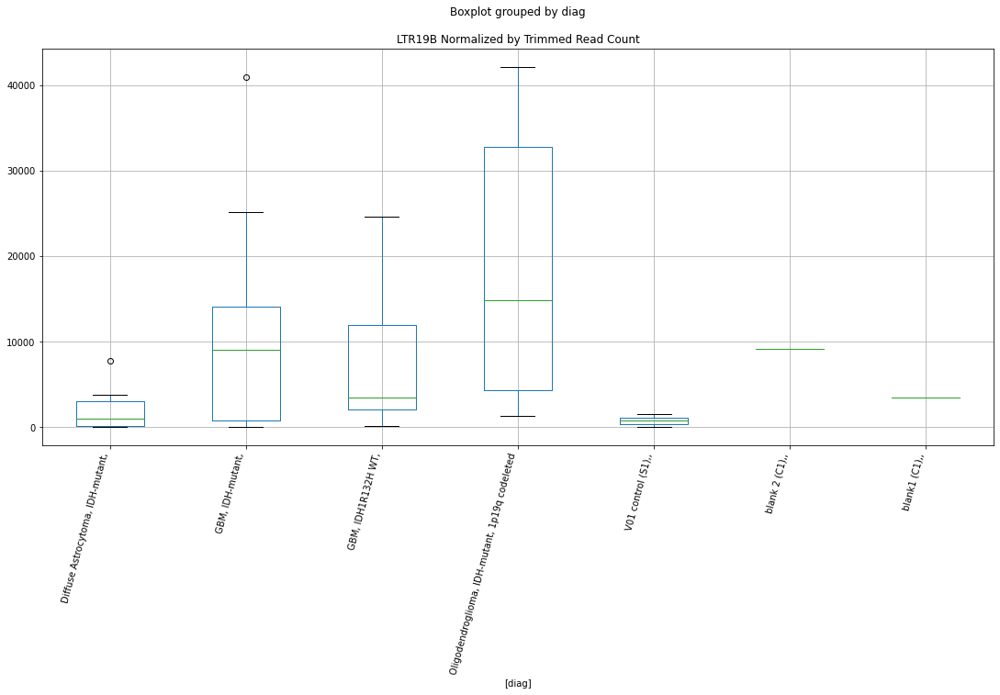

 p : 0.036666107395413976  ( t : 2.2571285126764526 ) :  D-plex  :  bbduk2  :  LTR71A
Control and blanks
73     773.01
337      0.00
Name: LTR71A, dtype: float64
205    1790.91
Name: LTR71A, dtype: float64
469    2366.11
Name: LTR71A, dtype: float64


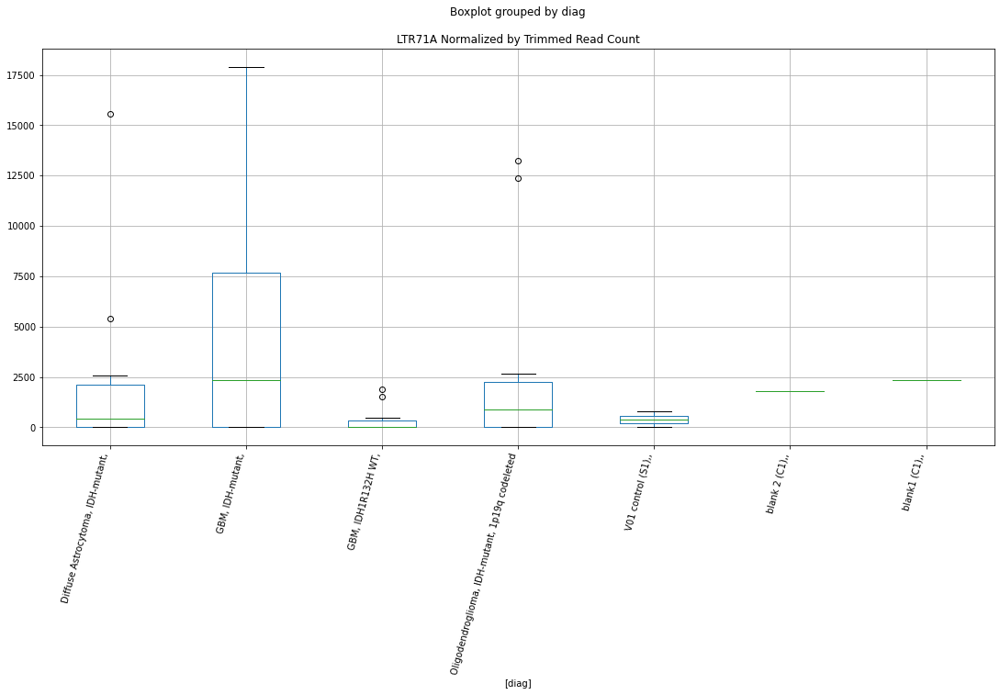

 p : 0.03669264307764659  ( t : 2.2567687306014657 ) :  D-plex  :  bbduk2  :  PRIMA41-int
Control and blanks
73     4638.05
337    9791.73
Name: PRIMA41-int, dtype: float64
205    18625.46
Name: PRIMA41-int, dtype: float64
469    24252.62
Name: PRIMA41-int, dtype: float64


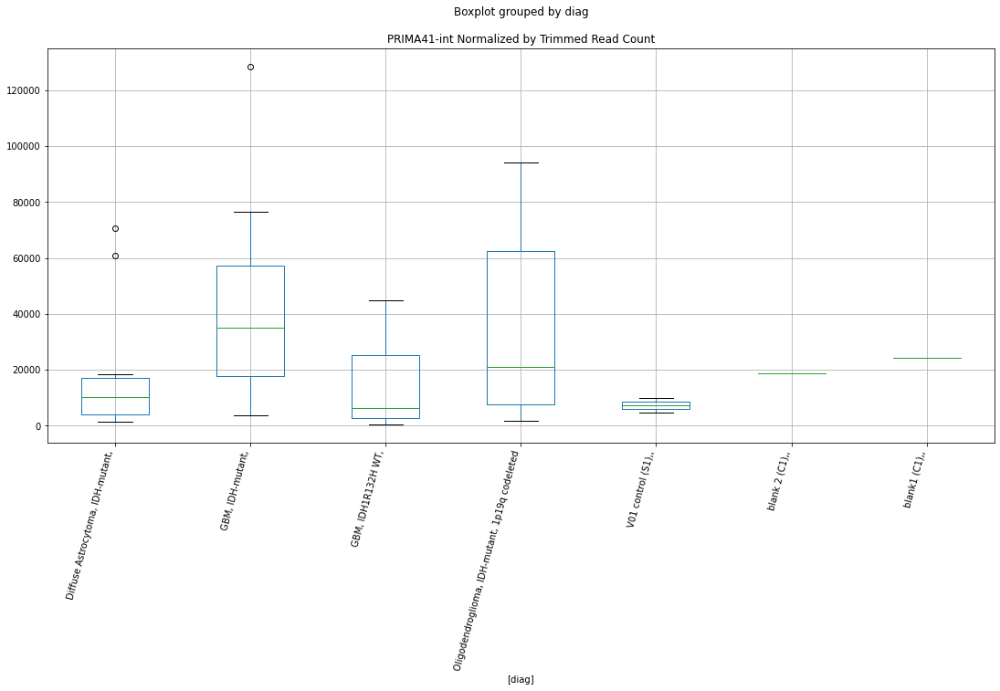

 p : 0.036873809222863804  ( t : 2.2543188028447583 ) :  Lexogen  :  cutadapt2  :  L1PA4
Control and blanks
82       0.00
346    420.87
Name: L1PA4, dtype: float64
214    0.0
Name: L1PA4, dtype: float64
478    0.0
Name: L1PA4, dtype: float64


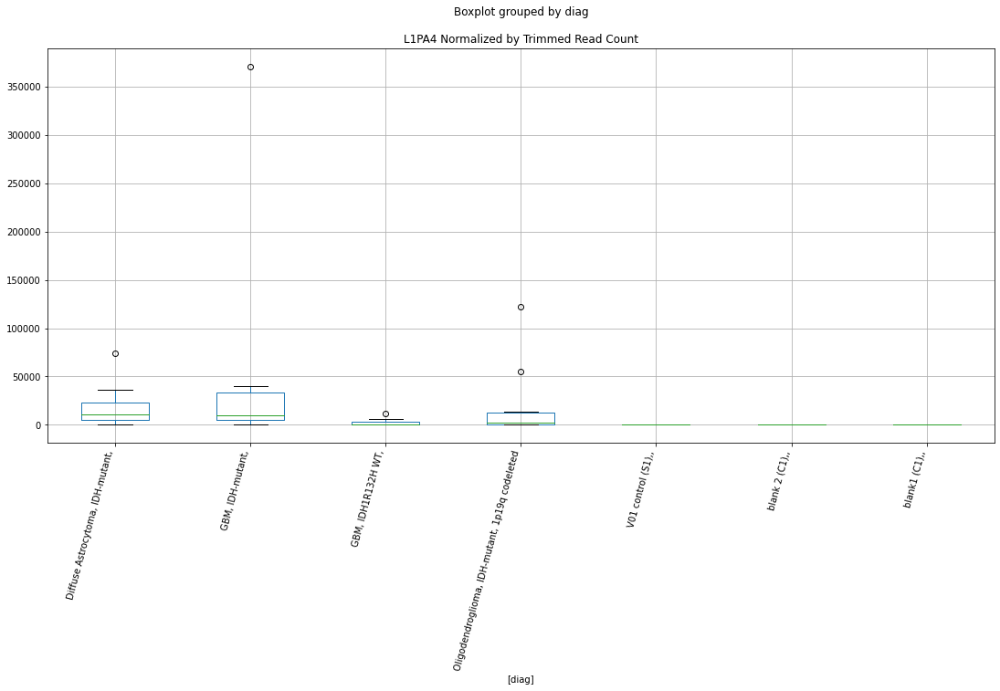

 p : 0.036916522225970826  ( t : 2.2537428098350394 ) :  D-plex  :  bbduk2  :  L1ME3E
Control and blanks
73      80392.87
337    260816.08
Name: L1ME3E, dtype: float64
205    130199.12
Name: L1ME3E, dtype: float64
469    126586.85
Name: L1ME3E, dtype: float64


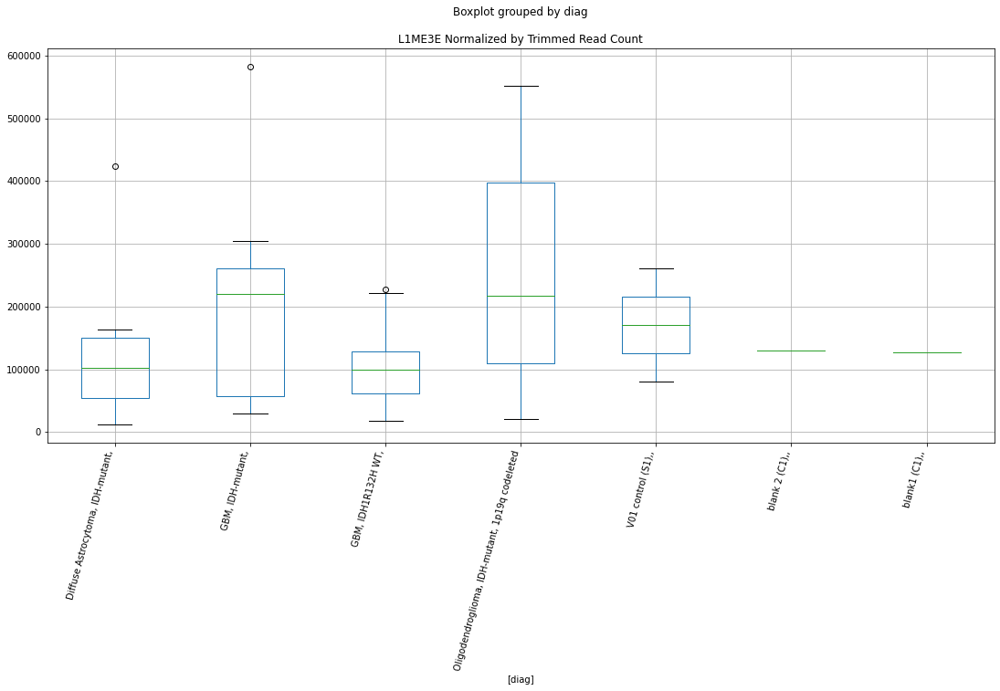

 p : 0.03695286420712554  ( t : 2.2532532154927427 ) :  D-plex  :  bbduk2  :  (GTGTGT)n
Control and blanks
73       0.00
337    890.16
Name: (GTGTGT)n, dtype: float64
205    1970.0
Name: (GTGTGT)n, dtype: float64
469    1774.58
Name: (GTGTGT)n, dtype: float64


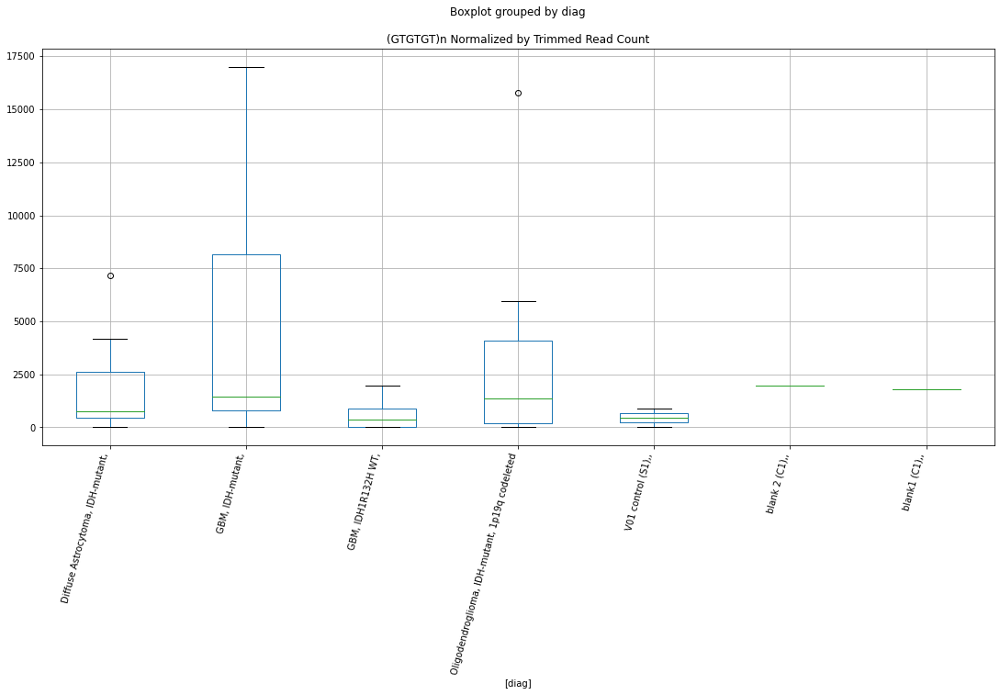

 p : 0.036969277991295534  ( t : 2.2530322368680427 ) :  D-plex  :  bbduk2  :  (CTCCCT)n
Control and blanks
73     36331.39
337     9791.73
Name: (CTCCCT)n, dtype: float64
205    5910.0
Name: (CTCCCT)n, dtype: float64
469    10647.49
Name: (CTCCCT)n, dtype: float64


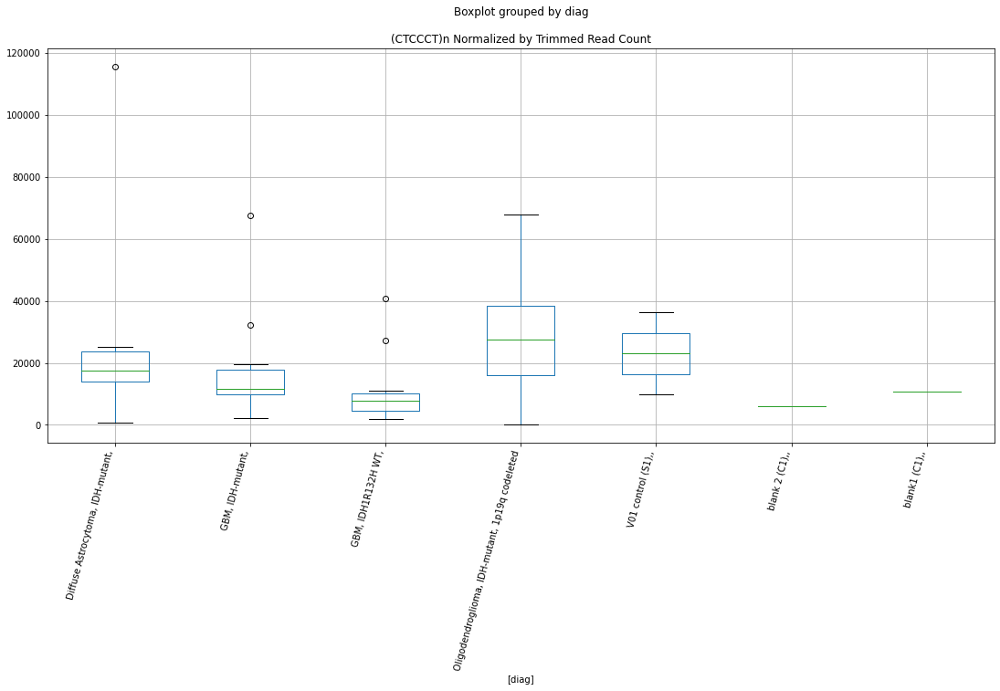

 p : 0.036971340382997306  ( t : 2.253004477312718 ) :  D-plex  :  bbduk2  :  (TTTAA)n
Control and blanks
73        0.00
337    1780.31
Name: (TTTAA)n, dtype: float64
205    1790.91
Name: (TTTAA)n, dtype: float64
469    1774.58
Name: (TTTAA)n, dtype: float64


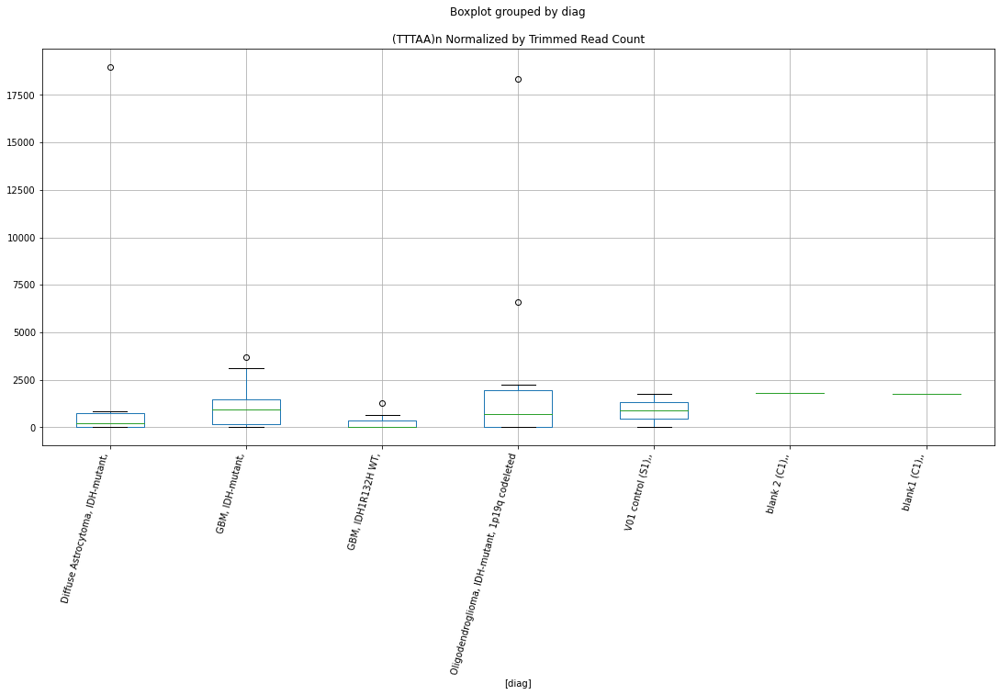

 p : 0.036975072972930935  ( t : 2.2529542407155225 ) :  D-plex  :  cutadapt2  :  MER65D
Control and blanks
76     0.0
340    0.0
Name: MER65D, dtype: float64
208    6878.05
Name: MER65D, dtype: float64
472    9825.25
Name: MER65D, dtype: float64


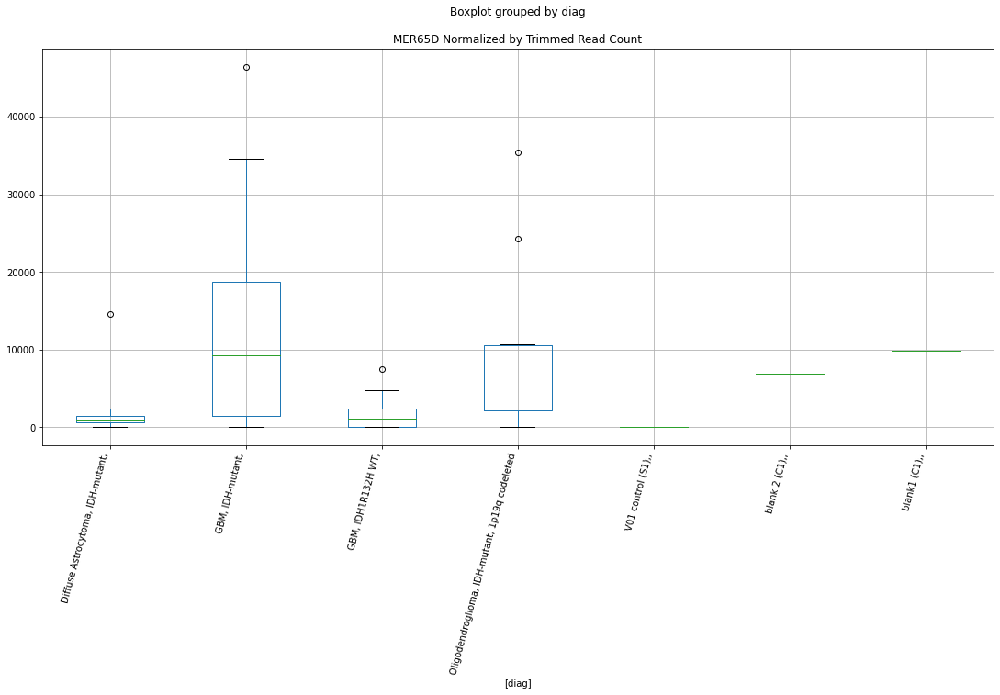

 p : 0.03708997268481274  ( t : 2.251410101084264 ) :  D-plex  :  bbduk2  :  MLT1F1
Control and blanks
73     37104.40
337    56970.06
Name: MLT1F1, dtype: float64
205    54622.74
Name: MLT1F1, dtype: float64
469    48505.24
Name: MLT1F1, dtype: float64


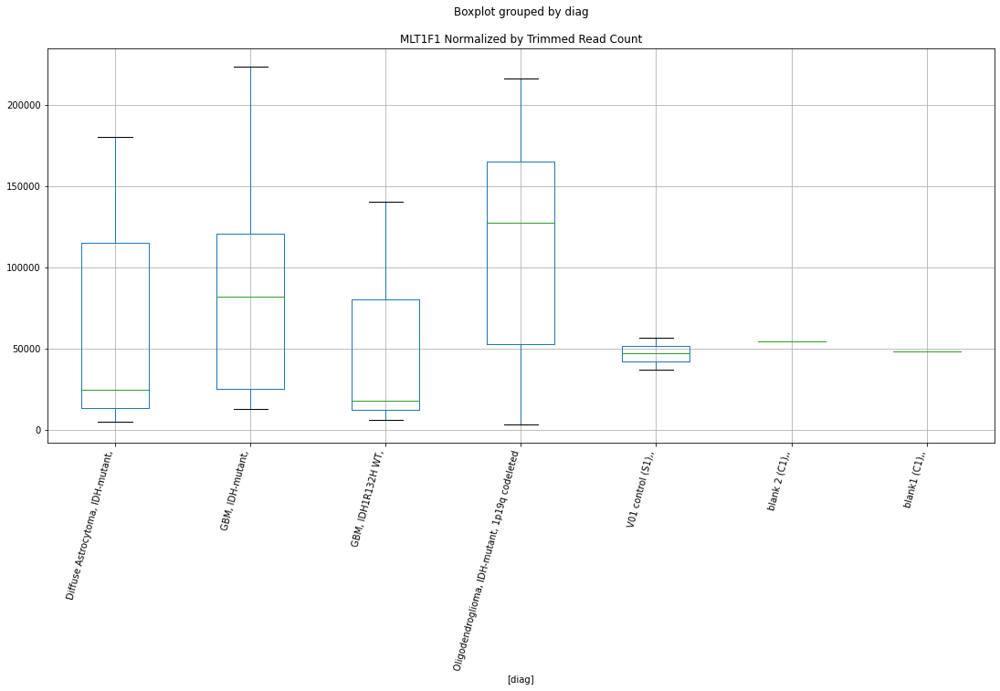

 p : 0.03711862439063535  ( t : 2.2510257380171725 ) :  D-plex  :  cutadapt2  :  LTR56
Control and blanks
76      3030.46
340    19376.11
Name: LTR56, dtype: float64
208    17812.38
Name: LTR56, dtype: float64
472    17916.63
Name: LTR56, dtype: float64


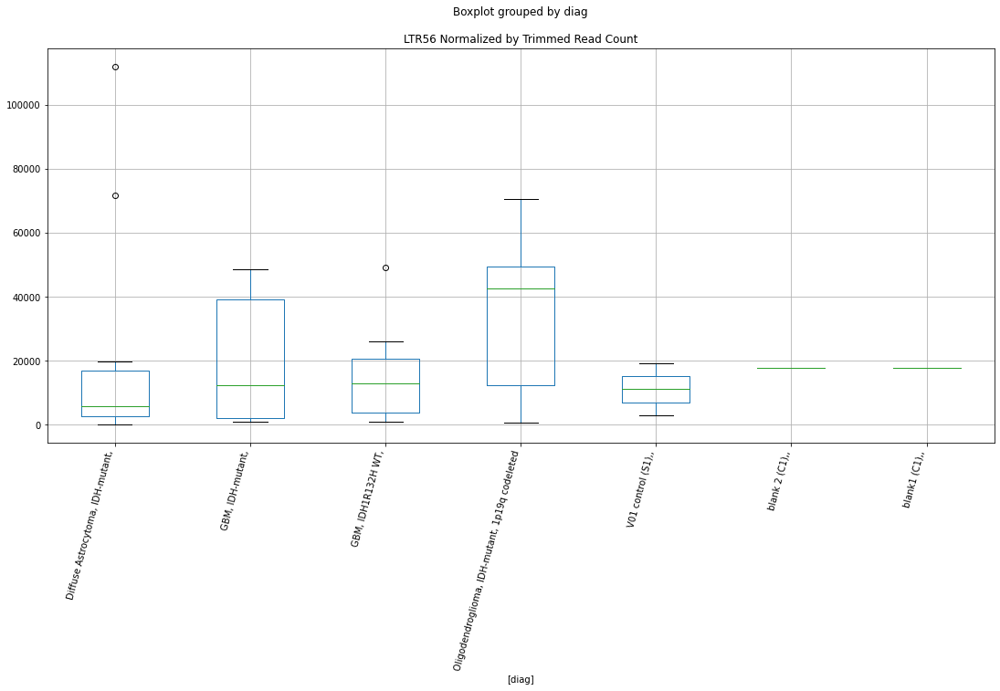

 p : 0.037166117556625064  ( t : 2.250389219190298 ) :  Lexogen  :  bbduk2  :  L1P1
Control and blanks
79     0.0
343    0.0
Name: L1P1, dtype: float64
211    0.0
Name: L1P1, dtype: float64
475    0.0
Name: L1P1, dtype: float64


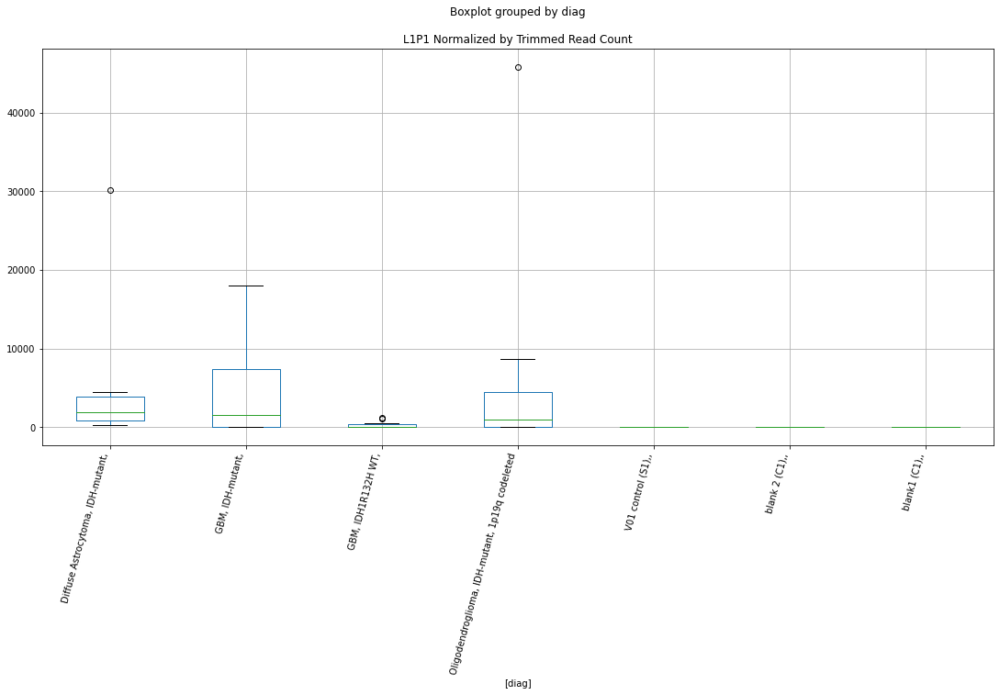

 p : 0.03716742117092365  ( t : 2.2503717583155995 ) :  Lexogen  :  bbduk2  :  L1PA4
Control and blanks
79       0.00
343    424.63
Name: L1PA4, dtype: float64
211    0.0
Name: L1PA4, dtype: float64
475    0.0
Name: L1PA4, dtype: float64


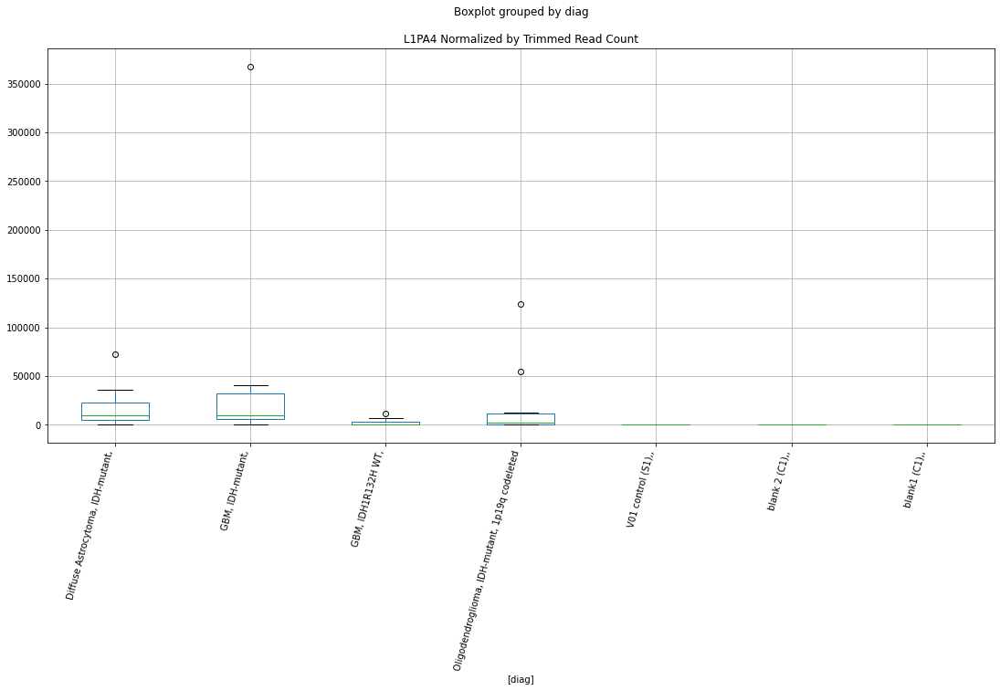

 p : 0.037242807458912376  ( t : 2.2493629791751606 ) :  D-plex  :  bbduk2  :  (CTCTCT)n
Control and blanks
73     5411.06
337    8011.42
Name: (CTCTCT)n, dtype: float64
205    4656.36
Name: (CTCTCT)n, dtype: float64
469    7689.86
Name: (CTCTCT)n, dtype: float64


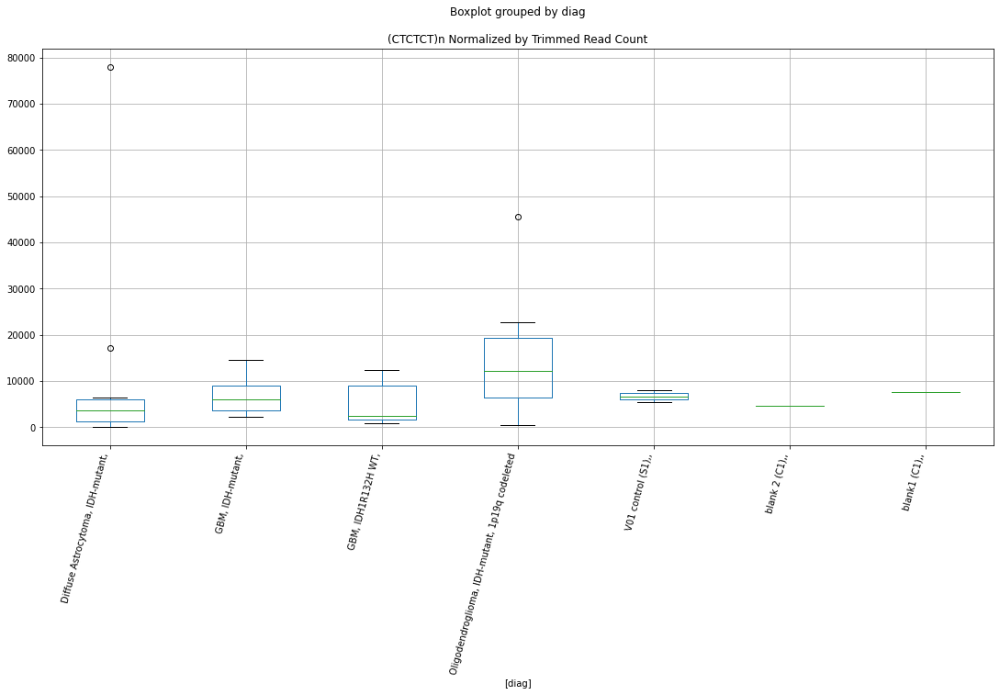

 p : 0.037456331201877684  ( t : 2.2465159107295127 ) :  D-plex  :  bbduk2  :  LTR31
Control and blanks
73      773.01
337    1780.31
Name: LTR31, dtype: float64
205    7880.0
Name: LTR31, dtype: float64
469    10647.49
Name: LTR31, dtype: float64


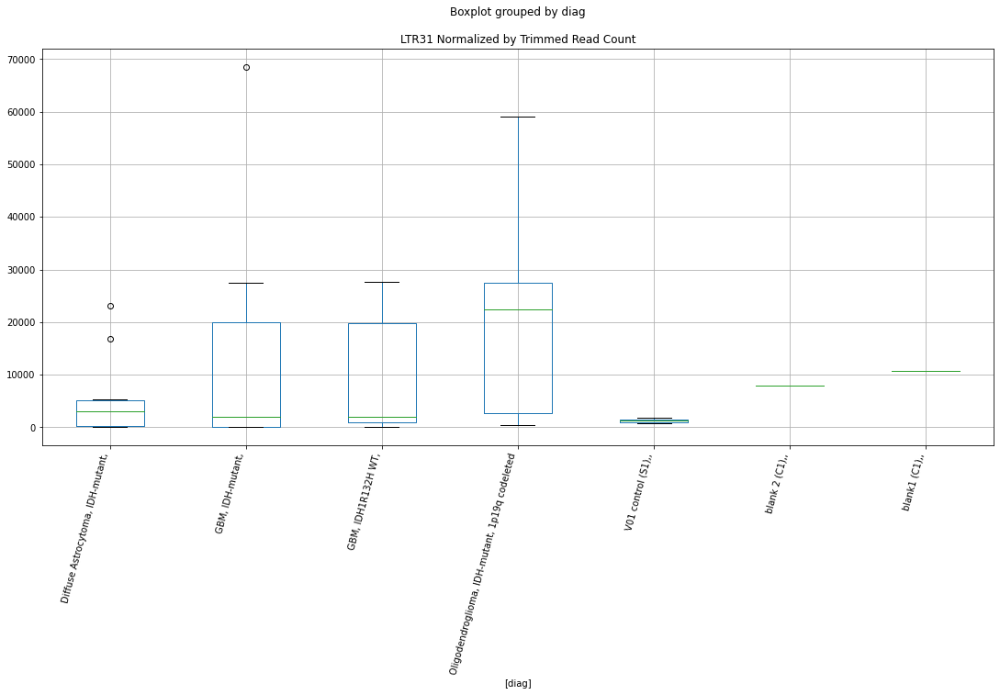

 p : 0.03748724934640541  ( t : 2.2461048981706524 ) :  D-plex  :  cutadapt2  :  (CCCTCT)n
Control and blanks
76      8333.76
340    10568.79
Name: (CCCTCT)n, dtype: float64
208    3703.56
Name: (CCCTCT)n, dtype: float64
472    8091.38
Name: (CCCTCT)n, dtype: float64


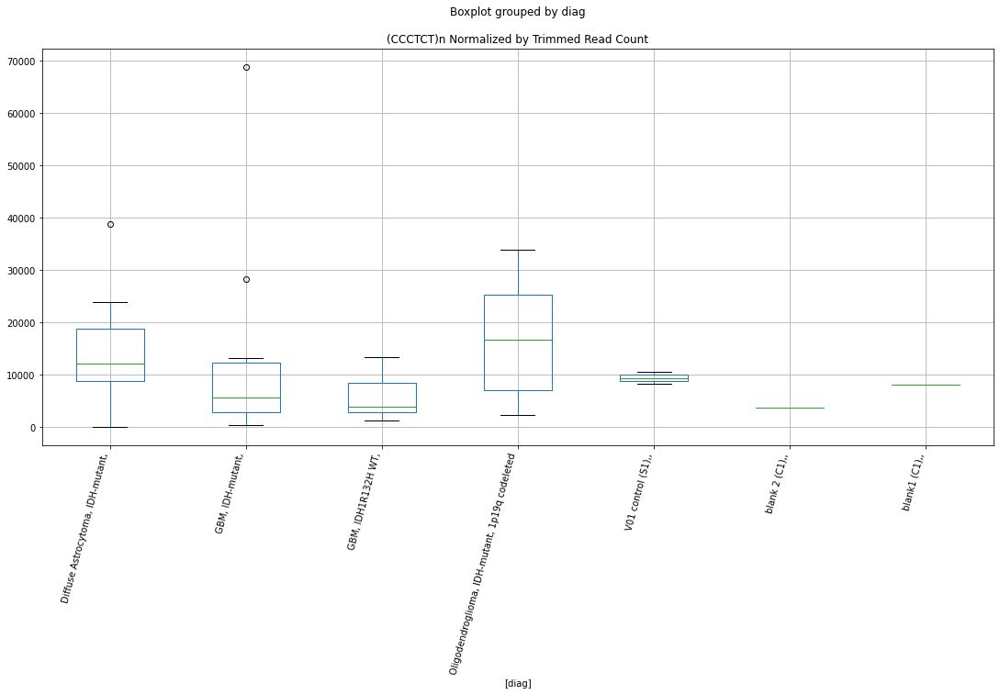

 p : 0.03758107471299741  ( t : 2.244859535540926 ) :  D-plex  :  cutadapt2  :  LOR1b
Control and blanks
76      8333.76
340    67816.37
Name: LOR1b, dtype: float64
208    19928.7
Name: LOR1b, dtype: float64
472    20228.45
Name: LOR1b, dtype: float64


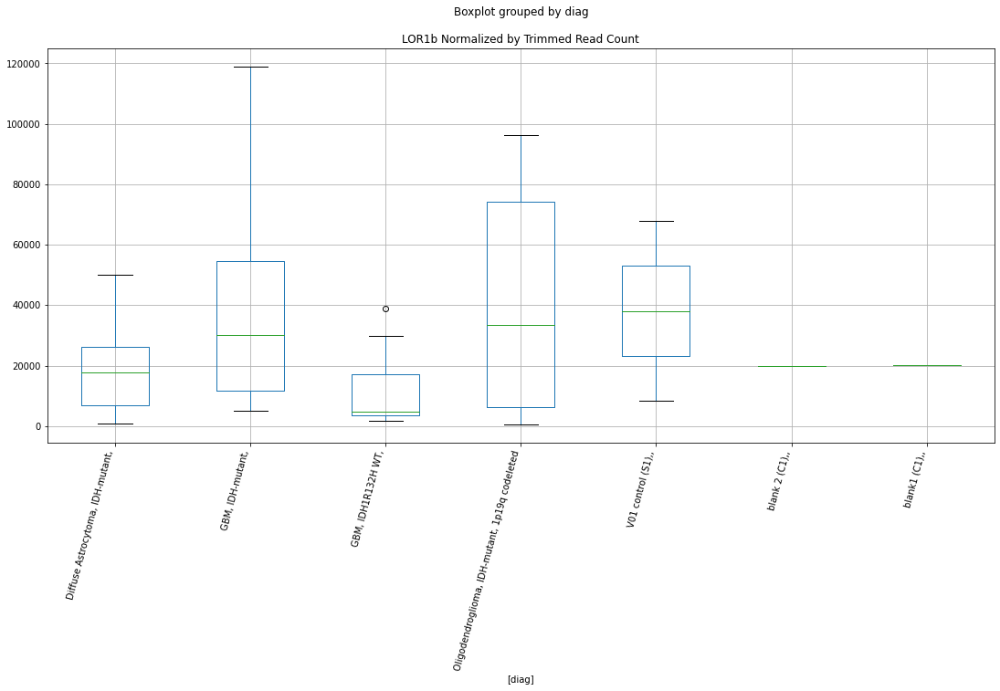

 p : 0.03772448711546605  ( t : 2.242961525189205 ) :  D-plex  :  bbduk2  :  (GTTT)n
Control and blanks
73     2319.03
337     890.16
Name: (GTTT)n, dtype: float64
205    2149.09
Name: (GTTT)n, dtype: float64
469    1774.58
Name: (GTTT)n, dtype: float64


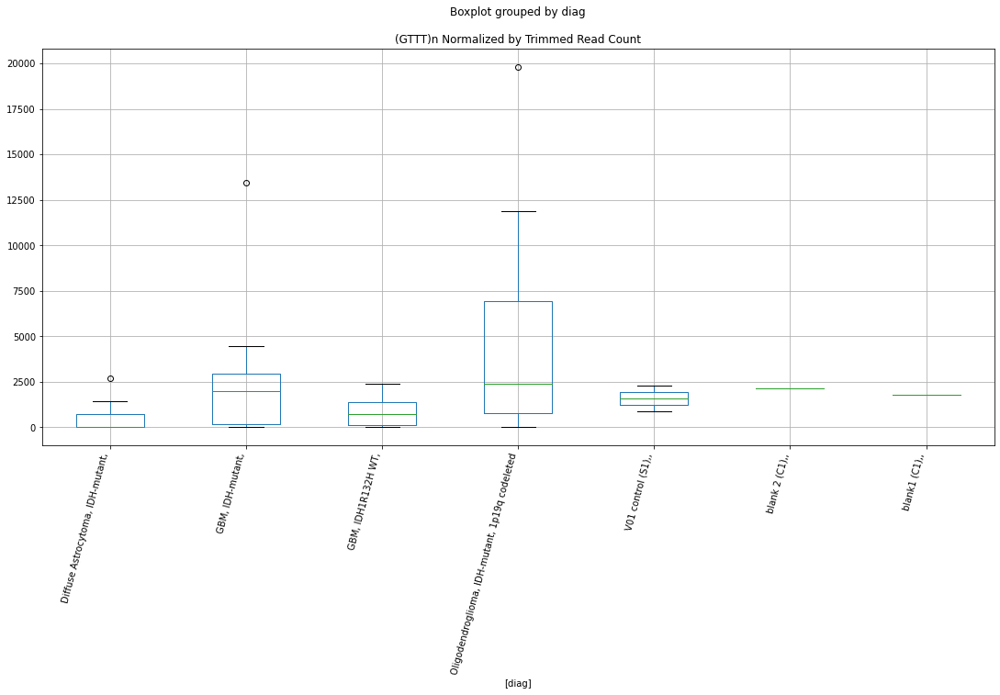

 p : 0.03772806791302444  ( t : 2.2429142198575436 ) :  D-plex  :  cutadapt2  :  MER54B
Control and blanks
76     0.0
340    0.0
Name: MER54B, dtype: float64
208    9523.45
Name: MER54B, dtype: float64
472    6935.47
Name: MER54B, dtype: float64


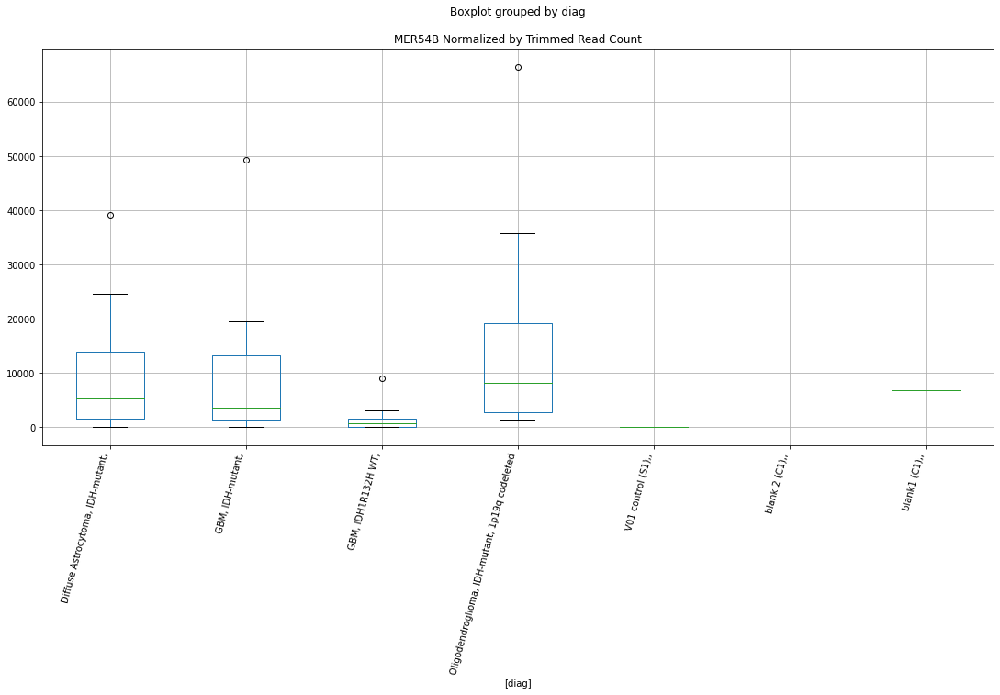

 p : 0.03773652341569244  ( t : 2.242802532023302 ) :  D-plex  :  cutadapt2  :  (CCTTCCT)n
Control and blanks
76     23486.04
340        0.00
Name: (CCTTCCT)n, dtype: float64
208    176.36
Name: (CCTTCCT)n, dtype: float64
472    0.0
Name: (CCTTCCT)n, dtype: float64


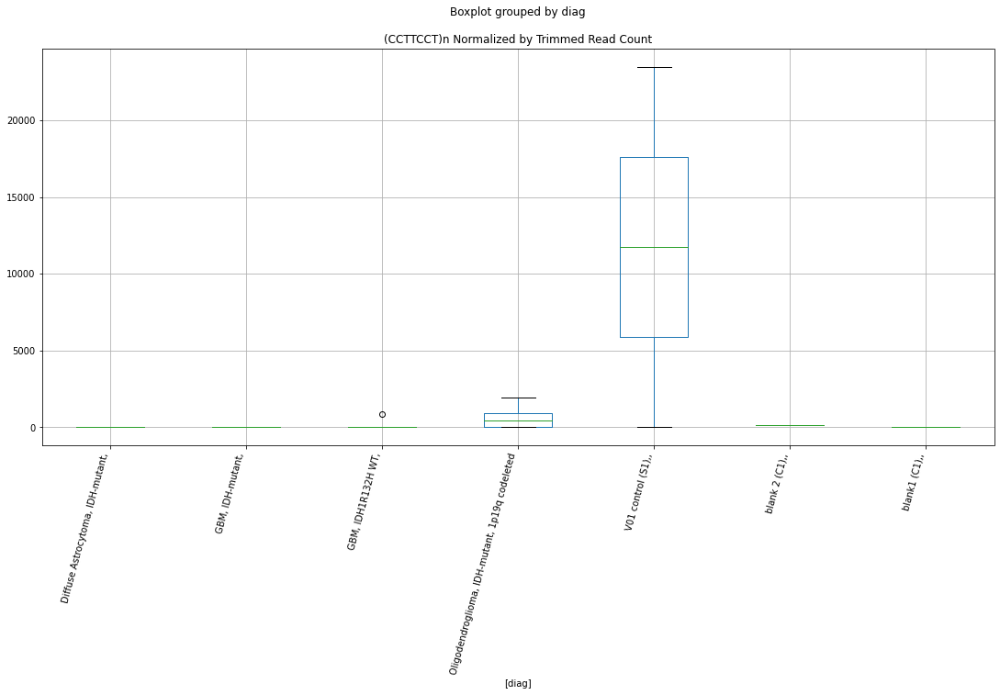

 p : 0.03775239328987755  ( t : 2.242592970838107 ) :  Lexogen  :  cutadapt2  :  L1M5
Control and blanks
82     0.0
346    0.0
Name: L1M5, dtype: float64
214    0.0
Name: L1M5, dtype: float64
478    7836.2
Name: L1M5, dtype: float64


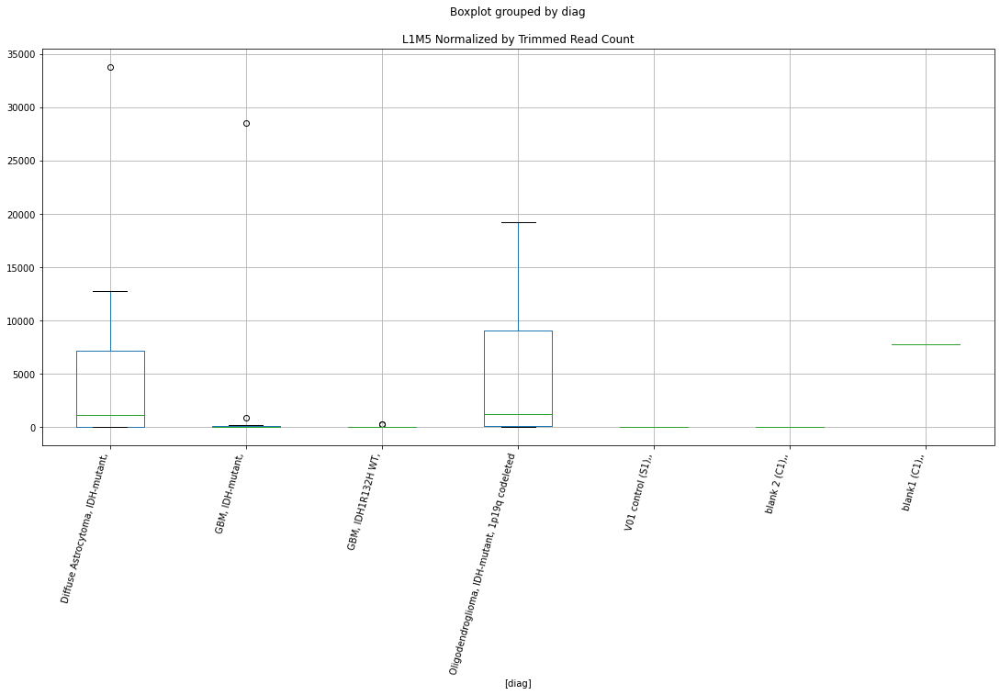

 p : 0.037800881106913584  ( t : 2.241953193659693 ) :  D-plex  :  cutadapt2  :  LTR71A
Control and blanks
76     757.61
340      0.00
Name: LTR71A, dtype: float64
208    1763.6
Name: LTR71A, dtype: float64
472    1733.87
Name: LTR71A, dtype: float64


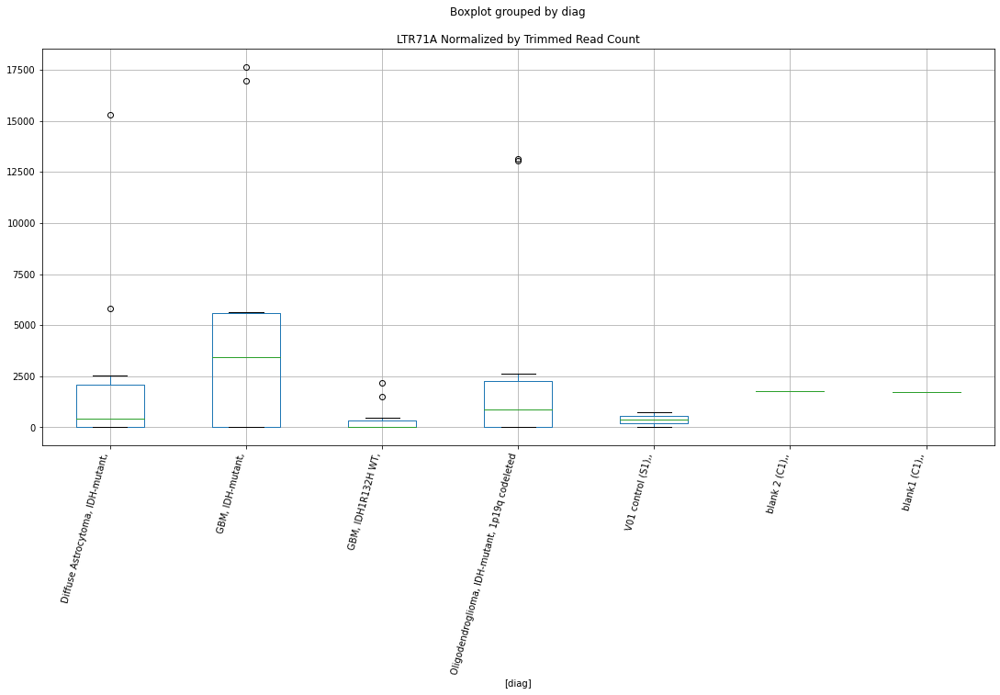

 p : 0.03781323498406489  ( t : 2.2417903102069126 ) :  D-plex  :  bbduk2  :  MER57B2
Control and blanks
73     38650.42
337        0.00
Name: MER57B2, dtype: float64
205    16476.37
Name: MER57B2, dtype: float64
469    18928.87
Name: MER57B2, dtype: float64


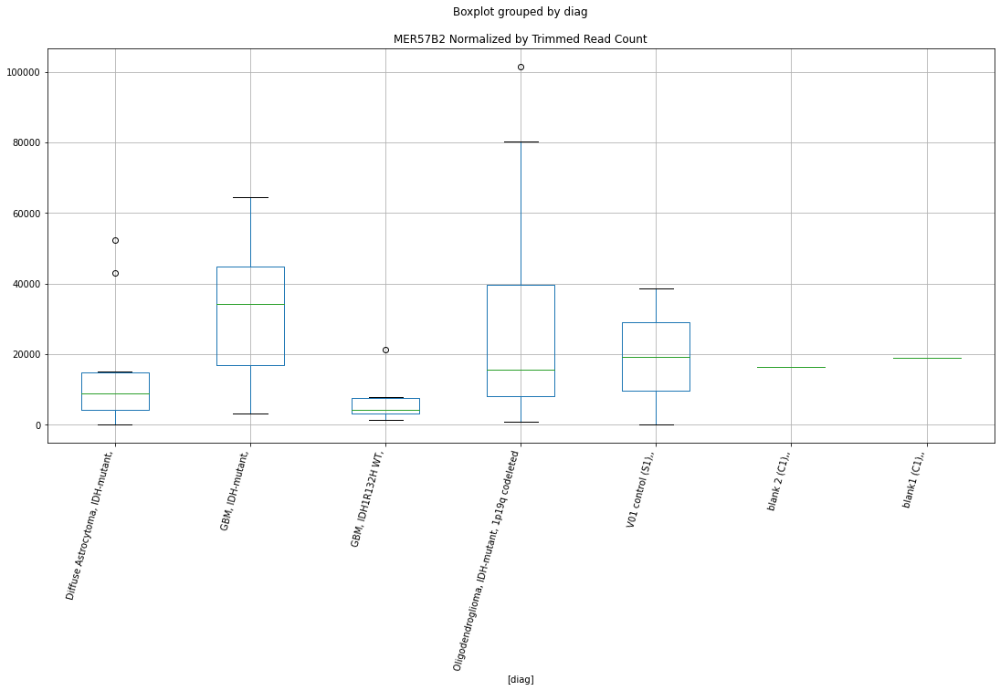

 p : 0.0378297087947489  ( t : 2.241573182566937 ) :  D-plex  :  cutadapt2  :  CR1_Mam
Control and blanks
76     17425.13
340    29944.89
Name: CR1_Mam, dtype: float64
208    21692.31
Name: CR1_Mam, dtype: float64
472    26585.97
Name: CR1_Mam, dtype: float64


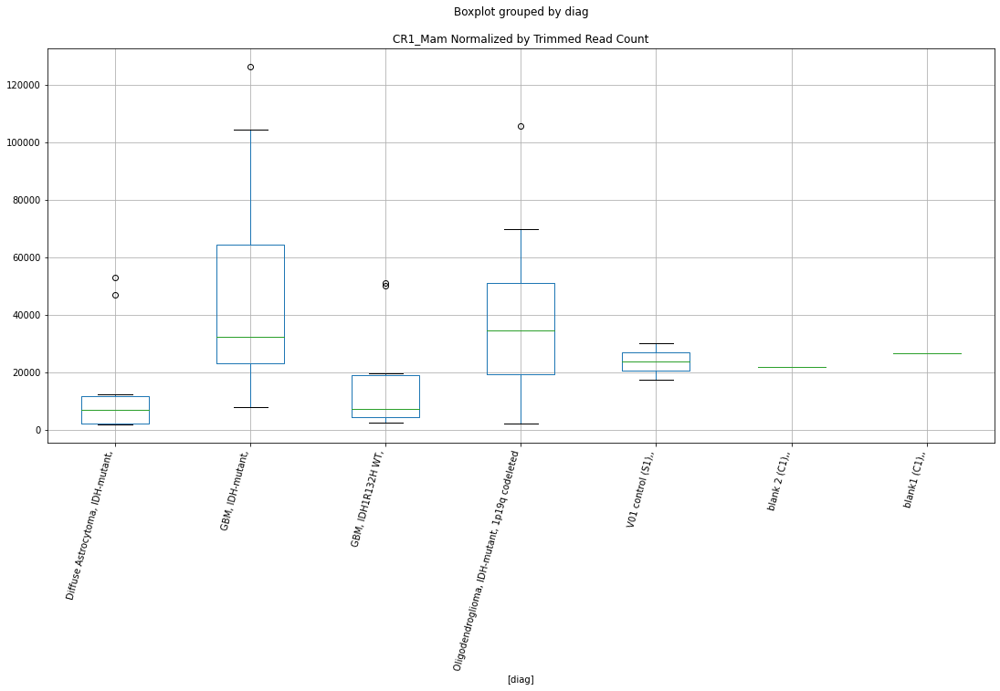

 p : 0.038059466698179736  ( t : 2.2385539865092983 ) :  D-plex  :  cutadapt2  :  MER84
Control and blanks
76     757.61
340      0.00
Name: MER84, dtype: float64
208    4585.37
Name: MER84, dtype: float64
472    4623.65
Name: MER84, dtype: float64


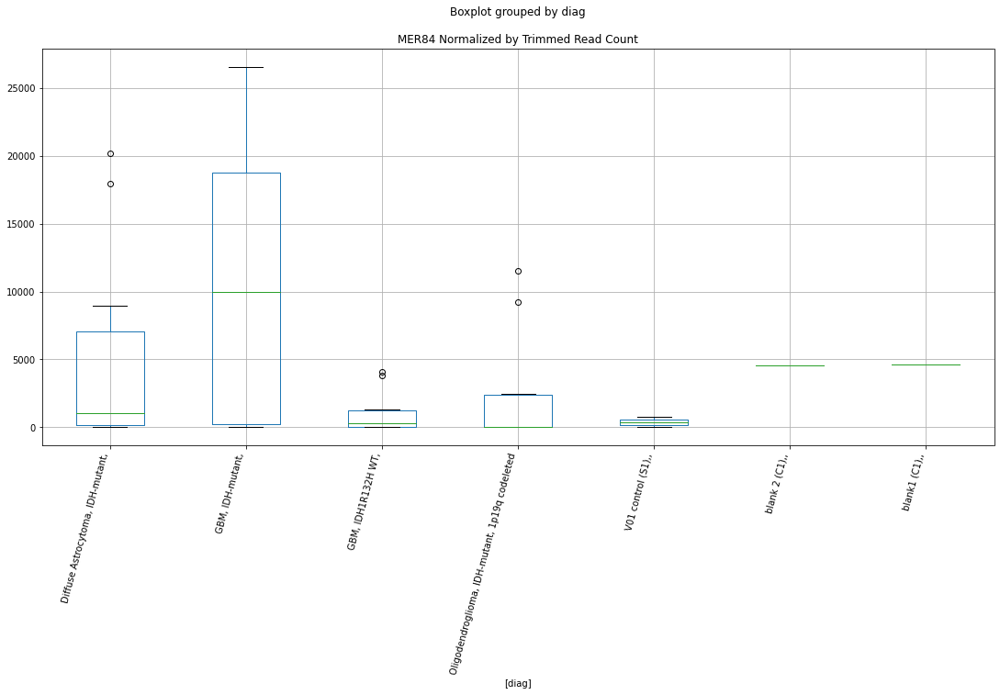

 p : 0.03812617980086511  ( t : 2.237680472570124 ) :  D-plex  :  bbduk2  :  MER61A
Control and blanks
73     773.01
337      0.00
Name: MER61A, dtype: float64
205    10208.18
Name: MER61A, dtype: float64
469    7098.33
Name: MER61A, dtype: float64


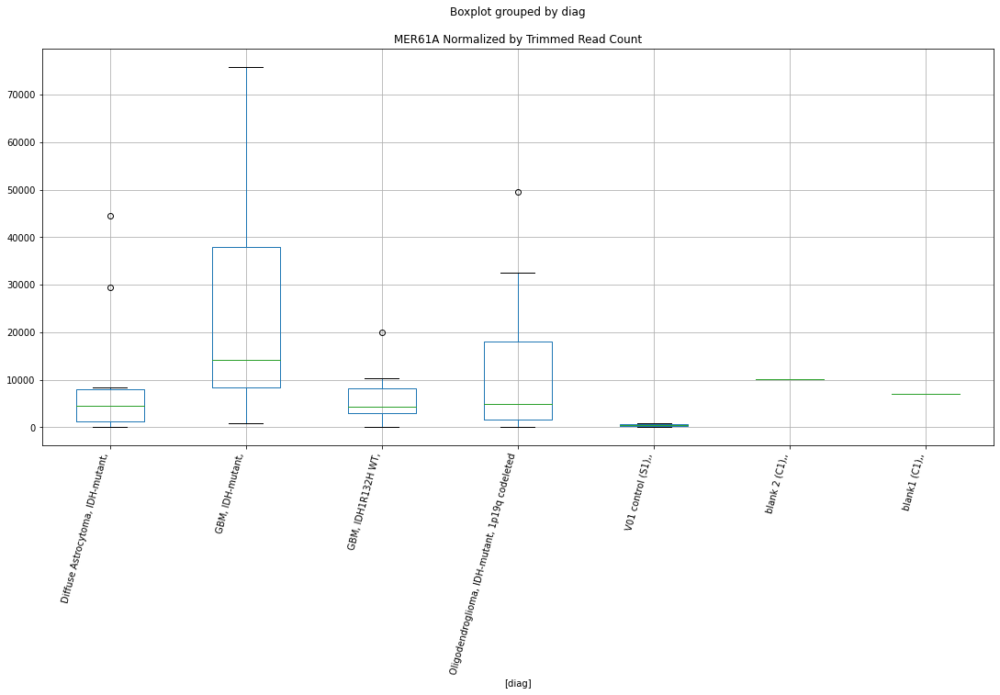

 p : 0.03819757691379527  ( t : 2.236747187485754 ) :  D-plex  :  bbduk2  :  (CCCTAA)n
Control and blanks
73     1546.02
337       0.00
Name: (CCCTAA)n, dtype: float64
205    2328.18
Name: (CCCTAA)n, dtype: float64
469    3549.16
Name: (CCCTAA)n, dtype: float64


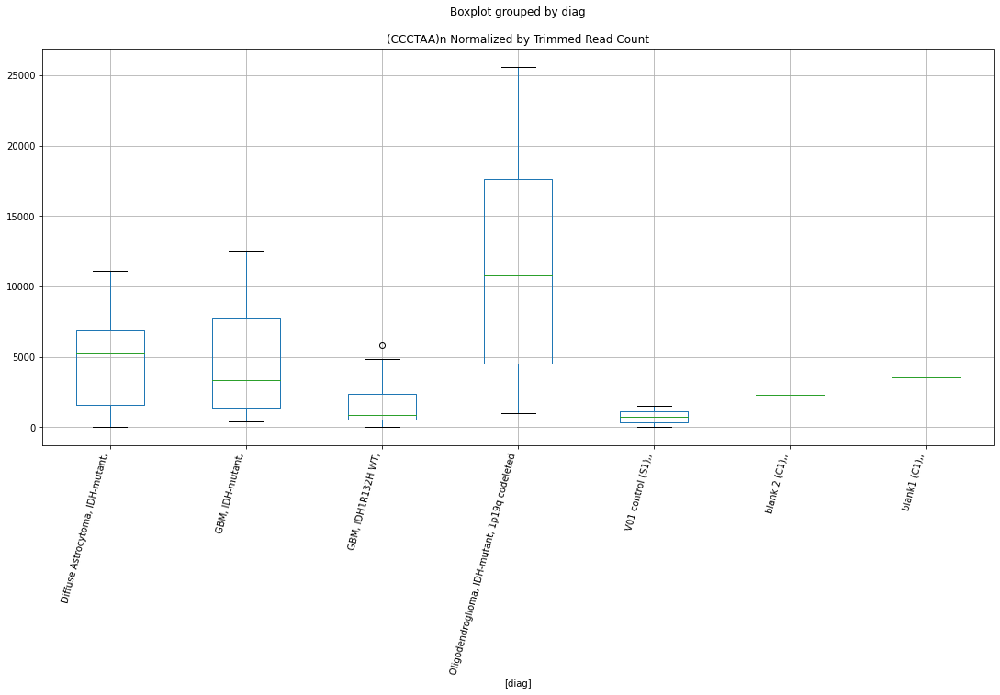

 p : 0.03822115263599159  ( t : 2.236439364679241 ) :  D-plex  :  bbduk2  :  CR1_Mam
Control and blanks
73     17779.19
337    30265.35
Name: CR1_Mam, dtype: float64
205    19700.0
Name: CR1_Mam, dtype: float64
469    25435.67
Name: CR1_Mam, dtype: float64


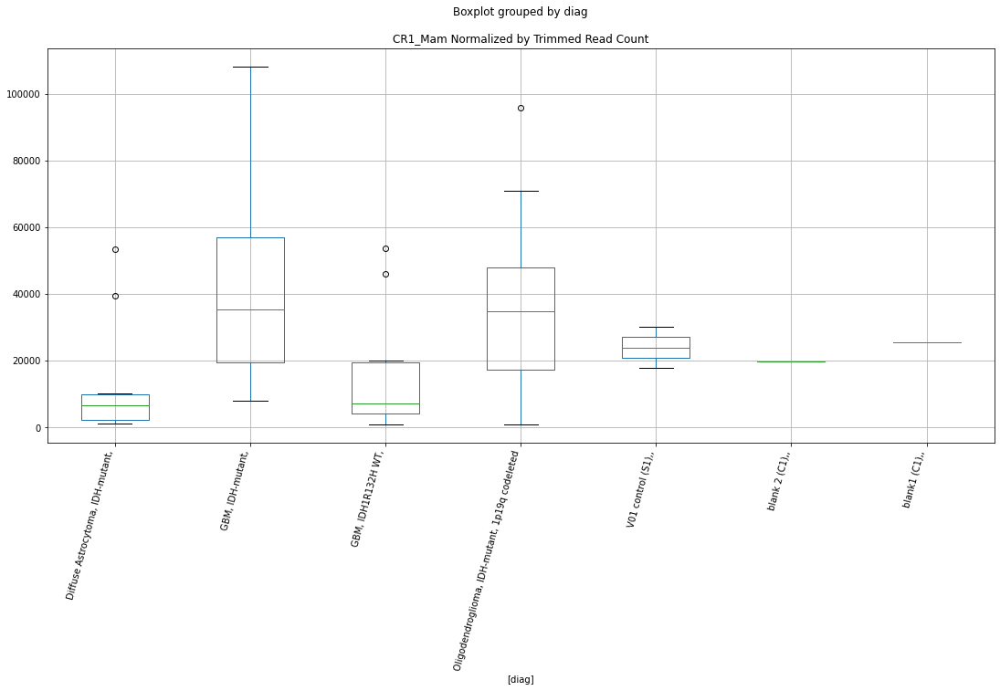

 p : 0.03832104992577788  ( t : 2.235136967308198 ) :  D-plex  :  cutadapt2  :  LTR81AB
Control and blanks
76     1515.23
340       0.00
Name: LTR81AB, dtype: float64
208    2645.4
Name: LTR81AB, dtype: float64
472    2311.82
Name: LTR81AB, dtype: float64


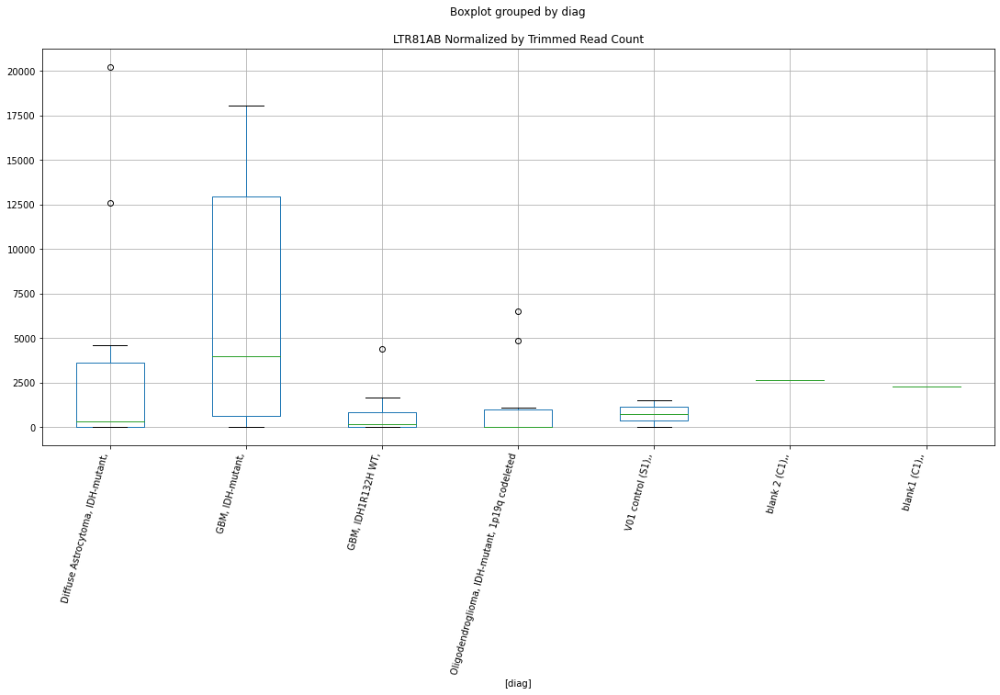

 p : 0.038367833755541904  ( t : 2.234528104894728 ) :  D-plex  :  cutadapt2  :  LTR16C
Control and blanks
76      16667.51
340    100403.46
Name: LTR16C, dtype: float64
208    108814.25
Name: LTR16C, dtype: float64
472    105187.96
Name: LTR16C, dtype: float64


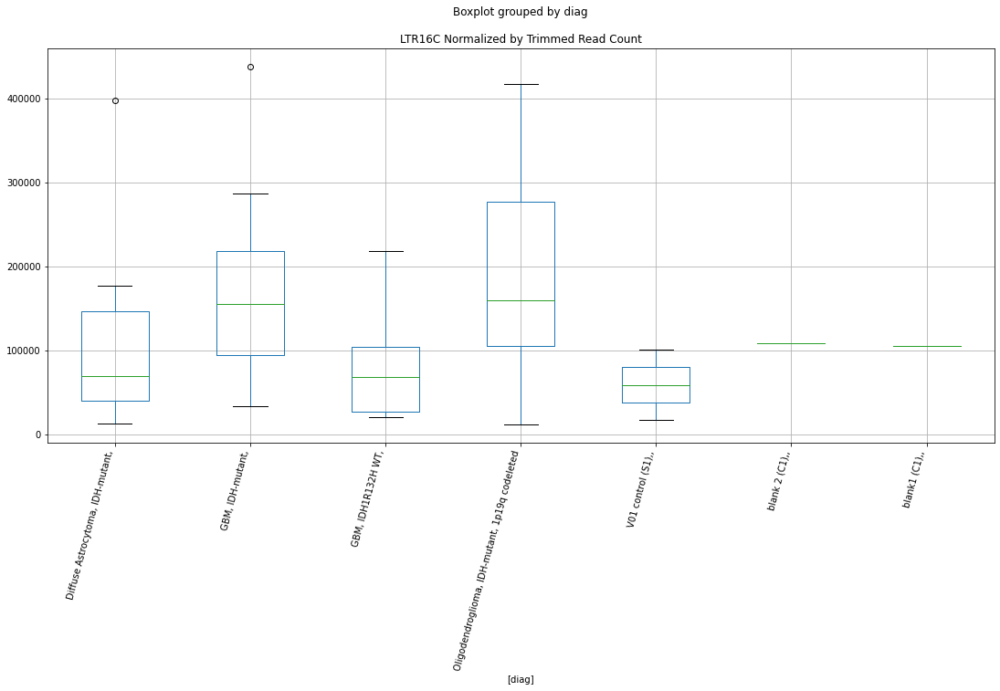

 p : 0.038426621362922  ( t : 2.233763989990393 ) :  D-plex  :  cutadapt2  :  L1ME3E
Control and blanks
76      77276.65
340    260696.71
Name: L1ME3E, dtype: float64
208    130153.84
Name: L1ME3E, dtype: float64
472    130618.02
Name: L1ME3E, dtype: float64


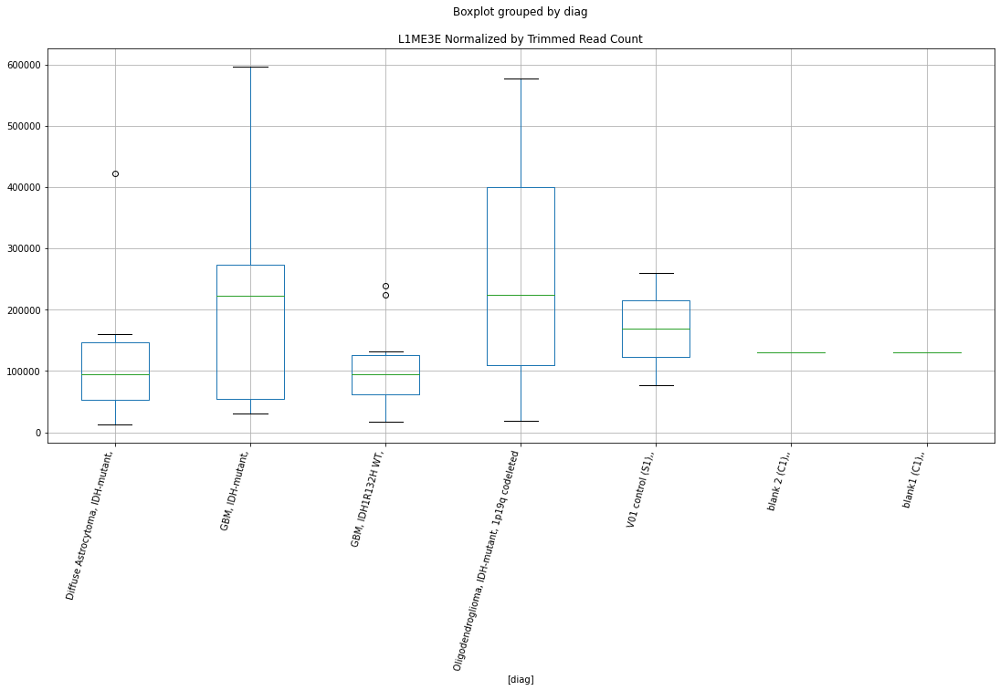

 p : 0.03851748078321072  ( t : 2.23258512538666 ) :  D-plex  :  cutadapt2  :  (ATTCC)n
Control and blanks
76      67427.66
340    103045.66
Name: (ATTCC)n, dtype: float64
208    76011.25
Name: (ATTCC)n, dtype: float64
472    87849.29
Name: (ATTCC)n, dtype: float64


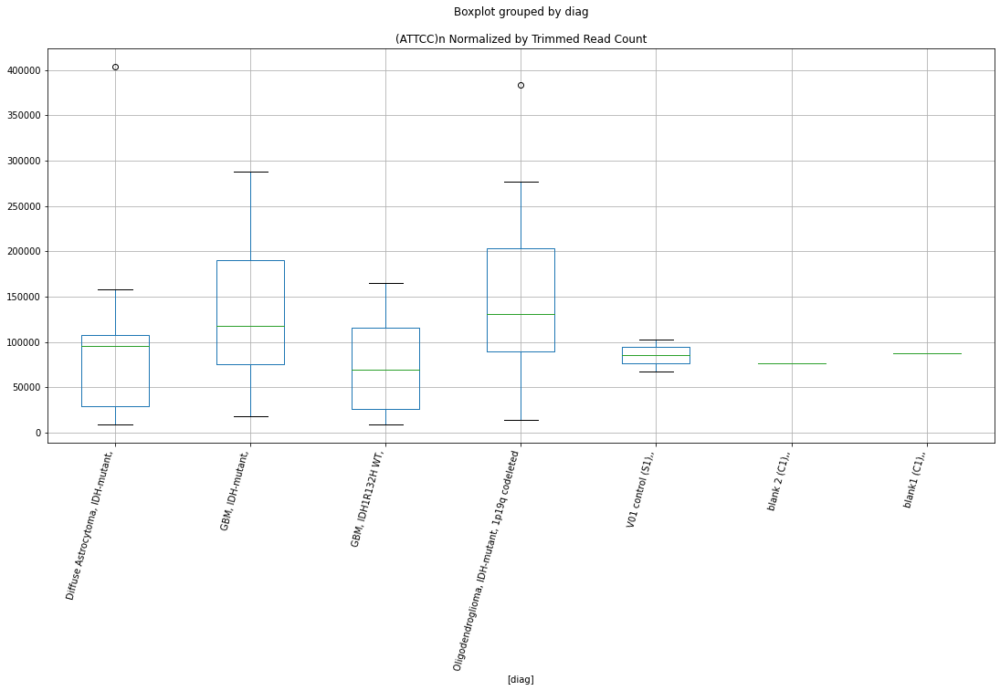

 p : 0.03865252127811991  ( t : 2.230837753962868 ) :  D-plex  :  bbduk2  :  (ATA)n
Control and blanks
73         0.00
337    14242.52
Name: (ATA)n, dtype: float64
205    4298.18
Name: (ATA)n, dtype: float64
469    4732.22
Name: (ATA)n, dtype: float64


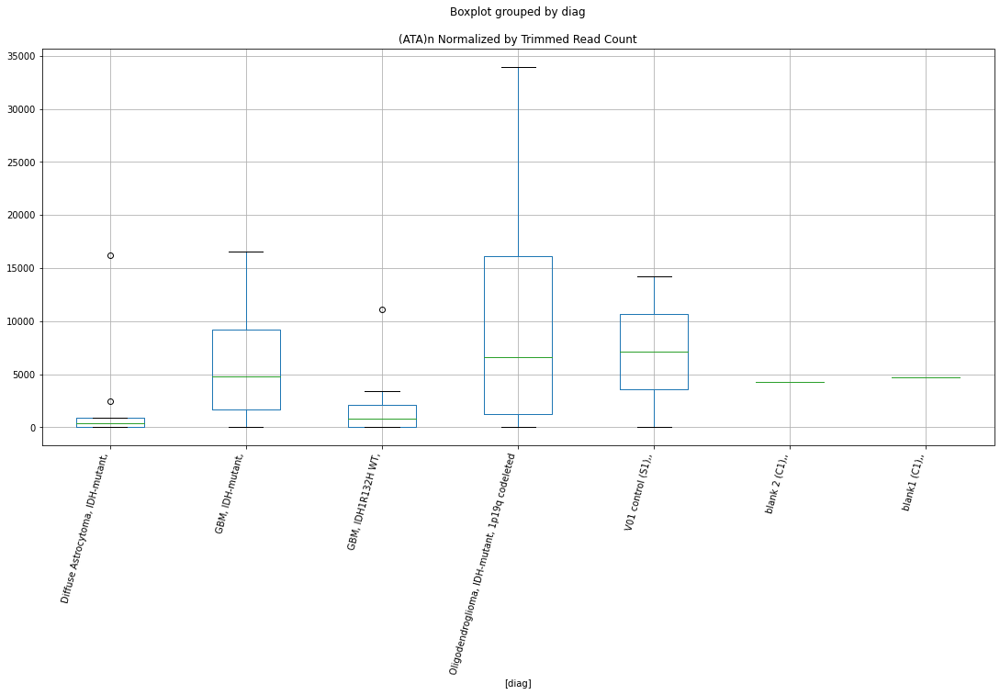

 p : 0.038714031092886264  ( t : 2.2300437043258308 ) :  D-plex  :  bbduk2  :  Tigger18a
Control and blanks
73     10822.12
337    58750.38
Name: Tigger18a, dtype: float64
205    20416.37
Name: Tigger18a, dtype: float64
469    23661.09
Name: Tigger18a, dtype: float64


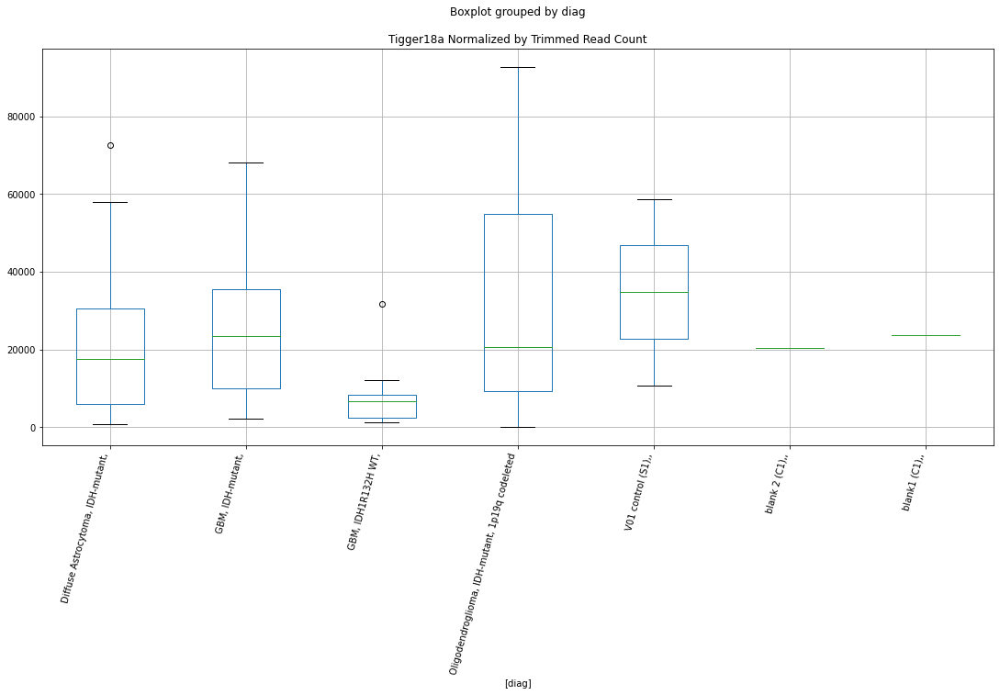

 p : 0.03875080757910488  ( t : 2.2295694999673814 ) :  D-plex  :  bbduk2  :  MER63C
Control and blanks
73      3092.03
337    63201.17
Name: MER63C, dtype: float64
205    17550.91
Name: MER63C, dtype: float64
469    23069.57
Name: MER63C, dtype: float64


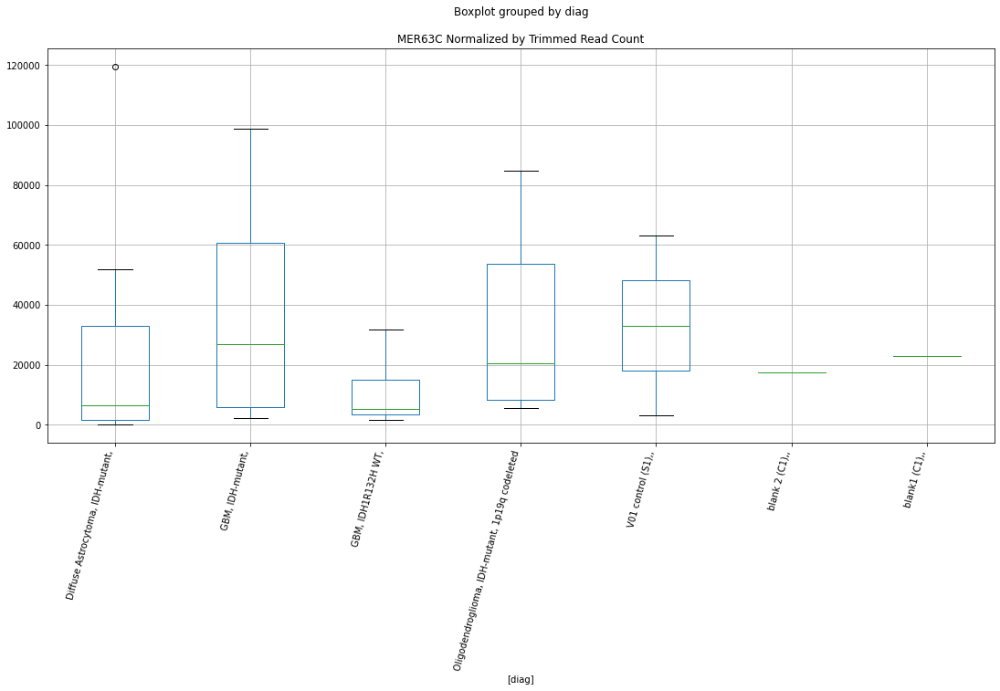

 p : 0.03899080783292515  ( t : 2.2264850219729784 ) :  D-plex  :  bbduk2  :  LTR26E
Control and blanks
73       0.00
337    890.16
Name: LTR26E, dtype: float64
205    2686.36
Name: LTR26E, dtype: float64
469    3549.16
Name: LTR26E, dtype: float64


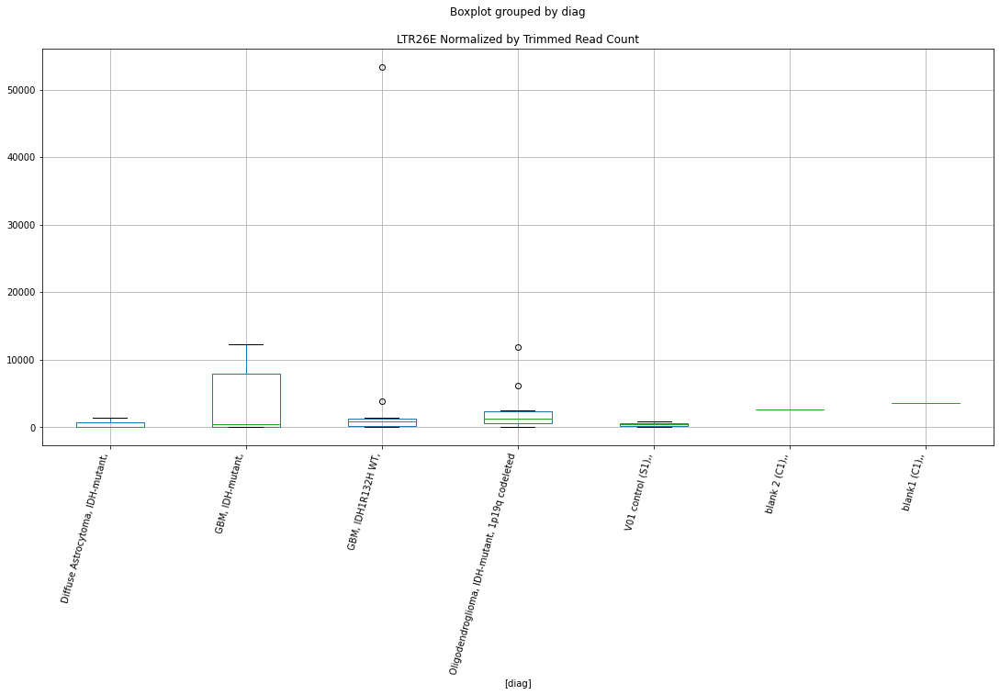

 p : 0.03922529833550978  ( t : 2.2234881934320687 ) :  D-plex  :  bbduk2  :  LTR1A2
Control and blanks
73     24736.27
337        0.00
Name: LTR1A2, dtype: float64
205    23460.91
Name: LTR1A2, dtype: float64
469    24252.62
Name: LTR1A2, dtype: float64


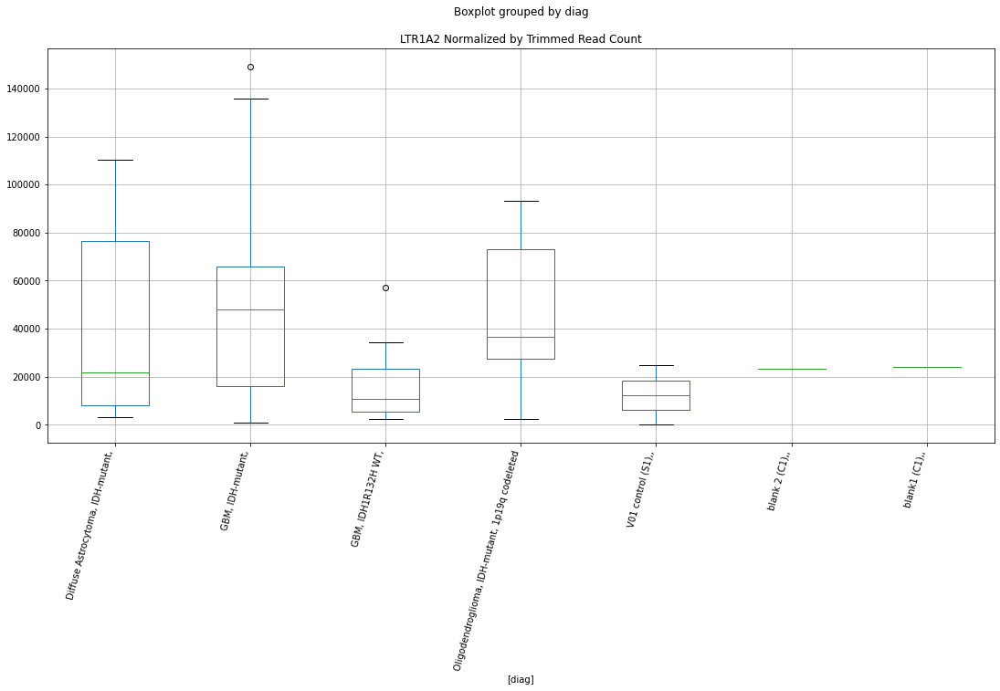

 p : 0.03926075098029524  ( t : 2.223036538548819 ) :  D-plex  :  bbduk2  :  L1M3e
Control and blanks
73     17779.19
337    65871.64
Name: L1M3e, dtype: float64
205    35280.92
Name: L1M3e, dtype: float64
469    40223.86
Name: L1M3e, dtype: float64


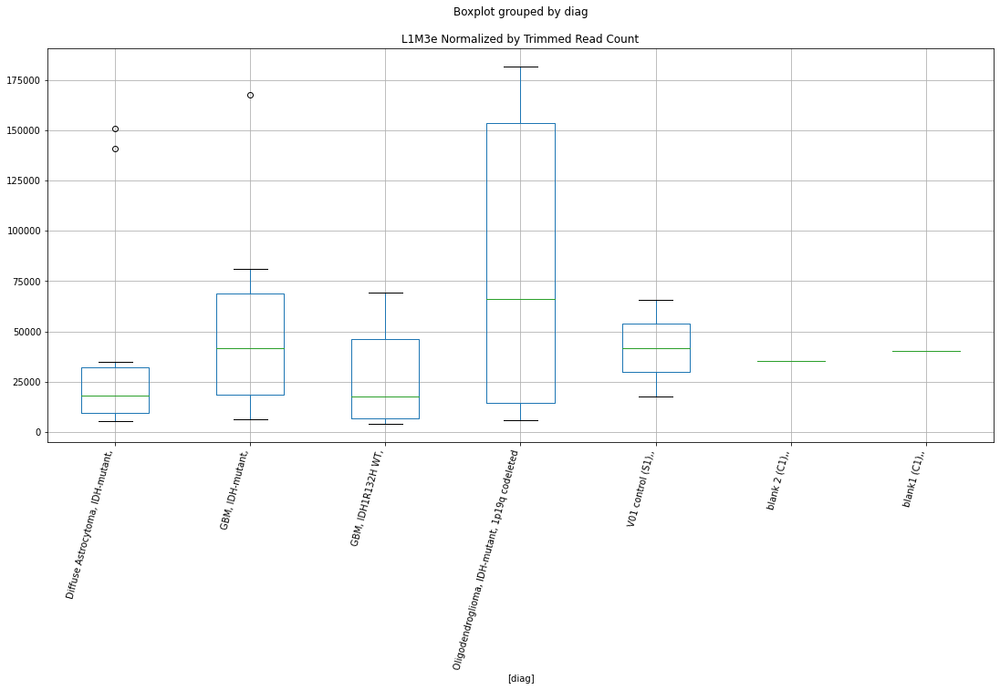

 p : 0.039275269159429846  ( t : 2.2228516901204736 ) :  D-plex  :  bbduk2  :  (CAAGCCAGC)n
Control and blanks
73     0.0
337    0.0
Name: (CAAGCCAGC)n, dtype: float64
205    20953.64
Name: (CAAGCCAGC)n, dtype: float64
469    0.0
Name: (CAAGCCAGC)n, dtype: float64


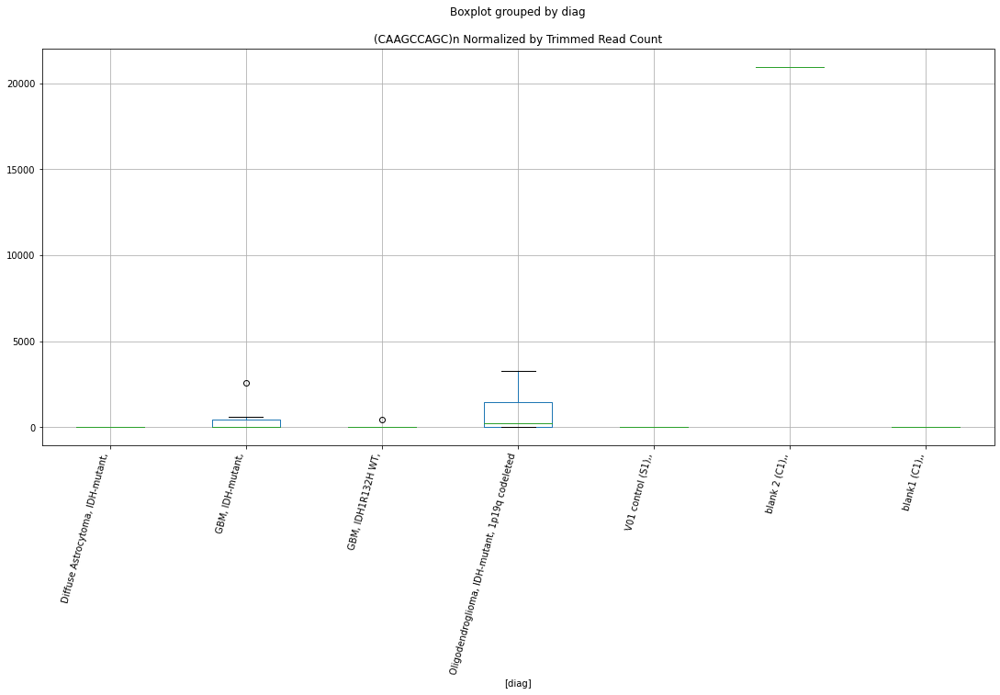

 p : 0.03932156355183144  ( t : 2.222262680171939 ) :  D-plex  :  cutadapt2  :  (TCCC)n
Control and blanks
76     59851.52
340    24660.50
Name: (TCCC)n, dtype: float64
208    16048.78
Name: (TCCC)n, dtype: float64
472    22540.28
Name: (TCCC)n, dtype: float64


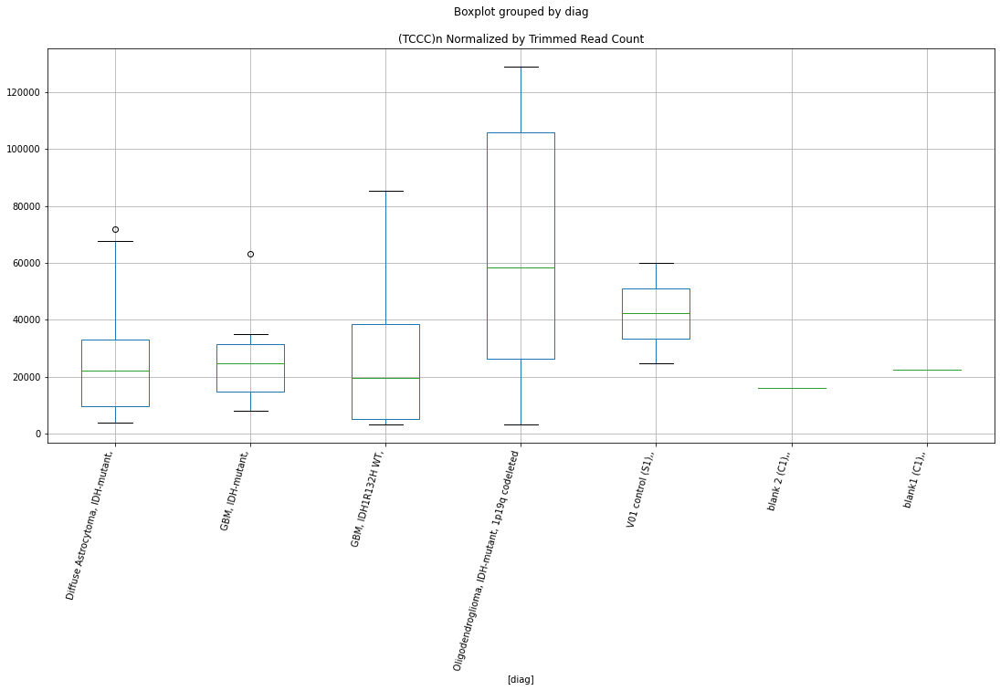

 p : 0.039353182222939195  ( t : 2.2218607581710645 ) :  Lexogen  :  cutadapt2  :  L2
Control and blanks
82        0.00
346    9890.42
Name: L2, dtype: float64
214    0.0
Name: L2, dtype: float64
478    0.0
Name: L2, dtype: float64


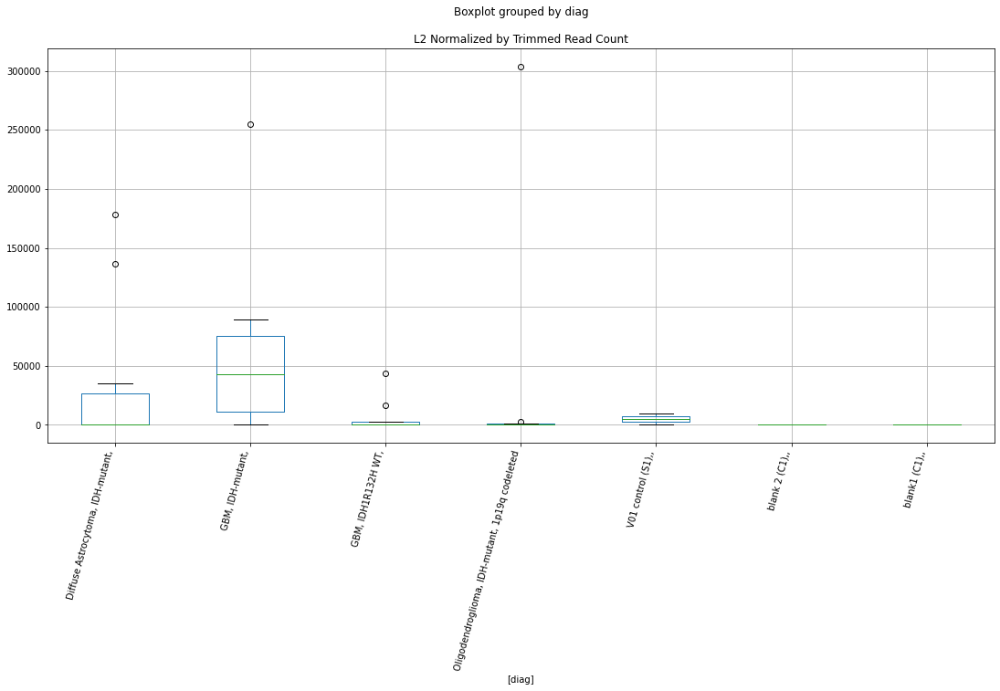

 p : 0.03936308592679234  ( t : 2.2217349279694076 ) :  D-plex  :  cutadapt2  :  MER110
Control and blanks
76     15152.28
340    15853.18
Name: MER110, dtype: float64
208    13227.02
Name: MER110, dtype: float64
472    9247.29
Name: MER110, dtype: float64


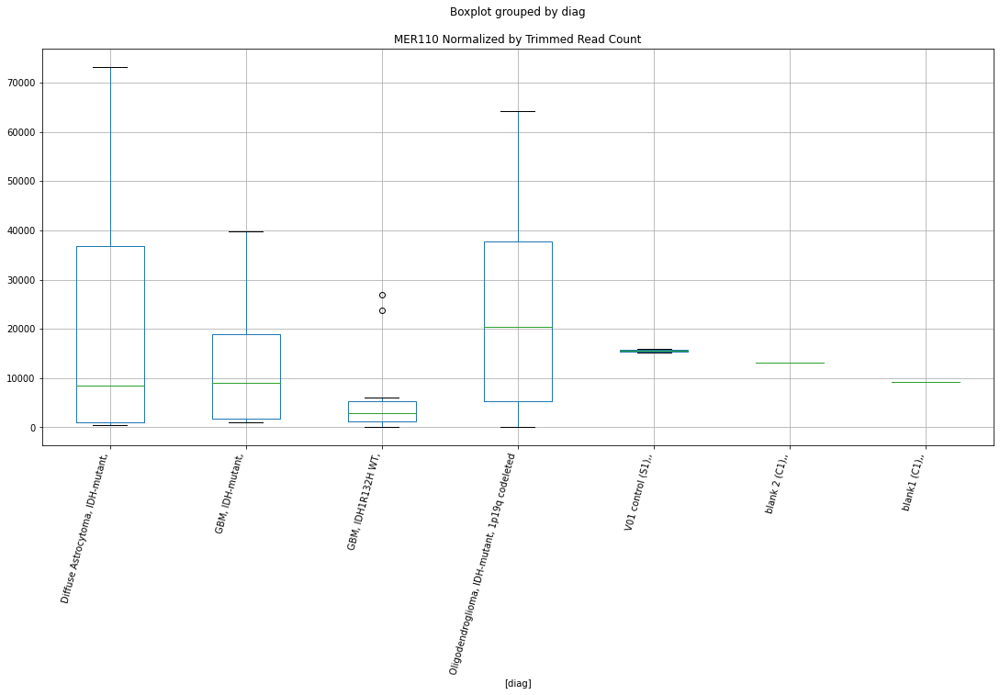

 p : 0.039441005756734634  ( t : 2.2207459430240357 ) :  D-plex  :  cutadapt2  :  MER57A-int
Control and blanks
76     65912.44
340    53724.66
Name: MER57A-int, dtype: float64
208    50968.1
Name: MER57A-int, dtype: float64
472    42190.78
Name: MER57A-int, dtype: float64


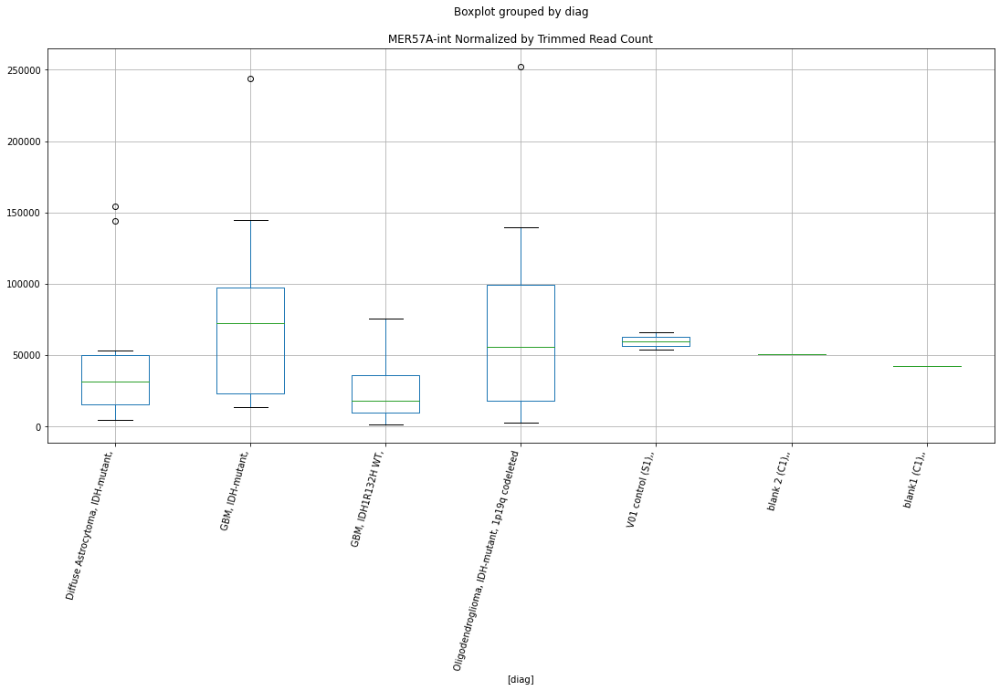

 p : 0.03952176313883411  ( t : 2.219722838544726 ) :  D-plex  :  bbduk2  :  MER102c
Control and blanks
73     32466.35
337    46288.18
Name: MER102c, dtype: float64
205    29012.73
Name: MER102c, dtype: float64
469    27801.78
Name: MER102c, dtype: float64


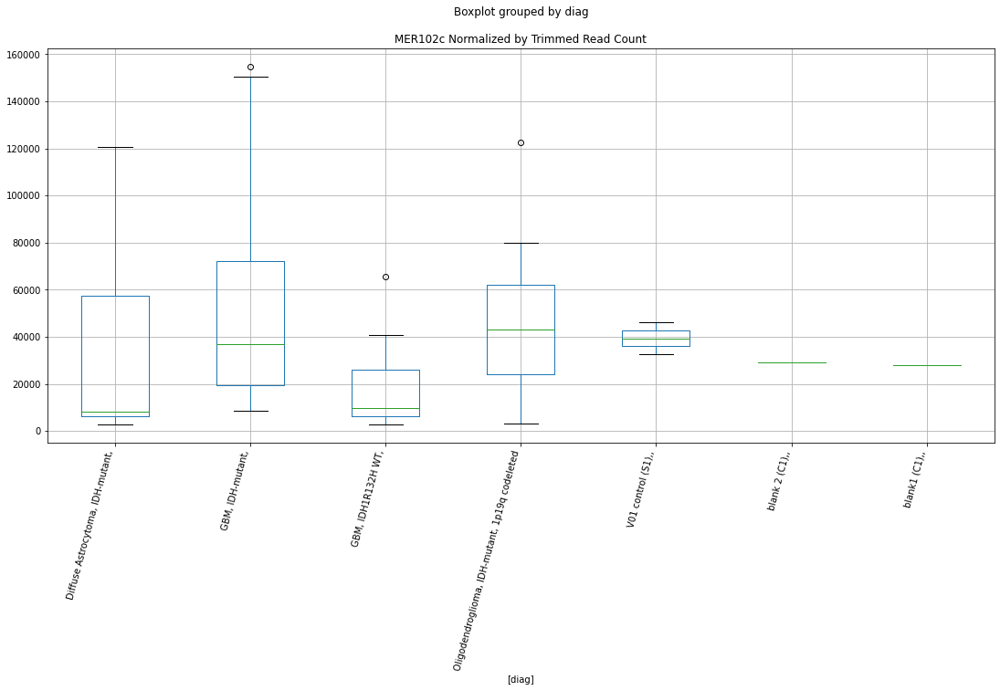

 p : 0.03953342562924705  ( t : 2.219575247008335 ) :  D-plex  :  cutadapt2  :  LTR46-int
Control and blanks
76         0.00
340    21137.57
Name: LTR46-int, dtype: float64
208    6348.97
Name: LTR46-int, dtype: float64
472    4623.65
Name: LTR46-int, dtype: float64


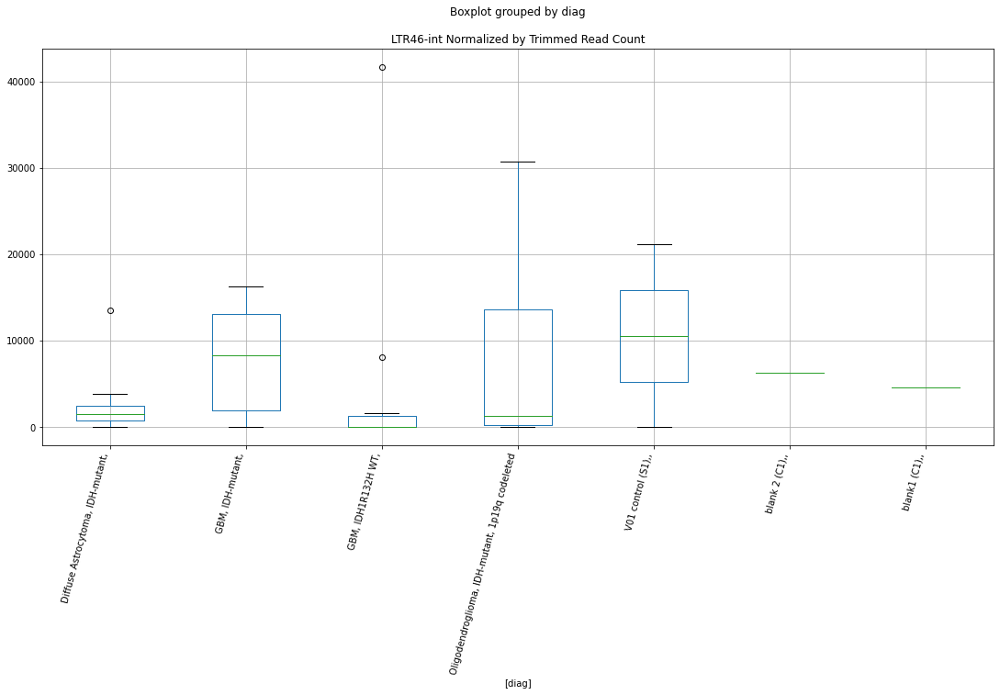

 p : 0.03959666589969478  ( t : 2.218775623579294 ) :  Lexogen  :  cutadapt2  :  tRNA-Glu-GAG_
Control and blanks
82          0.00
346    151723.29
Name: tRNA-Glu-GAG_, dtype: float64
214    19257.08
Name: tRNA-Glu-GAG_, dtype: float64
478    16859.69
Name: tRNA-Glu-GAG_, dtype: float64


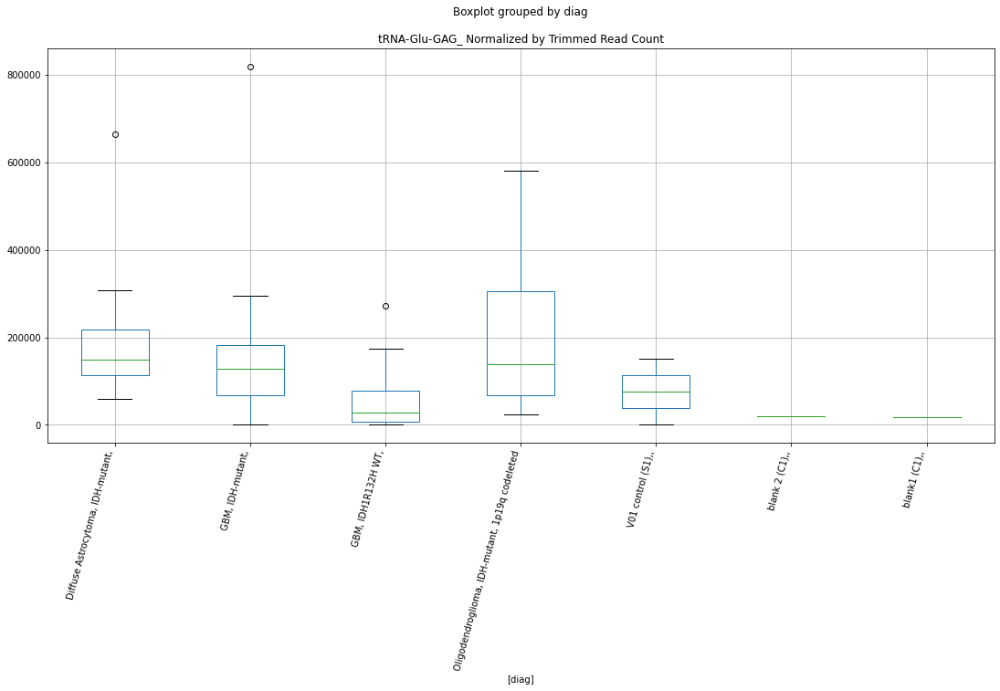

 p : 0.039643978697903905  ( t : 2.2181781585221234 ) :  D-plex  :  bbduk2  :  L1PBa
Control and blanks
73     135276.47
337    459321.15
Name: L1PBa, dtype: float64
205    226550.05
Name: L1PBa, dtype: float64
469    224780.38
Name: L1PBa, dtype: float64


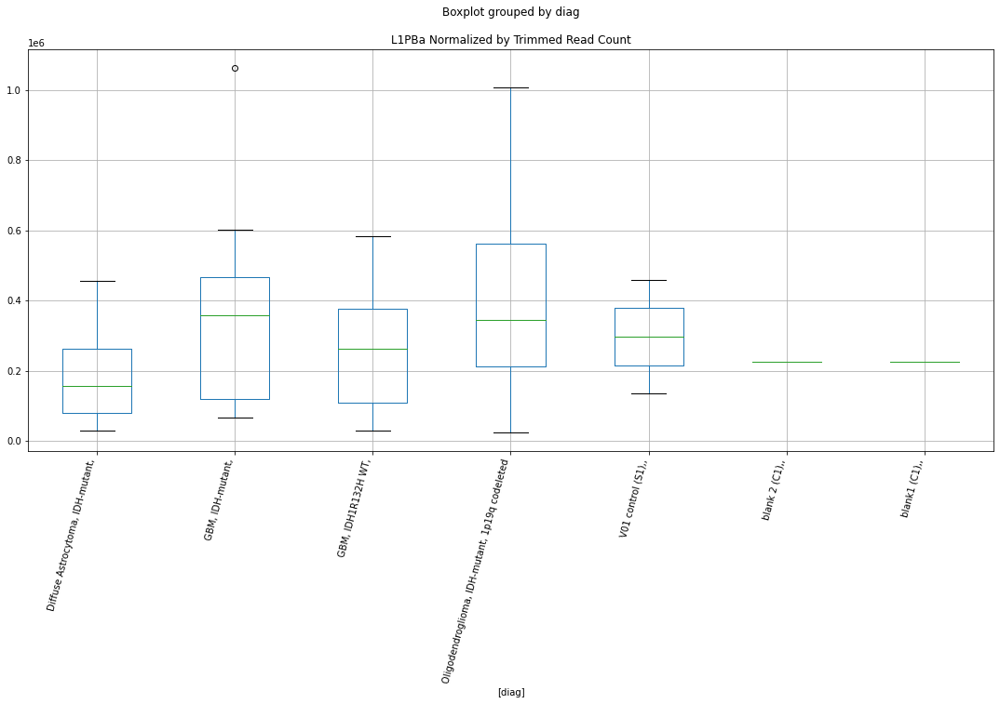

 p : 0.03968695428669916  ( t : 2.2176360319544726 ) :  D-plex  :  cutadapt2  :  (TGT)n
Control and blanks
76     3030.46
340    1761.46
Name: (TGT)n, dtype: float64
208    3527.2
Name: (TGT)n, dtype: float64
472    4045.69
Name: (TGT)n, dtype: float64


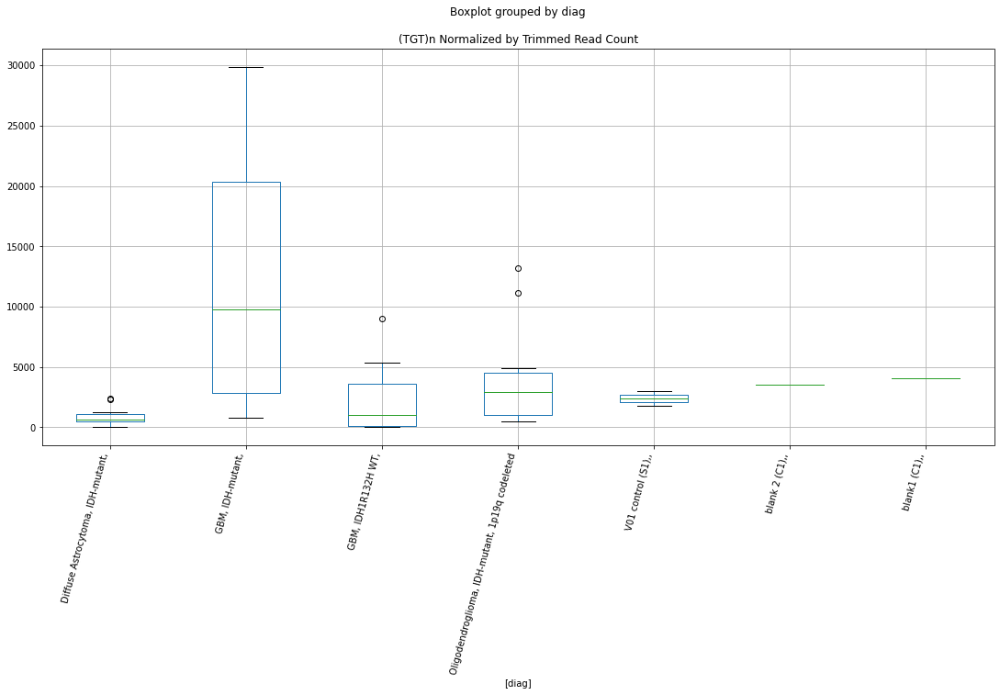

 p : 0.03971143583755906  ( t : 2.2173274445778968 ) :  D-plex  :  bbduk2  :  MER49
Control and blanks
73     27828.30
337      890.16
Name: MER49, dtype: float64
205    27400.92
Name: MER49, dtype: float64
469    21886.51
Name: MER49, dtype: float64


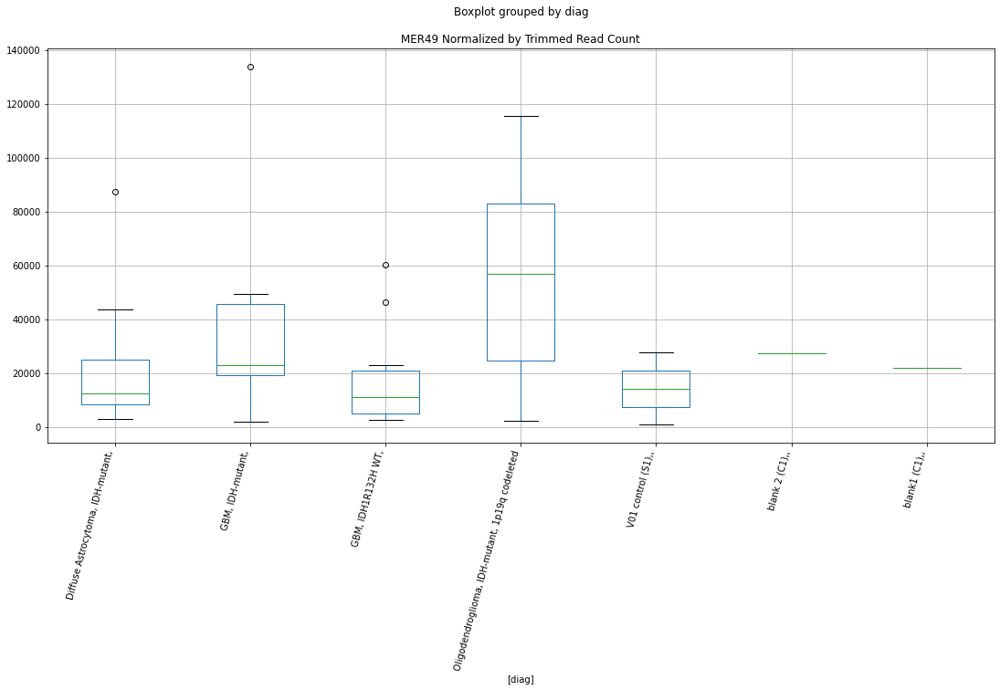

 p : 0.03981377016177636  ( t : 2.216039422964625 ) :  D-plex  :  bbduk2  :  LTR46-int
Control and blanks
73         0.00
337    20473.62
Name: LTR46-int, dtype: float64
205    6268.18
Name: LTR46-int, dtype: float64
469    4140.69
Name: LTR46-int, dtype: float64


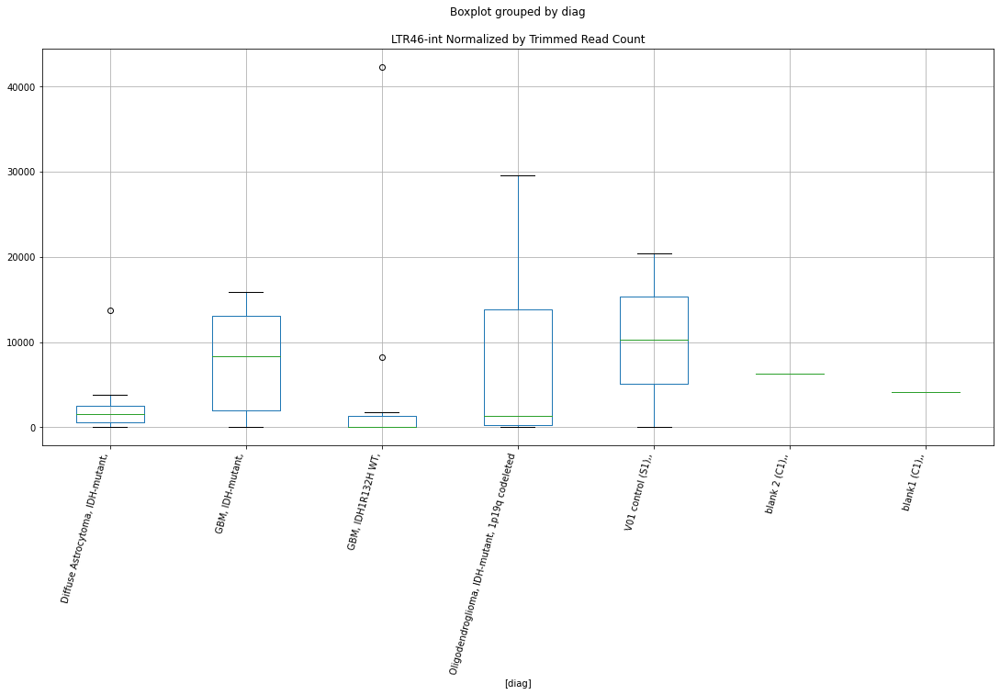

 p : 0.03981764576376932  ( t : 2.2159907029296075 ) :  D-plex  :  bbduk2  :  MER97b
Control and blanks
73     1546.02
337     890.16
Name: MER97b, dtype: float64
205    2507.27
Name: MER97b, dtype: float64
469    2957.64
Name: MER97b, dtype: float64


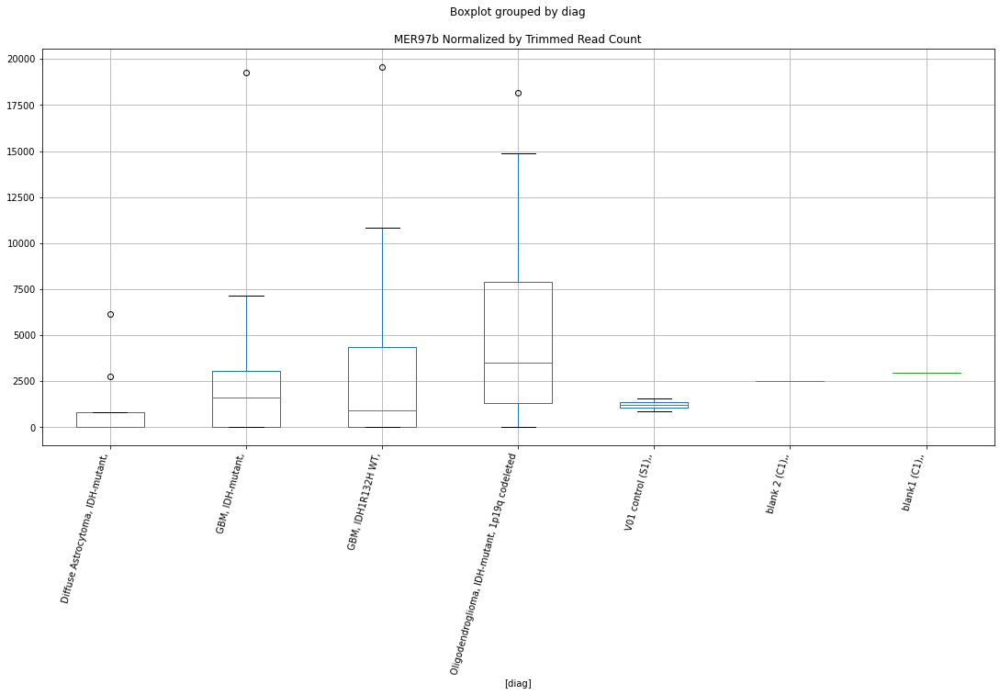

 p : 0.03996186291867838  ( t : 2.2141808488001997 ) :  D-plex  :  cutadapt2  :  L1MEg1
Control and blanks
76      3788.07
340    74862.23
Name: L1MEg1, dtype: float64
208    21515.95
Name: L1MEg1, dtype: float64
472    17338.68
Name: L1MEg1, dtype: float64


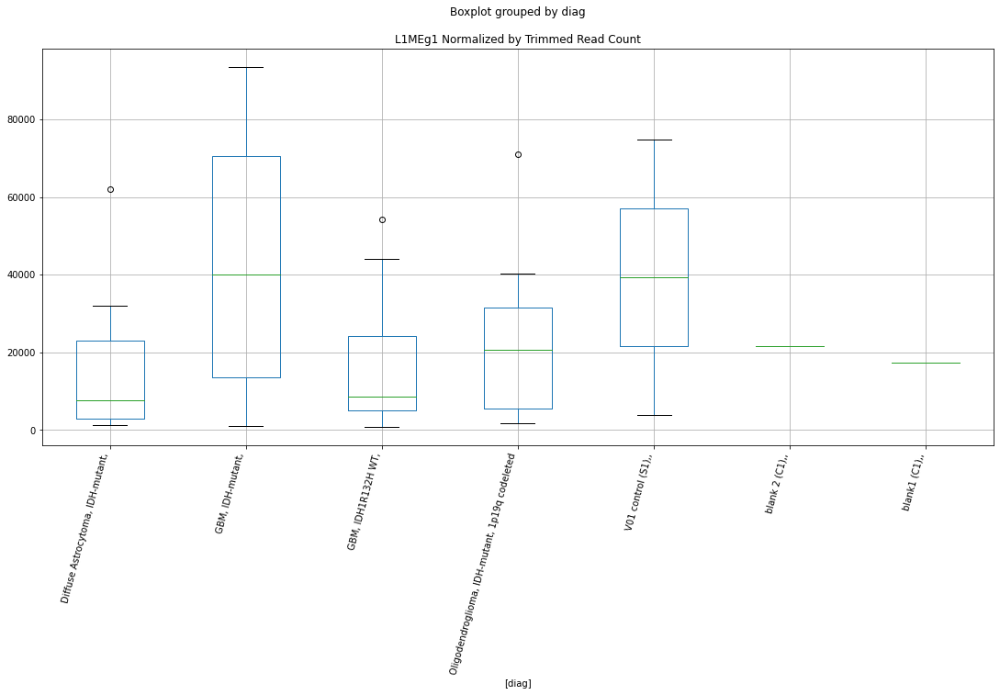

 p : 0.039963541442084534  ( t : 2.2141598195472 ) :  D-plex  :  cutadapt2  :  LTR86C
Control and blanks
76     757.61
340    880.73
Name: LTR86C, dtype: float64
208    5467.17
Name: LTR86C, dtype: float64
472    11559.12
Name: LTR86C, dtype: float64


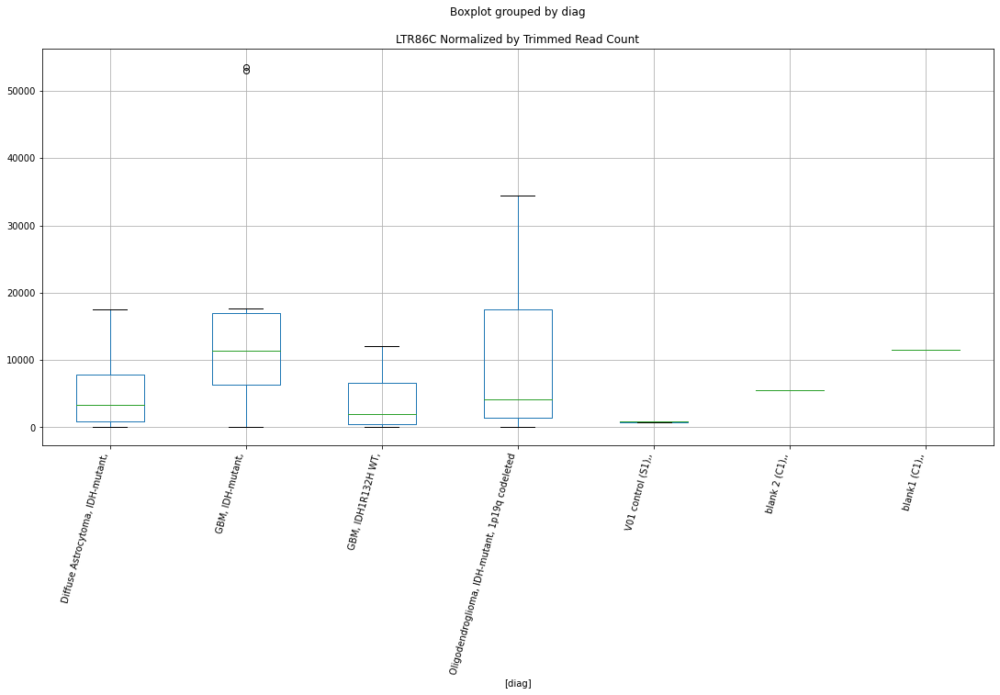

 p : 0.0399860353924546  ( t : 2.213878084153082 ) :  D-plex  :  cutadapt2  :  PABL_B
Control and blanks
76     757.61
340    880.73
Name: PABL_B, dtype: float64
208    7936.21
Name: PABL_B, dtype: float64
472    5201.6
Name: PABL_B, dtype: float64


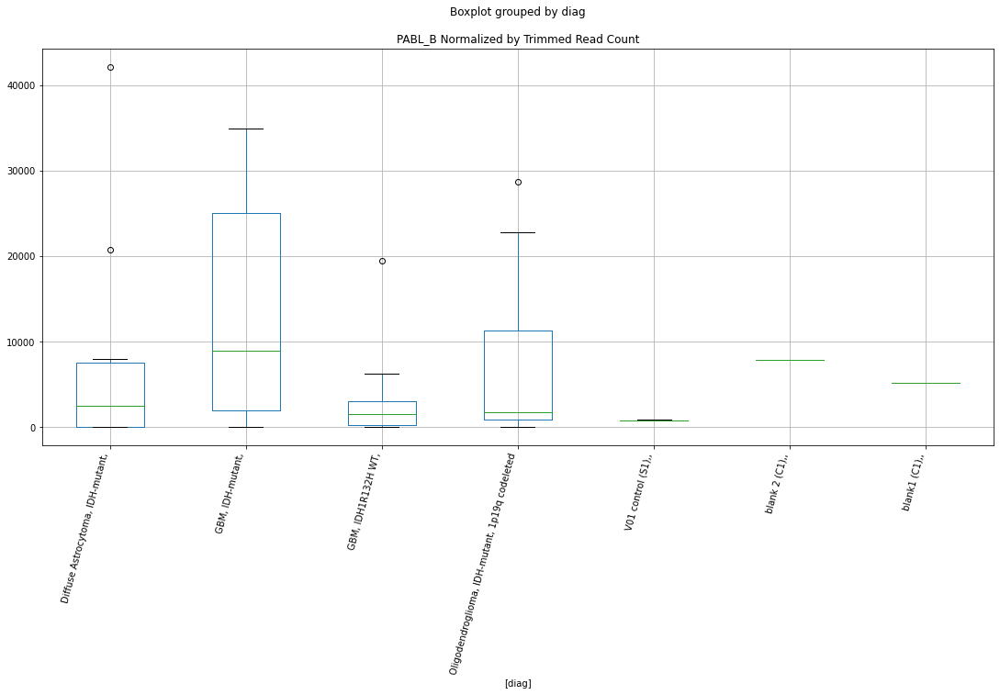

 p : 0.04008442934334141  ( t : 2.212647416382817 ) :  D-plex  :  bbduk2  :  (CTTTCT)n
Control and blanks
73     2319.03
337       0.00
Name: (CTTTCT)n, dtype: float64
205    1074.55
Name: (CTTTCT)n, dtype: float64
469    1774.58
Name: (CTTTCT)n, dtype: float64


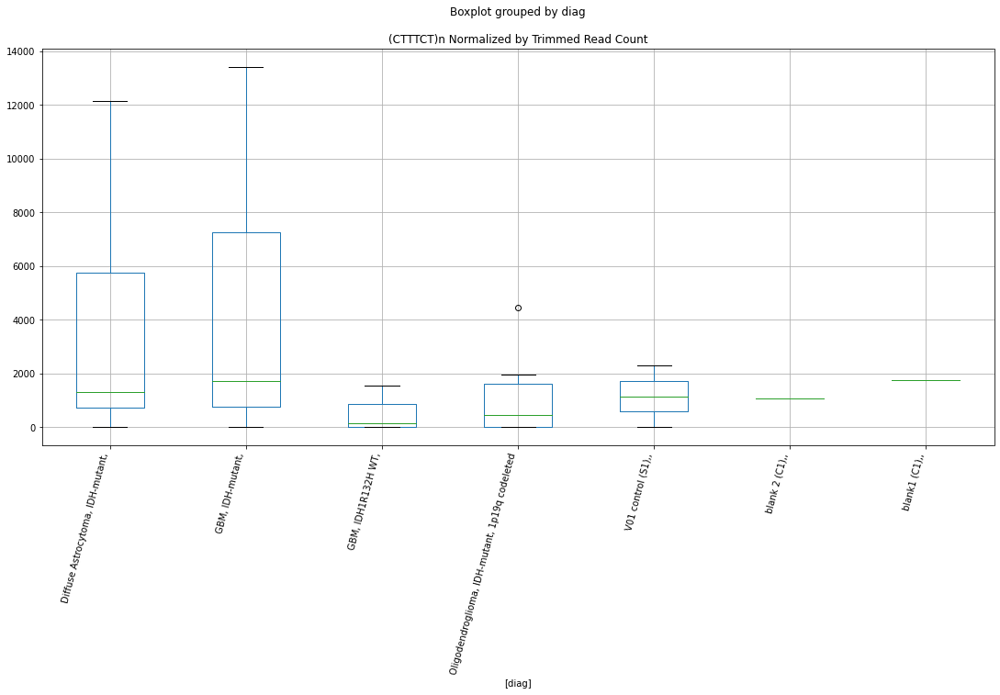

 p : 0.04015315024292384  ( t : 2.211789532429534 ) :  D-plex  :  bbduk2  :  MER87
Control and blanks
73     0.0
337    0.0
Name: MER87, dtype: float64
205    3402.73
Name: MER87, dtype: float64
469    1183.05
Name: MER87, dtype: float64


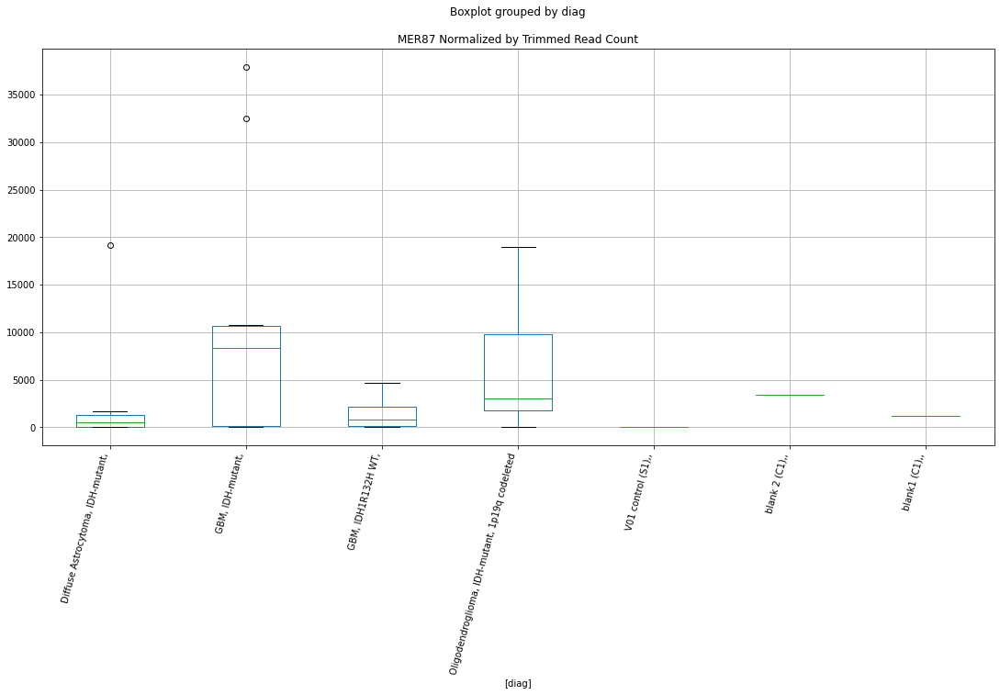

 p : 0.040165349646399263  ( t : 2.2116373811201004 ) :  D-plex  :  bbduk2  :  Charlie1a
Control and blanks
73      52564.57
337    174470.82
Name: Charlie1a, dtype: float64
205    96709.11
Name: Charlie1a, dtype: float64
469    99968.12
Name: Charlie1a, dtype: float64


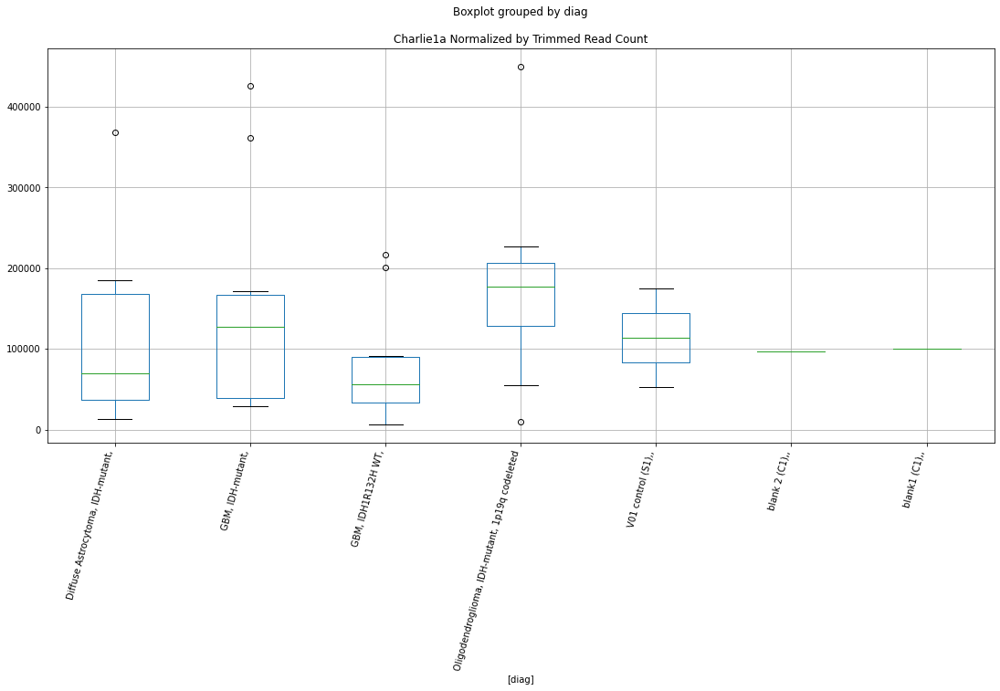

 p : 0.04019236449019597  ( t : 2.2113006023830106 ) :  D-plex  :  cutadapt2  :  Charlie18a
Control and blanks
76      6818.53
340    26421.96
Name: Charlie18a, dtype: float64
208    25572.23
Name: Charlie18a, dtype: float64
472    24852.1
Name: Charlie18a, dtype: float64


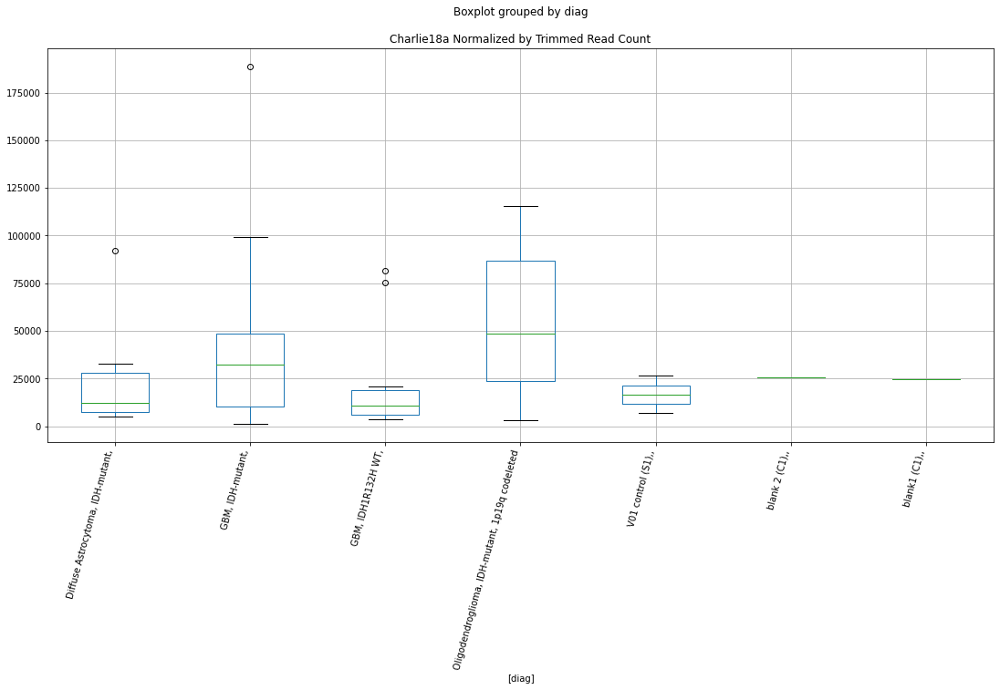

 p : 0.04030803384447162  ( t : 2.209860967292263 ) :  D-plex  :  bbduk2  :  (CCCTCT)n
Control and blanks
73     6957.08
337    3560.63
Name: (CCCTCT)n, dtype: float64
205    3223.64
Name: (CCCTCT)n, dtype: float64
469    5915.27
Name: (CCCTCT)n, dtype: float64


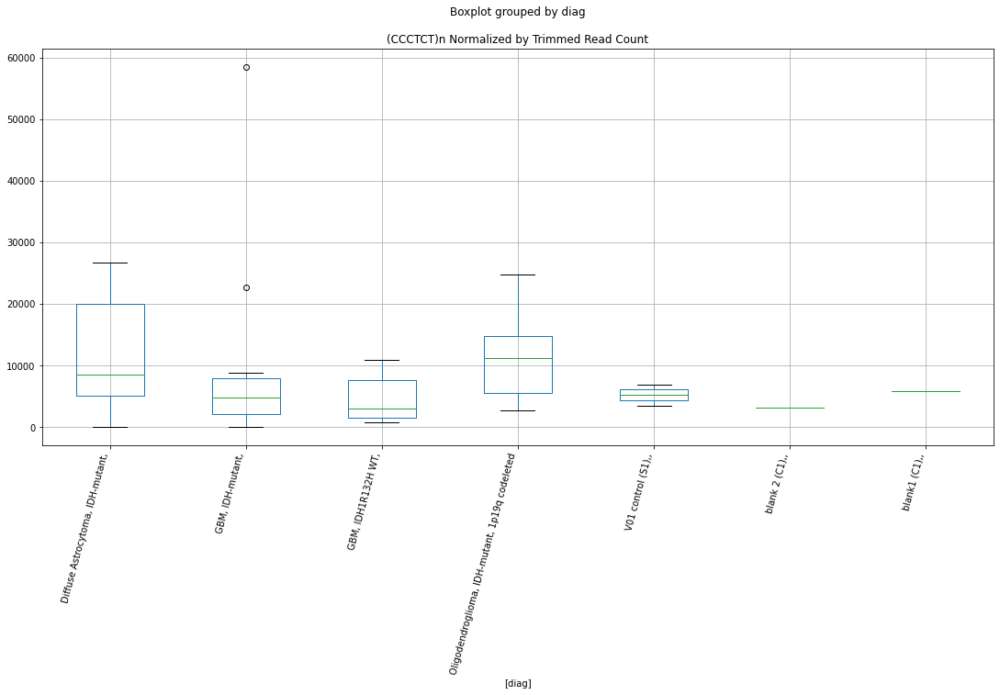

 p : 0.0403207777131224  ( t : 2.2097025878684344 ) :  D-plex  :  cutadapt2  :  Charlie4a
Control and blanks
76      5303.30
340    59889.79
Name: Charlie4a, dtype: float64
208    39857.41
Name: Charlie4a, dtype: float64
472    39301.0
Name: Charlie4a, dtype: float64


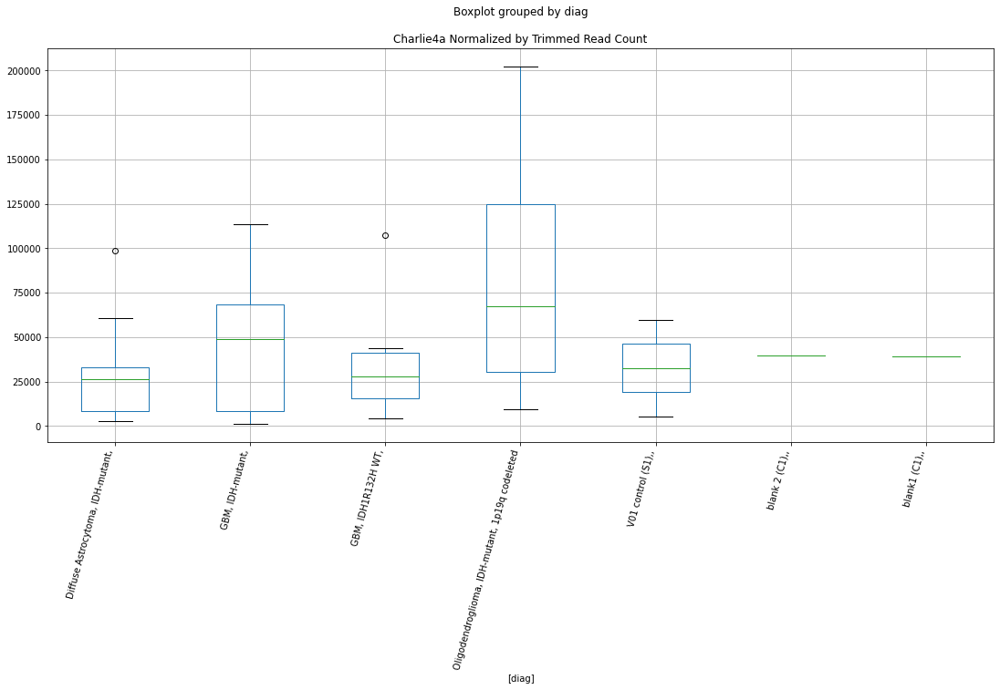

 p : 0.040322313117472745  ( t : 2.209683509135094 ) :  D-plex  :  bbduk2  :  (ATCTAA)n
Control and blanks
73     0.0
337    0.0
Name: (ATCTAA)n, dtype: float64
205    0.0
Name: (ATCTAA)n, dtype: float64
469    0.0
Name: (ATCTAA)n, dtype: float64


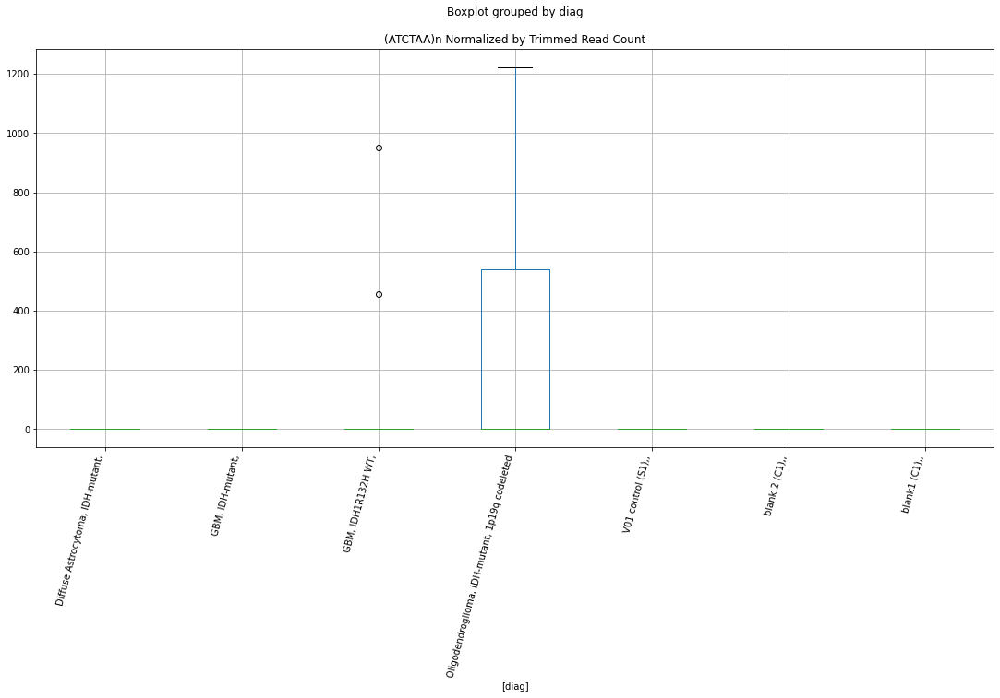

 p : 0.04035954877519799  ( t : 2.209221028091141 ) :  D-plex  :  bbduk2  :  (GGAAGG)n
Control and blanks
73     0.0
337    0.0
Name: (GGAAGG)n, dtype: float64
205    0.0
Name: (GGAAGG)n, dtype: float64
469    0.0
Name: (GGAAGG)n, dtype: float64


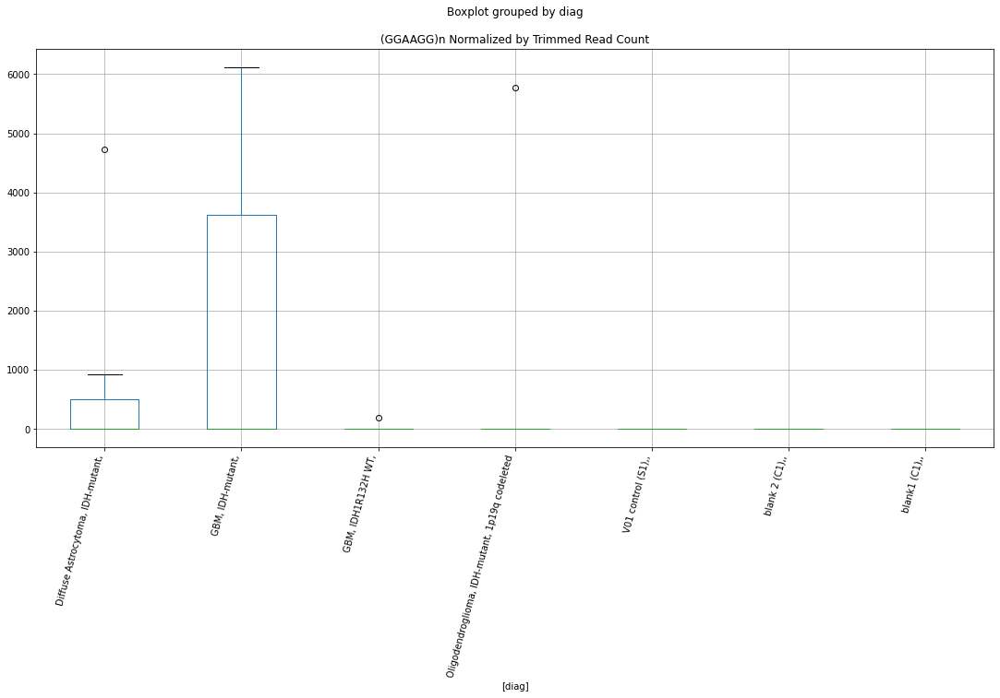

 p : 0.040370534754369865  ( t : 2.2090846529786887 ) :  D-plex  :  bbduk2  :  (CAT)n
Control and blanks
73     0.0
337    0.0
Name: (CAT)n, dtype: float64
205    3940.0
Name: (CAT)n, dtype: float64
469    2957.64
Name: (CAT)n, dtype: float64


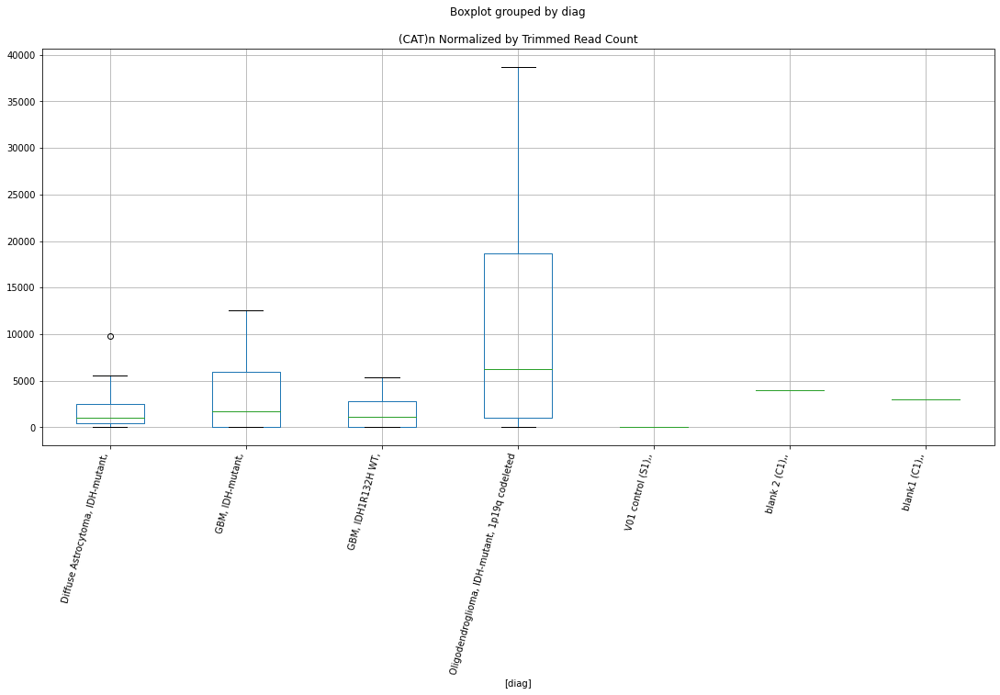

 p : 0.0404484961818774  ( t : 2.208117852936596 ) :  D-plex  :  bbduk2  :  UCON61
Control and blanks
73     0.0
337    0.0
Name: UCON61, dtype: float64
205    1432.73
Name: UCON61, dtype: float64
469    1183.05
Name: UCON61, dtype: float64


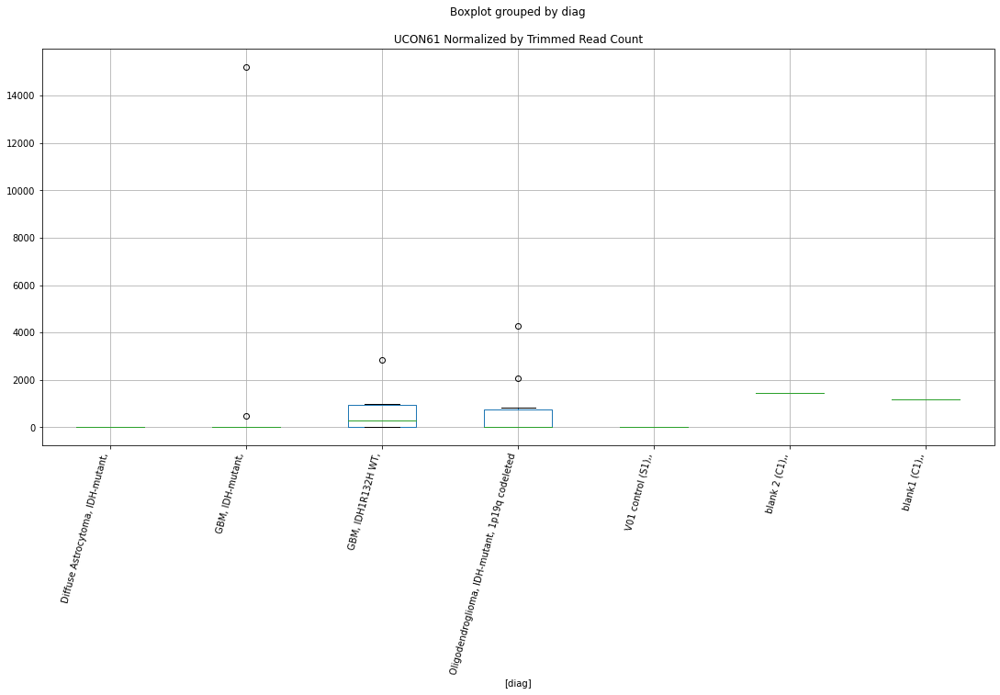

 p : 0.040576854560928514  ( t : 2.2065298050436724 ) :  D-plex  :  cutadapt2  :  (ATCTAA)n
Control and blanks
76     0.0
340    0.0
Name: (ATCTAA)n, dtype: float64
208    0.0
Name: (ATCTAA)n, dtype: float64
472    0.0
Name: (ATCTAA)n, dtype: float64


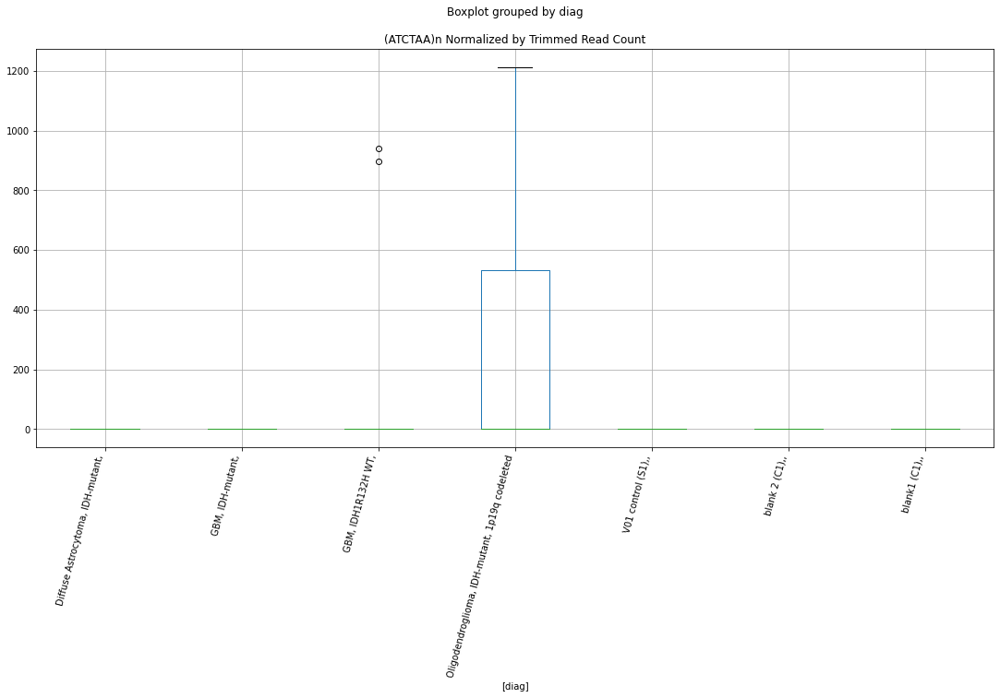

 p : 0.04059414685964246  ( t : 2.206316217970833 ) :  D-plex  :  cutadapt2  :  MLT2C2
Control and blanks
76     31062.18
340      880.73
Name: MLT2C2, dtype: float64
208    14108.82
Name: MLT2C2, dtype: float64
472    15604.81
Name: MLT2C2, dtype: float64


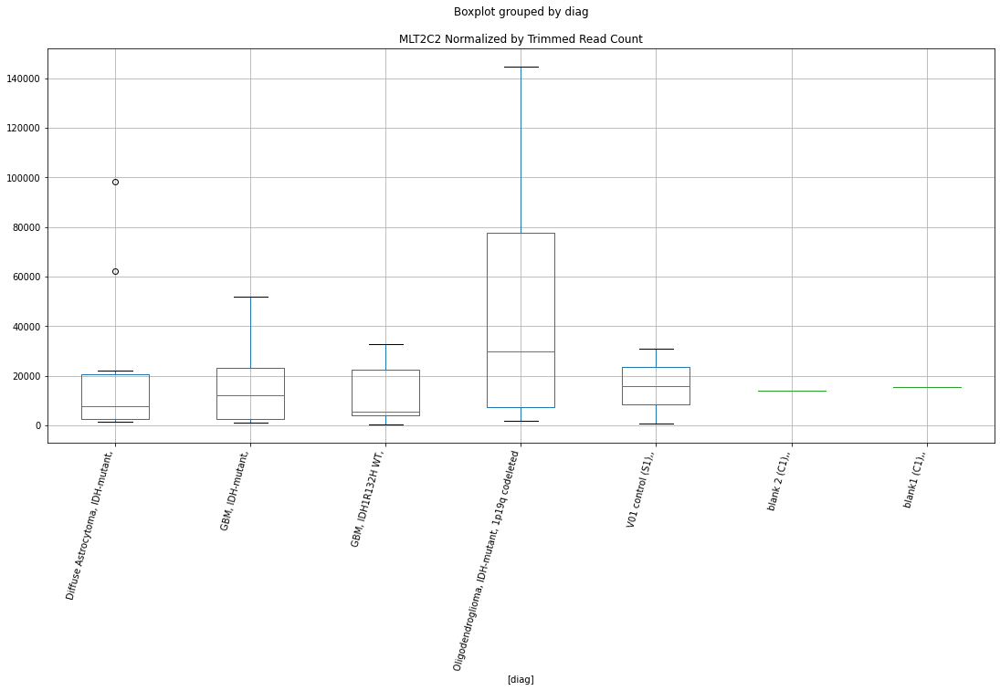

 p : 0.040686233083543265  ( t : 2.20518021453201 ) :  D-plex  :  cutadapt2  :  MLT1C-int
Control and blanks
76     4545.69
340       0.00
Name: MLT1C-int, dtype: float64
208    11639.77
Name: MLT1C-int, dtype: float64
472    8669.34
Name: MLT1C-int, dtype: float64


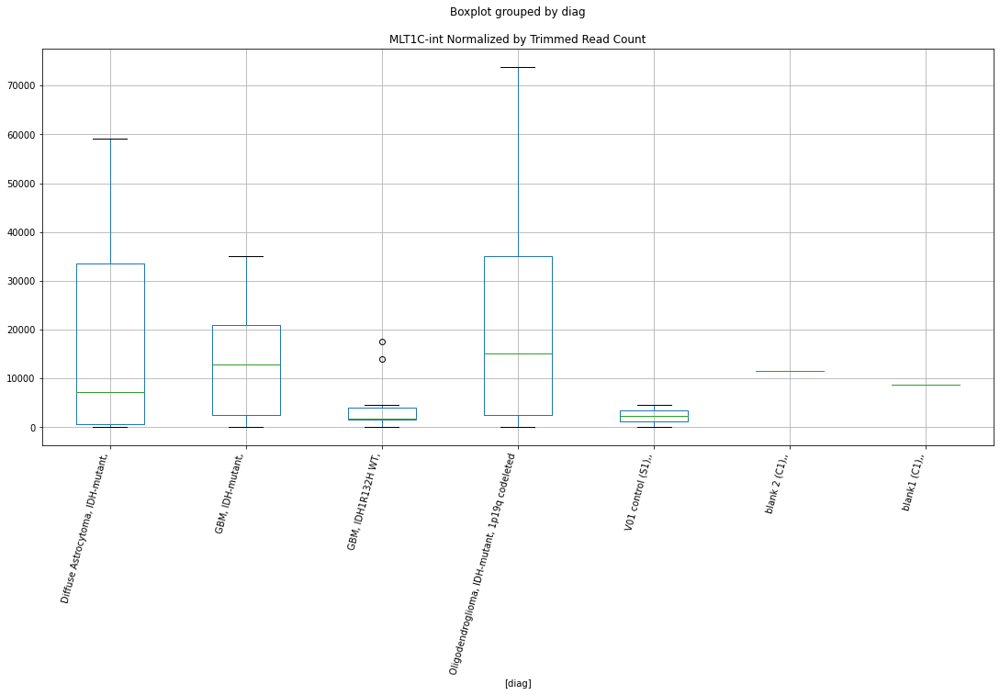

 p : 0.04071171698772405  ( t : 2.2048662547841005 ) :  D-plex  :  bbduk2  :  MamRep1879
Control and blanks
73       773.01
337    11572.04
Name: MamRep1879, dtype: float64
205    12894.55
Name: MamRep1879, dtype: float64
469    13605.13
Name: MamRep1879, dtype: float64


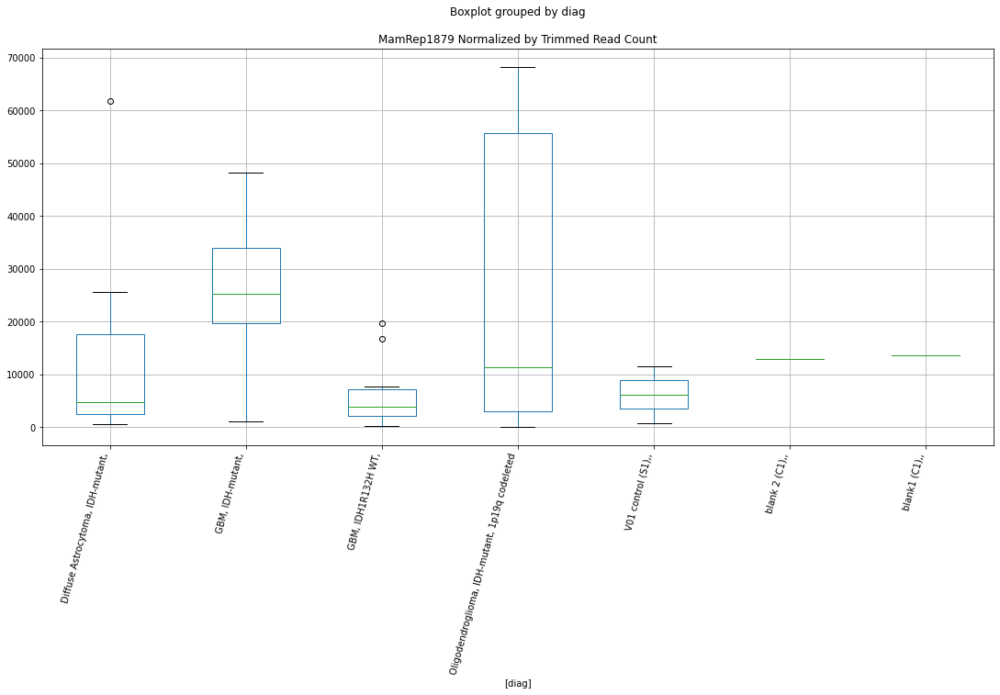

 p : 0.0407787735376905  ( t : 2.204040985111604 ) :  D-plex  :  cutadapt2  :  Tigger12c
Control and blanks
76     1515.23
340       0.00
Name: Tigger12c, dtype: float64
208    7759.85
Name: Tigger12c, dtype: float64
472    6935.47
Name: Tigger12c, dtype: float64


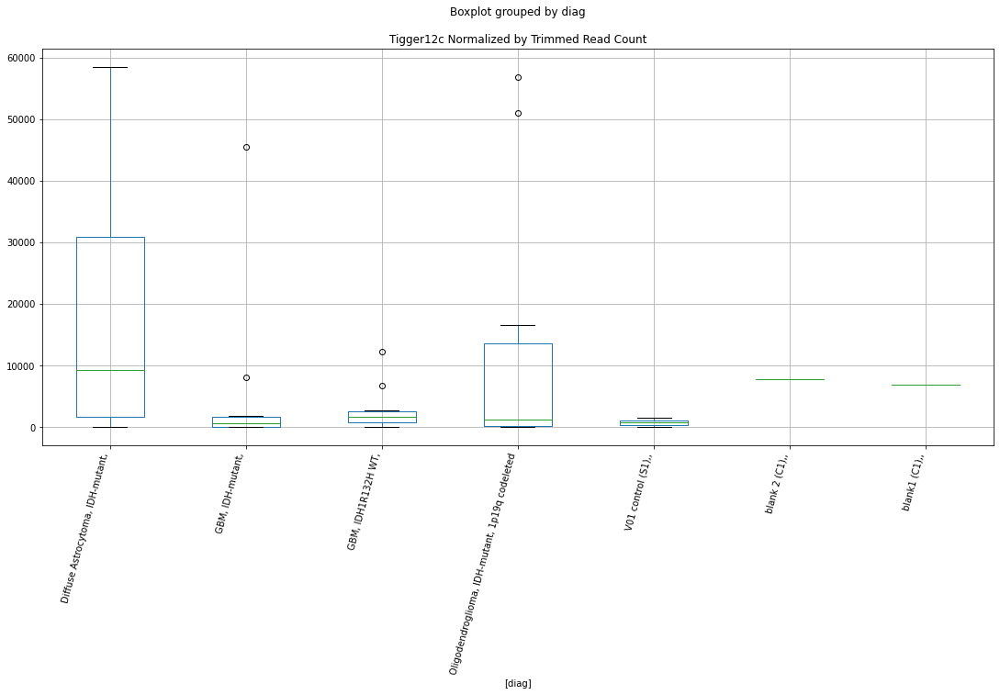

 p : 0.04078284628011683  ( t : 2.2039909017576735 ) :  D-plex  :  bbduk2  :  (CTATT)n
Control and blanks
73     0.0
337    0.0
Name: (CTATT)n, dtype: float64
205    358.18
Name: (CTATT)n, dtype: float64
469    591.53
Name: (CTATT)n, dtype: float64


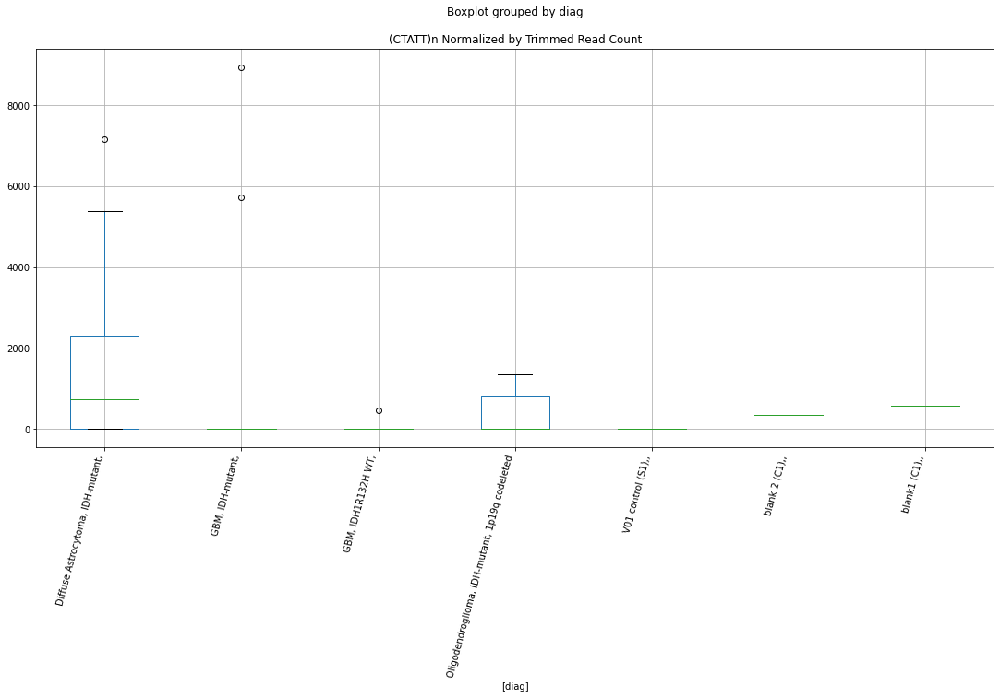

 p : 0.04086153081073501  ( t : 2.2030242026968376 ) :  D-plex  :  cutadapt2  :  HERVL-int
Control and blanks
76      74246.19
340    225467.43
Name: HERVL-int, dtype: float64
208    211808.62
Name: HERVL-int, dtype: float64
472    186679.74
Name: HERVL-int, dtype: float64


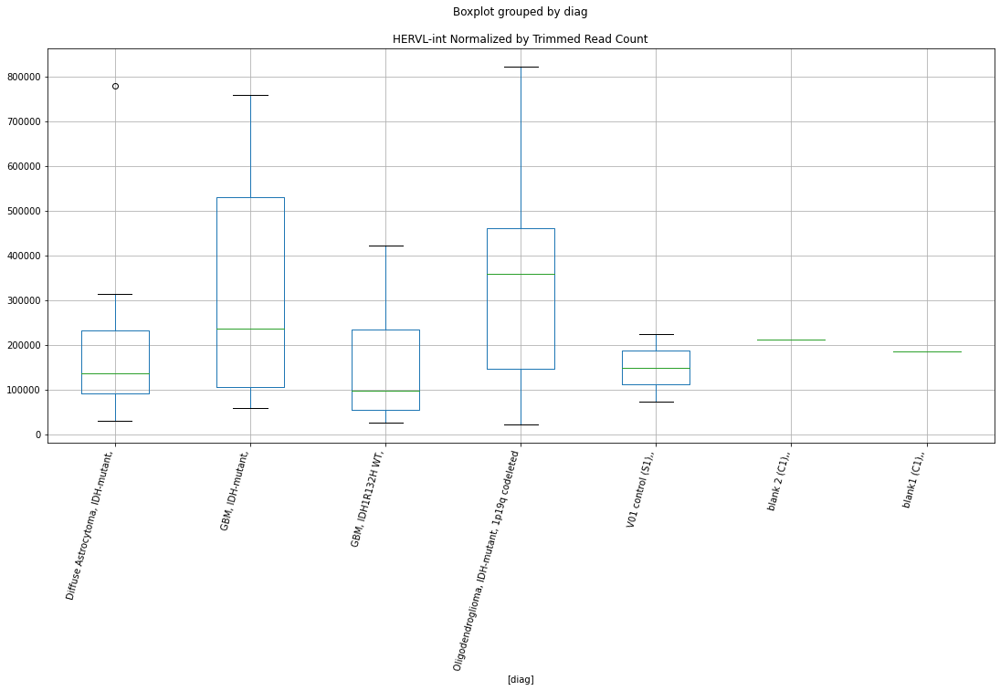

 p : 0.0409259167240885  ( t : 2.2022344443436817 ) :  Lexogen  :  bbduk2  :  L1MB3
Control and blanks
79       0.00
343    212.31
Name: L1MB3, dtype: float64
211    0.0
Name: L1MB3, dtype: float64
475    0.0
Name: L1MB3, dtype: float64


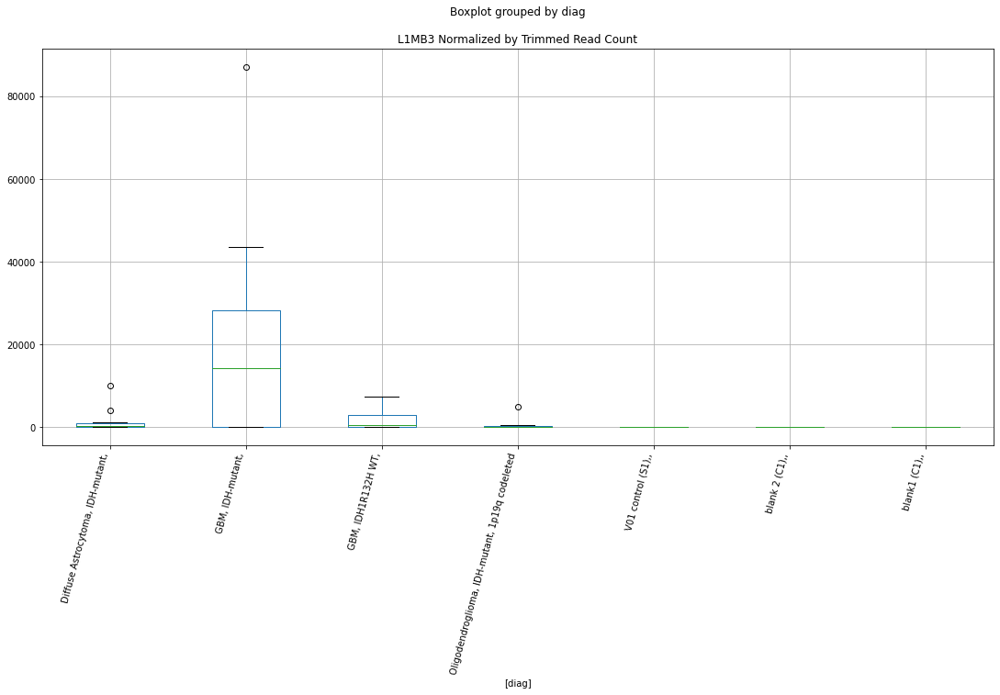

 p : 0.0409364291129527  ( t : 2.202105607661615 ) :  D-plex  :  bbduk2  :  Helitron1Na_Mam
Control and blanks
73       0.00
337    890.16
Name: Helitron1Na_Mam, dtype: float64
205    7163.64
Name: Helitron1Na_Mam, dtype: float64
469    4140.69
Name: Helitron1Na_Mam, dtype: float64


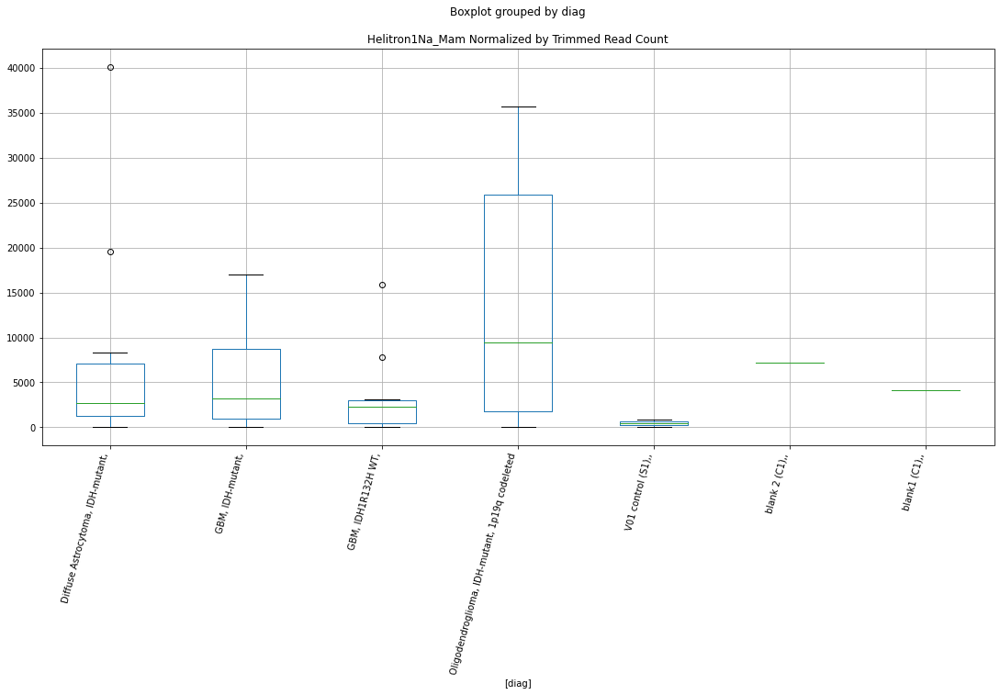

 p : 0.04094603383170582  ( t : 2.2019879216775506 ) :  D-plex  :  bbduk2  :  (TTAA)n
Control and blanks
73       773.01
337    27594.88
Name: (TTAA)n, dtype: float64
205    3223.64
Name: (TTAA)n, dtype: float64
469    1183.05
Name: (TTAA)n, dtype: float64


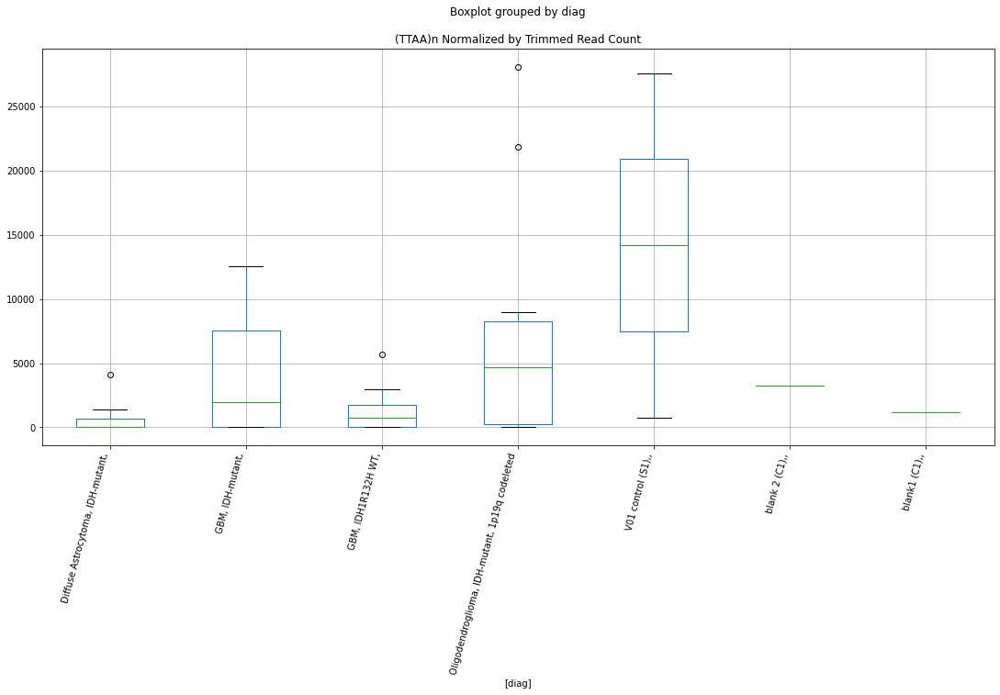

 p : 0.040973705304840624  ( t : 2.201649006656264 ) :  D-plex  :  bbduk2  :  (TGTTA)n
Control and blanks
73     0.0
337    0.0
Name: (TGTTA)n, dtype: float64
205    716.36
Name: (TGTTA)n, dtype: float64
469    591.53
Name: (TGTTA)n, dtype: float64


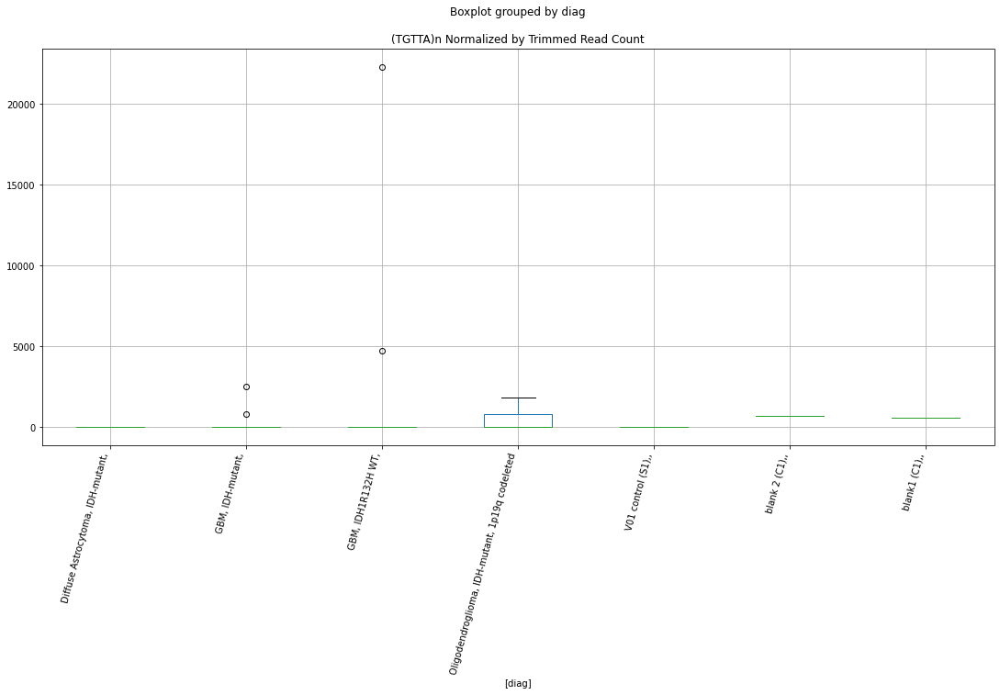

 p : 0.04101838116940921  ( t : 2.201102268501238 ) :  D-plex  :  cutadapt2  :  MER11B
Control and blanks
76     28789.34
340    52843.93
Name: MER11B, dtype: float64
208    20105.06
Name: MER11B, dtype: float64
472    18494.59
Name: MER11B, dtype: float64


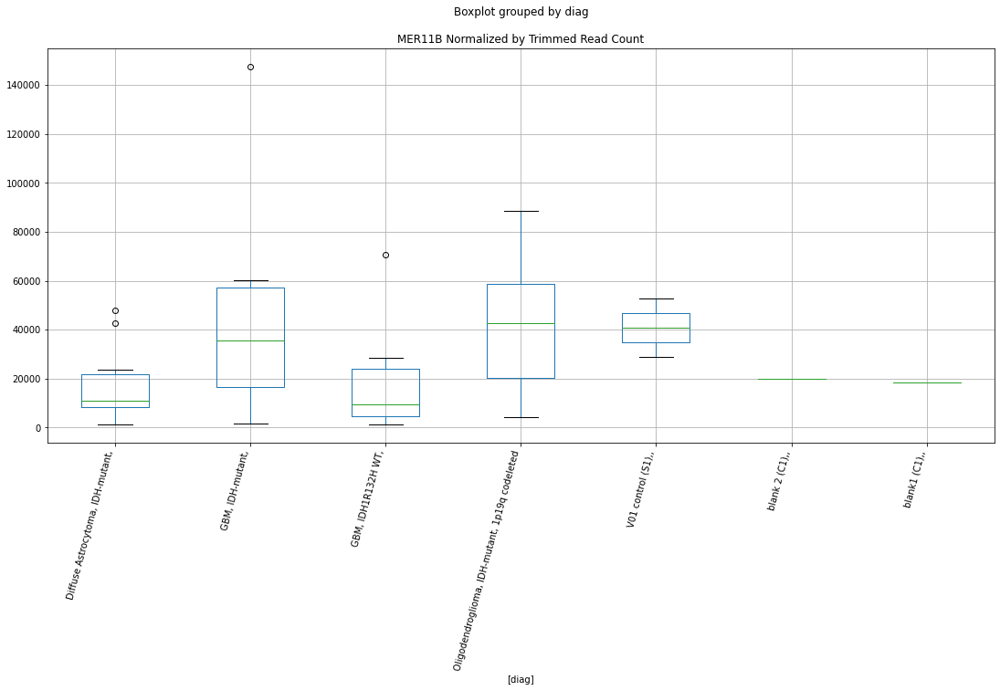

 p : 0.04105908697626273  ( t : 2.2006045914566053 ) :  D-plex  :  bbduk2  :  MSR1
Control and blanks
73     5411.06
337       0.00
Name: MSR1, dtype: float64
205    5193.64
Name: MSR1, dtype: float64
469    5323.75
Name: MSR1, dtype: float64


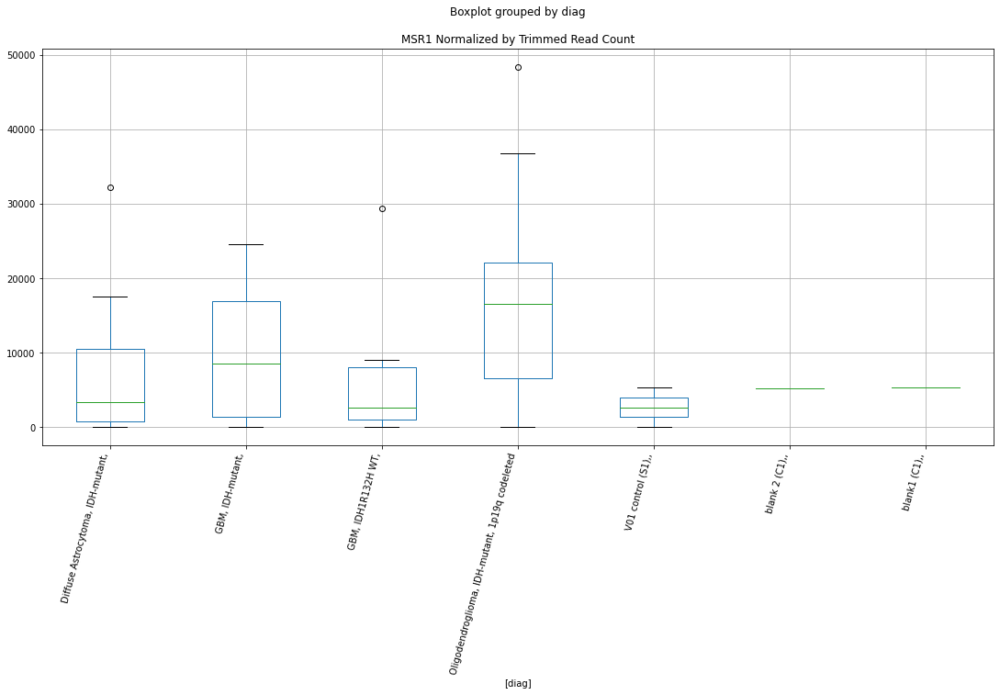

 p : 0.041132090552557836  ( t : 2.1997131696790455 ) :  D-plex  :  bbduk2  :  MLT2C2
Control and blanks
73     31693.34
337     1780.31
Name: MLT2C2, dtype: float64
205    14506.37
Name: MLT2C2, dtype: float64
469    15379.71
Name: MLT2C2, dtype: float64


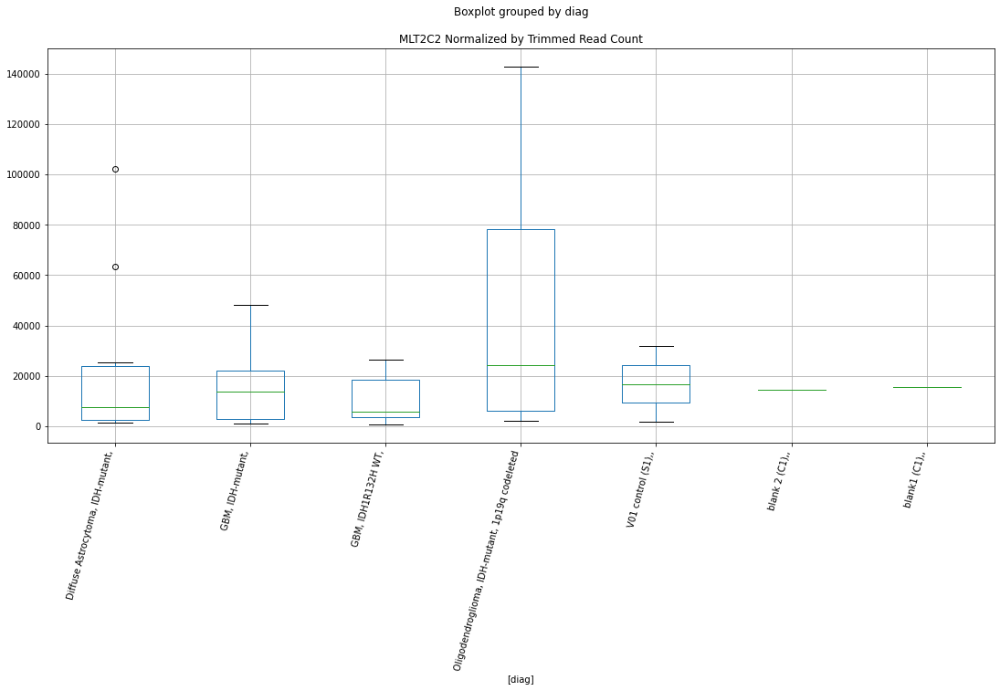

 p : 0.04117417223057059  ( t : 2.1991999846133523 ) :  D-plex  :  bbduk2  :  LTR41C
Control and blanks
73      1546.02
337    30265.35
Name: LTR41C, dtype: float64
205    11640.91
Name: LTR41C, dtype: float64
469    7098.33
Name: LTR41C, dtype: float64


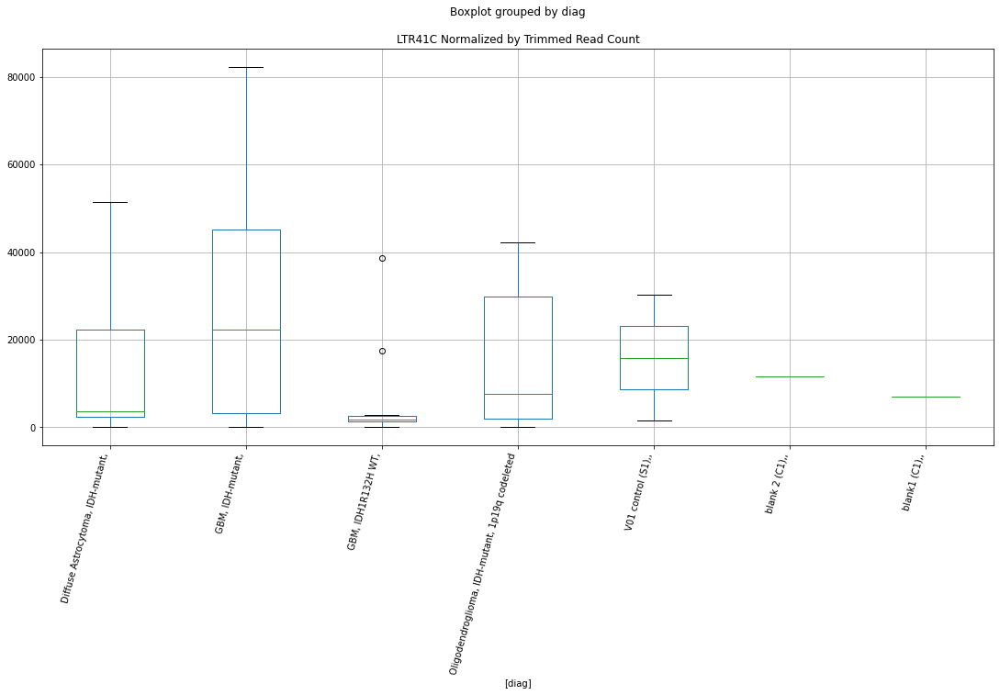

 p : 0.041286529161622953  ( t : 2.1978321505484355 ) :  Lexogen  :  bbduk2  :  tRNA-Glu-GAG_
Control and blanks
79          0.00
343    151804.74
Name: tRNA-Glu-GAG_, dtype: float64
211    19404.75
Name: tRNA-Glu-GAG_, dtype: float64
475    16526.59
Name: tRNA-Glu-GAG_, dtype: float64


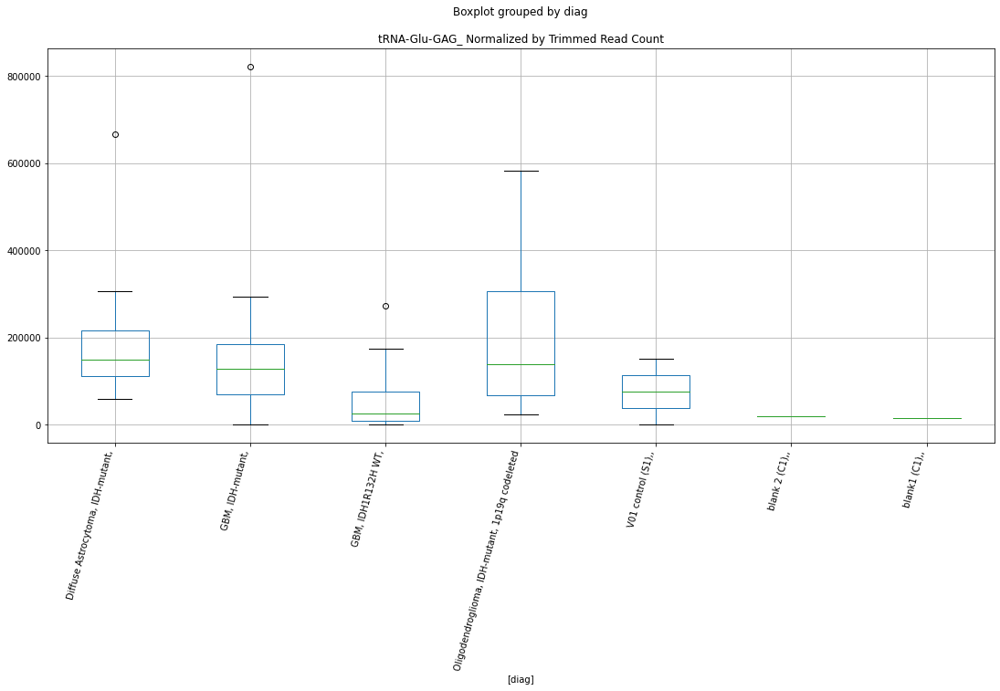

 p : 0.041319674456668475  ( t : 2.1974292923590886 ) :  D-plex  :  cutadapt2  :  MER57B2
Control and blanks
76     37880.71
340        0.00
Name: MER57B2, dtype: float64
208    17636.02
Name: MER57B2, dtype: float64
472    16760.72
Name: MER57B2, dtype: float64


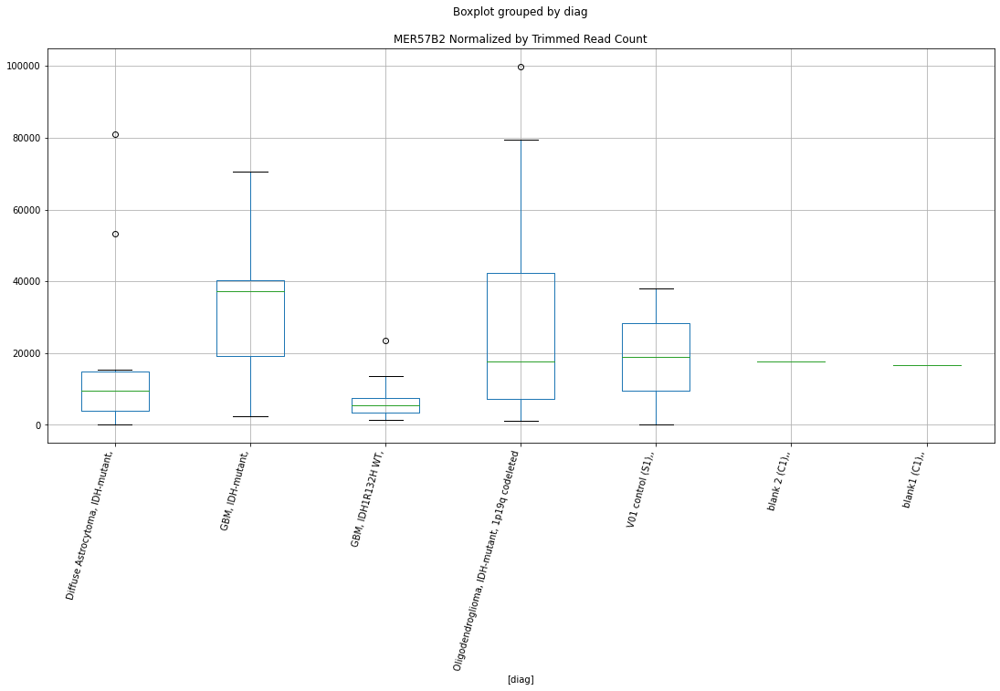

 p : 0.04135944229209078  ( t : 2.1969463331338086 ) :  D-plex  :  bbduk2  :  (TGAA)n
Control and blanks
73      773.01
337    1780.31
Name: (TGAA)n, dtype: float64
205    6447.27
Name: (TGAA)n, dtype: float64
469    4732.22
Name: (TGAA)n, dtype: float64


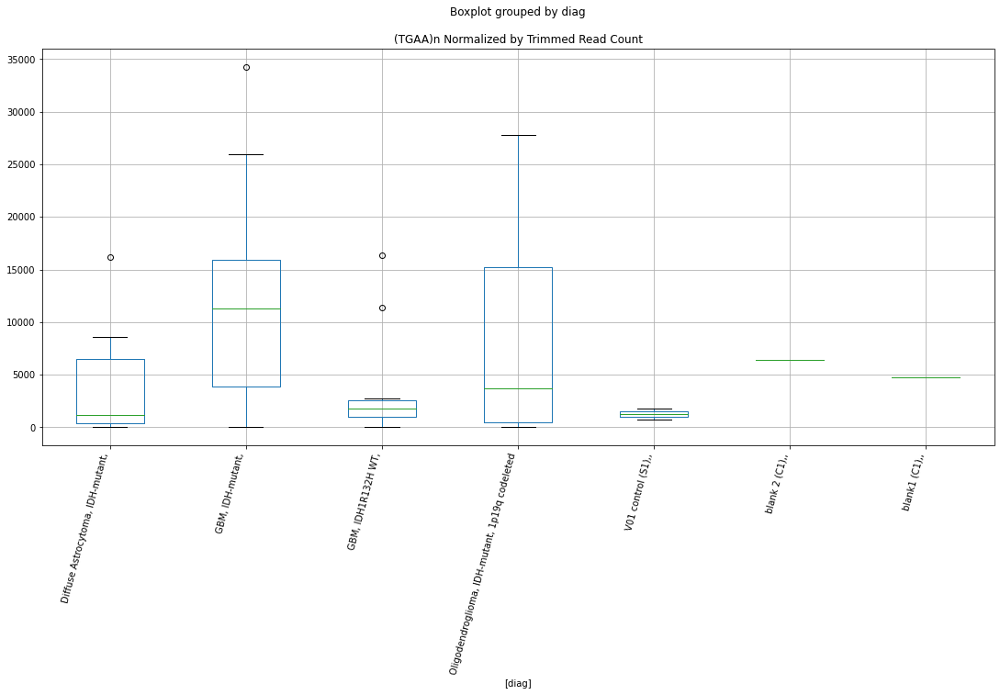

 p : 0.04139720115892794  ( t : 2.1964881661853344 ) :  D-plex  :  bbduk2  :  LTR33A
Control and blanks
73     20871.23
337    42727.55
Name: LTR33A, dtype: float64
205    35460.01
Name: LTR33A, dtype: float64
469    29576.37
Name: LTR33A, dtype: float64


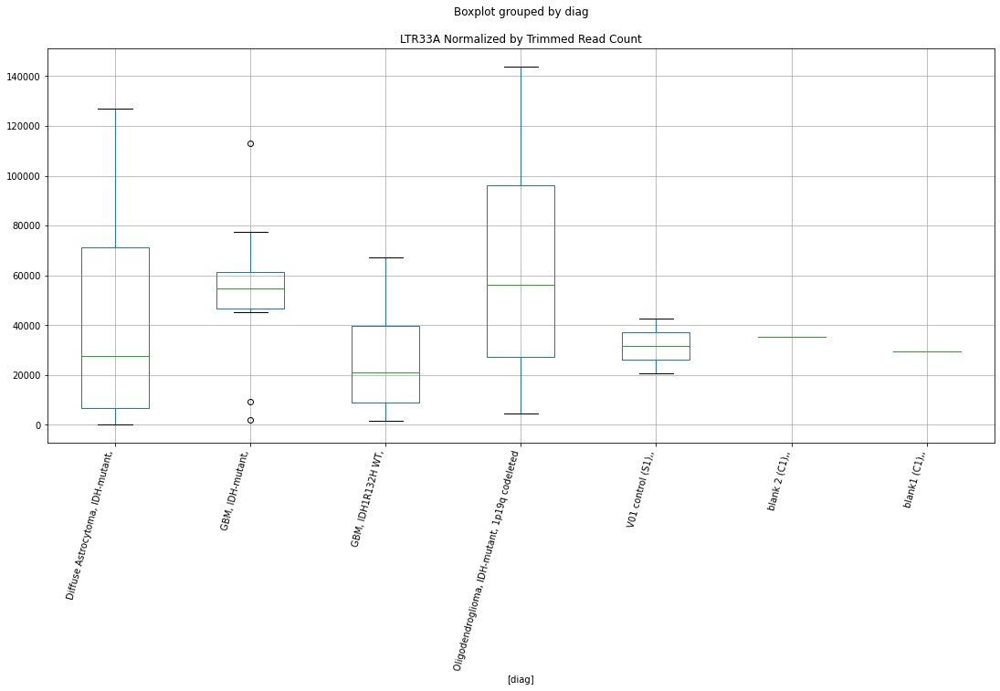

 p : 0.04145394876489935  ( t : 2.195800310509813 ) :  D-plex  :  bbduk2  :  Tigger11a
Control and blanks
73     1546.02
337     890.16
Name: Tigger11a, dtype: float64
205    4835.46
Name: Tigger11a, dtype: float64
469    5915.27
Name: Tigger11a, dtype: float64


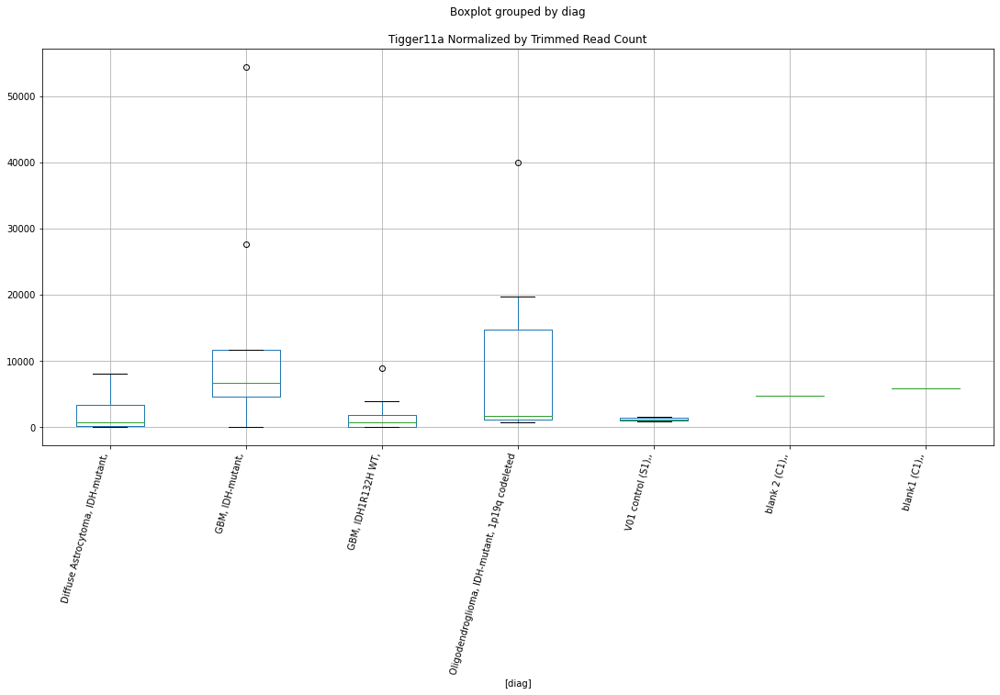

 p : 0.04160081745924438  ( t : 2.194024074054225 ) :  D-plex  :  cutadapt2  :  MER97b
Control and blanks
76     1515.23
340     880.73
Name: MER97b, dtype: float64
208    2645.4
Name: MER97b, dtype: float64
472    3467.74
Name: MER97b, dtype: float64


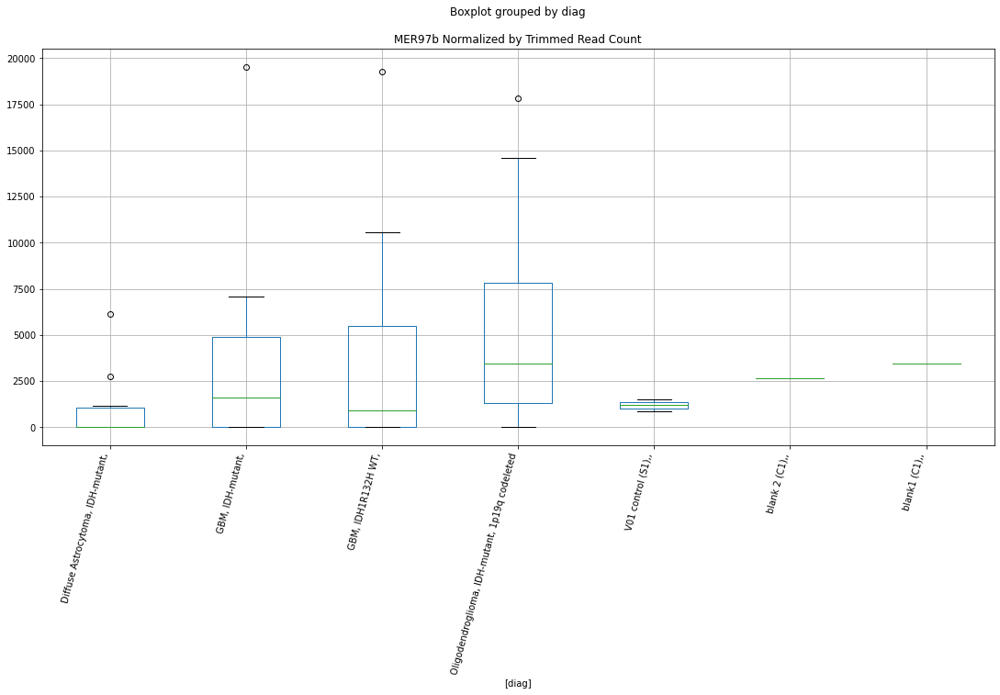

 p : 0.041632387373023355  ( t : 2.1936430178459765 ) :  D-plex  :  cutadapt2  :  (TCATCA)n
Control and blanks
76     0.0
340    0.0
Name: (TCATCA)n, dtype: float64
208    1763.6
Name: (TCATCA)n, dtype: float64
472    577.96
Name: (TCATCA)n, dtype: float64


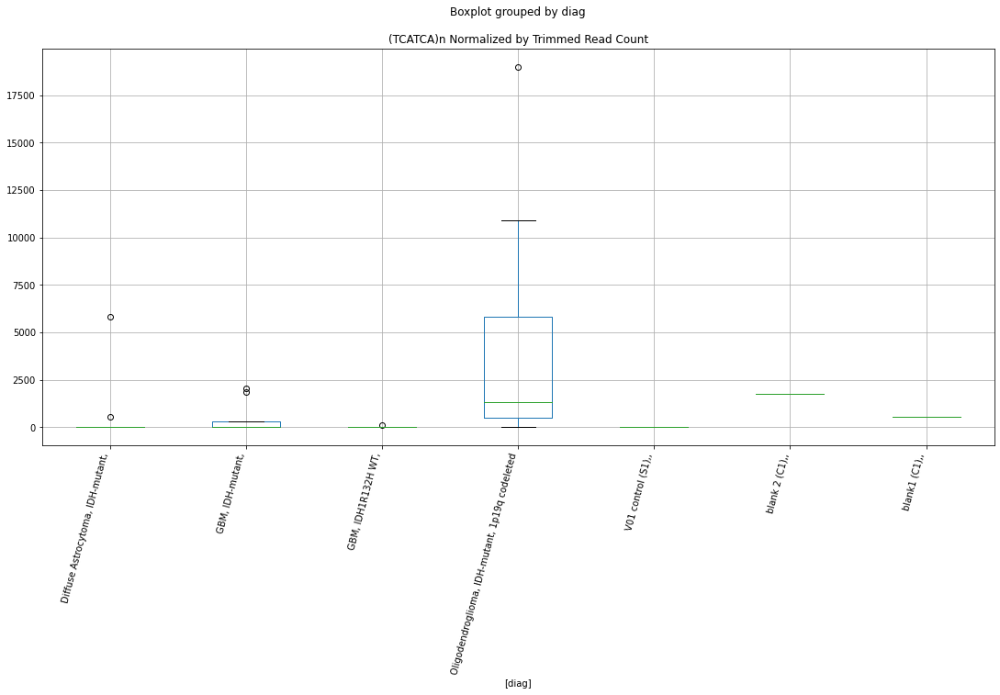

 p : 0.04166748940504929  ( t : 2.1932196393952608 ) :  D-plex  :  cutadapt2  :  (TCGAATGGAATCA)n
Control and blanks
76     757.61
340      0.00
Name: (TCGAATGGAATCA)n, dtype: float64
208    0.0
Name: (TCGAATGGAATCA)n, dtype: float64
472    0.0
Name: (TCGAATGGAATCA)n, dtype: float64


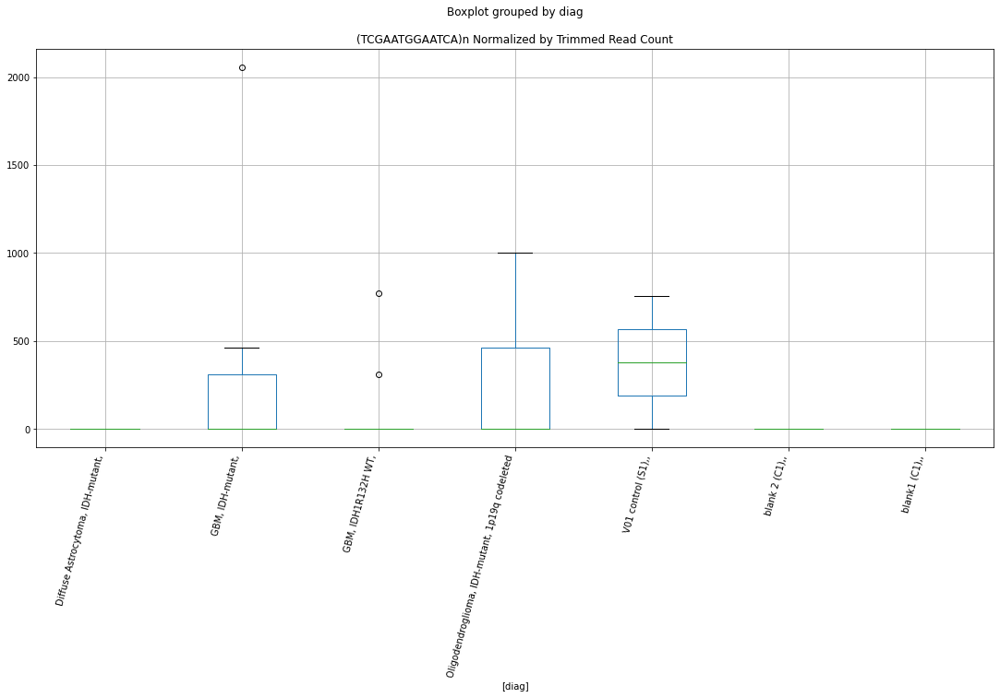

 p : 0.04174197245907988  ( t : 2.192322355142708 ) :  D-plex  :  cutadapt2  :  (TTTCT)n
Control and blanks
76      3788.07
340    22018.30
Name: (TTTCT)n, dtype: float64
208    2998.12
Name: (TTTCT)n, dtype: float64
472    1155.91
Name: (TTTCT)n, dtype: float64


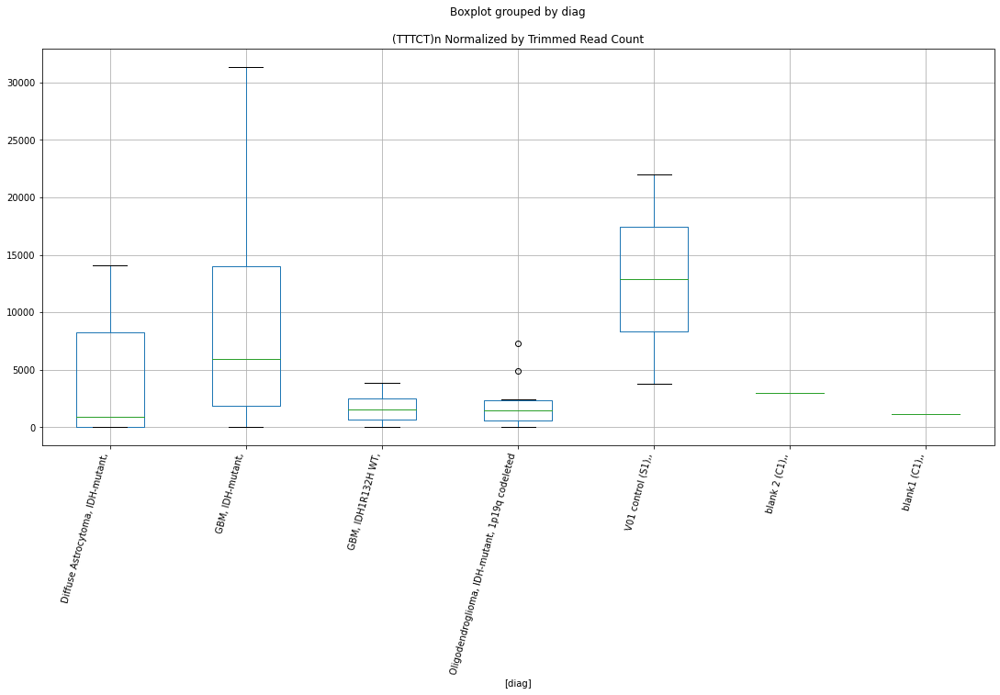

 p : 0.04176832476962894  ( t : 2.192005245350191 ) :  D-plex  :  bbduk2  :  LTR86C
Control and blanks
73     773.01
337    890.16
Name: LTR86C, dtype: float64
205    5372.73
Name: LTR86C, dtype: float64
469    11239.02
Name: LTR86C, dtype: float64


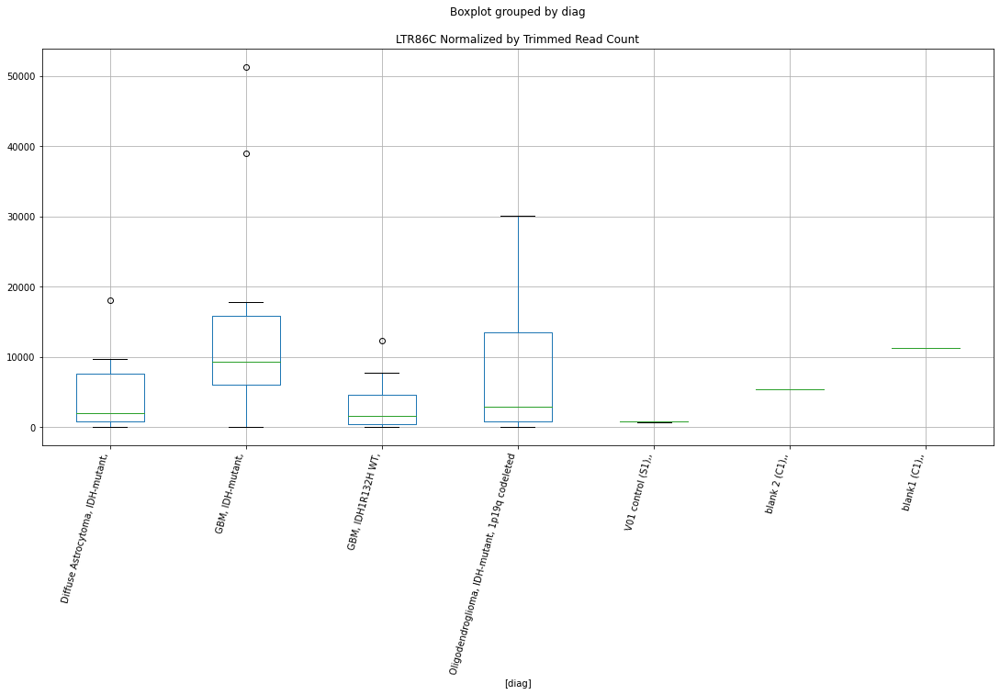

 p : 0.04180314569758953  ( t : 2.1915865101435847 ) :  D-plex  :  bbduk2  :  L1ME5
Control and blanks
73      50245.55
337    184262.55
Name: L1ME5, dtype: float64
205    87575.48
Name: L1ME5, dtype: float64
469    91095.21
Name: L1ME5, dtype: float64


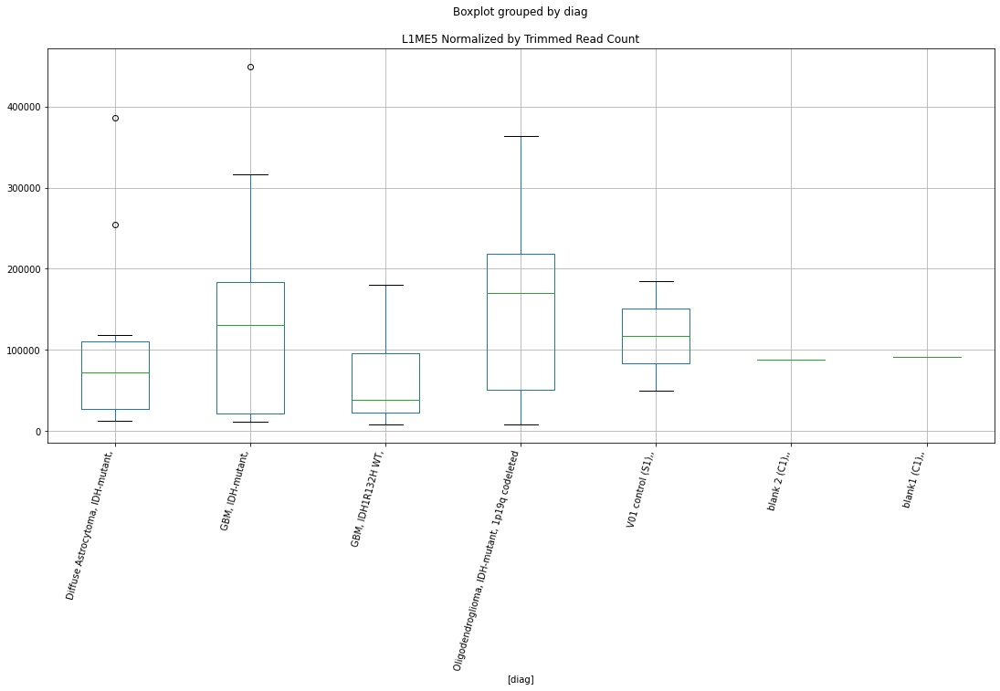

 p : 0.0419825250984663  ( t : 2.1894344608973344 ) :  Lexogen  :  cutadapt2  :  L1MB3
Control and blanks
82       0.00
346    210.43
Name: L1MB3, dtype: float64
214    271.23
Name: L1MB3, dtype: float64
478    237.46
Name: L1MB3, dtype: float64


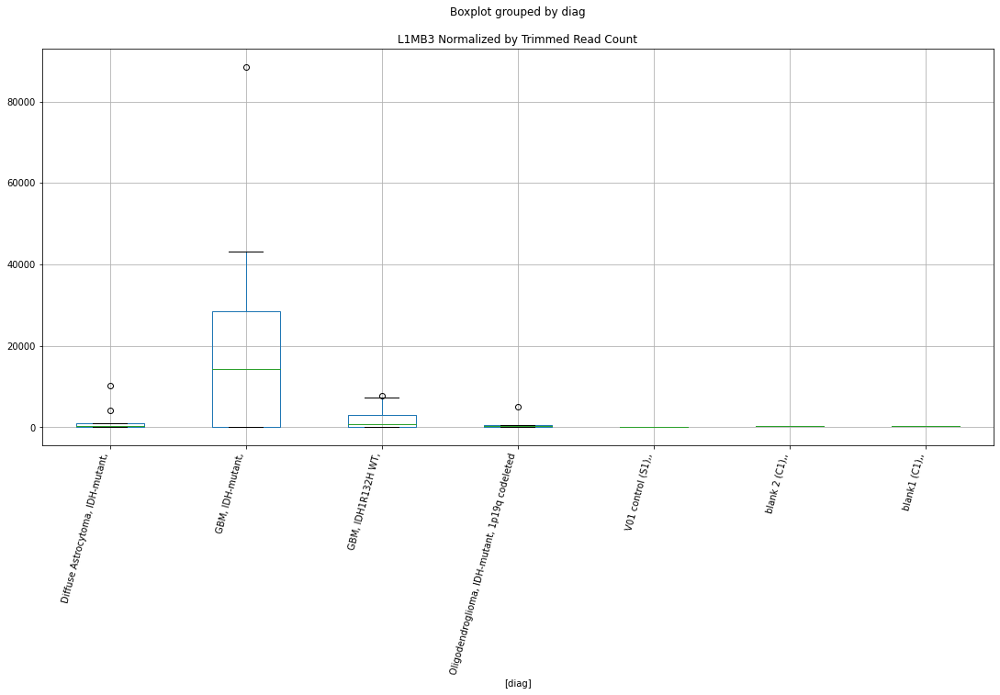

 p : 0.04202483270632997  ( t : 2.1889281180368307 ) :  D-plex  :  bbduk2  :  LTR25
Control and blanks
73     773.01
337    890.16
Name: LTR25, dtype: float64
205    4298.18
Name: LTR25, dtype: float64
469    2957.64
Name: LTR25, dtype: float64


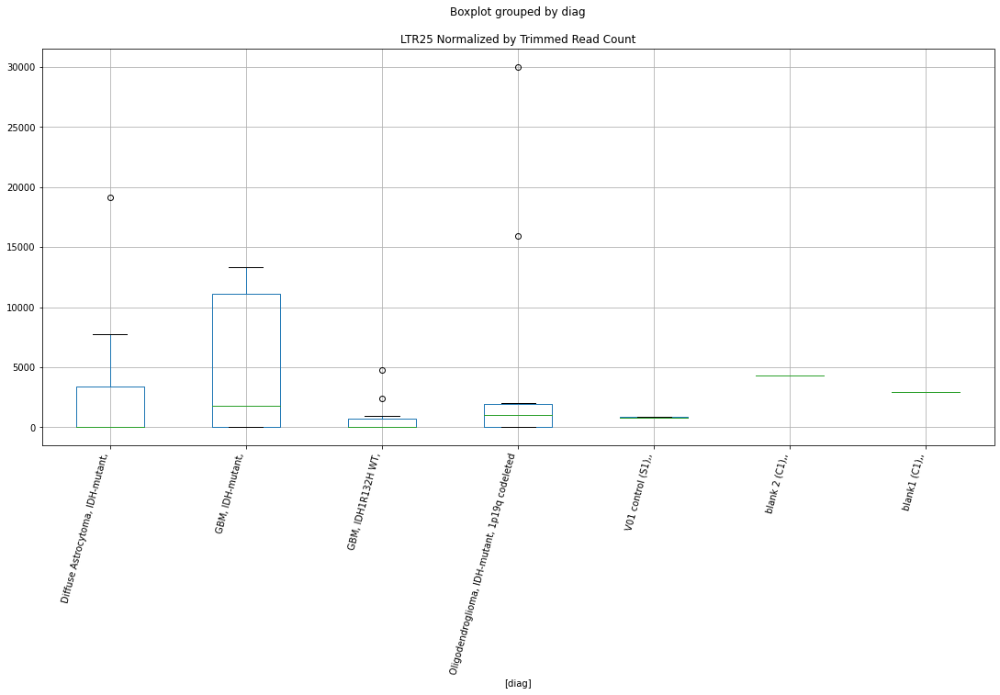

 p : 0.04205118720920534  ( t : 2.188612940304781 ) :  D-plex  :  cutadapt2  :  (GCT)n
Control and blanks
76     1515.23
340       0.00
Name: (GCT)n, dtype: float64
208    1058.16
Name: (GCT)n, dtype: float64
472    2889.78
Name: (GCT)n, dtype: float64


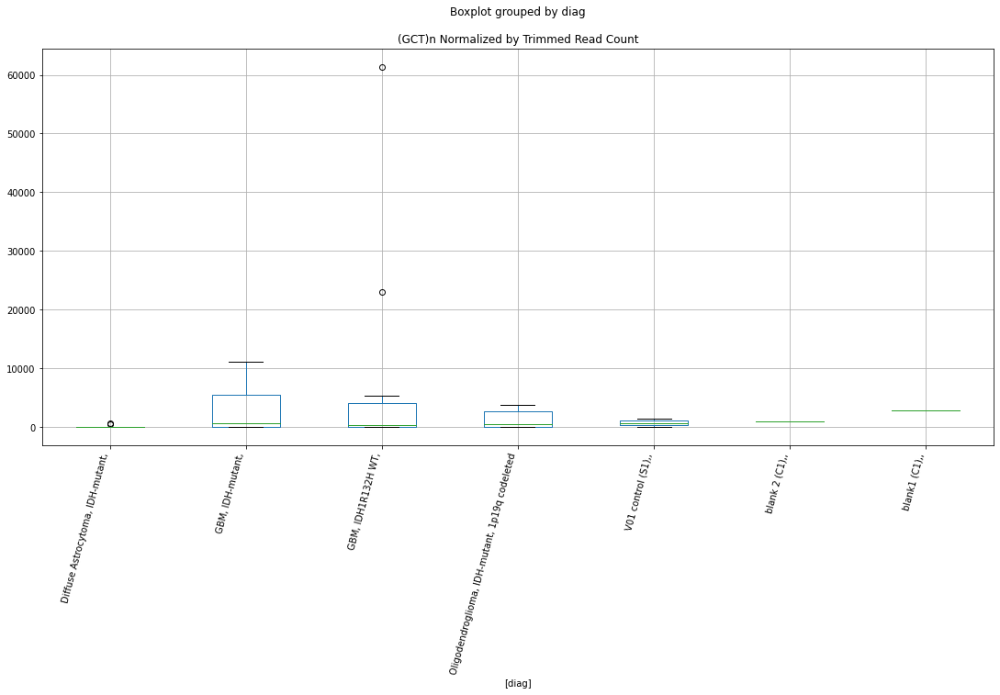

 p : 0.0420605303851198  ( t : 2.188501247269639 ) :  D-plex  :  cutadapt2  :  LTR22C0
Control and blanks
76     757.61
340      0.00
Name: LTR22C0, dtype: float64
208    4409.01
Name: LTR22C0, dtype: float64
472    1155.91
Name: LTR22C0, dtype: float64


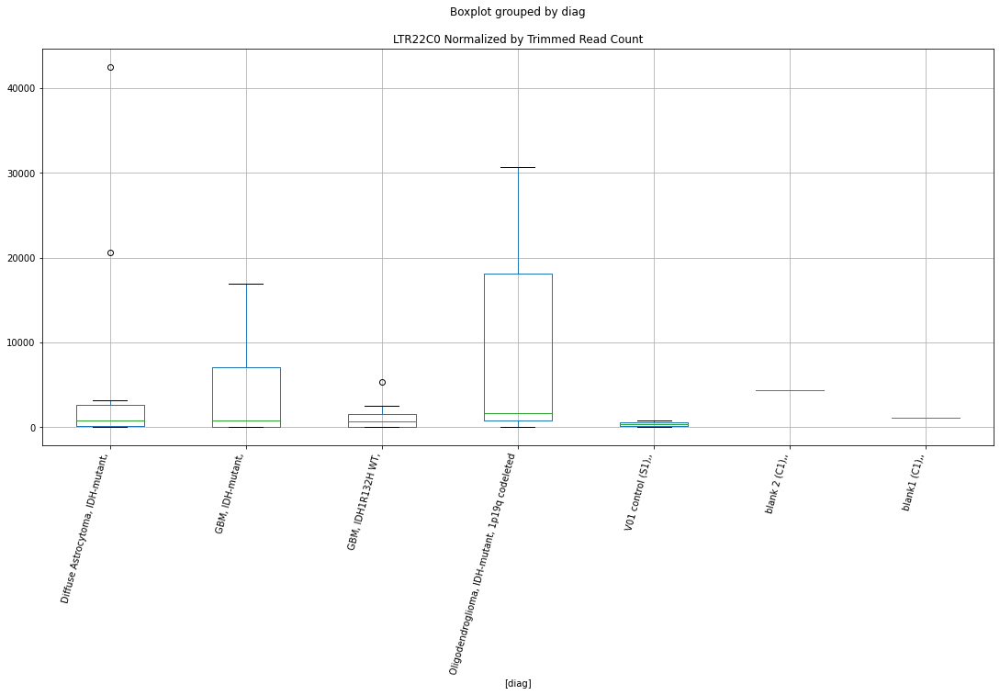

 p : 0.04208798347280373  ( t : 2.1881731908574578 ) :  D-plex  :  cutadapt2  :  (CTGTCT)n
Control and blanks
76      757.61
340    6165.12
Name: (CTGTCT)n, dtype: float64
208    1763.6
Name: (CTGTCT)n, dtype: float64
472    2889.78
Name: (CTGTCT)n, dtype: float64


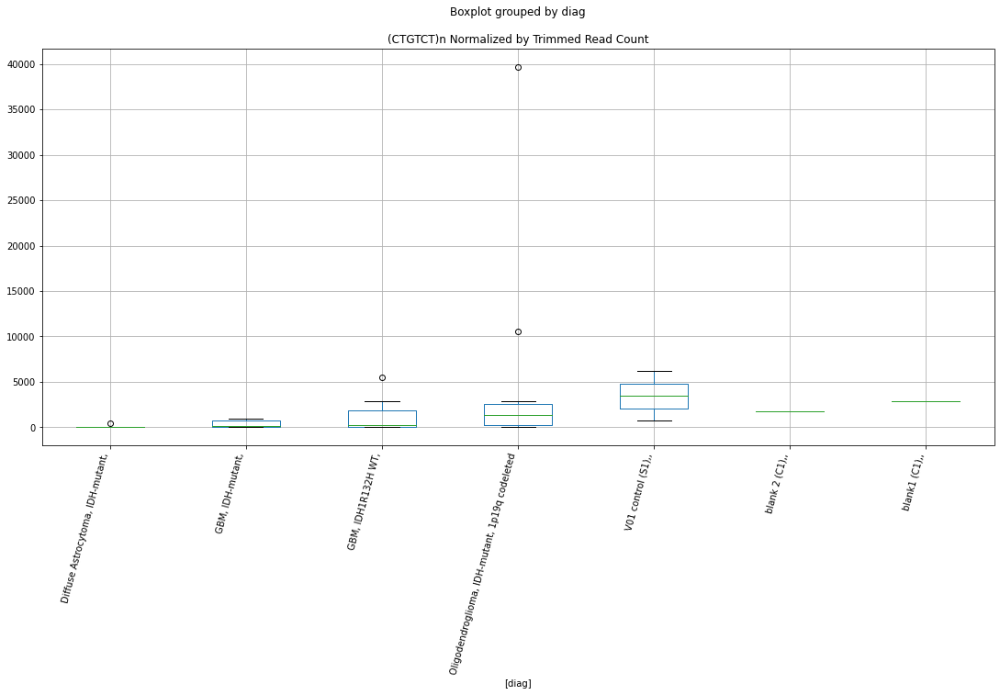

 p : 0.04209518373611312  ( t : 2.188087182297809 ) :  D-plex  :  bbduk2  :  (ACC)n
Control and blanks
73        0.00
337    2670.47
Name: (ACC)n, dtype: float64
205    3044.55
Name: (ACC)n, dtype: float64
469    4140.69
Name: (ACC)n, dtype: float64


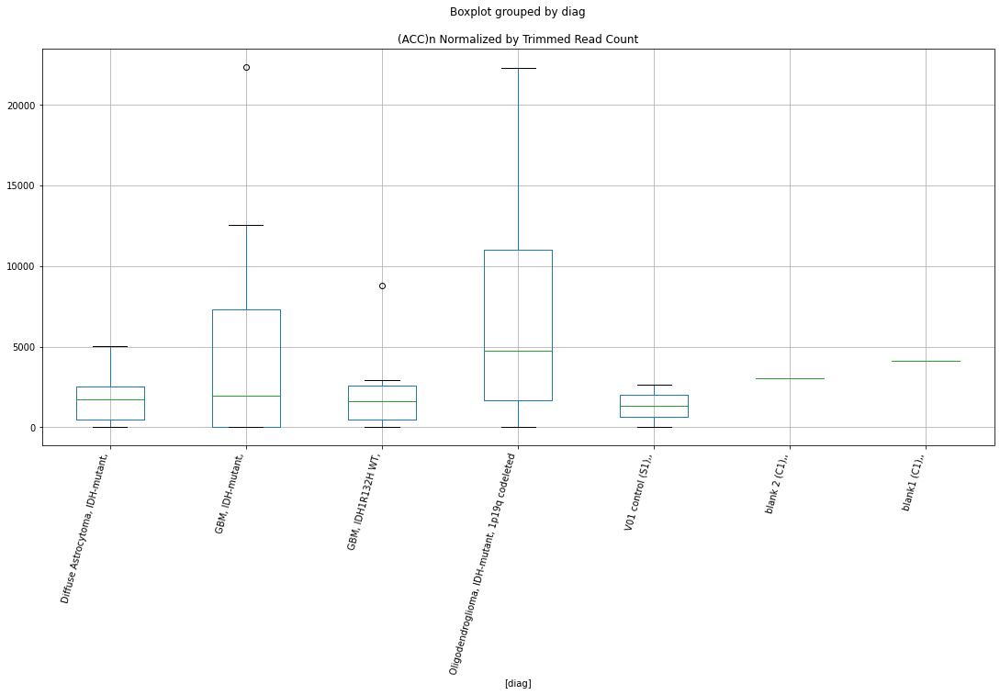

 p : 0.042211907493055006  ( t : 2.1866947733229494 ) :  D-plex  :  cutadapt2  :  (GTCTCT)n
Control and blanks
76        0.00
340    3522.93
Name: (GTCTCT)n, dtype: float64
208    1763.6
Name: (GTCTCT)n, dtype: float64
472    2889.78
Name: (GTCTCT)n, dtype: float64


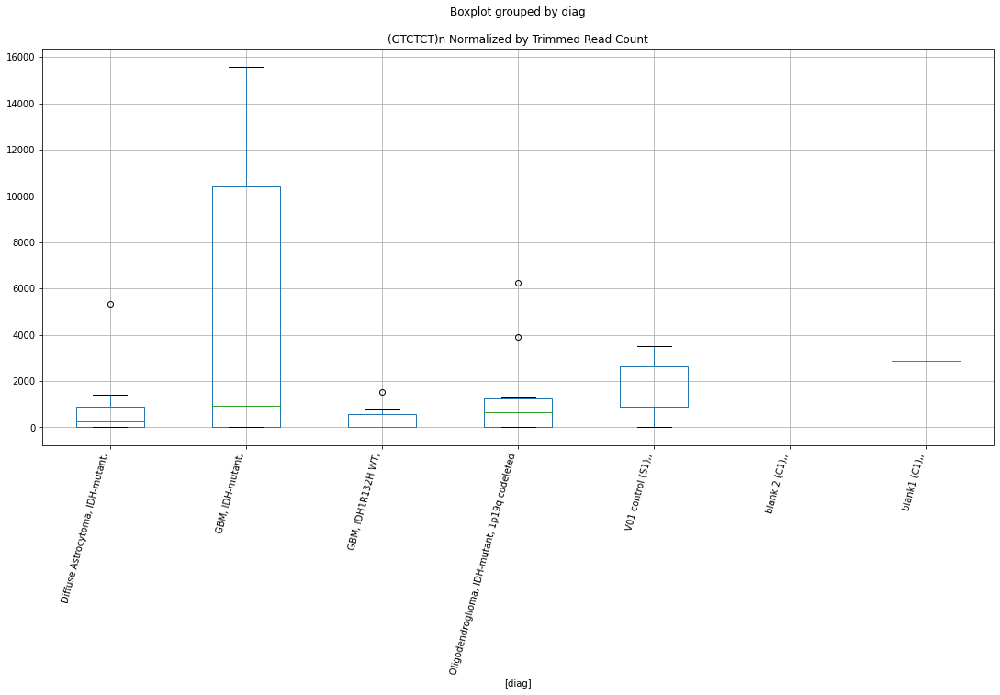

 p : 0.042235087935298975  ( t : 2.186418671950099 ) :  D-plex  :  bbduk2  :  HERVL-int
Control and blanks
73      74981.81
337    225209.79
Name: HERVL-int, dtype: float64
205    208640.96
Name: HERVL-int, dtype: float64
469    186922.63
Name: HERVL-int, dtype: float64


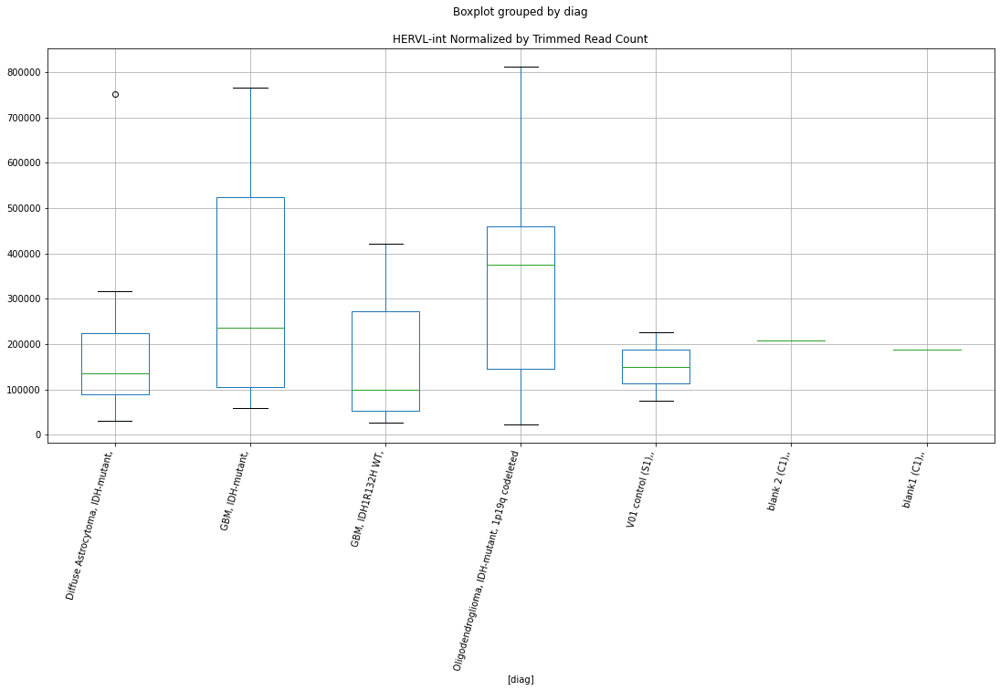

 p : 0.042261332727106256  ( t : 2.186106238928449 ) :  D-plex  :  bbduk2  :  Tigger12c
Control and blanks
73     1546.02
337       0.00
Name: Tigger12c, dtype: float64
205    5730.91
Name: Tigger12c, dtype: float64
469    5323.75
Name: Tigger12c, dtype: float64


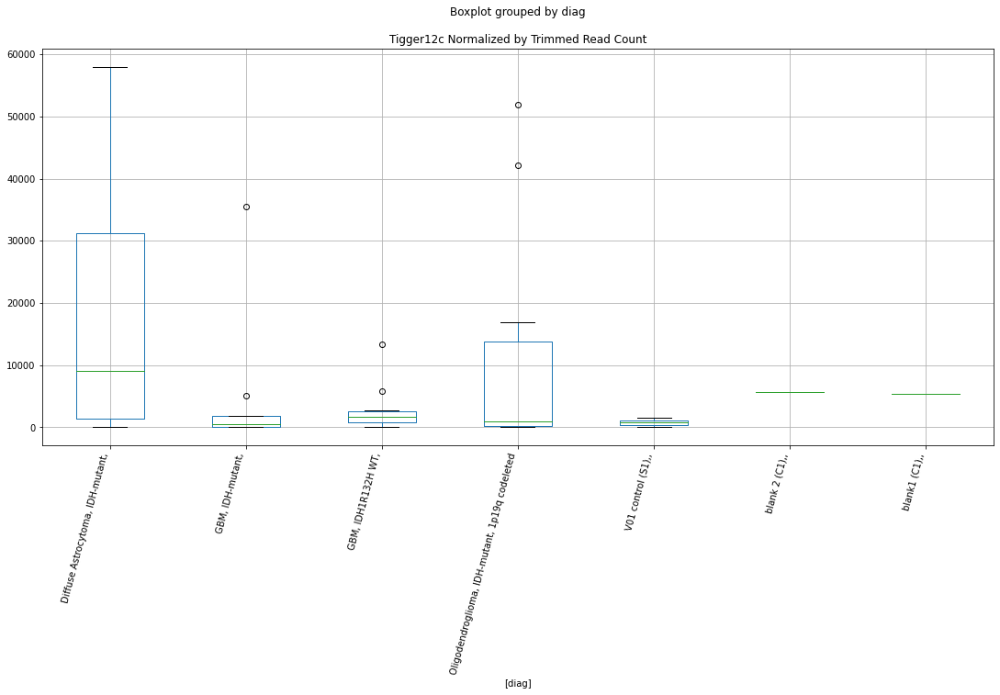

 p : 0.04228236567485686  ( t : 2.185855979100797 ) :  D-plex  :  bbduk2  :  HSMAR2
Control and blanks
73      30147.33
337    164679.09
Name: HSMAR2, dtype: float64
205    54443.65
Name: HSMAR2, dtype: float64
469    47913.71
Name: HSMAR2, dtype: float64


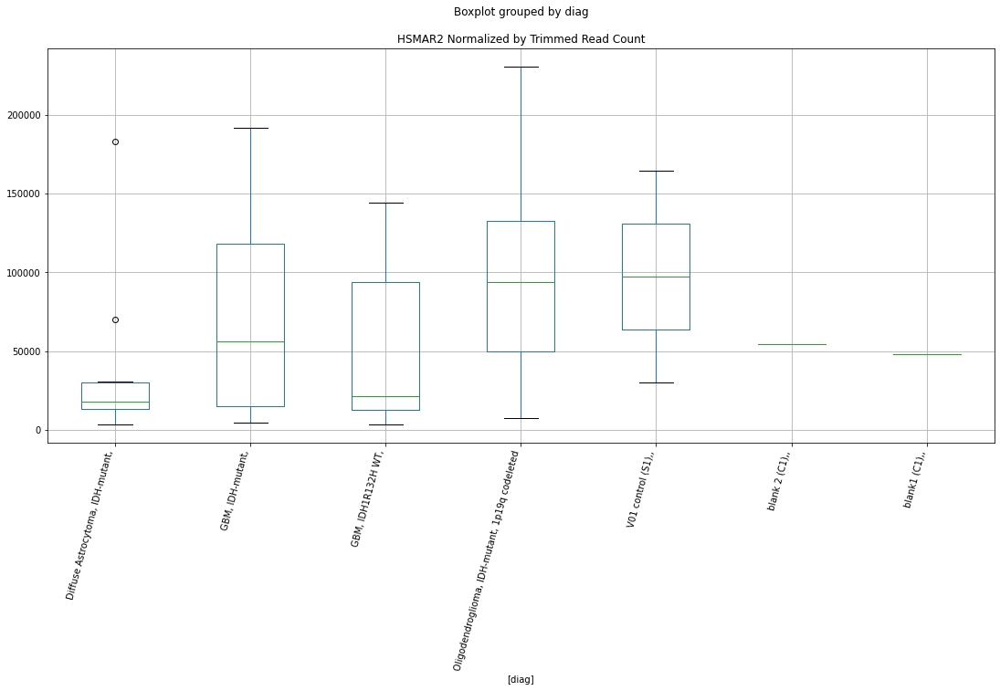

 p : 0.04230756791658887  ( t : 2.1855562613811386 ) :  D-plex  :  cutadapt2  :  L1M3e
Control and blanks
76     18182.74
340    62531.98
Name: L1M3e, dtype: float64
208    34919.32
Name: L1M3e, dtype: float64
472    39301.0
Name: L1M3e, dtype: float64


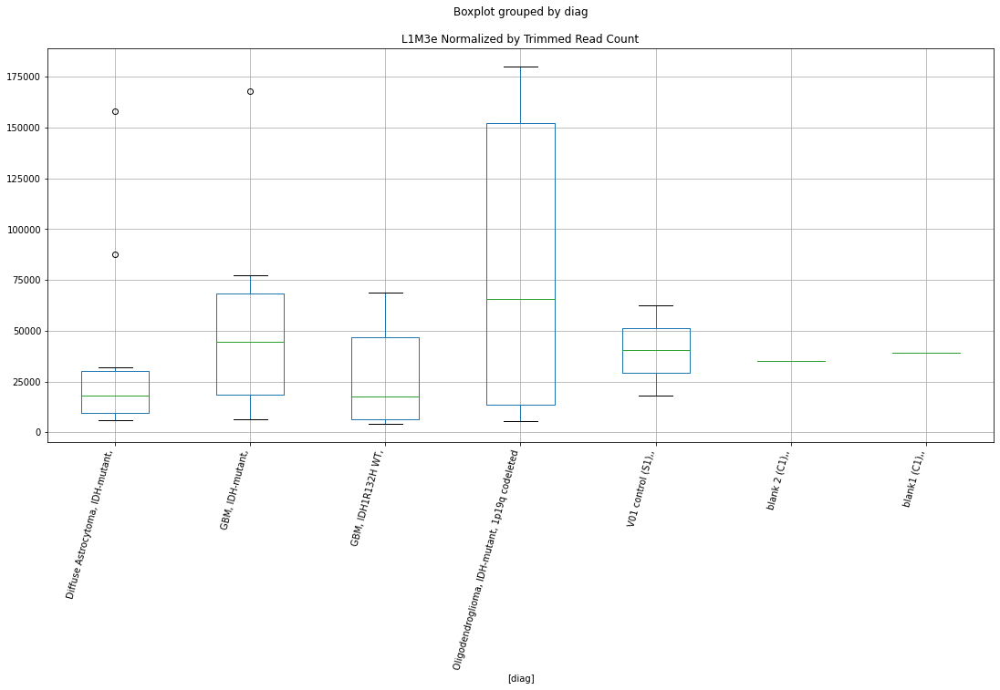

 p : 0.04239681410843485  ( t : 2.184496215674991 ) :  D-plex  :  bbduk2  :  (TCTTTA)n
Control and blanks
73     0.0
337    0.0
Name: (TCTTTA)n, dtype: float64
205    179.09
Name: (TCTTTA)n, dtype: float64
469    0.0
Name: (TCTTTA)n, dtype: float64


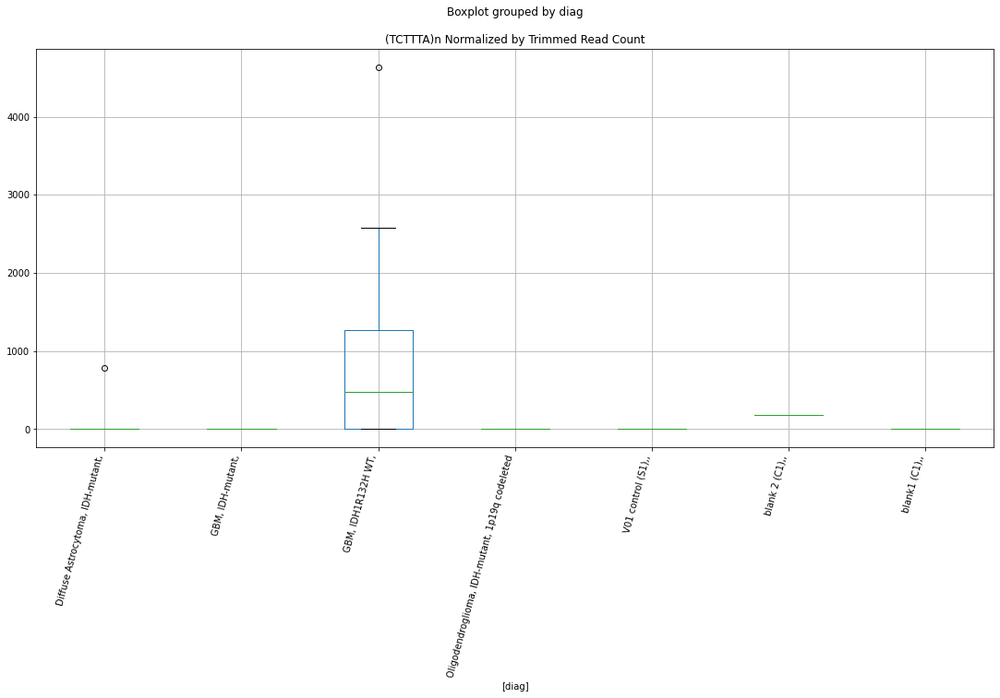

 p : 0.04244554665507681  ( t : 2.1839182451052315 ) :  D-plex  :  bbduk2  :  (TATATAA)n
Control and blanks
73       0.00
337    890.16
Name: (TATATAA)n, dtype: float64
205    179.09
Name: (TATATAA)n, dtype: float64
469    0.0
Name: (TATATAA)n, dtype: float64


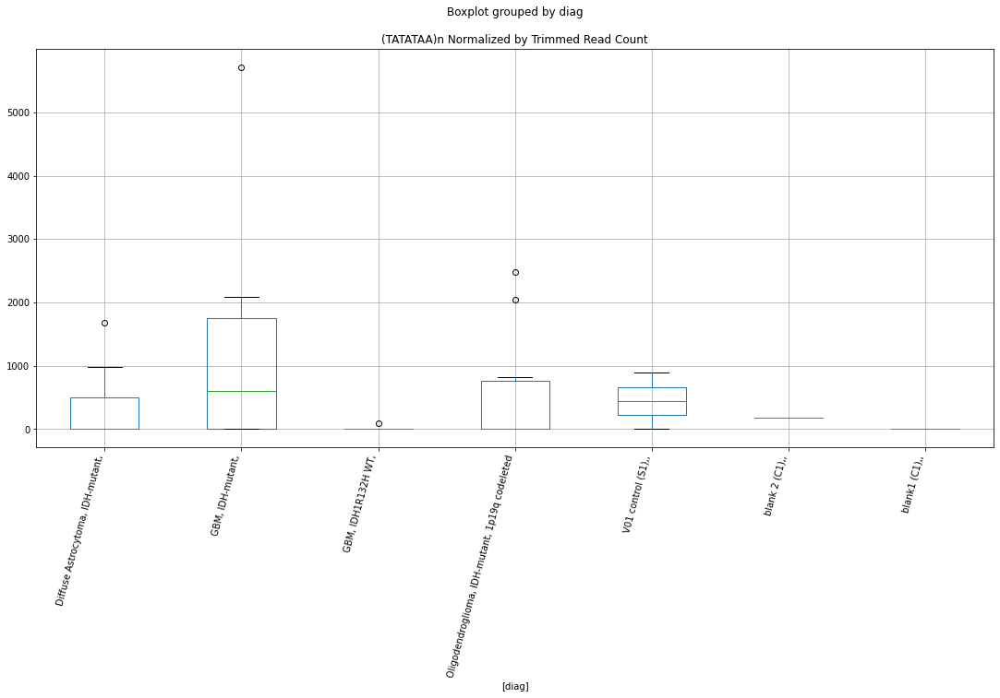

 p : 0.042449361459103316  ( t : 2.1838730270116367 ) :  D-plex  :  cutadapt2  :  LTR2B
Control and blanks
76     757.61
340      0.00
Name: LTR2B, dtype: float64
208    4761.73
Name: LTR2B, dtype: float64
472    6357.51
Name: LTR2B, dtype: float64


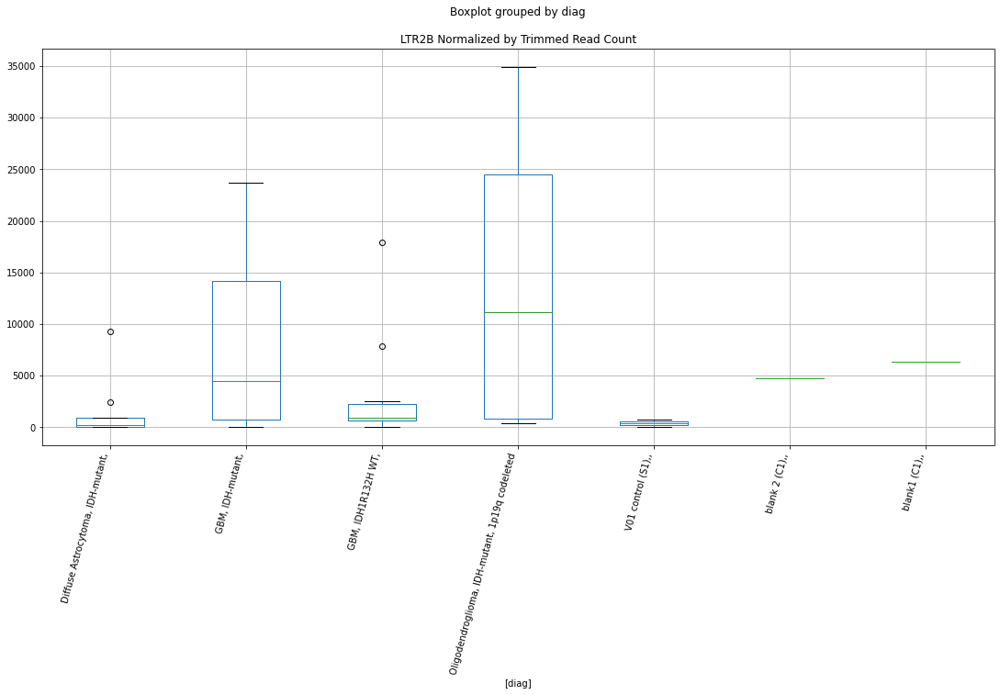

 p : 0.04253703433535615  ( t : 2.1828348377794677 ) :  D-plex  :  cutadapt2  :  MER119
Control and blanks
76      2272.84
340    30825.62
Name: MER119, dtype: float64
208    16754.22
Name: MER119, dtype: float64
472    19072.54
Name: MER119, dtype: float64


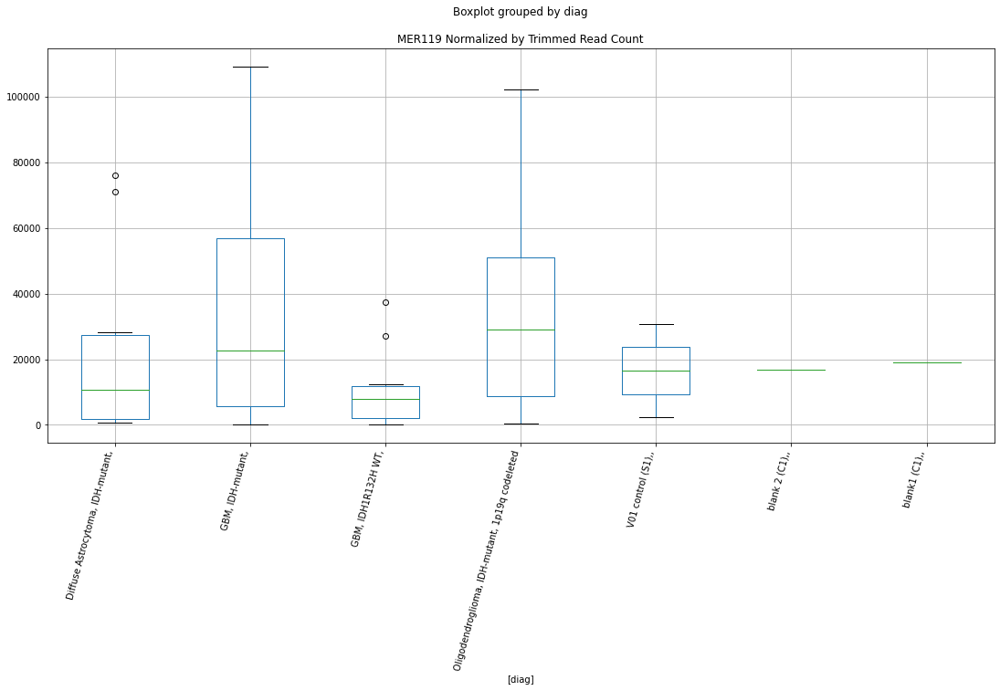

 p : 0.04254242349037252  ( t : 2.1827710854539832 ) :  D-plex  :  bbduk2  :  (CTCC)n
Control and blanks
73     60294.66
337    37386.61
Name: (CTCC)n, dtype: float64
205    10029.09
Name: (CTCC)n, dtype: float64
469    9464.44
Name: (CTCC)n, dtype: float64


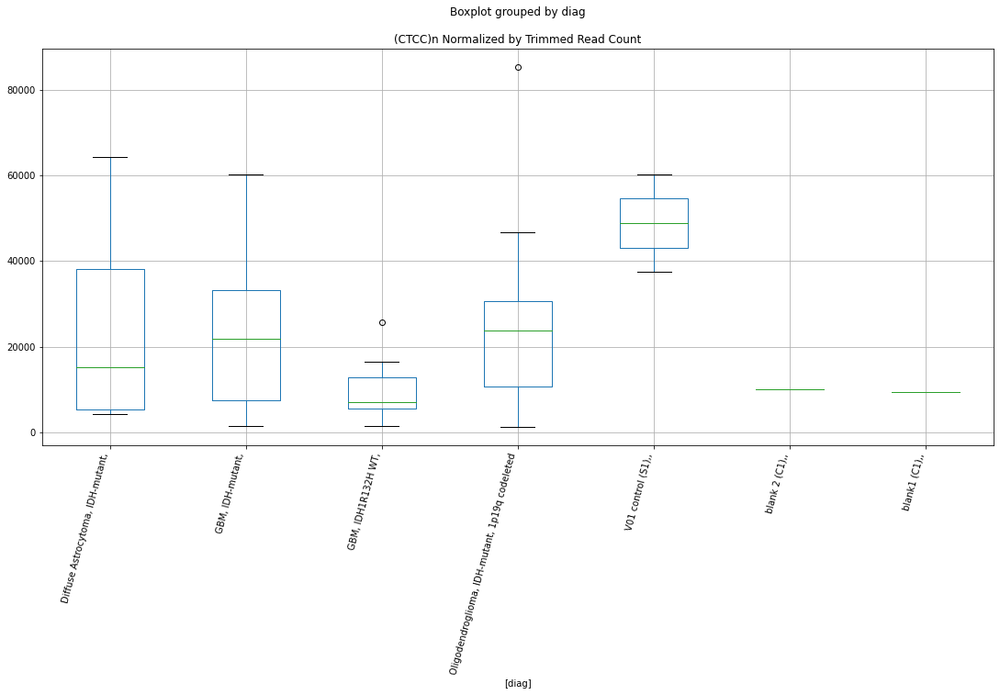

 p : 0.04257323894098932  ( t : 2.1824066887012603 ) :  D-plex  :  bbduk2  :  HERV3-int
Control and blanks
73       773.01
337    40057.08
Name: HERV3-int, dtype: float64
205    16834.55
Name: HERV3-int, dtype: float64
469    18337.35
Name: HERV3-int, dtype: float64


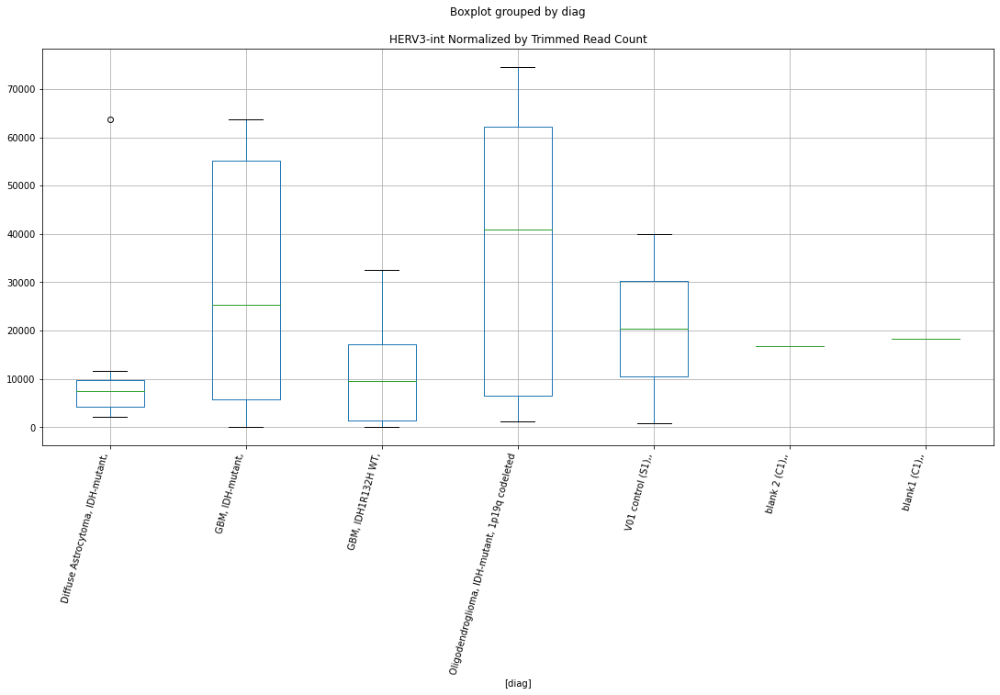

 p : 0.04267831175318977  ( t : 2.1811660041200644 ) :  D-plex  :  bbduk2  :  FordPrefect
Control and blanks
73     10822.12
337     9791.73
Name: FordPrefect, dtype: float64
205    22923.64
Name: FordPrefect, dtype: float64
469    22478.04
Name: FordPrefect, dtype: float64


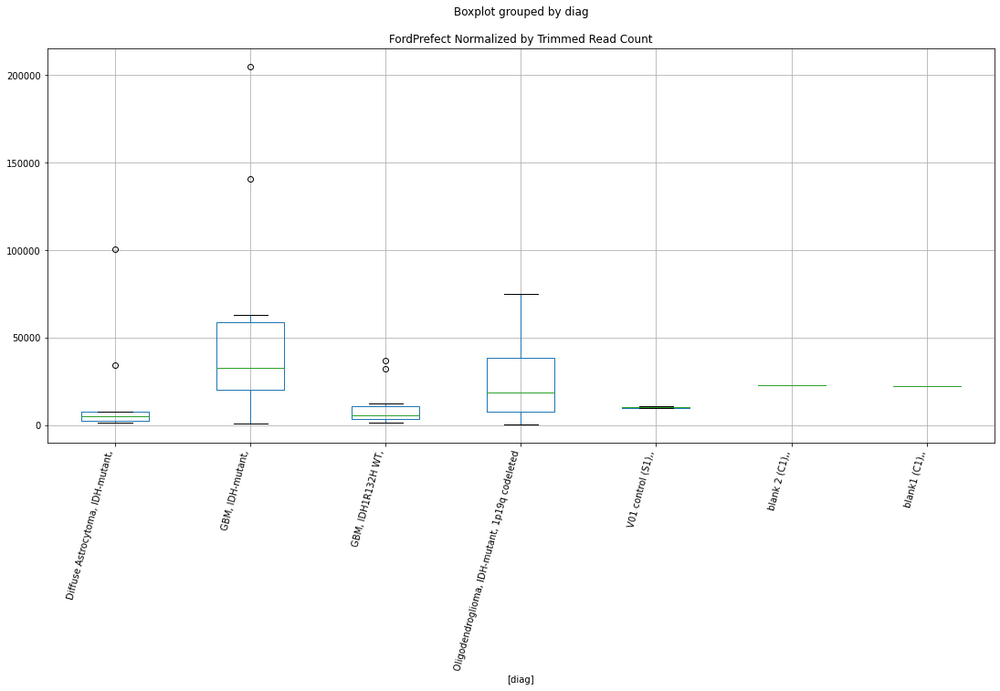

 p : 0.0428694363842306  ( t : 2.178916393127425 ) :  D-plex  :  cutadapt2  :  L1MEg1
Control and blanks
76      3788.07
340    74862.23
Name: L1MEg1, dtype: float64
208    21515.95
Name: L1MEg1, dtype: float64
472    17338.68
Name: L1MEg1, dtype: float64


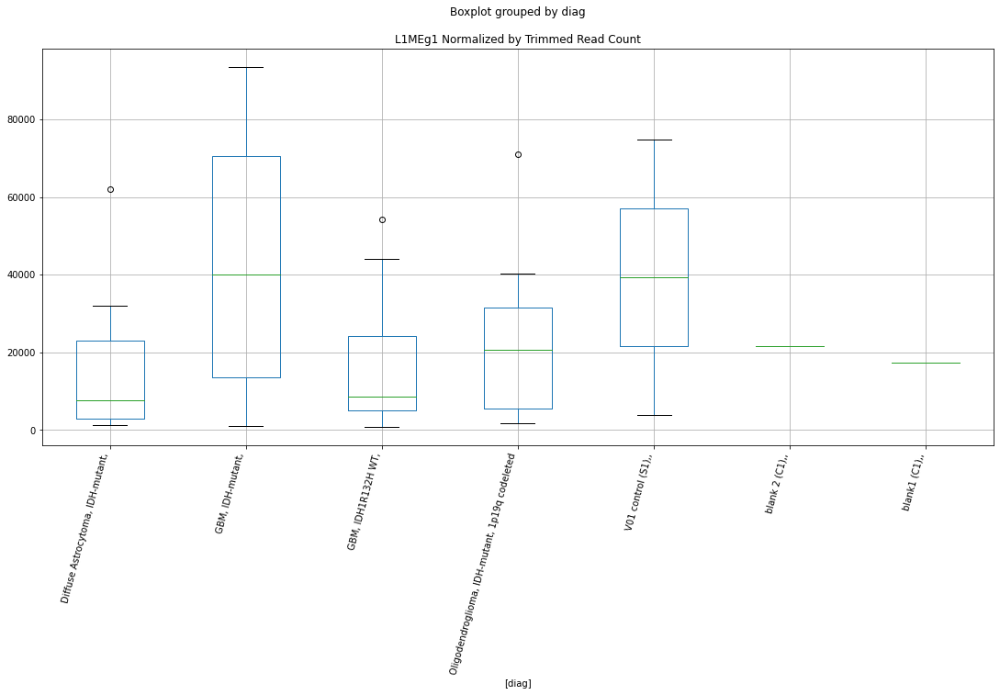

 p : 0.042892849130347195  ( t : 2.178641448300504 ) :  D-plex  :  bbduk2  :  (TTAT)n
Control and blanks
73         0.00
337    37386.61
Name: (TTAT)n, dtype: float64
205    4119.09
Name: (TTAT)n, dtype: float64
469    7098.33
Name: (TTAT)n, dtype: float64


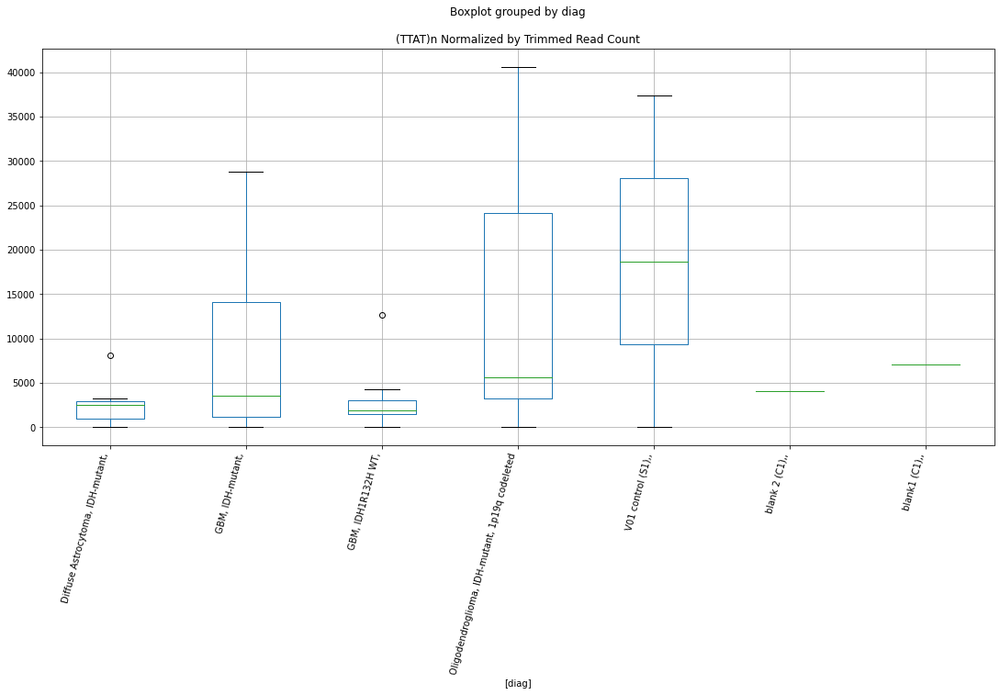

 p : 0.042942472305131534  ( t : 2.1780591587629963 ) :  D-plex  :  bbduk2  :  LTR32
Control and blanks
73      3865.04
337    36496.45
Name: LTR32, dtype: float64
205    17371.82
Name: LTR32, dtype: float64
469    26027.2
Name: LTR32, dtype: float64


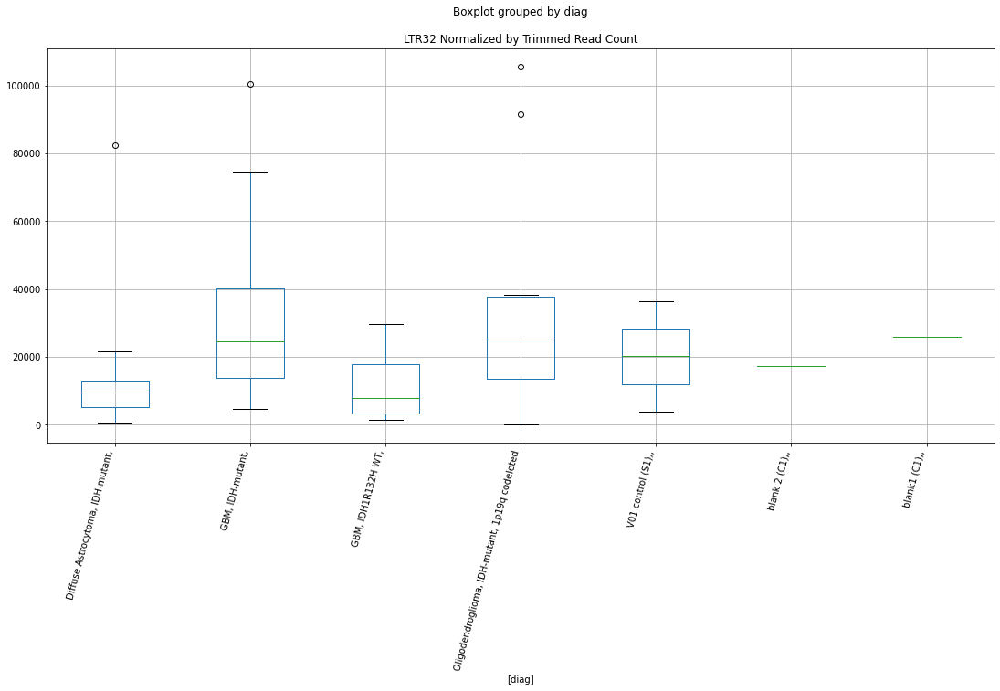

 p : 0.04294967464877276  ( t : 2.17797469608425 ) :  D-plex  :  cutadapt2  :  (ATCT)n
Control and blanks
76     33335.03
340    33467.82
Name: (ATCT)n, dtype: float64
208    16225.14
Name: (ATCT)n, dtype: float64
472    21384.37
Name: (ATCT)n, dtype: float64


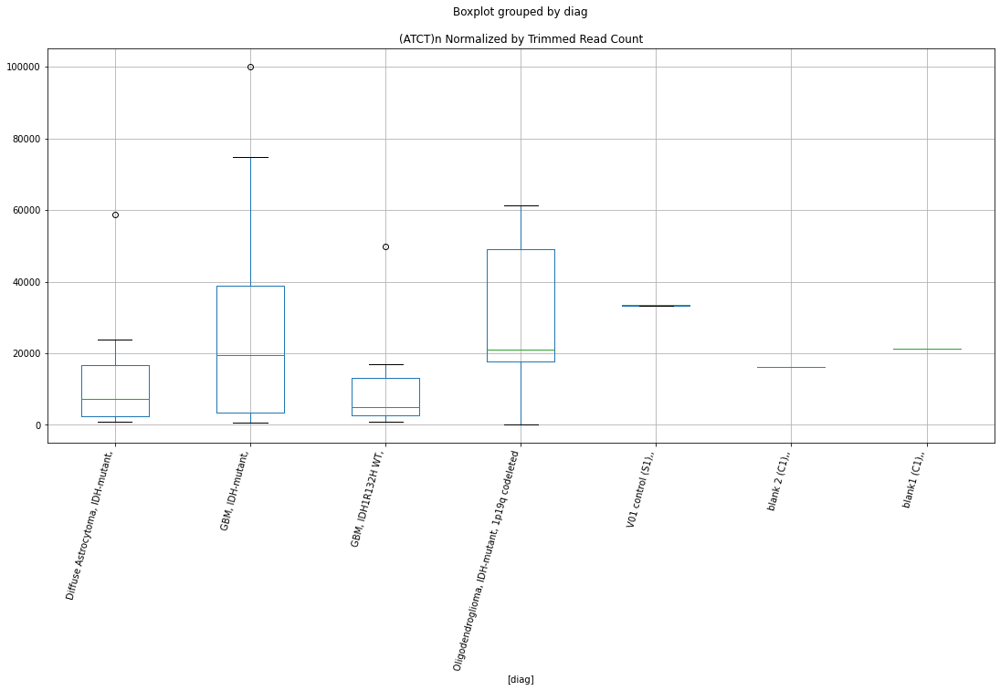

 p : 0.04295812023481584  ( t : 2.1778756702961206 ) :  D-plex  :  bbduk2  :  (TGAA)n
Control and blanks
73      773.01
337    1780.31
Name: (TGAA)n, dtype: float64
205    6447.27
Name: (TGAA)n, dtype: float64
469    4732.22
Name: (TGAA)n, dtype: float64


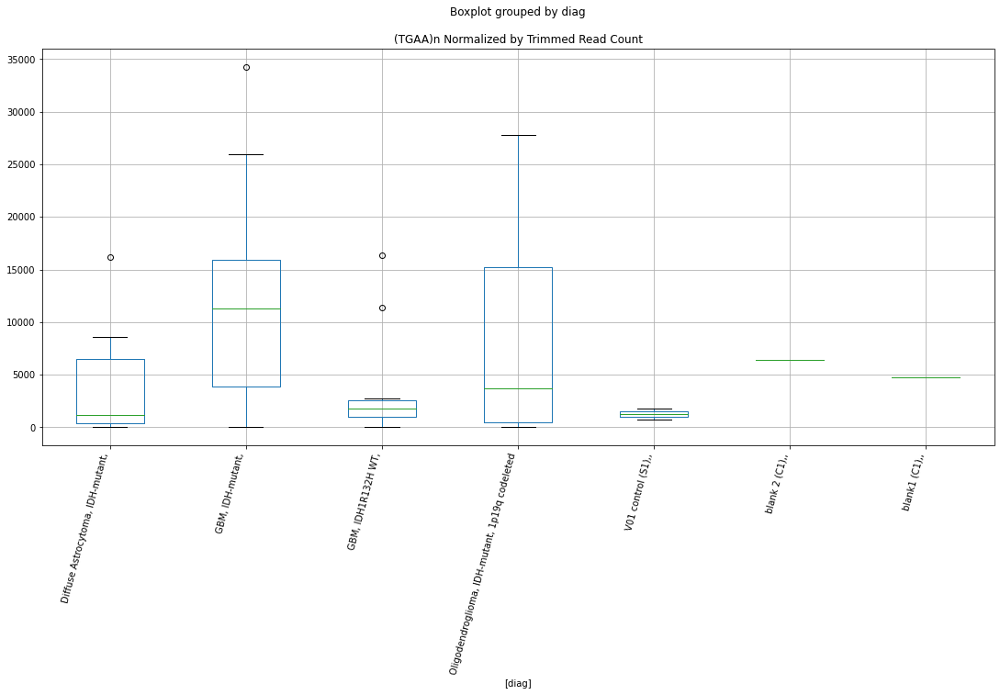

 p : 0.04307009101359728  ( t : 2.1765644791200254 ) :  D-plex  :  cutadapt2  :  LTR77
Control and blanks
76     757.61
340      0.00
Name: LTR77, dtype: float64
208    3879.92
Name: LTR77, dtype: float64
472    2311.82
Name: LTR77, dtype: float64


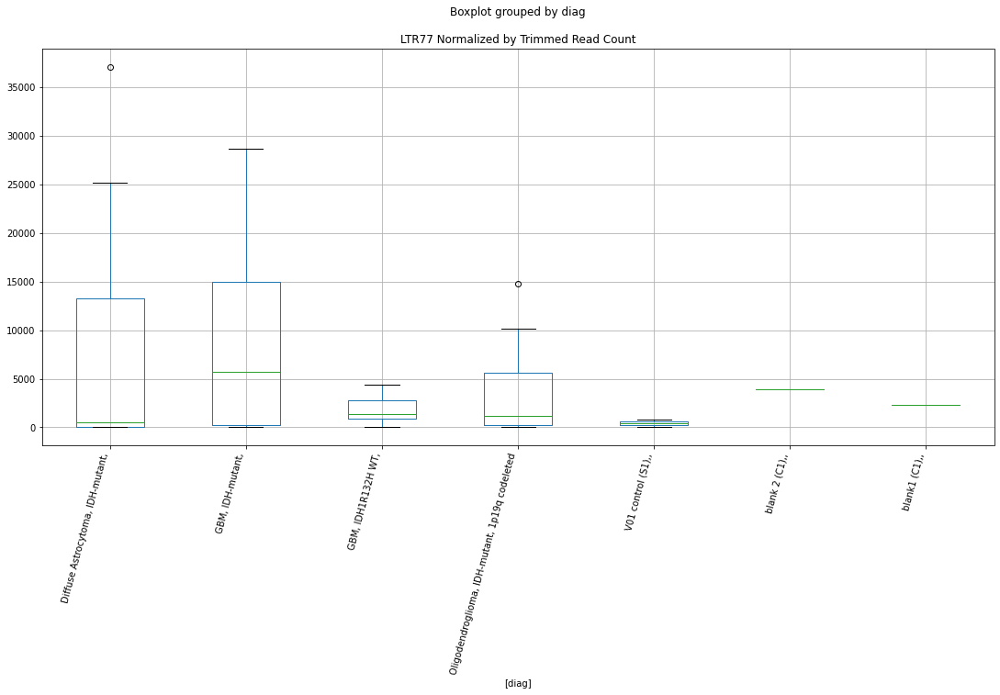

 p : 0.04307167837156629  ( t : 2.1765459134316965 ) :  D-plex  :  bbduk2  :  LTR18B
Control and blanks
73     24736.27
337    12462.20
Name: LTR18B, dtype: float64
205    3760.91
Name: LTR18B, dtype: float64
469    5915.27
Name: LTR18B, dtype: float64


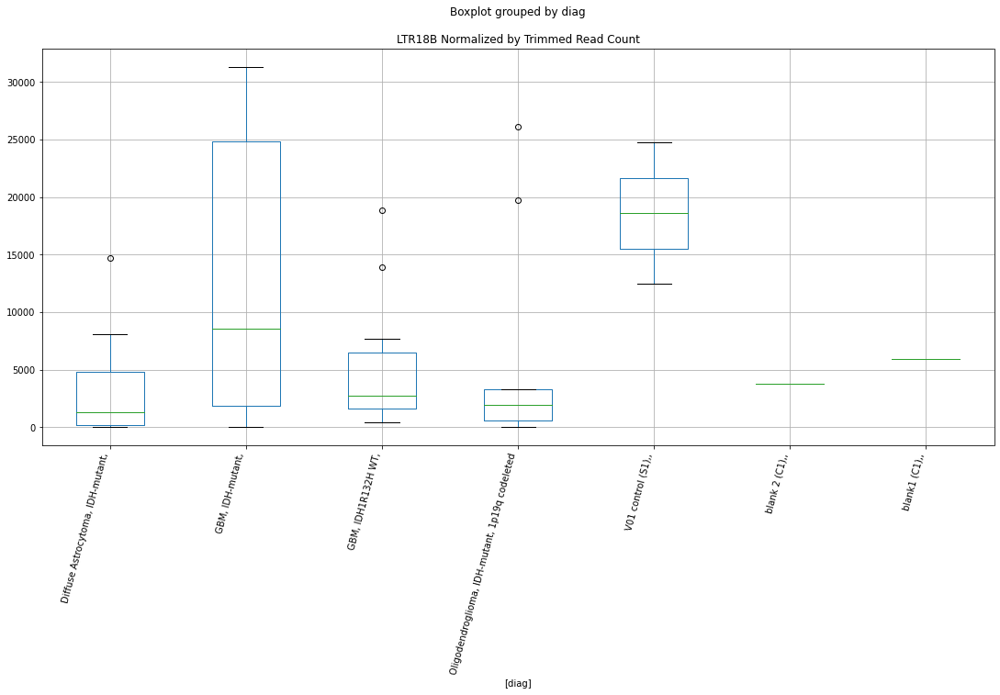

 p : 0.04307369428189229  ( t : 2.1765223363122232 ) :  D-plex  :  cutadapt2  :  LTR82A
Control and blanks
76      2272.84
340    21137.57
Name: LTR82A, dtype: float64
208    21515.95
Name: LTR82A, dtype: float64
472    17338.68
Name: LTR82A, dtype: float64


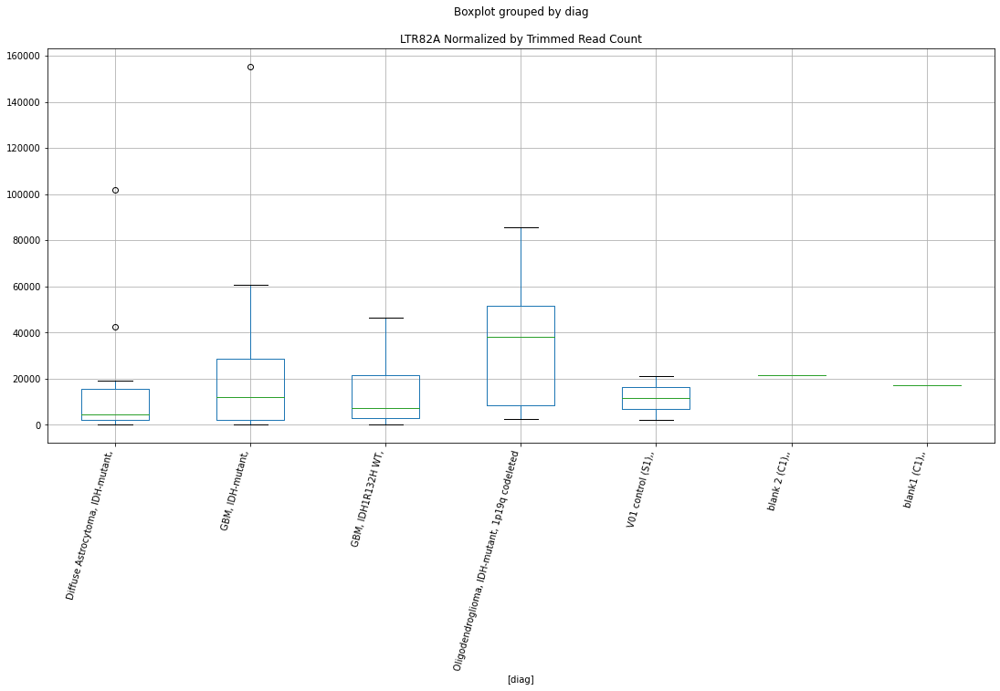

 p : 0.04309487029820684  ( t : 2.176274732859961 ) :  D-plex  :  cutadapt2  :  HERV3-int
Control and blanks
76      1515.23
340    39632.95
Name: HERV3-int, dtype: float64
208    17459.66
Name: HERV3-int, dtype: float64
472    19072.54
Name: HERV3-int, dtype: float64


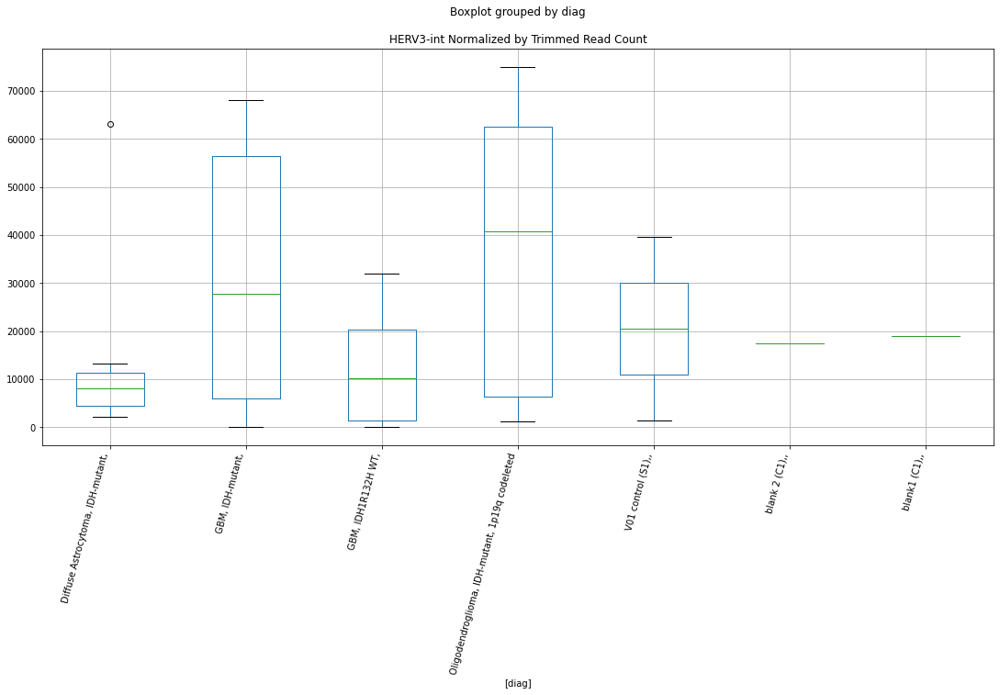

 p : 0.04328147176401244  ( t : 2.1740976756959176 ) :  D-plex  :  bbduk2  :  (TGGAA)n
Control and blanks
73     104356.13
337    105038.56
Name: (TGGAA)n, dtype: float64
205    132527.3
Name: (TGGAA)n, dtype: float64
469    127769.9
Name: (TGGAA)n, dtype: float64


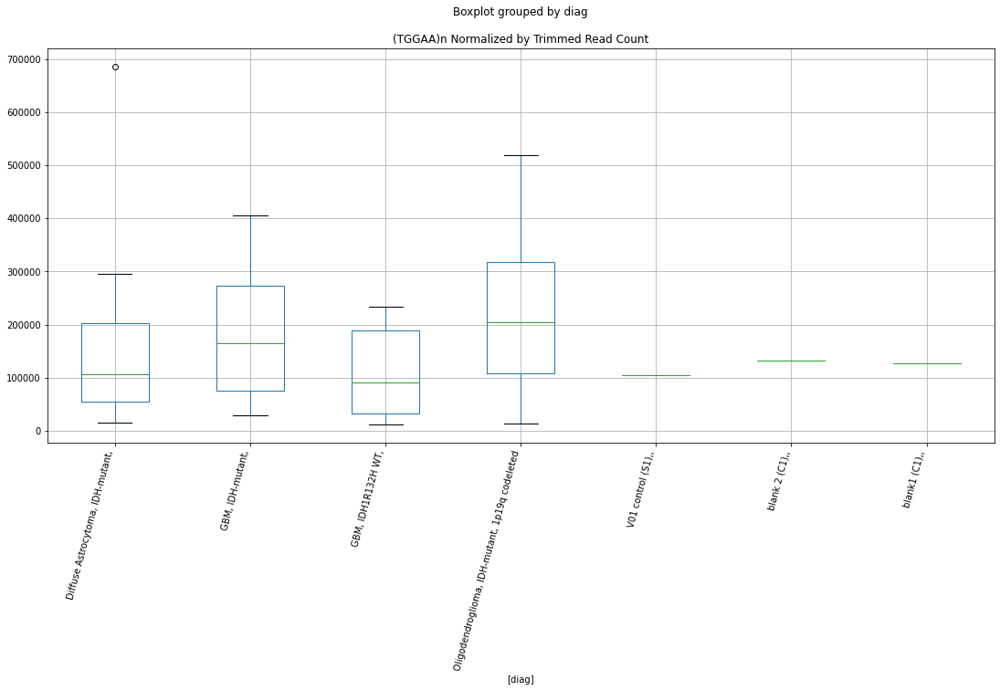

 p : 0.04329542895600994  ( t : 2.1739351846008814 ) :  D-plex  :  cutadapt2  :  MSTC-int
Control and blanks
76     0.0
340    0.0
Name: MSTC-int, dtype: float64
208    6172.61
Name: MSTC-int, dtype: float64
472    4623.65
Name: MSTC-int, dtype: float64


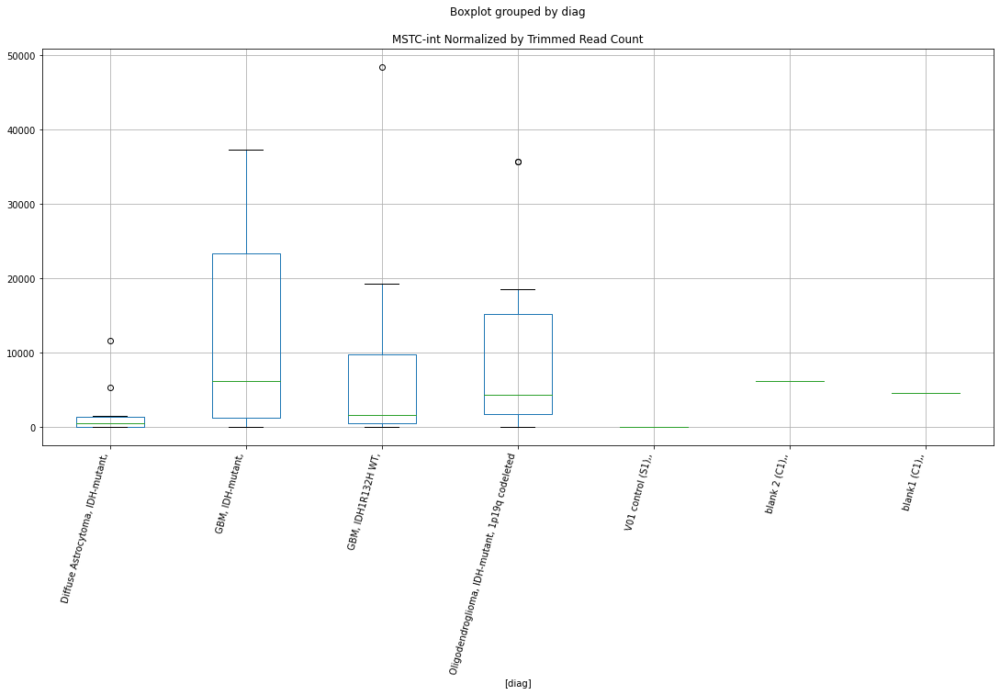

 p : 0.043423706228457454  ( t : 2.172444009897855 ) :  D-plex  :  cutadapt2  :  (GTGTGG)n
Control and blanks
76     0.0
340    0.0
Name: (GTGTGG)n, dtype: float64
208    705.44
Name: (GTGTGG)n, dtype: float64
472    1733.87
Name: (GTGTGG)n, dtype: float64


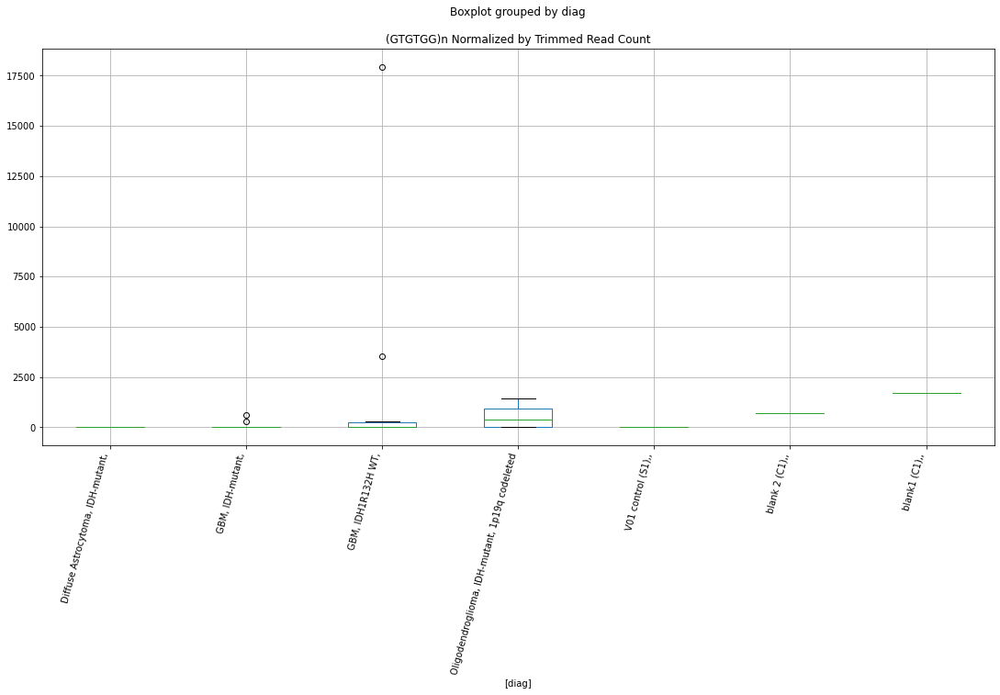

 p : 0.043446209051771774  ( t : 2.1721828391357523 ) :  D-plex  :  cutadapt2  :  (TCCC)n
Control and blanks
76     59851.52
340    24660.50
Name: (TCCC)n, dtype: float64
208    16048.78
Name: (TCCC)n, dtype: float64
472    22540.28
Name: (TCCC)n, dtype: float64


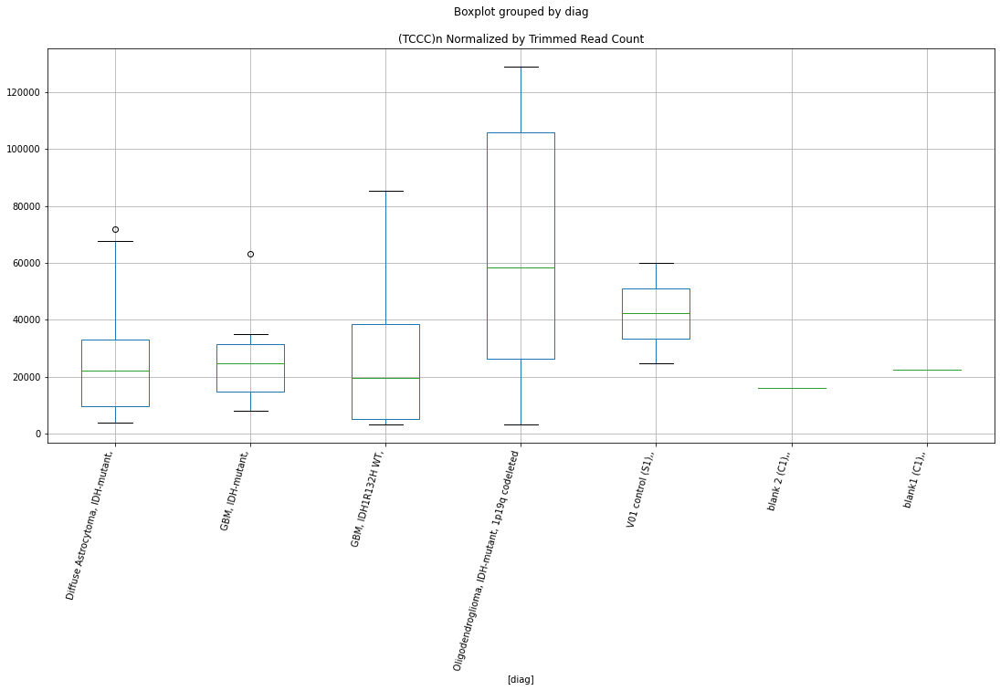

 p : 0.04359673025559803  ( t : 2.170439048920945 ) :  D-plex  :  cutadapt2  :  Tigger6b
Control and blanks
76       757.61
340    24660.50
Name: Tigger6b, dtype: float64
208    7054.41
Name: Tigger6b, dtype: float64
472    3467.74
Name: Tigger6b, dtype: float64


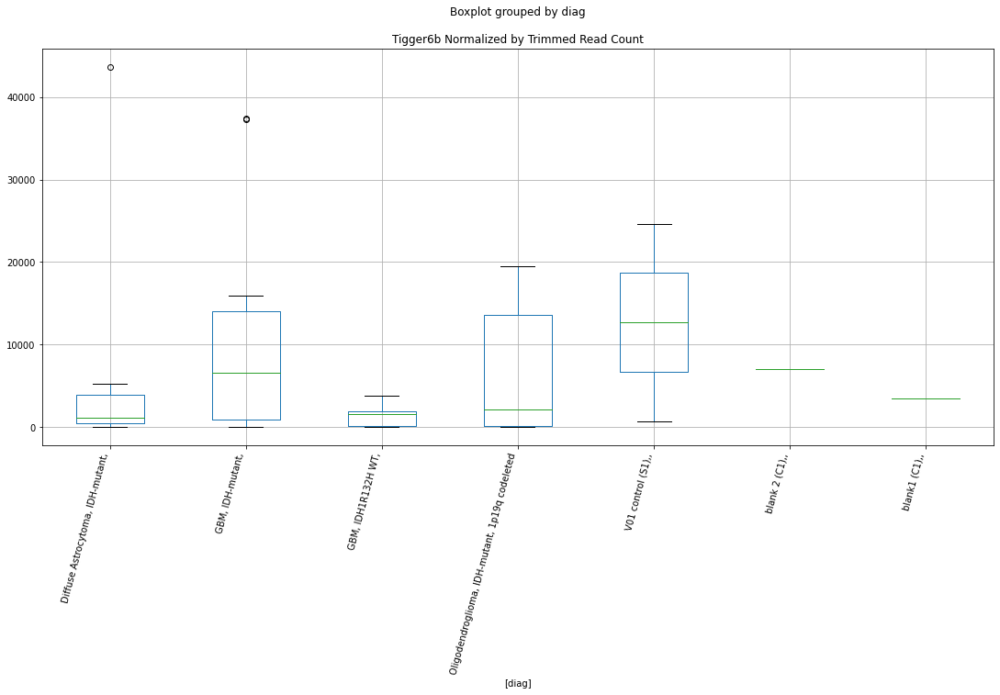

 p : 0.043602462093689724  ( t : 2.1703727545229596 ) :  D-plex  :  bbduk2  :  HERVL40-int
Control and blanks
73      4638.05
337    19583.46
Name: HERVL40-int, dtype: float64
205    25610.01
Name: HERVL40-int, dtype: float64
469    29576.37
Name: HERVL40-int, dtype: float64


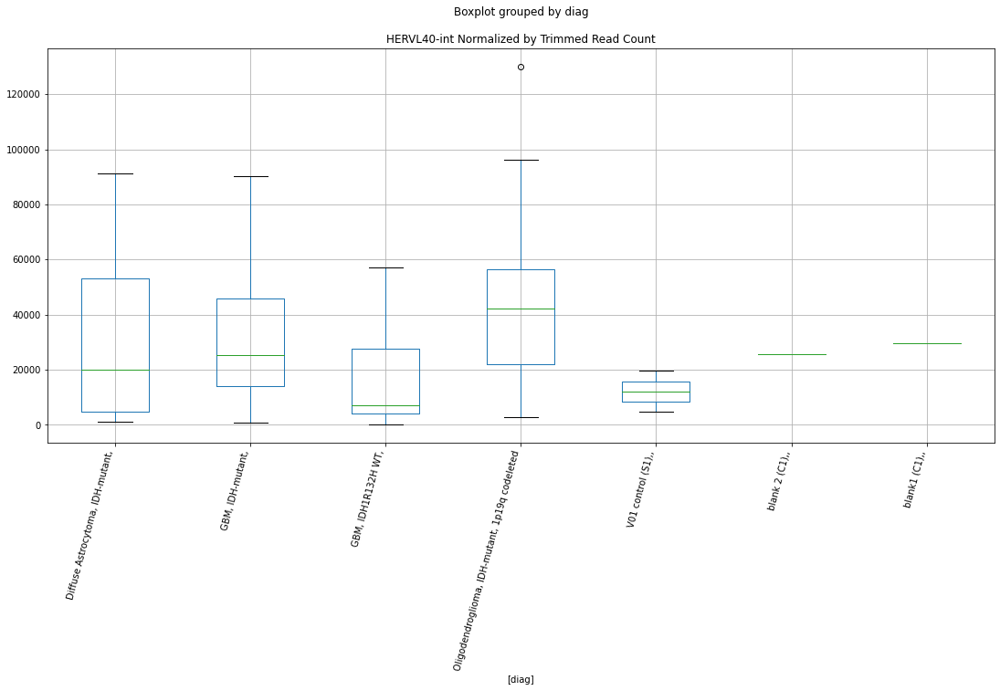

 p : 0.043626230266697985  ( t : 2.1700979371281046 ) :  D-plex  :  cutadapt2  :  FordPrefect
Control and blanks
76     10606.60
340     9688.05
Name: FordPrefect, dtype: float64
208    22926.83
Name: FordPrefect, dtype: float64
472    23118.23
Name: FordPrefect, dtype: float64


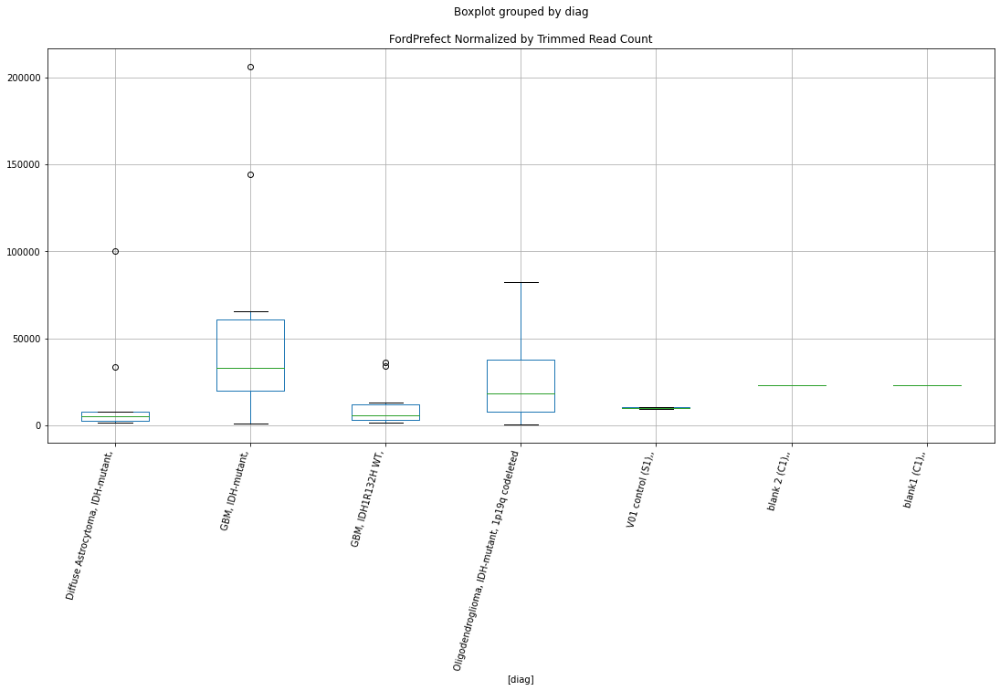

 p : 0.04366717769336049  ( t : 2.1696248075025846 ) :  D-plex  :  bbduk2  :  PABL_A-int
Control and blanks
73     30920.34
337     5340.94
Name: PABL_A-int, dtype: float64
205    14506.37
Name: PABL_A-int, dtype: float64
469    14196.66
Name: PABL_A-int, dtype: float64


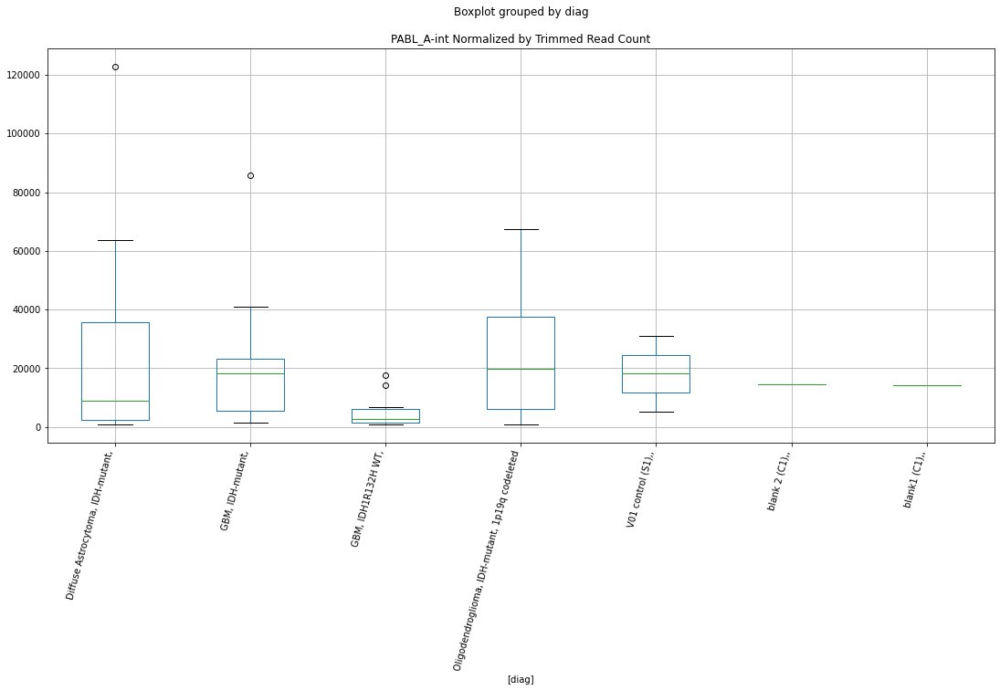

 p : 0.04371378067600992  ( t : 2.1690868243821217 ) :  D-plex  :  cutadapt2  :  (TTTTTA)n
Control and blanks
76        0.00
340    5284.39
Name: (TTTTTA)n, dtype: float64
208    1058.16
Name: (TTTTTA)n, dtype: float64
472    1155.91
Name: (TTTTTA)n, dtype: float64


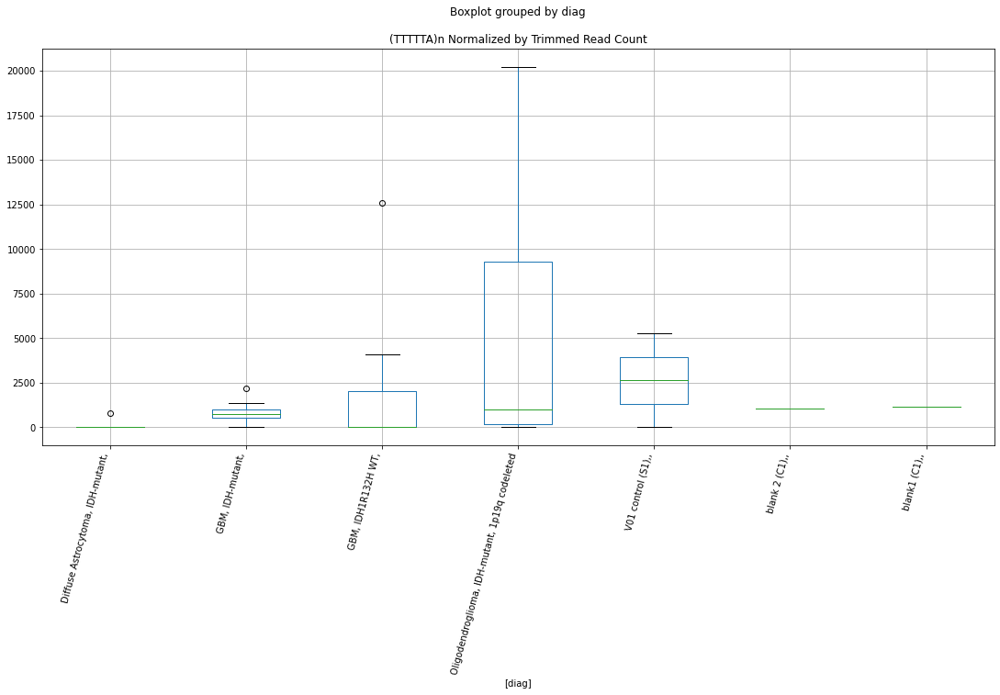

 p : 0.04383912073051329  ( t : 2.1676425043248195 ) :  D-plex  :  cutadapt2  :  MER87
Control and blanks
76     757.61
340      0.00
Name: MER87, dtype: float64
208    3350.84
Name: MER87, dtype: float64
472    1155.91
Name: MER87, dtype: float64


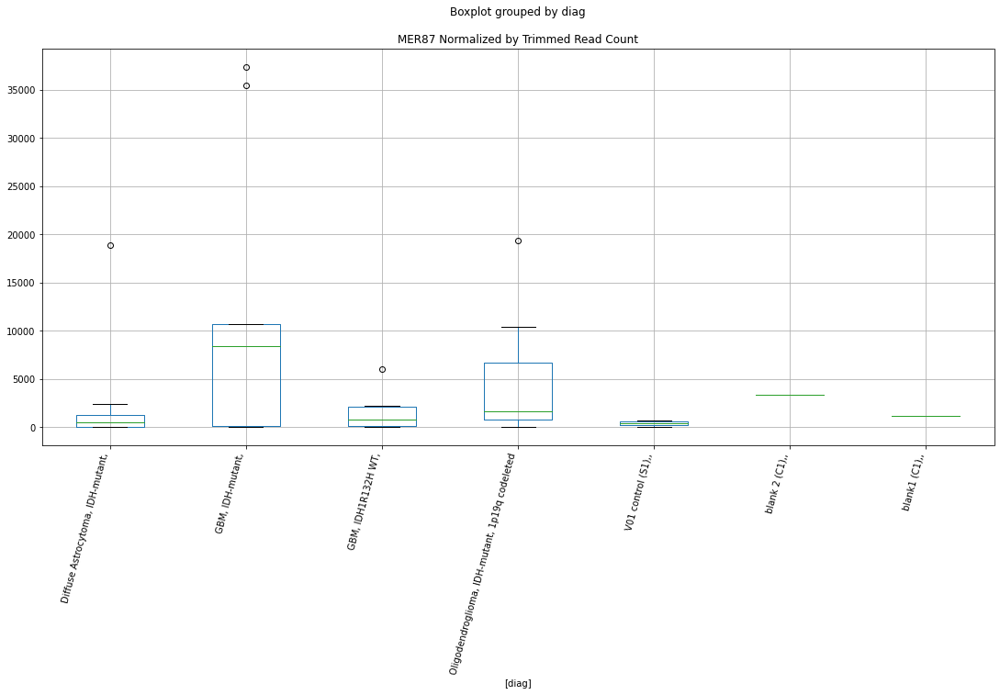

 p : 0.04386423141527154  ( t : 2.1673536031686083 ) :  D-plex  :  cutadapt2  :  (ATATAG)n
Control and blanks
76     0.0
340    0.0
Name: (ATATAG)n, dtype: float64
208    3174.48
Name: (ATATAG)n, dtype: float64
472    4623.65
Name: (ATATAG)n, dtype: float64


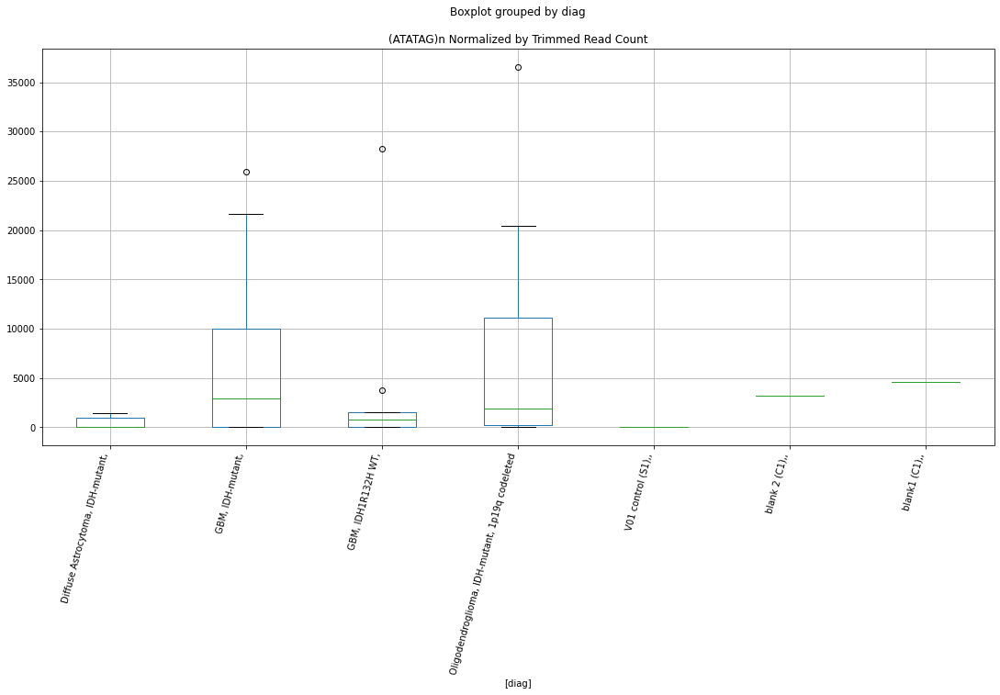

 p : 0.04389351417855382  ( t : 2.1670168929404388 ) :  D-plex  :  cutadapt2  :  LTR25
Control and blanks
76     757.61
340    880.73
Name: LTR25, dtype: float64
208    3879.92
Name: LTR25, dtype: float64
472    2889.78
Name: LTR25, dtype: float64


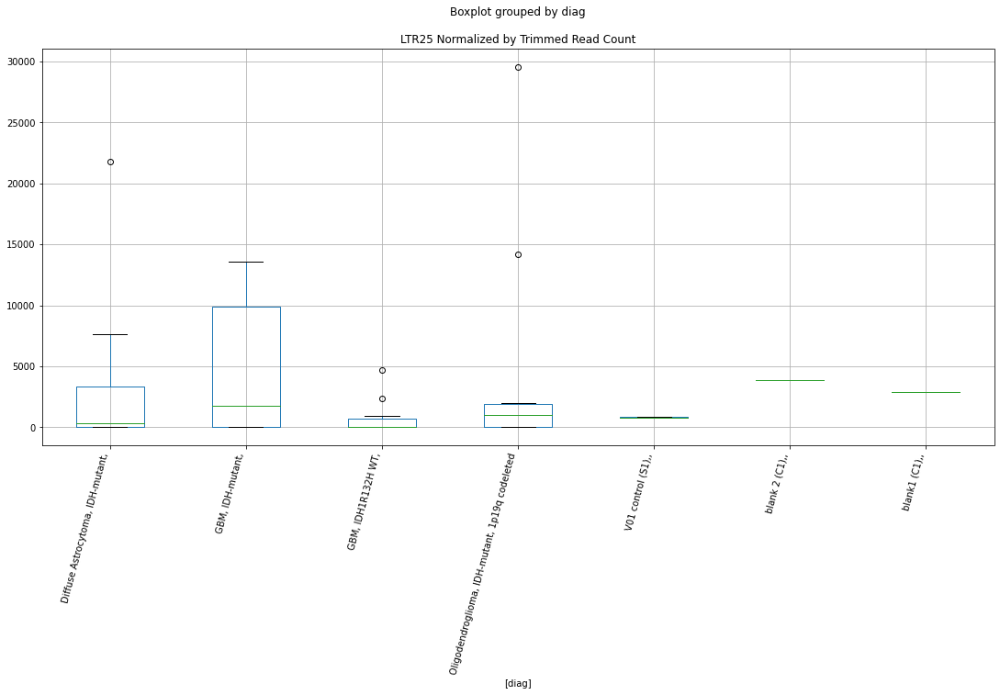

 p : 0.043968649574181104  ( t : 2.166153882189761 ) :  D-plex  :  cutadapt2  :  LFSINE_Vert
Control and blanks
76      3788.07
340    16733.91
Name: LFSINE_Vert, dtype: float64
208    19752.34
Name: LFSINE_Vert, dtype: float64
472    23696.19
Name: LFSINE_Vert, dtype: float64


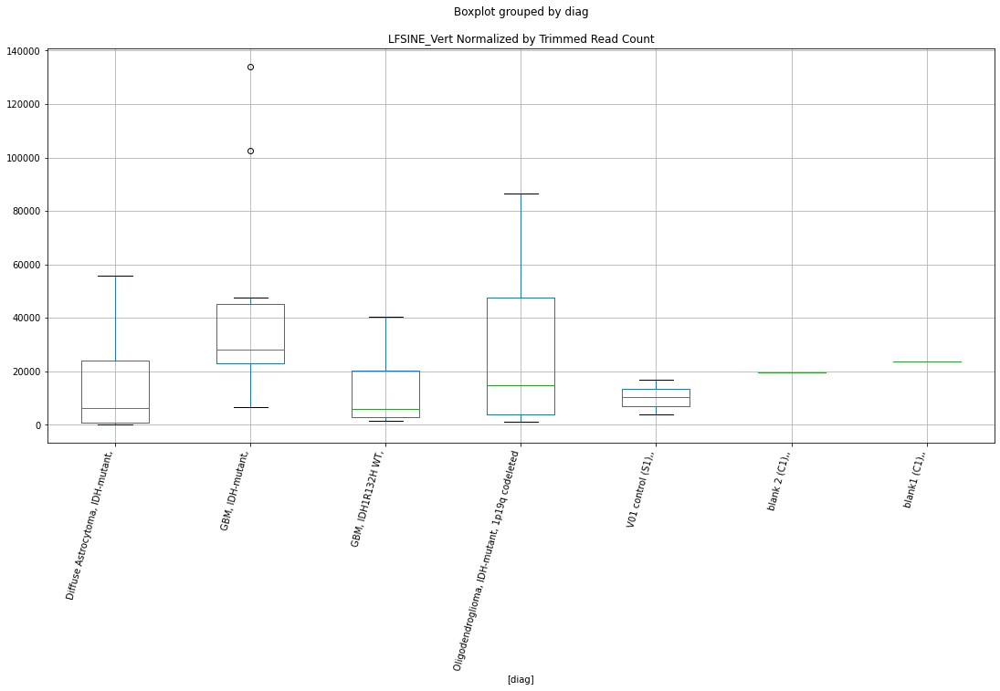

 p : 0.04405521960701517  ( t : 2.165161204274962 ) :  D-plex  :  cutadapt2  :  (CCCTCCT)n
Control and blanks
76     0.0
340    0.0
Name: (CCCTCCT)n, dtype: float64
208    352.72
Name: (CCCTCCT)n, dtype: float64
472    1155.91
Name: (CCCTCCT)n, dtype: float64


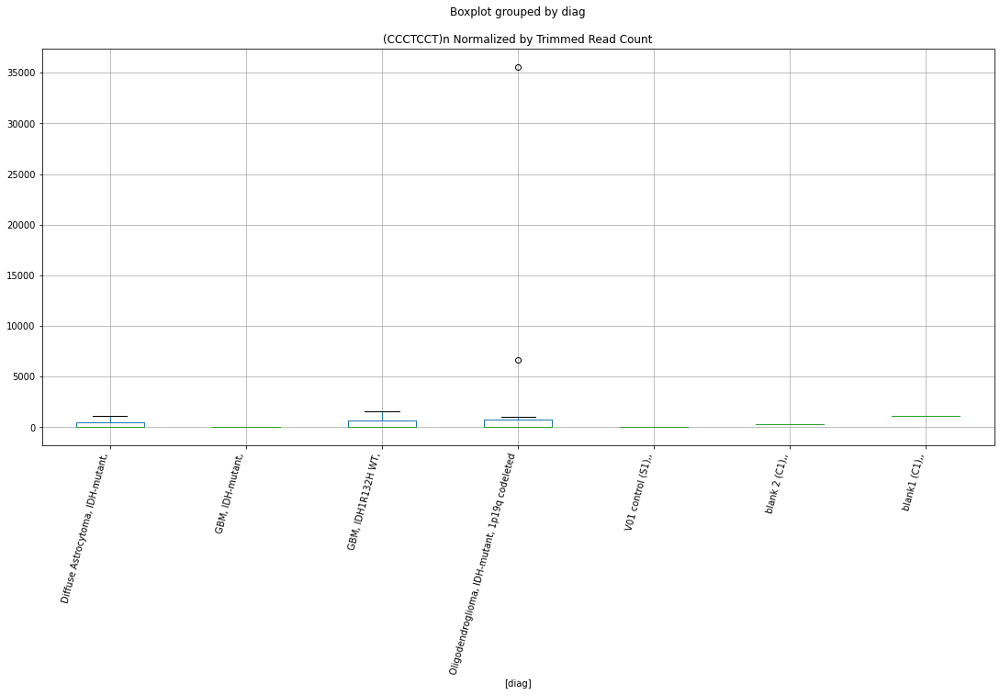

 p : 0.04409247237331871  ( t : 2.164734584975195 ) :  D-plex  :  bbduk2  :  (GGT)n
Control and blanks
73     0.0
337    0.0
Name: (GGT)n, dtype: float64
205    1790.91
Name: (GGT)n, dtype: float64
469    4140.69
Name: (GGT)n, dtype: float64


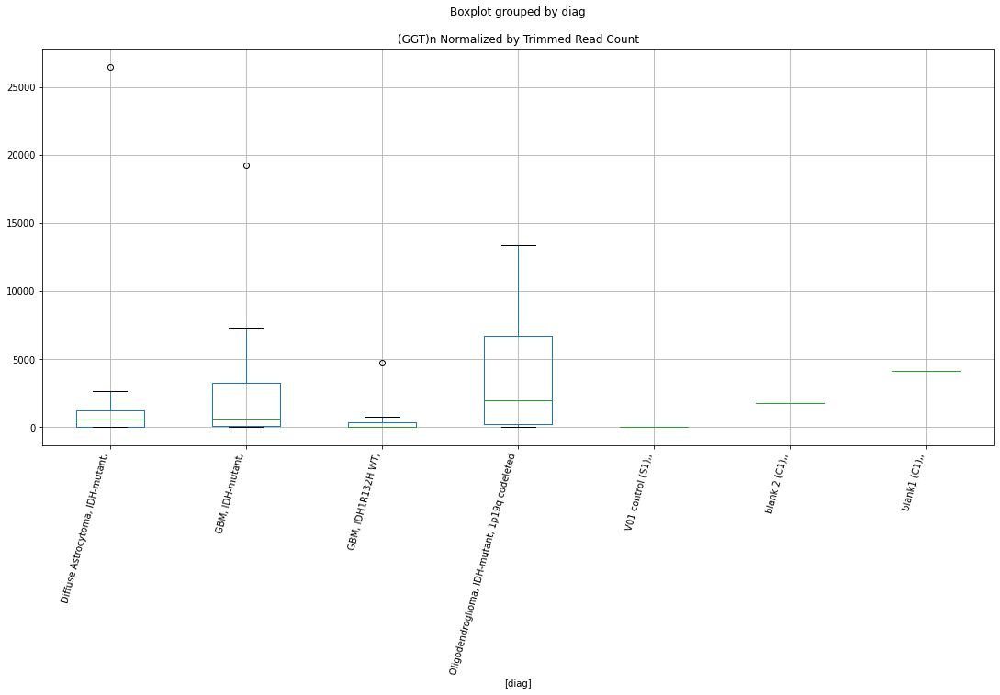

 p : 0.044103335436382674  ( t : 2.1646102431127807 ) :  D-plex  :  bbduk2  :  X6A_LINE
Control and blanks
73     3865.04
337    7121.26
Name: X6A_LINE, dtype: float64
205    8954.55
Name: X6A_LINE, dtype: float64
469    8281.38
Name: X6A_LINE, dtype: float64


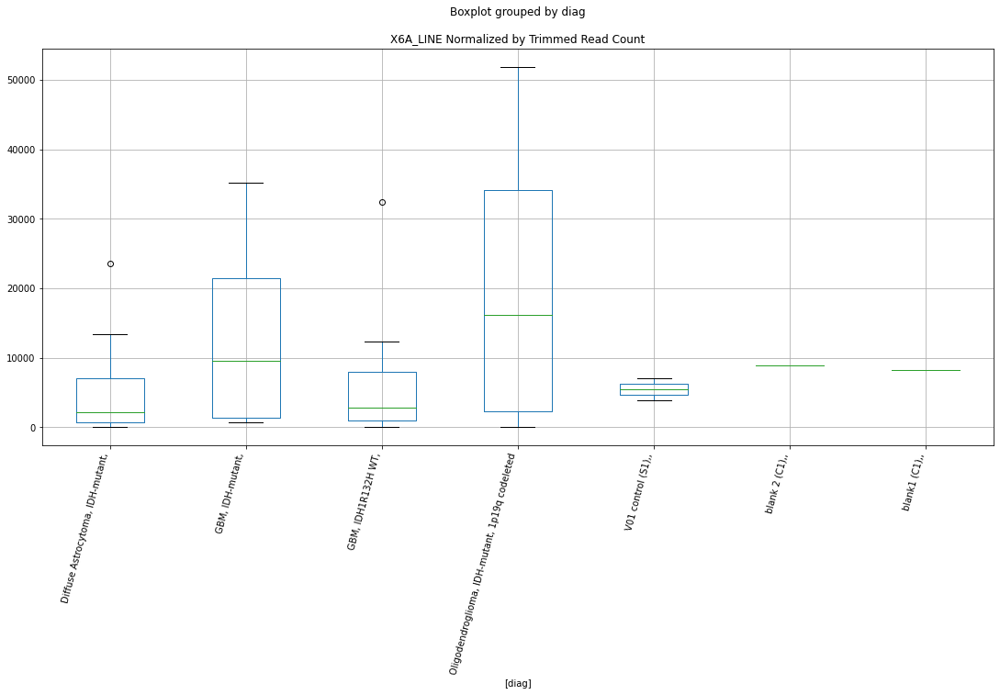

 p : 0.04410562982215882  ( t : 2.164583984473245 ) :  D-plex  :  cutadapt2  :  L1ME3Cz
Control and blanks
76      65154.82
340    477356.82
Name: L1ME3Cz, dtype: float64
208    262247.64
Name: L1ME3Cz, dtype: float64
472    247943.06
Name: L1ME3Cz, dtype: float64


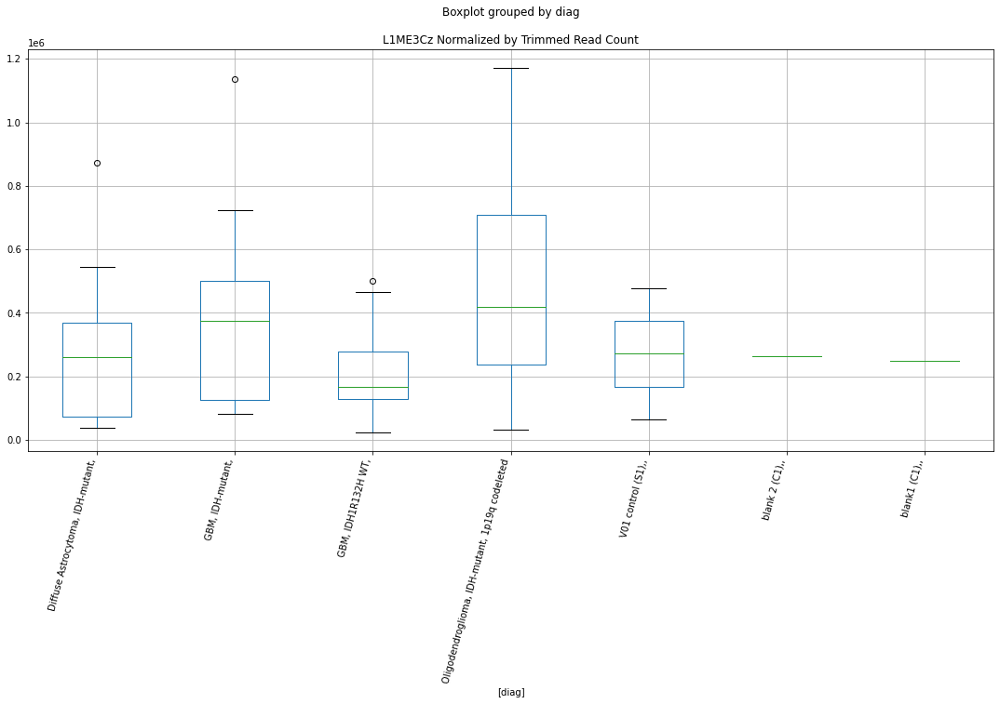

 p : 0.044164533468509744  ( t : 2.1639102754085604 ) :  D-plex  :  cutadapt2  :  (ATATGT)n
Control and blanks
76         0.00
340    18495.37
Name: (ATATGT)n, dtype: float64
208    3703.56
Name: (ATATGT)n, dtype: float64
472    577.96
Name: (ATATGT)n, dtype: float64


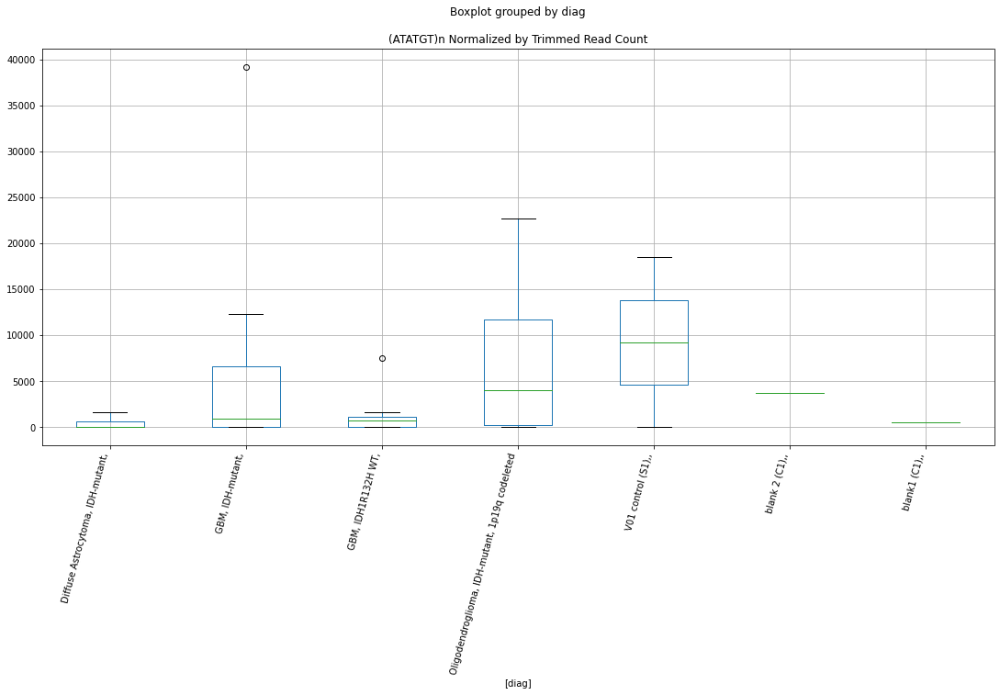

 p : 0.04421405882271902  ( t : 2.163344466307536 ) :  D-plex  :  bbduk2  :  L1ME3C
Control and blanks
73      43288.47
337    141535.00
Name: L1ME3C, dtype: float64
205    82381.84
Name: L1ME3C, dtype: float64
469    72166.33
Name: L1ME3C, dtype: float64


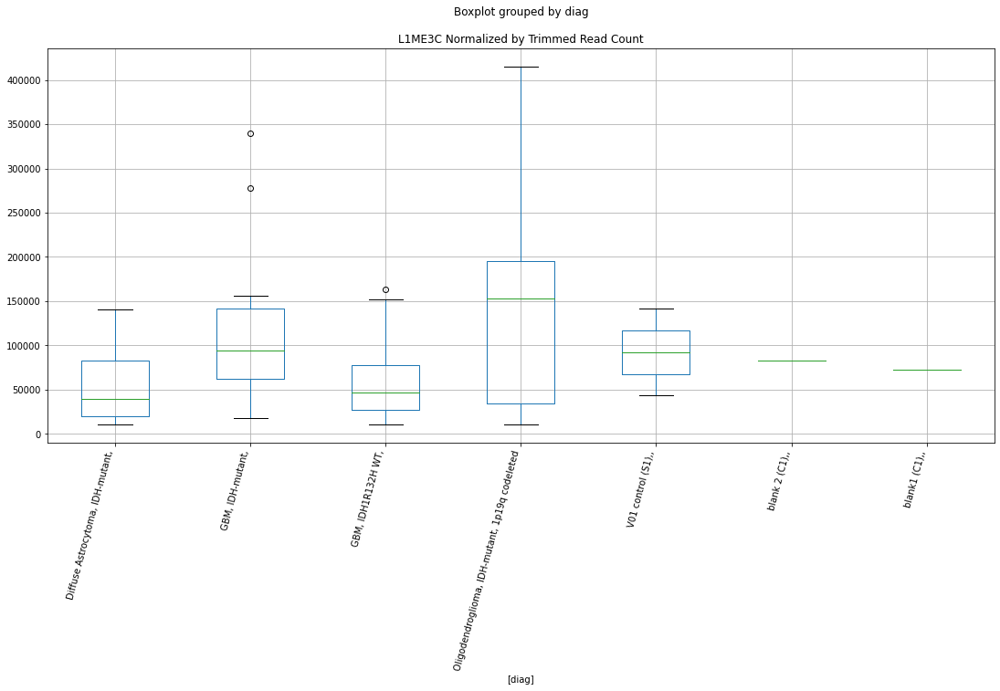

 p : 0.044298300376449766  ( t : 2.162383368044141 ) :  D-plex  :  bbduk2  :  (TCCT)n
Control and blanks
73     61067.66
337    42727.55
Name: (TCCT)n, dtype: float64
205    31340.92
Name: (TCCT)n, dtype: float64
469    28984.84
Name: (TCCT)n, dtype: float64


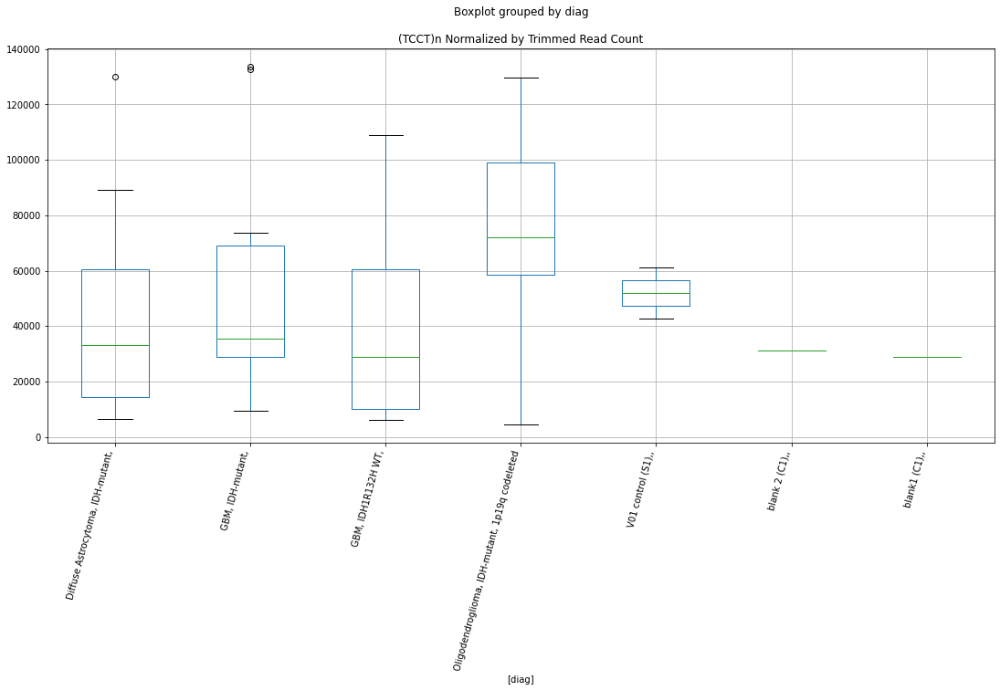

 p : 0.044329037652936956  ( t : 2.162033107765335 ) :  D-plex  :  bbduk2  :  HERVK-int
Control and blanks
73     53337.58
337    19583.46
Name: HERVK-int, dtype: float64
205    30266.37
Name: HERVK-int, dtype: float64
469    31350.95
Name: HERVK-int, dtype: float64


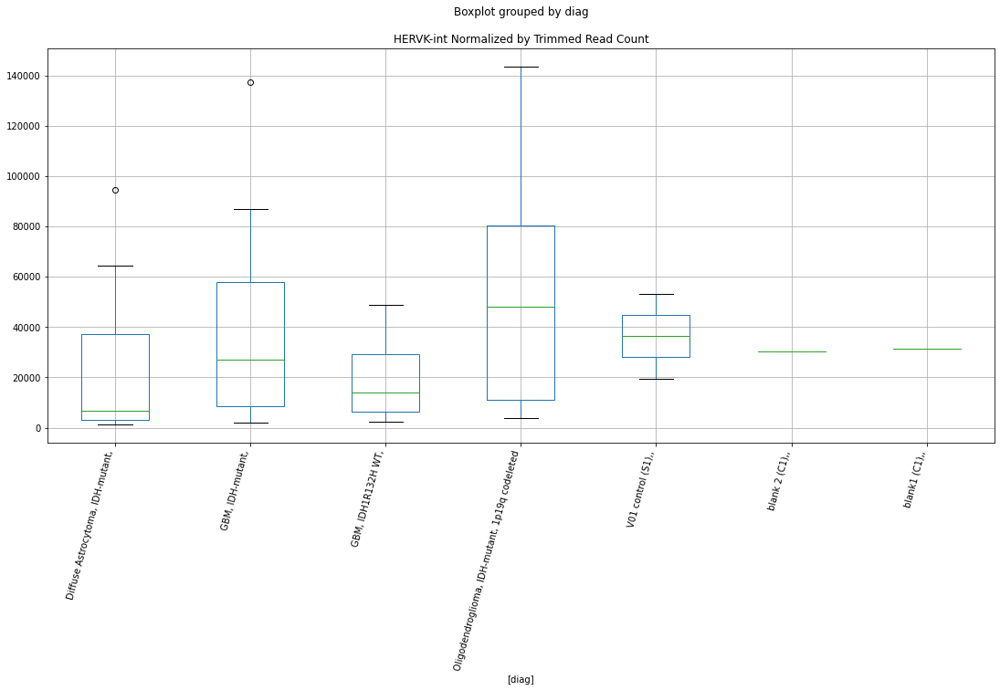

 p : 0.044360457996751194  ( t : 2.1616752933102306 ) :  Lexogen  :  cutadapt2  :  L1PA3
Control and blanks
82     1420.05
346     420.87
Name: L1PA3, dtype: float64
214    0.0
Name: L1PA3, dtype: float64
478    949.84
Name: L1PA3, dtype: float64


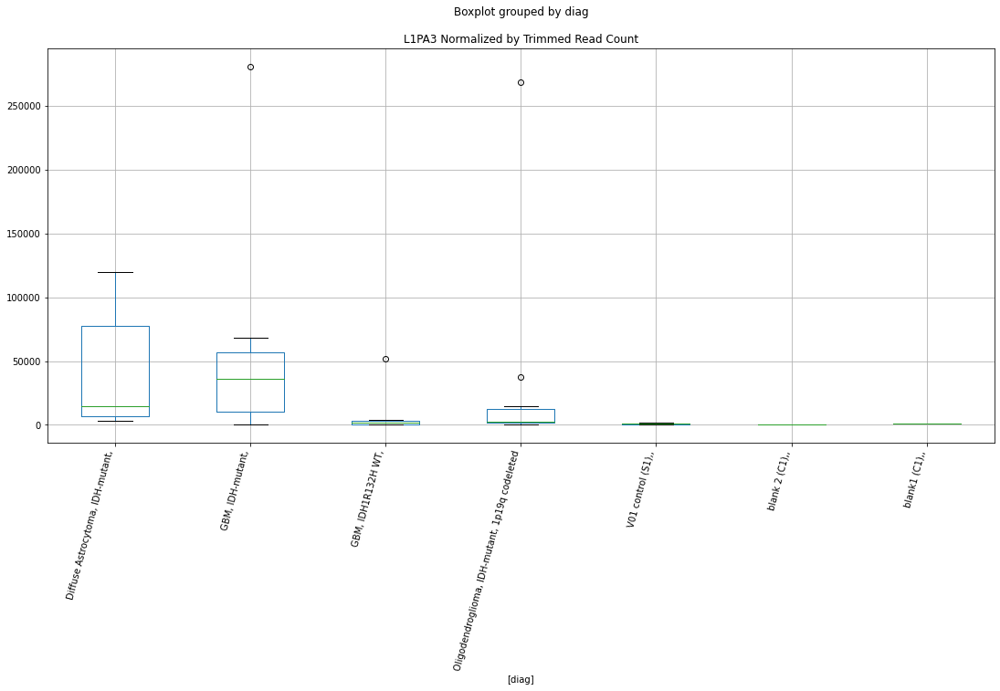

 p : 0.0443789771879865  ( t : 2.161464505593165 ) :  D-plex  :  cutadapt2  :  MIR1_Amn
Control and blanks
76     15152.28
340    33467.82
Name: MIR1_Amn, dtype: float64
208    92060.03
Name: MIR1_Amn, dtype: float64
472    91317.02
Name: MIR1_Amn, dtype: float64


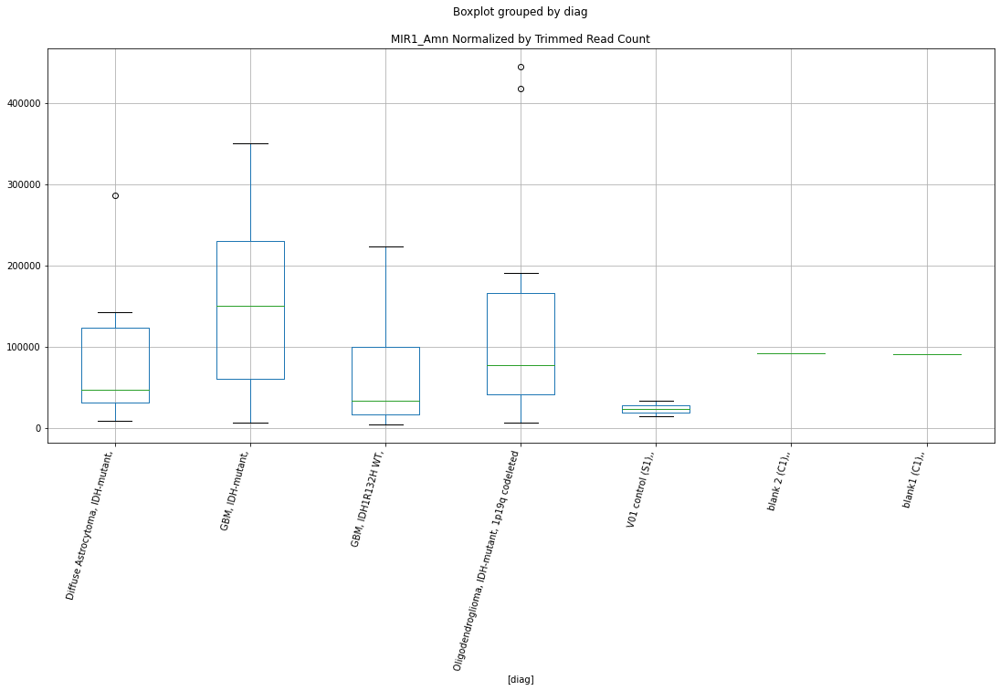

 p : 0.044485758912452725  ( t : 2.1602506701354165 ) :  D-plex  :  bbduk2  :  MLT2B2
Control and blanks
73      20871.23
337    106818.87
Name: MLT2B2, dtype: float64
205    48891.83
Name: MLT2B2, dtype: float64
469    41998.44
Name: MLT2B2, dtype: float64


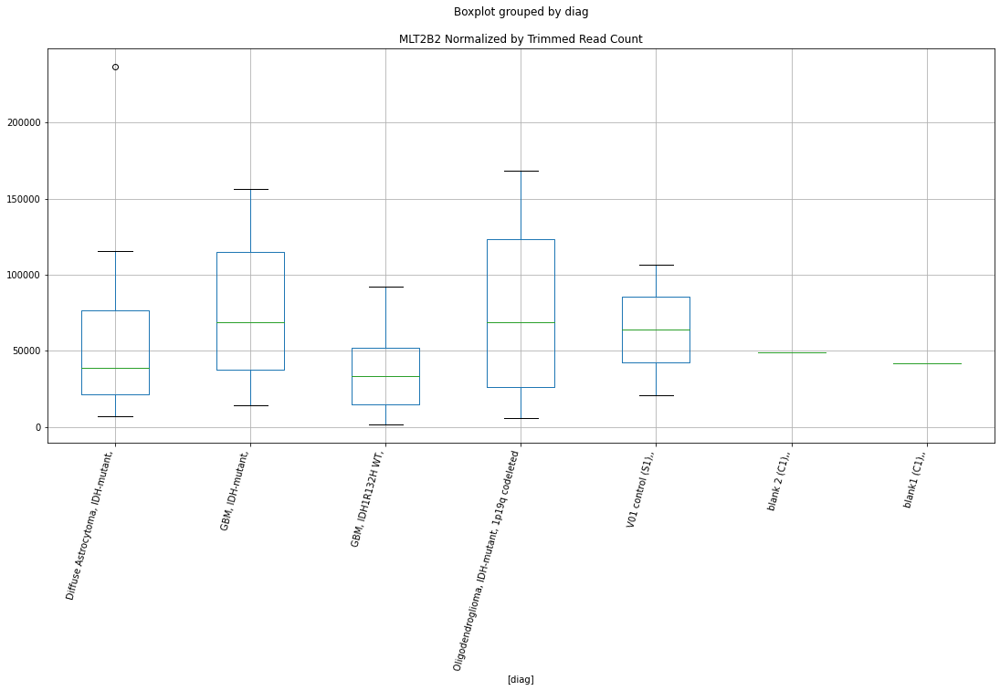

 p : 0.044539410602127114  ( t : 2.1596417930760357 ) :  D-plex  :  cutadapt2  :  (TCCT)n
Control and blanks
76     73488.58
340    48440.27
Name: (TCCT)n, dtype: float64
208    37388.37
Name: (TCCT)n, dtype: float64
472    31787.57
Name: (TCCT)n, dtype: float64


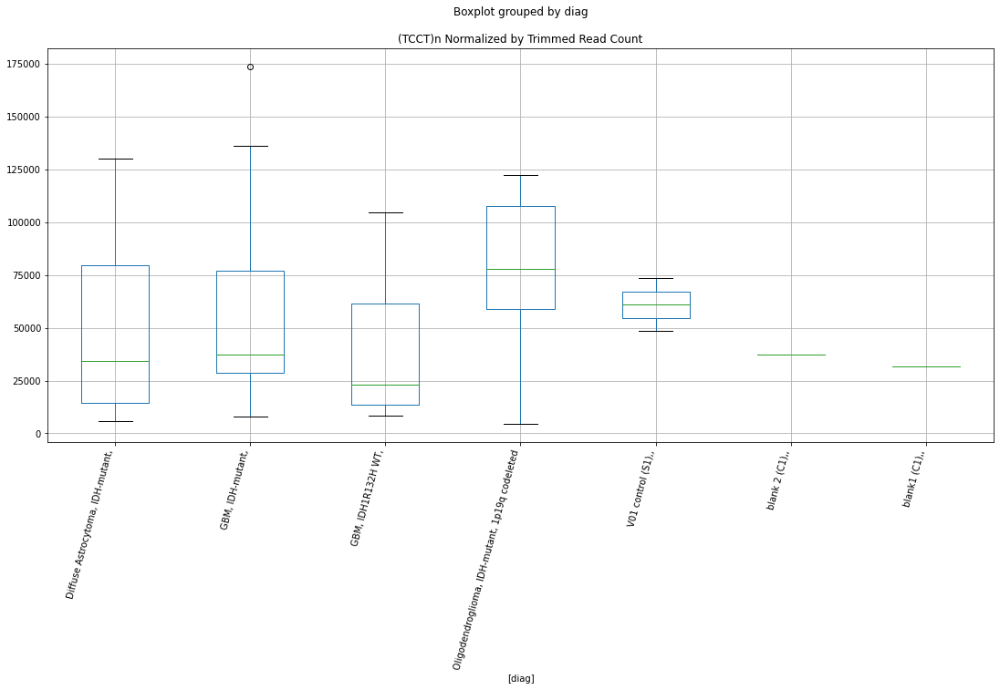

 p : 0.044609452964676125  ( t : 2.15884791190532 ) :  D-plex  :  cutadapt2  :  (CCACCC)n
Control and blanks
76     757.61
340      0.00
Name: (CCACCC)n, dtype: float64
208    0.0
Name: (CCACCC)n, dtype: float64
472    577.96
Name: (CCACCC)n, dtype: float64


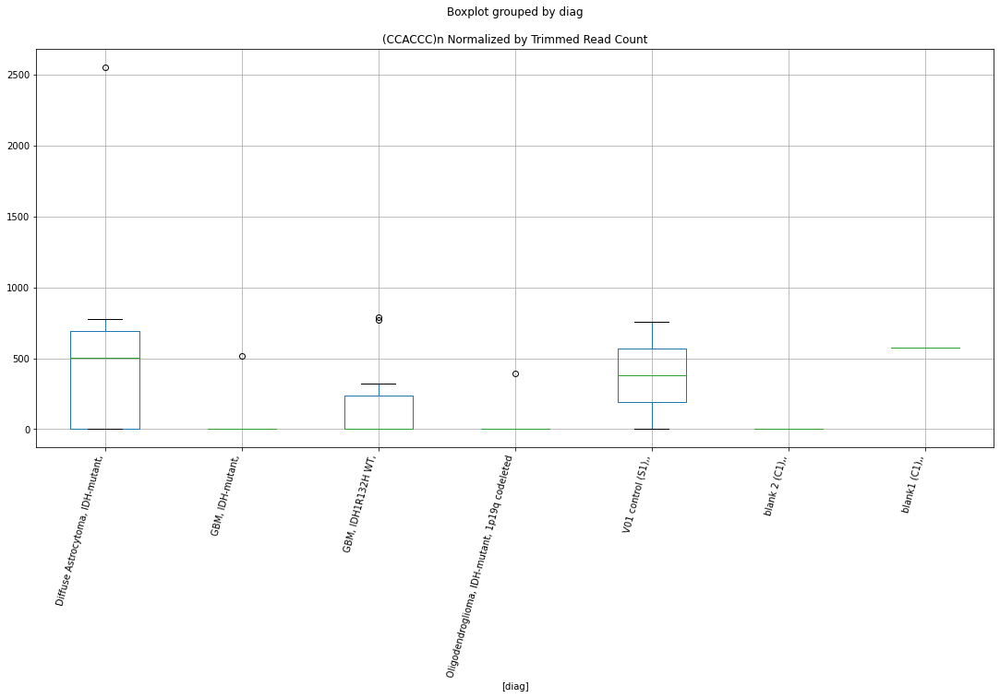

 p : 0.04462062445273628  ( t : 2.1587213963329606 ) :  D-plex  :  cutadapt2  :  (CTATT)n
Control and blanks
76     0.0
340    0.0
Name: (CTATT)n, dtype: float64
208    705.44
Name: (CTATT)n, dtype: float64
472    1155.91
Name: (CTATT)n, dtype: float64


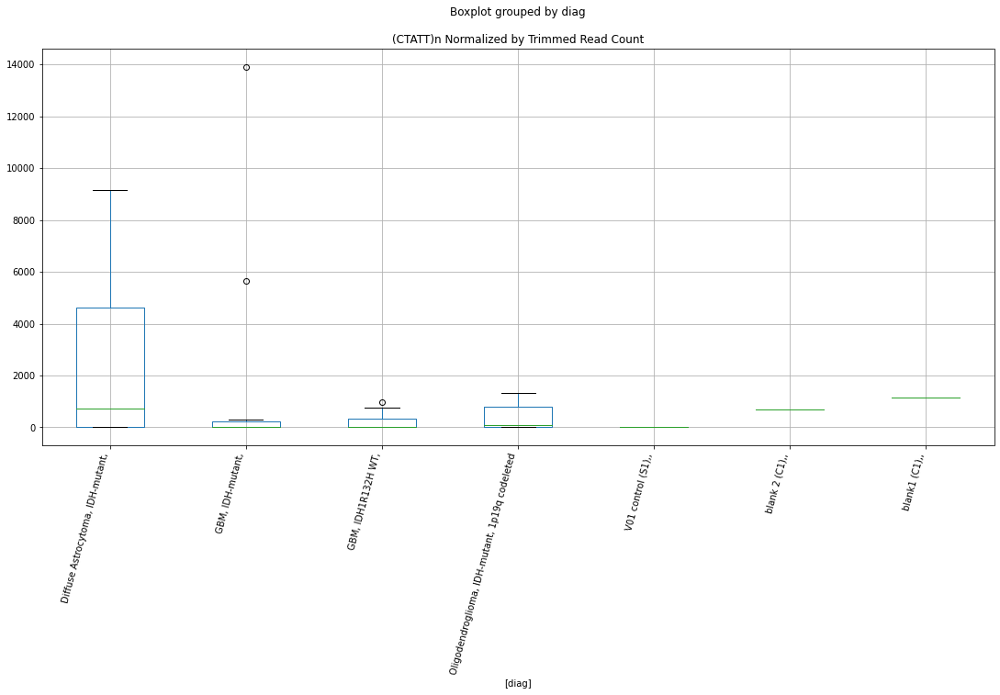

 p : 0.044711874138695096  ( t : 2.157689089403932 ) :  D-plex  :  cutadapt2  :  THE1D
Control and blanks
76     264407.36
340    161173.98
Name: THE1D, dtype: float64
208    260660.4
Name: THE1D, dtype: float64
472    232916.2
Name: THE1D, dtype: float64


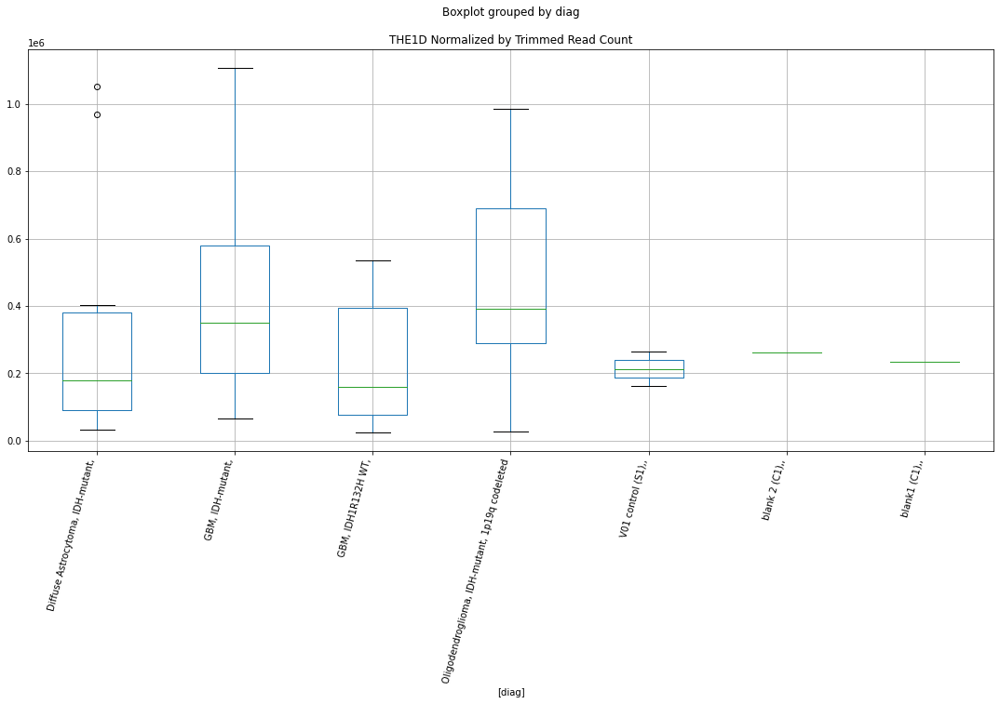

 p : 0.044872905429696804  ( t : 2.1558720344081532 ) :  D-plex  :  cutadapt2  :  LTR44
Control and blanks
76     1515.23
340     880.73
Name: LTR44, dtype: float64
208    4585.37
Name: LTR44, dtype: float64
472    4045.69
Name: LTR44, dtype: float64


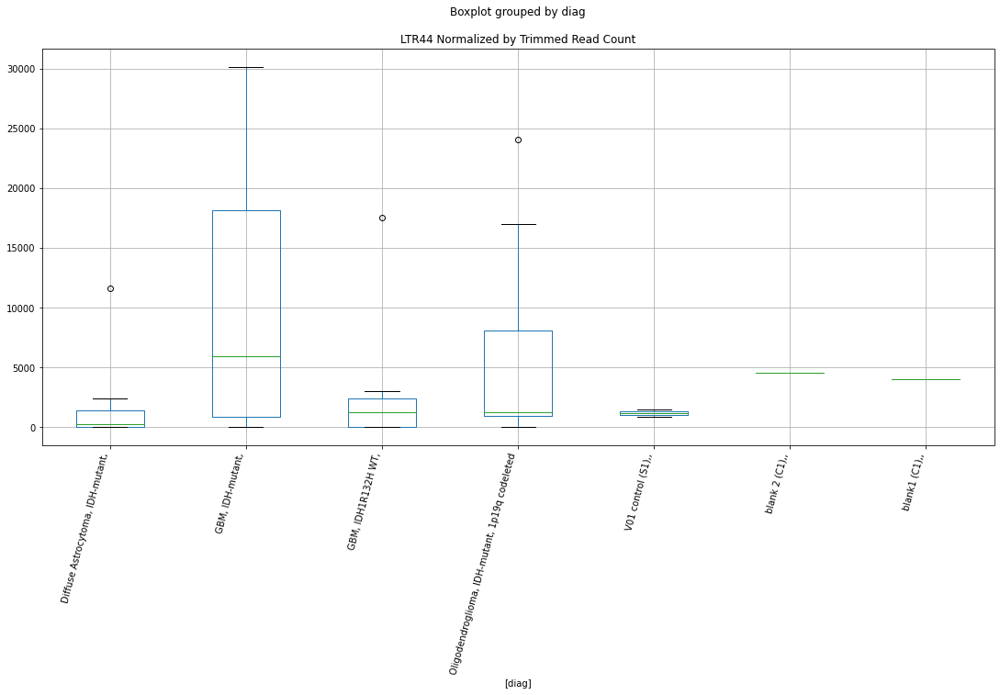

 p : 0.04500880706363316  ( t : 2.1543431719285295 ) :  D-plex  :  cutadapt2  :  MSR1
Control and blanks
76     6060.91
340       0.00
Name: MSR1, dtype: float64
208    5290.81
Name: MSR1, dtype: float64
472    6935.47
Name: MSR1, dtype: float64


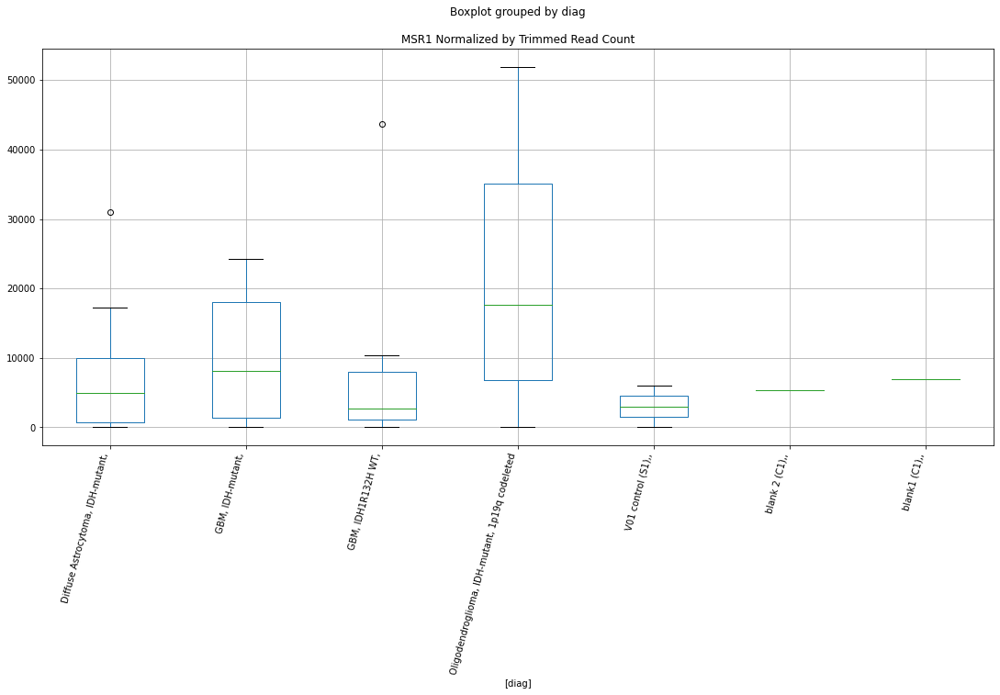

 p : 0.04503585530810364  ( t : 2.154039388955803 ) :  D-plex  :  cutadapt2  :  Tigger11a
Control and blanks
76     2272.84
340     880.73
Name: Tigger11a, dtype: float64
208    5996.25
Name: Tigger11a, dtype: float64
472    6357.51
Name: Tigger11a, dtype: float64


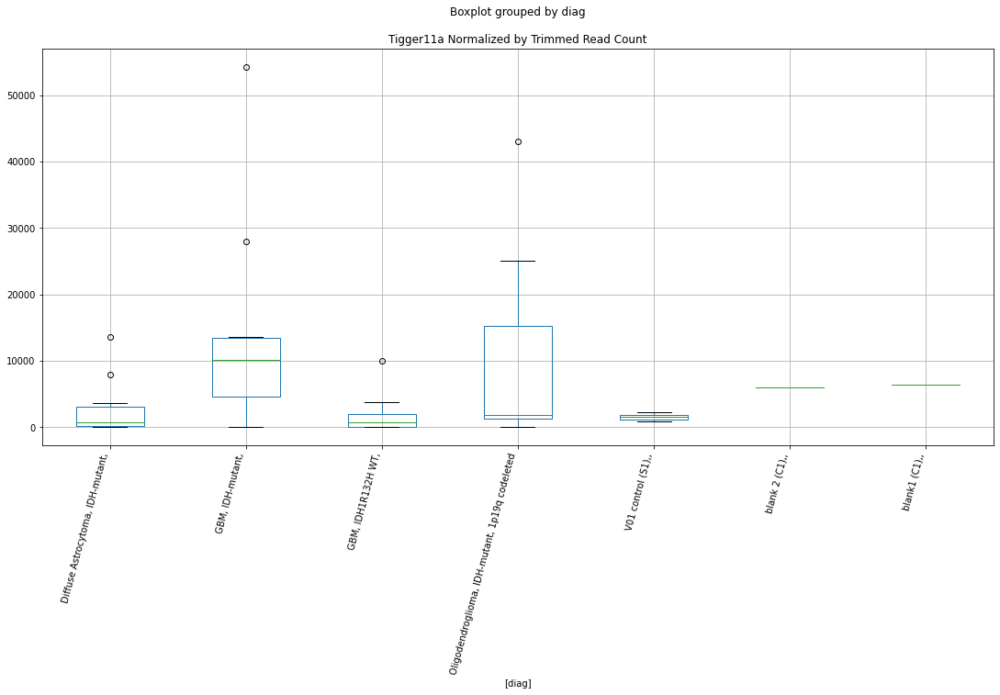

 p : 0.045111946744004774  ( t : 2.1531856880403515 ) :  D-plex  :  bbduk2  :  (TTTTCCT)n
Control and blanks
73     0.0
337    0.0
Name: (TTTTCCT)n, dtype: float64
205    0.0
Name: (TTTTCCT)n, dtype: float64
469    0.0
Name: (TTTTCCT)n, dtype: float64


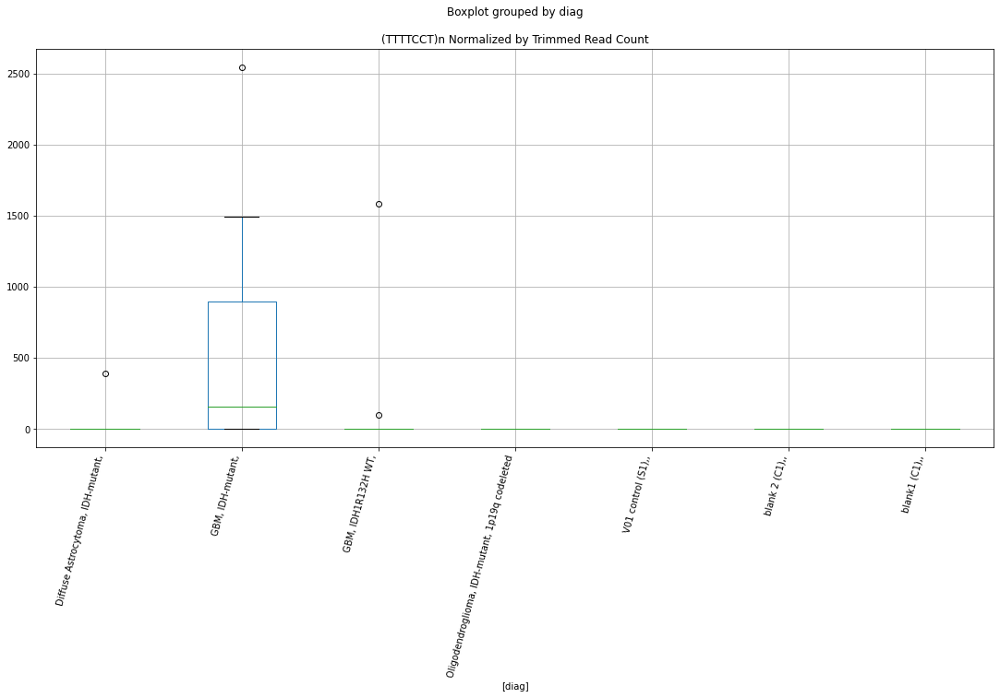

 p : 0.045152033543285626  ( t : 2.152736467063451 ) :  D-plex  :  bbduk2  :  MER57A-int
Control and blanks
73     66478.72
337    54299.59
Name: MER57A-int, dtype: float64
205    48712.74
Name: MER57A-int, dtype: float64
469    42589.97
Name: MER57A-int, dtype: float64


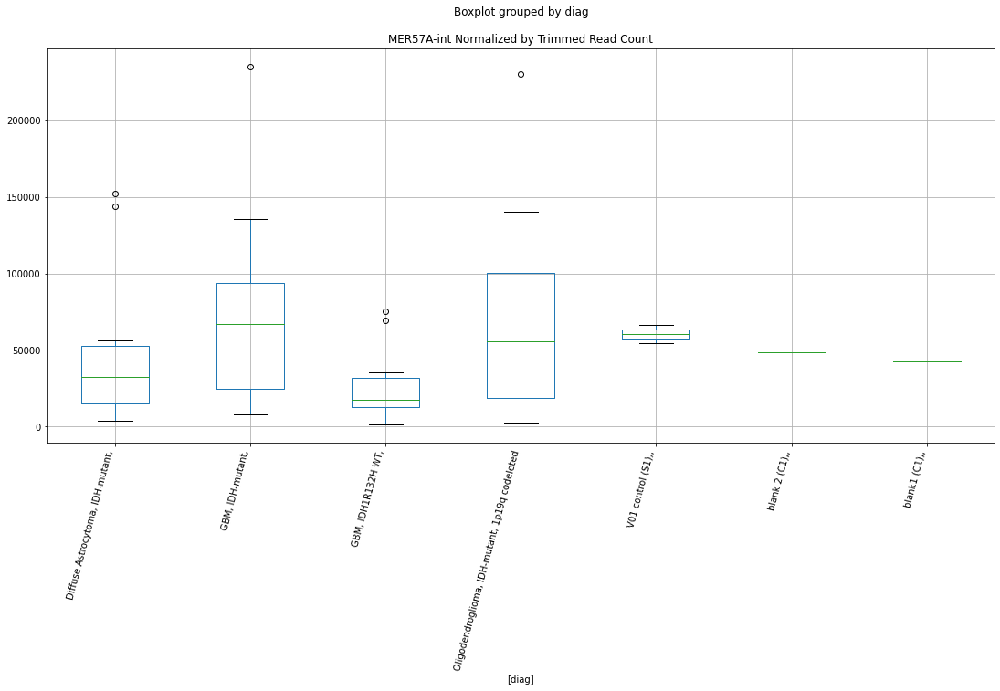

 p : 0.045199237668980166  ( t : 2.1522079549600686 ) :  D-plex  :  cutadapt2  :  (CTCC)n
Control and blanks
76     69700.51
340    38752.21
Name: (CTCC)n, dtype: float64
208    13579.74
Name: (CTCC)n, dtype: float64
472    17916.63
Name: (CTCC)n, dtype: float64


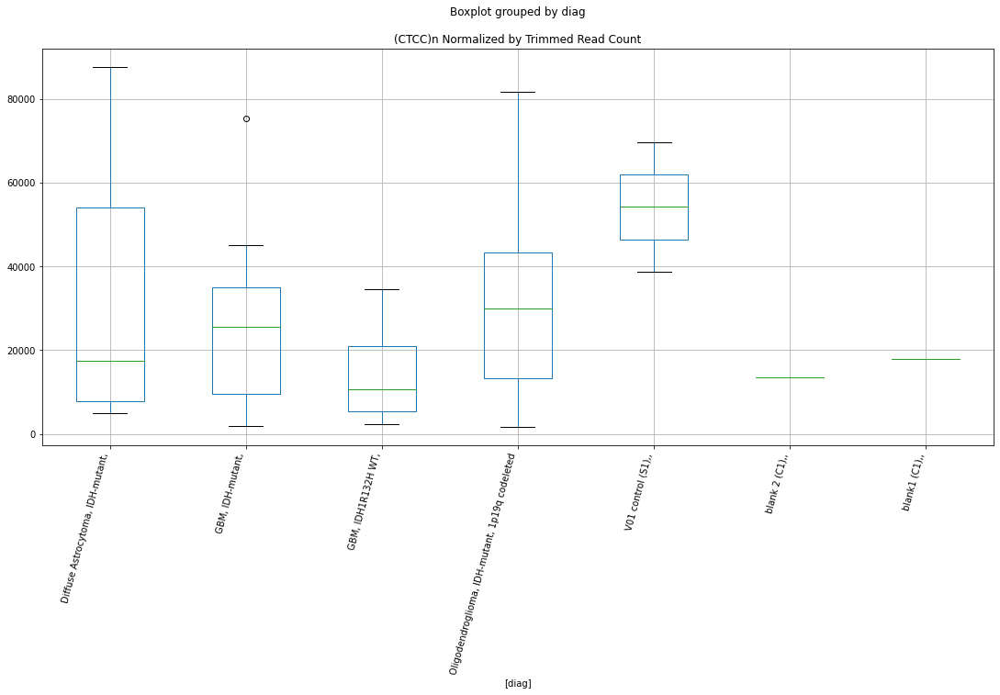

 p : 0.045259895830079416  ( t : 2.151529547390226 ) :  Lexogen  :  bbduk2  :  L1PA3
Control and blanks
79       0.00
343    636.94
Name: L1PA3, dtype: float64
211    0.0
Name: L1PA3, dtype: float64
475    958.06
Name: L1PA3, dtype: float64


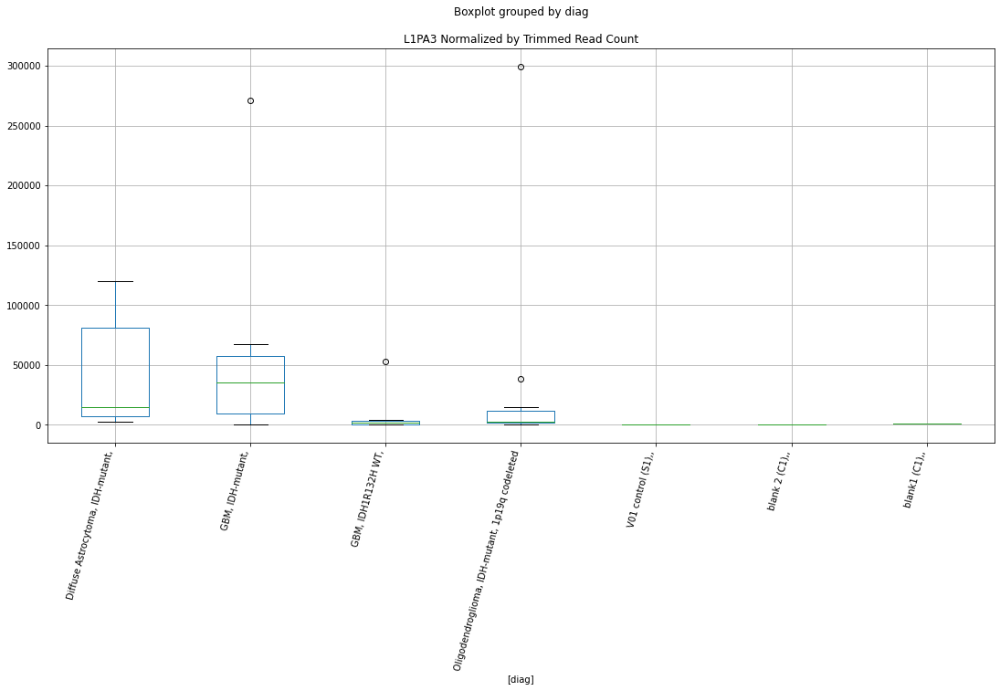

 p : 0.045290915401973136  ( t : 2.151182942115297 ) :  D-plex  :  cutadapt2  :  (GGAGGC)n
Control and blanks
76     0.0
340    0.0
Name: (GGAGGC)n, dtype: float64
208    176.36
Name: (GGAGGC)n, dtype: float64
472    0.0
Name: (GGAGGC)n, dtype: float64


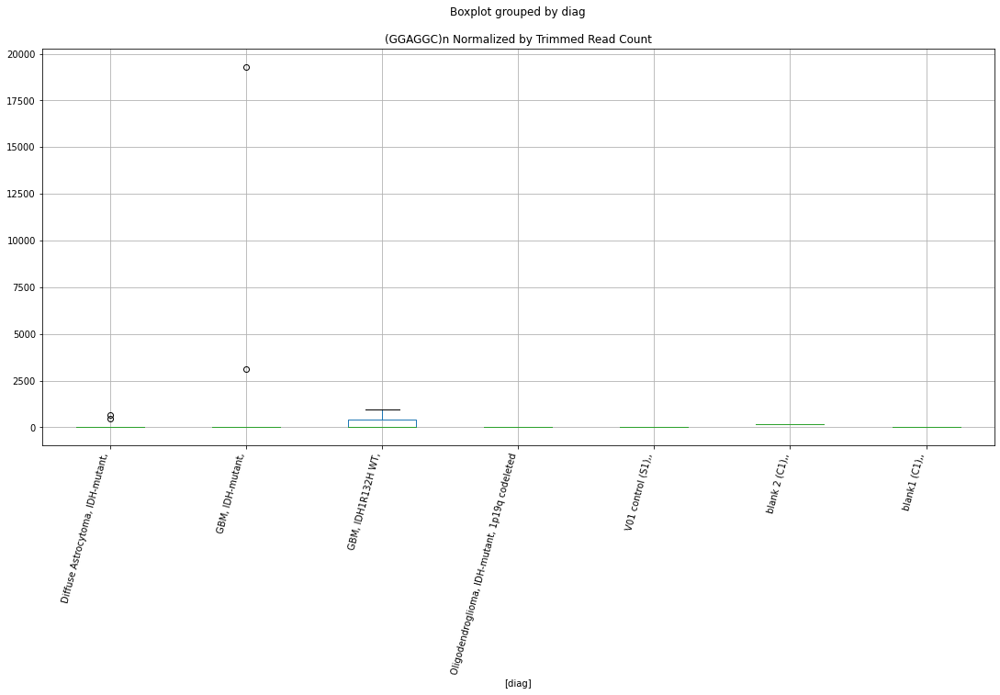

 p : 0.04535305475087839  ( t : 2.150489263954046 ) :  D-plex  :  cutadapt2  :  (AAAAC)n
Control and blanks
76     1515.23
340    7926.59
Name: (AAAAC)n, dtype: float64
208    176.36
Name: (AAAAC)n, dtype: float64
472    1155.91
Name: (AAAAC)n, dtype: float64


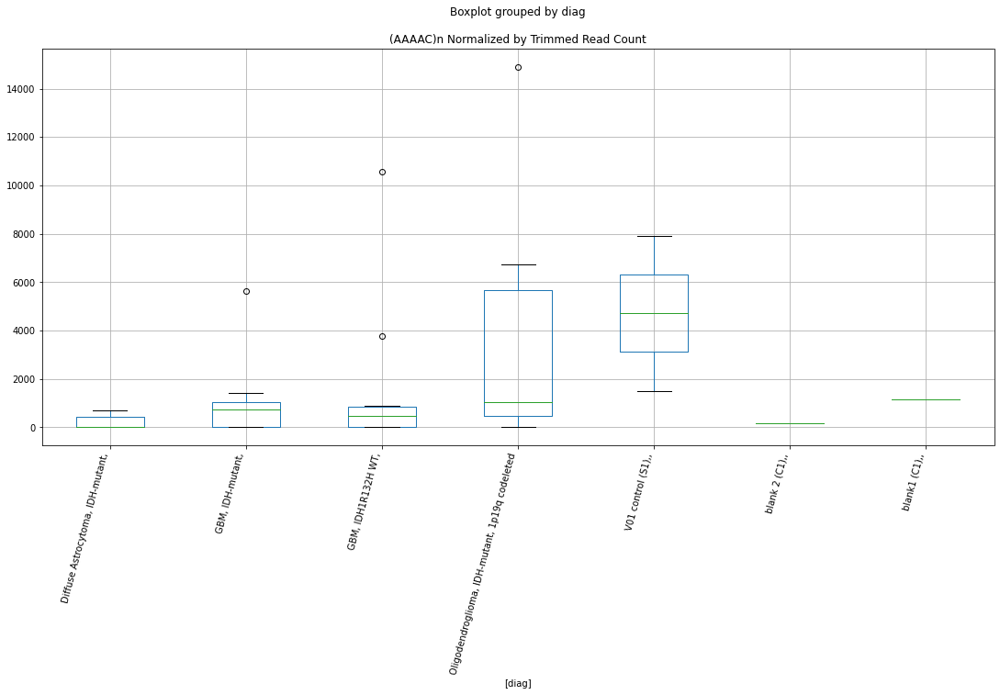

 p : 0.04543645232092341  ( t : 2.1495596382671374 ) :  Lexogen  :  cutadapt2  :  L1PA8
Control and blanks
82         0.00
346    22306.06
Name: L1PA8, dtype: float64
214    0.0
Name: L1PA8, dtype: float64
478    0.0
Name: L1PA8, dtype: float64


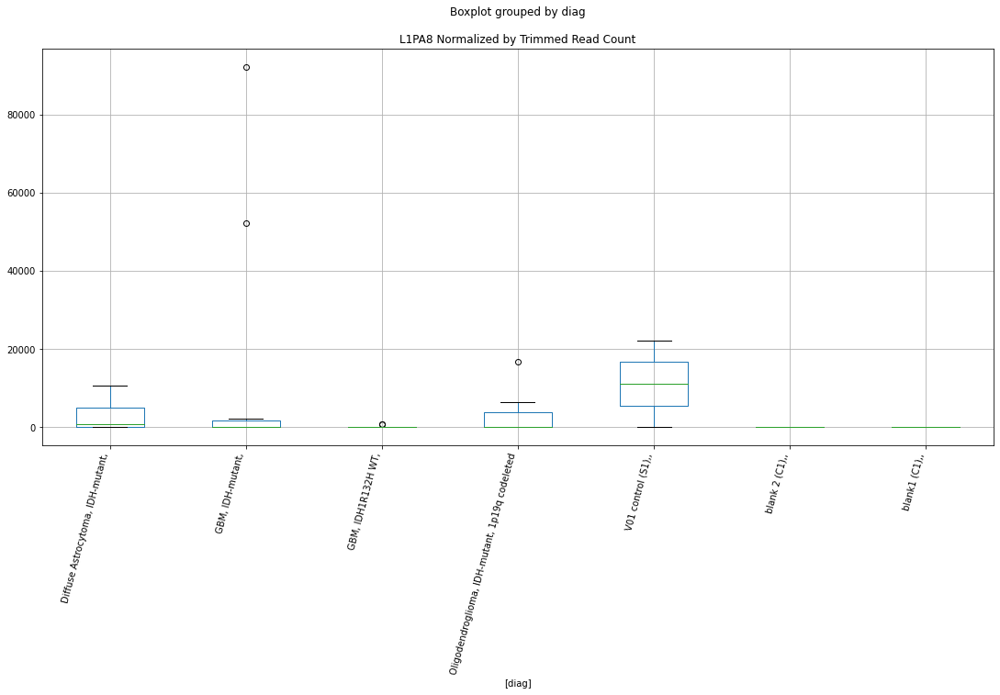

 p : 0.04547905938100646  ( t : 2.1490853025105725 ) :  D-plex  :  bbduk2  :  MLT1C-int
Control and blanks
73     4638.05
337       0.00
Name: MLT1C-int, dtype: float64
205    10924.55
Name: MLT1C-int, dtype: float64
469    8872.91
Name: MLT1C-int, dtype: float64


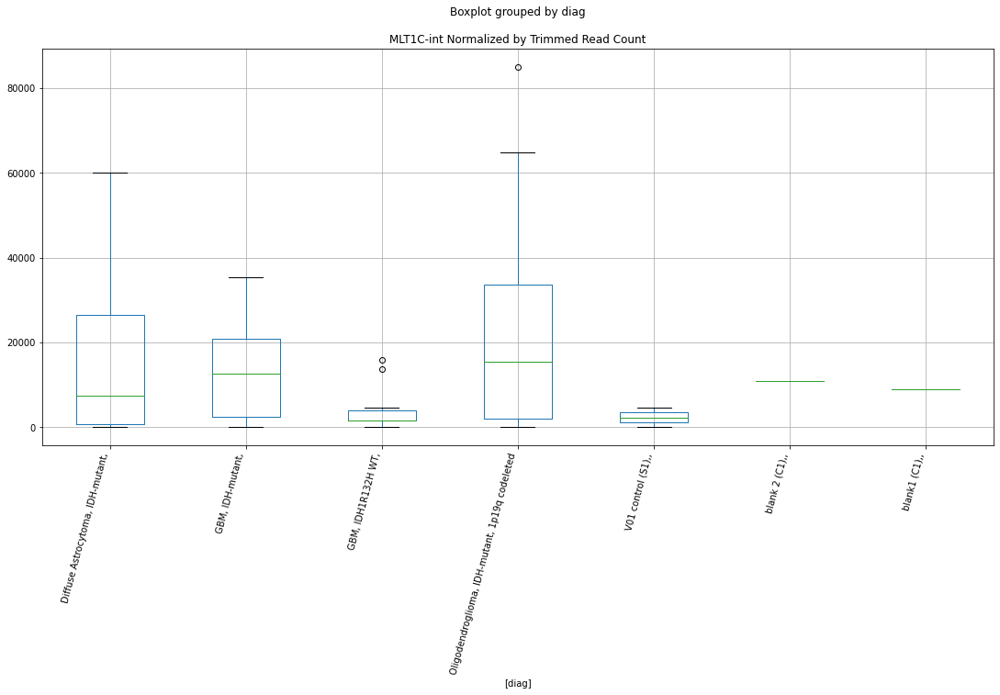

 p : 0.045518639103599164  ( t : 2.148645033103938 ) :  D-plex  :  bbduk2  :  (GGAGGC)n
Control and blanks
73     0.0
337    0.0
Name: (GGAGGC)n, dtype: float64
205    179.09
Name: (GGAGGC)n, dtype: float64
469    0.0
Name: (GGAGGC)n, dtype: float64


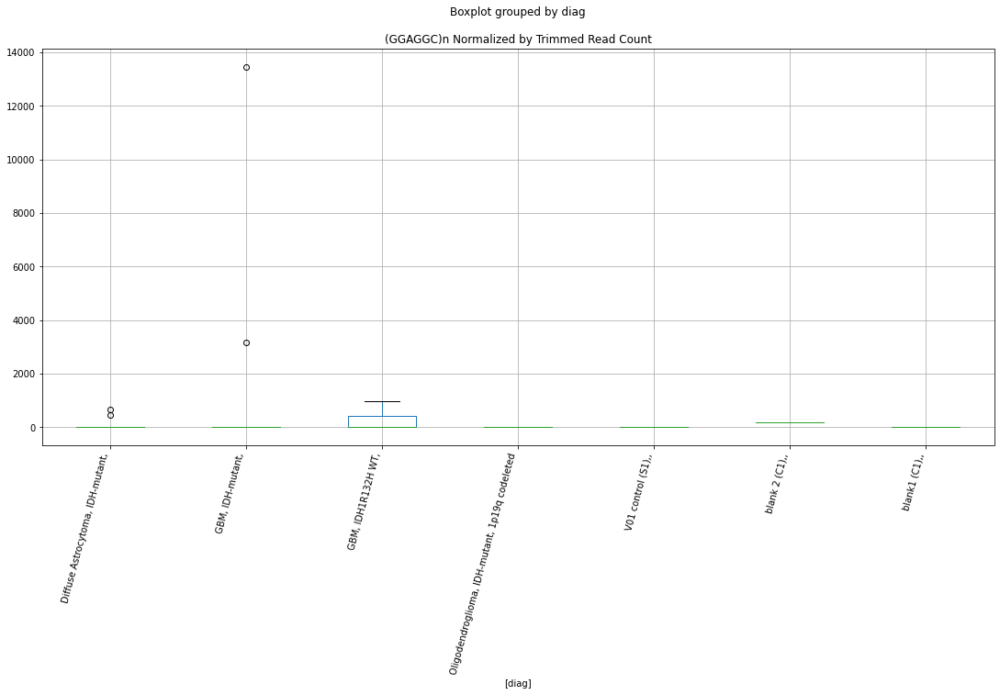

 p : 0.04551998845802556  ( t : 2.148630029577247 ) :  D-plex  :  bbduk2  :  MER51A
Control and blanks
73      7730.08
337    38276.76
Name: MER51A, dtype: float64
205    18446.37
Name: MER51A, dtype: float64
469    18337.35
Name: MER51A, dtype: float64


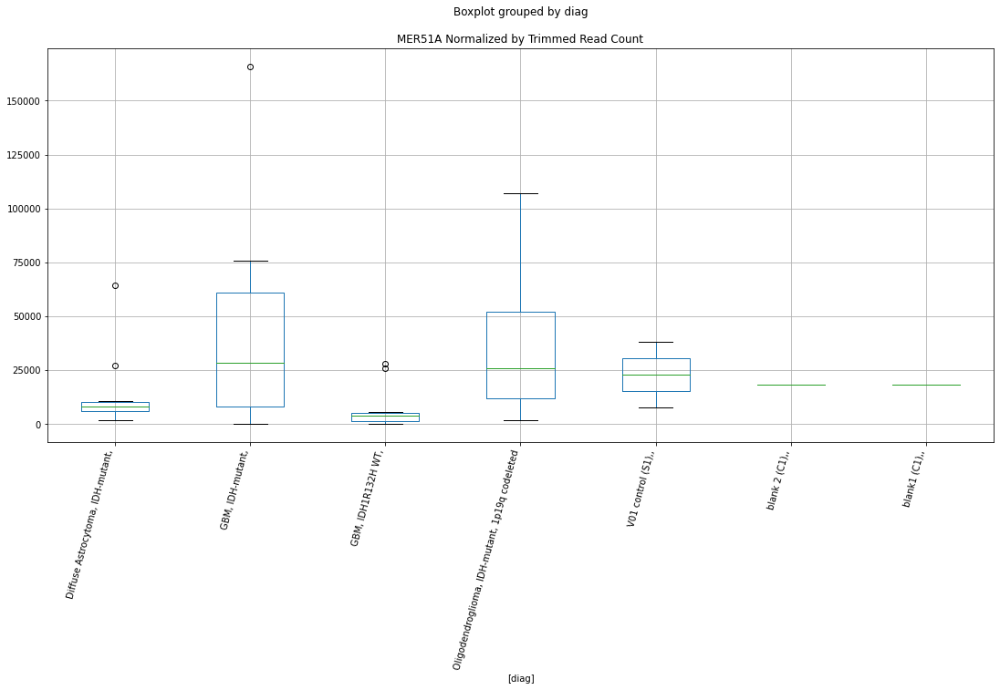

 p : 0.045536032261338864  ( t : 2.148451669006025 ) :  D-plex  :  cutadapt2  :  Arthur1B
Control and blanks
76      6818.53
340    36990.75
Name: Arthur1B, dtype: float64
208    39504.69
Name: Arthur1B, dtype: float64
472    35255.31
Name: Arthur1B, dtype: float64


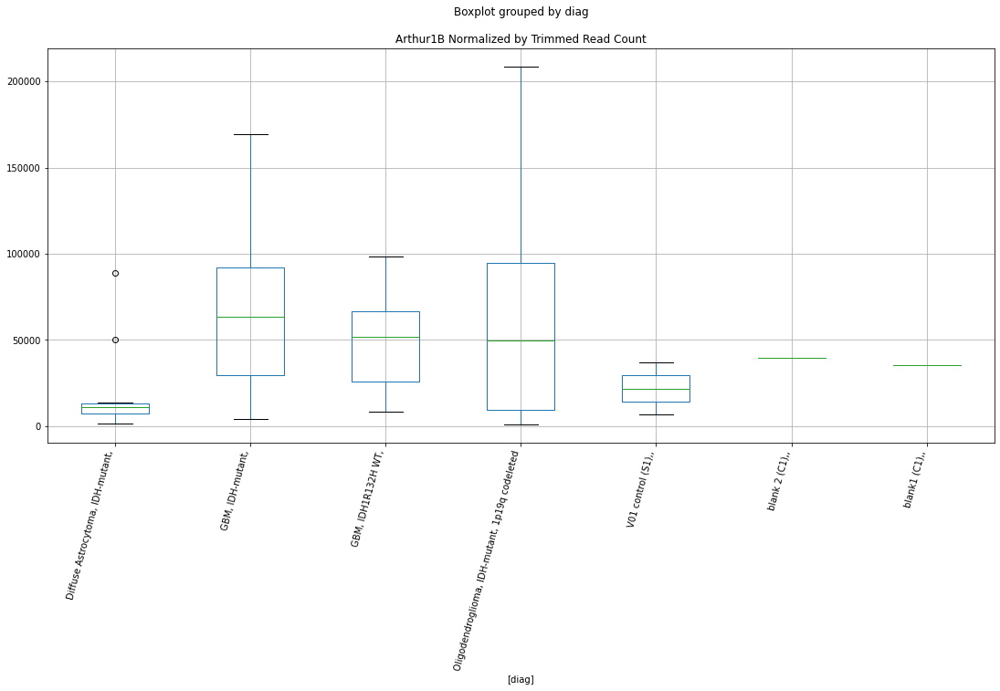

 p : 0.04554976505715941  ( t : 2.148299045733126 ) :  Lexogen  :  bbduk2  :  L1MB3
Control and blanks
79       0.00
343    212.31
Name: L1MB3, dtype: float64
211    0.0
Name: L1MB3, dtype: float64
475    0.0
Name: L1MB3, dtype: float64


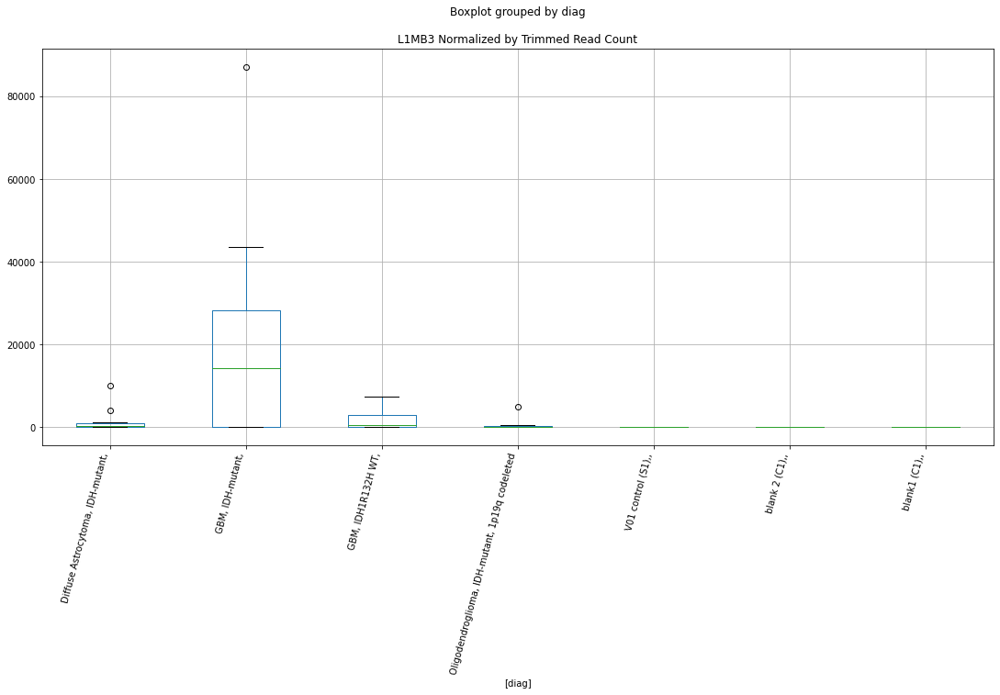

 p : 0.04557528112496888  ( t : 2.1480155773472545 ) :  D-plex  :  cutadapt2  :  MLT1F1
Control and blanks
76     35607.87
340    58128.32
Name: MLT1F1, dtype: float64
208    58375.23
Name: MLT1F1, dtype: float64
472    50282.16
Name: MLT1F1, dtype: float64


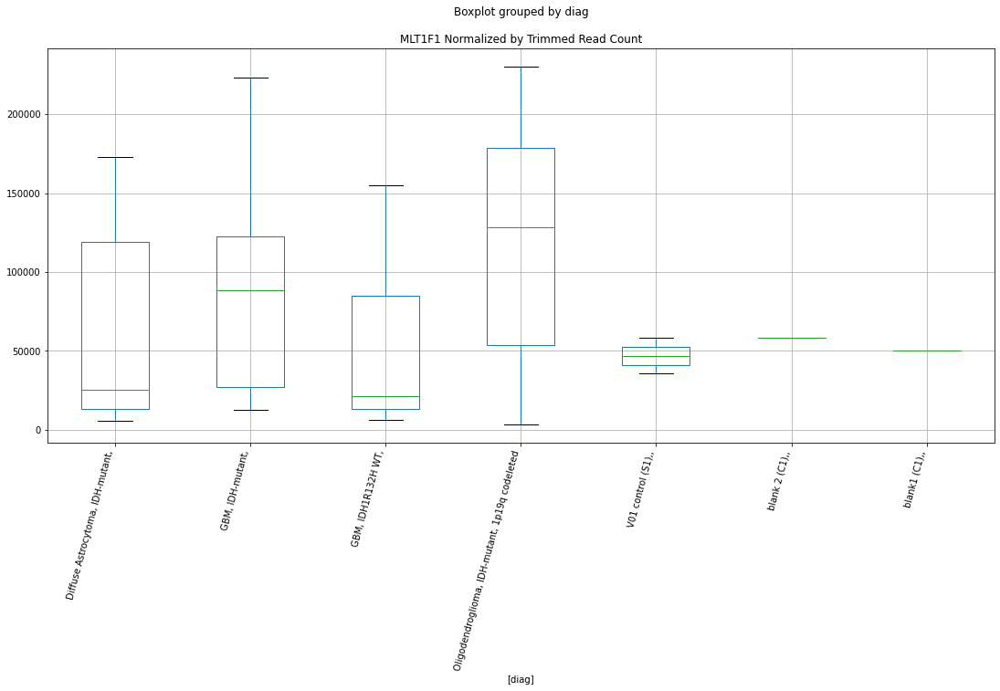

 p : 0.04558422905696656  ( t : 2.147916205462535 ) :  D-plex  :  bbduk2  :  (TATC)n
Control and blanks
73     18552.20
337    52519.28
Name: (TATC)n, dtype: float64
205    27938.19
Name: (TATC)n, dtype: float64
469    28984.84
Name: (TATC)n, dtype: float64


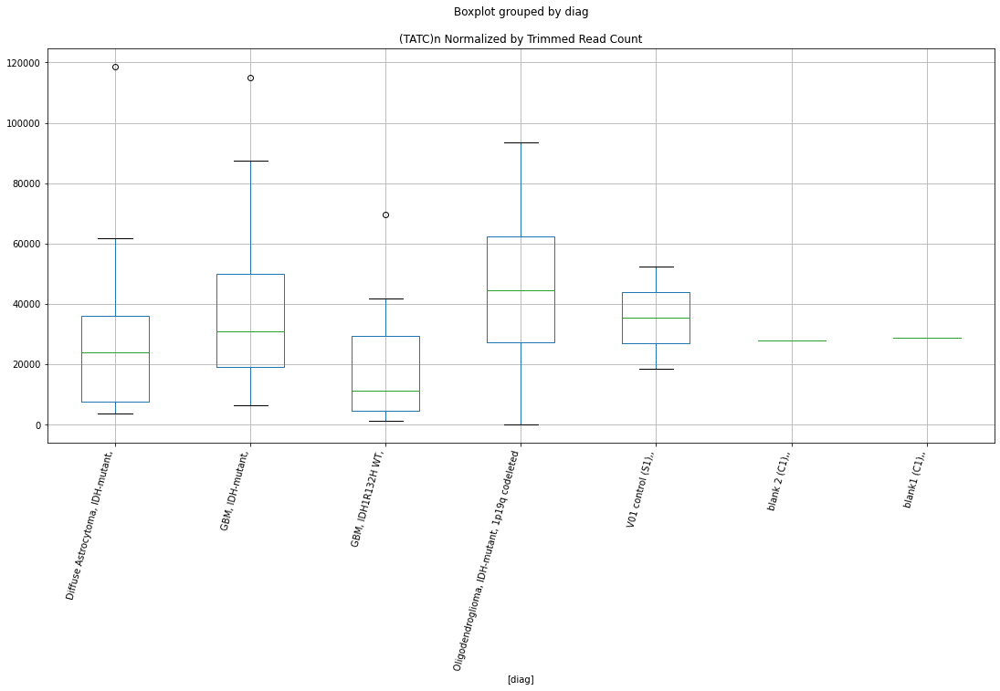

 p : 0.04561530353831756  ( t : 2.14757124397536 ) :  D-plex  :  cutadapt2  :  L1ME3C
Control and blanks
76      43184.01
340    140036.41
Name: L1ME3C, dtype: float64
208    85534.71
Name: L1ME3C, dtype: float64
472    73400.39
Name: L1ME3C, dtype: float64


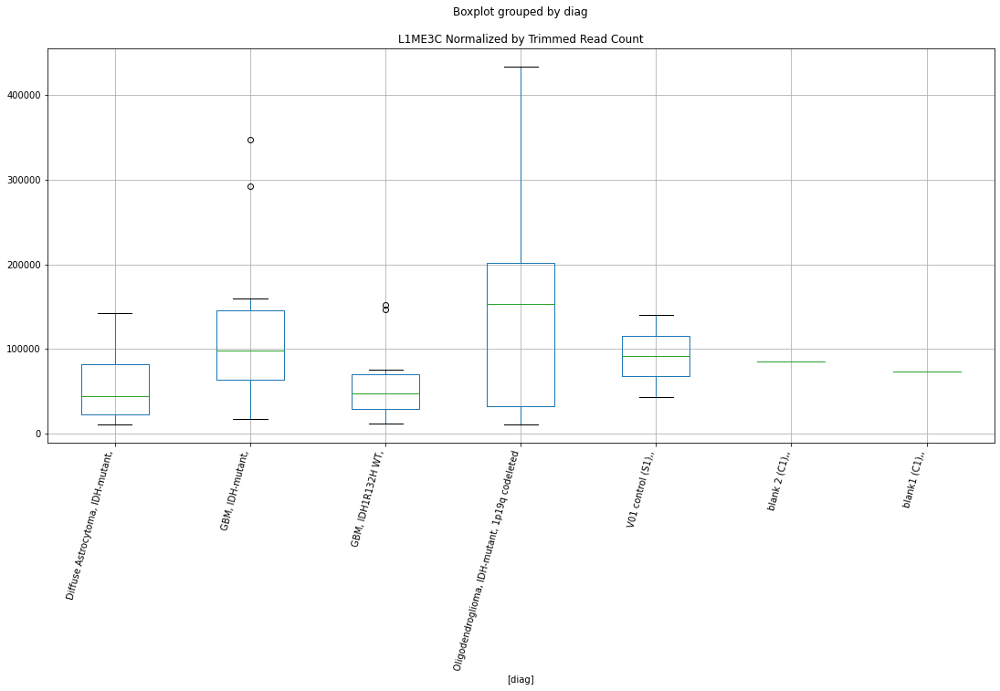

 p : 0.04565300422570954  ( t : 2.147153012286152 ) :  D-plex  :  bbduk2  :  Kanga1
Control and blanks
73      1546.02
337    31155.50
Name: Kanga1, dtype: float64
205    13610.91
Name: Kanga1, dtype: float64
469    9464.44
Name: Kanga1, dtype: float64


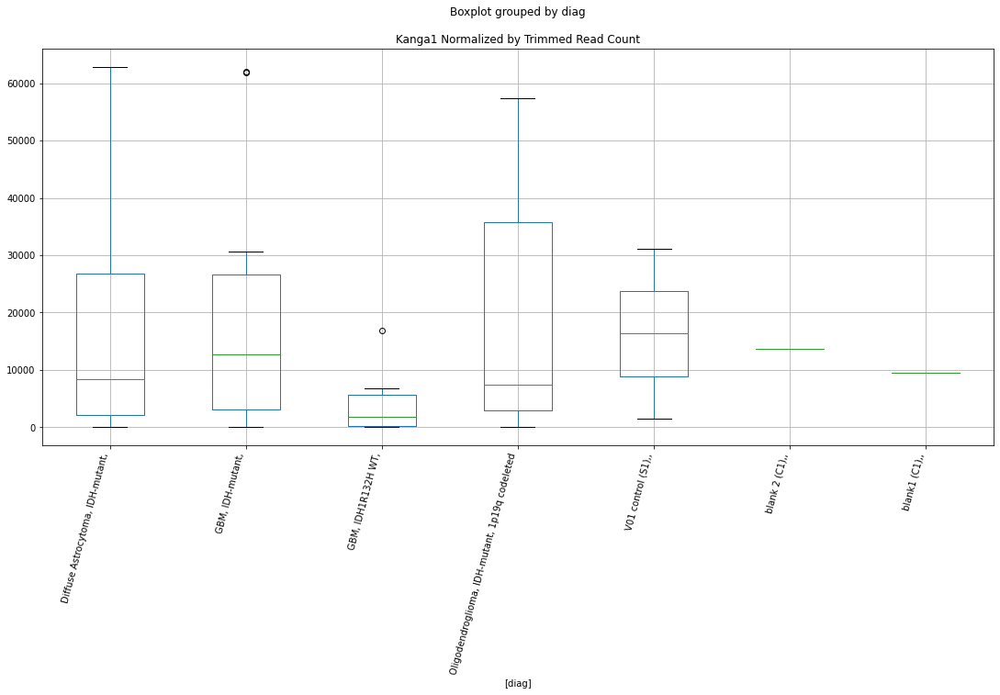

 p : 0.04567280193432161  ( t : 2.1469335131907807 ) :  D-plex  :  bbduk2  :  LTR2B
Control and blanks
73     0.0
337    0.0
Name: LTR2B, dtype: float64
205    4477.27
Name: LTR2B, dtype: float64
469    6506.8
Name: LTR2B, dtype: float64


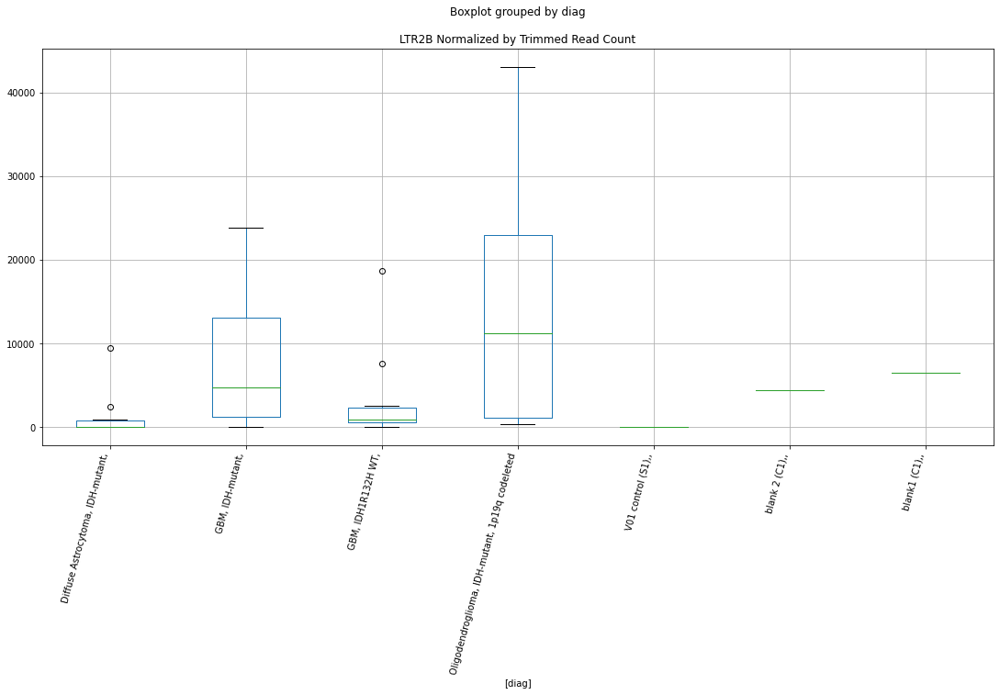

 p : 0.045675703161353075  ( t : 2.14690135430973 ) :  D-plex  :  bbduk2  :  HERVE-int
Control and blanks
73      3865.04
337    35606.29
Name: HERVE-int, dtype: float64
205    15939.09
Name: HERVE-int, dtype: float64
469    28984.84
Name: HERVE-int, dtype: float64


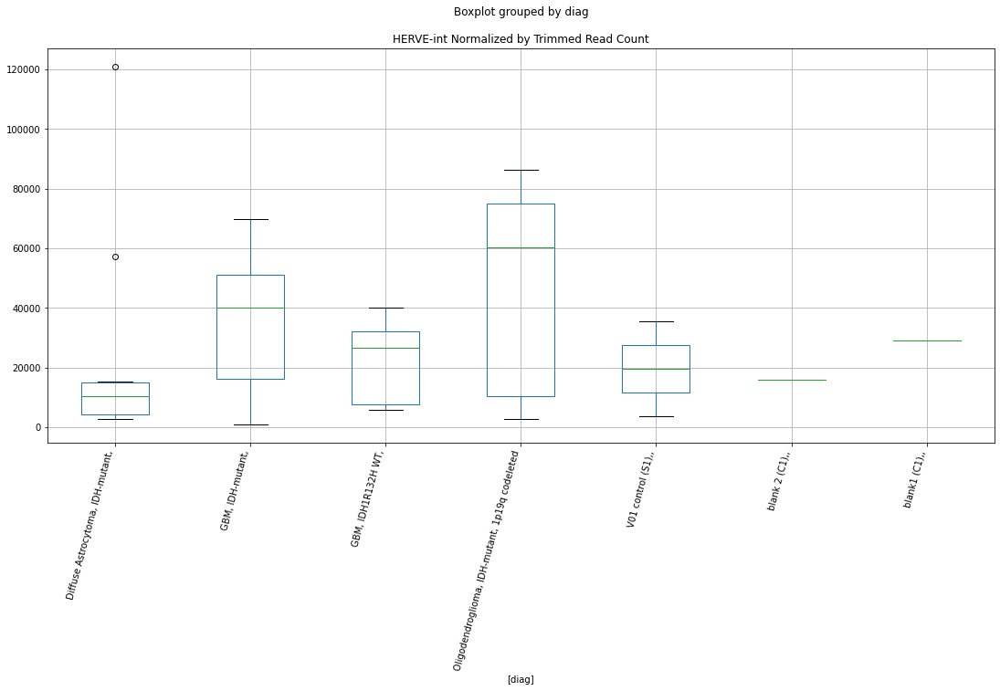

 p : 0.045680786459818816  ( t : 2.146845012583129 ) :  D-plex  :  bbduk2  :  (CCAGATC)n
Control and blanks
73     0.0
337    0.0
Name: (CCAGATC)n, dtype: float64
205    179.09
Name: (CCAGATC)n, dtype: float64
469    0.0
Name: (CCAGATC)n, dtype: float64


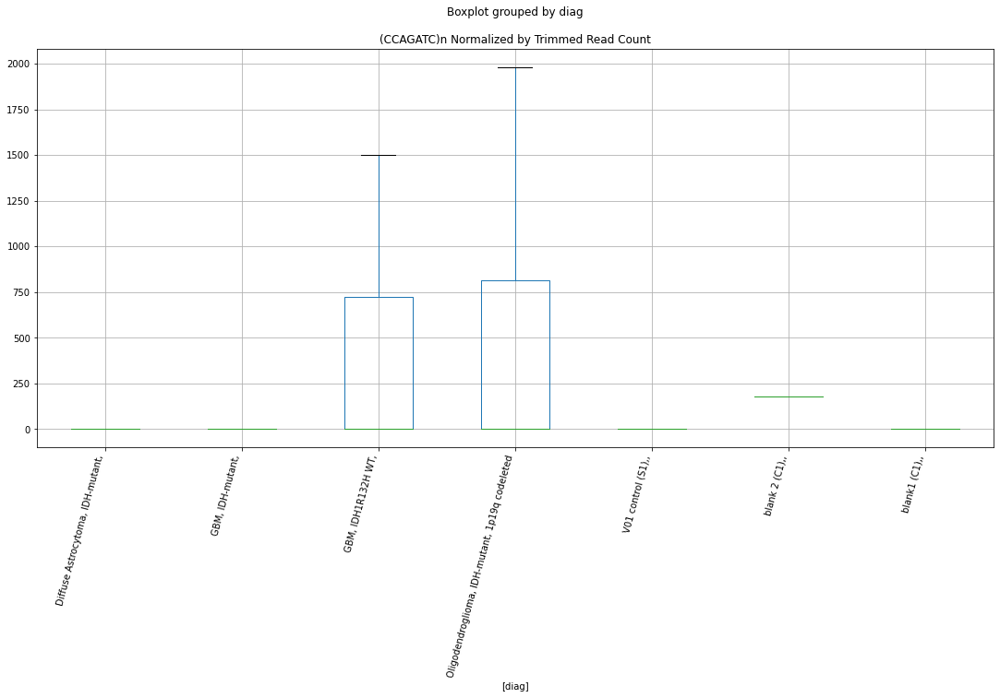

 p : 0.045760567338739386  ( t : 2.1459614951273913 ) :  D-plex  :  bbduk2  :  CR1-16_AMi
Control and blanks
73     773.01
337    890.16
Name: CR1-16_AMi, dtype: float64
205    5193.64
Name: CR1-16_AMi, dtype: float64
469    6506.8
Name: CR1-16_AMi, dtype: float64


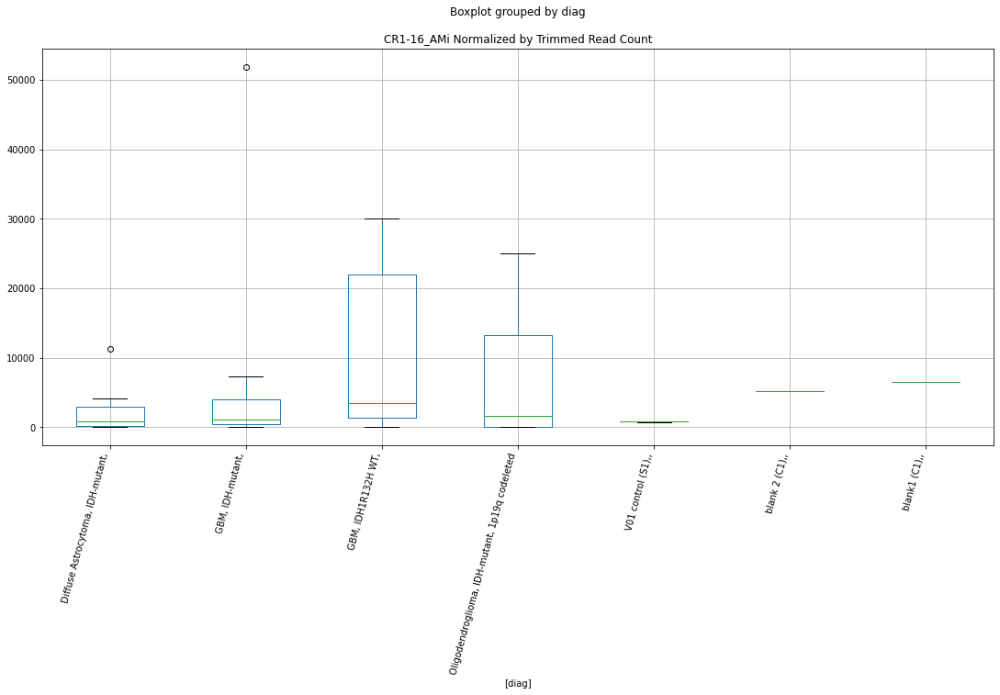

 p : 0.045832508931718516  ( t : 2.145165997757113 ) :  D-plex  :  bbduk2  :  LTR77
Control and blanks
73     773.01
337      0.00
Name: LTR77, dtype: float64
205    3940.0
Name: LTR77, dtype: float64
469    2366.11
Name: LTR77, dtype: float64


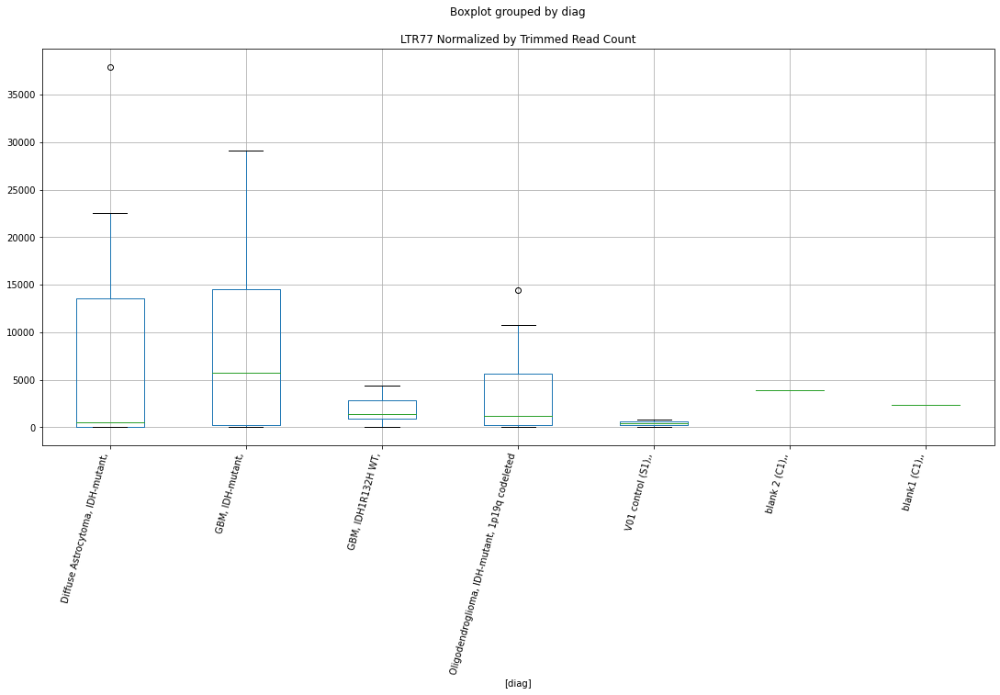

 p : 0.04587433972318434  ( t : 2.144703976068601 ) :  D-plex  :  bbduk2  :  (TTCCATTCGAG)n
Control and blanks
73         0.00
337    10681.89
Name: (TTCCATTCGAG)n, dtype: float64
205    1970.0
Name: (TTCCATTCGAG)n, dtype: float64
469    1183.05
Name: (TTCCATTCGAG)n, dtype: float64


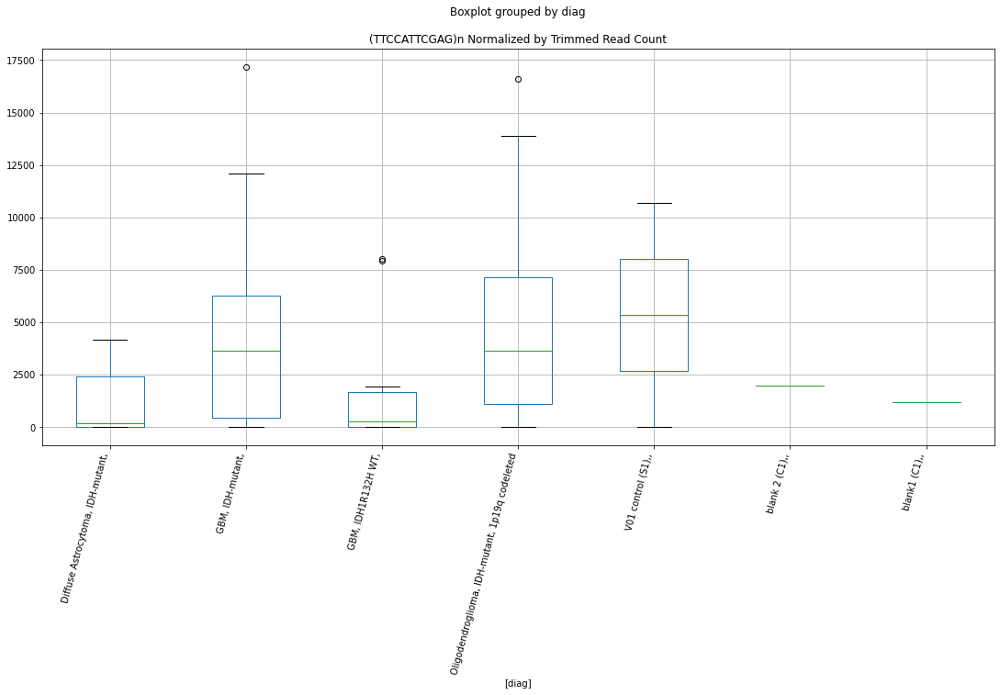

 p : 0.045933947407701764  ( t : 2.1440462726253977 ) :  D-plex  :  cutadapt2  :  (CCTCCTGCT)n
Control and blanks
76     757.61
340      0.00
Name: (CCTCCTGCT)n, dtype: float64
208    176.36
Name: (CCTCCTGCT)n, dtype: float64
472    0.0
Name: (CCTCCTGCT)n, dtype: float64


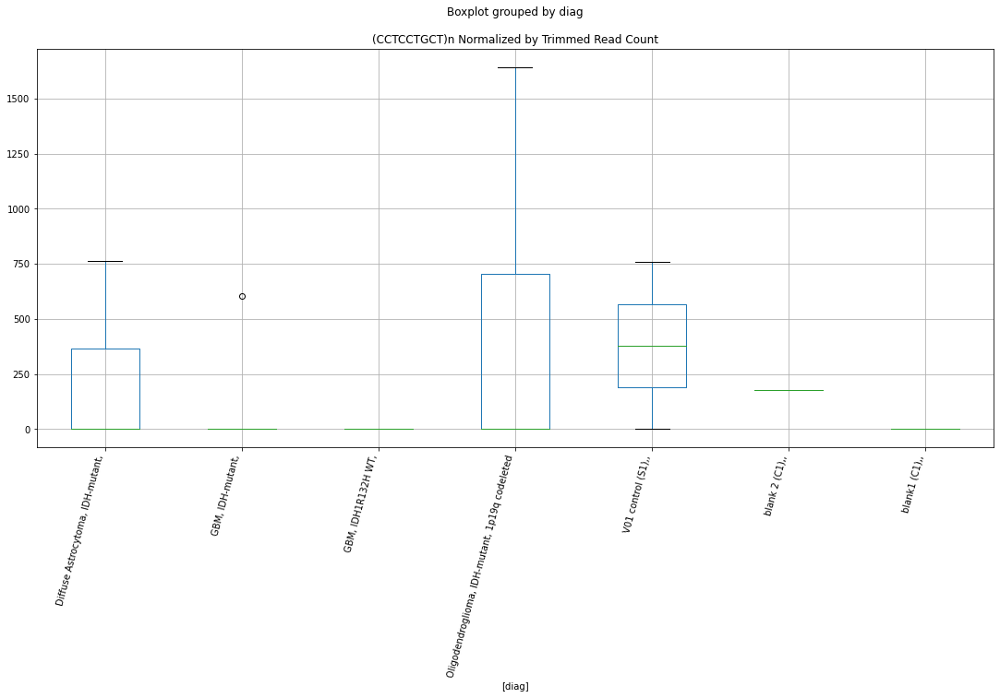

 p : 0.04593524361970226  ( t : 2.1440319790509412 ) :  D-plex  :  bbduk2  :  LTR84a
Control and blanks
73     3092.03
337     890.16
Name: LTR84a, dtype: float64
205    6268.18
Name: LTR84a, dtype: float64
469    7689.86
Name: LTR84a, dtype: float64


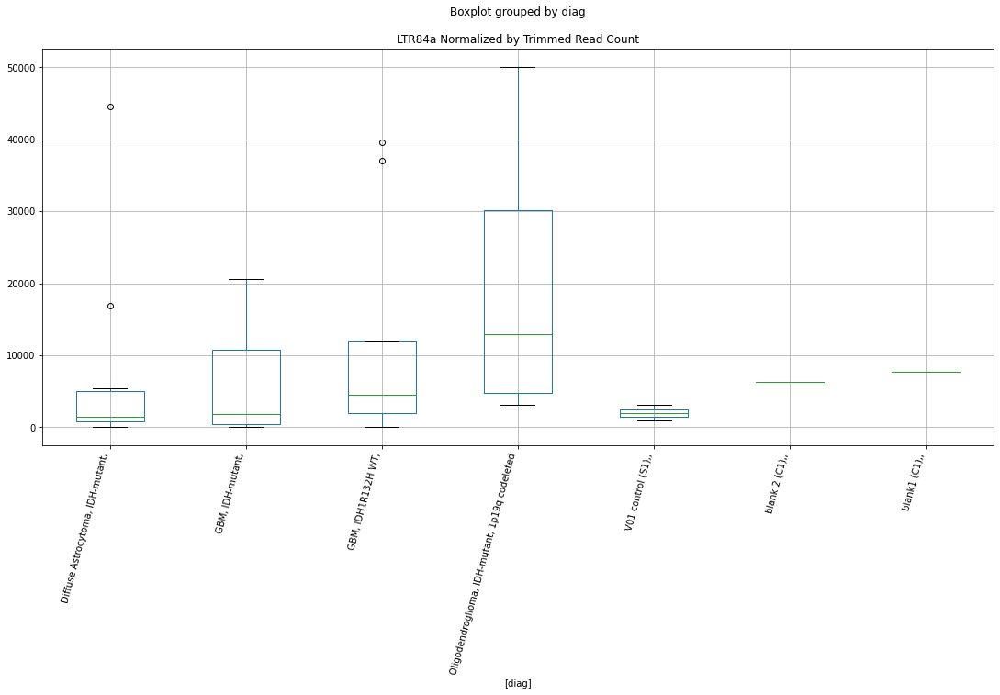

 p : 0.046012523503709275  ( t : 2.143180464010476 ) :  D-plex  :  bbduk2  :  LTR35
Control and blanks
73     0.0
337    0.0
Name: LTR35, dtype: float64
205    2507.27
Name: LTR35, dtype: float64
469    5323.75
Name: LTR35, dtype: float64


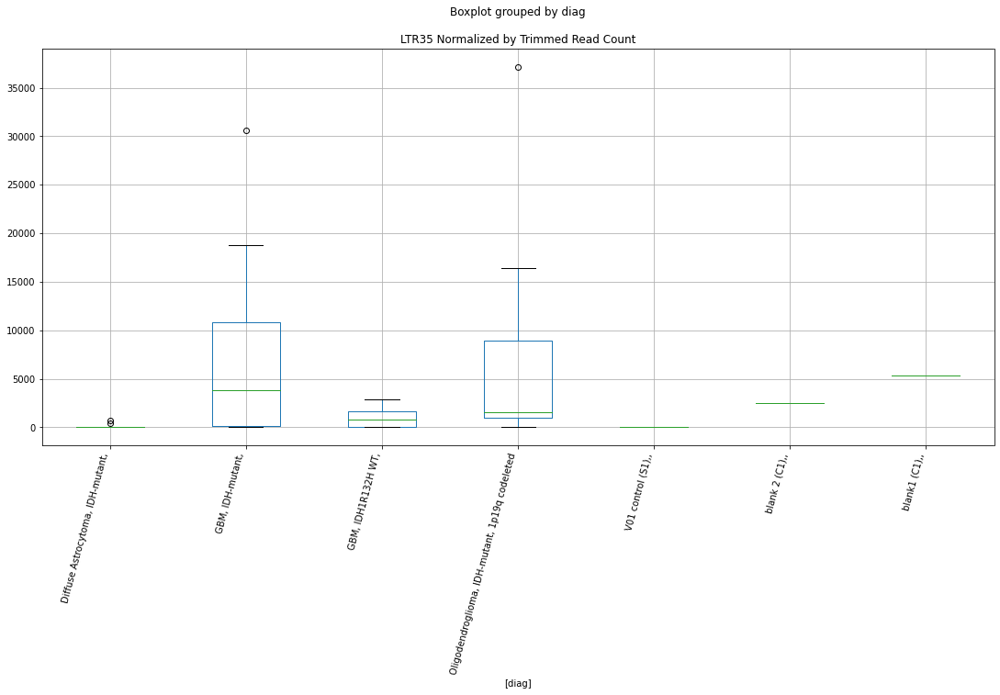

 p : 0.04615112112621317  ( t : 2.141656579887654 ) :  D-plex  :  bbduk2  :  (ATATAG)n
Control and blanks
73     0.0
337    0.0
Name: (ATATAG)n, dtype: float64
205    2865.46
Name: (ATATAG)n, dtype: float64
469    4732.22
Name: (ATATAG)n, dtype: float64


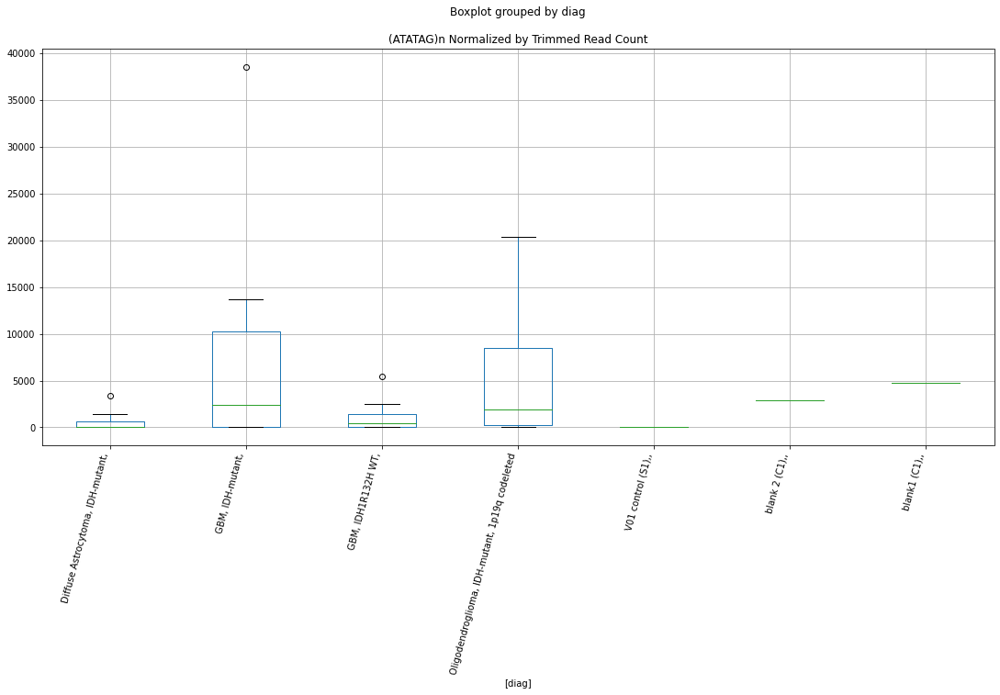

 p : 0.046166432377633904  ( t : 2.141488488681598 ) :  D-plex  :  cutadapt2  :  (ACACAC)n
Control and blanks
76       757.61
340    16733.91
Name: (ACACAC)n, dtype: float64
208    2821.76
Name: (ACACAC)n, dtype: float64
472    2311.82
Name: (ACACAC)n, dtype: float64


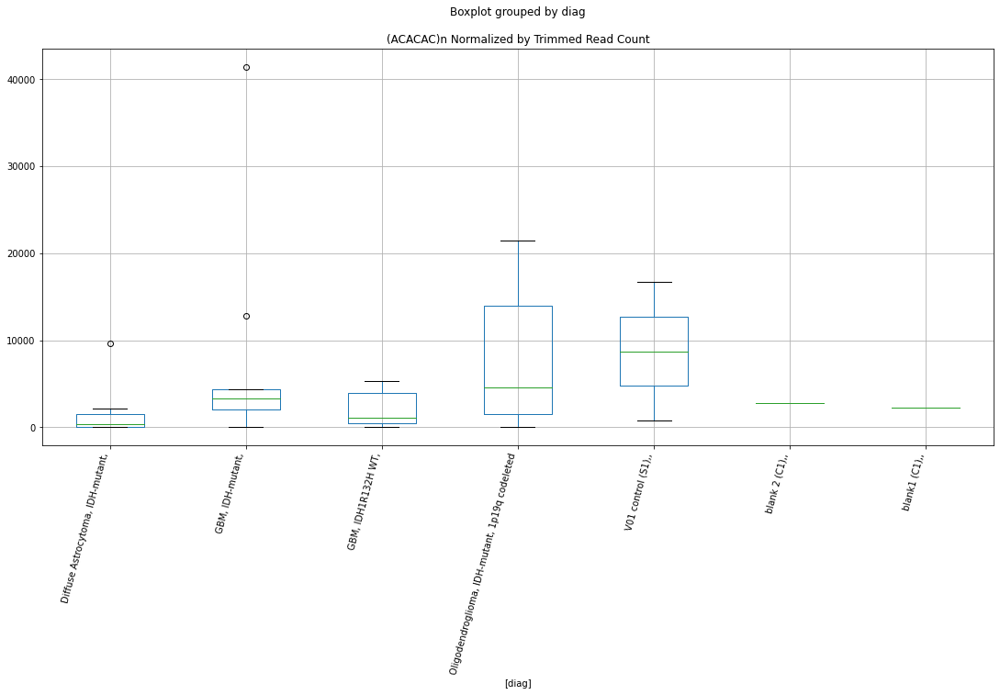

 p : 0.04618685179079617  ( t : 2.141264397820837 ) :  D-plex  :  cutadapt2  :  LTR86A1
Control and blanks
76      2272.84
340    20256.84
Name: LTR86A1, dtype: float64
208    11639.77
Name: LTR86A1, dtype: float64
472    8091.38
Name: LTR86A1, dtype: float64


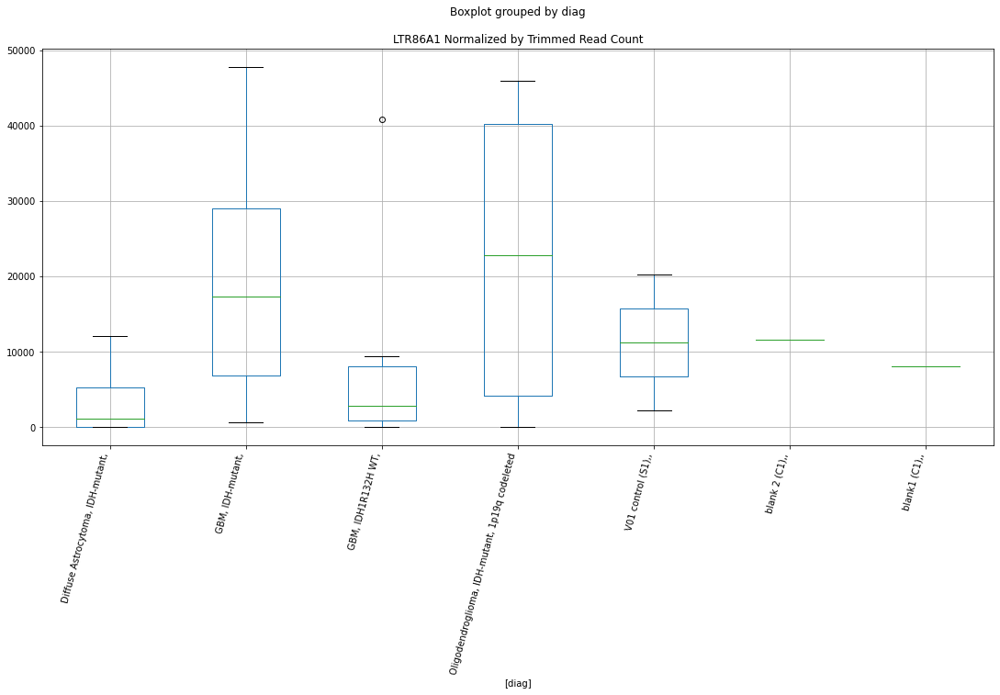

 p : 0.04619242964475016  ( t : 2.1412031999329555 ) :  D-plex  :  bbduk2  :  (TTGTA)n
Control and blanks
73        0.00
337    2670.47
Name: (TTGTA)n, dtype: float64
205    537.27
Name: (TTGTA)n, dtype: float64
469    1183.05
Name: (TTGTA)n, dtype: float64


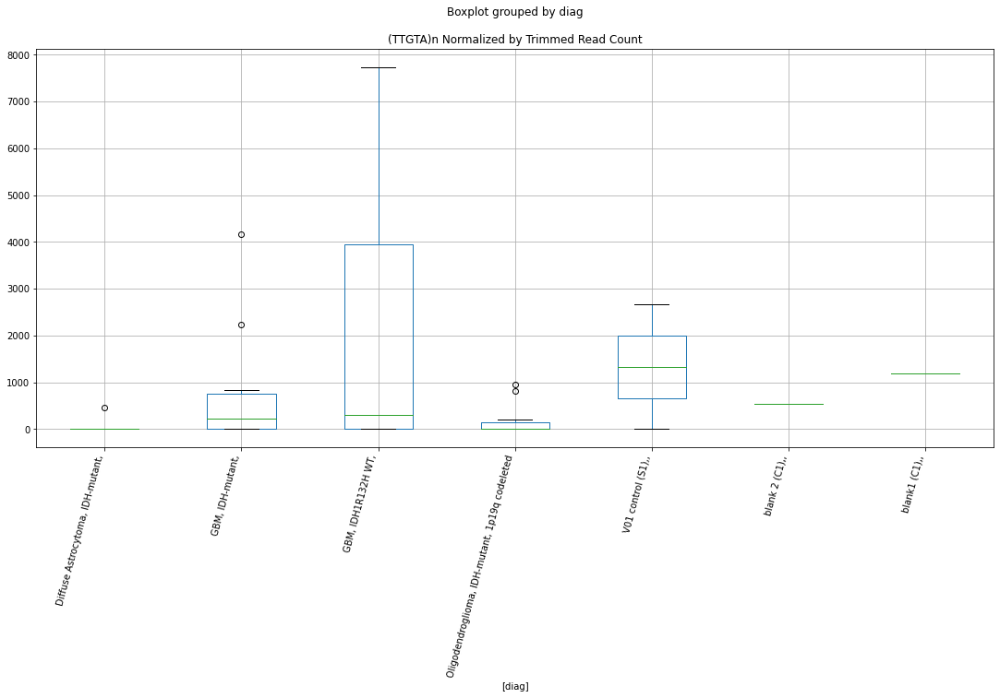

 p : 0.04625699013064234  ( t : 2.1404953596743472 ) :  D-plex  :  cutadapt2  :  LTR15
Control and blanks
76       757.61
340    14972.45
Name: LTR15, dtype: float64
208    2998.12
Name: LTR15, dtype: float64
472    4623.65
Name: LTR15, dtype: float64


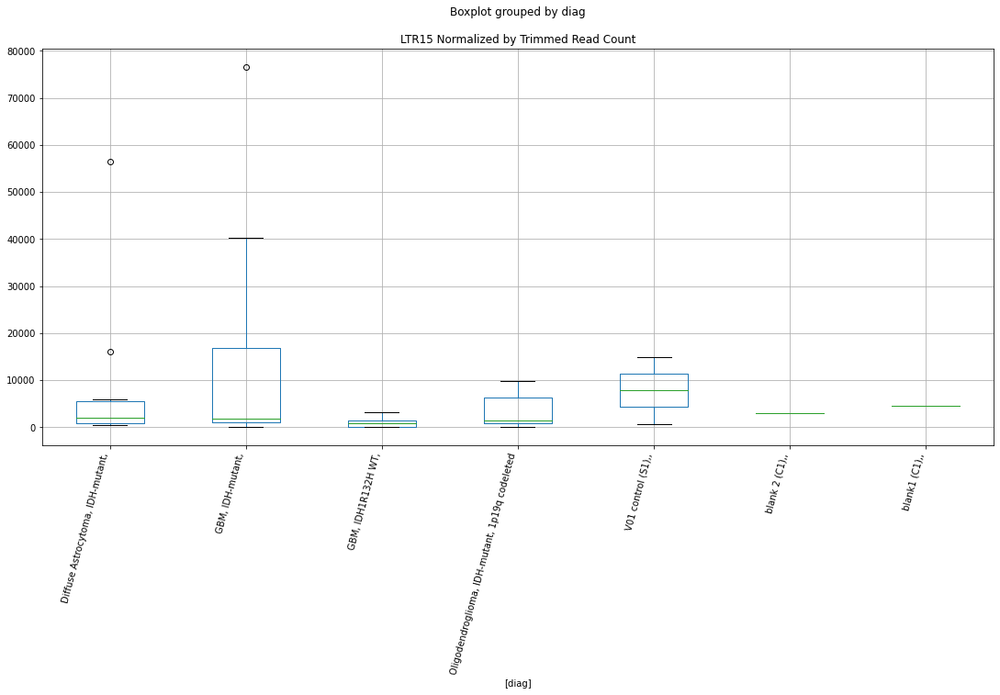

 p : 0.046258459690353367  ( t : 2.1404792579421716 ) :  D-plex  :  bbduk2  :  MLT1C-int
Control and blanks
73     4638.05
337       0.00
Name: MLT1C-int, dtype: float64
205    10924.55
Name: MLT1C-int, dtype: float64
469    8872.91
Name: MLT1C-int, dtype: float64


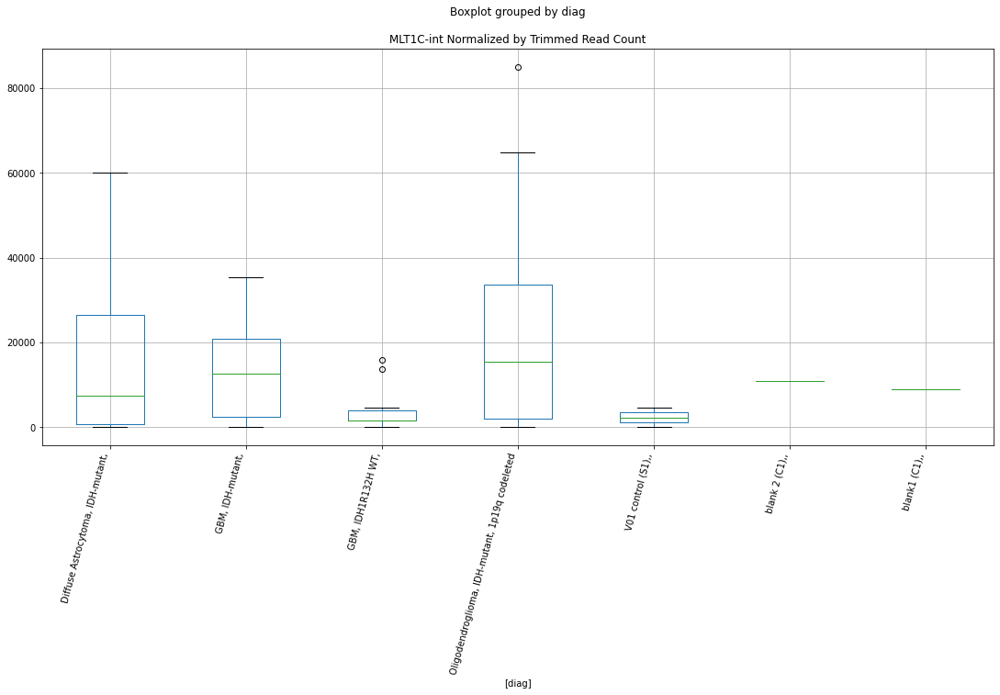

 p : 0.046273301934099065  ( t : 2.1403166600036823 ) :  D-plex  :  cutadapt2  :  LTR60B
Control and blanks
76     757.61
340      0.00
Name: LTR60B, dtype: float64
208    4056.29
Name: LTR60B, dtype: float64
472    4045.69
Name: LTR60B, dtype: float64


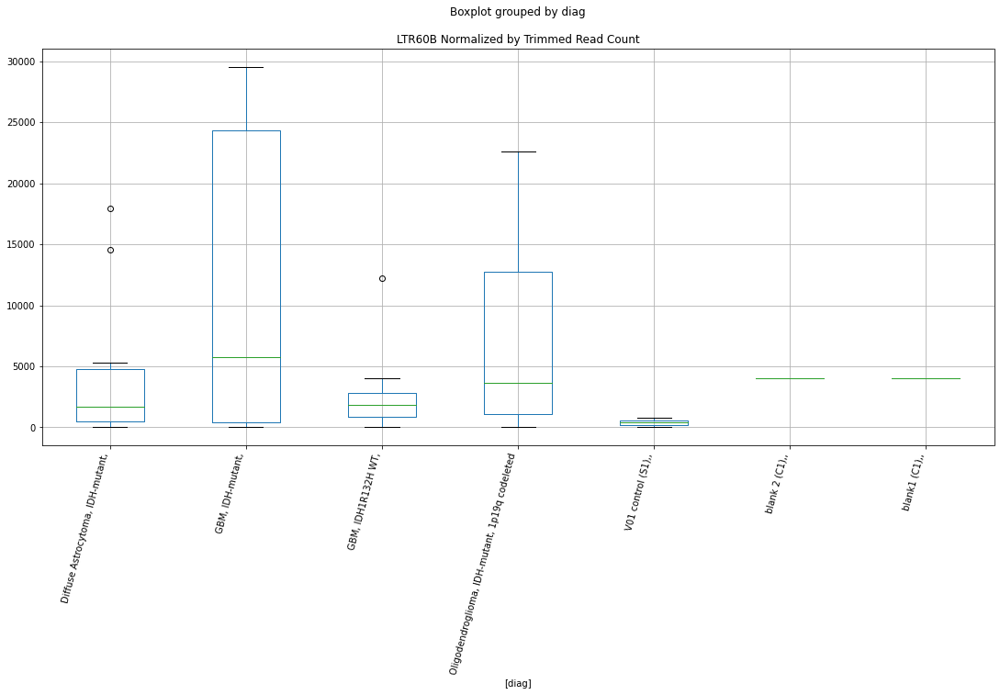

 p : 0.04630008940994542  ( t : 2.1400233215703843 ) :  D-plex  :  cutadapt2  :  (CCAGATC)n
Control and blanks
76     0.0
340    0.0
Name: (CCAGATC)n, dtype: float64
208    176.36
Name: (CCAGATC)n, dtype: float64
472    0.0
Name: (CCAGATC)n, dtype: float64


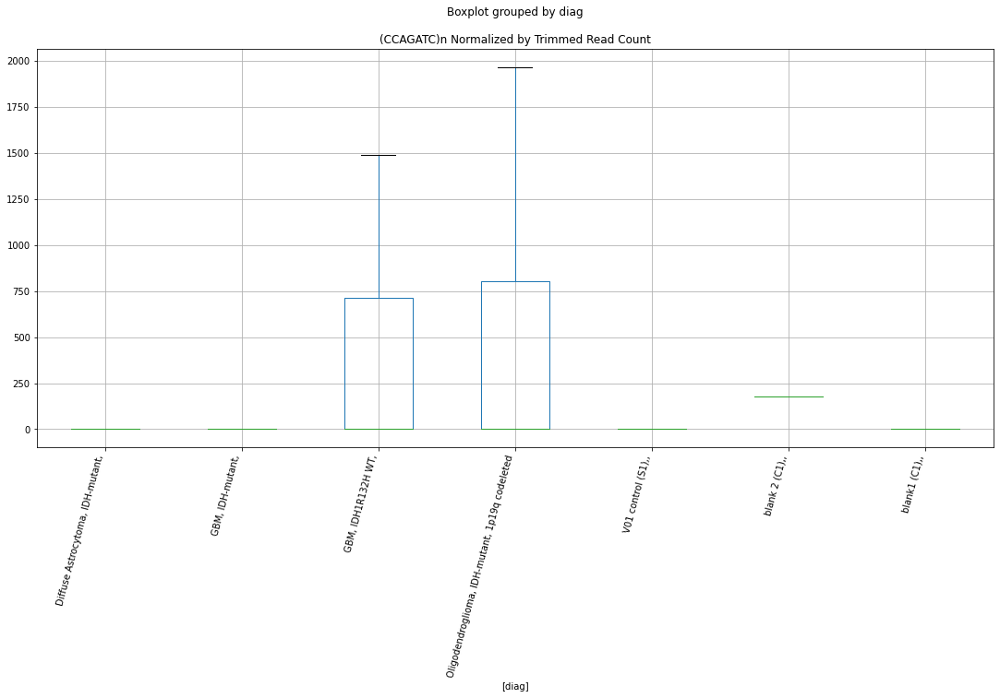

 p : 0.046305194518877095  ( t : 2.139967435234816 ) :  D-plex  :  cutadapt2  :  Tigger17c
Control and blanks
76      1515.23
340    39632.95
Name: Tigger17c, dtype: float64
208    10052.53
Name: Tigger17c, dtype: float64
472    13292.98
Name: Tigger17c, dtype: float64


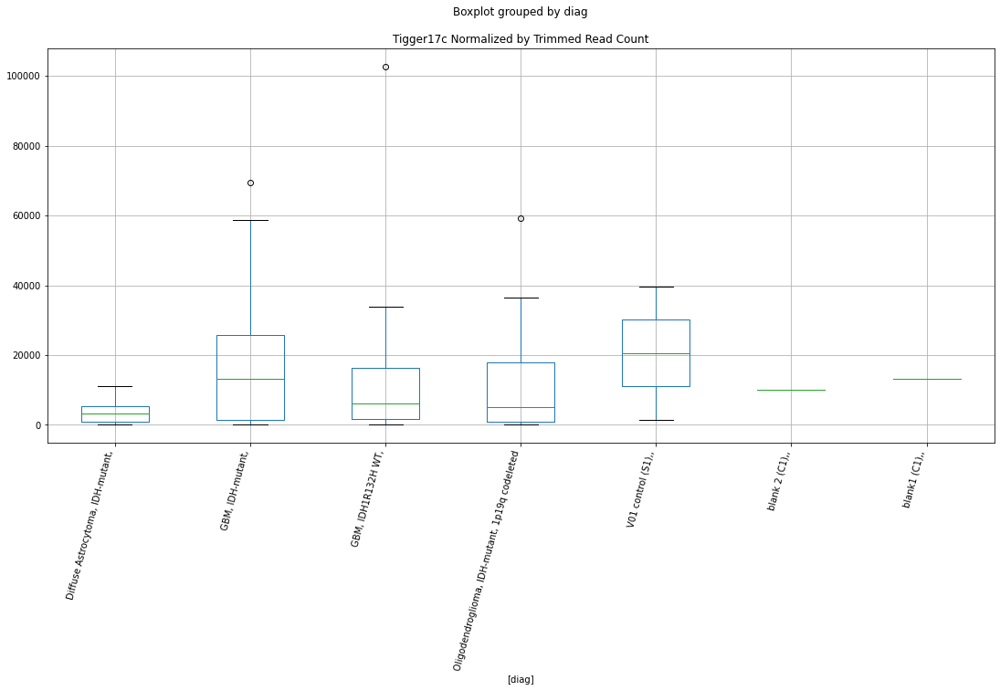

 p : 0.04635129100003754  ( t : 2.139463065153817 ) :  D-plex  :  bbduk2  :  LTR12_
Control and blanks
73      3092.03
337    12462.20
Name: LTR12_, dtype: float64
205    13073.64
Name: LTR12_, dtype: float64
469    8872.91
Name: LTR12_, dtype: float64


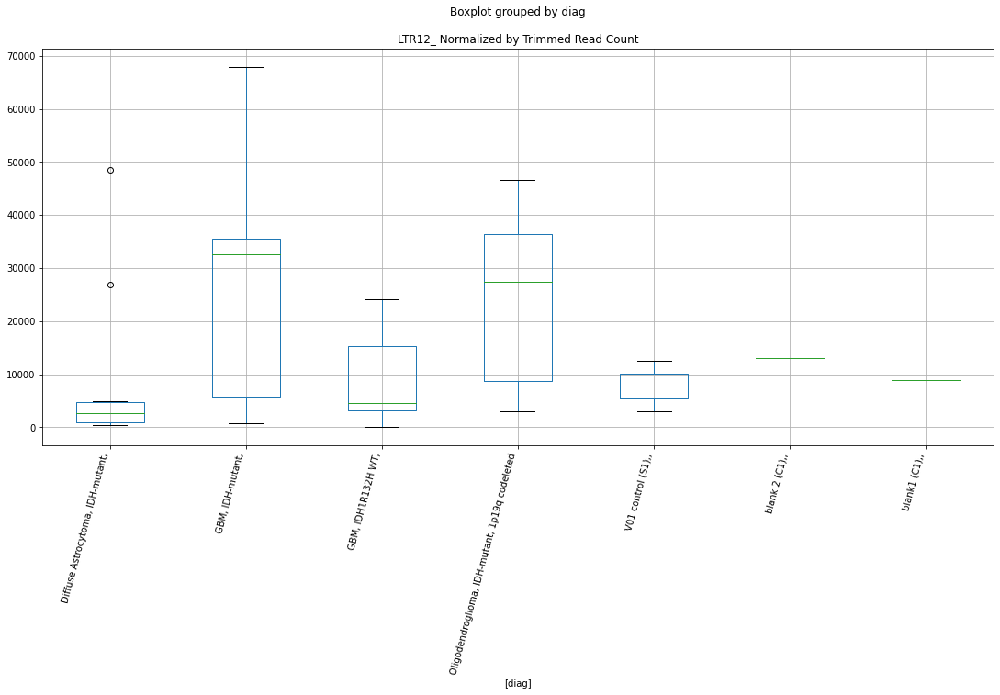

 p : 0.04639176572800178  ( t : 2.13902058347433 ) :  D-plex  :  cutadapt2  :  LTR45B
Control and blanks
76      4545.69
340    16733.91
Name: LTR45B, dtype: float64
208    11110.69
Name: LTR45B, dtype: float64
472    12715.03
Name: LTR45B, dtype: float64


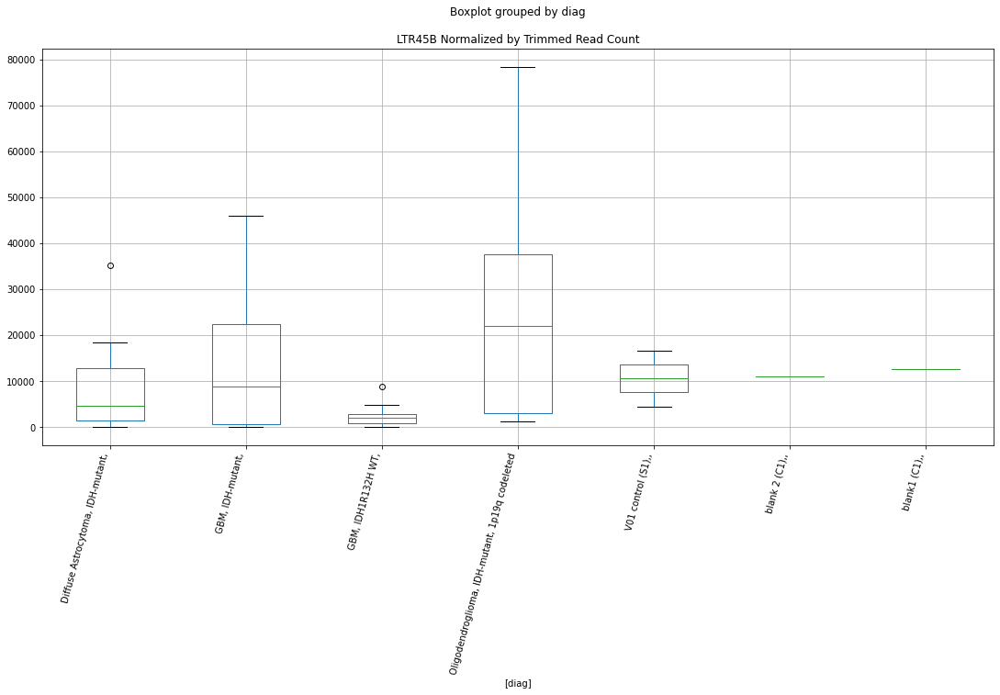

 p : 0.04640796921988074  ( t : 2.1388435408694777 ) :  D-plex  :  cutadapt2  :  LTR26
Control and blanks
76     1515.23
340       0.00
Name: LTR26, dtype: float64
208    15166.98
Name: LTR26, dtype: float64
472    12715.03
Name: LTR26, dtype: float64


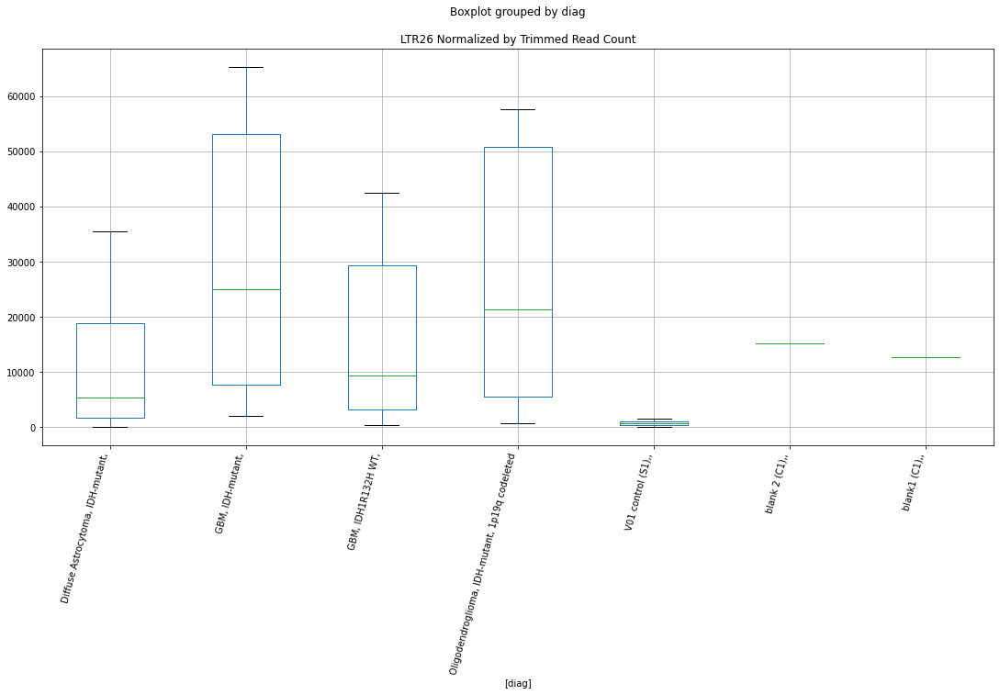

 p : 0.0464410167712195  ( t : 2.138482631486401 ) :  D-plex  :  cutadapt2  :  HAL1ME
Control and blanks
76     144704.31
340    355815.78
Name: HAL1ME, dtype: float64
208    201227.01
Name: HAL1ME, dtype: float64
472    197082.94
Name: HAL1ME, dtype: float64


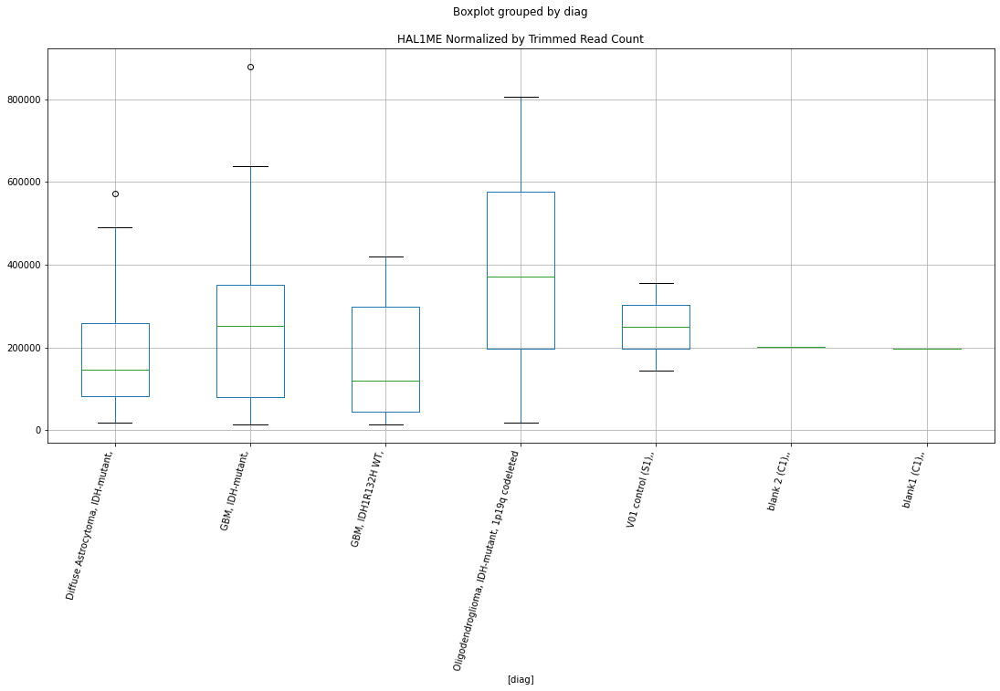

 p : 0.046443549880801446  ( t : 2.1384549772931436 ) :  D-plex  :  bbduk2  :  THE1D
Control and blanks
73     243497.65
337    157557.84
Name: THE1D, dtype: float64
205    254309.15
Name: THE1D, dtype: float64
469    233061.76
Name: THE1D, dtype: float64


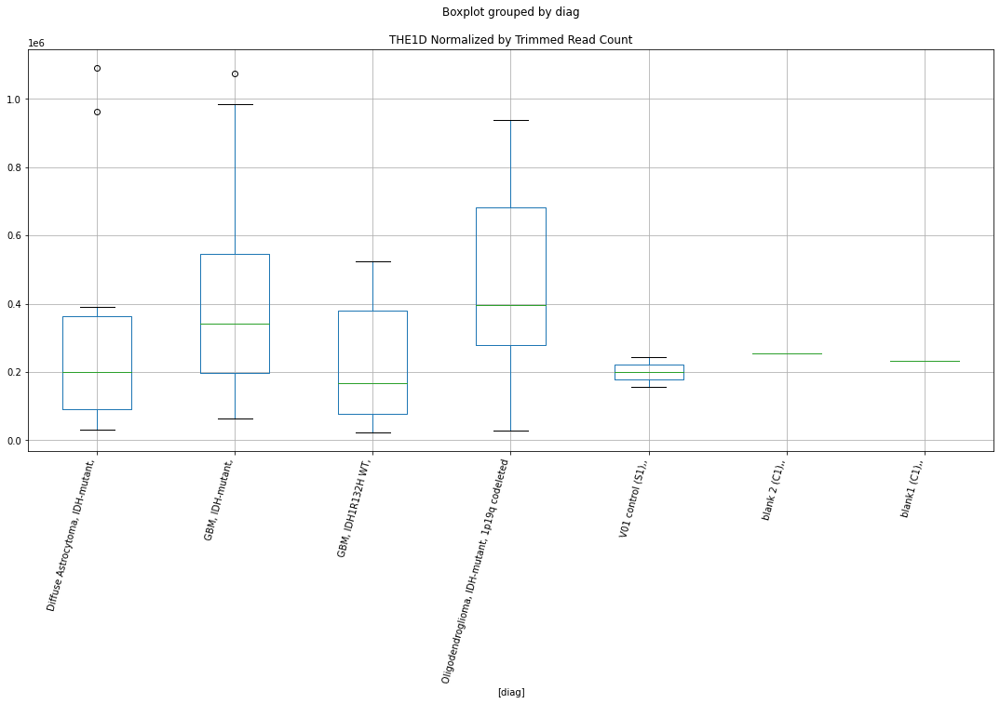

 p : 0.046616134125800714  ( t : 2.1365740928418284 ) :  D-plex  :  bbduk2  :  MamGypLTR1a
Control and blanks
73      4638.05
337    15132.67
Name: MamGypLTR1a, dtype: float64
205    13252.73
Name: MamGypLTR1a, dtype: float64
469    10647.49
Name: MamGypLTR1a, dtype: float64


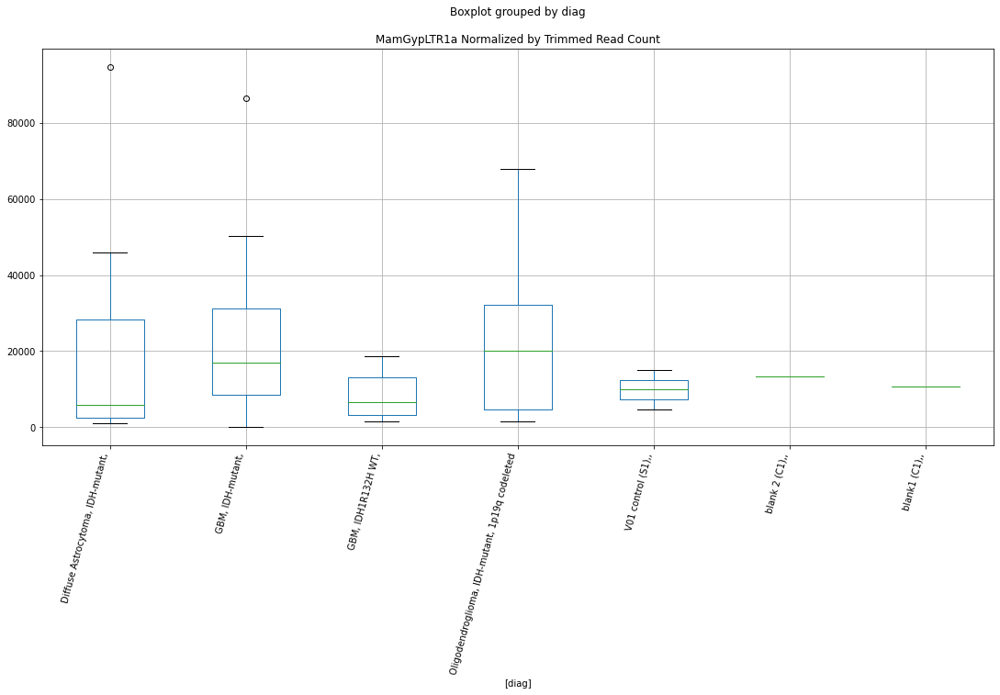

 p : 0.046631737539073764  ( t : 2.1364043546480365 ) :  D-plex  :  cutadapt2  :  (AGAT)n
Control and blanks
76     14394.67
340    26421.96
Name: (AGAT)n, dtype: float64
208    20986.87
Name: (AGAT)n, dtype: float64
472    23118.23
Name: (AGAT)n, dtype: float64


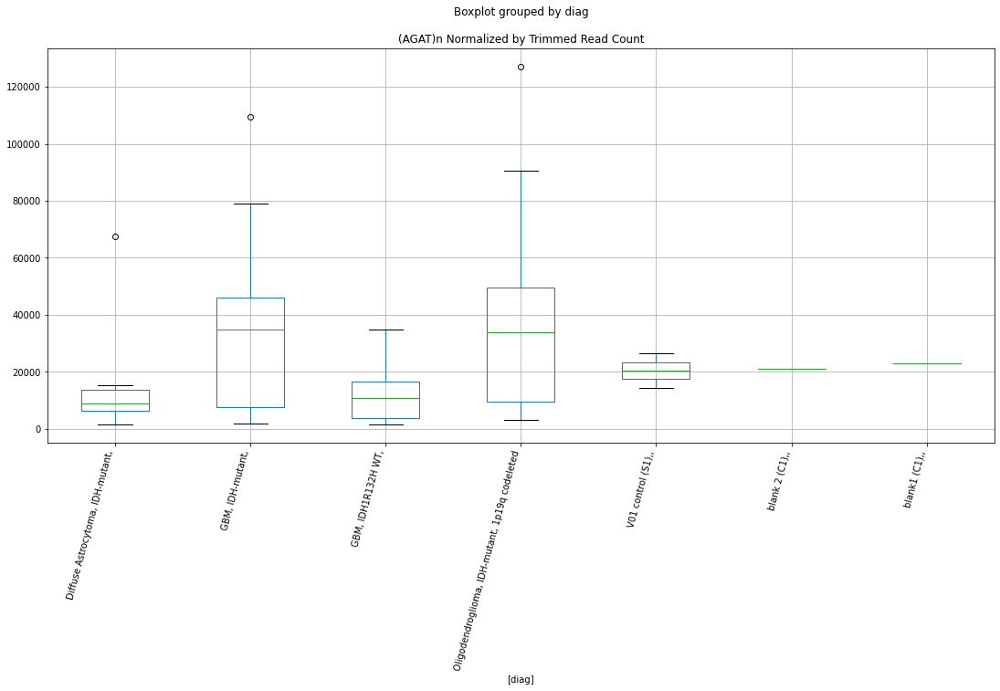

 p : 0.0466411980745574  ( t : 2.136301465591061 ) :  D-plex  :  bbduk2  :  LTR87
Control and blanks
73     0.0
337    0.0
Name: LTR87, dtype: float64
205    9312.73
Name: LTR87, dtype: float64
469    6506.8
Name: LTR87, dtype: float64


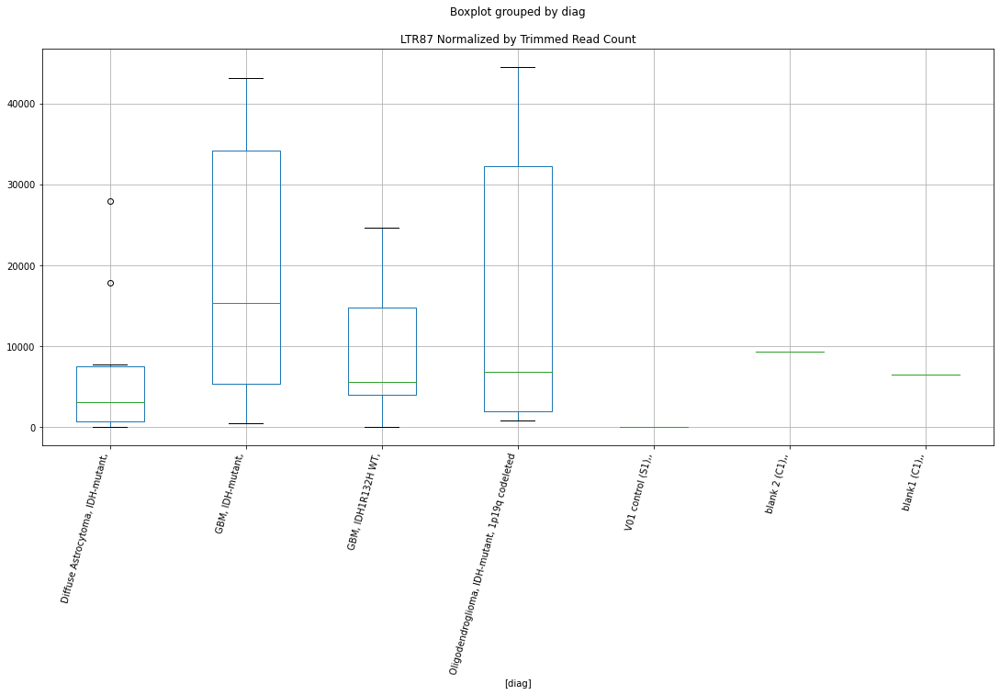

 p : 0.04685218128688651  ( t : 2.1340118283797116 ) :  D-plex  :  bbduk2  :  LTR85b
Control and blanks
73     23963.26
337      890.16
Name: LTR85b, dtype: float64
205    16118.19
Name: LTR85b, dtype: float64
469    18337.35
Name: LTR85b, dtype: float64


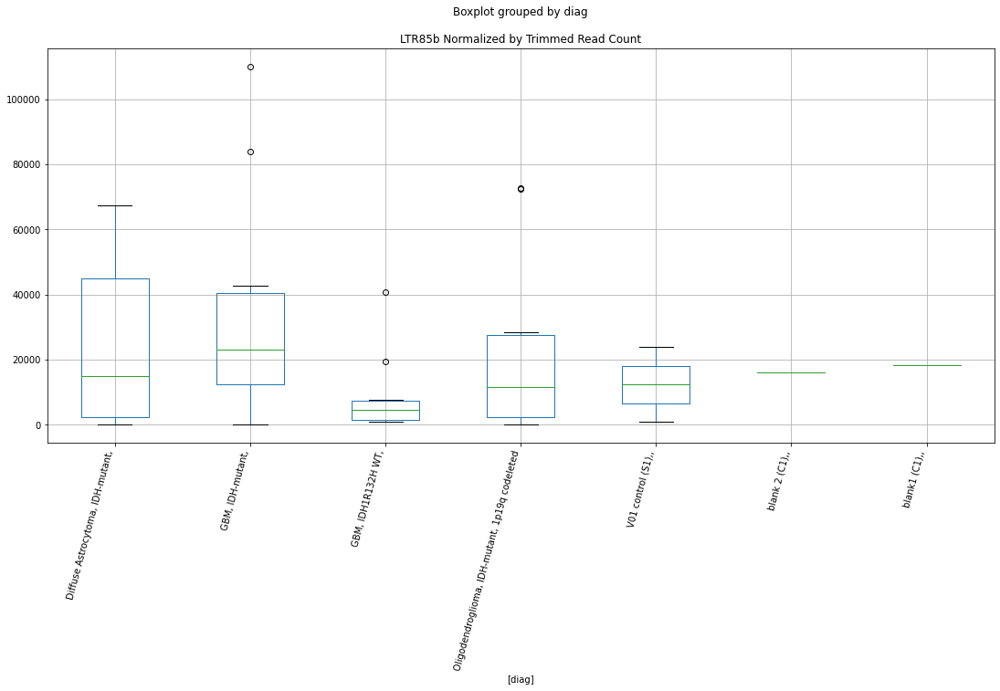

 p : 0.04692169308287731  ( t : 2.133259530401235 ) :  D-plex  :  cutadapt2  :  MER83C
Control and blanks
76      757.61
340    9688.05
Name: MER83C, dtype: float64
208    3879.92
Name: MER83C, dtype: float64
472    4623.65
Name: MER83C, dtype: float64


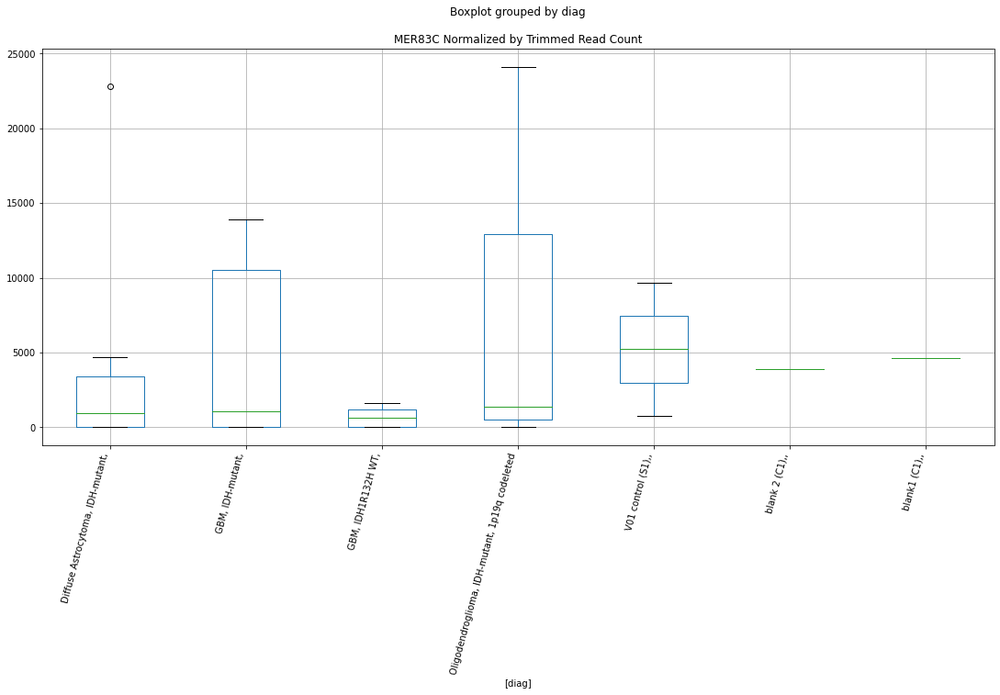

 p : 0.04695529440997932  ( t : 2.1328962412570958 ) :  D-plex  :  bbduk2  :  Tigger6b
Control and blanks
73       773.01
337    24924.40
Name: Tigger6b, dtype: float64
205    7163.64
Name: Tigger6b, dtype: float64
469    2957.64
Name: Tigger6b, dtype: float64


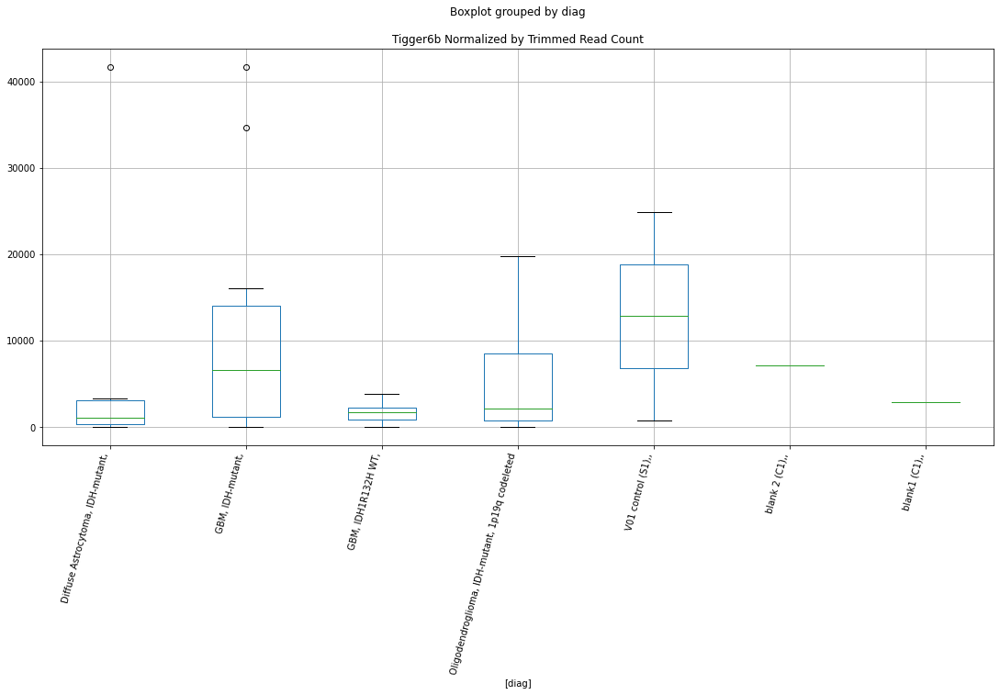

 p : 0.04713016924245259  ( t : 2.13100935774046 ) :  D-plex  :  bbduk2  :  LOR1b
Control and blanks
73      8503.09
337    66761.79
Name: LOR1b, dtype: float64
205    19520.91
Name: LOR1b, dtype: float64
469    18928.87
Name: LOR1b, dtype: float64


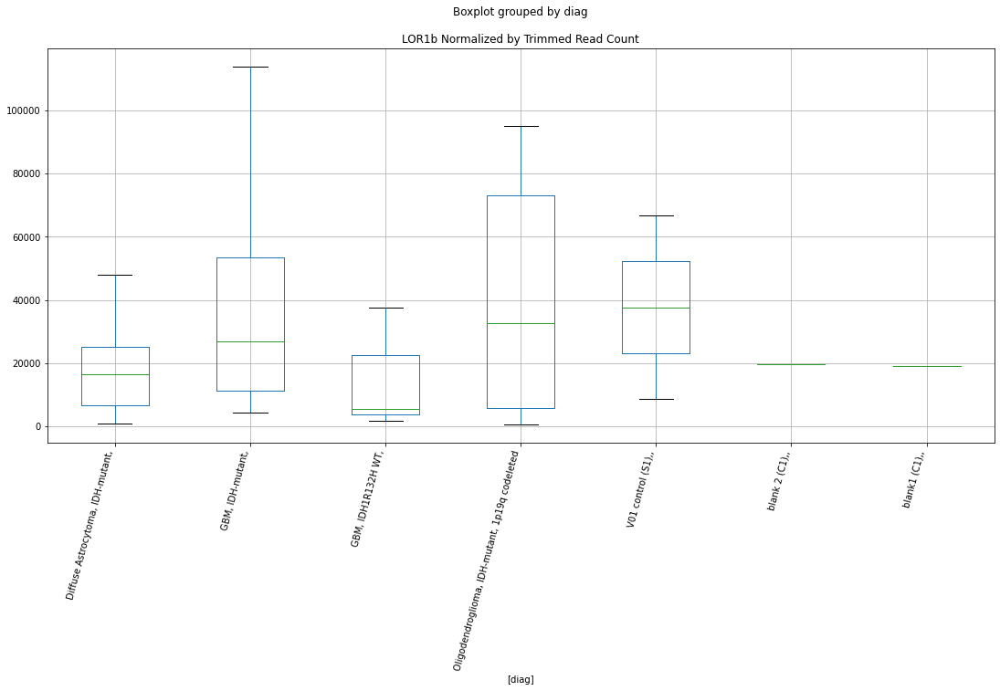

 p : 0.04713736312431244  ( t : 2.1309318732174014 ) :  D-plex  :  cutadapt2  :  Tigger2
Control and blanks
76      89398.48
340    159412.52
Name: Tigger2, dtype: float64
208    97879.92
Name: Tigger2, dtype: float64
472    104610.01
Name: Tigger2, dtype: float64


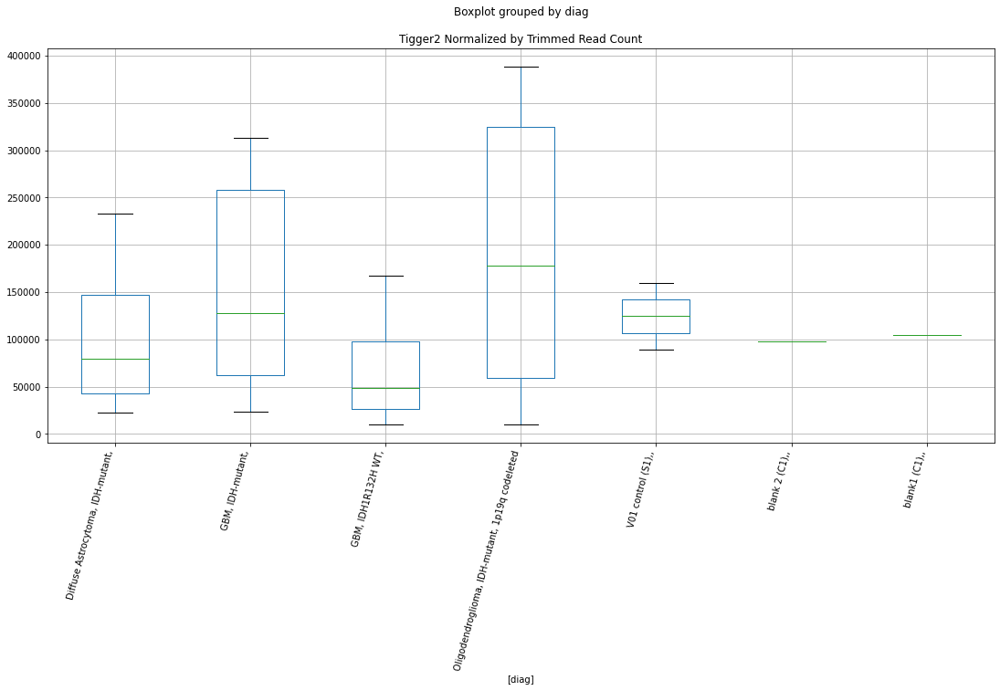

 p : 0.04713909220689359  ( t : 2.1309132510634217 ) :  D-plex  :  cutadapt2  :  MER4A1
Control and blanks
76     28031.73
340    54605.39
Name: MER4A1, dtype: float64
208    47969.98
Name: MER4A1, dtype: float64
472    46814.42
Name: MER4A1, dtype: float64


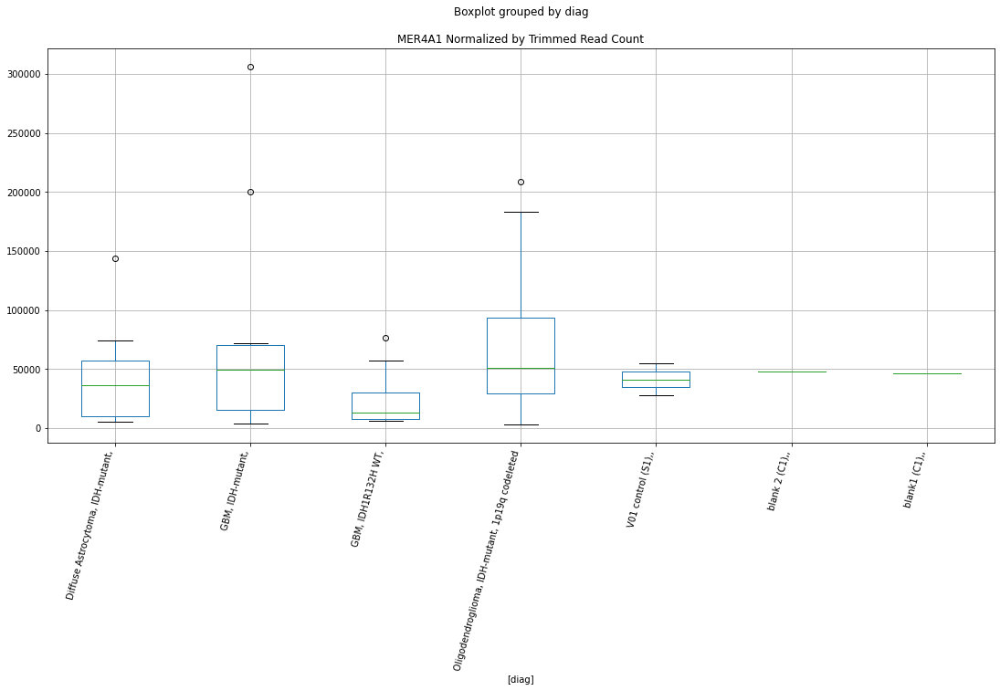

 p : 0.04715280530301921  ( t : 2.1307655835919177 ) :  D-plex  :  cutadapt2  :  (GATTTT)n
Control and blanks
76     0.0
340    0.0
Name: (GATTTT)n, dtype: float64
208    176.36
Name: (GATTTT)n, dtype: float64
472    0.0
Name: (GATTTT)n, dtype: float64


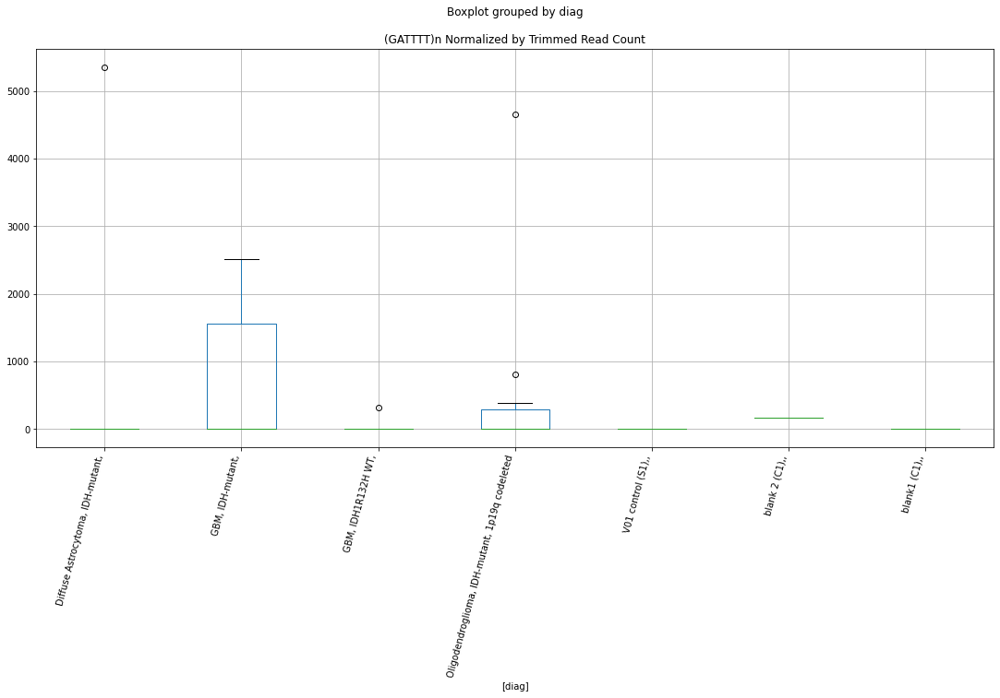

 p : 0.04722085102363114  ( t : 2.1300334219473784 ) :  D-plex  :  cutadapt2  :  PRIMA41-int
Control and blanks
76     3788.07
340    7926.59
Name: PRIMA41-int, dtype: float64
208    19223.26
Name: PRIMA41-int, dtype: float64
472    23696.19
Name: PRIMA41-int, dtype: float64


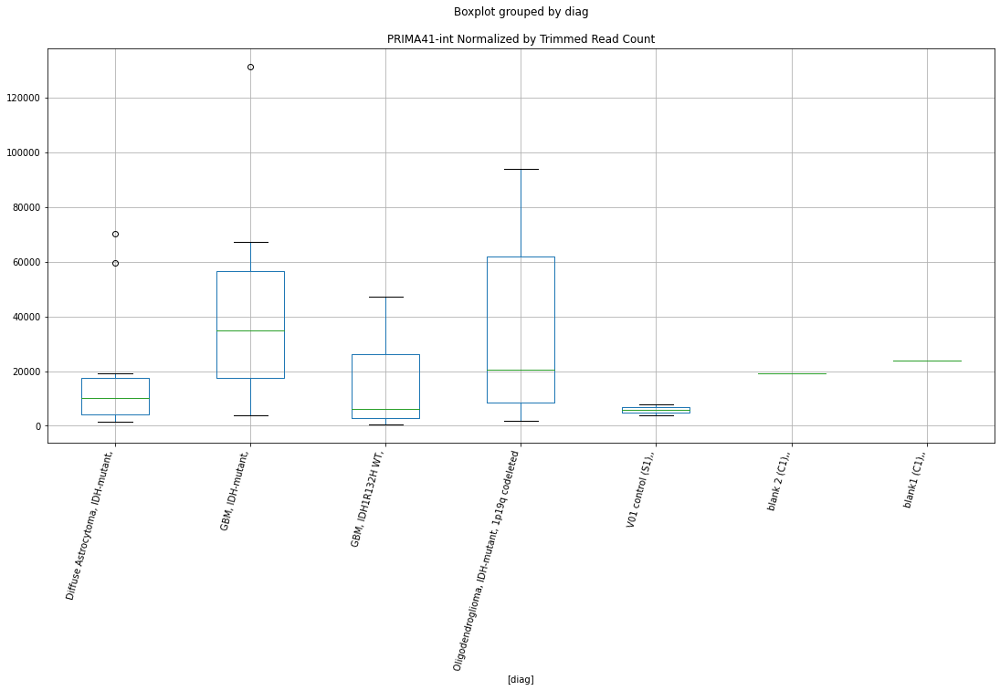

 p : 0.04723774730801836  ( t : 2.129851769586911 ) :  D-plex  :  cutadapt2  :  (TTC)n
Control and blanks
76      8333.76
340    10568.79
Name: (TTC)n, dtype: float64
208    23808.63
Name: (TTC)n, dtype: float64
472    18494.59
Name: (TTC)n, dtype: float64


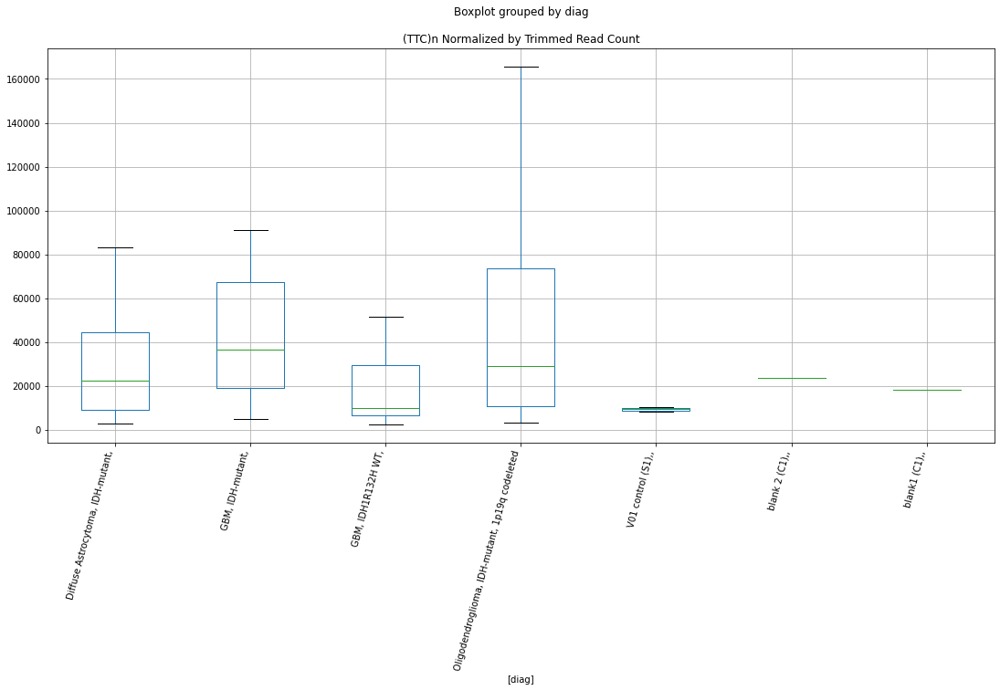

 p : 0.04728521216015278  ( t : 2.12934179060042 ) :  D-plex  :  bbduk2  :  (TTCCC)n
Control and blanks
73     773.01
337    890.16
Name: (TTCCC)n, dtype: float64
205    2328.18
Name: (TTCCC)n, dtype: float64
469    2366.11
Name: (TTCCC)n, dtype: float64


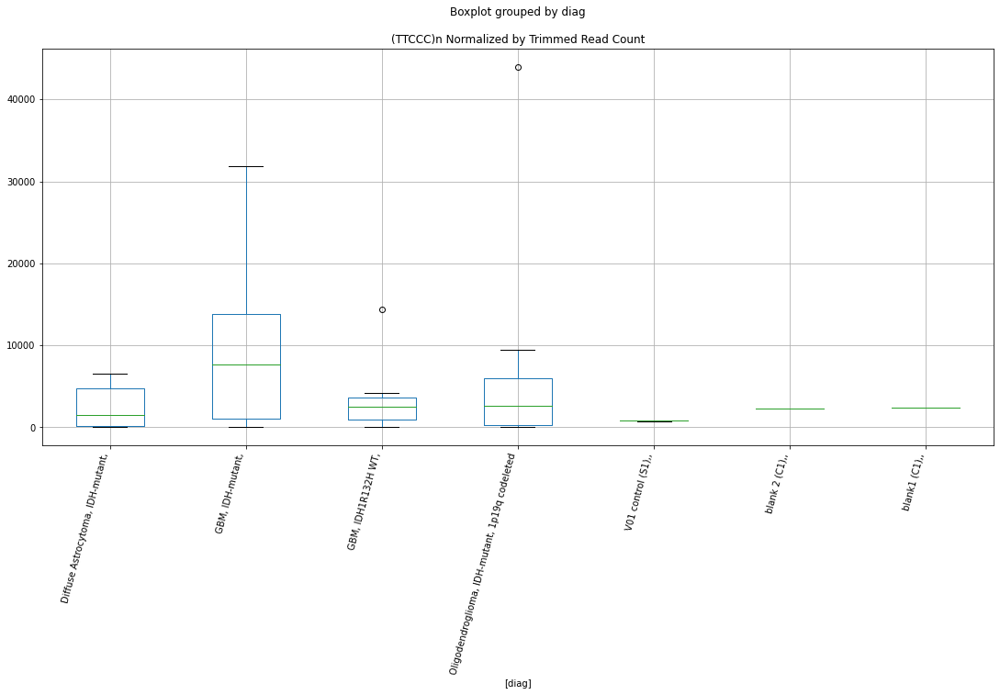

 p : 0.04728558904905809  ( t : 2.1293377430421705 ) :  D-plex  :  bbduk2  :  (CACCAC)n
Control and blanks
73     773.01
337    890.16
Name: (CACCAC)n, dtype: float64
205    3044.55
Name: (CACCAC)n, dtype: float64
469    1774.58
Name: (CACCAC)n, dtype: float64


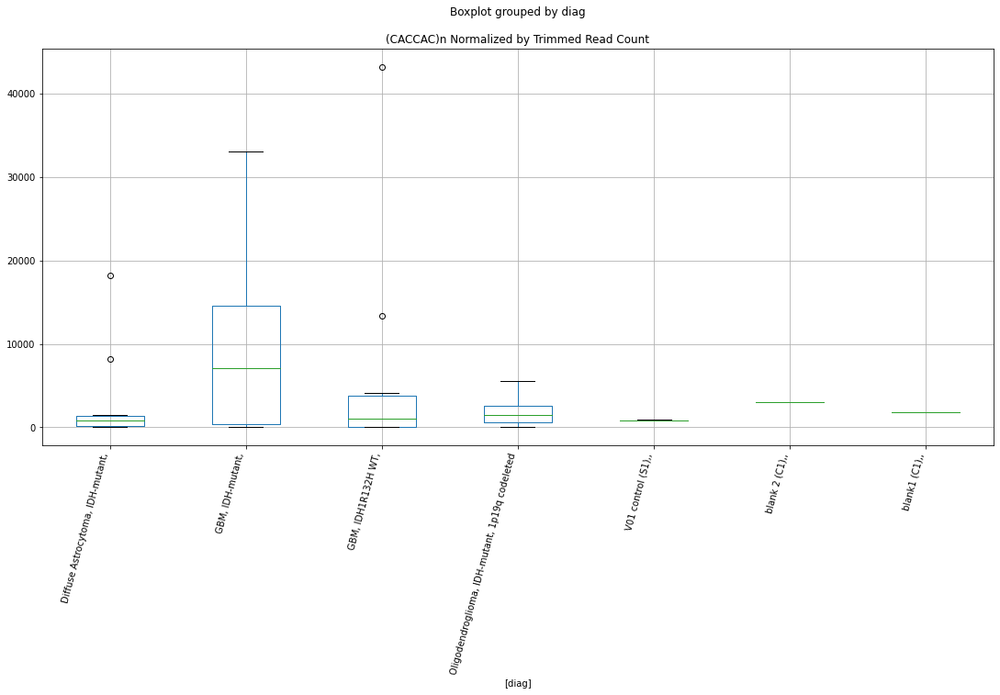

 p : 0.04729180650182383  ( t : 2.129270975615087 ) :  D-plex  :  cutadapt2  :  LTR1A2
Control and blanks
76     25001.27
340      880.73
Name: LTR1A2, dtype: float64
208    24161.35
Name: LTR1A2, dtype: float64
472    24852.1
Name: LTR1A2, dtype: float64


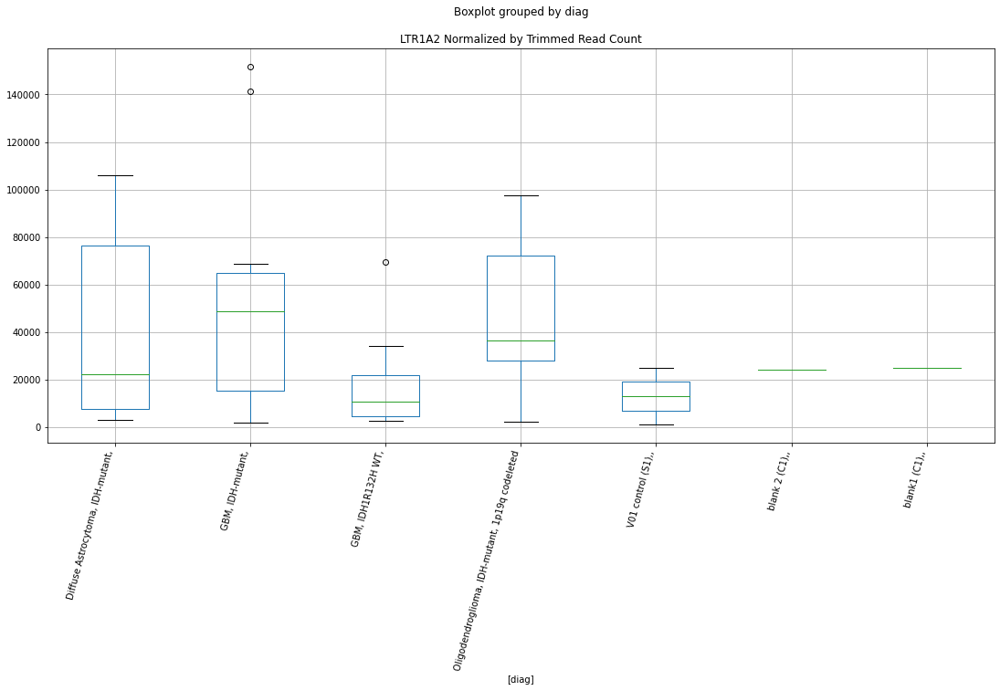

 p : 0.047300469294370526  ( t : 2.1291779617334665 ) :  D-plex  :  cutadapt2  :  (ACC)n
Control and blanks
76        0.00
340    4403.66
Name: (ACC)n, dtype: float64
208    4056.29
Name: (ACC)n, dtype: float64
472    3467.74
Name: (ACC)n, dtype: float64


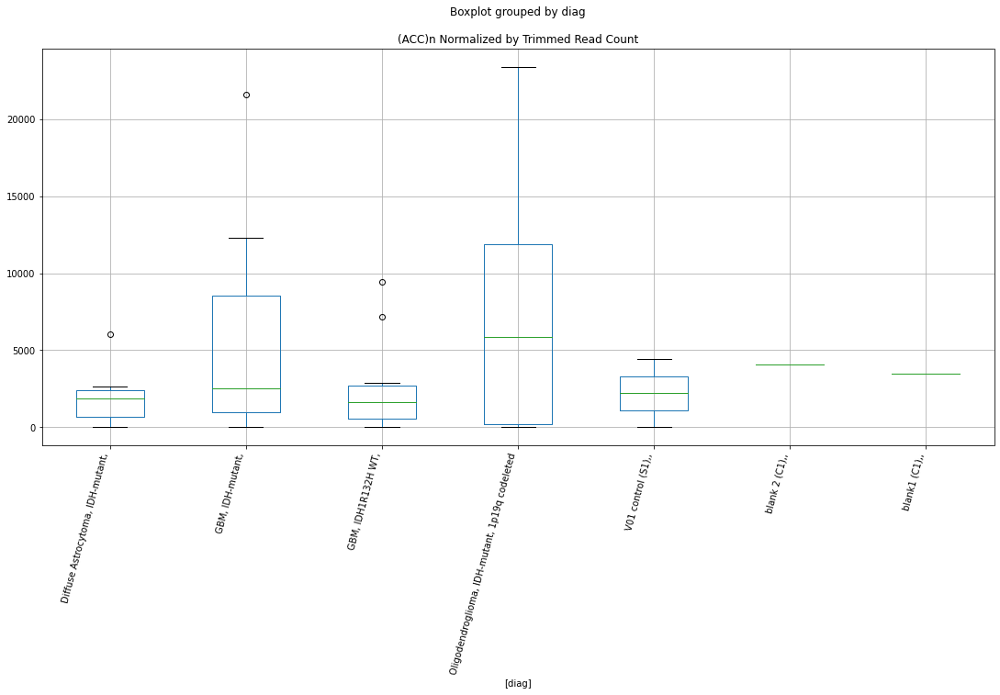

 p : 0.04737090447681263  ( t : 2.128422263131633 ) :  D-plex  :  bbduk2  :  Charlie4a
Control and blanks
73      4638.05
337    62311.01
Name: Charlie4a, dtype: float64
205    37609.1
Name: Charlie4a, dtype: float64
469    41406.91
Name: Charlie4a, dtype: float64


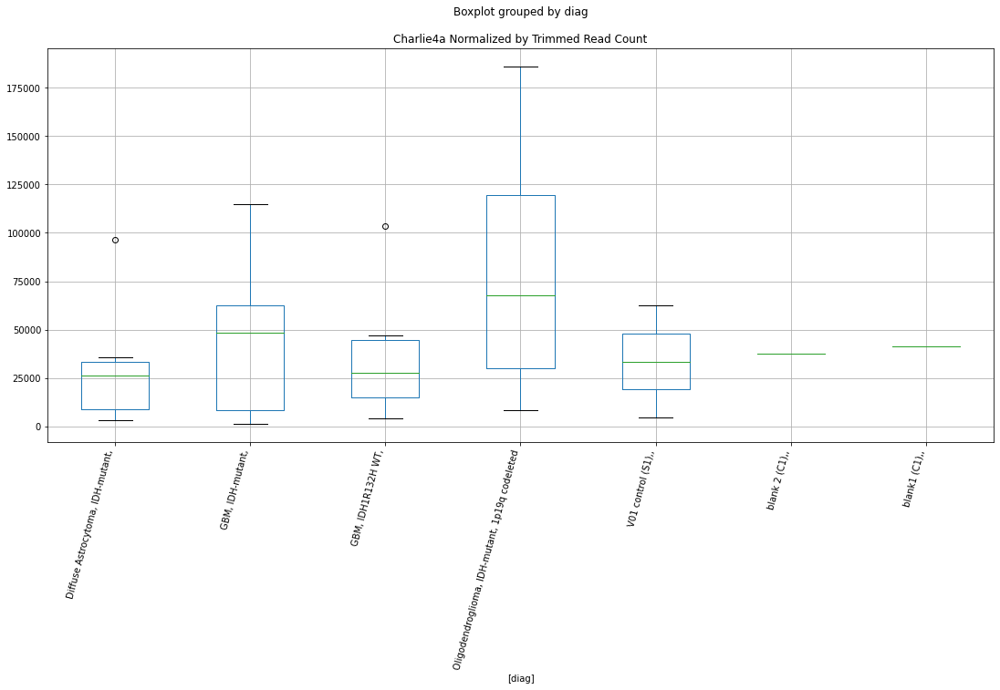

 p : 0.047376463746596806  ( t : 2.1283626613882434 ) :  D-plex  :  cutadapt2  :  AluYf1
Control and blanks
76      37880.71
340    151485.93
Name: AluYf1, dtype: float64
208    52555.34
Name: AluYf1, dtype: float64
472    65309.01
Name: AluYf1, dtype: float64


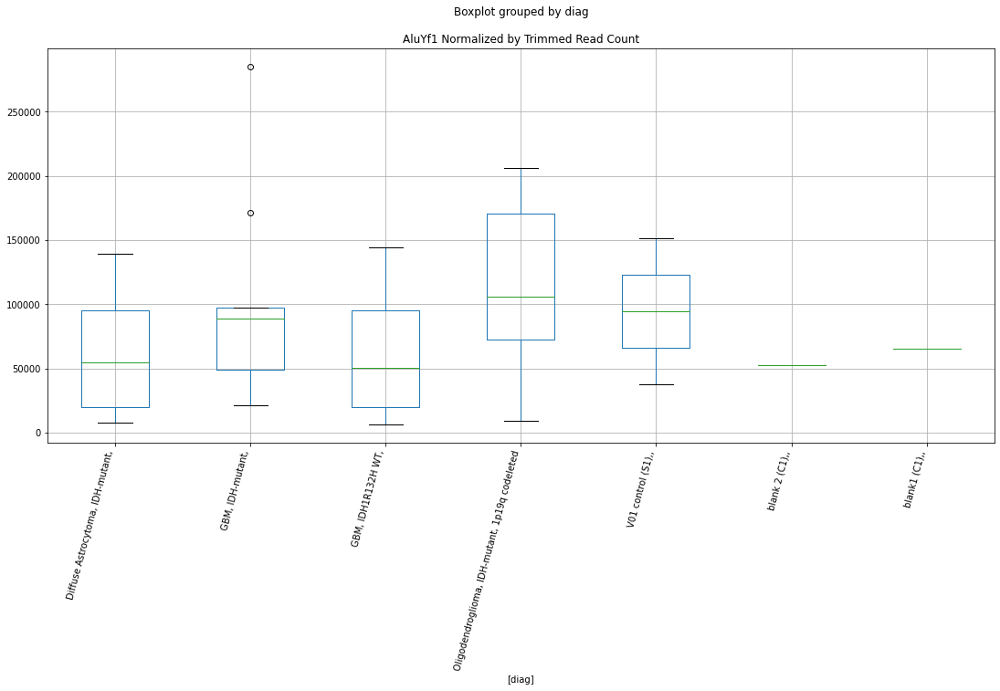

 p : 0.04743499425117702  ( t : 2.1277355339317086 ) :  Lexogen  :  cutadapt2  :  tRNA-Val-GTY
Control and blanks
82     0.0
346    0.0
Name: tRNA-Val-GTY, dtype: float64
214    0.0
Name: tRNA-Val-GTY, dtype: float64
478    0.0
Name: tRNA-Val-GTY, dtype: float64


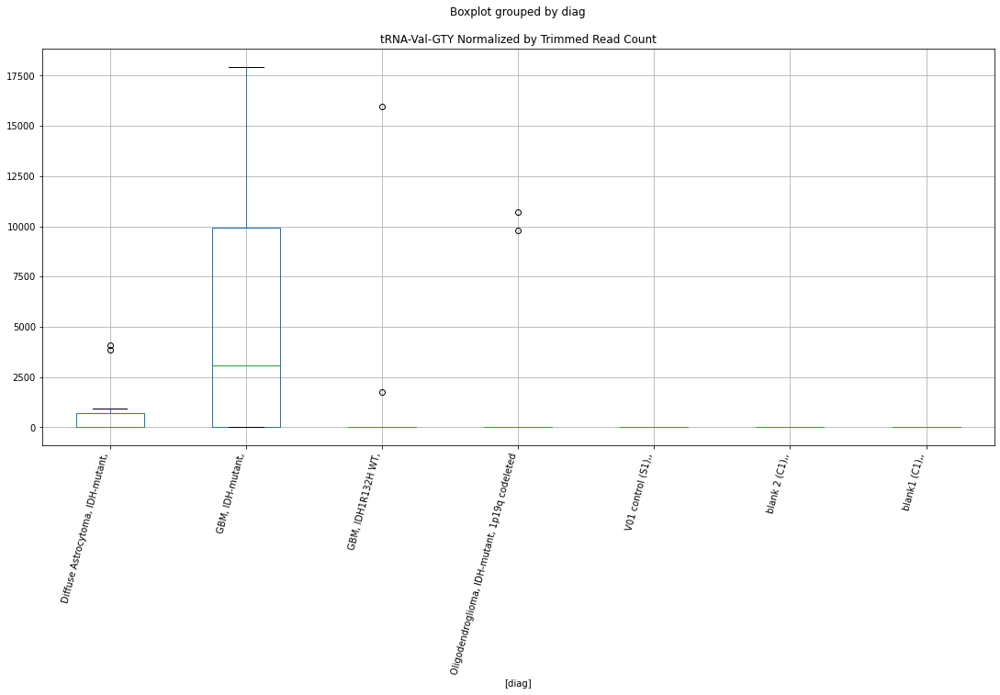

 p : 0.04747208128675695  ( t : 2.1273385283793447 ) :  D-plex  :  cutadapt2  :  MamRep1894
Control and blanks
76     757.61
340      0.00
Name: MamRep1894, dtype: float64
208    3879.92
Name: MamRep1894, dtype: float64
472    5779.56
Name: MamRep1894, dtype: float64


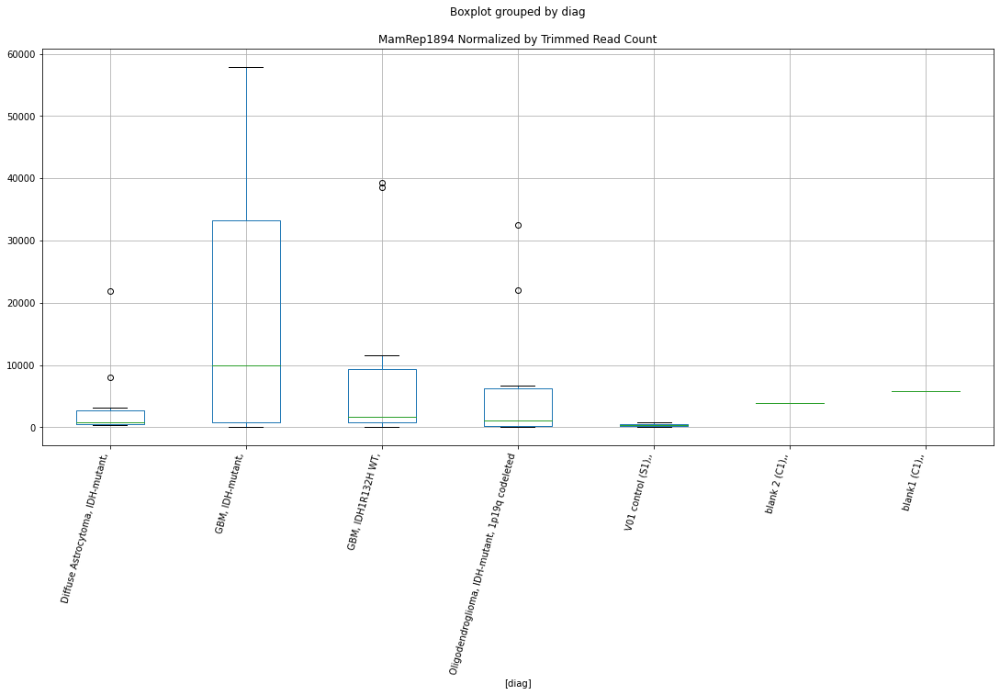

 p : 0.04759515270041809  ( t : 2.1260231085712986 ) :  D-plex  :  cutadapt2  :  MER72B
Control and blanks
76     1515.23
340    3522.93
Name: MER72B, dtype: float64
208    3174.48
Name: MER72B, dtype: float64
472    2889.78
Name: MER72B, dtype: float64


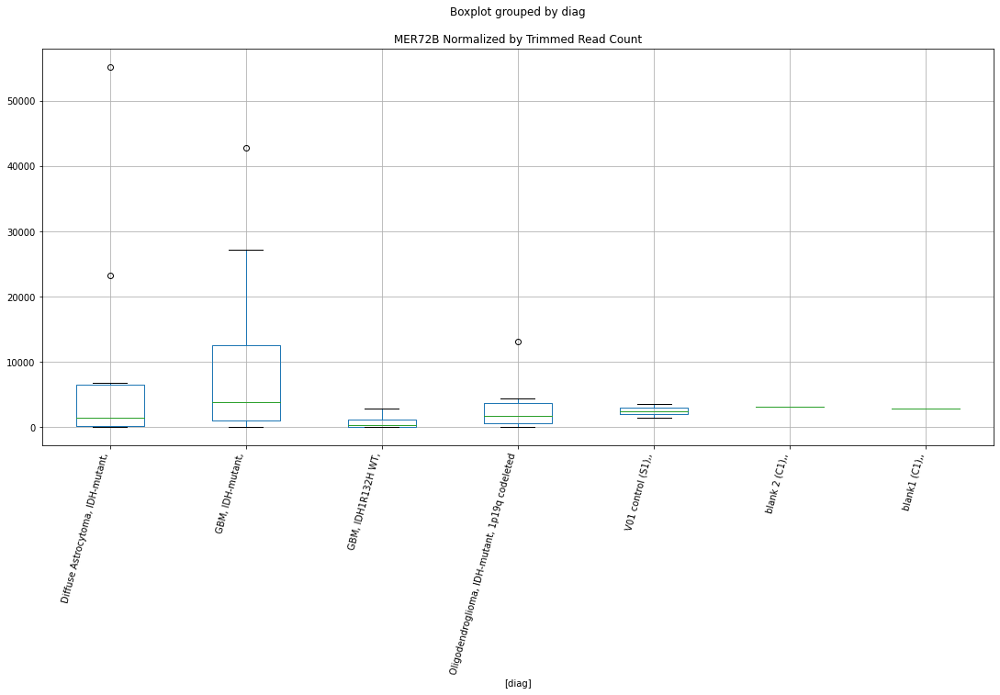

 p : 0.04765760449398224  ( t : 2.1253567925673726 ) :  D-plex  :  bbduk2  :  (GTCTCT)n
Control and blanks
73        0.00
337    3560.63
Name: (GTCTCT)n, dtype: float64
205    358.18
Name: (GTCTCT)n, dtype: float64
469    2957.64
Name: (GTCTCT)n, dtype: float64


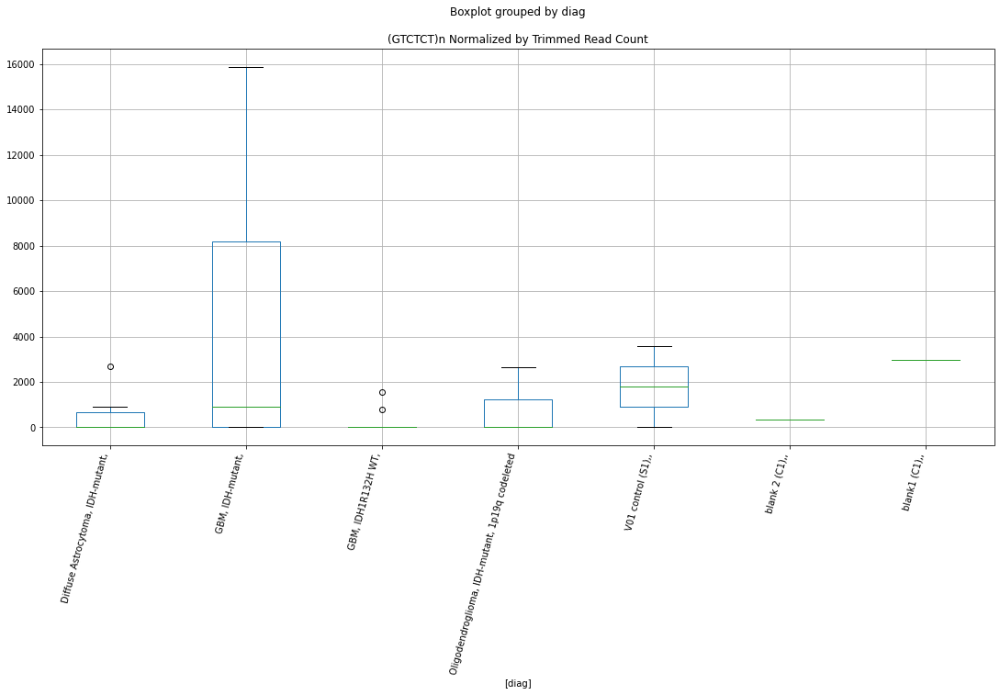

 p : 0.047682563030974484  ( t : 2.125090725350984 ) :  D-plex  :  bbduk2  :  MER65D
Control and blanks
73     0.0
337    0.0
Name: MER65D, dtype: float64
205    6805.46
Name: MER65D, dtype: float64
469    10055.96
Name: MER65D, dtype: float64


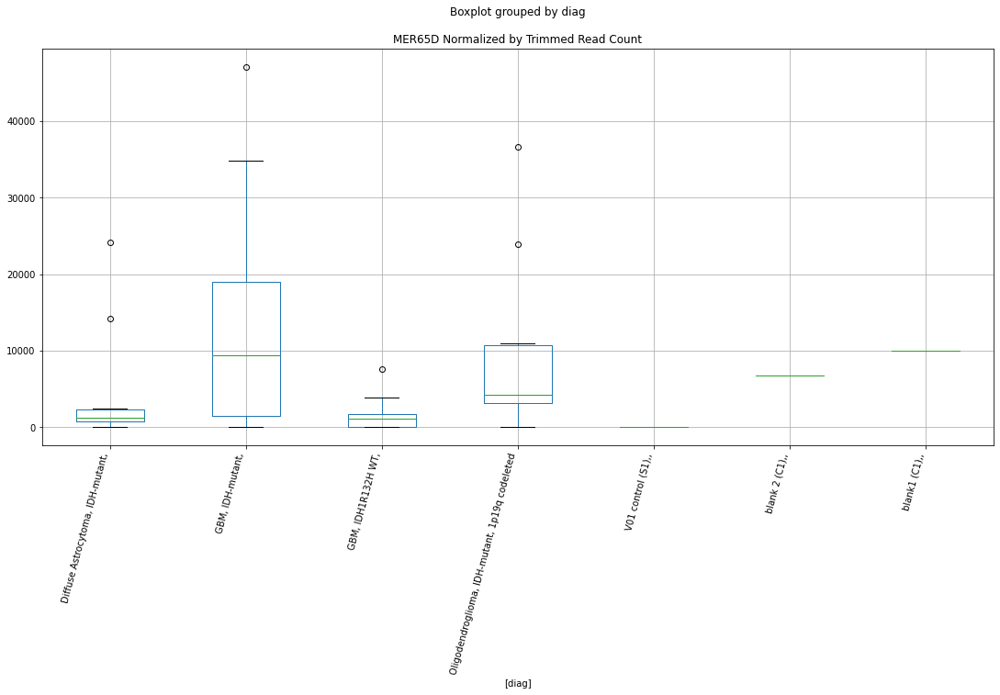

 p : 0.04770298854641147  ( t : 2.1248730762345107 ) :  Lexogen  :  cutadapt2  :  L1MB3
Control and blanks
82       0.00
346    210.43
Name: L1MB3, dtype: float64
214    271.23
Name: L1MB3, dtype: float64
478    237.46
Name: L1MB3, dtype: float64


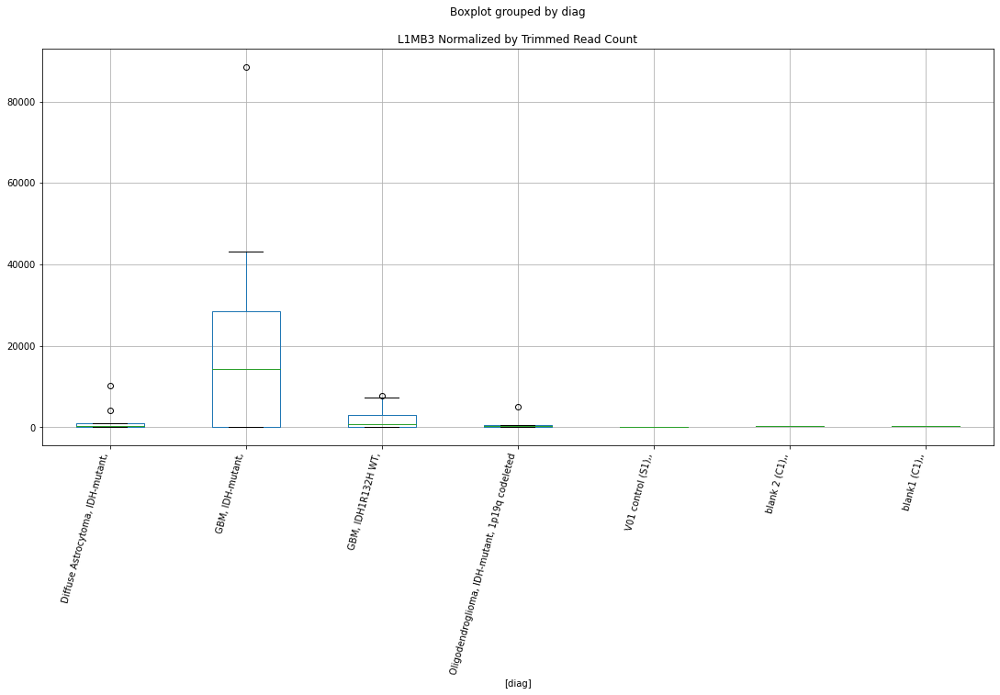

 p : 0.04770954585471042  ( t : 2.124803221227442 ) :  D-plex  :  bbduk2  :  L1MEa
Control and blanks
73      1546.02
337    33825.98
Name: L1MEa, dtype: float64
205    7700.91
Name: L1MEa, dtype: float64
469    8872.91
Name: L1MEa, dtype: float64


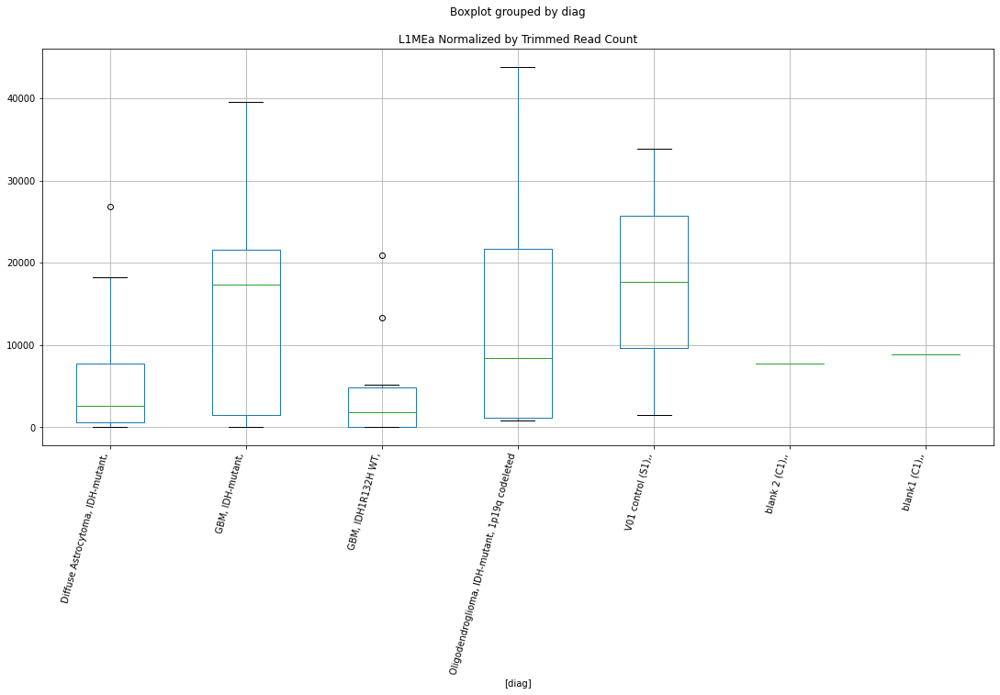

 p : 0.047722651335551834  ( t : 2.1246636347498953 ) :  D-plex  :  bbduk2  :  X7C_LINE
Control and blanks
73     0.0
337    0.0
Name: X7C_LINE, dtype: float64
205    3760.91
Name: X7C_LINE, dtype: float64
469    1774.58
Name: X7C_LINE, dtype: float64


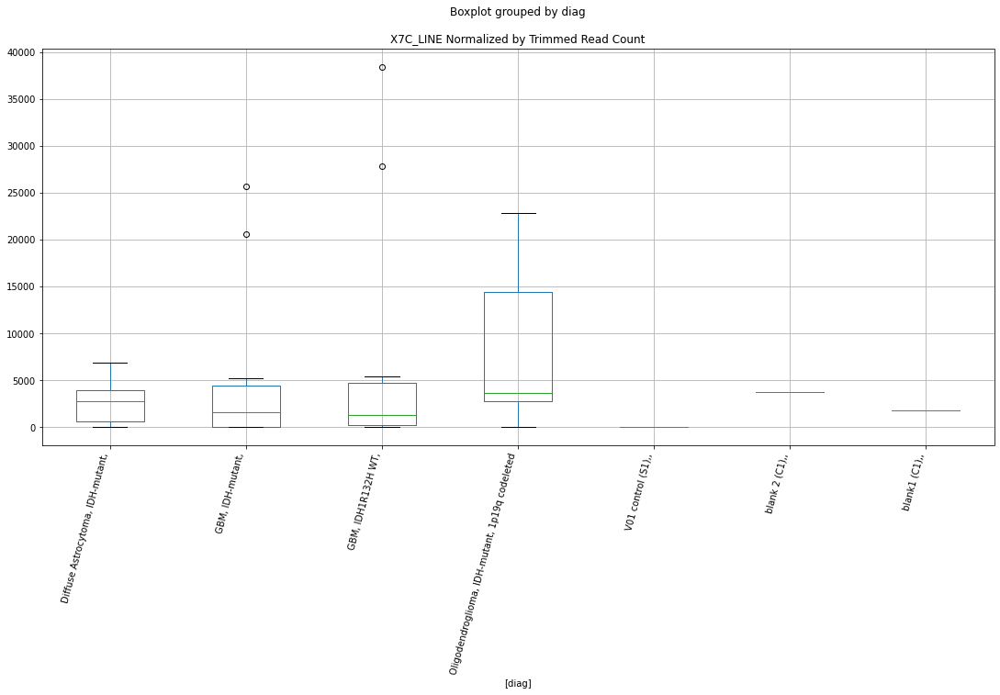

 p : 0.04775621998609993  ( t : 2.124306254314071 ) :  D-plex  :  bbduk2  :  Tigger2
Control and blanks
73      92761.01
337    165569.25
Name: Tigger2, dtype: float64
205    95813.66
Name: Tigger2, dtype: float64
469    103517.28
Name: Tigger2, dtype: float64


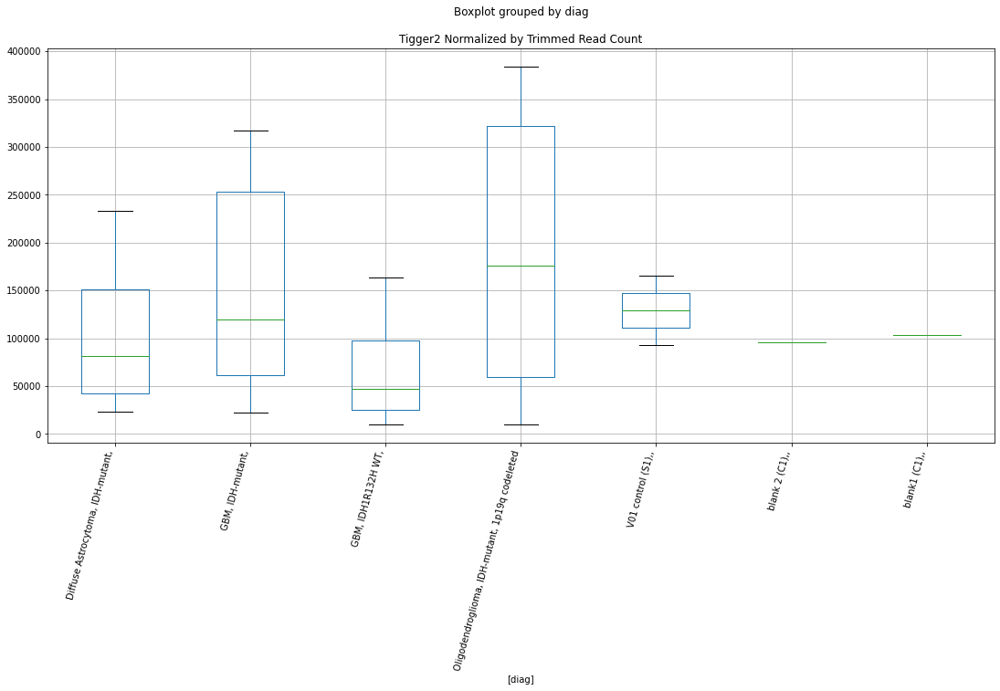

 p : 0.047824892089422984  ( t : 2.1235758661107185 ) :  D-plex  :  bbduk2  :  Charlie5
Control and blanks
73     25509.28
337    34716.13
Name: Charlie5, dtype: float64
205    20237.28
Name: Charlie5, dtype: float64
469    23661.09
Name: Charlie5, dtype: float64


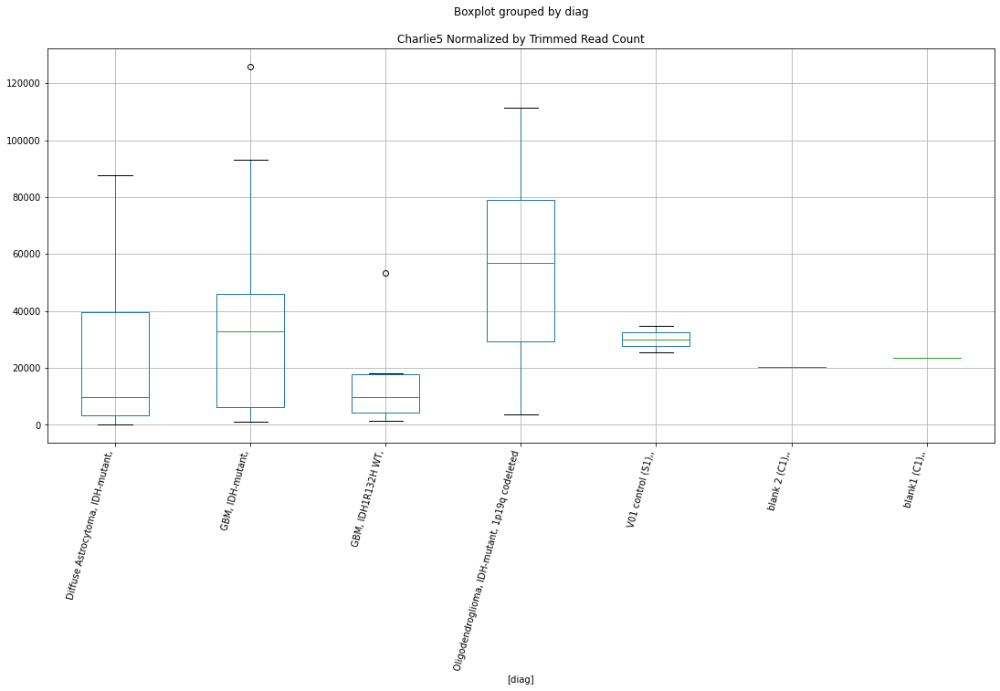

 p : 0.04783045748132389  ( t : 2.123516715143553 ) :  D-plex  :  bbduk2  :  (AAAC)n
Control and blanks
73        0.00
337    1780.31
Name: (AAAC)n, dtype: float64
205    4835.46
Name: (AAAC)n, dtype: float64
469    591.53
Name: (AAAC)n, dtype: float64


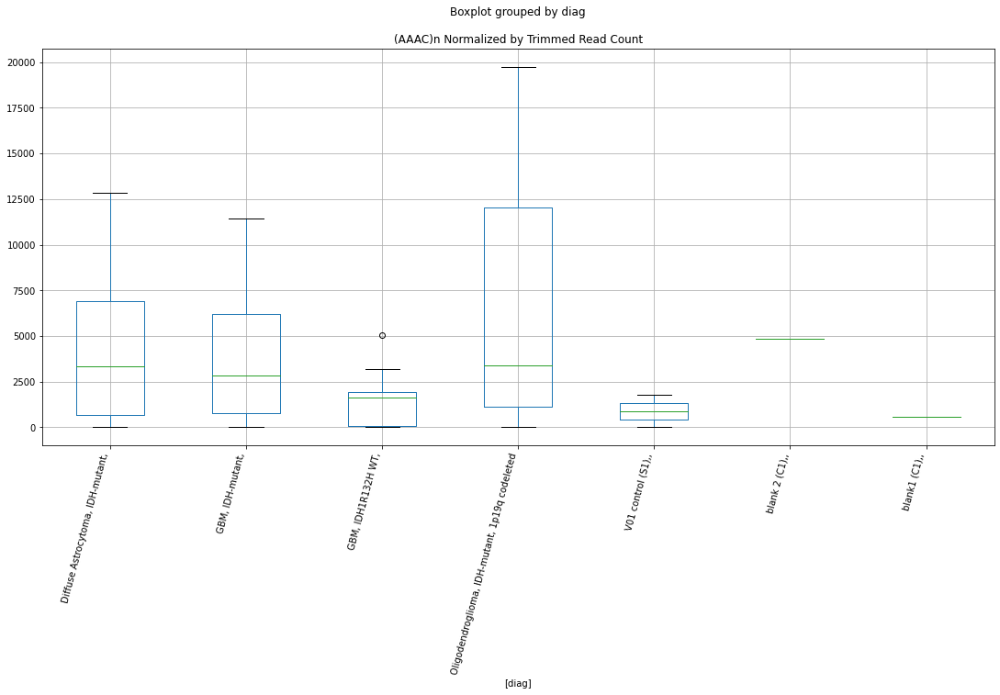

 p : 0.04783662661047829  ( t : 2.1234511547698967 ) :  D-plex  :  bbduk2  :  (TCTTTC)n
Control and blanks
73     20871.23
337        0.00
Name: (TCTTTC)n, dtype: float64
205    895.45
Name: (TCTTTC)n, dtype: float64
469    591.53
Name: (TCTTTC)n, dtype: float64


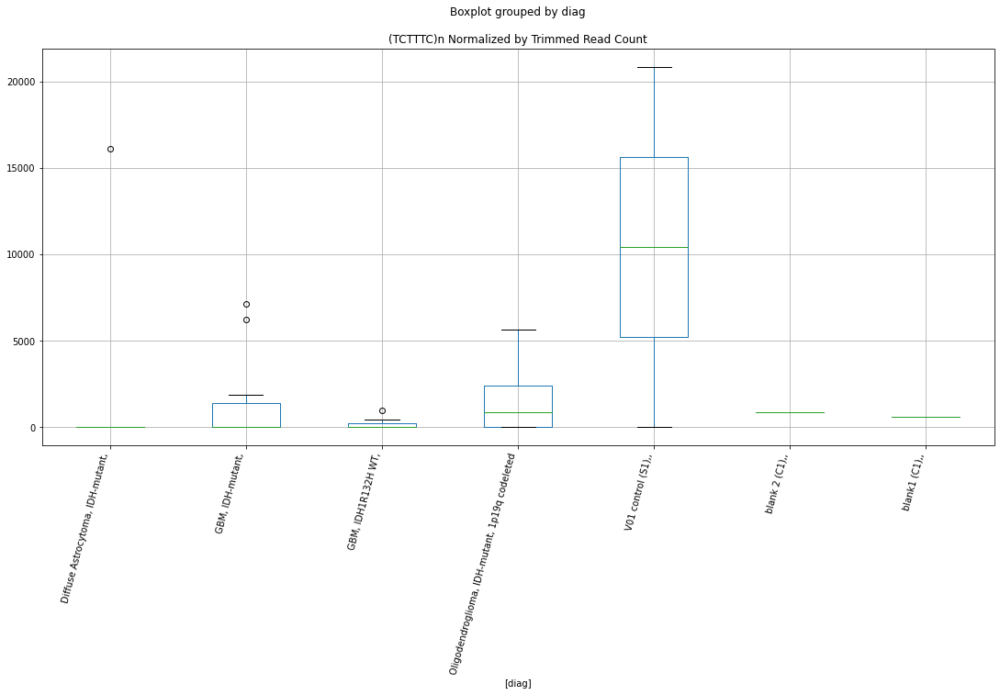

 p : 0.04784543249684102  ( t : 2.123357586478648 ) :  D-plex  :  bbduk2  :  Tigger4b
Control and blanks
73     29374.32
337    40947.23
Name: Tigger4b, dtype: float64
205    38146.37
Name: Tigger4b, dtype: float64
469    34900.11
Name: Tigger4b, dtype: float64


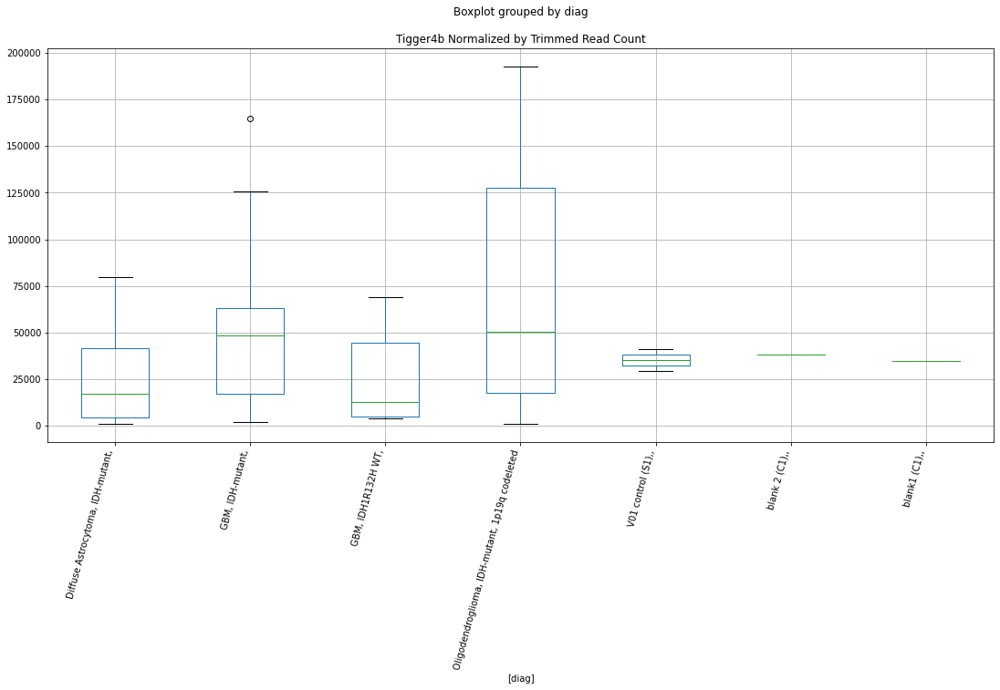

 p : 0.047853908173087864  ( t : 2.1232675417036346 ) :  D-plex  :  bbduk2  :  AluYb9
Control and blanks
73      3092.03
337    11572.04
Name: AluYb9, dtype: float64
205    7700.91
Name: AluYb9, dtype: float64
469    4140.69
Name: AluYb9, dtype: float64


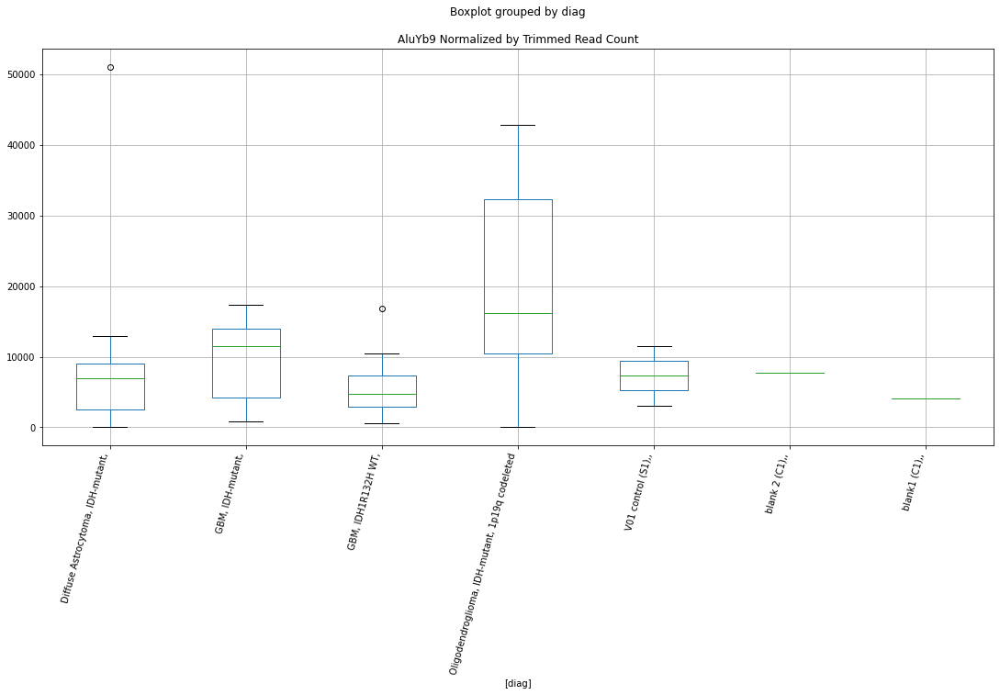

 p : 0.047876870625790414  ( t : 2.123023663790737 ) :  D-plex  :  bbduk2  :  (TATAT)n
Control and blanks
73     773.01
337      0.00
Name: (TATAT)n, dtype: float64
205    1432.73
Name: (TATAT)n, dtype: float64
469    1183.05
Name: (TATAT)n, dtype: float64


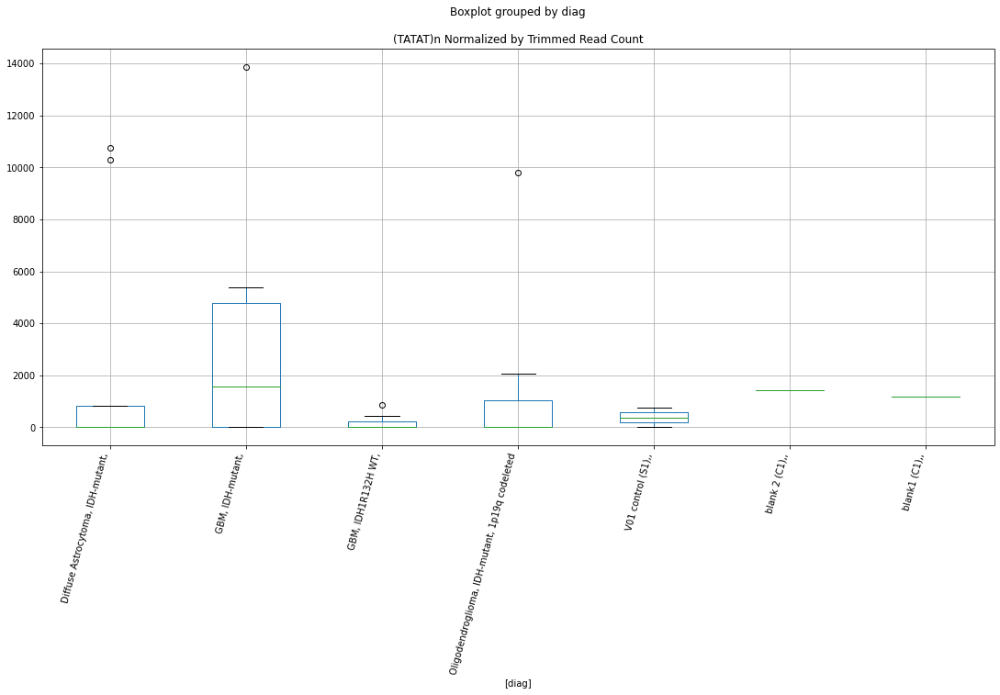

 p : 0.047894801376316534  ( t : 2.122833300295888 ) :  Lexogen  :  cutadapt2  :  L1HS
Control and blanks
82     1420.05
346       0.00
Name: L1HS, dtype: float64
214    0.0
Name: L1HS, dtype: float64
478    237.46
Name: L1HS, dtype: float64


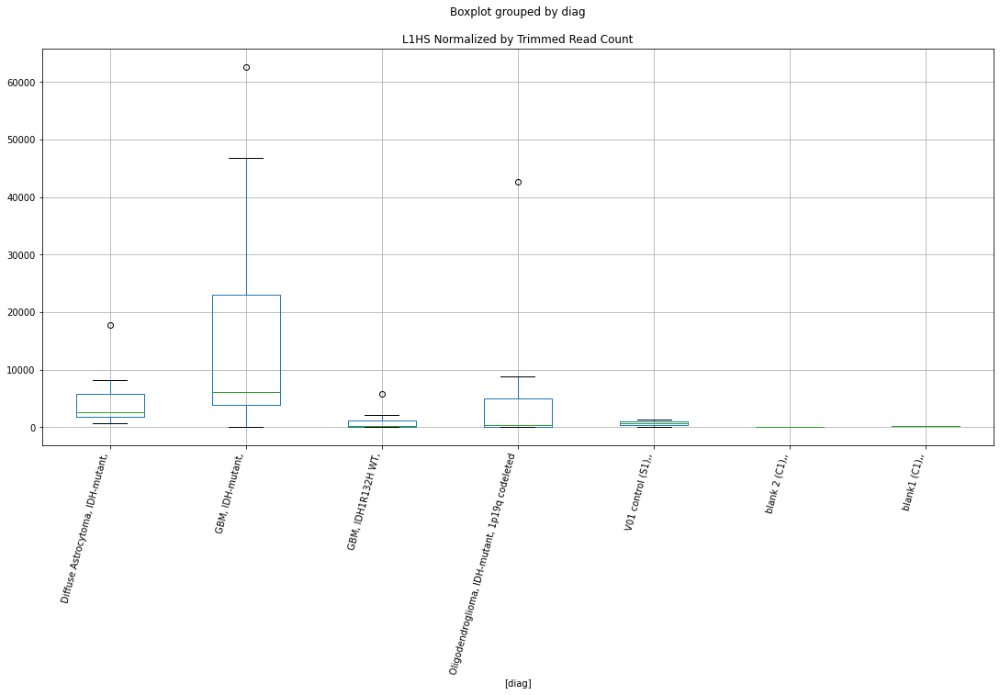

 p : 0.04793967076455083  ( t : 2.1223572246116076 ) :  D-plex  :  bbduk2  :  PABL_B
Control and blanks
73     1546.02
337     890.16
Name: PABL_B, dtype: float64
205    7700.91
Name: PABL_B, dtype: float64
469    4732.22
Name: PABL_B, dtype: float64


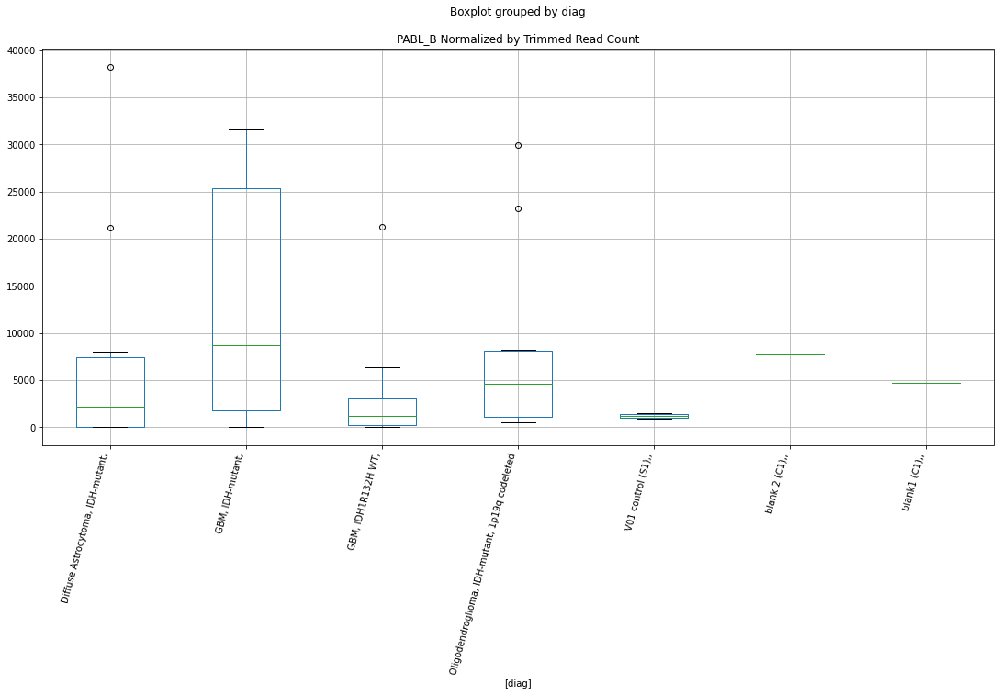

 p : 0.04797785519010066  ( t : 2.1219523977166594 ) :  D-plex  :  bbduk2  :  LOR1b
Control and blanks
73      8503.09
337    66761.79
Name: LOR1b, dtype: float64
205    19520.91
Name: LOR1b, dtype: float64
469    18928.87
Name: LOR1b, dtype: float64


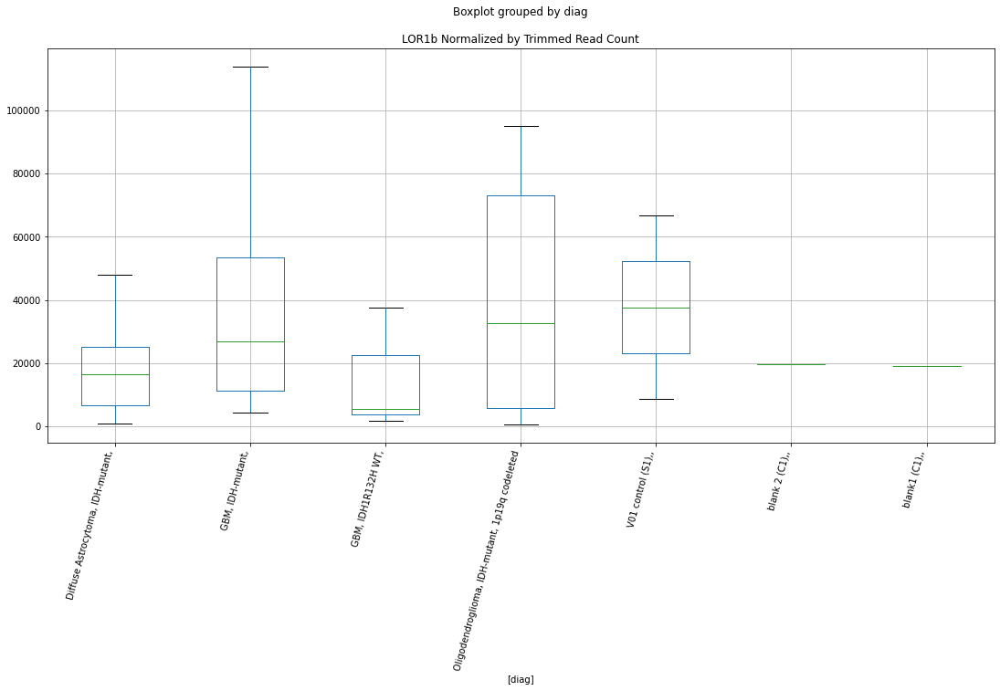

 p : 0.04801608645941608  ( t : 2.121547368142085 ) :  Lexogen  :  bbduk2  :  7SLRNA
Control and blanks
79     0.0
343    0.0
Name: 7SLRNA, dtype: float64
211    0.0
Name: 7SLRNA, dtype: float64
475    0.0
Name: 7SLRNA, dtype: float64


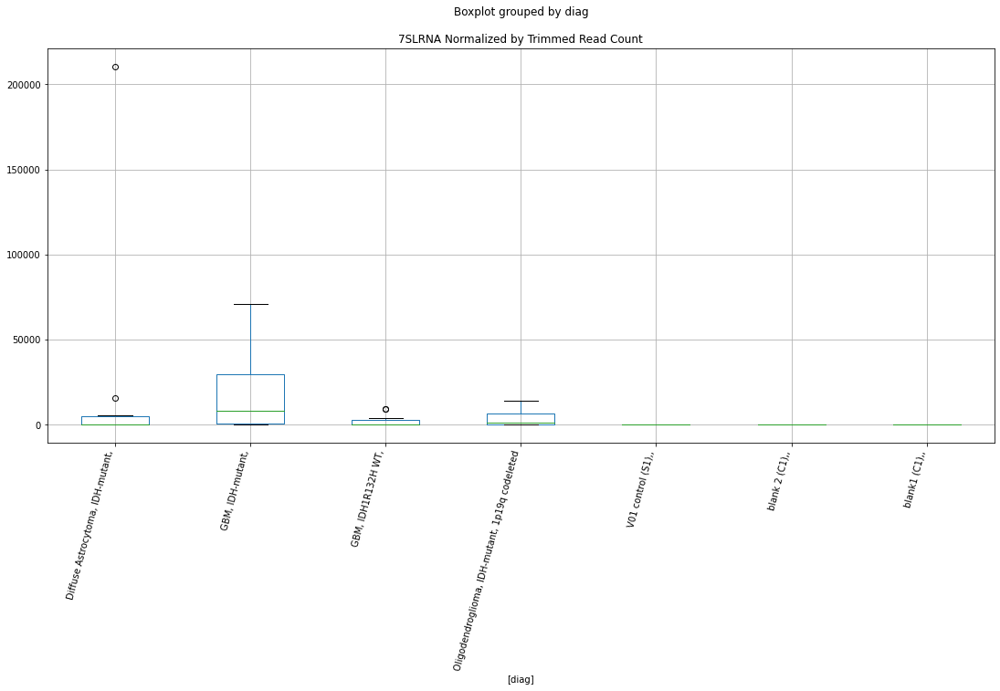

 p : 0.04802127736157019  ( t : 2.1214923973594098 ) :  D-plex  :  bbduk2  :  X8_LINE
Control and blanks
73     0.0
337    0.0
Name: X8_LINE, dtype: float64
205    2865.46
Name: X8_LINE, dtype: float64
469    1774.58
Name: X8_LINE, dtype: float64


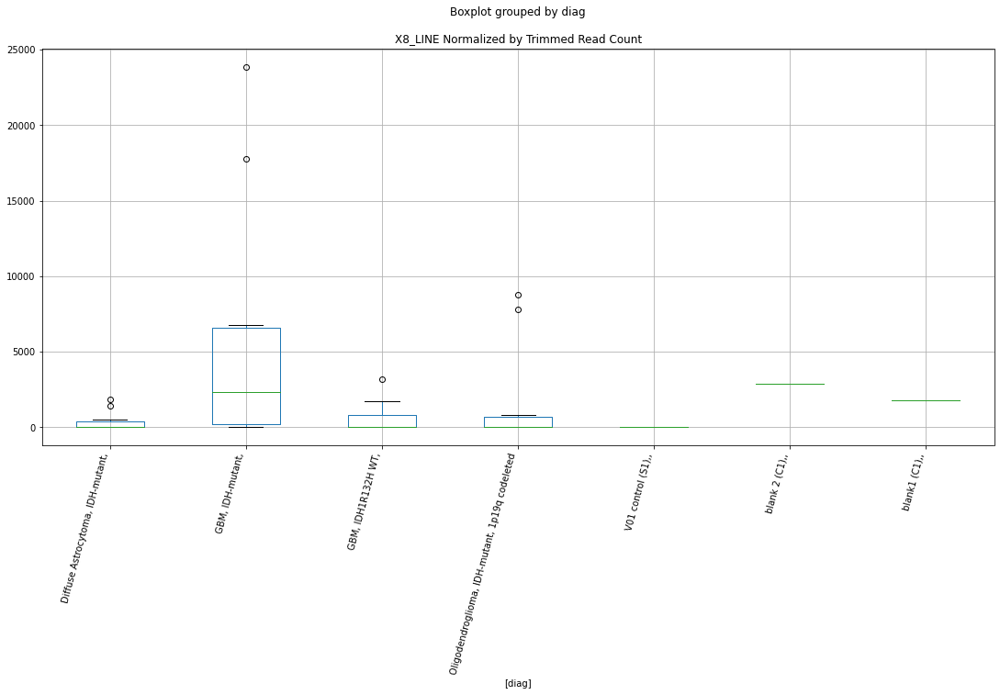

 p : 0.04812090921278256  ( t : 2.1204383603825163 ) :  D-plex  :  bbduk2  :  MER31A
Control and blanks
73     25509.28
337     2670.47
Name: MER31A, dtype: float64
205    21490.91
Name: MER31A, dtype: float64
469    23069.57
Name: MER31A, dtype: float64


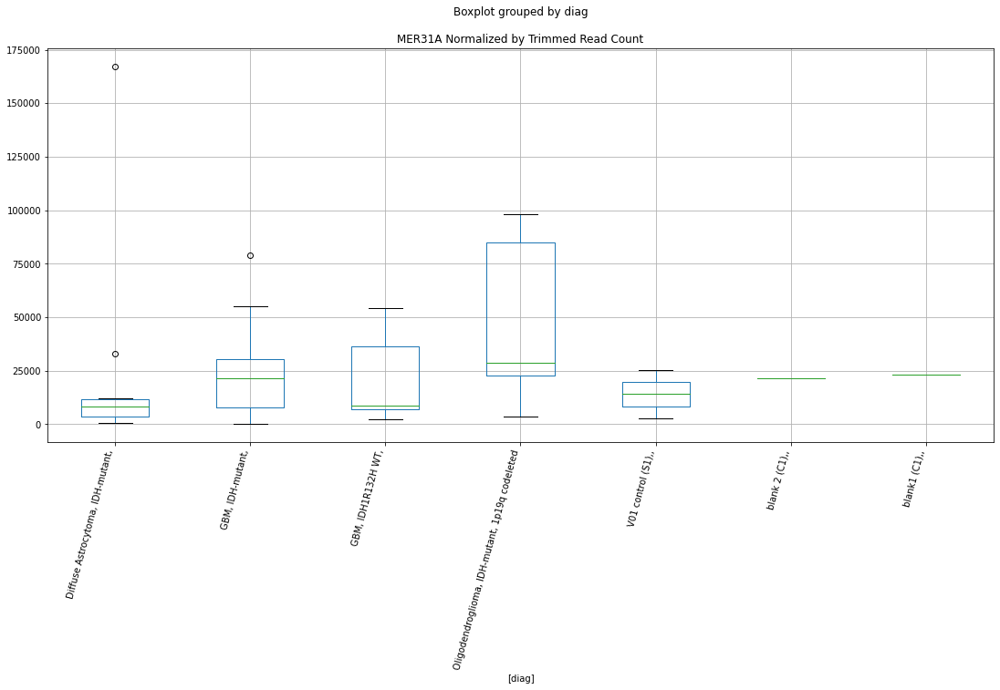

 p : 0.04812671370904923  ( t : 2.1203770140719564 ) :  D-plex  :  cutadapt2  :  (GGAGG)n
Control and blanks
76     1515.23
340       0.00
Name: (GGAGG)n, dtype: float64
208    0.0
Name: (GGAGG)n, dtype: float64
472    1733.87
Name: (GGAGG)n, dtype: float64


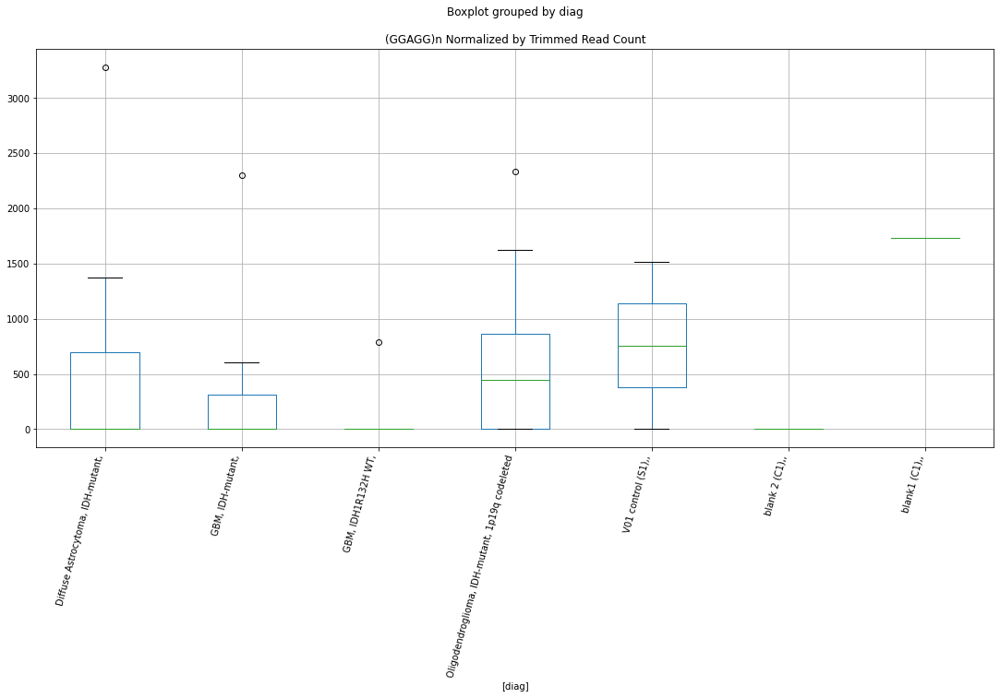

 p : 0.04812957556021772  ( t : 2.1203467703428407 ) :  D-plex  :  bbduk2  :  MER91A
Control and blanks
73      3092.03
337    22253.93
Name: MER91A, dtype: float64
205    26505.46
Name: MER91A, dtype: float64
469    24252.62
Name: MER91A, dtype: float64


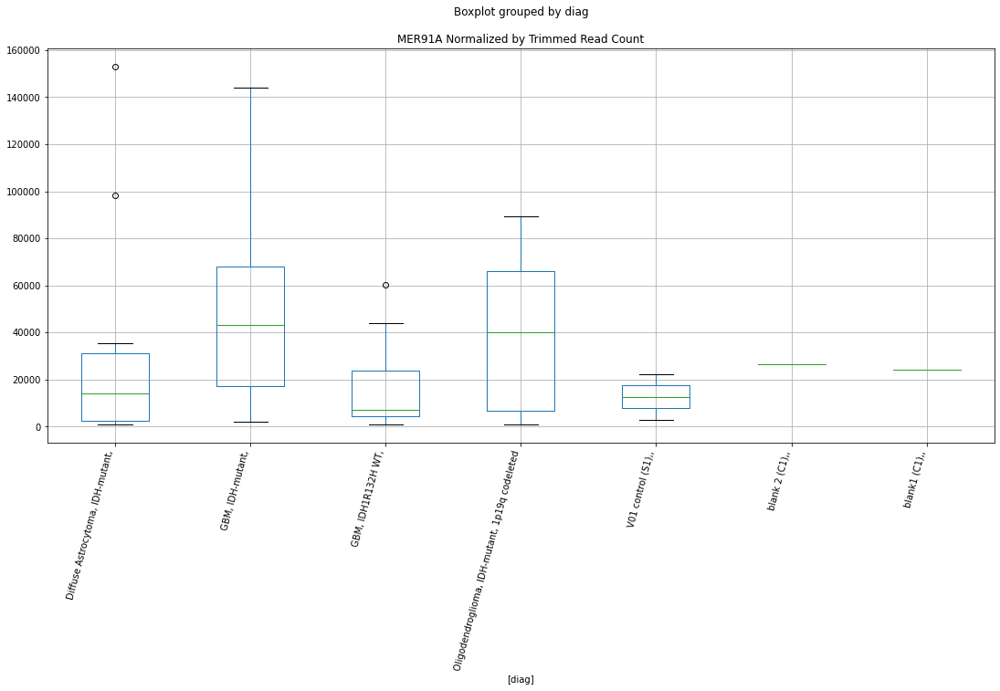

 p : 0.04814667787379392  ( t : 2.120166069104827 ) :  D-plex  :  bbduk2  :  (AACA)n
Control and blanks
73     1546.02
337    7121.26
Name: (AACA)n, dtype: float64
205    358.18
Name: (AACA)n, dtype: float64
469    1183.05
Name: (AACA)n, dtype: float64


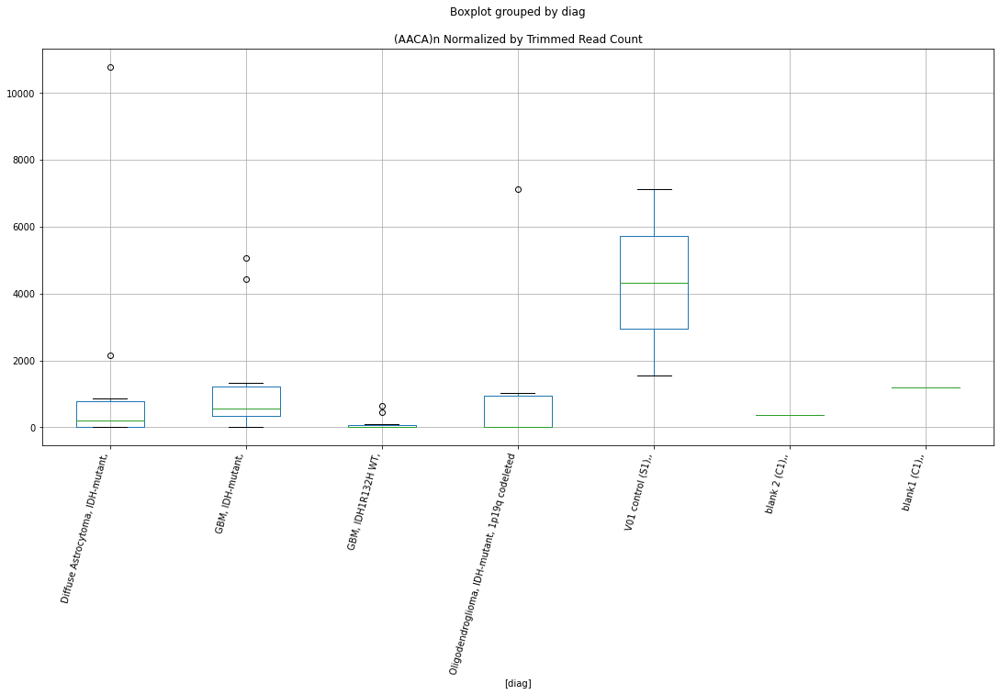

 p : 0.048158270035230114  ( t : 2.1200436207929556 ) :  D-plex  :  cutadapt2  :  HERVIP10B3-int
Control and blanks
76      3788.07
340    16733.91
Name: HERVIP10B3-int, dtype: float64
208    14990.62
Name: HERVIP10B3-int, dtype: float64
472    14448.9
Name: HERVIP10B3-int, dtype: float64


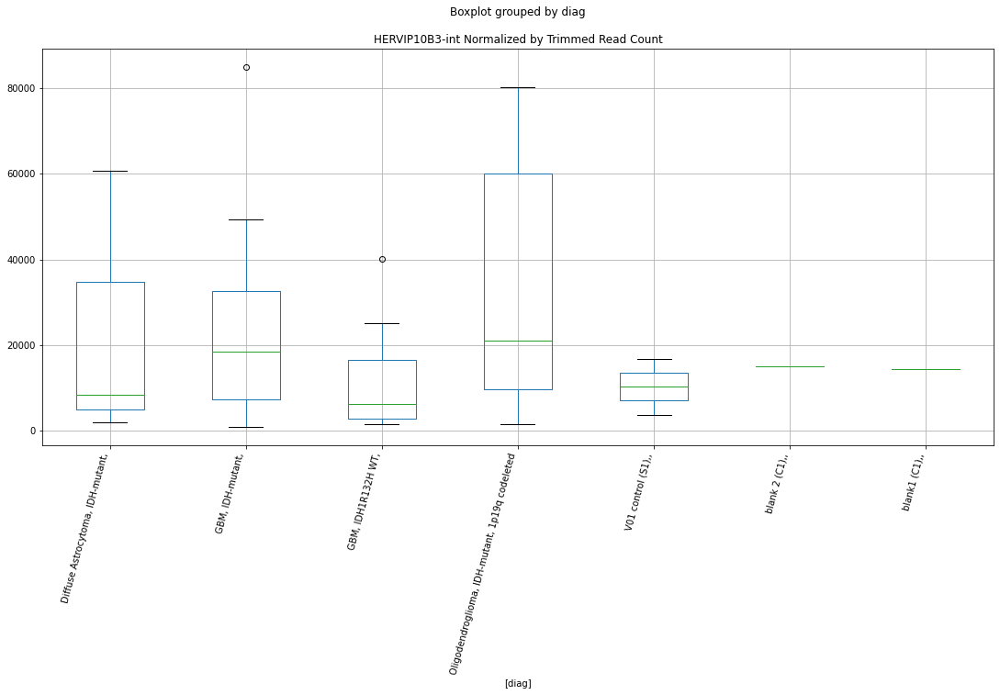

 p : 0.0481793506774016  ( t : 2.1198210141886236 ) :  D-plex  :  bbduk2  :  (CCCTAA)n
Control and blanks
73     1546.02
337       0.00
Name: (CCCTAA)n, dtype: float64
205    2328.18
Name: (CCCTAA)n, dtype: float64
469    3549.16
Name: (CCCTAA)n, dtype: float64


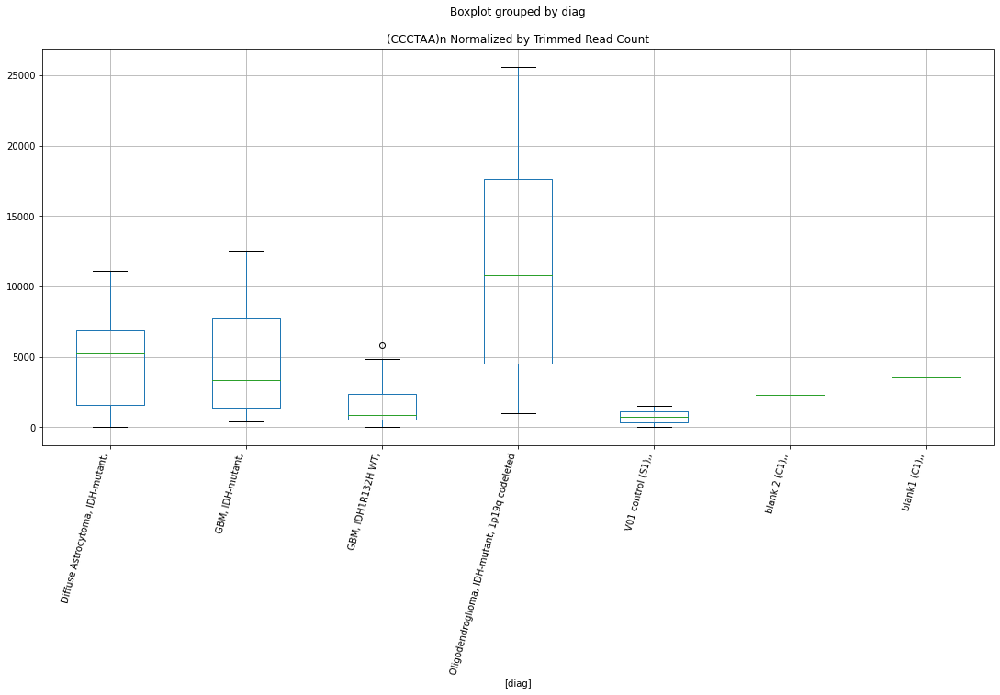

 p : 0.0483172304066737  ( t : 2.1183672205290396 ) :  D-plex  :  bbduk2  :  LTR45B
Control and blanks
73      3865.04
337    16912.99
Name: LTR45B, dtype: float64
205    11103.64
Name: LTR45B, dtype: float64
469    13605.13
Name: LTR45B, dtype: float64


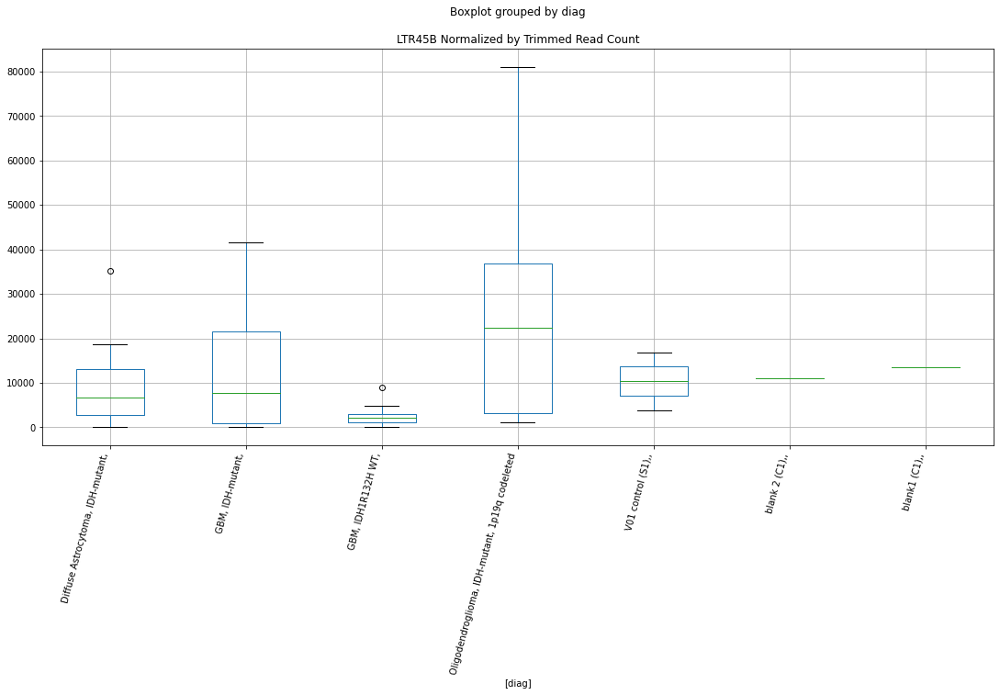

 p : 0.048329811699368376  ( t : 2.118234752478643 ) :  D-plex  :  bbduk2  :  (TCTG)n
Control and blanks
73     0.0
337    0.0
Name: (TCTG)n, dtype: float64
205    1074.55
Name: (TCTG)n, dtype: float64
469    0.0
Name: (TCTG)n, dtype: float64


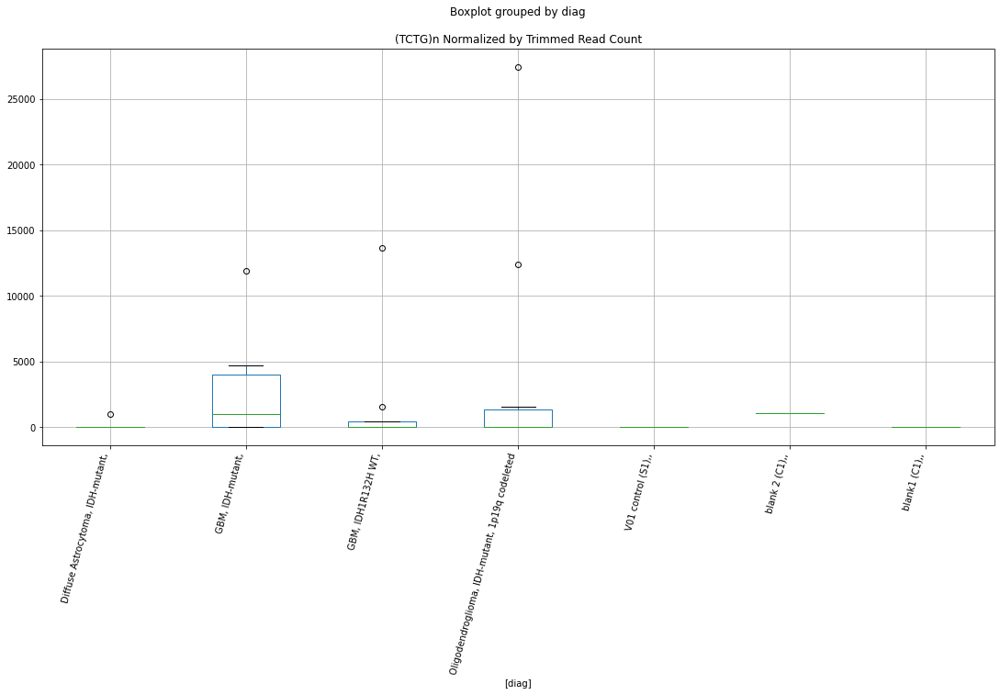

 p : 0.04837362047392803  ( t : 2.1177737361314577 ) :  D-plex  :  cutadapt2  :  (TTAA)n
Control and blanks
76       757.61
340    27302.70
Name: (TTAA)n, dtype: float64
208    3174.48
Name: (TTAA)n, dtype: float64
472    1155.91
Name: (TTAA)n, dtype: float64


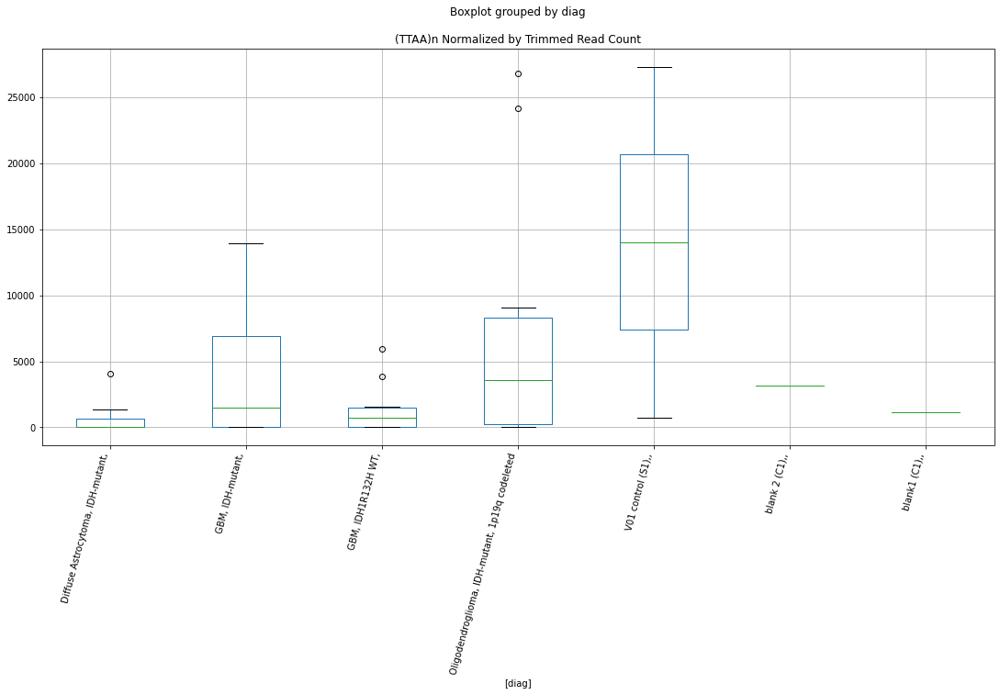

 p : 0.048390141094990805  ( t : 2.1175999820853866 ) :  Lexogen  :  bbduk2  :  L1HS
Control and blanks
79     0.0
343    0.0
Name: L1HS, dtype: float64
211    0.0
Name: L1HS, dtype: float64
475    0.0
Name: L1HS, dtype: float64


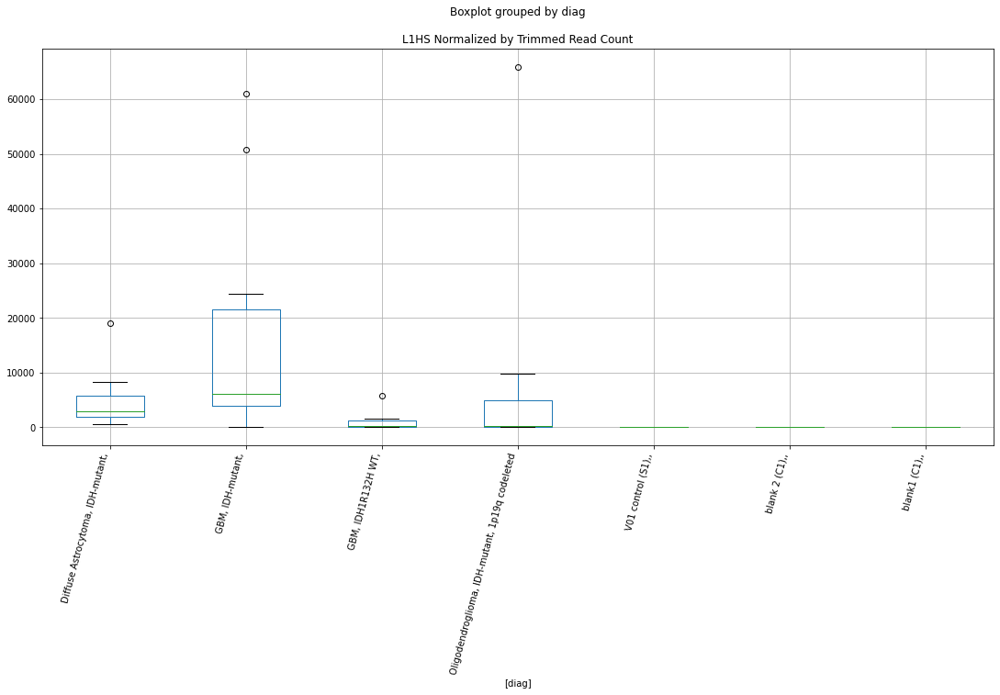

 p : 0.04841132470010149  ( t : 2.1173772645717017 ) :  D-plex  :  cutadapt2  :  LTR41C
Control and blanks
76      1515.23
340    29944.89
Name: LTR41C, dtype: float64
208    12168.86
Name: LTR41C, dtype: float64
472    6935.47
Name: LTR41C, dtype: float64


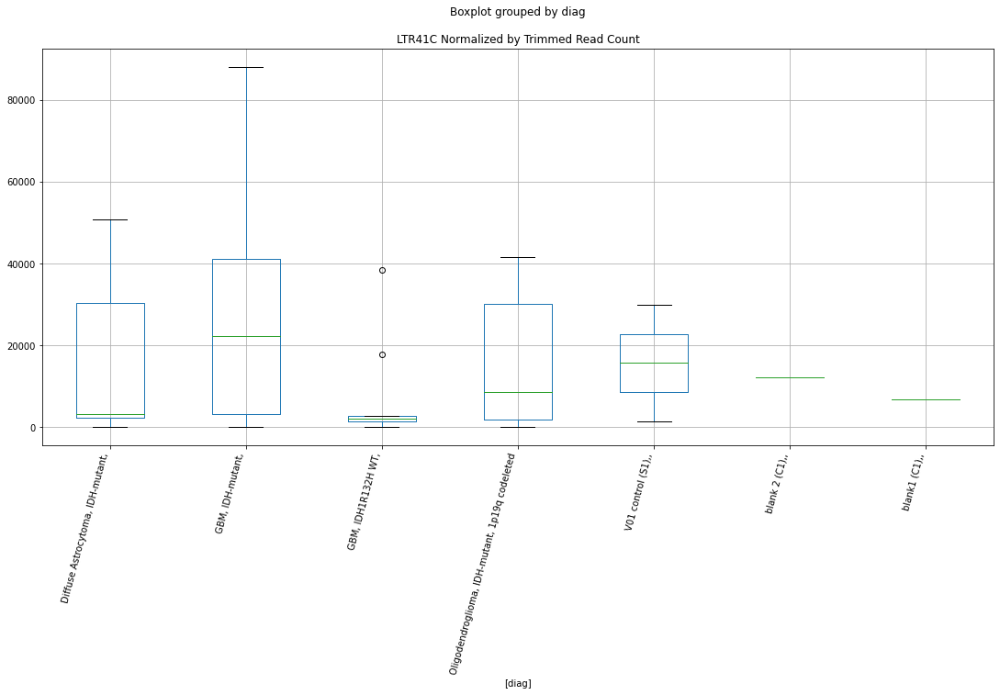

 p : 0.04843961198913312  ( t : 2.11707999956656 ) :  D-plex  :  cutadapt2  :  L2-1_AMi
Control and blanks
76         0.00
340    32587.09
Name: L2-1_AMi, dtype: float64
208    10052.53
Name: L2-1_AMi, dtype: float64
472    9247.29
Name: L2-1_AMi, dtype: float64


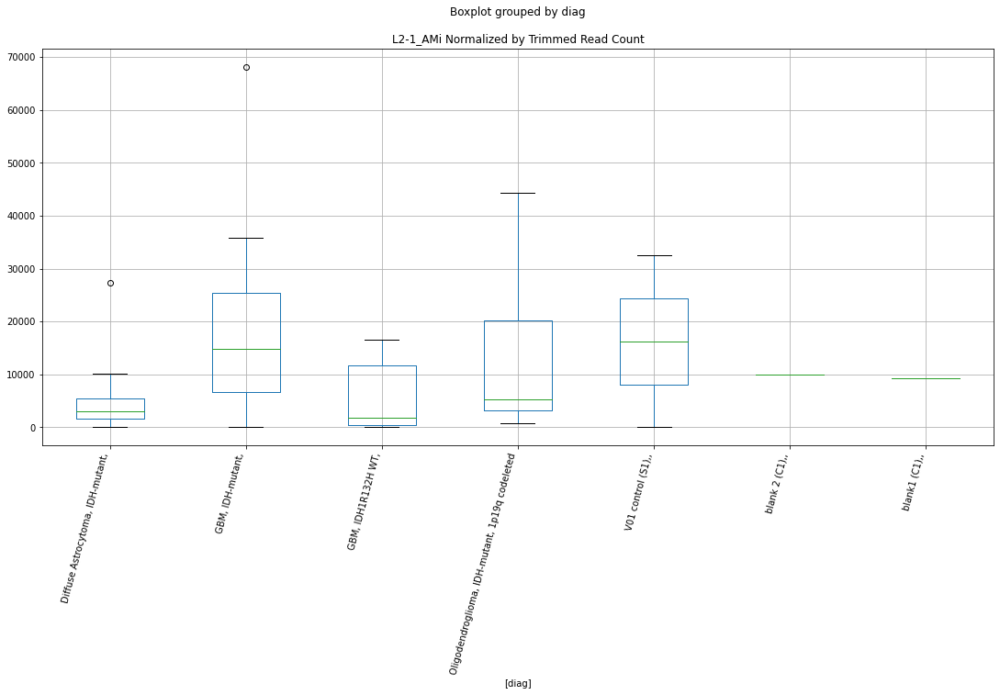

 p : 0.04844044171917575  ( t : 2.1170712824993236 ) :  D-plex  :  cutadapt2  :  Tigger18a
Control and blanks
76     10606.60
340    58128.32
Name: Tigger18a, dtype: float64
208    22045.03
Name: Tigger18a, dtype: float64
472    25430.06
Name: Tigger18a, dtype: float64


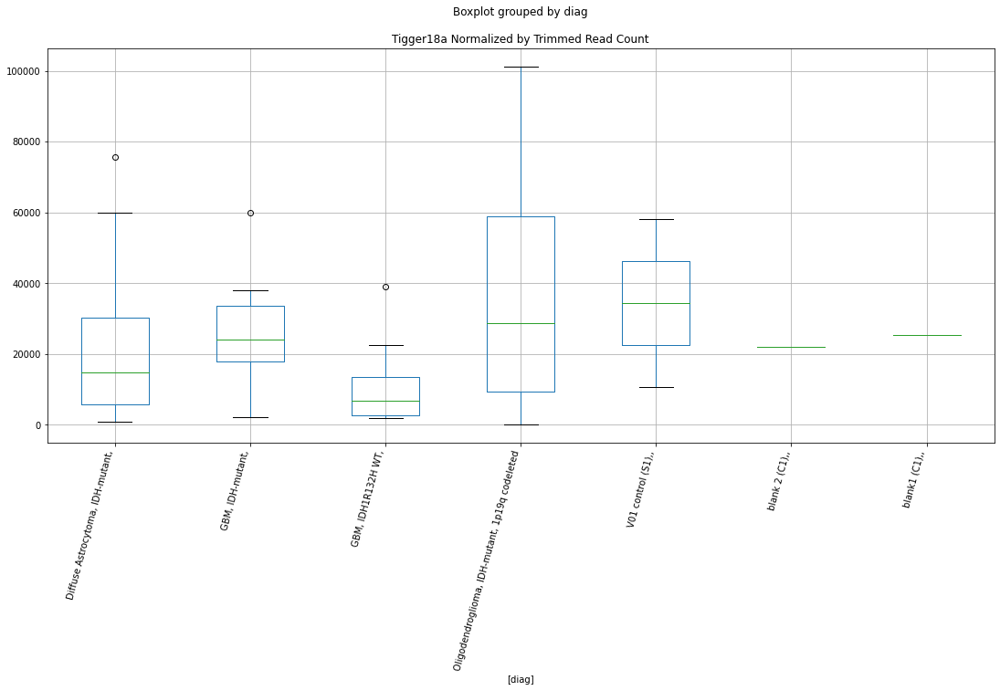

 p : 0.04847728794101812  ( t : 2.1166843164969866 ) :  D-plex  :  cutadapt2  :  L1MCc
Control and blanks
76      23486.04
340    190238.14
Name: L1MCc, dtype: float64
208    112165.1
Name: L1MCc, dtype: float64
472    110967.52
Name: L1MCc, dtype: float64


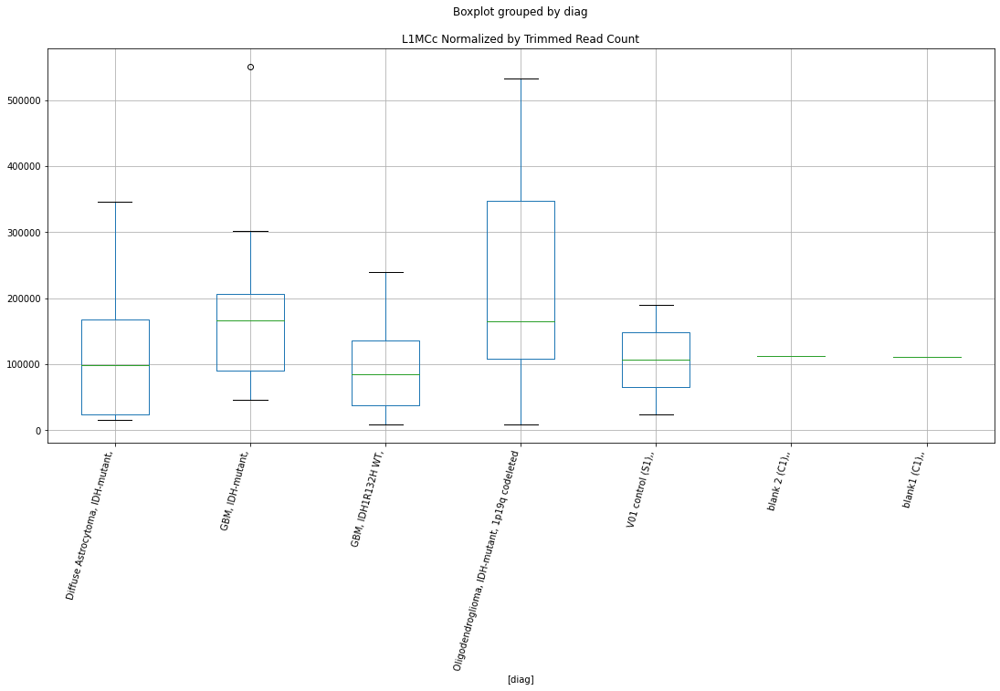

 p : 0.04849644540155968  ( t : 2.116483227019027 ) :  D-plex  :  cutadapt2  :  (TTAT)n
Control and blanks
76       757.61
340    36990.75
Name: (TTAT)n, dtype: float64
208    3527.2
Name: (TTAT)n, dtype: float64
472    6357.51
Name: (TTAT)n, dtype: float64


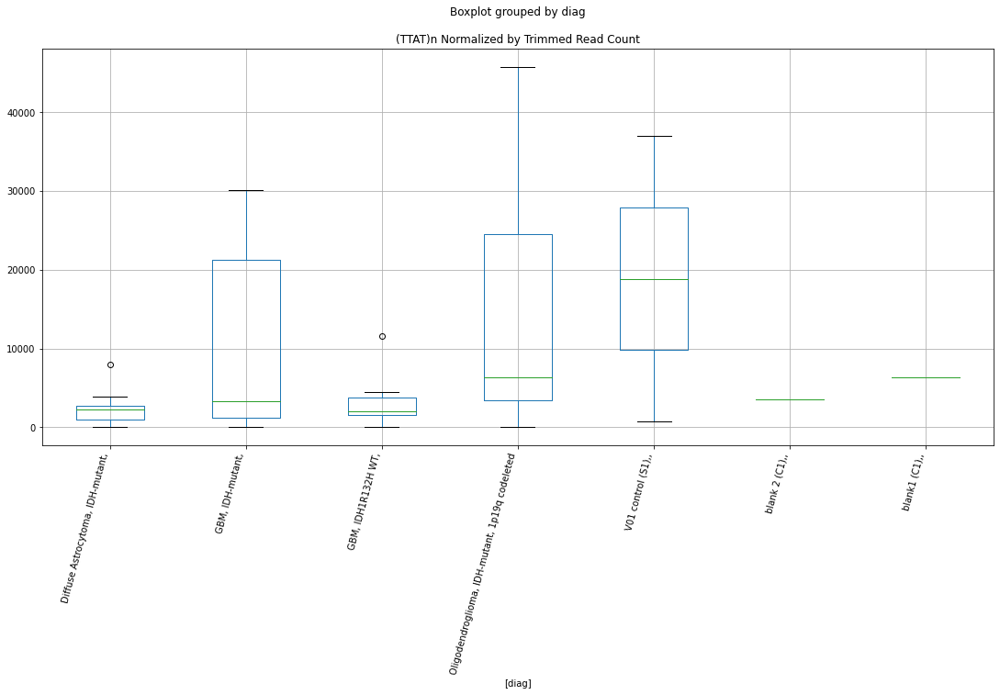

 p : 0.04853465773950839  ( t : 2.1160823407544815 ) :  D-plex  :  bbduk2  :  (TTAA)n
Control and blanks
73       773.01
337    27594.88
Name: (TTAA)n, dtype: float64
205    3223.64
Name: (TTAA)n, dtype: float64
469    1183.05
Name: (TTAA)n, dtype: float64


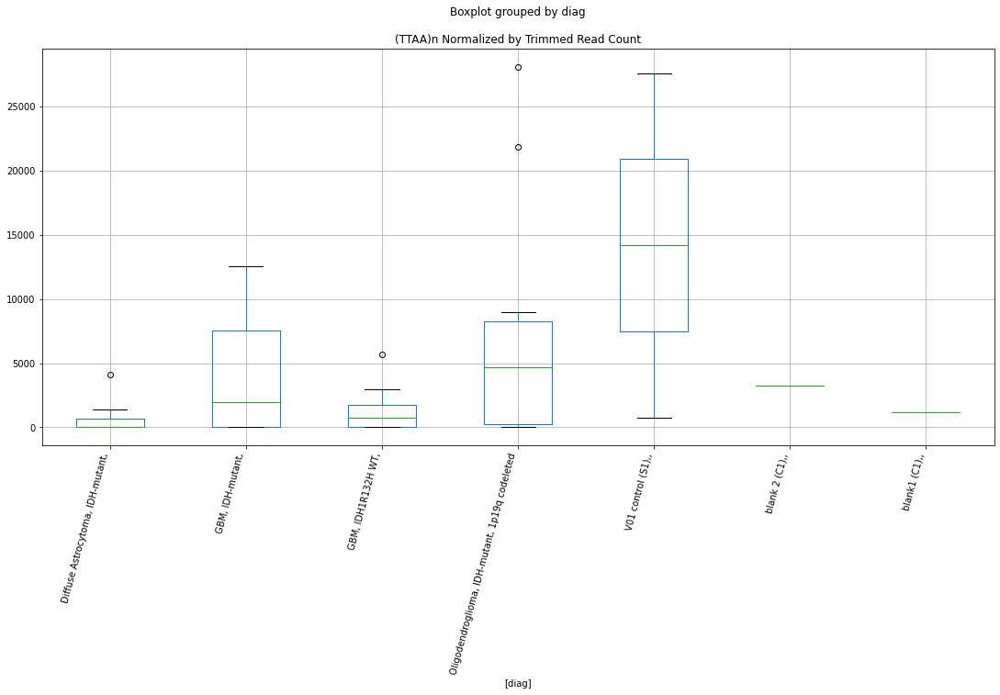

 p : 0.04854123461079178  ( t : 2.1160133716769782 ) :  D-plex  :  cutadapt2  :  MER63C
Control and blanks
76      3030.46
340    63412.71
Name: MER63C, dtype: float64
208    17636.02
Name: MER63C, dtype: float64
472    23696.19
Name: MER63C, dtype: float64


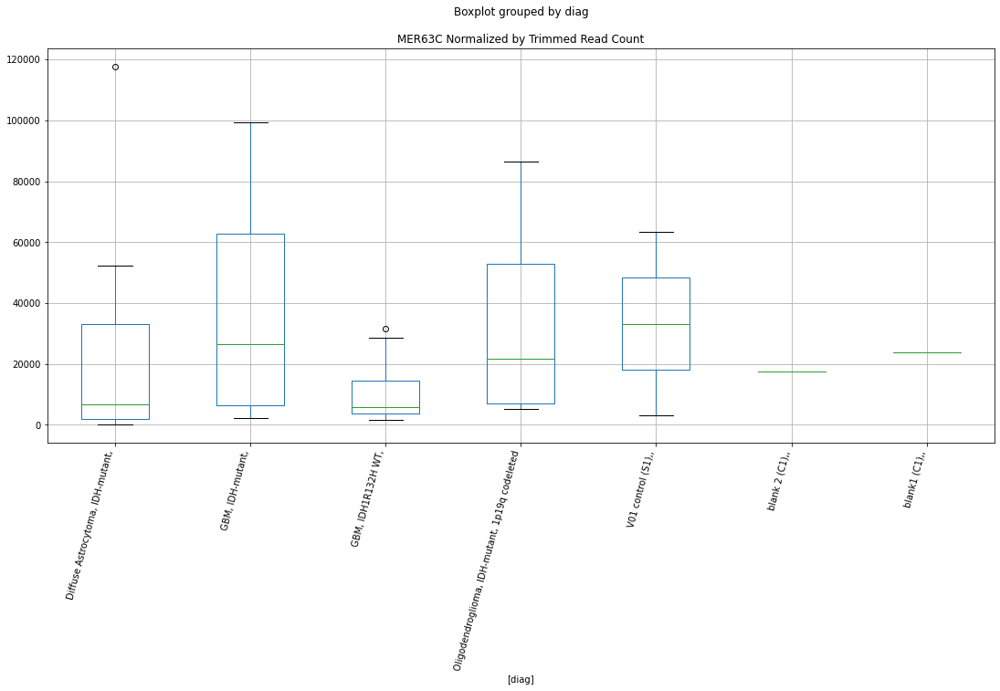

 p : 0.048569867351551346  ( t : 2.1157132104276313 ) :  D-plex  :  bbduk2  :  (ATA)n
Control and blanks
73         0.00
337    14242.52
Name: (ATA)n, dtype: float64
205    4298.18
Name: (ATA)n, dtype: float64
469    4732.22
Name: (ATA)n, dtype: float64


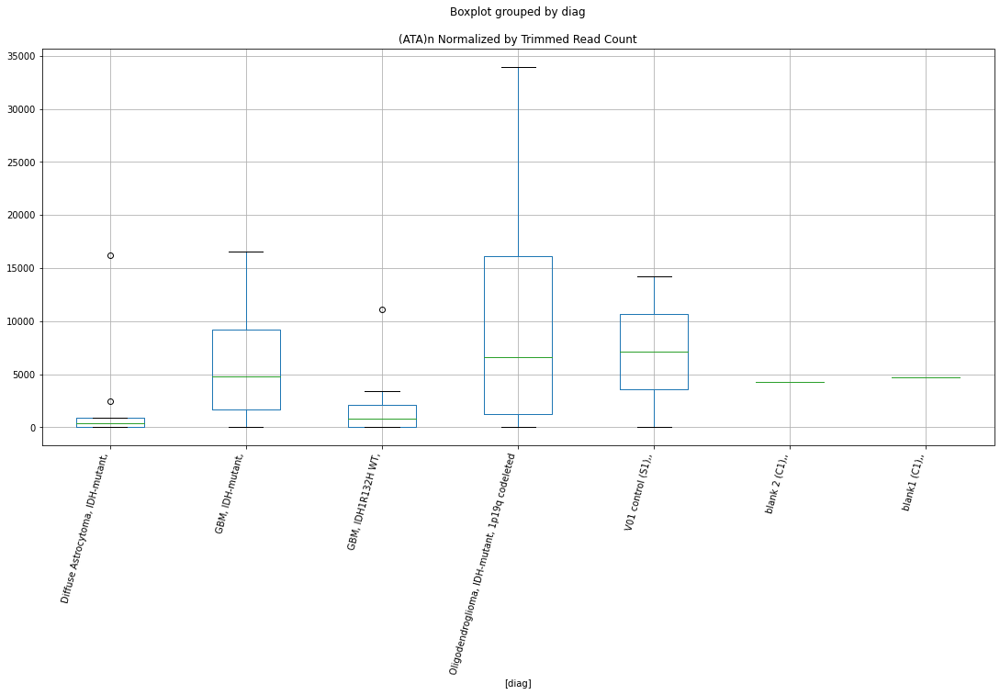

 p : 0.04858257751789079  ( t : 2.115580019501193 ) :  D-plex  :  bbduk2  :  LTR16C
Control and blanks
73      15460.17
337    101477.93
Name: LTR16C, dtype: float64
205    102798.21
Name: LTR16C, dtype: float64
469    97602.01
Name: LTR16C, dtype: float64


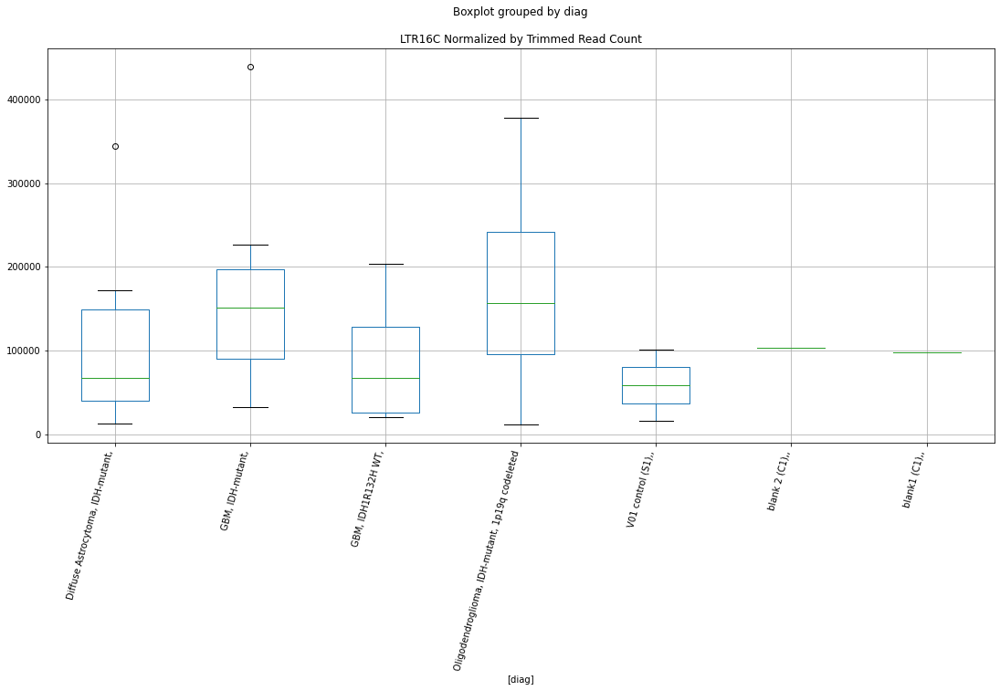

 p : 0.04860358206410567  ( t : 2.115359980567818 ) :  D-plex  :  bbduk2  :  (ATT)n
Control and blanks
73       773.01
337    21363.77
Name: (ATT)n, dtype: float64
205    8059.09
Name: (ATT)n, dtype: float64
469    7689.86
Name: (ATT)n, dtype: float64


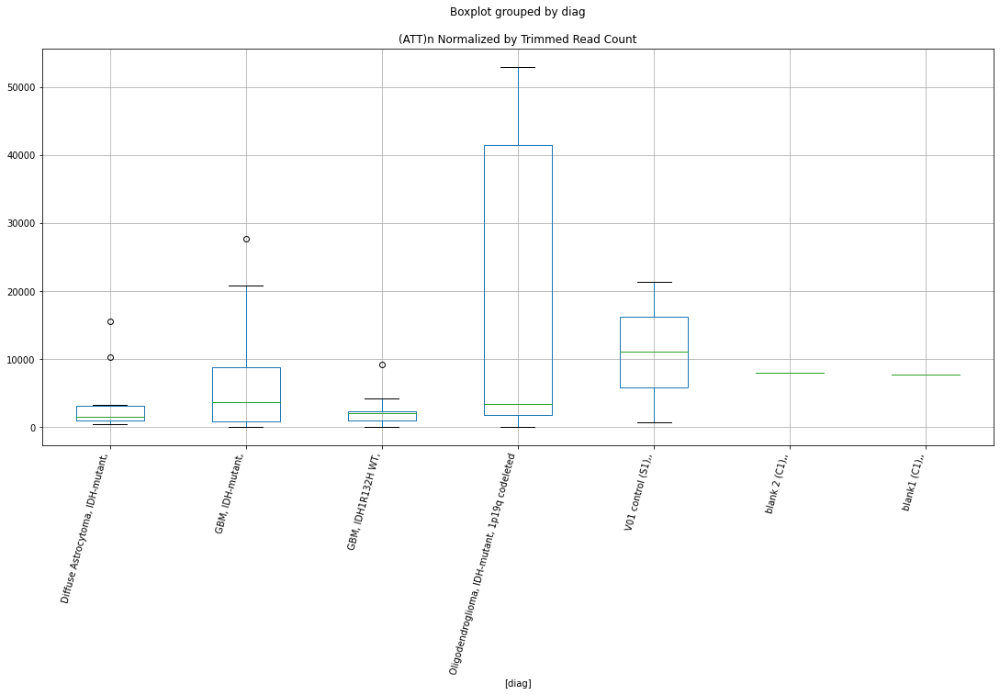

 p : 0.048617635737232816  ( t : 2.1152128057599984 ) :  D-plex  :  bbduk2  :  MER72B
Control and blanks
73     1546.02
337    3560.63
Name: MER72B, dtype: float64
205    3223.64
Name: MER72B, dtype: float64
469    2957.64
Name: MER72B, dtype: float64


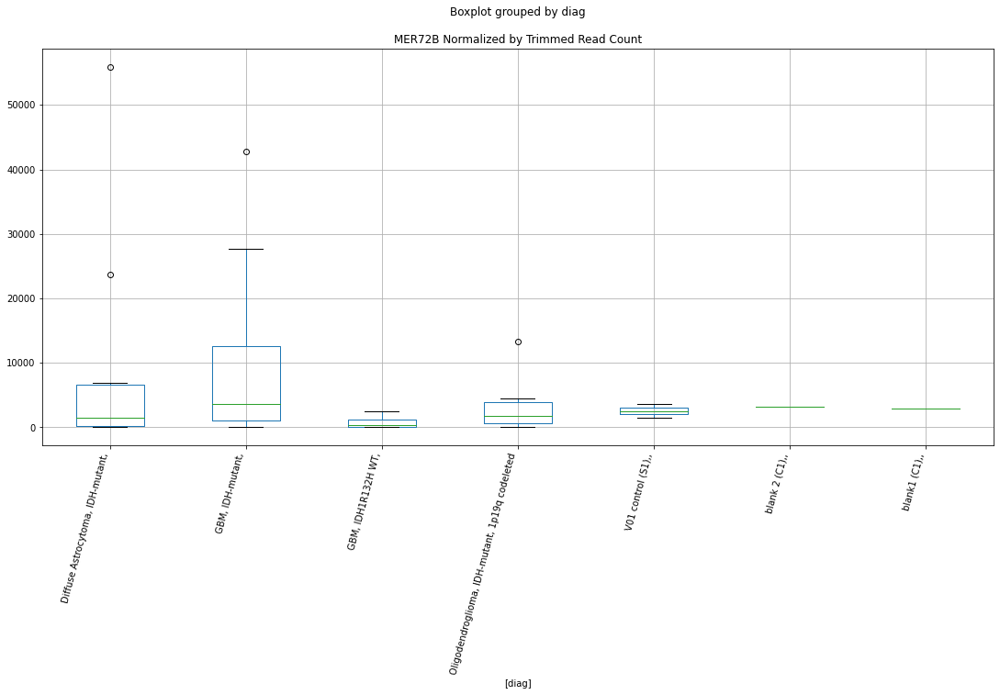

 p : 0.04868447793306934  ( t : 2.11451334143485 ) :  D-plex  :  cutadapt2  :  HERVK14-int
Control and blanks
76      3788.07
340    29064.16
Name: HERVK14-int, dtype: float64
208    16048.78
Name: HERVK14-int, dtype: float64
472    13292.98
Name: HERVK14-int, dtype: float64


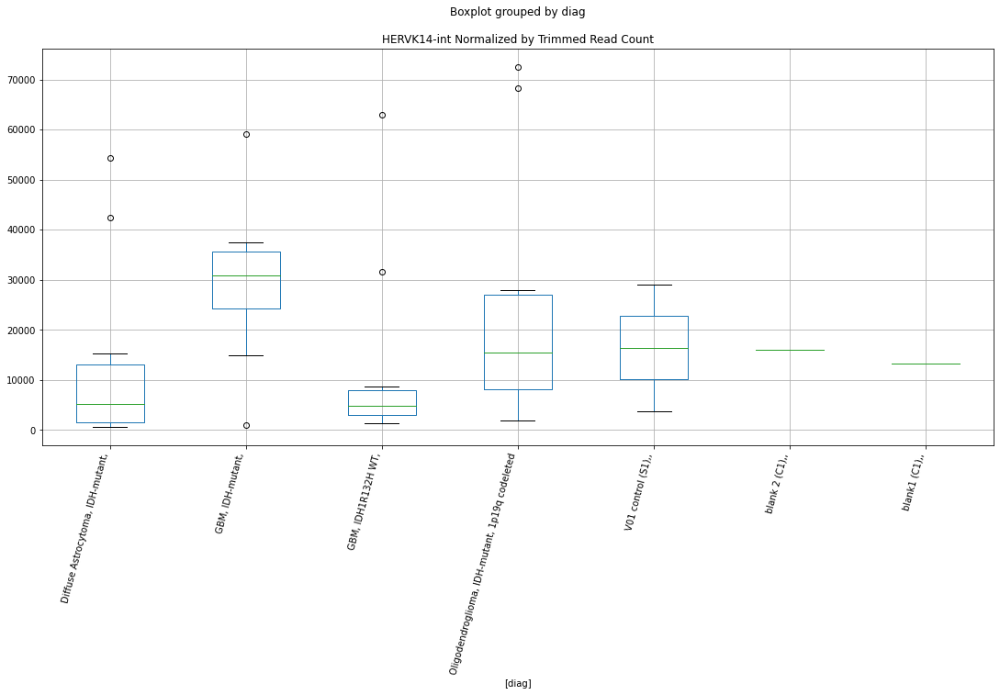

 p : 0.0486901256005192  ( t : 2.1144542819706085 ) :  D-plex  :  bbduk2  :  MIR1_Amn
Control and blanks
73     13141.14
337    30265.35
Name: MIR1_Amn, dtype: float64
205    73964.56
Name: MIR1_Amn, dtype: float64
469    72166.33
Name: MIR1_Amn, dtype: float64


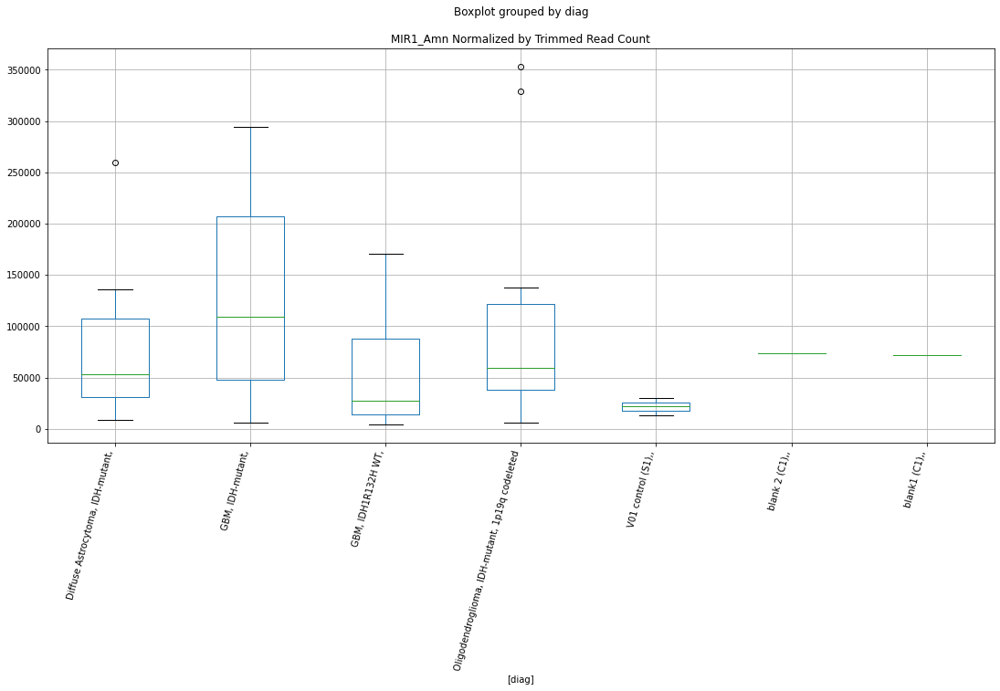

 p : 0.04876859382813406  ( t : 2.1136343591552826 ) :  D-plex  :  cutadapt2  :  (TTAT)n
Control and blanks
76       757.61
340    36990.75
Name: (TTAT)n, dtype: float64
208    3527.2
Name: (TTAT)n, dtype: float64
472    6357.51
Name: (TTAT)n, dtype: float64


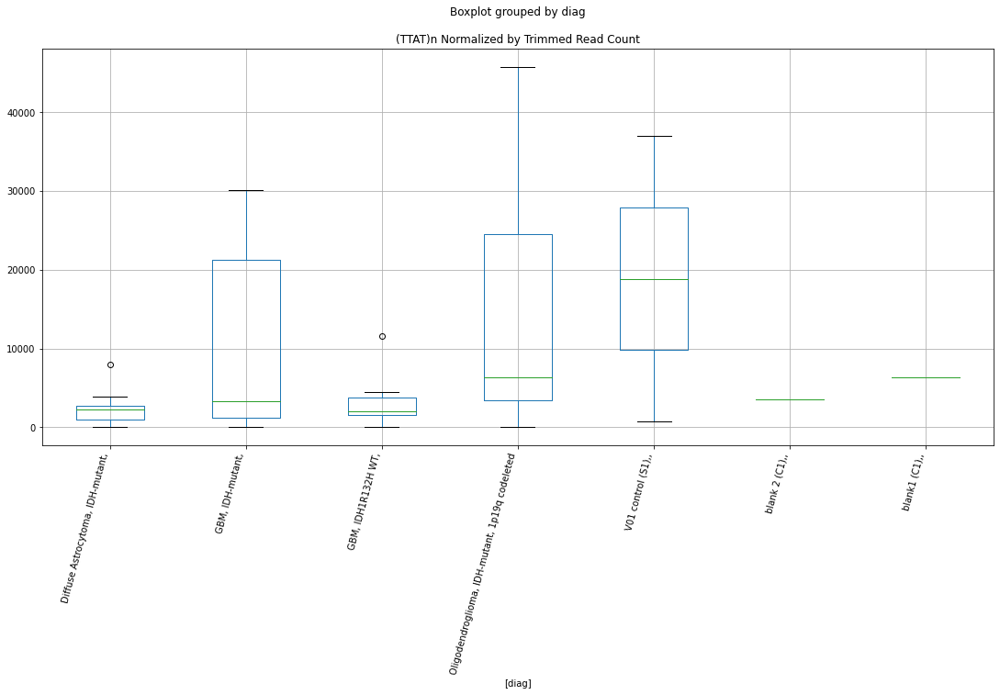

 p : 0.04883747030257139  ( t : 2.1129156505546396 ) :  D-plex  :  bbduk2  :  Kanga1
Control and blanks
73      1546.02
337    31155.50
Name: Kanga1, dtype: float64
205    13610.91
Name: Kanga1, dtype: float64
469    9464.44
Name: Kanga1, dtype: float64


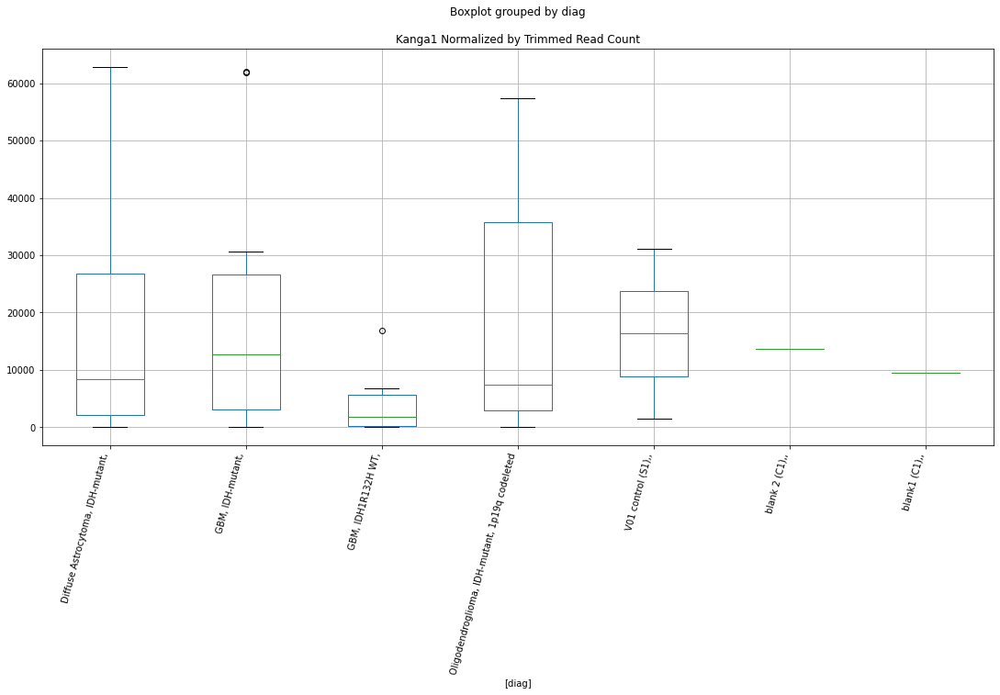

 p : 0.048860971318822666  ( t : 2.112670634464215 ) :  D-plex  :  cutadapt2  :  HERVE-int
Control and blanks
76      3030.46
340    35229.29
Name: HERVE-int, dtype: float64
208    15872.42
Name: HERVE-int, dtype: float64
472    28319.84
Name: HERVE-int, dtype: float64


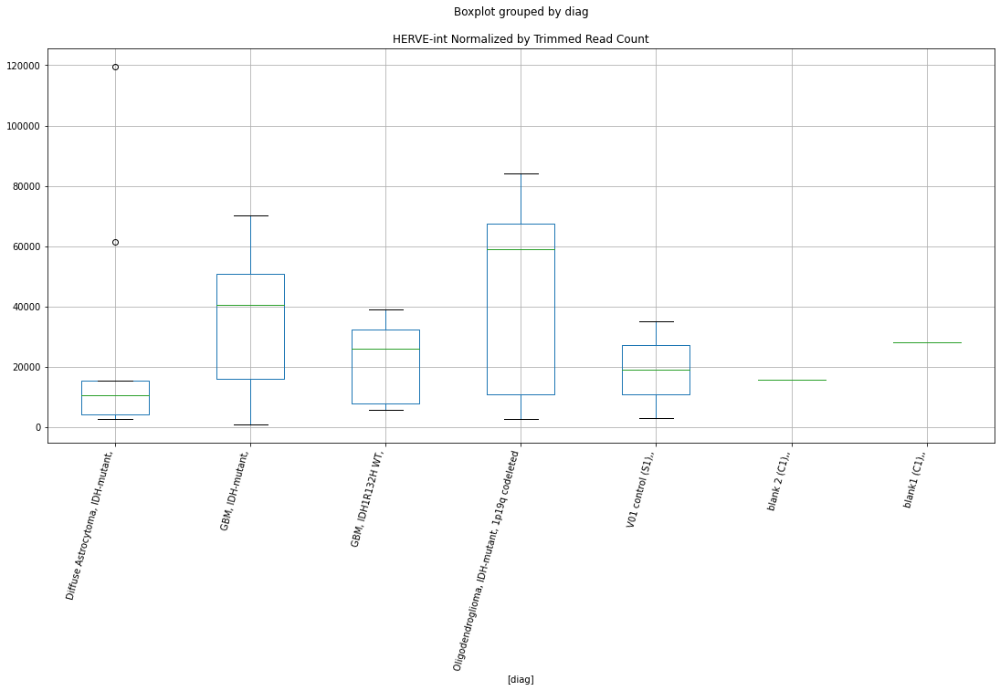

 p : 0.04886128982089244  ( t : 2.112667314572936 ) :  D-plex  :  bbduk2  :  AmnSINE2
Control and blanks
73     2319.03
337       0.00
Name: AmnSINE2, dtype: float64
205    4119.09
Name: AmnSINE2, dtype: float64
469    2957.64
Name: AmnSINE2, dtype: float64


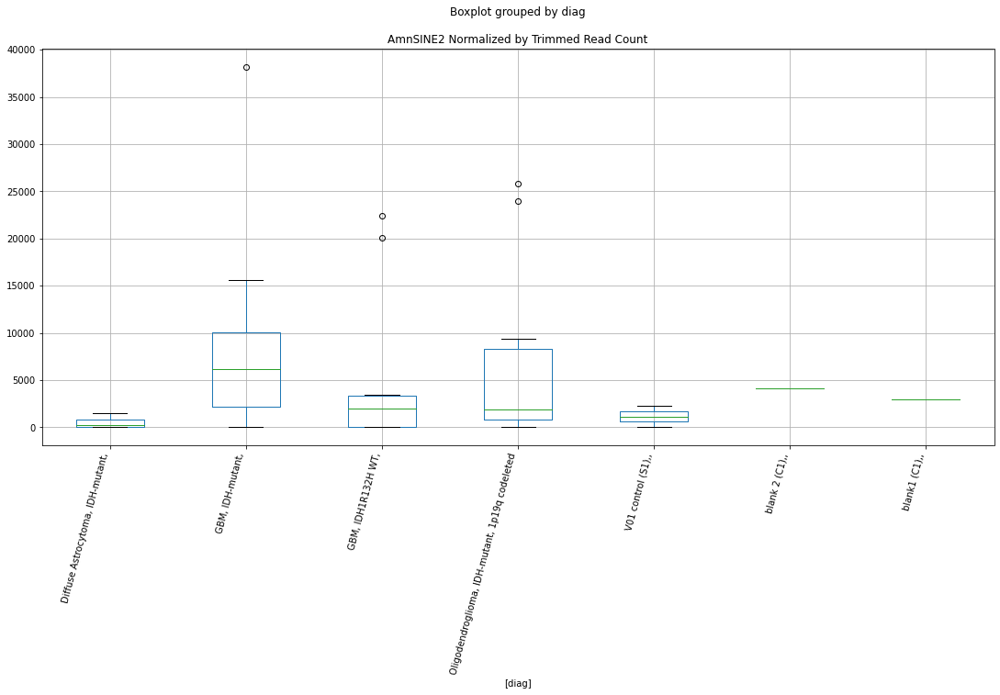

 p : 0.04899178399455558  ( t : 2.111308768903933 ) :  Lexogen  :  bbduk2  :  tRNA-Val-GTY
Control and blanks
79     0.0
343    0.0
Name: tRNA-Val-GTY, dtype: float64
211    0.0
Name: tRNA-Val-GTY, dtype: float64
475    0.0
Name: tRNA-Val-GTY, dtype: float64


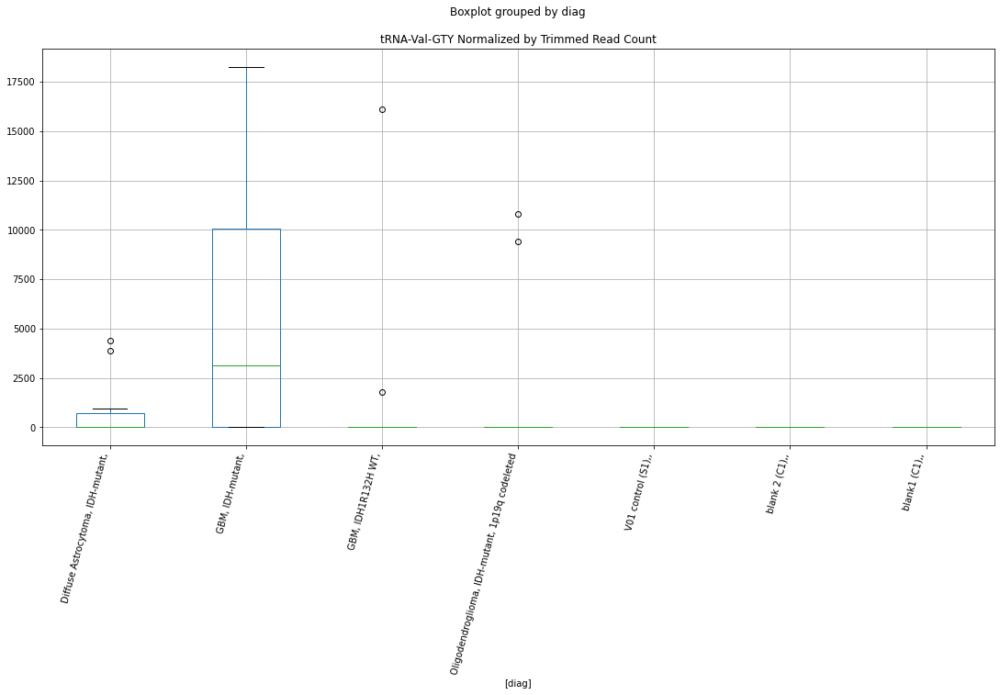

 p : 0.04899576637069156  ( t : 2.1112673610784904 ) :  D-plex  :  cutadapt2  :  (GTTT)n
Control and blanks
76     1515.23
340    1761.46
Name: (GTTT)n, dtype: float64
208    1939.96
Name: (GTTT)n, dtype: float64
472    3467.74
Name: (GTTT)n, dtype: float64


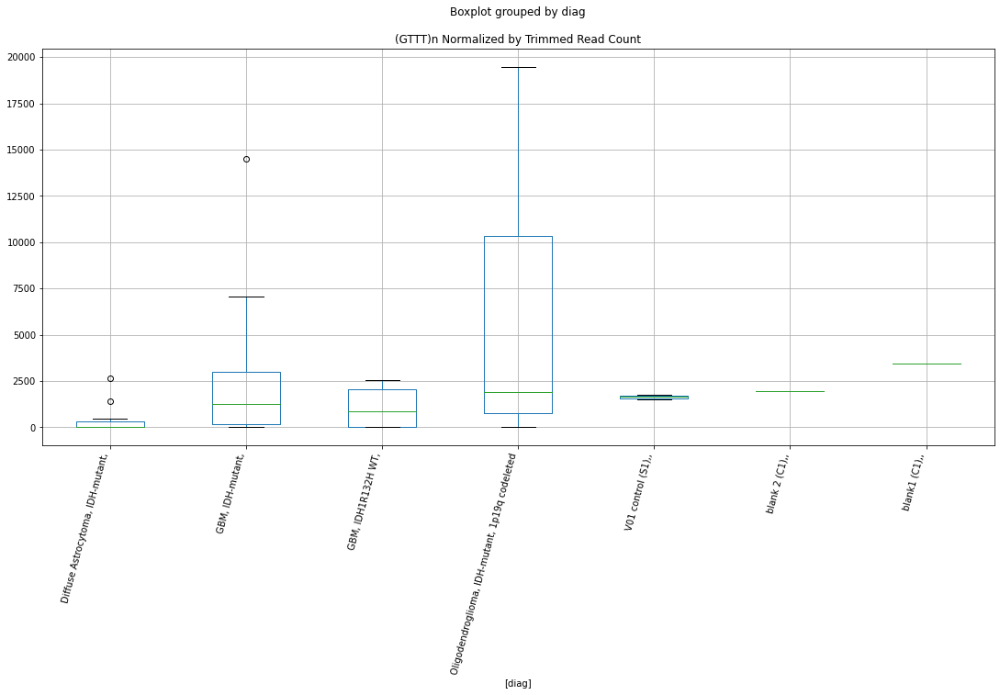

 p : 0.04902825329484994  ( t : 2.1109296839064506 ) :  D-plex  :  bbduk2  :  (CCTCTC)n
Control and blanks
73     23963.26
337     4450.79
Name: (CCTCTC)n, dtype: float64
205    2507.27
Name: (CCTCTC)n, dtype: float64
469    5323.75
Name: (CCTCTC)n, dtype: float64


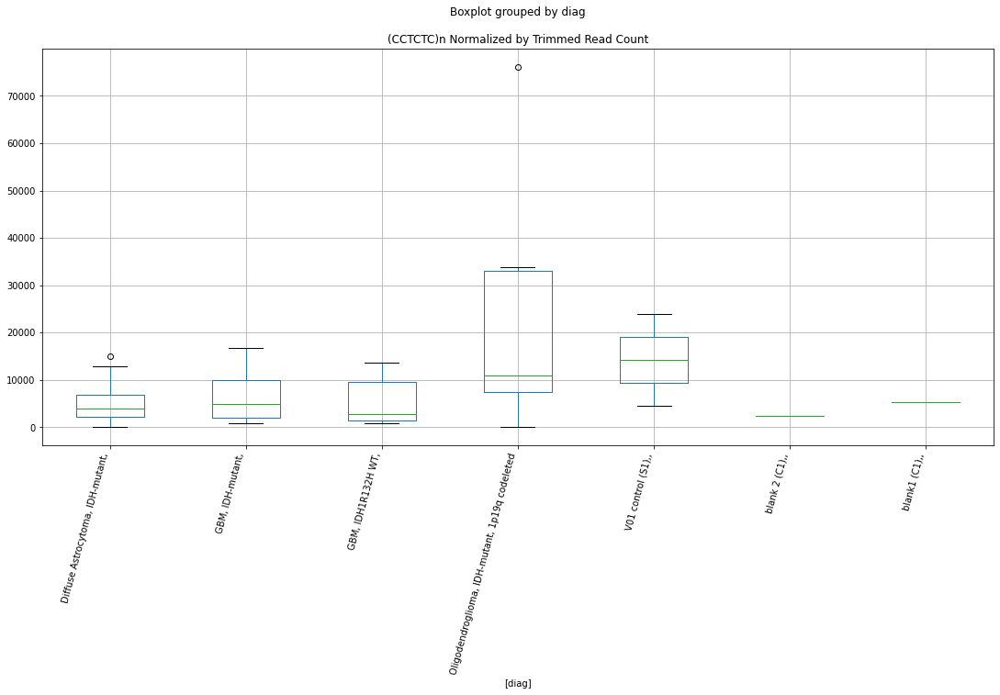

 p : 0.04913603282464438  ( t : 2.109810852931744 ) :  D-plex  :  bbduk2  :  LTR88b
Control and blanks
73     2319.03
337    1780.31
Name: LTR88b, dtype: float64
205    17909.1
Name: LTR88b, dtype: float64
469    10647.49
Name: LTR88b, dtype: float64


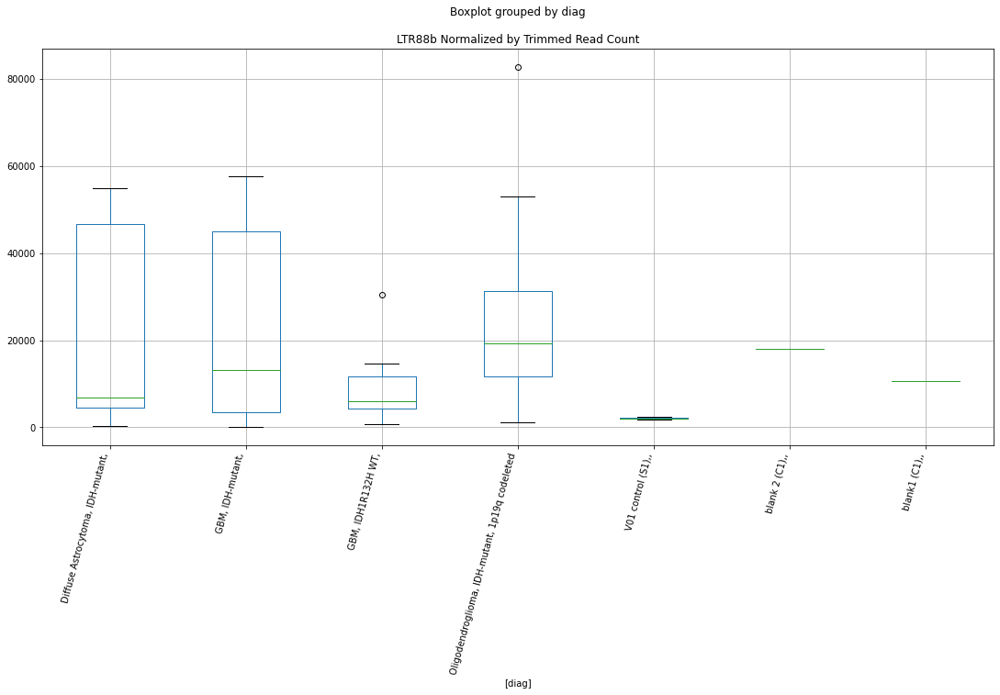

 p : 0.049139159881518596  ( t : 2.1097784251198393 ) :  D-plex  :  bbduk2  :  (CCAGATC)n
Control and blanks
73     0.0
337    0.0
Name: (CCAGATC)n, dtype: float64
205    179.09
Name: (CCAGATC)n, dtype: float64
469    0.0
Name: (CCAGATC)n, dtype: float64


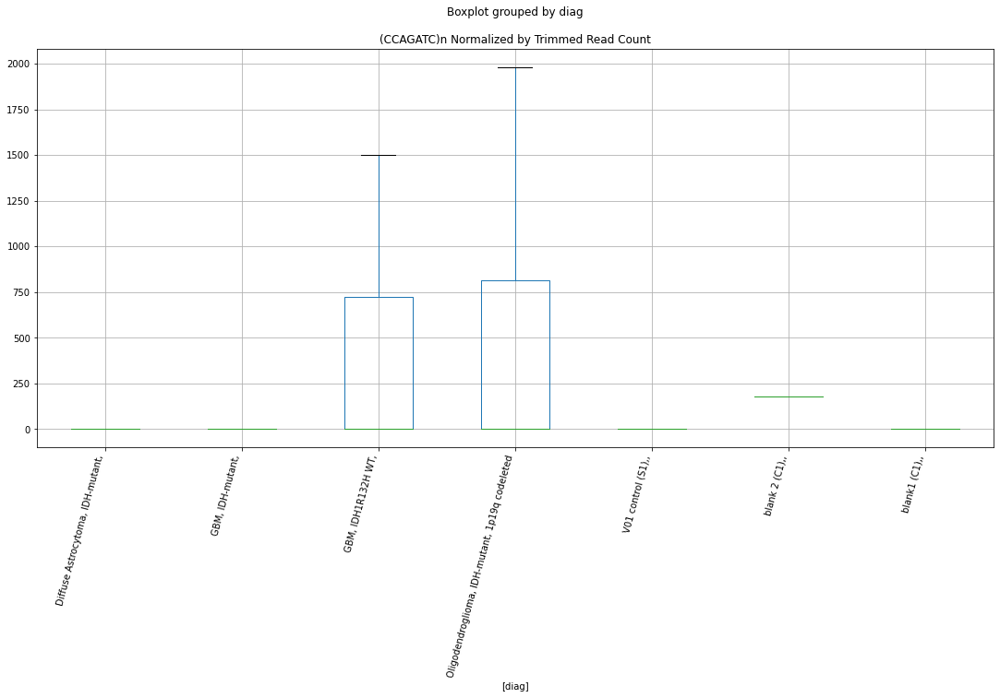

 p : 0.04918257511169508  ( t : 2.1093283998329944 ) :  D-plex  :  bbduk2  :  (TTCGA)n
Control and blanks
73      71889.78
337    179811.77
Name: (TTCGA)n, dtype: float64
205    101365.48
Name: (TTCGA)n, dtype: float64
469    94052.84
Name: (TTCGA)n, dtype: float64


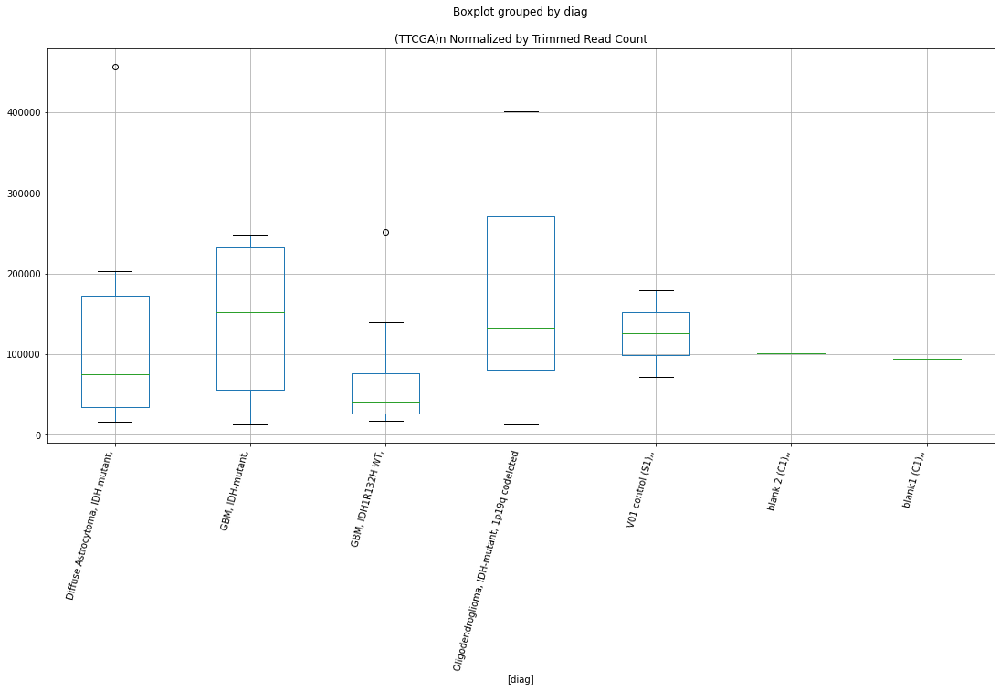

 p : 0.04921430701879521  ( t : 2.1089997078520377 ) :  D-plex  :  bbduk2  :  (TCTGG)n
Control and blanks
73     0.0
337    0.0
Name: (TCTGG)n, dtype: float64
205    179.09
Name: (TCTGG)n, dtype: float64
469    591.53
Name: (TCTGG)n, dtype: float64


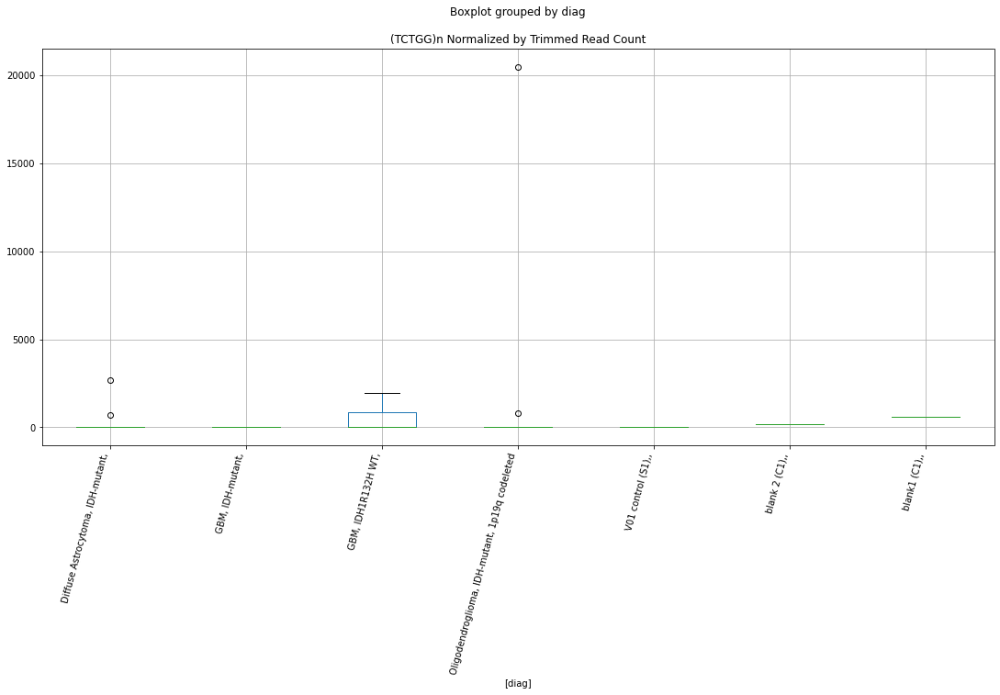

 p : 0.049244644914922045  ( t : 2.108685635834027 ) :  D-plex  :  cutadapt2  :  LTR85c
Control and blanks
76     3030.46
340    5284.39
Name: LTR85c, dtype: float64
208    19046.9
Name: LTR85c, dtype: float64
472    16182.76
Name: LTR85c, dtype: float64


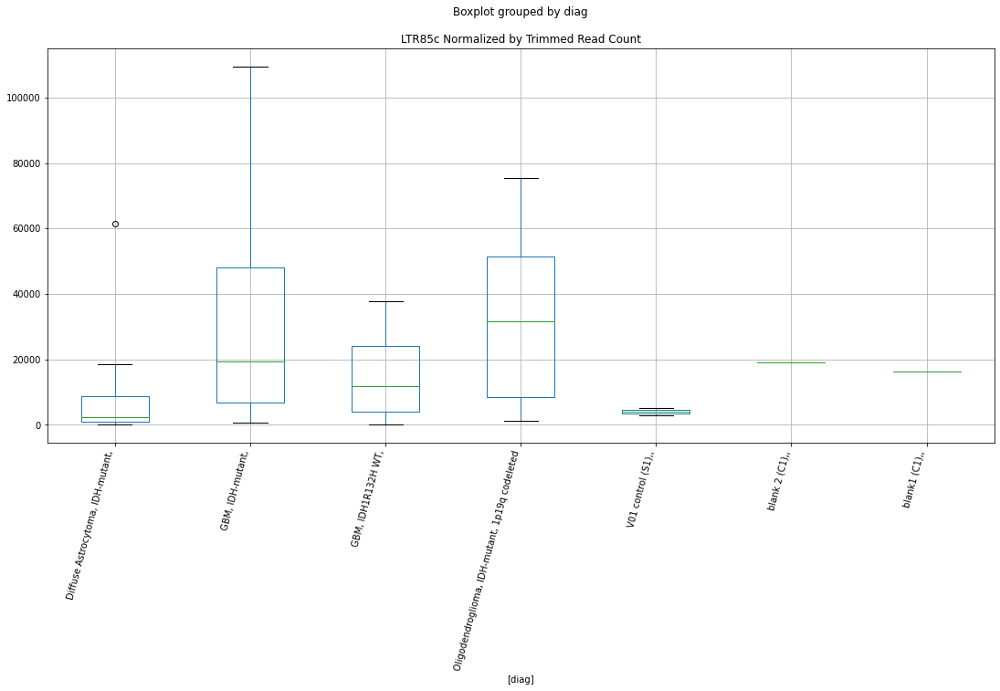

 p : 0.049278191206065615  ( t : 2.108338553874111 ) :  D-plex  :  cutadapt2  :  Charlie18a
Control and blanks
76      6818.53
340    26421.96
Name: Charlie18a, dtype: float64
208    25572.23
Name: Charlie18a, dtype: float64
472    24852.1
Name: Charlie18a, dtype: float64


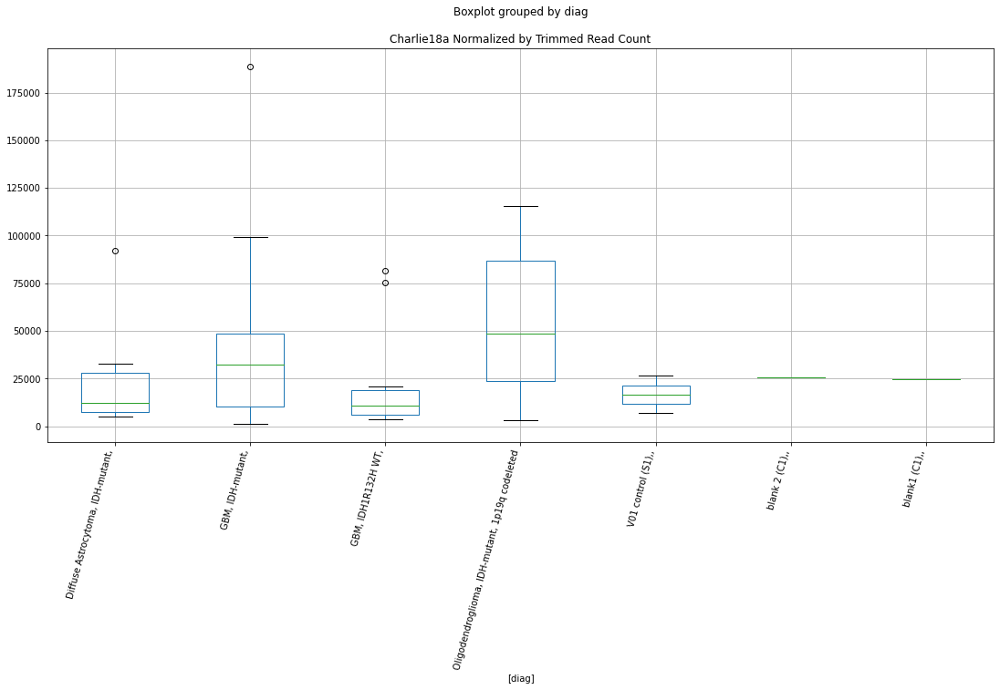

 p : 0.04931042605917148  ( t : 2.108005242956469 ) :  D-plex  :  cutadapt2  :  (CCAGATC)n
Control and blanks
76     0.0
340    0.0
Name: (CCAGATC)n, dtype: float64
208    176.36
Name: (CCAGATC)n, dtype: float64
472    0.0
Name: (CCAGATC)n, dtype: float64


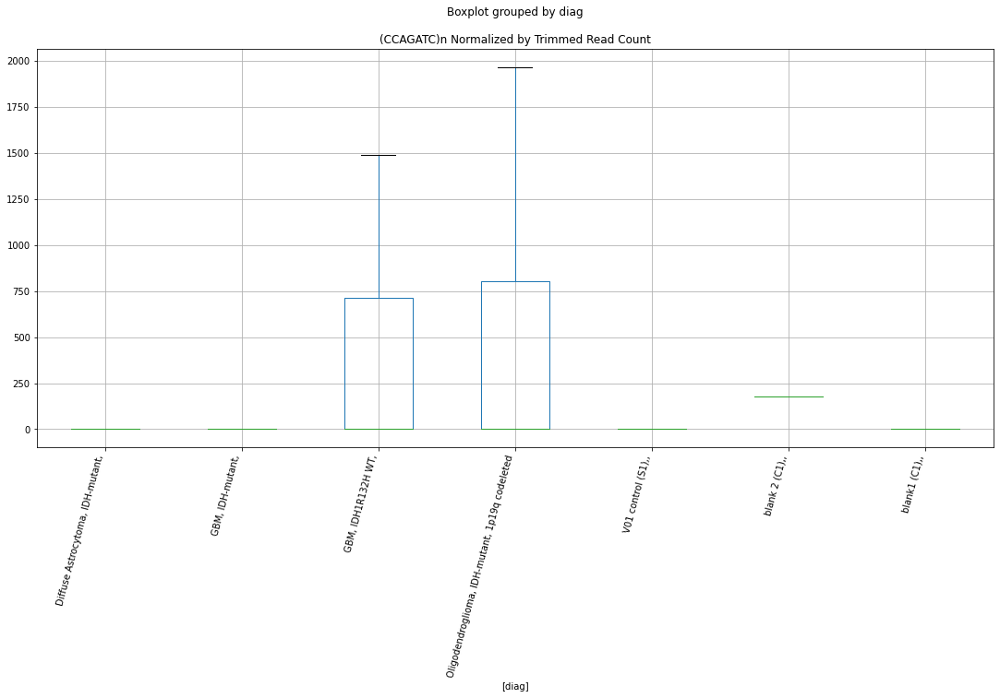

 p : 0.0493363046406517  ( t : 2.1077377997859803 ) :  D-plex  :  bbduk2  :  (CTCCTC)n
Control and blanks
73     2319.03
337       0.00
Name: (CTCCTC)n, dtype: float64
205    3402.73
Name: (CTCCTC)n, dtype: float64
469    3549.16
Name: (CTCCTC)n, dtype: float64


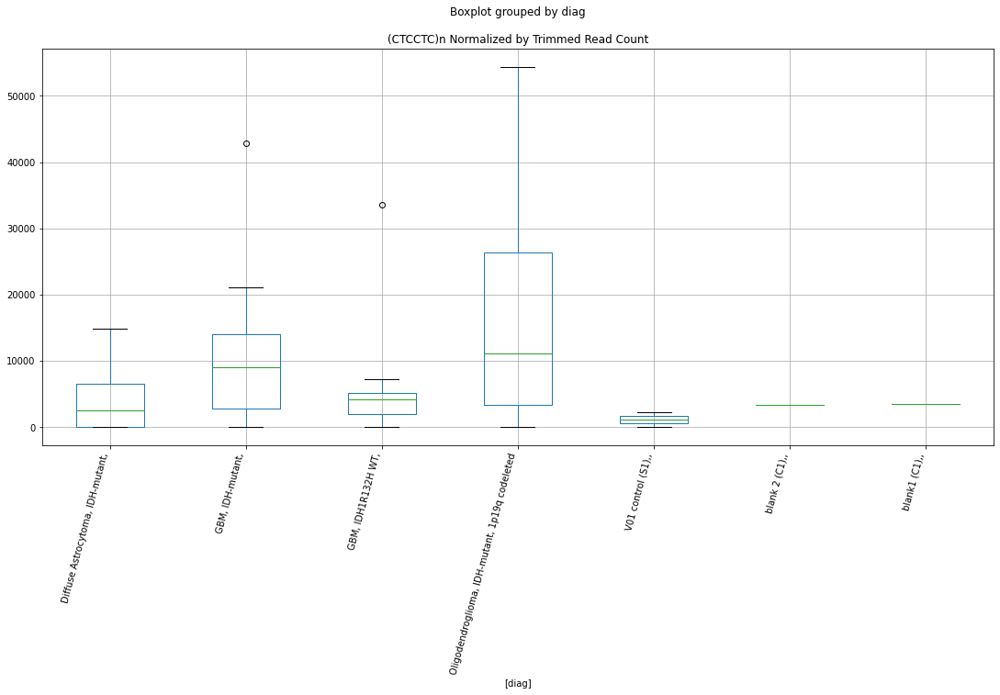

 p : 0.049402331731185294  ( t : 2.1070560180082287 ) :  D-plex  :  cutadapt2  :  LTR12_
Control and blanks
76      3030.46
340    11449.52
Name: LTR12_, dtype: float64
208    13050.66
Name: LTR12_, dtype: float64
472    8669.34
Name: LTR12_, dtype: float64


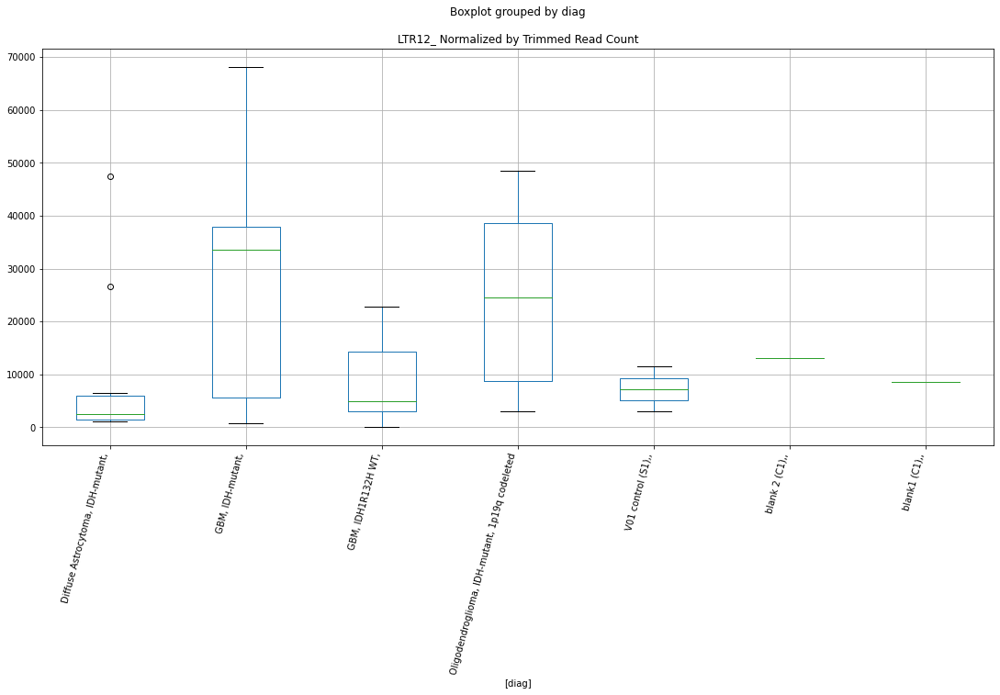

 p : 0.049411783955961394  ( t : 2.1069584841584303 ) :  D-plex  :  cutadapt2  :  (CCCTAA)n
Control and blanks
76     3788.07
340       0.00
Name: (CCCTAA)n, dtype: float64
208    2821.76
Name: (CCCTAA)n, dtype: float64
472    2889.78
Name: (CCCTAA)n, dtype: float64


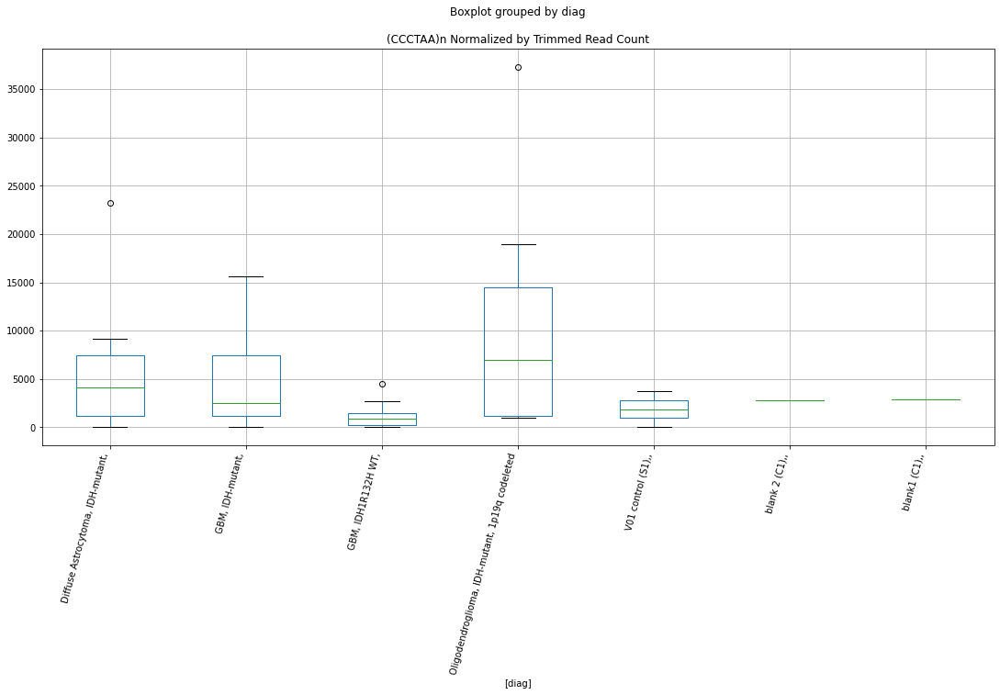

 p : 0.04958654884784155  ( t : 2.105158203371218 ) :  D-plex  :  cutadapt2  :  MLT1J2-int
Control and blanks
76         0.00
340    21137.57
Name: MLT1J2-int, dtype: float64
208    12168.86
Name: MLT1J2-int, dtype: float64
472    18494.59
Name: MLT1J2-int, dtype: float64


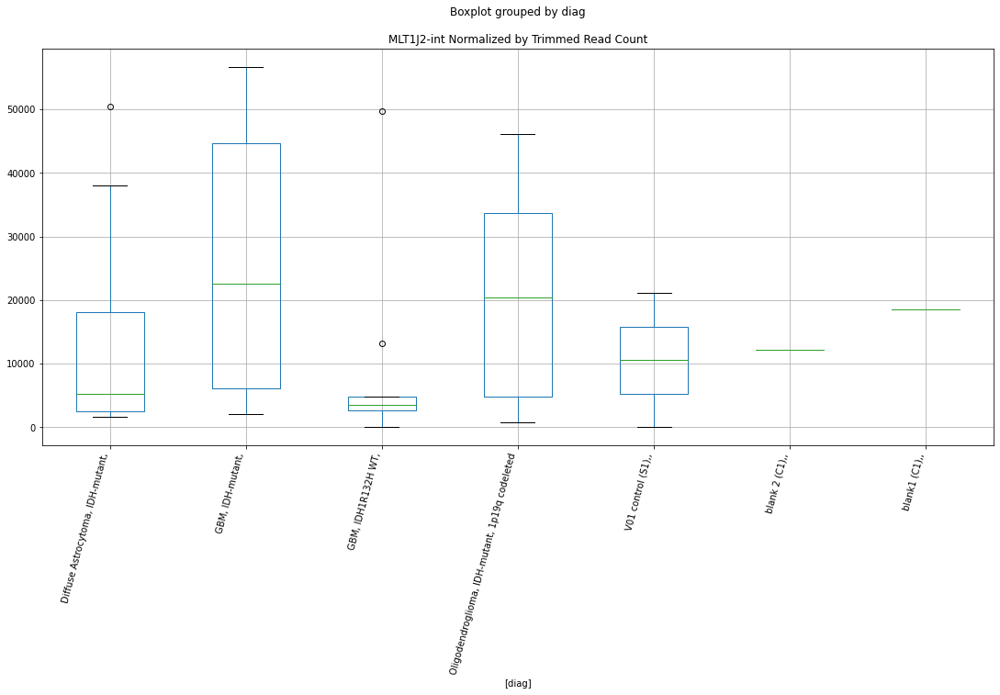

 p : 0.0496286691199234  ( t : 2.10472517878232 ) :  D-plex  :  cutadapt2  :  (TATC)n
Control and blanks
76     15909.90
340    55486.12
Name: (TATC)n, dtype: float64
208    28570.36
Name: (TATC)n, dtype: float64
472    25430.06
Name: (TATC)n, dtype: float64


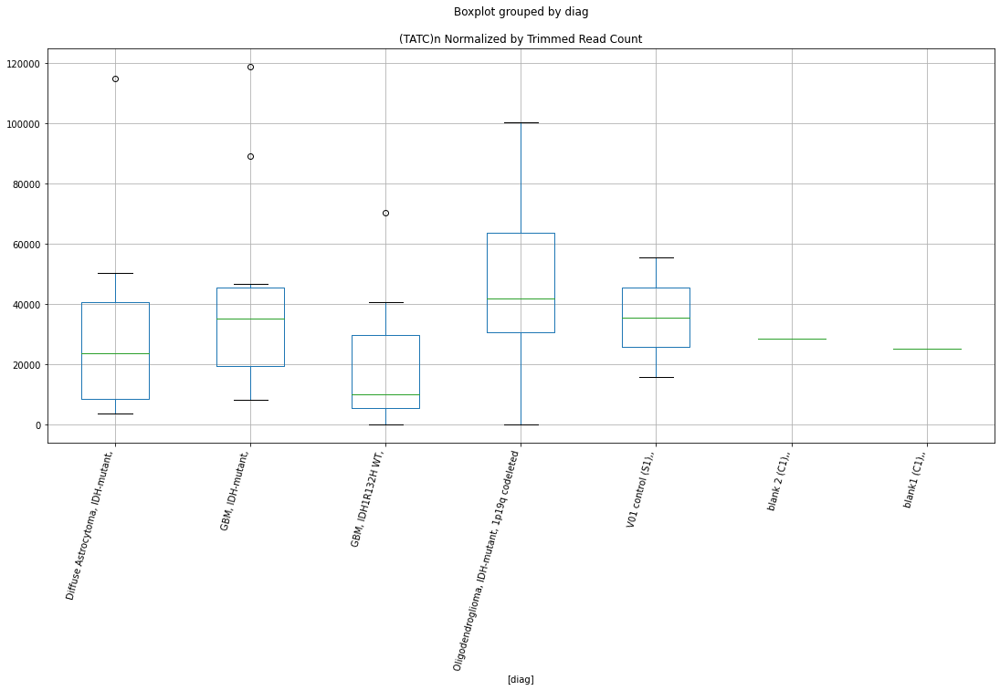

 p : 0.04963638932178946  ( t : 2.1046458461815027 ) :  D-plex  :  bbduk2  :  Tigger11a
Control and blanks
73     1546.02
337     890.16
Name: Tigger11a, dtype: float64
205    4835.46
Name: Tigger11a, dtype: float64
469    5915.27
Name: Tigger11a, dtype: float64


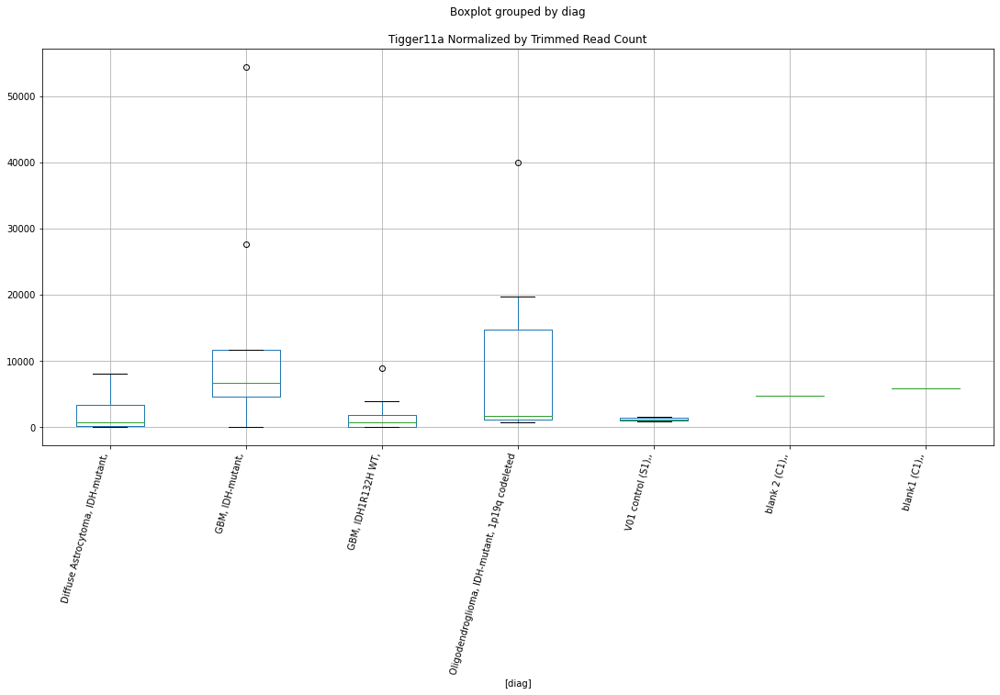

 p : 0.04970111946886365  ( t : 2.103981121862776 ) :  D-plex  :  bbduk2  :  (GAATG)n
Control and blanks
73     112859.23
337     95246.83
Name: (GAATG)n, dtype: float64
205    191627.32
Name: (GAATG)n, dtype: float64
469    170359.87
Name: (GAATG)n, dtype: float64


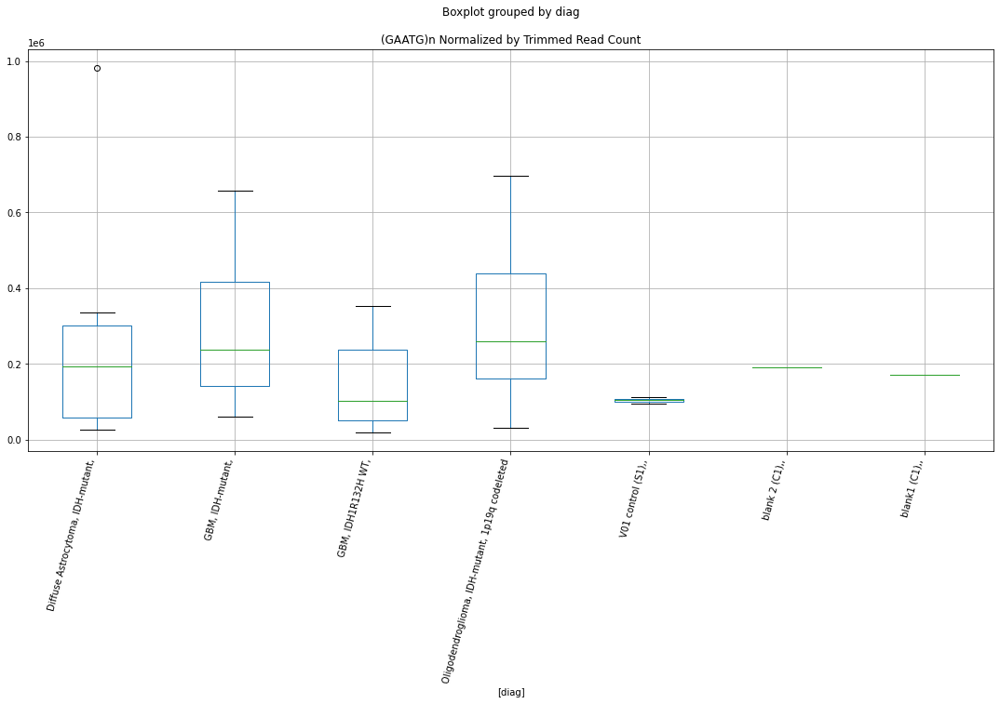

 p : 0.04975120829887504  ( t : 2.1034672915895887 ) :  D-plex  :  bbduk2  :  (ATAGAT)n
Control and blanks
73     773.01
337      0.00
Name: (ATAGAT)n, dtype: float64
205    1432.73
Name: (ATAGAT)n, dtype: float64
469    1774.58
Name: (ATAGAT)n, dtype: float64


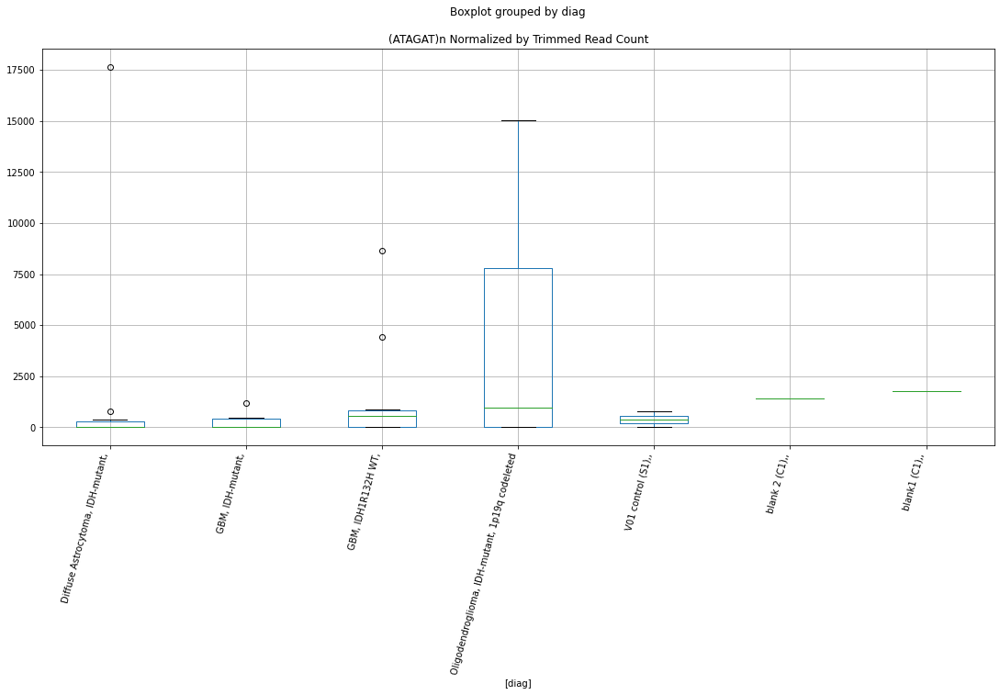

 p : 0.04980226750536102  ( t : 2.102943990687065 ) :  Lexogen  :  cutadapt2  :  7SLRNA
Control and blanks
82     0.0
346    0.0
Name: 7SLRNA, dtype: float64
214    0.0
Name: 7SLRNA, dtype: float64
478    0.0
Name: 7SLRNA, dtype: float64


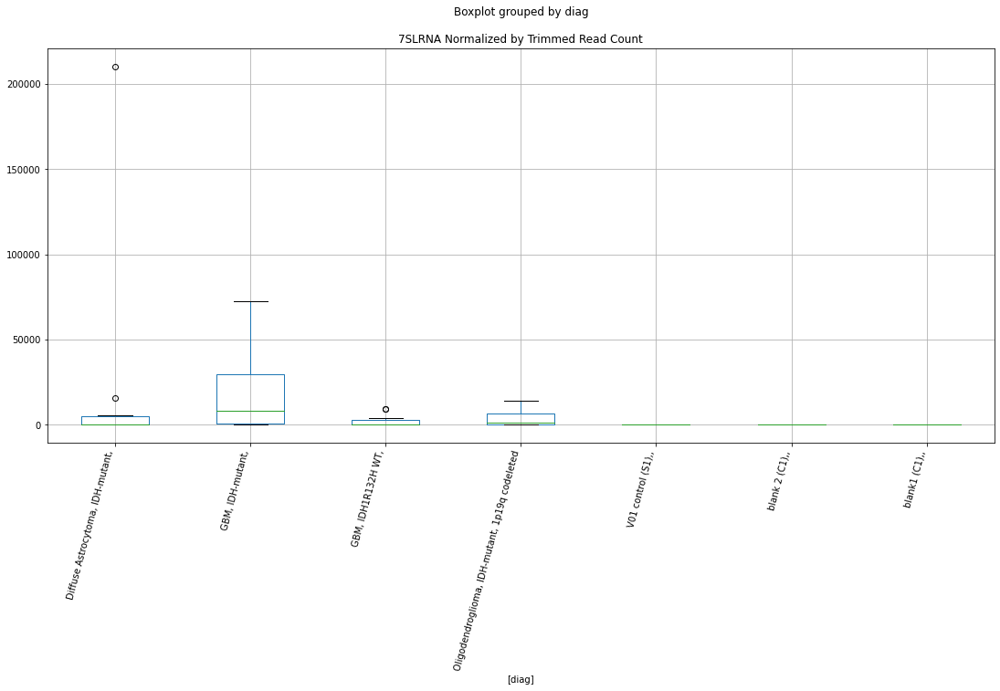

 p : 0.04985815231509895  ( t : 2.1023717914225433 ) :  D-plex  :  cutadapt2  :  MLT1E1
Control and blanks
76     19697.97
340    22899.04
Name: MLT1E1, dtype: float64
208    17283.3
Name: MLT1E1, dtype: float64
472    19072.54
Name: MLT1E1, dtype: float64


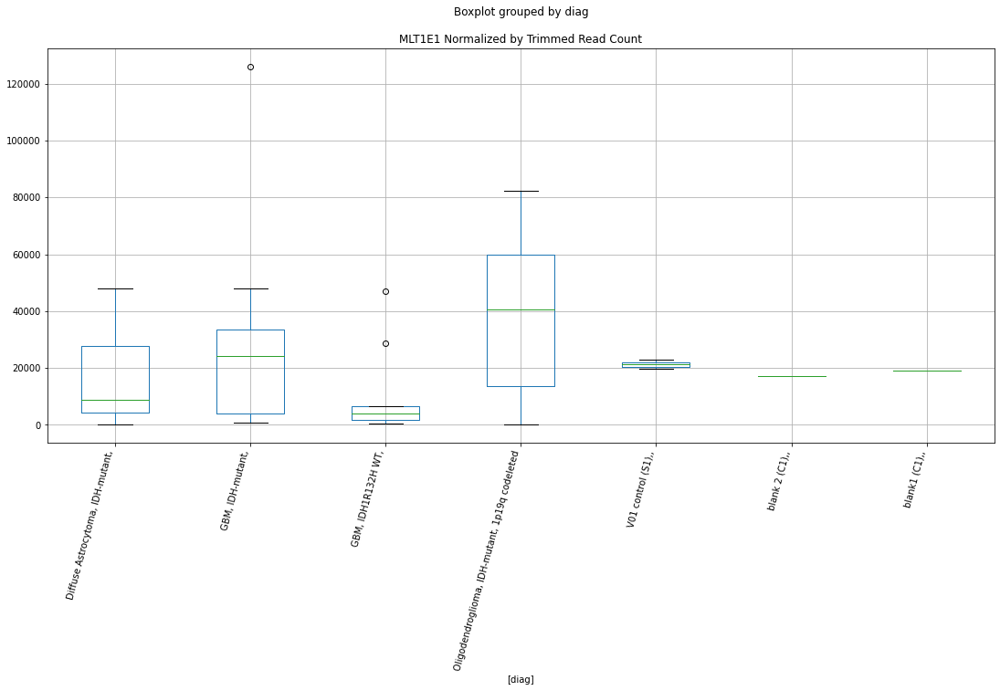

 p : 0.04988483854804757  ( t : 2.102098759272753 ) :  Lexogen  :  cutadapt2  :  tRNA-Glu-GAG_
Control and blanks
82          0.00
346    151723.29
Name: tRNA-Glu-GAG_, dtype: float64
214    19257.08
Name: tRNA-Glu-GAG_, dtype: float64
478    16859.69
Name: tRNA-Glu-GAG_, dtype: float64


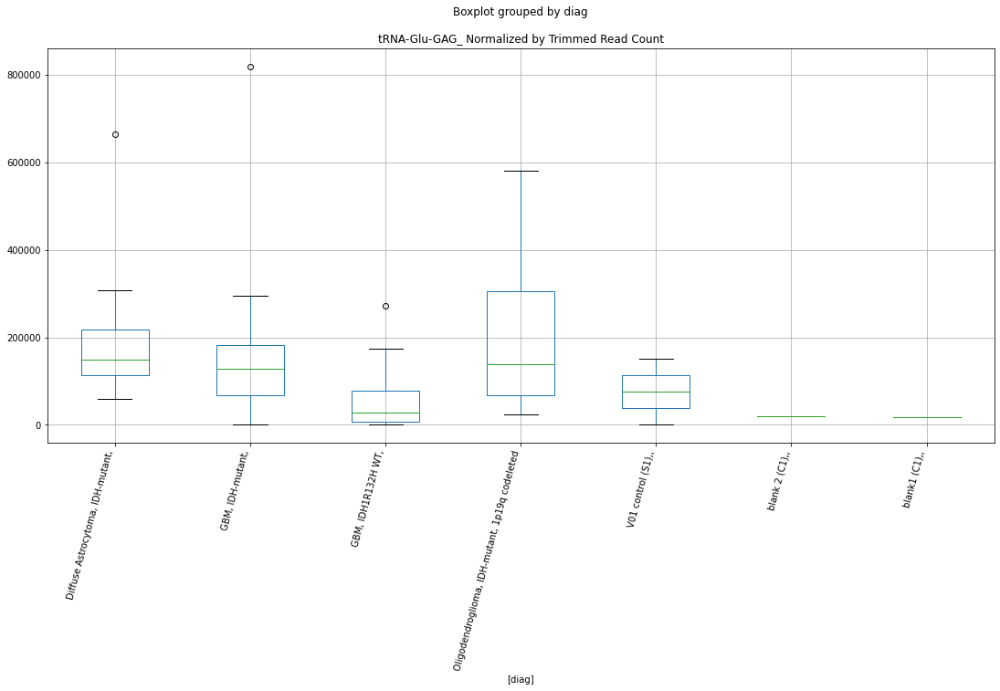

 p : 0.04991475566418957  ( t : 2.1017928291306447 ) :  D-plex  :  cutadapt2  :  LTR85b
Control and blanks
76     23486.04
340      880.73
Name: LTR85b, dtype: float64
208    18870.54
Name: LTR85b, dtype: float64
472    19650.5
Name: LTR85b, dtype: float64


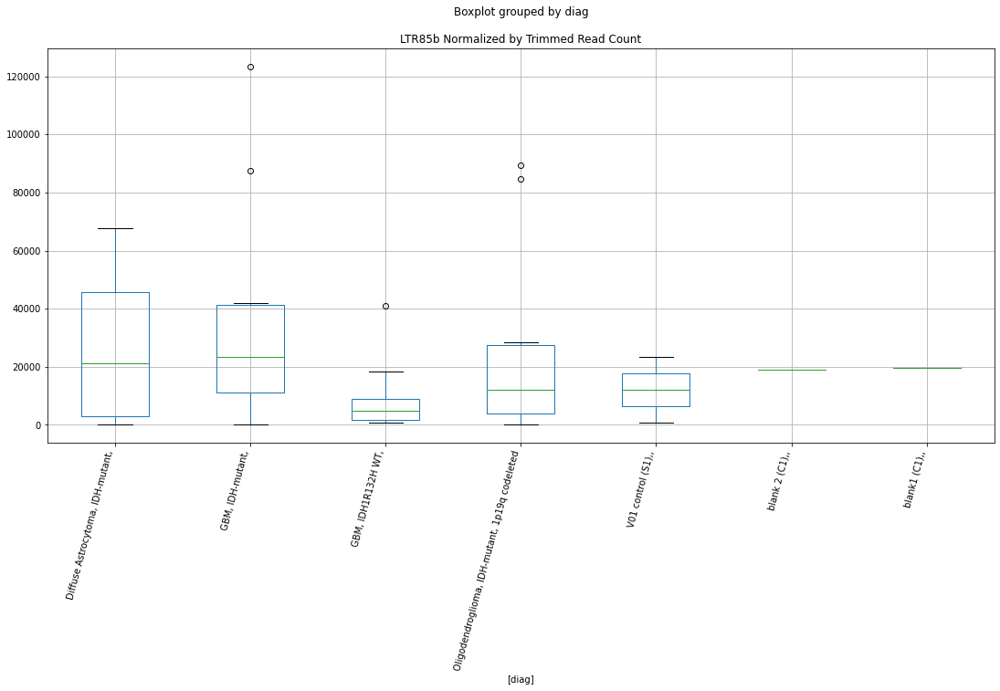

 p : 0.049993481365882525  ( t : 2.1009885817962415 ) :  D-plex  :  cutadapt2  :  MER89
Control and blanks
76     82579.95
340    23779.77
Name: MER89, dtype: float64
208    22397.75
Name: MER89, dtype: float64
472    18494.59
Name: MER89, dtype: float64


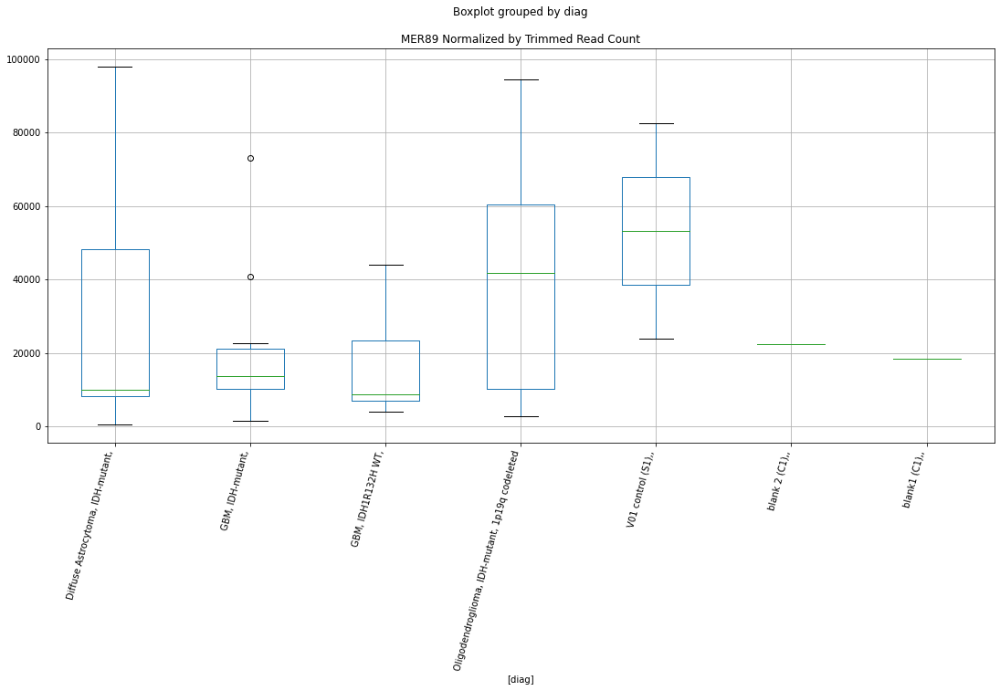

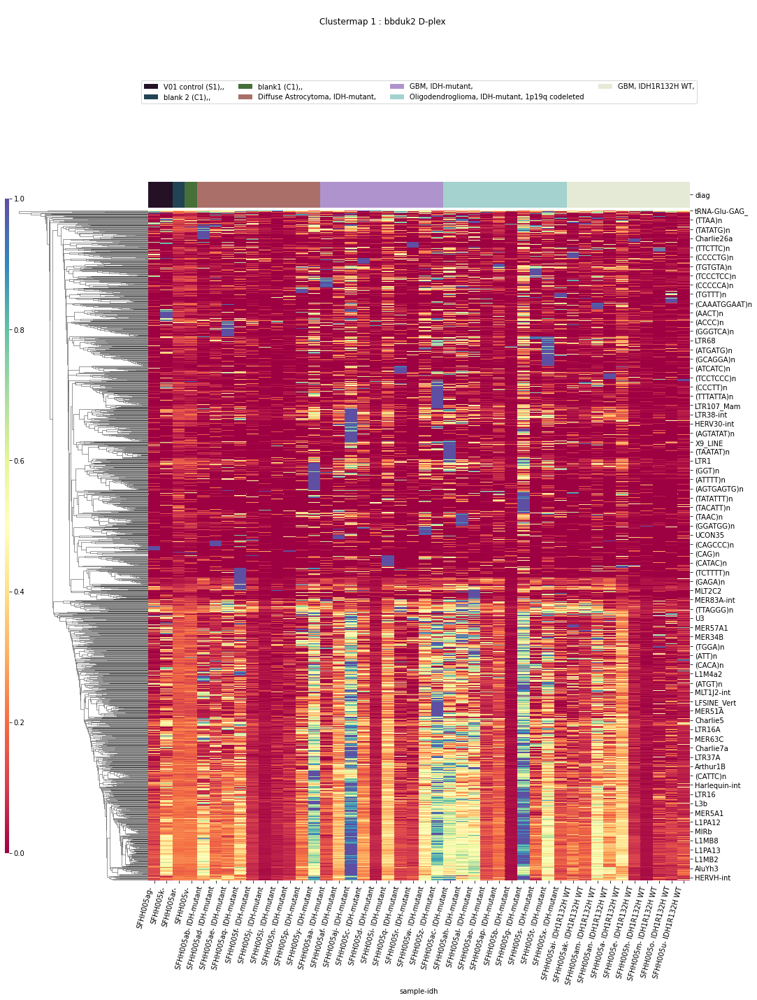

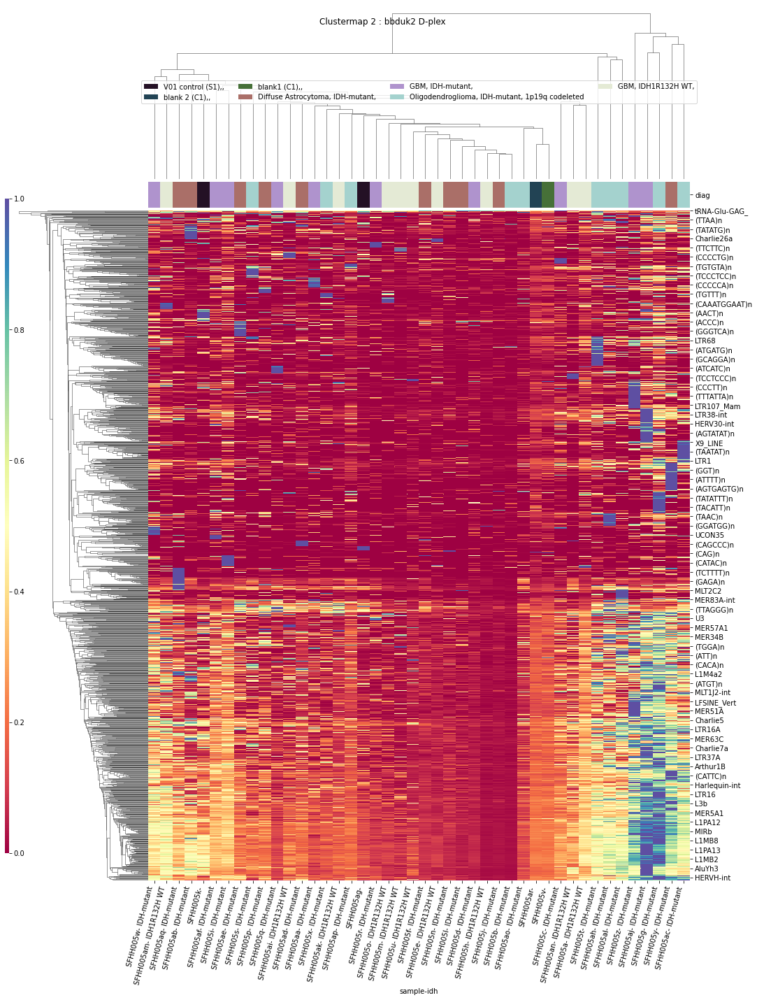

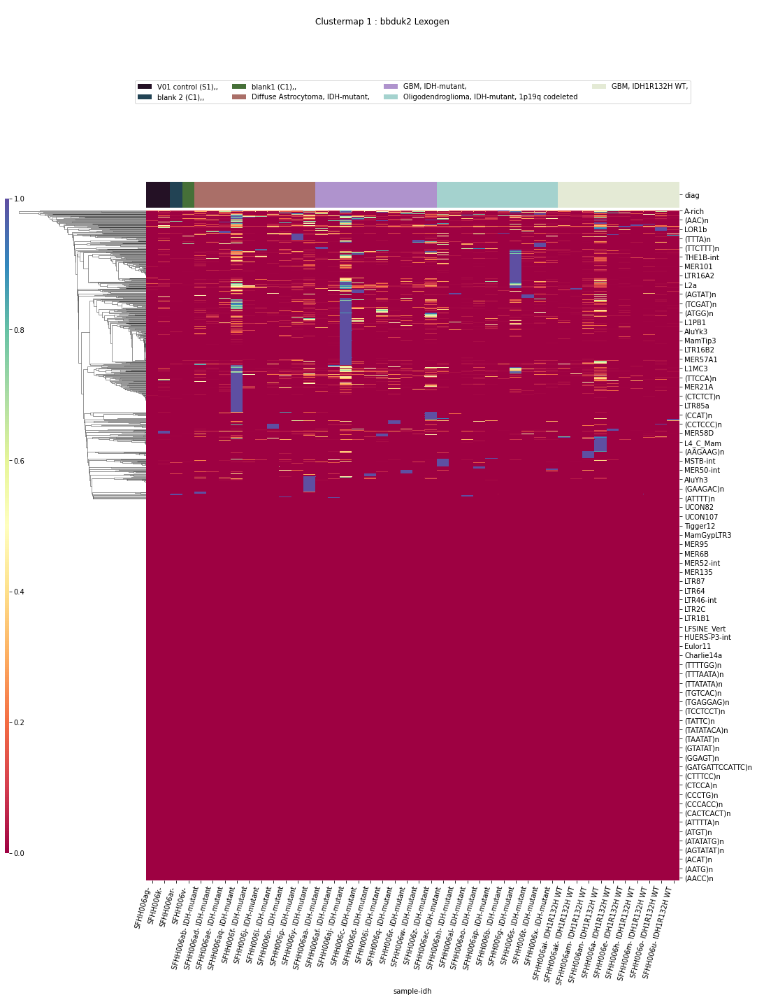

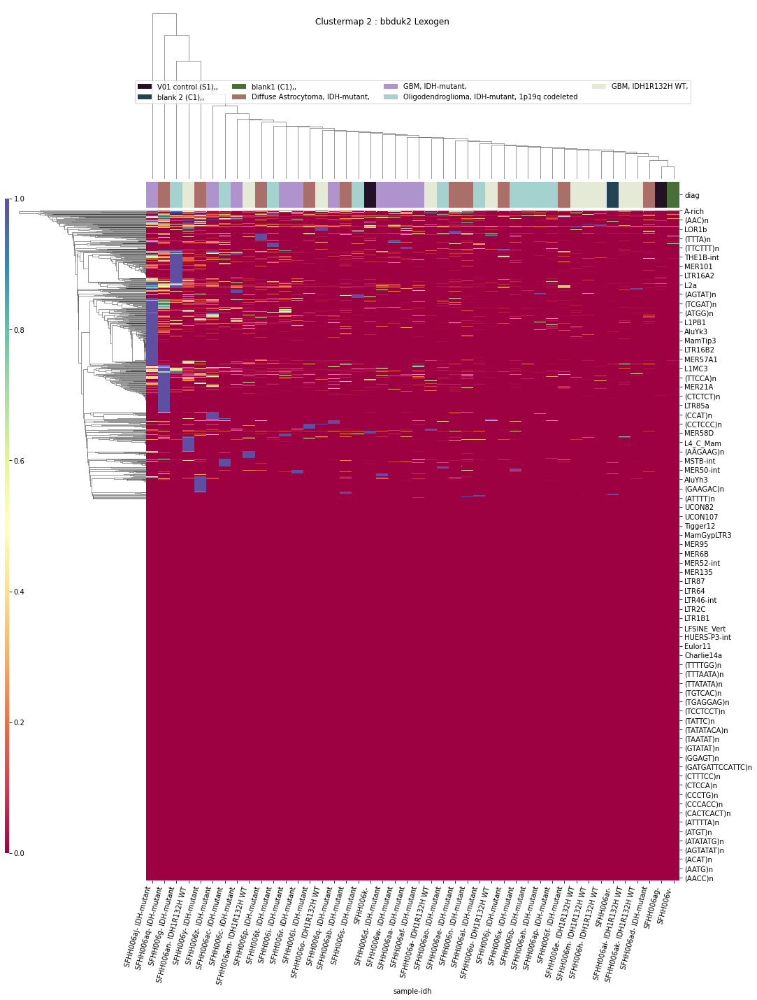

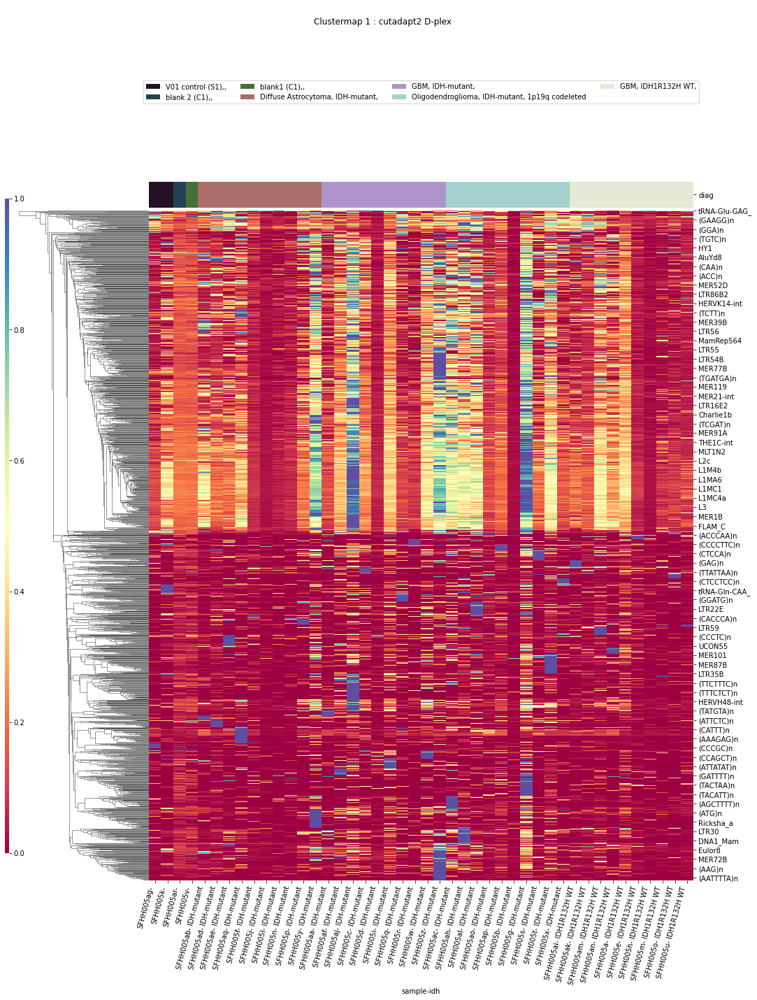

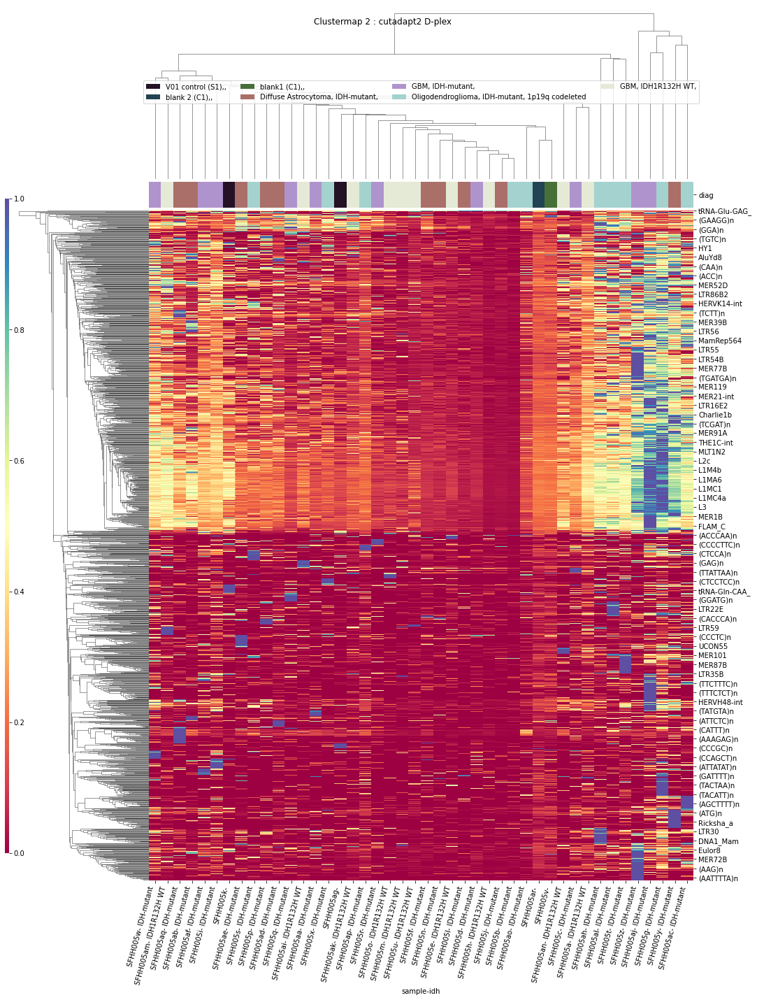

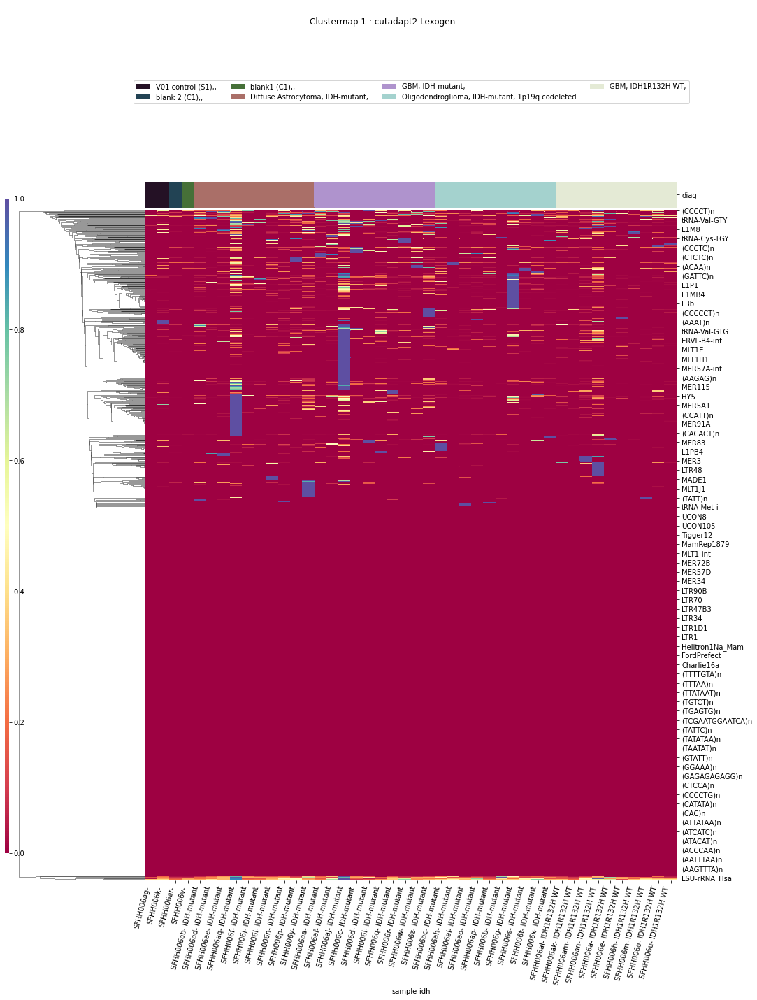

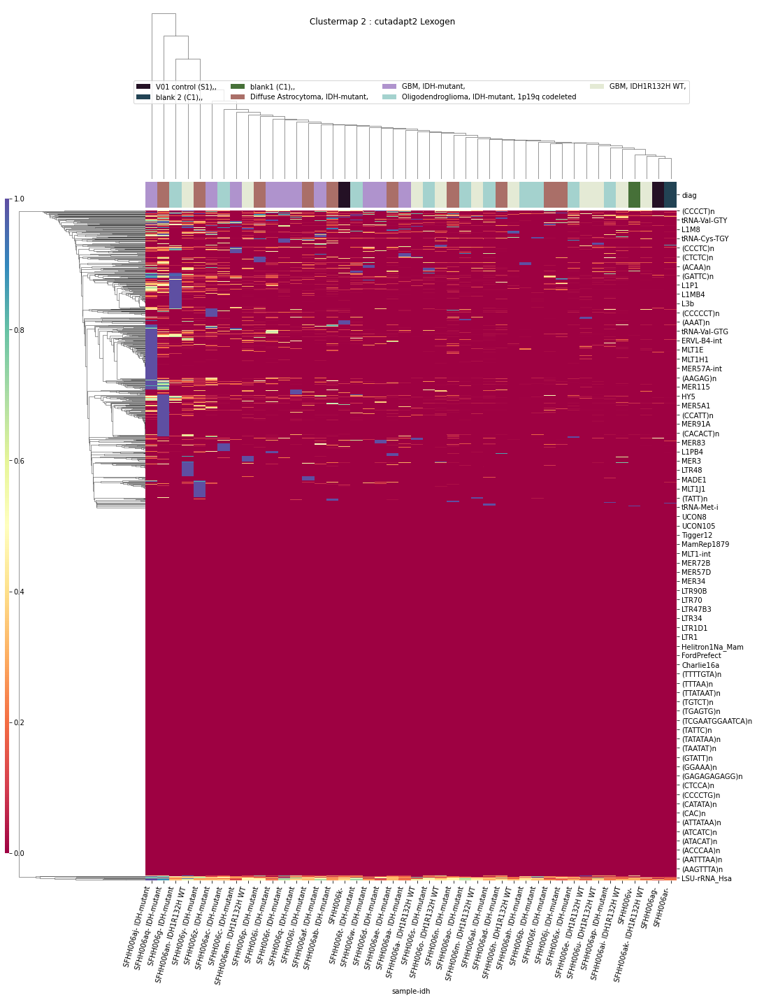

In [64]:
ttests_boxplots_and_heatmaps(dfn,elements)

In [65]:
datetime.now().strftime("%H:%M:%S")

'11:15:23'

# PCA

In [82]:
from sklearn.preprocessing import StandardScaler
from sklearn.decomposition import PCA
#alldiags=dfn['diag'].unique().tolist()

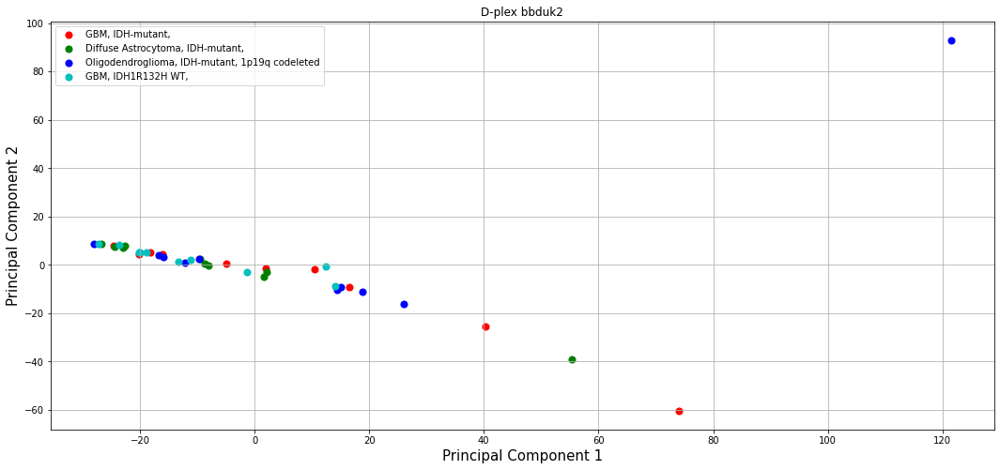

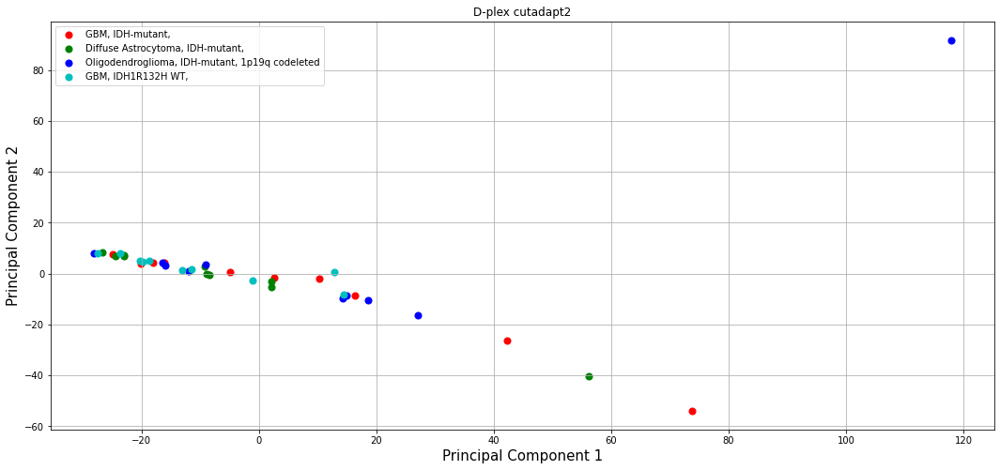

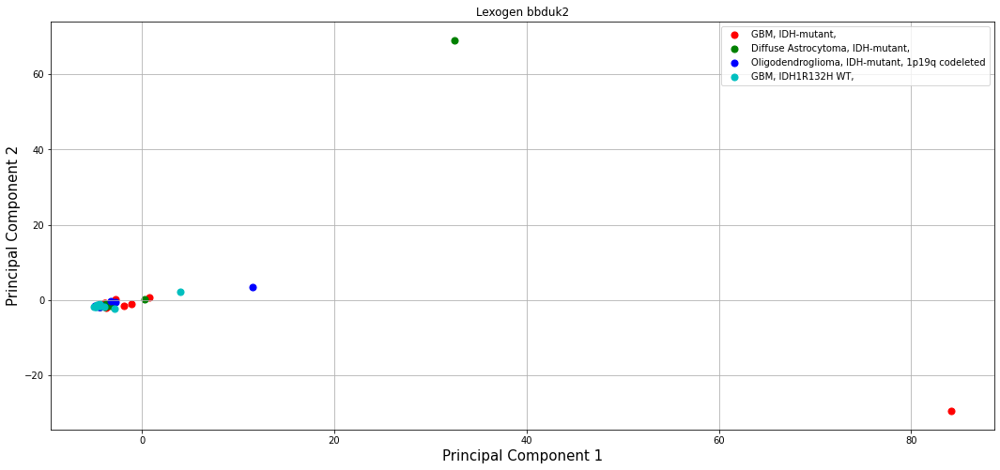

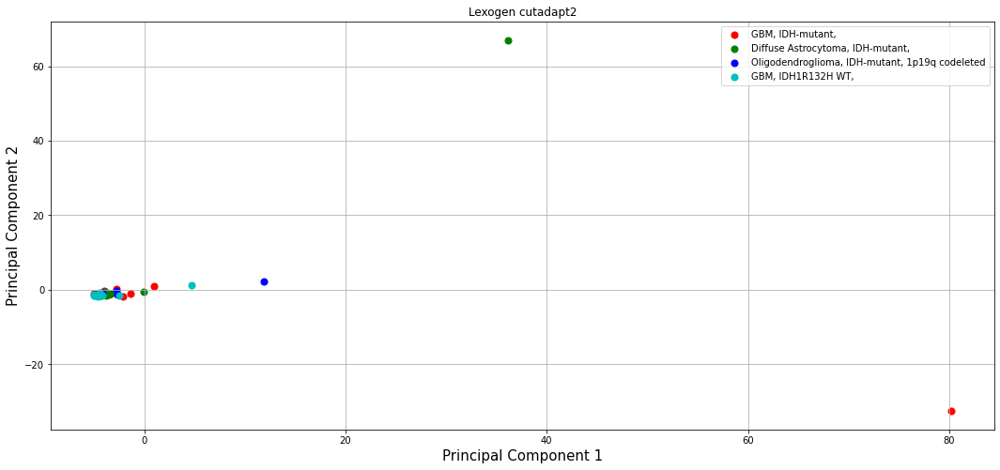

In [83]:
for labkit in dfn['Lab kit'].unique():
    #"D-plex","Lexogen":
    for trimmer in 'bbduk2','cutadapt2':
        #localdf['Trimmer'].unique():
        #pcadf=dfn[(dfn["Lab kit"]==labkit) & (dfn["trimmer"]==trimmer).copy()
        pcadf=dfn[(dfn["Lab kit"]==labkit) & (dfn["trimmer"]==trimmer) & dfn['diag'].isin(diags)].copy()

        scaler = StandardScaler()
        scaler.fit(pcadf[elements])
        scaled_data = scaler.transform(pcadf[elements])
        #scaled_data[0]
        pca = PCA(n_components=2)
        pca.fit(scaled_data)
        x_pca = pca.transform(scaled_data)
        #pcadf['diag_index']=pcadf['diag'].apply(lambda x: alldiags.index(x))
        pcadf['diag_index']=pcadf['diag'].apply(lambda x: diags.index(x))
        fig = plt.figure(figsize = (18,8))
        ax = fig.add_subplot(1,1,1) 
        ax.set_xlabel('Principal Component 1', fontsize = 15)
        ax.set_ylabel('Principal Component 2', fontsize = 15)
        ax.set_title('2 component PCA', fontsize = 20)
        #targets = alldiags
        targets = diags
        colors = ['r','g','b','c','m','y','k']
        for target, color in zip(targets,colors):
            indicesToKeep = pcadf['diag'] == target
            ax.scatter(x_pca[indicesToKeep, 0], x_pca[indicesToKeep, 1], c = color, s = 50)
        ax.legend(targets)
        ax.grid()
        plt.title(labkit + " " + trimmer)
        plt.show()
        

In [78]:
plt.rcParams["figure.figsize"] = [18.0,8.0]

In [79]:
pd.set_option('display.max_columns', default_max_columns)

In [80]:
pd.set_option('display.max_rows',default_max_rows)

In [81]:
pd.set_option('display.precision', default_precision)